In [1]:
import pandas as pd
import scipy
import numpy as np
import scipy.sparse as sp
import scipy.io as spio

from scipy.stats import pearsonr

import operator
import matplotlib.pyplot as plt

import matplotlib.cm as cm
import matplotlib.colors as colors

import matplotlib as mpl
from matplotlib.text import TextPath
from matplotlib.patches import PathPatch, Rectangle
from matplotlib.font_manager import FontProperties
from matplotlib import gridspec
from matplotlib.ticker import FormatStrFormatter
from sklearn.metrics import roc_auc_score

import seaborn as sns
import matplotlib.collections as collections

import isolearn.io as isoio

from evaluate_aparent_designed_mpra_helpers import *


<h2>LoFi vs. HiFi Array replicates</h2>

In [2]:
#Load designed MPRA data (Not collapsed over experiment replicates)
seq_ver_dict = isoio.load('../data/prepared_data/apa_array_data/apa_array_data_master_seq_ver')
seq_ver_df = seq_ver_dict['array_df']
seq_ver_cuts = seq_ver_dict['pooled_cuts']

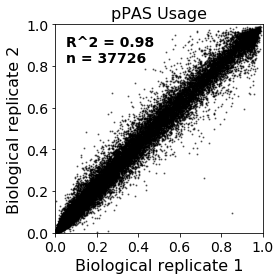

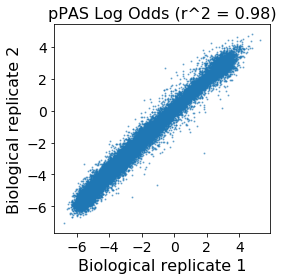

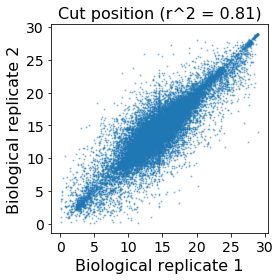

In [3]:
#Barcode-Pooled LoFi vs. Barcode-Pooled HiFi

save_figs = False

seq_ver_df_not_nan = seq_ver_df#.loc[~(np.isnan(seq_ver_df['mean_proximal_logodds']) | np.isinf(seq_ver_df['mean_proximal_logodds']))]

seq_ver_df_lo = seq_ver_df_not_nan.query("array_version == 'lofi' and n_barcodes >= 2 and mean_total_count >= 50").copy()
seq_ver_df_hi = seq_ver_df_not_nan.query("array_version == 'hifi' and n_barcodes >= 2 and mean_total_count >= 50").copy()

seq_ver_df_joined = seq_ver_df_lo.set_index('master_seq').join(seq_ver_df_hi.set_index('master_seq'), lsuffix='_lo', rsuffix='_hi', how='inner')

#Isoform proportions

r_val, _ = pearsonr(seq_ver_df_joined['mean_proximal_usage_lo'], seq_ver_df_joined['mean_proximal_usage_hi'])

f = plt.figure(figsize=(4, 4))

plt.scatter(seq_ver_df_joined['mean_proximal_usage_lo'], seq_ver_df_joined['mean_proximal_usage_hi'], alpha=0.5, s=1, c='black')


annot_text = 'R^2 = ' + str(round(r_val * r_val, 2))
annot_text += '\nn = ' + str(len(seq_ver_df_joined))
ax = plt.gca()
ax.text(0.05, 0.95, annot_text, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes, color='black', fontsize=14, weight="bold")



plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel('Biological replicate 1', fontsize=16)
plt.ylabel('Biological replicate 2', fontsize=16)
plt.title('pPAS Usage', fontsize=16)

plt.xlim(0, 1)
plt.ylim(0, 1)

plt.tight_layout()

if save_figs :
    plt.savefig('lofi_vs_hifi_pas_usage.png', transparent=True, dpi=150)
    plt.savefig('lofi_vs_hifi_pas_usage.eps')

plt.show()

#Isoform log odds

r_val, _ = pearsonr(seq_ver_df_joined['mean_proximal_logodds_lo'], seq_ver_df_joined['mean_proximal_logodds_hi'])

f = plt.figure(figsize=(4, 4))

plt.scatter(seq_ver_df_joined['mean_proximal_logodds_lo'], seq_ver_df_joined['mean_proximal_logodds_hi'], alpha=0.5, s=1)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel('Biological replicate 1', fontsize=16)
plt.ylabel('Biological replicate 2', fontsize=16)
plt.title('pPAS Log Odds (r^2 = ' + str(round(r_val * r_val, 2)) + ')', fontsize=16)

plt.tight_layout()

if save_figs :
    plt.savefig('lofi_vs_hifi_pas_logodds.png', transparent=True, dpi=150)
    plt.savefig('lofi_vs_hifi_pas_logodds.eps')

plt.show()

#Avg cut

r_val, _ = pearsonr(seq_ver_df_joined['mean_proximal_avgcut_lo'], seq_ver_df_joined['mean_proximal_avgcut_hi'])

f = plt.figure(figsize=(4, 4))

plt.scatter(seq_ver_df_joined['mean_proximal_avgcut_lo'], seq_ver_df_joined['mean_proximal_avgcut_hi'], alpha=0.4, s=1)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel('Biological replicate 1', fontsize=16)
plt.ylabel('Biological replicate 2', fontsize=16)
plt.title('Cut position (r^2 = ' + str(round(r_val * r_val, 2)) + ')', fontsize=16)

plt.tight_layout()

if save_figs :
    plt.savefig('lofi_vs_hifi_cutpos.png', transparent=True, dpi=150)
    plt.savefig('lofi_vs_hifi_cutpos.eps')

plt.show()


<h2>Load collapsed designed MPRA data</h2>

In [4]:
#Load designed MPRA data (Collapsed over experiment replicates)
seq_dict = isoio.load('../data/prepared_data/apa_array_data/apa_array_data_master_seq')
print("n = " + str(len(seq_dict['array_df'])))
print('Avg read count (avg over barcodes) = ' + str(np.mean(seq_dict['array_df'].query("n_barcodes >= 2")['mean_total_count'])))
print('Pooled read count (pooled over barcodes) = ' + str(np.mean(seq_dict['array_df'].query("n_barcodes >= 2")['pooled_total_count'])))

#Load variant dataframe
variant_dict = isoio.load('../data/prepared_data/apa_variant_data/apa_variant_data_master_seq')
print("n (variants) = " + str(len(variant_dict['variant_df'])))

#Load predictions
model_name = 'aparent_theano_legacy_30_31_34_pasaligned'
pred_dict = isoio.load('predictions/apa_array_data_legacy/' + model_name + '_predictions_master_seq')

#Join mpra dataframes with prediction table and calculate cut probabilities
seq_df, variant_df = append_predictions(seq_dict['array_df'], seq_dict['pooled_cuts'], variant_dict['variant_df'], variant_dict['pooled_cuts_var'], variant_dict['pooled_cuts_ref'], pred_dict['array_df'], pred_dict['cut_prob'])


n = 39833
Avg read count (avg over barcodes) = 431.92676310713546
Pooled read count (pooled over barcodes) = 3656.5562880452626
n (variants) = 21734


<h2>Summary Max Isoform analysis</h2>

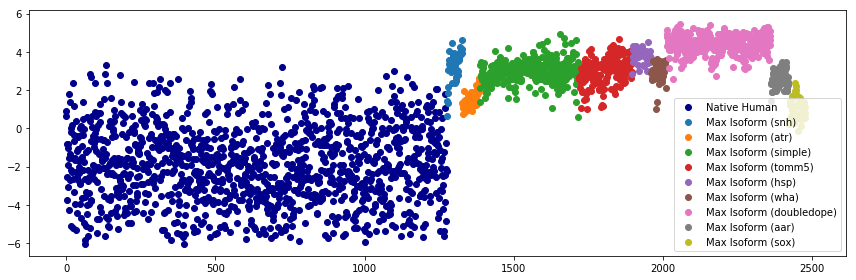

Total # of Max Isoform/Target ratio sequences = 1466
# of target_00 sequences = 53
# of target_025 sequences = 48
# of target_05 sequences = 55
# of target_075 sequences = 54
# of target_10 sequences = 54
# of max_score sequences = 1202


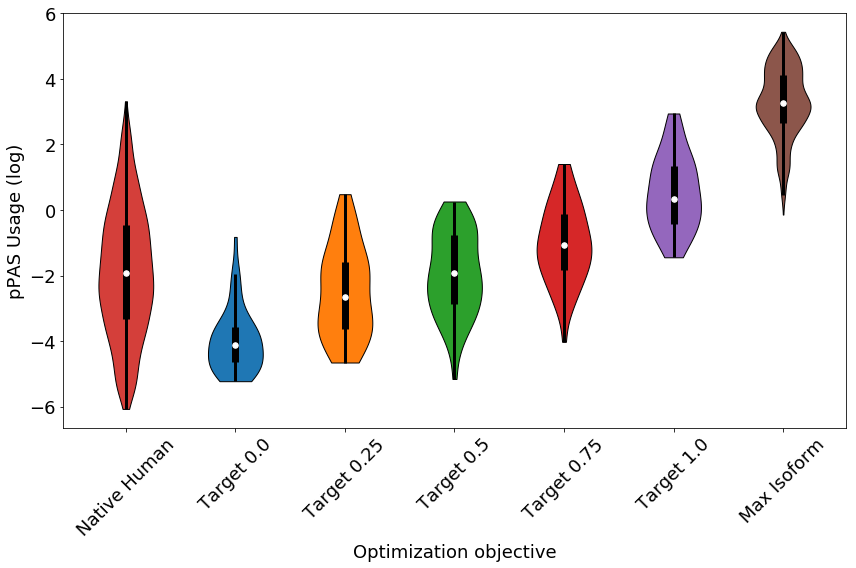

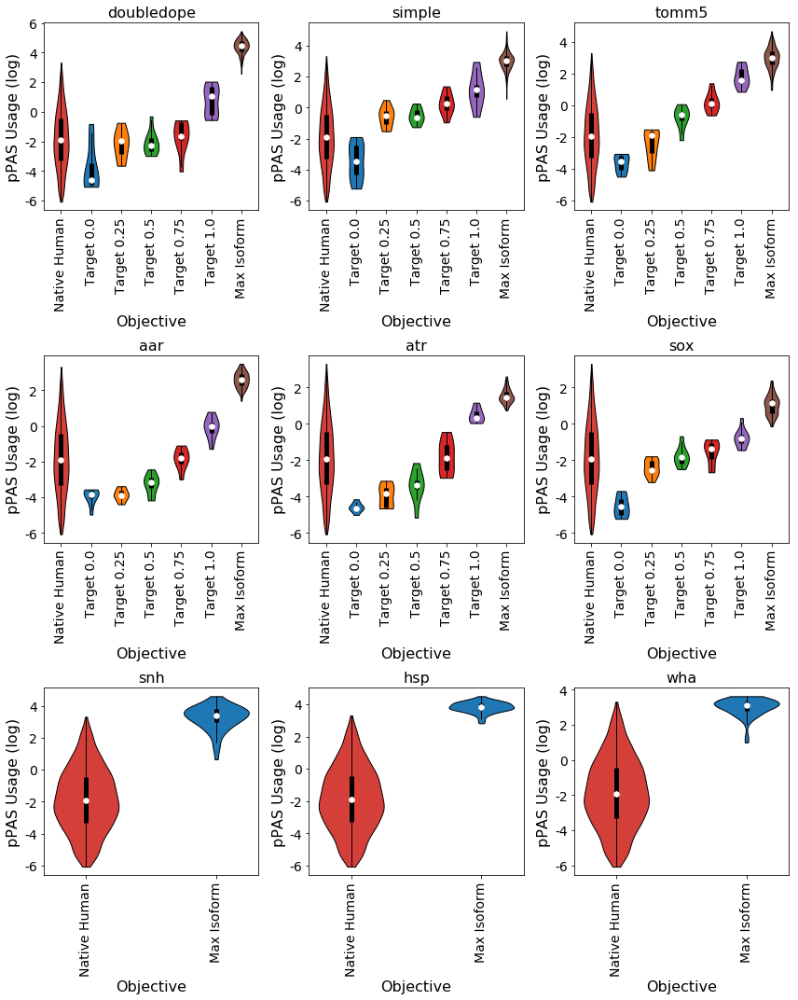

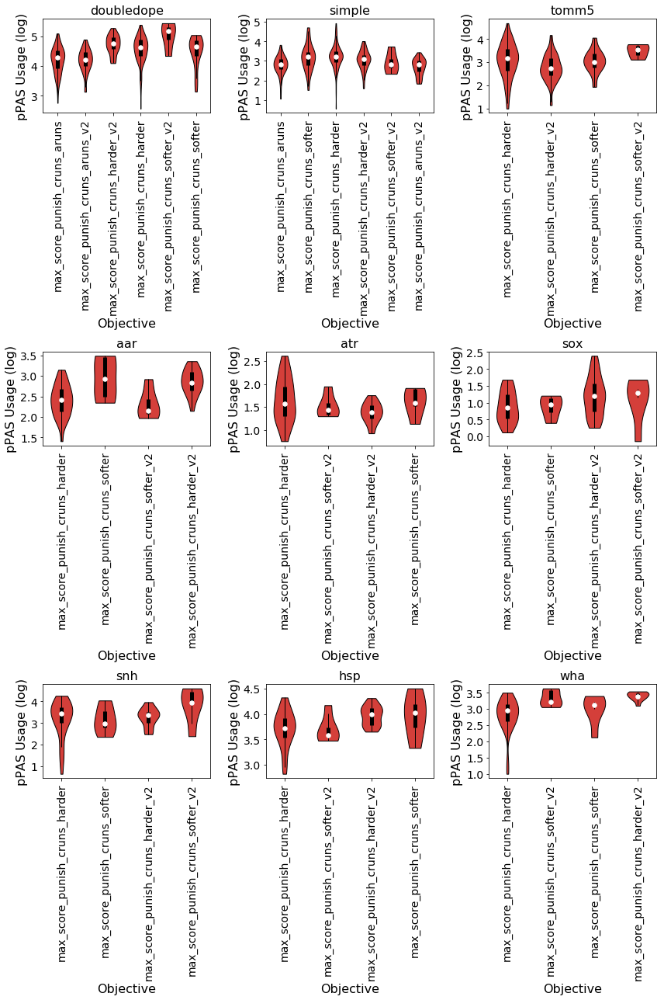

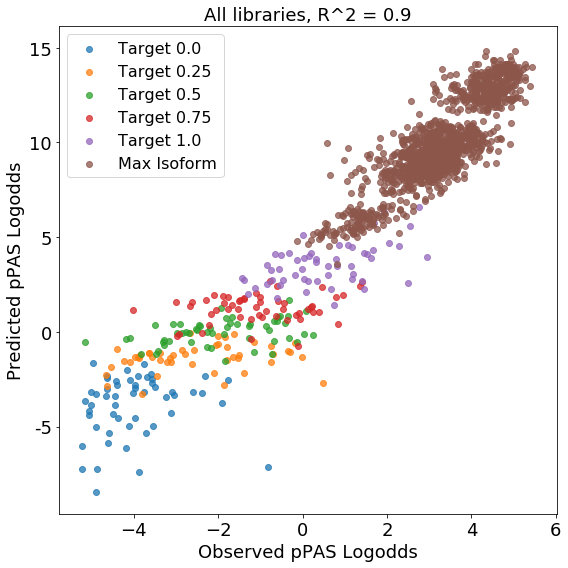

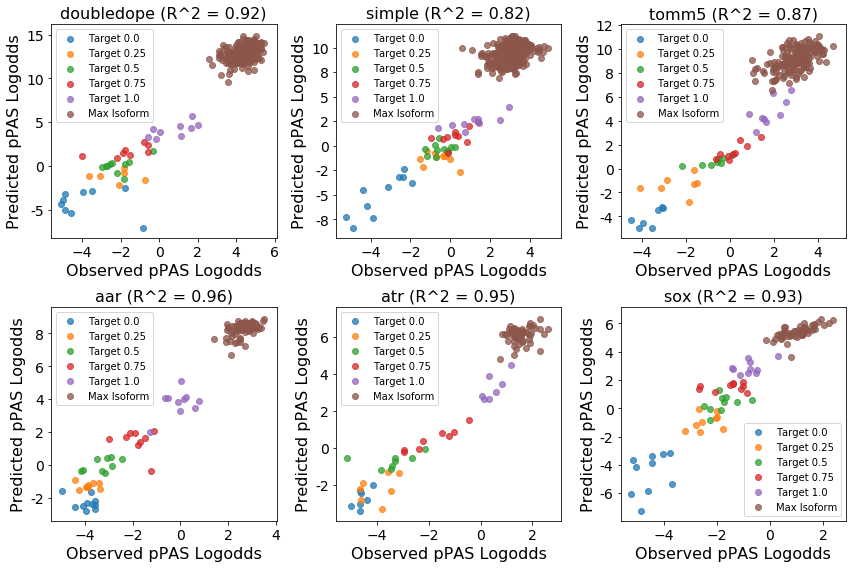

In [5]:

seq_df_filtered = seq_df.query("mean_total_count >= 100 and n_barcodes >= 5")

df_all = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")
max_iso_df_all = seq_df_filtered.query("experiment == 'max_iso' and variant != 'snv'")
max_iso_df_all = max_iso_df_all.loc[max_iso_df_all.subexperiment.str.contains('max_score')]
max_iso_df_all = max_iso_df_all.loc[~max_iso_df_all.subexperiment.str.contains('cstf')]


pred_column = 'logodds_pred'
true_column = 'median_proximal_vs_distal_logodds'

#Strip plot of measured isoform log odds distributions per optimized library
f = plt.figure(figsize=(12, 4))

plt.scatter(np.arange(len(df_all)), df_all[true_column], c='darkblue', label='Native Human')

n_points = len(df_all)

for gene in max_iso_df_all['gene'].unique() :
    max_iso_df_gene = max_iso_df_all.query("gene == '" + gene + "'")
    plt.scatter(np.arange(len(max_iso_df_gene)) + n_points, max_iso_df_gene[true_column], label='Max Isoform (' + gene + ')')

    n_points += len(max_iso_df_gene)
    
plt.legend()

plt.tight_layout()
plt.show()


#Violin plot of target isoform- optimized sequences
save_figs = False
show_axis = True

max_iso_df_all = seq_df_filtered.query("experiment == 'max_iso' and variant != 'snv'")
max_iso_df_all = max_iso_df_all.loc[~max_iso_df_all.subexperiment.str.contains('cstf')]

violindata = [
    sorted(np.array(np.ravel(df_all[true_column].values)))
]

violinlabels = [
    'Native Human'
]

included_genes = [
    'doubledope',
    'simple',
    'tomm5',
    'aar',
    'atr',
    'sox',
    'snh',
    'hsp',
    'wha'
]

subexps = [
    ['target_00', 'Target 0.0'],
    ['target_025', 'Target 0.25'],
    ['target_05', 'Target 0.5'],
    ['target_075', 'Target 0.75'],
    ['target_10', 'Target 1.0'],
    ['max_score', 'Max Isoform'],
]

print("Total # of Max Isoform/Target ratio sequences = " + str(len(max_iso_df_all)))

for subexp, iso_label in subexps :
    
    violinlabels.append(iso_label)
    curr_data = sorted(np.array(np.ravel(max_iso_df_all.loc[max_iso_df_all.subexperiment.str.contains(subexp)][true_column].values)))
    
    print("# of " + subexp + " sequences = " + str(len(curr_data)))
    
    violindata.append(curr_data)


if show_axis :
    f = plt.figure(figsize=(12, 8))
else :
    f = plt.figure(figsize=(6, 4))

parts = plt.violinplot(violindata, np.arange(len(violindata)), showmeans=False, showextrema=False, showmedians=False)

violin_colors = ['#D43F3A', '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
for i, pc in enumerate(parts['bodies']):
    #pc.set_facecolor('#D43F3A')
    pc.set_facecolor(violin_colors[i])
    pc.set_edgecolor('black')
    pc.set_alpha(1)


def adjacent_values(vals, q1, q3):
    upper_adjacent_value = q3 + (q3 - q1) * 1.5
    upper_adjacent_value = np.clip(upper_adjacent_value, q3, vals[-1])

    lower_adjacent_value = q1 - (q3 - q1) * 1.5
    lower_adjacent_value = np.clip(lower_adjacent_value, vals[0], q1)
    return lower_adjacent_value, upper_adjacent_value


percs = [np.percentile(violindata[i], [25, 50, 75], axis=0) for i in range(0, len(violindata))]
quartile1, medians, quartile3 = zip(*percs)
whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(violindata, quartile1, quartile3)])
whiskersMin, whiskersMax = whiskers[:, 0], whiskers[:, 1]


inds = np.arange(len(violindata))
plt.scatter(inds, medians, marker='o', color='white', s=30, zorder=3)
plt.vlines(inds, quartile1, quartile3, color='k', linestyle='-', lw=7)
plt.vlines(inds, whiskersMin, whiskersMax, color='k', linestyle='-', lw=3)

if show_axis :
    plt.xticks(np.arange(len(violindata)), violinlabels, rotation=45, fontsize=18)
    plt.yticks(fontsize=18)

    plt.xlabel('Optimization objective', fontsize=18)
    plt.ylabel('pPAS Usage (log)', fontsize=18)
else :
    plt.xticks([], [])
    plt.yticks([], [])

plt.tight_layout()
if save_figs :
    plt.savefig('max_isoform_violin_all.png', transparent=True, dpi=150)
    plt.savefig('max_isoform_violin_all.svg')
    plt.savefig('max_isoform_violin_all.eps')
plt.show()


#Break down target isoform- analysis by library
if show_axis :
    f, ax = plt.subplots(3, 3, figsize=(12, 15))
else :
    f, ax = plt.subplots(3, 3, figsize=(8, 8))

for gene_i, gene in enumerate(included_genes) :
    violindata = [
        sorted(np.ravel(df_all[true_column].values))
    ]

    violinlabels = [
        'Native Human'
    ]

    row_i = int(gene_i / 3)
    col_i = int(gene_i % 3)

    for subexp, iso_label in subexps :
        curr_data = np.ravel(max_iso_df_all.query("gene == '" + gene + "'").loc[max_iso_df_all.subexperiment.str.contains(subexp)][true_column].values)
        
        if len(curr_data) > 0 :
            violinlabels.append(iso_label)
            violindata.append(sorted(curr_data))


    #ax[row_i, col_i].violinplot(violindata, np.arange(len(violindata)), points=60, widths=0.7, showmeans=True, showextrema=True, showmedians=True, bw_method=0.5)
    parts = ax[row_i, col_i].violinplot(violindata, np.arange(len(violindata)), showmeans=False, showextrema=False, showmedians=False)

    violin_colors = ['#D43F3A', '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    for i, pc in enumerate(parts['bodies']):
        #pc.set_facecolor('#D43F3A')
        pc.set_facecolor(violin_colors[i])
        pc.set_edgecolor('black')
        pc.set_alpha(1)
    
    percs = [np.percentile(violindata[i], [25, 50, 75], axis=0) for i in range(0, len(violindata))]
    quartile1, medians, quartile3 = zip(*percs)
    whiskers = np.array([
        adjacent_values(sorted_array, q1, q3)
        for sorted_array, q1, q3 in zip(violindata, quartile1, quartile3)])
    whiskersMin, whiskersMax = whiskers[:, 0], whiskers[:, 1]

    plt.sca(ax[row_i, col_i])

    inds = np.arange(len(violindata))
    plt.scatter(inds, medians, marker='o', color='white', s=30, zorder=3)
    plt.vlines(inds, quartile1, quartile3, color='k', linestyle='-', lw=5)
    plt.vlines(inds, whiskersMin, whiskersMax, color='k', linestyle='-', lw=1)

    if show_axis :
        plt.xticks(np.arange(len(violindata)), violinlabels, rotation=90, fontsize=14)
        plt.yticks(fontsize=14)

        #ax[row_i, col_i].yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
        ax[row_i, col_i].yaxis.set_major_formatter(FormatStrFormatter('%.0f'))

        plt.title(gene, fontsize=16)
        plt.xlabel('Objective', fontsize=16)
        plt.ylabel('pPAS Usage (log)', fontsize=16)
    else :
        plt.xticks([], [])
        plt.yticks([], [])


plt.tight_layout()
if save_figs :
    plt.savefig('max_isoform_violin_per_library.png', transparent=True, dpi=150)
    plt.savefig('max_isoform_violin_per_library.svg')
    plt.savefig('max_isoform_violin_per_library.eps')
plt.show()


#Break down by library and max_score subexperiment
if show_axis :
    f, ax = plt.subplots(3, 3, figsize=(12, 18))
else :
    f, ax = plt.subplots(3, 3, figsize=(8, 8))

for gene_i, gene in enumerate(included_genes) :
    violindata = []
    violinlabels = []

    row_i = int(gene_i / 3)
    col_i = int(gene_i % 3)

    gene_data = max_iso_df_all.query("gene == '" + gene + "'")
    gene_data = gene_data.loc[gene_data.subexperiment.str.contains('max_score')]
    
    for subexp in gene_data['subexperiment'].unique() :
        curr_data = np.ravel(gene_data.query("subexperiment == '" + subexp + "'")[true_column].values)
        
        if len(curr_data) > 0 :
            violinlabels.append(subexp)
            violindata.append(sorted(curr_data))


    #ax[row_i, col_i].violinplot(violindata, np.arange(len(violindata)), points=60, widths=0.7, showmeans=True, showextrema=True, showmedians=True, bw_method=0.5)
    parts = ax[row_i, col_i].violinplot(violindata, np.arange(len(violindata)), showmeans=False, showextrema=False, showmedians=False)

    for i, pc in enumerate(parts['bodies']):
        pc.set_facecolor('#D43F3A')
        pc.set_edgecolor('black')
        pc.set_alpha(1)
    
    percs = [np.percentile(violindata[i], [25, 50, 75], axis=0) for i in range(0, len(violindata))]
    quartile1, medians, quartile3 = zip(*percs)
    whiskers = np.array([
        adjacent_values(sorted_array, q1, q3)
        for sorted_array, q1, q3 in zip(violindata, quartile1, quartile3)])
    whiskersMin, whiskersMax = whiskers[:, 0], whiskers[:, 1]

    plt.sca(ax[row_i, col_i])

    inds = np.arange(len(violindata))
    plt.scatter(inds, medians, marker='o', color='white', s=30, zorder=3)
    plt.vlines(inds, quartile1, quartile3, color='k', linestyle='-', lw=5)
    plt.vlines(inds, whiskersMin, whiskersMax, color='k', linestyle='-', lw=1)


    if show_axis :
        plt.xticks(np.arange(len(violindata)), violinlabels, rotation=90, fontsize=14)
        plt.yticks(fontsize=14)

        plt.title(gene, fontsize=16)
        plt.xlabel('Objective', fontsize=16)
        plt.ylabel('pPAS Usage (log)', fontsize=16)
    else :
        plt.xticks([], [])
        plt.yticks([], [])


plt.tight_layout()
if save_figs :
    plt.savefig('max_isoform_violin_per_subexperiment.png', transparent=True, dpi=150)
    plt.savefig('max_isoform_violin_per_subexperiment.svg')
    plt.savefig('max_isoform_violin_per_subexperiment.eps')
plt.show()


#Scatter plot of predicted vs. measured log odds of target isoform- sequences
r_val, _ = pearsonr(max_iso_df_all[true_column], max_iso_df_all[pred_column])

if show_axis :
    f = plt.figure(figsize=(8, 8))
else :
    f = plt.figure(figsize=(4, 4))

for subexp, subexp_label in subexps :
    max_iso_sub = max_iso_df_all.loc[max_iso_df_all.subexperiment.str.contains(subexp)]
    plt.scatter(max_iso_sub[true_column], max_iso_sub[pred_column], alpha=0.75, label=subexp_label)

if show_axis :
    plt.title('All libraries, R^2 = ' + str(round(r_val * r_val, 2)), fontsize=18)

    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)

    ax = plt.gca()
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.0f'))

    plt.xlabel('Observed pPAS Logodds', fontsize=18)
    plt.ylabel('Predicted pPAS Logodds', fontsize=18)

    plt.legend(fontsize=16)
else :
    plt.xticks([], [])
    plt.yticks([], [])

plt.tight_layout()
if save_figs :
    plt.savefig('max_isoform_scatter_all.png', transparent=True, dpi=150)
    plt.savefig('max_isoform_scatter_all.eps')
plt.show()




#Break down by library
if show_axis :
    f, ax = plt.subplots(2, 3, figsize=(12, 8))
else :
    f, ax = plt.subplots(2, 3, figsize=(8, 8./3. * 2.))

included_genes = [
    'doubledope',
    'simple',
    'tomm5',
    'aar',
    'atr',
    'sox'
]

for gene_i, gene in enumerate(included_genes) :
    
    row_i = int(gene_i / 3)
    col_i = int(gene_i % 3)

    r_val, _ = pearsonr(max_iso_df_all.query("gene == '" + gene + "'")[true_column], max_iso_df_all.query("gene == '" + gene + "'")[pred_column])
    
    for subexp, iso_label in subexps :
        curr_data = max_iso_df_all.query("gene == '" + gene + "'").loc[max_iso_df_all.subexperiment.str.contains(subexp)]
        
        if len(curr_data) > 0 :
            ax[row_i, col_i].scatter(curr_data[true_column], curr_data[pred_column], alpha=0.75, label=iso_label)

    plt.sca(ax[row_i, col_i])
    
    if show_axis :
        plt.title(gene + ' (R^2 = ' + str(round(r_val * r_val, 2)) + ')', fontsize=16)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)

        ax[row_i, col_i].yaxis.set_major_formatter(FormatStrFormatter('%.0f'))

        plt.xlabel('Observed pPAS Logodds', fontsize=16)
        plt.ylabel('Predicted pPAS Logodds', fontsize=16)
        plt.legend()
    else :
        plt.xticks([], [])
        plt.yticks([], [])


plt.tight_layout()
if save_figs :
    plt.savefig('max_isoform_scatter_per_library.png', transparent=True, dpi=150)
    plt.savefig('max_isoform_scatter_per_library.eps')
plt.show()

<h2>Detailed Max Isoform analysis</h2>

In [6]:
max_iso_pwm_dict = load_max_isoform_pwms()

doubledope, Increasing isoform abundance objective...


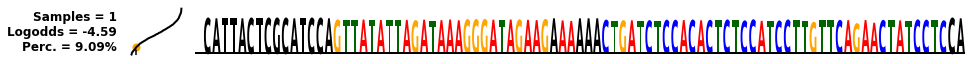

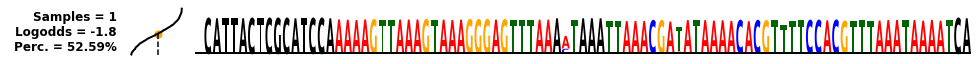

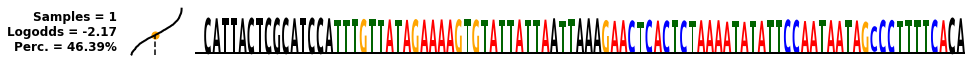

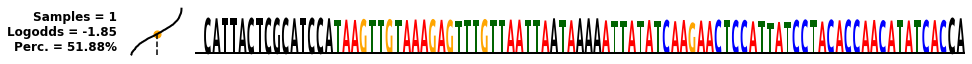

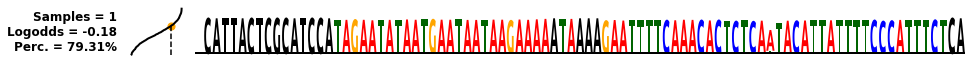

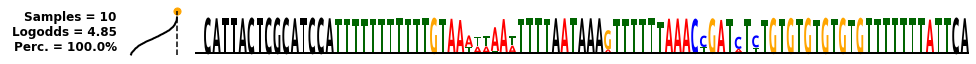

In [7]:

df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

subexperiments = [
    ['target_00'],
    ['target_025'],
    ['target_05'],
    ['target_075'],
    ['target_10'],
    ['max_score_punish_cruns_harder']
]

gene = 'doubledope'#'tomm5'

max_index_list=['mid', 'mid', 'mid', 'mid', 'mid', 0]
true_column='median_proximal_vs_distal_logodds'
figsize=(14,1)#(14, 4)
width_ratios=[2, 1, 14]
logo_height = 0.75
usage_unit = 'log'#'fraction'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=False
plot_opt_pwm=True

black_fixed_seq=True

plot_start=9
plot_end=96 + 2 #+ 17
plot_percentile=True
override_mean_stats=False

save_figs=False

print(gene + ', Increasing isoform abundance objective...')

for i, subexperiment in enumerate(subexperiments) :
    max_index = max_index_list[i]
    
    plot_sequence_logo(max_iso_df_all.query("gene == '" + gene + "'"), df_human, max_iso_pwm_dict, gene, subexperiment, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_iso_' + gene + '_' + subexperiment[0], fig_dpi=150)

tomm5, Max isoform objective...


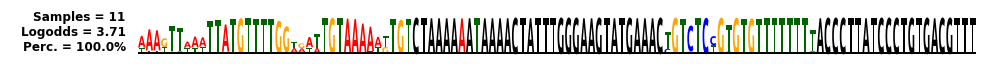

doubledope, Max isoform objective...


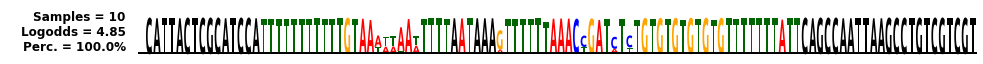

simple, Max isoform objective...


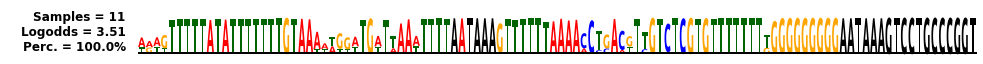

aar, Max isoform objective...


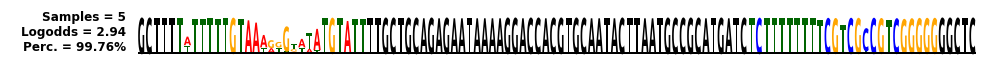

atr, Max isoform objective...


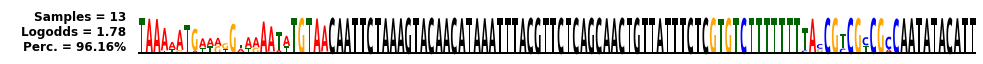

hsp, Max isoform objective...


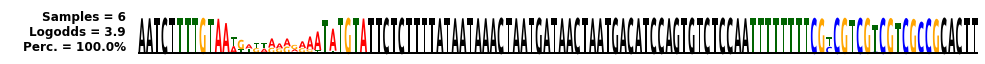

snh, Max isoform objective...


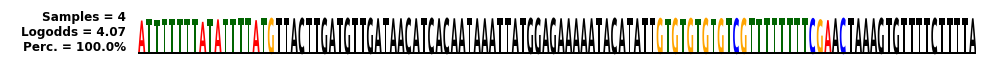

sox, Max isoform objective...


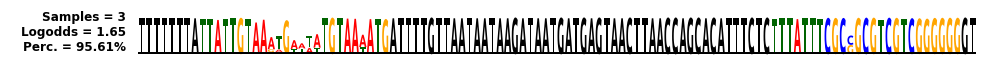

wha, Max isoform objective...


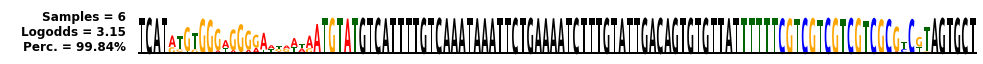

In [8]:

df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

subexperiments = [
    'max_score_punish_cruns_harder'
]

genes = ['tomm5', 'doubledope', 'simple', 'aar', 'atr', 'hsp', 'snh', 'sox', 'wha']

max_index=0
true_column='median_proximal_vs_distal_logodds'
figsize=(14,1)#(14, 4)
width_ratios=[2, 1, 14]
logo_height = 0.75
usage_unit = 'log'#'fraction'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=False
plot_opt_pwm=True

black_fixed_seq=True

plot_start=9
plot_end=116 + 3#96 + 2
plot_percentile=False
override_mean_stats=False

save_figs=False

for i, gene in enumerate(genes) :
    print(gene + ', Max isoform objective...')
    
    plot_sequence_logo(max_iso_df_all.query("gene == '" + gene + "'"), df_human, max_iso_pwm_dict, gene, subexperiments, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_iso_' + gene + '_' + subexperiment[0], fig_dpi=300)

<h2>Saturation Mutagenesis of Max Isoform- optimized Sequences</h2>

gene = simple, sequence 0...
WT Usage = 0.9524 (2.9957)
# Significant upreg. SNVs = 14
# Significant downreg. SNVs = 104


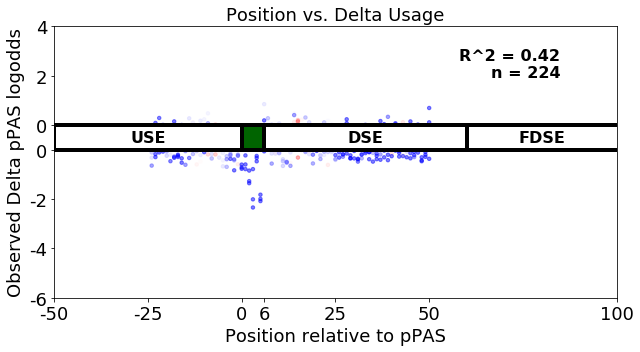

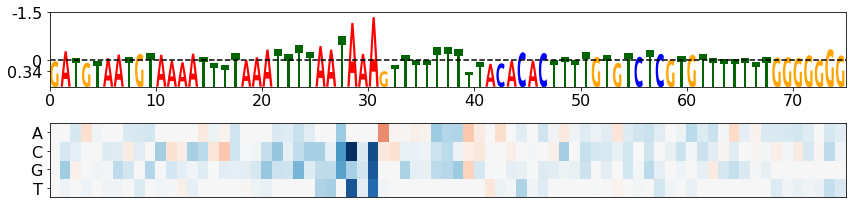

gene = doubledope, sequence 0...
WT Usage = 0.9933 (4.9936)
# Significant upreg. SNVs = 33
# Significant downreg. SNVs = 150


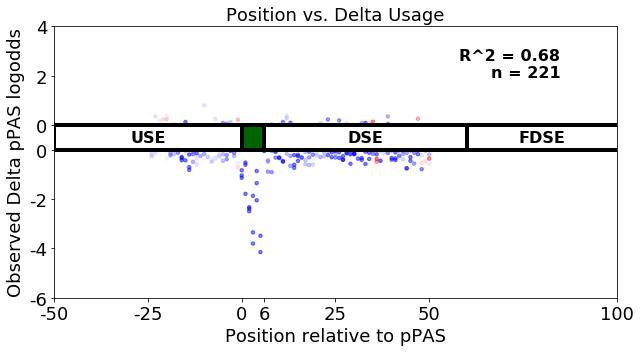

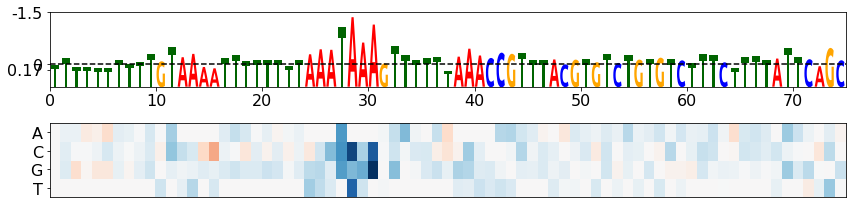

gene = doubledope, sequence 1...
WT Usage = 0.9899 (4.5824)
# Significant upreg. SNVs = 32
# Significant downreg. SNVs = 146


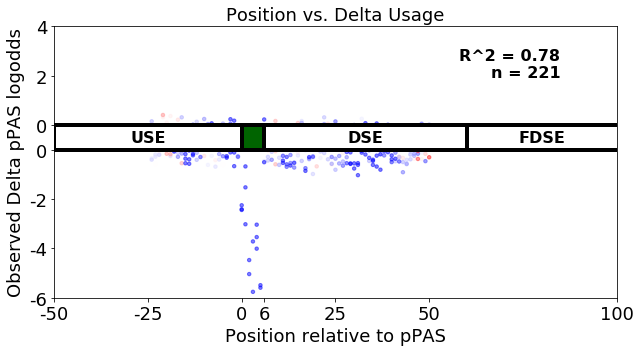

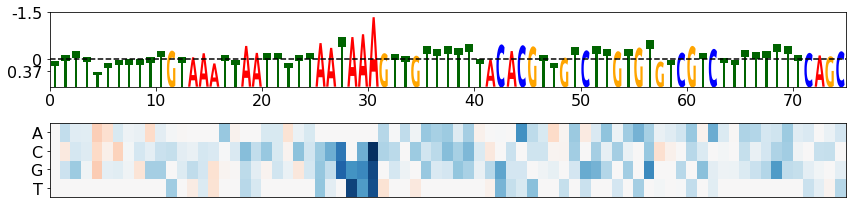

In [9]:
#Max Isoform SNV analysis

save_figs = False

seq_start = 25
seq_end = 100

p_val = 0.001

#All variants
#df_to_use = seq_predicted_isoform_df_delta_filtered_allexp.query("variant == 'snv' and experiment == 'max_iso'").copy()
df_to_use = variant_df.query("variant == 'snv' and experiment == 'max_iso'").copy().set_index('master_seq')


df_to_use['delta_logodds_true'] = df_to_use['median_proximal_vs_distal_logodds_var'] - df_to_use['median_proximal_vs_distal_logodds_ref']

df_to_use = df_to_use.query("n_barcodes_ref >= 5 and n_barcodes_var >= 5 and mean_total_count_ref >= 200 and mean_total_count_var >= 200")

whitelist_dict = {
    'simple_0',
    'doubledope_0',
    'doubledope_1'
}

for gene_i, gene in enumerate(df_to_use['gene'].unique()) :
    df_gene = df_to_use.query("gene == '" + gene + "'")
    for wt_seq_i, wt_seq in enumerate(sorted(df_gene['wt_seq'].unique())) :
        if gene + '_' + str(wt_seq_i) not in whitelist_dict :
            continue
        
        print("gene = " + gene + ', sequence ' + str(wt_seq_i) + '...')
        
        df_sel = df_gene.query("wt_seq == '" + wt_seq + "'")

        wt_logodds = df_sel['median_proximal_vs_distal_logodds_ref'].unique()[0]
        wt_usage = df_sel['median_proximal_vs_distal_usage_ref'].unique()[0]
        
        n_signi_up = len(df_sel.query("delta_p_val < " + str(p_val) + " and delta_logodds_true > 0"))
        n_signi_dn = len(df_sel.query("delta_p_val < " + str(p_val) + " and delta_logodds_true < 0"))
        
        print('WT Usage = ' + str(round(wt_usage, 4)) + " (" + str(round(wt_logodds, 4)) + ")")
        print('# Significant upreg. SNVs = ' + str(n_signi_up))
        print('# Significant downreg. SNVs = ' + str(n_signi_dn))
        
        figsize=(9, 5)

        fig_name = None
        if save_figs :
            fig_name = 'position_delta_max_iso_' + gene + '_' + str(wt_seq_i)
        plot_position_delta_scatter(df_sel, min_pred_filter=0.0, figsize=figsize, fig_name=fig_name, vmin=-0.5, vmax=0.5, fig_dpi=150, annotate=None)

        mut_map_v2(
            df_sel,
            gene,
            experiment='max_iso',
            mode='true',
            pred_column='mean_delta_logodds_pred',
            figsize=(12,3),
            mark_pathogenic=False,
            mark_benign=False,
            mark_undetermined=False,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            #pas_downscaling=0.5,
            pas_downscaling=-1.5,
            pas_downscale_mode='value',#'frac'
            fig_name=('max_iso_' + gene + '_' + str(wt_seq_i) + '_Mutmap_Observed') if save_figs else None,
            fig_dpi=300
        )


<h2>Summary Max Cut analysis</h2>

In [10]:
unique_experiments = seq_df.query("experiment == 'max_cut'")['subexperiment'].unique()

seq_df_filtered = seq_df.query("mean_total_count >= 100 and n_barcodes >= 5")

cut_df_filtered = seq_df.query("experiment == 'max_cut' and mean_total_count >= 10").copy()

#Map and evaluate sequences
def eval_logloss(cut_prob, target_pos) :
    target = np.zeros(cut_prob.shape[0])
    target[target_pos] = 0.8
    target[target_pos - 1] = 0.10
    target[target_pos + 1] = 0.10
    
    ent = -np.dot(target, np.log((cut_prob + 0.001) / np.sum(cut_prob + 0.001)))
    
    return ent

start_pos = 58
end_pos = 108

cut_poses = np.arange(end_pos - start_pos) + (start_pos - 56)

true_cut_column = 'cut_prob_true'
pred_cut_column = 'cut_prob_pred'

avg_position_true = []
avg_position_pred = []
cut_probs_true = []
cut_probs_pred = []
log_loss = []
for index, row in cut_df_filtered.iterrows() :
    
    cut_prob_true = np.ravel(row[true_cut_column])
    cut_prob_true = cut_prob_true[start_pos:end_pos] / np.sum(cut_prob_true[start_pos:end_pos])
    cut_probs_true.append(cut_prob_true)

    cut_prob_pred = np.ravel(row[pred_cut_column])
    cut_prob_pred = cut_prob_pred[start_pos:end_pos] / np.sum(cut_prob_pred[start_pos:end_pos])
    cut_probs_pred.append(cut_prob_pred)
    
    avg_pos_true = np.dot(cut_prob_true, (np.arange(cut_prob_true.shape[0]) + start_pos))
    avg_pos_pred = np.dot(cut_prob_pred, (np.arange(cut_prob_pred.shape[0]) + start_pos))
    avg_position_true.append(avg_pos_true)
    avg_position_pred.append(avg_pos_pred)
    
    cut_pos_caught = False
    for cut_pos in [60, 65, 70, 75, 80, 85, 90, 95, 100] :
        if str(cut_pos) in row['subexperiment'] :            
            log_loss.append(eval_logloss(np.copy(cut_prob_true), cut_pos - 55 - (start_pos - 56)))
            
            cut_pos_caught = True
            break
    
    if not cut_pos_caught :
        log_loss.append(0)
    

cut_df_filtered['proxcut_prob_true'] = cut_probs_true
cut_df_filtered['proxcut_prob_pred'] = cut_probs_pred
cut_df_filtered['avgpos_true'] = avg_position_true
cut_df_filtered['avgpos_pred'] = avg_position_pred
cut_df_filtered['loss_logloss'] = log_loss

cut_snv_df_filtered = cut_df_filtered.query("variant == 'snv'").copy()
cut_df_filtered = cut_df_filtered.query("variant != 'snv'").copy()

print("Total number of Max Cut sequences = " + str(len(cut_df_filtered)))


df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")
human_cutprobs = np.array(df_human[true_cut_column].values.tolist())[:, start_pos:end_pos]
human_cutprobs = human_cutprobs / np.sum(human_cutprobs, axis=1).reshape(-1, 1)

human_cutprob = np.mean(human_cutprobs, axis=0)

objective_poses = [5, 10, 15, 20, 25, 30, 35, 40, 45]

Total number of Max Cut sequences = 1274


<h2>Objective cut precision per subexperiment</h2>

/home/johli/anaconda3/envs/aparent/lib/python3.6/site-packages/numpy/core/fromnumeric.py:56: FutureWarning: Series.nonzero() is deprecated and will be removed in a future version.Use Series.to_numpy().nonzero() instead
  return getattr(obj, method)(*args, **kwds)


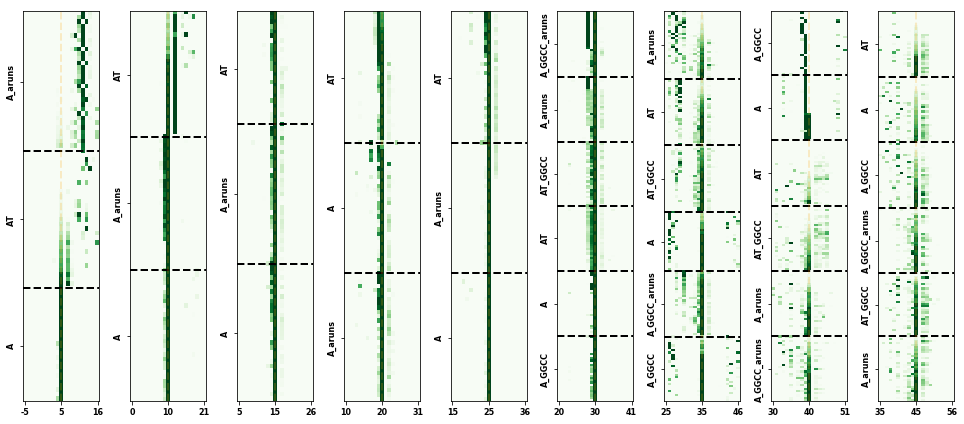

In [11]:

save_figs = False
print_verbose = False

cut_to_experiment = {}

pos_shift = 55
for cut_pos in [60, 65, 70, 75, 80, 85, 90, 95, 100] :
    cut_to_experiment[cut_pos - pos_shift] = []
    for unique_experiment in unique_experiments :
        if str(cut_pos) in unique_experiment :
            cut_to_experiment[cut_pos - pos_shift].append(unique_experiment)

#Detailed view per subexperiment

fig, ax = plt.subplots(1, len(cut_to_experiment), figsize=(1.5 * len(cut_to_experiment), 6))

subexperiment_blacklist = ['ent']

cut_pos_i = None
cut_pos = None

obj_pos_i = 0
for obj_pos, _ in sorted(cut_to_experiment.items(), key=lambda kv: kv[0]) :
    
    cut_result_dict = {}
    
    total_n_obj_pos_seqs = 0
    
    for subexperiment in cut_to_experiment[obj_pos] :
        n_subexp_seqs = len(np.nonzero(cut_df_filtered['subexperiment'] == subexperiment)[0])
        if print_verbose :
            print("Objective position = " + str(obj_pos) + ", subexperiment = " + subexperiment + ", # of sequences = " + str(n_subexp_seqs))
        total_n_obj_pos_seqs += n_subexp_seqs
        
        blacklisted = False
        for subexp_keyword in subexperiment_blacklist :
            if subexp_keyword in subexperiment :
                blacklisted = True
                break
        if blacklisted :        
            continue
    
        keep_index = np.nonzero(cut_df_filtered['subexperiment'] == subexperiment)[0]
        prox_prob = np.array(cut_df_filtered.iloc[keep_index]['proxcut_prob_true'].values.tolist())
    
        sort_index = np.argsort(np.ravel(cut_df_filtered.iloc[keep_index]['loss_logloss'].values))[::-1]
        prox_prob = prox_prob[sort_index, :]
        
        cut_result_dict[subexperiment] = {}
        cut_result_dict[subexperiment]['cut_probs'] = prox_prob
        cut_result_dict[subexperiment]['loss'] = np.mean(cut_df_filtered.iloc[keep_index]['loss_logloss'].values)
    
    if print_verbose :
        print("Objective position = " + str(obj_pos) + ", Total # of sequences = " + str(total_n_obj_pos_seqs))

    cut_probs = []
    cut_label_coords = []
    prev_label_coords = [0]
    cut_labels = []
    
    objective_pos = 0
    for subexperiment, vals in sorted(cut_result_dict.items(), key=lambda kv: kv[1]['loss'])[::-1] :
        prox_prob = vals['cut_probs']
        
        objective_pos = int(subexperiment.split('_')[-1]) - 55 + 10
    
        prox_prob = np.concatenate([np.zeros((prox_prob.shape[0], 10)), prox_prob, np.zeros((prox_prob.shape[0], 10))], axis=1)
    
        cut_probs.append(prox_prob[:, objective_pos - 10 - cut_poses[0]: objective_pos + 11 - cut_poses[0]])
        
        cut_label_coords.append(prev_label_coords[-1] + float(prox_prob.shape[0]) / 2.)
        prev_label_coords.append(prev_label_coords[-1] + float(prox_prob.shape[0]))
        cut_labels.append('_'.join(subexperiment.split('_')[:-1]))
    
        ax[obj_pos_i].axhline(y=prev_label_coords[-1], color='black', linewidth=2, linestyle='--')

    cut_probs = np.vstack(cut_probs)

    ax[obj_pos_i].imshow(cut_probs, cmap='Greens', vmin=0.05, vmax=0.3, aspect='auto')
    
    ax[obj_pos_i].axvline(x=10, color='orange', linewidth=2, linestyle='--', alpha=0.2)
    
    ax[obj_pos_i].set_xticks([0, 10, 20])
    ax[obj_pos_i].set_xticklabels([objective_pos - 20, objective_pos - 10, objective_pos + 1], fontsize=8, fontweight='bold', ha='center', va='top')
    
    ax[obj_pos_i].set_yticks(cut_label_coords)
    ax[obj_pos_i].set_yticklabels(cut_labels, fontsize=8, fontweight='bold', rotation=90, ha='right', va='center')
    
    obj_pos_i += 1


plt.tight_layout()

if save_figs :
    plt.savefig('cut_subexperiment_map.png', transparent=True, dpi=150)
    plt.savefig('cut_subexperiment_map.svg')
    plt.savefig('cut_subexperiment_map.eps')

plt.show()


<h2>Summary Max Cut analysis (all subexperiments)</h2>

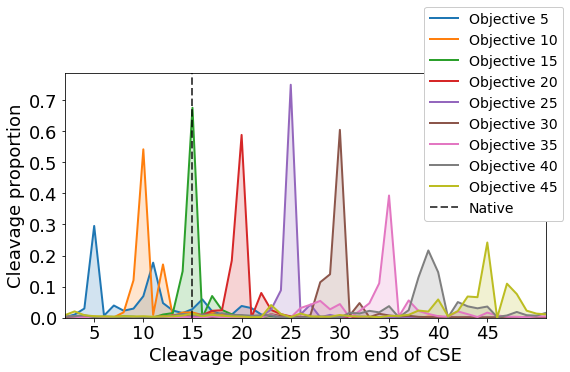

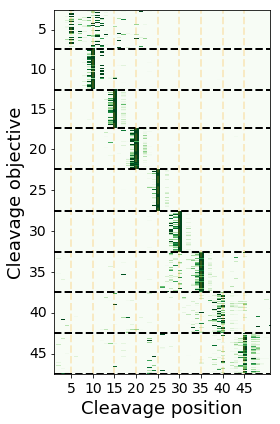

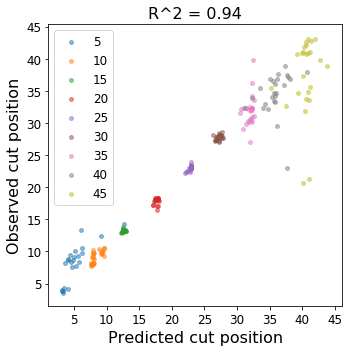

In [12]:
#Mean statistics over all subexperiments

cut_df_to_use = cut_df_filtered.loc[cut_df_filtered.subexperiment.str.contains('GGCC') | cut_df_filtered.subexperiment.str.slice(start=-2).isin(['60', '65', '70', '75', '80'])]

plot_cut_profile(cut_df_to_use, cut_to_experiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=None)#save_fig_name='cut_profile_all_subexps'
plot_cut_map(cut_df_to_use, cut_to_experiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=100)#save_fig_name='cut_map_all_subexps'
plot_position_scatter(cut_df_to_use, cut_to_experiment, cut_poses, objective_poses, human_cutprob, variant_filter="variant == 'wt'", figsize=(5, 5), save_fig_name=None, fig_dpi=150)#save_fig_name='avgcut_pred_vs_true_all_subexps'


<h2>Summary Max Cut analysis ('A' subexperiment)</h2>

Mean cut profile


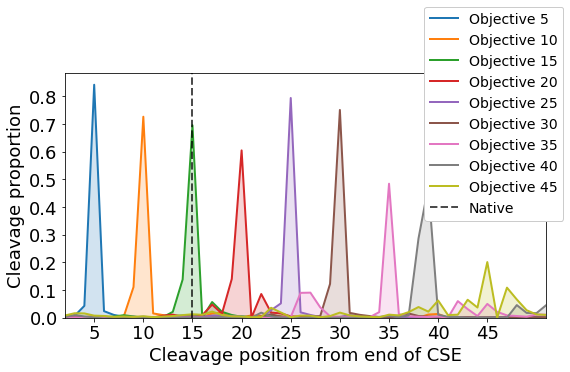

Max cut profile


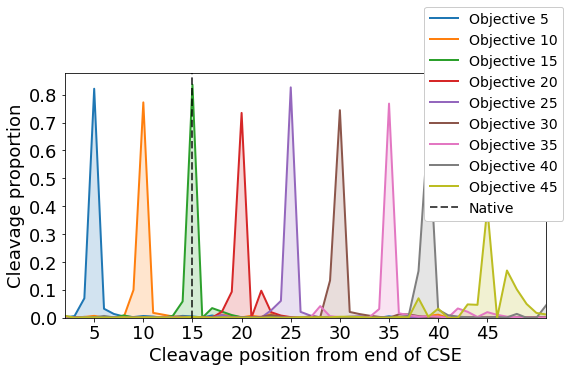

Mean cut map


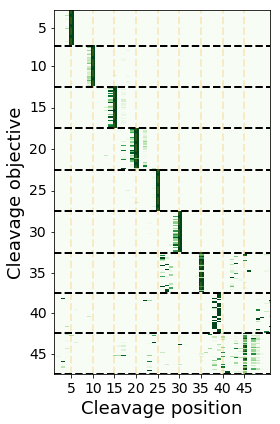

Max cut map


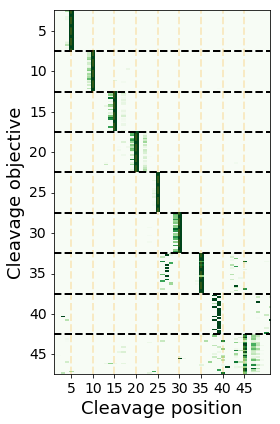

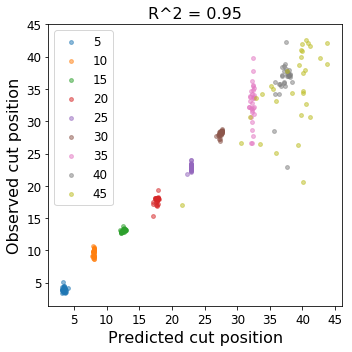

In [13]:
#Mean and Max statistics over A subexperiments

cut_nt = 'A'
aruns_objective = ''
ggcc_objective = '_GGCC'
cut_to_subexperiment = {
    5 : [cut_nt + aruns_objective + '_60', cut_nt + aruns_objective + '_ent_60'],
    10 : [cut_nt + aruns_objective + '_65', cut_nt + aruns_objective + '_ent_65'],
    15 : [cut_nt + aruns_objective + '_70', cut_nt + aruns_objective + '_ent_70'],
    20 : [cut_nt + aruns_objective + '_75', cut_nt + aruns_objective + '_ent_75'],
    25 : [cut_nt + aruns_objective + '_80', cut_nt + aruns_objective + '_ent_80'],
    30 : [cut_nt + ggcc_objective + aruns_objective + '_85', cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    35 : [cut_nt + ggcc_objective + aruns_objective + '_90', cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    40 : [cut_nt + ggcc_objective + aruns_objective + '_95', cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    45 : [cut_nt + ggcc_objective + aruns_objective + '_100', cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
}

print('Mean cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=None)#save_fig_name='cut_profile_subexp_a_mean'
print('Max cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=5)#save_fig_name='cut_profile_subexp_a_max'

print('Mean cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=100)#save_fig_name='cut_map_all_subexp_a_mean'
print('Max cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=25)#save_fig_name='cut_map_all_subexp_a_max'

plot_position_scatter(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, variant_filter="variant == 'wt' or variant == 'sampled'", figsize=(5, 5), save_fig_name=None, fig_dpi=150)#save_fig_name='avgcut_pred_vs_true_subexp_a'


<h2>Summary Max Cut analysis ('AT' subexperiment)</h2>

Mean cut profile


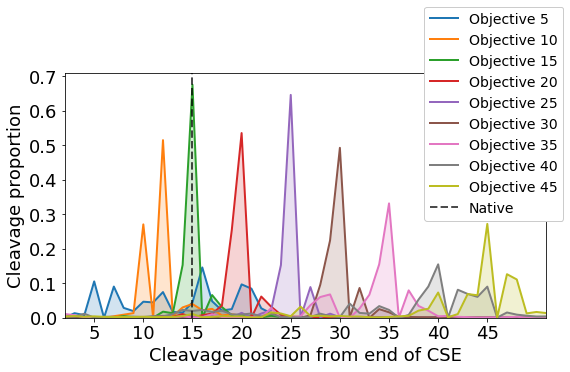

Max cut profile


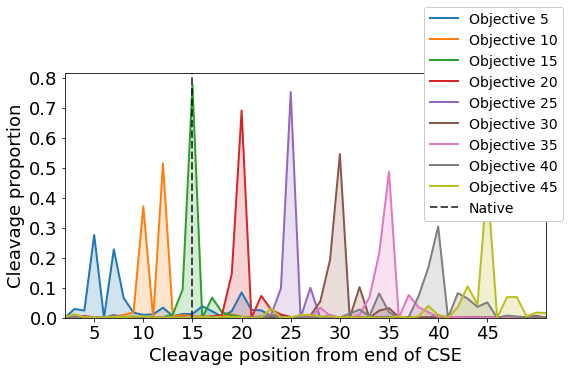

Mean cut map


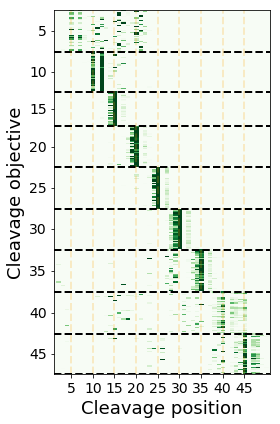

Max cut map


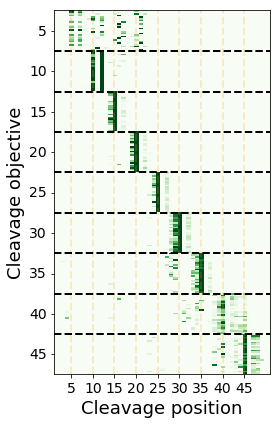

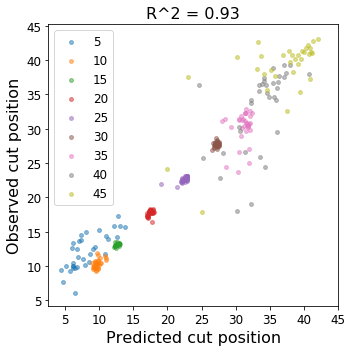

In [14]:
#Mean and Max statistics over AT subexperiments

cut_nt = 'AT'
aruns_objective = ''
ggcc_objective = '_GGCC'
cut_to_subexperiment = {
    5 : [cut_nt + aruns_objective + '_60', cut_nt + aruns_objective + '_ent_60'],
    10 : [cut_nt + aruns_objective + '_65', cut_nt + aruns_objective + '_ent_65'],
    15 : [cut_nt + aruns_objective + '_70', cut_nt + aruns_objective + '_ent_70'],
    20 : [cut_nt + aruns_objective + '_75', cut_nt + aruns_objective + '_ent_75'],
    25 : [cut_nt + aruns_objective + '_80', cut_nt + aruns_objective + '_ent_80'],
    30 : [cut_nt + ggcc_objective + aruns_objective + '_85', cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    35 : [cut_nt + ggcc_objective + aruns_objective + '_90', cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    40 : [cut_nt + ggcc_objective + aruns_objective + '_95', cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    45 : [cut_nt + ggcc_objective + aruns_objective + '_100', cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
}

print('Mean cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=None)#save_fig_name='cut_profile_subexp_at_mean'
print('Max cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=5)#save_fig_name='cut_profile_subexp_at_max'

print('Mean cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=100)#save_fig_name='cut_map_subexp_at_mean'
print('Max cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=25)#save_fig_name='cut_map_subexp_at_max'

plot_position_scatter(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, variant_filter="variant == 'wt' or variant == 'sampled'", figsize=(5, 5), save_fig_name=None, fig_dpi=150)#save_fig_name='avgcut_pred_vs_true_subexp_at'


<h2>Summary Max Cut analysis ('Punish A-runs' subexperiment)</h2>

Mean cut profile


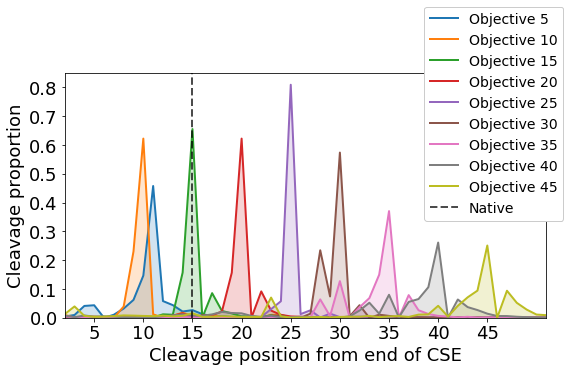

Max cut profile


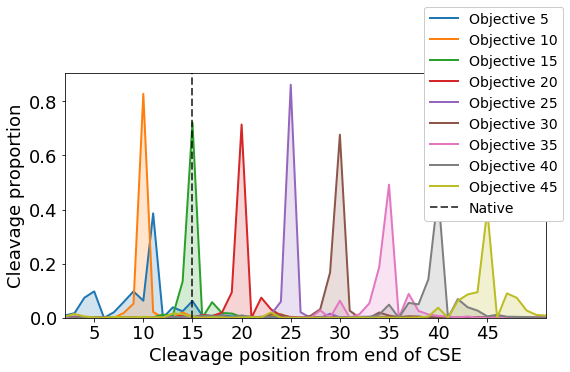

Mean cut map


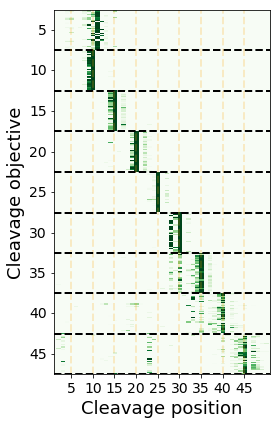

Max cut map


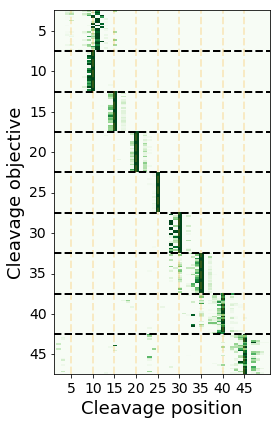

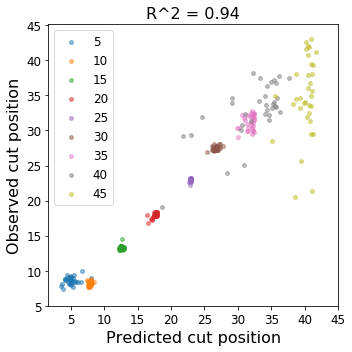

In [15]:
#Mean and Max statistics over A aruns subexperiments

cut_nt = 'A'
aruns_objective = '_aruns'
ggcc_objective = '_GGCC'
cut_to_subexperiment = {
    5 : [cut_nt + aruns_objective + '_60', cut_nt + aruns_objective + '_ent_60'],
    10 : [cut_nt + aruns_objective + '_65', cut_nt + aruns_objective + '_ent_65'],
    15 : [cut_nt + aruns_objective + '_70', cut_nt + aruns_objective + '_ent_70'],
    20 : [cut_nt + aruns_objective + '_75', cut_nt + aruns_objective + '_ent_75'],
    25 : [cut_nt + aruns_objective + '_80', cut_nt + aruns_objective + '_ent_80'],
    30 : [cut_nt + ggcc_objective + aruns_objective + '_85', cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    35 : [cut_nt + ggcc_objective + aruns_objective + '_90', cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    40 : [cut_nt + ggcc_objective + aruns_objective + '_95', cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    45 : [cut_nt + ggcc_objective + aruns_objective + '_100', cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
}

print('Mean cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=None)#save_fig_name='cut_profile_subexp_aruns_mean'
print('Max cut profile')
plot_cut_profile(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(8, 5.5), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=5)#save_fig_name='cut_profile_subexp_aruns_max'

print('Mean cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='mean', n_samples=100)#save_fig_name='cut_map_subexp_aruns_mean'
print('Max cut map')
plot_cut_map(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, figsize=(4, 6), save_fig_name=None, fig_dpi=150, plot_mode='max', n_samples=25)#save_fig_name='cut_map_subexp_aruns_max'

plot_position_scatter(cut_df_filtered, cut_to_subexperiment, cut_poses, objective_poses, human_cutprob, variant_filter="variant == 'wt' or variant == 'sampled'", figsize=(5, 5), save_fig_name=None, fig_dpi=150)#save_fig_name='avgcut_pred_vs_true_subexp_aruns'


<h2>Detailed Max Cut analysis</h2>

In [16]:
max_cut_pwm_dict, max_cut_yhat_dict = load_max_cut_pwms()


In [17]:
#Un-comment to generate Max Cut- sequences for folding

#Max Cut Sequences
#cut_df_filtered['fold_pos'] = cut_df_filtered['subexperiment'].apply(lambda exp: int(exp.split('_')[-1]) + 1)
#cut_df_filtered.reset_index()[['master_seq', 'fold_pos']].to_csv('folding/array_maxcut_seqs.csv', sep=',', index=False)

#Max Cut SNV Sequences
#cut_snv_df_filtered['fold_pos'] = cut_snv_df_filtered['subexperiment'].apply(lambda exp: int(exp.split('_')[-1]) + 1)
#cut_snv_df_filtered.reset_index()[['master_seq', 'fold_pos']].to_csv('folding/array_maxcut_snv_seqs.csv', sep=',', index=False)


In [18]:
#Read folded Max Cut- sequences
cut_fold_df = pd.read_csv('folding/array_maxcut_seqs_folded.csv', sep=',')[['master_seq', 'mfe', 'struct']].set_index('master_seq')
cut_df_filtered_folded = cut_df_filtered.join(cut_fold_df, on='master_seq', how='inner')

#Read folded Mac Cut SNV- sequences
cut_snv_fold_df = pd.read_csv('folding/array_maxcut_snv_seqs_folded.csv', sep=',')[['master_seq', 'mfe', 'struct']].set_index('master_seq')
cut_snv_df_filtered_folded = cut_snv_df_filtered.join(cut_snv_fold_df, on='master_seq', how='inner')
cut_snv_df_filtered_folded = cut_snv_df_filtered_folded.join(cut_df_filtered_folded.set_index('master_seq'), on='wt_seq', how='inner', rsuffix='_wt')

<h2>Best Max Cut sequences ('A' subexperiment)</h2>

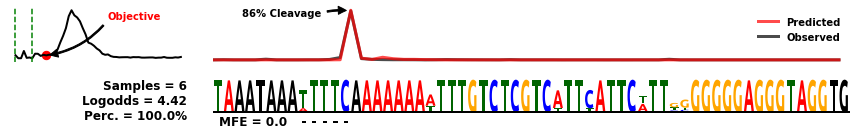

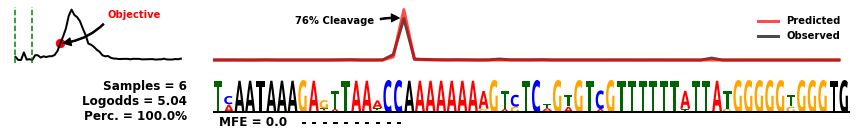

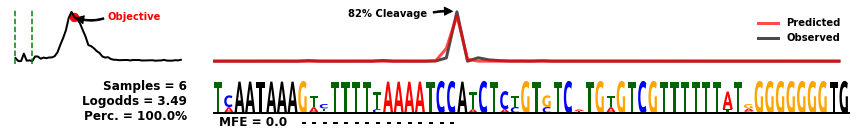

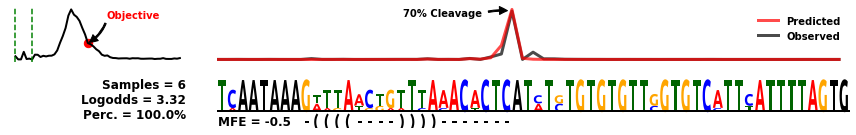

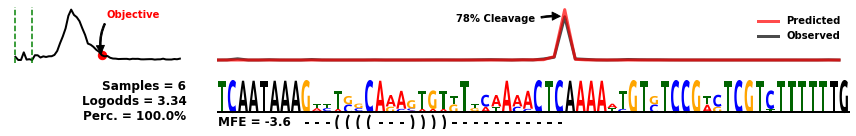

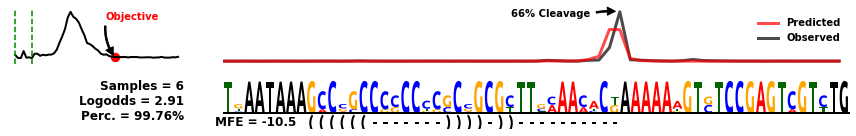

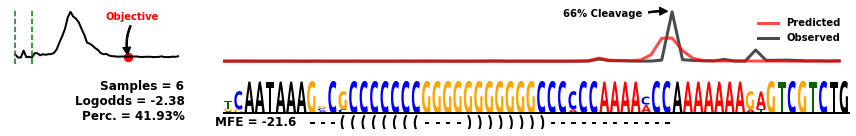

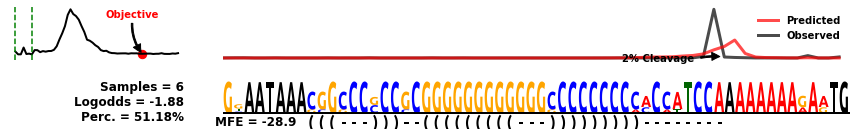

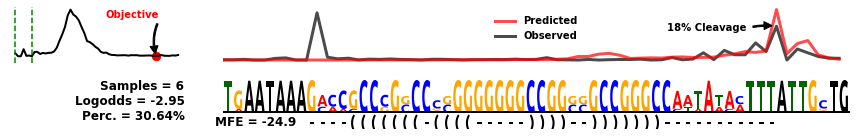

In [19]:

df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

cut_nt = 'A'
aruns_objective = ''
ggcc_objective = '_GGCC'
subexperiments = [
    [cut_nt + aruns_objective + '_60'],#, cut_nt + aruns_objective + '_ent_60'
    [cut_nt + aruns_objective + '_65'],#, cut_nt + aruns_objective + '_ent_65'],
    [cut_nt + aruns_objective + '_70'],#, cut_nt + aruns_objective + '_ent_70'],
    [cut_nt + aruns_objective + '_75'],#, cut_nt + aruns_objective + '_ent_75'],
    [cut_nt + aruns_objective + '_80'],#, cut_nt + aruns_objective + '_ent_80'],
    [cut_nt + ggcc_objective + aruns_objective + '_85'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    [cut_nt + ggcc_objective + aruns_objective + '_90'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    [cut_nt + ggcc_objective + aruns_objective + '_95'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    [cut_nt + ggcc_objective + aruns_objective + '_100'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
]


true_column='median_proximal_vs_distal_logodds_true'
cut_column='cut_prob_true'

usage_unit = 'log'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=True
plot_opt_pwm=False

black_fixed_seq=True

#plot_start=15
#plot_end=110
#figsize=(14,2)
#width_ratios=[2, 1, 14]
#logo_height = 0.85
plot_start=48
plot_end=108
figsize=(12,2)
width_ratios=[4, 1, 14]
logo_height = 0.85

plot_percentile=True
override_mean_stats=False

max_index=0
normalize_probs = True
normalize_range = [plot_start, plot_end]#None
agg_mode = 'avg'

annotate_peaks=True

plot_mfe=True
fold_height=0.7

save_figs=False

for i, subexperiment in enumerate(subexperiments) :
    plot_cut_logo(cut_df_filtered_folded.query("gene == 'simple'").reset_index(), df_human, max_cut_pwm_dict, max_cut_yhat_dict, 'simple', subexperiment, plot_mfe=plot_mfe, fold_height=fold_height, annotate_peaks=annotate_peaks, normalize_probs=normalize_probs, normalize_range=normalize_range, agg_mode=agg_mode, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, cut_column=cut_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_cut_' + subexperiment[0], fig_dpi=300)

<h2>Best Max Cut sequences ('AT' subexperiment)</h2>

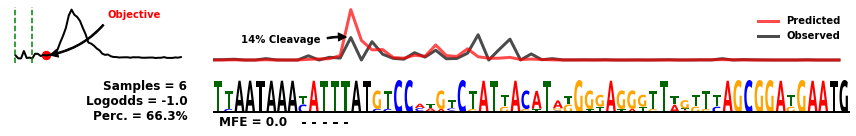

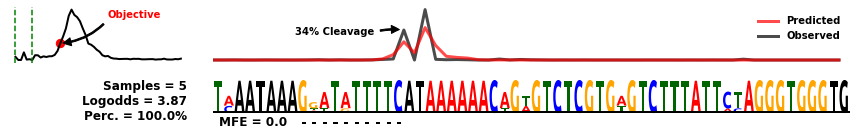

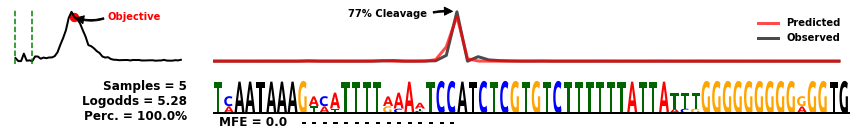

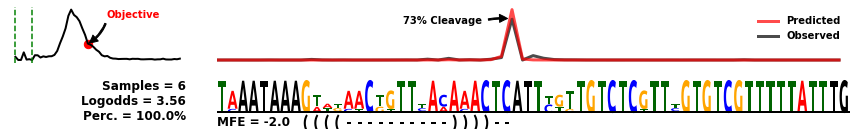

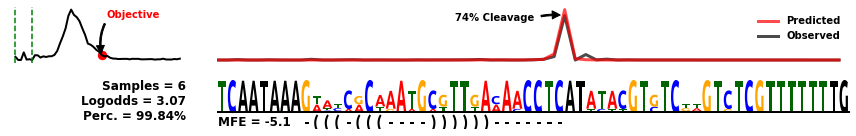

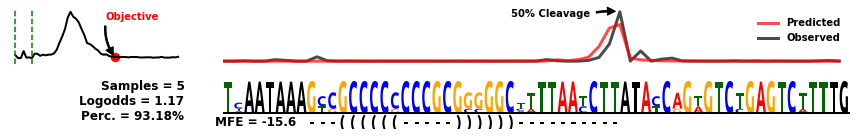

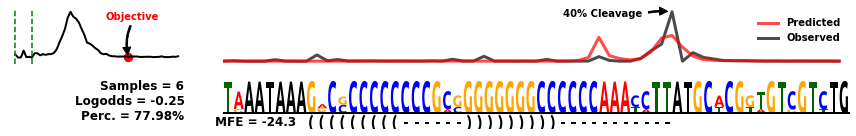

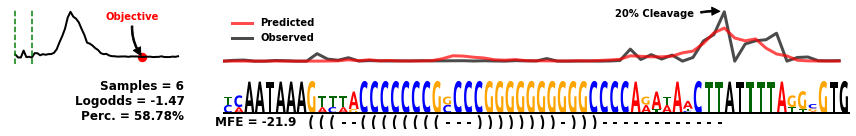

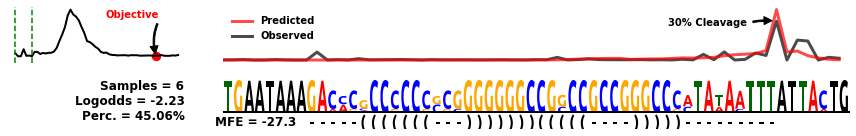

In [20]:

df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

cut_nt = 'AT'
aruns_objective = ''
ggcc_objective = '_GGCC'
subexperiments = [
    [cut_nt + aruns_objective + '_60'],#, cut_nt + aruns_objective + '_ent_60'
    [cut_nt + aruns_objective + '_65'],#, cut_nt + aruns_objective + '_ent_65'],
    [cut_nt + aruns_objective + '_70'],#, cut_nt + aruns_objective + '_ent_70'],
    [cut_nt + aruns_objective + '_75'],#, cut_nt + aruns_objective + '_ent_75'],
    [cut_nt + aruns_objective + '_80'],#, cut_nt + aruns_objective + '_ent_80'],
    [cut_nt + ggcc_objective + aruns_objective + '_85'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    [cut_nt + ggcc_objective + aruns_objective + '_90'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    [cut_nt + ggcc_objective + aruns_objective + '_95'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    [cut_nt + ggcc_objective + aruns_objective + '_100'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
]


true_column='median_proximal_vs_distal_logodds_true'
cut_column='cut_prob_true'

usage_unit = 'log'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=True
plot_opt_pwm=False

black_fixed_seq=True

#plot_start=15
#plot_end=110
#figsize=(14,2)
#width_ratios=[2, 1, 14]
#logo_height = 0.85
plot_start=48
plot_end=108
figsize=(12,2)
width_ratios=[4, 1, 14]
logo_height = 0.85

plot_percentile=True
override_mean_stats=False

max_index=0
normalize_probs = True
normalize_range = [plot_start, plot_end]#None
agg_mode = 'avg'

annotate_peaks=True

plot_mfe=True
fold_height=0.7

save_figs=False

for i, subexperiment in enumerate(subexperiments) :
    plot_cut_logo(cut_df_filtered_folded.query("gene == 'simple'").reset_index(), df_human, max_cut_pwm_dict, max_cut_yhat_dict, 'simple', subexperiment, plot_mfe=plot_mfe, fold_height=fold_height, annotate_peaks=annotate_peaks, normalize_probs=normalize_probs, normalize_range=normalize_range, agg_mode=agg_mode, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, cut_column=cut_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_cut_' + subexperiment[0], fig_dpi=300)

<h2>Best Max Cut sequences ('Punish A-runs' subexperiment)</h2>

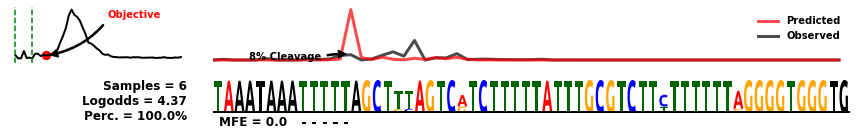

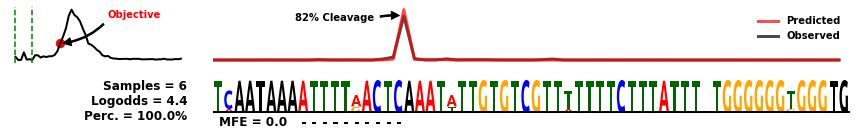

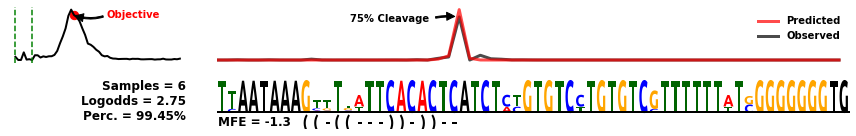

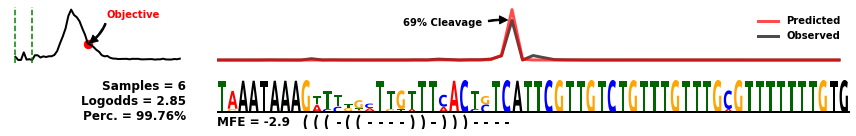

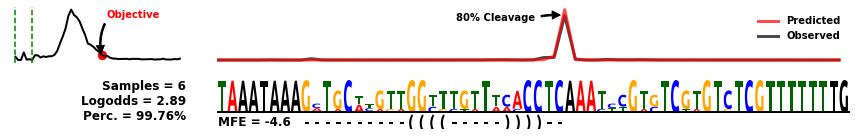

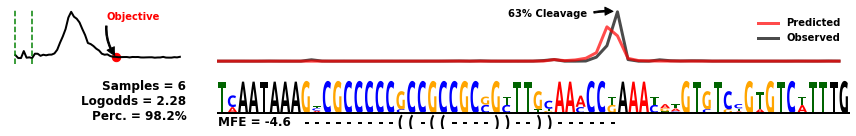

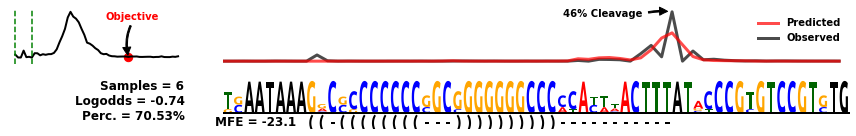

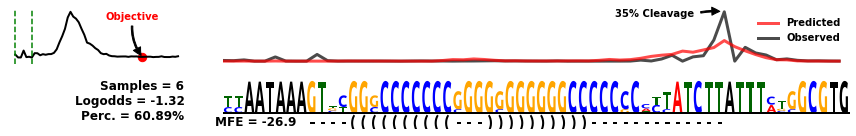

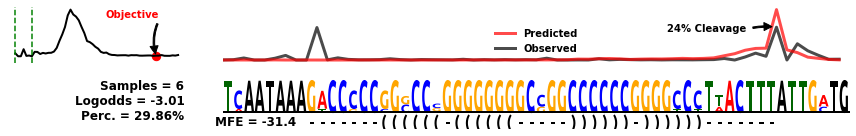

In [21]:

df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

cut_nt = 'A'
aruns_objective = '_aruns'
ggcc_objective = '_GGCC'
subexperiments = [
    [cut_nt + aruns_objective + '_60'],#, cut_nt + aruns_objective + '_ent_60'
    [cut_nt + aruns_objective + '_65'],#, cut_nt + aruns_objective + '_ent_65'],
    [cut_nt + aruns_objective + '_70'],#, cut_nt + aruns_objective + '_ent_70'],
    [cut_nt + aruns_objective + '_75'],#, cut_nt + aruns_objective + '_ent_75'],
    [cut_nt + aruns_objective + '_80'],#, cut_nt + aruns_objective + '_ent_80'],
    [cut_nt + ggcc_objective + aruns_objective + '_85'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_85'],
    [cut_nt + ggcc_objective + aruns_objective + '_90'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_90'],
    [cut_nt + ggcc_objective + aruns_objective + '_95'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_95'],
    [cut_nt + ggcc_objective + aruns_objective + '_100'],#, cut_nt + ggcc_objective + aruns_objective + '_ent_100'],
]


true_column='median_proximal_vs_distal_logodds_true'
cut_column='cut_prob_true'

usage_unit = 'log'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=True
plot_opt_pwm=False

black_fixed_seq=True

#plot_start=15
#plot_end=110
#figsize=(14,2)
#width_ratios=[2, 1, 14]
#logo_height = 0.85
plot_start=48
plot_end=108
figsize=(12,2)
width_ratios=[4, 1, 14]
logo_height = 0.85

plot_percentile=True
override_mean_stats=False

max_index=0
normalize_probs = True
normalize_range = [plot_start, plot_end]#None
agg_mode = 'avg'

annotate_peaks=True

plot_mfe=True
fold_height=0.7

save_figs=False

for i, subexperiment in enumerate(subexperiments) :
    plot_cut_logo(cut_df_filtered_folded.query("gene == 'simple'").reset_index(), df_human, max_cut_pwm_dict, max_cut_yhat_dict, 'simple', subexperiment, plot_mfe=plot_mfe, fold_height=fold_height, annotate_peaks=annotate_peaks, normalize_probs=normalize_probs, normalize_range=normalize_range, agg_mode=agg_mode, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, cut_column=cut_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_cut_' + subexperiment[0], fig_dpi=300)

<h2>Max Cut sequences with Saturation Mutagenesis measurements</h2>

9


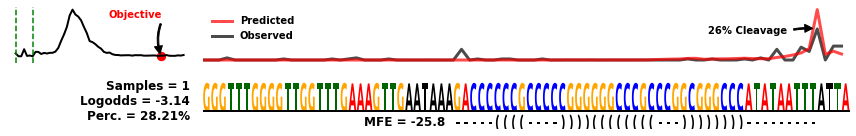

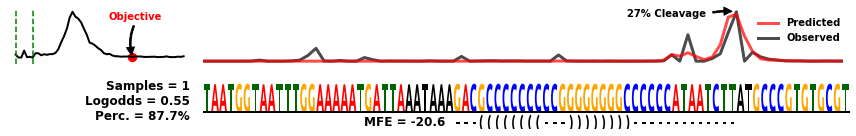

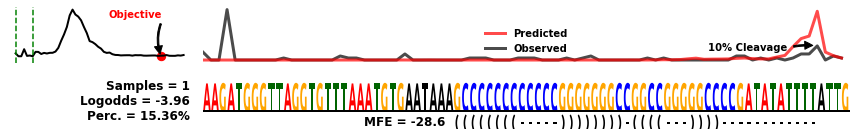

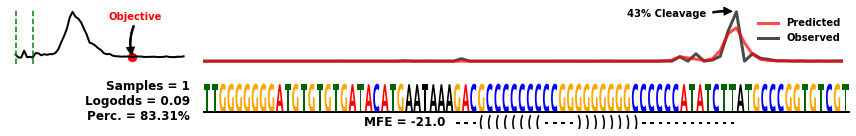

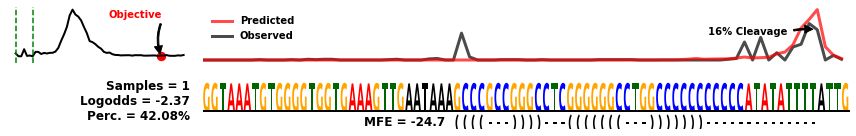

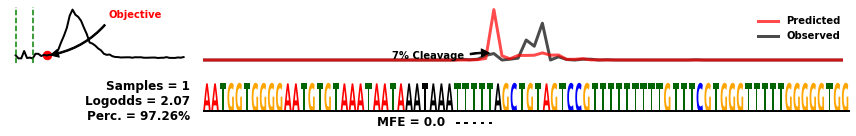

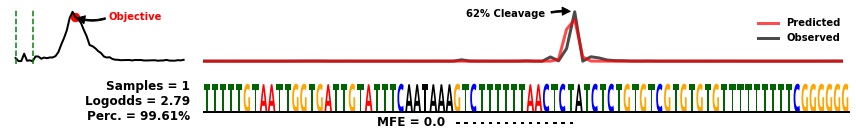

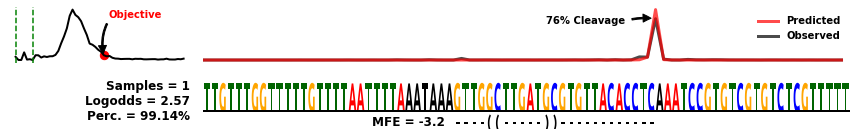

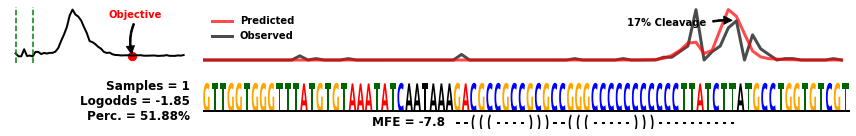

In [22]:
df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

true_column='median_proximal_vs_distal_logodds_true'
cut_column='cut_prob_true'

usage_unit = 'log'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=True
plot_opt_pwm=False

black_fixed_seq=True

plot_start=25
plot_end=105
figsize=(12,2)
width_ratios=[4, 1, 14]
logo_height = 0.75

plot_percentile=True
override_mean_stats=False

max_index=0
normalize_probs = True
normalize_range = [plot_start, plot_end]#None
agg_mode = 'avg'

annotate_peaks=True

plot_mfe=True
fold_height=0.7

save_figs=False

snv_distinct_seqs = cut_snv_df_filtered['wt_seq'].unique()

cut_df_filtered_folded_sel = cut_df_filtered_folded.loc[cut_df_filtered_folded.wt_seq.isin(snv_distinct_seqs)]
print(len(cut_df_filtered_folded_sel))

for subexperiment_i, subexperiment in enumerate(sorted(cut_snv_df_filtered['subexperiment'].unique())) :

    plot_cut_logo(cut_df_filtered_folded_sel.query("gene == 'simple'").reset_index(), df_human, max_cut_pwm_dict, max_cut_yhat_dict, 'simple', [subexperiment], plot_mfe=plot_mfe, fold_height=fold_height, annotate_peaks=annotate_peaks, normalize_probs=normalize_probs, normalize_range=normalize_range, agg_mode=agg_mode, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, cut_column=cut_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_cut_' + subexperiment, fig_dpi=300)


<h2>Saturation Mutagenesis of a CSE+35 optimized Max Cut Sequence</h2>

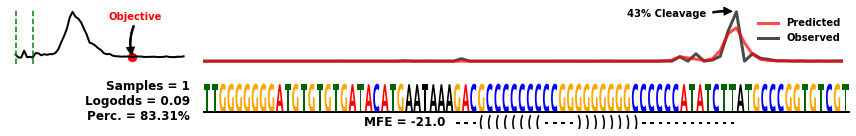

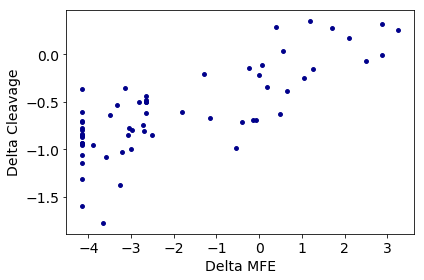

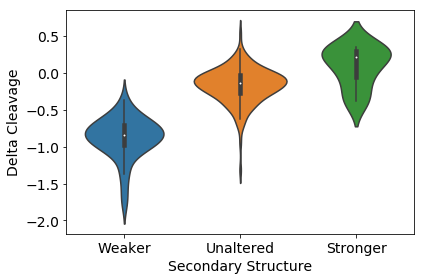

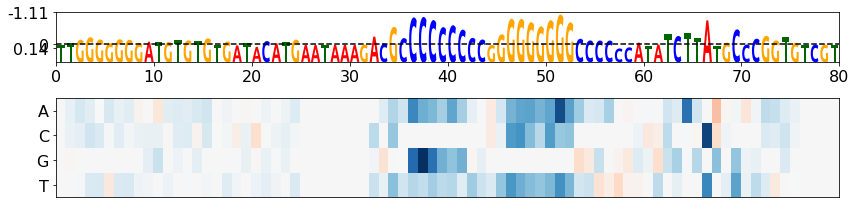

In [23]:
df_human = seq_df_filtered.query("experiment == 'clinvar_wt' and variant == 'wt'")

cut_nt = 'A'
aruns_objective = '_aruns'
ggcc_objective = '_GGCC'
subexperiment = [cut_nt + ggcc_objective + aruns_objective + '_ent_90']

true_column='median_proximal_vs_distal_logodds_true'
cut_column='cut_prob_true'
pred_cut_column='cut_prob_pred'

usage_unit = 'log'

plot_mean_logo=False
plot_max_logo=True
plot_actual_pwm=True
plot_opt_pwm=False

black_fixed_seq=True

plot_start=25
plot_end=105
figsize=(12,2)
width_ratios=[4, 1, 14]
logo_height = 0.75

plot_percentile=True
override_mean_stats=False

max_index=0
normalize_probs = True
normalize_range = [plot_start, plot_end]
agg_mode = 'avg'

annotate_peaks=True

plot_mfe=True
fold_height=0.7

save_figs=False

snv_distinct_seqs = cut_snv_df_filtered['wt_seq'].unique()

cut_df_filtered_folded_sel = cut_df_filtered_folded.loc[cut_df_filtered_folded.wt_seq.isin(snv_distinct_seqs)]

plot_cut_logo(cut_df_filtered_folded_sel.query("gene == 'simple'").reset_index(), df_human, max_cut_pwm_dict, max_cut_yhat_dict, 'simple', subexperiment, plot_mfe=plot_mfe, fold_height=fold_height, annotate_peaks=annotate_peaks, normalize_probs=normalize_probs, normalize_range=normalize_range, agg_mode=agg_mode, override_mean_stats=override_mean_stats, plot_percentile=plot_percentile, plot_mean_logo=plot_mean_logo, plot_max_logo=plot_max_logo, plot_actual_pwm=plot_actual_pwm, plot_opt_pwm=plot_opt_pwm, black_fixed_seq=black_fixed_seq, max_index=max_index, true_column=true_column, cut_column=cut_column, figsize=figsize, width_ratios=width_ratios, logo_height=logo_height, usage_unit=usage_unit, plot_snvs=False, seq_trim_start=0, seq_trim_end=164, plot_start=plot_start, plot_end=plot_end, pas_downscaling=1.0, save_figs=save_figs, fig_name='max_cut_' + subexperiment[0], fig_dpi=300)

wt_seq = cut_snv_df_filtered_folded.query("subexperiment == '" + subexperiment[0] + "'")['wt_seq'].unique()[0]

snv_df = cut_snv_df_filtered_folded.loc[cut_snv_df_filtered_folded.wt_seq.str.contains(wt_seq)].copy()

obj_pos = int(subexperiment[0].split("_")[-1])

#Map SNV positions
snv_poses = []
for index, row in snv_df.iterrows() :
    
    snv_pos = -1
    seq = row['master_seq']
    wt_seq = row['wt_seq']
    
    for j in range(0, len(seq)) :
        if seq[j] != wt_seq[j] :
            snv_pos = j
            break
    
    snv_poses.append(snv_pos)

snv_df['snv_pos'] = snv_poses

snv_df = snv_df.query("((snv_pos > 0 and snv_pos < 50) or (snv_pos > 56 and snv_pos < 105))")# and snv_pos != " + str(obj_pos + 1))

#Calculate true variant and wt cut log odds
snv_df['norm_cuts'] = snv_df[cut_column].apply(lambda c: c[:plot_end] / np.sum(c[:plot_end]))
snv_df['cut_logodds'] = snv_df['norm_cuts'].apply(lambda c: np.sum(c[obj_pos:obj_pos+2]))
snv_df['cut_logodds'] = np.ravel(np.log(snv_df['cut_logodds'] / (1. - snv_df['cut_logodds'])))

snv_df['norm_cuts_wt'] = snv_df[cut_column + '_wt'].apply(lambda c: c[:plot_end] / np.sum(c[:plot_end]))
snv_df['cut_logodds_wt'] = snv_df['norm_cuts_wt'].apply(lambda c: np.sum(c[obj_pos:obj_pos+2]))
snv_df['cut_logodds_wt'] = np.ravel(np.log(snv_df['cut_logodds_wt'] / (1. - snv_df['cut_logodds_wt'])))

#Calculate predicted variant and wt cut log odds
snv_df['pred_norm_cuts'] = snv_df[pred_cut_column].apply(lambda c: c[:plot_end] / np.sum(c[:plot_end]))
snv_df['pred_cut_logodds'] = snv_df['pred_norm_cuts'].apply(lambda c: np.sum(c[obj_pos:obj_pos+2]))
snv_df['pred_cut_logodds'] = np.ravel(np.log(snv_df['pred_cut_logodds'] / (1. - snv_df['pred_cut_logodds'])))

snv_df['pred_norm_cuts_wt'] = snv_df[pred_cut_column + '_wt'].apply(lambda c: c[:plot_end] / np.sum(c[:plot_end]))
snv_df['pred_cut_logodds_wt'] = snv_df['pred_norm_cuts_wt'].apply(lambda c: np.sum(c[obj_pos:obj_pos+2]))
snv_df['pred_cut_logodds_wt'] = np.ravel(np.log(snv_df['pred_cut_logodds_wt'] / (1. - snv_df['pred_cut_logodds_wt'])))

#Calculate delta statistics (variant - wt)
snv_df['delta_mfe'] = snv_df['mfe'] - snv_df['mfe_wt']
snv_df['delta_logodds'] = snv_df['cut_logodds'] - snv_df['cut_logodds_wt']
snv_df['pred_delta_logodds'] = snv_df['pred_cut_logodds'] - snv_df['pred_cut_logodds_wt']




altered_struct = []
for index, row in snv_df.iterrows() :
    if row['struct'] != row['struct_wt'] and row['mfe'] < row['mfe_wt'] :
        altered_struct.append('Stronger')
    elif row['struct'] != row['struct_wt'] and row['mfe'] >= row['mfe_wt'] :
        altered_struct.append('Weaker')
    else :
        altered_struct.append('Unaltered')

snv_df['altered_struct'] = altered_struct

plot_df = snv_df.query("snv_pos != " + str(obj_pos + 1) + " and delta_mfe != 0")
violin_df = snv_df.query("snv_pos != " + str(obj_pos + 1))

#Plot scatter of SNV effects as a function of delta MFE
plt.figure(figsize=(6, 4))
plt.scatter(-1. * plot_df['delta_mfe'], plot_df['delta_logodds'], color = 'darkblue', s=15)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Delta MFE", fontsize=14)
plt.ylabel("Delta Cleavage", fontsize=14)
if save_figs :
    plt.savefig(subexperiment[0] + "_mfe_vs_logodds_scatter.eps")
    plt.savefig(subexperiment[0] + "_mfe_vs_logodds_scatter.png", transparent=True, dpi=150)
plt.tight_layout()
plt.show()

#Plot violinplot of SNV effects grouped by impact on secondary structure
plt.figure(figsize=(6, 4))
sns.violinplot(x="altered_struct", y="delta_logodds", data=violin_df, order=['Weaker', 'Unaltered', 'Stronger'])
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("Secondary Structure", fontsize=14)
plt.ylabel("Delta Cleavage", fontsize=14)
if save_figs :
    plt.savefig(subexperiment[0] + "_mfe_vs_logodds_violin.eps")
    plt.savefig(subexperiment[0] + "_mfe_vs_logodds_violin.png", transparent=True, dpi=150)
plt.tight_layout()
plt.show()

seq_start = 25#48
seq_end = 105#100

#Plot mutation map of fold-altering SNVs
mut_map_fold_snvs(
        snv_df,
        'MaxCut',
        experiment=subexperiment,
        delta_column='delta_logodds',
        mode='true',
        figsize=(12,3),
        seq_trim_start=seq_start, seq_trim_end=seq_end,
        plot_start=0, plot_end=seq_end-seq_start,
        cut_downscaling=0.5,
        fig_name=(subexperiment[0] + '_Mutmap_Logodds_Observed') if save_figs else None,
        fig_dpi=300
)


<h2>Absolute isoform predictions of Native Human pA sites</h2>

clinvar_wt = 1085


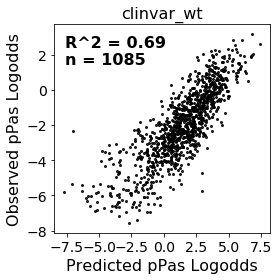

intronic_pas = 9800


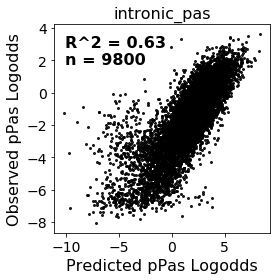

In [24]:
#Absolute native predictions, split by experiment

save_figs = False

pred_column = 'mean_logodds_pred'
true_column = 'pooled_proximal_logodds'

for experiment in ['clinvar_wt', 'intronic_pas'] :
    
    filter_query = "variant == 'wt' and mean_total_count >= 200 and n_barcodes >= 7 and experiment == '" + str(experiment) + "'"
    experiment_seq_predicted_isoform_df = seq_df.query(filter_query)
    
    logodds_true_is_nan = (np.isnan(experiment_seq_predicted_isoform_df[true_column]) | np.isinf(experiment_seq_predicted_isoform_df[true_column]))
    logodds_pred_is_nan = (np.isnan(experiment_seq_predicted_isoform_df[pred_column]) | np.isinf(experiment_seq_predicted_isoform_df[pred_column]))
    experiment_seq_predicted_isoform_df = experiment_seq_predicted_isoform_df.loc[(logodds_true_is_nan == False) & (logodds_pred_is_nan == False)]

    print(experiment + ' = ' + str(len(experiment_seq_predicted_isoform_df)))

    #Logodds proportions

    r_val, _ = pearsonr(experiment_seq_predicted_isoform_df[pred_column], experiment_seq_predicted_isoform_df[true_column])

    f = plt.figure(figsize=(4, 4))

    plt.scatter(experiment_seq_predicted_isoform_df[pred_column], experiment_seq_predicted_isoform_df[true_column], alpha=0.85, s=4, c='black')

    annot_text = 'R^2 = ' + str(round(r_val * r_val, 2))
    annot_text += '\nn = ' + str(len(experiment_seq_predicted_isoform_df))
    ax = plt.gca()
    ax.text(0.05, 0.95, annot_text, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes, color='black', fontsize=16, weight="bold")
    
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

    plt.xlabel('Predicted pPas Logodds', fontsize=16)
    plt.ylabel('Observed pPas Logodds', fontsize=16)
    plt.title(experiment, fontsize=16)

    plt.tight_layout()

    if save_figs :
        plt.savefig('absolute_usage_pred_vs_true_' + experiment + '.png', transparent=True, dpi=150)
        plt.savefig('absolute_usage_pred_vs_true_' + experiment + '.eps')

    plt.show()

<h2>Summary ClinVar and ACMG variant analysis</h2>

In [25]:
variant_df_filtered = variant_df.query("n_barcodes_var >= 5 and n_barcodes_ref >= 5 and mean_total_count_var >= 200 and mean_total_count_ref >= 200")

#Filter on human variants
included_experiments = ['acmg_apadb', 'acmg_polyadb', 'sensitive_genes', 'clinvar_wt', 'human_variant']

filter_query = ""

for exp_index, included_experiment in enumerate(included_experiments) :
    filter_query += "experiment == '" + str(included_experiment) + "'"
    if exp_index < len(included_experiments) - 1 :
        filter_query += " or "

human_variant_df = variant_df.query(filter_query)
human_variant_df_filtered = variant_df_filtered.query(filter_query)


In [26]:
#Add native APADB isoform abundance measurements
apadb_df = pd.read_csv('../data/native_data/apadb/unprocessed_data/hg19.apadb_v2_final.bed', names=['chr', 'start', 'end', 'gene', 'reads', 'strand', 'site_type', 'cut_mean', 'cut_mode', 'mir'], sep='\t')

apadb_variant_df, apadb_variant_df_filtered = append_apadb_isoform_usage(apadb_df, human_variant_df, human_variant_df_filtered)


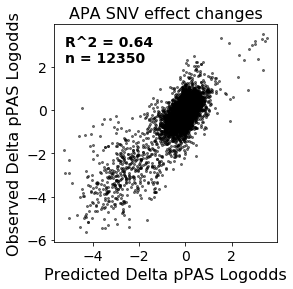

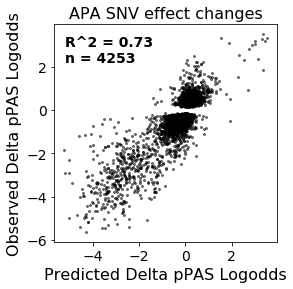

clinvar_wt = 5198


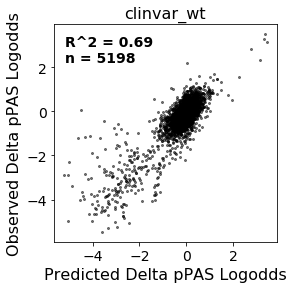

acmg_apadb = 3413


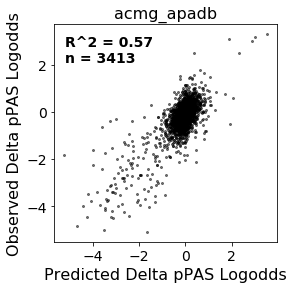

acmg_polyadb = 1748


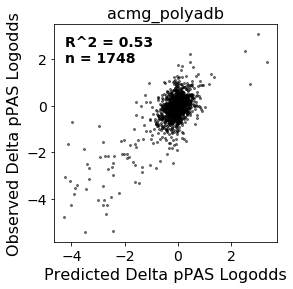

sensitive_genes = 1991


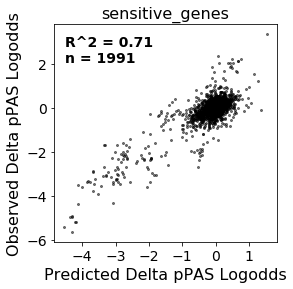

tgta = 4104


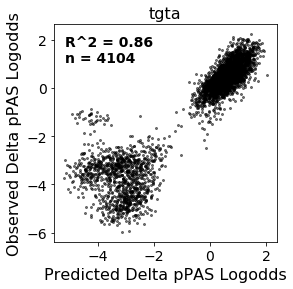

In [27]:
df_to_use = human_variant_df_filtered

save_figs = False

pred_column = 'mean_delta_logodds_pred'
true_column = 'delta_logodds_true'

#Logodds proportions

r_val, _ = pearsonr(df_to_use[pred_column], df_to_use[true_column])

f = plt.figure(figsize=(4, 4))

plt.scatter(df_to_use[pred_column], df_to_use[true_column], alpha=0.5, s=4, c='black')

annot_text = 'R^2 = ' + str(round(r_val * r_val, 2))
annot_text += '\nn = ' + str(len(df_to_use))
ax = plt.gca()
ax.text(0.05, 0.95, annot_text, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes, color='black', fontsize=14, weight="bold")


plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel('Predicted Delta pPAS Logodds', fontsize=16)
plt.ylabel('Observed Delta pPAS Logodds', fontsize=16)
plt.title('APA SNV effect changes', fontsize=16)

#plt.tight_layout()

if save_figs :
    plt.savefig('delta_usage_pred_vs_true_all.png', dpi=150, transparent=True)
    plt.savefig('delta_usage_pred_vs_true_all.eps')

plt.show()


#Logodds proportions, statistically significant difference
df_to_use = human_variant_df_filtered.query("delta_p_val < 0.0001")

r_val, _ = pearsonr(df_to_use[pred_column], df_to_use[true_column])

f = plt.figure(figsize=(4, 4))

plt.scatter(df_to_use[pred_column], df_to_use[true_column], alpha=0.5, s=4, c='black')

annot_text = 'R^2 = ' + str(round(r_val * r_val, 2))
annot_text += '\nn = ' + str(len(df_to_use))
ax = plt.gca()
ax.text(0.05, 0.95, annot_text, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes, color='black', fontsize=14, weight="bold")


plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.xlabel('Predicted Delta pPAS Logodds', fontsize=16)
plt.ylabel('Observed Delta pPAS Logodds', fontsize=16)
plt.title('APA SNV effect changes', fontsize=16)

#plt.tight_layout()

if save_figs :
    plt.savefig('delta_usage_pred_vs_true_significant.png', dpi=150, transparent=True)
    plt.savefig('delta_usage_pred_vs_true_significant.eps')

plt.show()




#Split by experiment
df_to_use = variant_df_filtered

for experiment in ['clinvar_wt', 'acmg_apadb', 'acmg_polyadb', 'sensitive_genes', 'tgta'] :
    
    experiment_seq_predicted_isoform_df = df_to_use.query("experiment == '" + str(experiment) + "'")

    print(experiment + ' = ' + str(len(experiment_seq_predicted_isoform_df)))

    #Logodds proportions

    r_val, _ = pearsonr(experiment_seq_predicted_isoform_df[pred_column], experiment_seq_predicted_isoform_df[true_column])

    f = plt.figure(figsize=(4, 4))

    plt.scatter(experiment_seq_predicted_isoform_df[pred_column], experiment_seq_predicted_isoform_df[true_column], alpha=0.5, s=4, c='black')

    annot_text = 'R^2 = ' + str(round(r_val * r_val, 2))
    annot_text += '\nn = ' + str(len(experiment_seq_predicted_isoform_df))
    ax = plt.gca()
    ax.text(0.05, 0.95, annot_text, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes, color='black', fontsize=14, weight="bold")


    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

    plt.xlabel('Predicted Delta pPAS Logodds', fontsize=16)
    plt.ylabel('Observed Delta pPAS Logodds', fontsize=16)
    plt.title(experiment, fontsize=16)

    #plt.tight_layout()

    if save_figs :
        plt.savefig('delta_usage_pred_vs_true_' + str(experiment) + '.png', dpi=150, transparent=True)
        plt.savefig('delta_usage_pred_vs_true_' + str(experiment) + '.eps')

    plt.show()



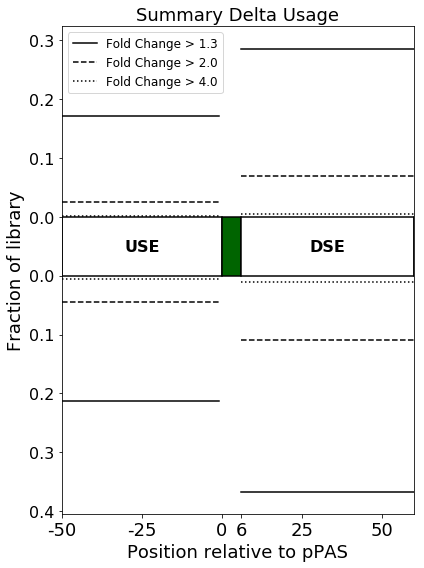

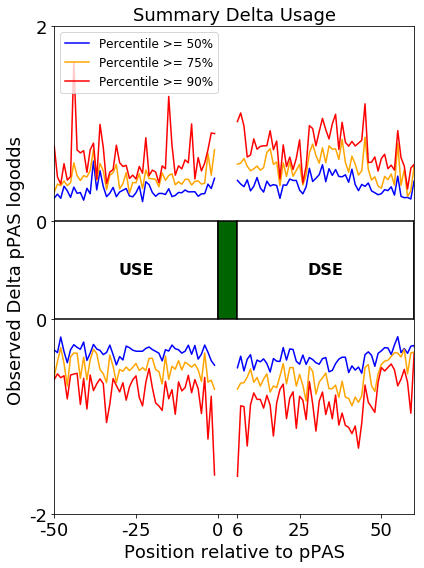

In [28]:
save_figs = False

df_to_use = human_variant_df_filtered.set_index('master_seq')
figsize=(6, 8)

fig_name = None
if save_figs :
    fig_name = 'count_region_all'
plot_count_regions(df_to_use, no_denovo=True, plot_frac=True, count_vs_all=False, annotation_height=0.1, significance_level=0.01, delta_threshes=[0.3, 0.693, 1.3863], delta_linestyles=['-', '--', ':'], figsize=figsize, fig_name=fig_name, plot_start=-50, plot_end=100, fig_dpi=150, pred_column='delta_logodds_pred', true_column='delta_logodds_true', snv_pos_column='snv_pos')


fig_name = None
if save_figs :
    fig_name = 'perc_pos_all'
plot_perc_positions(df_to_use, no_denovo=True, significance_level=0.01, percentiles=[0.5, 0.75, 0.90], percentile_colors=['blue', 'orange', 'red'], figsize=figsize, fig_name=fig_name, plot_start=-50, plot_end=100, fig_dpi=150, pred_column='delta_logodds_pred', true_column='delta_logodds_true', snv_pos_column='snv_pos')



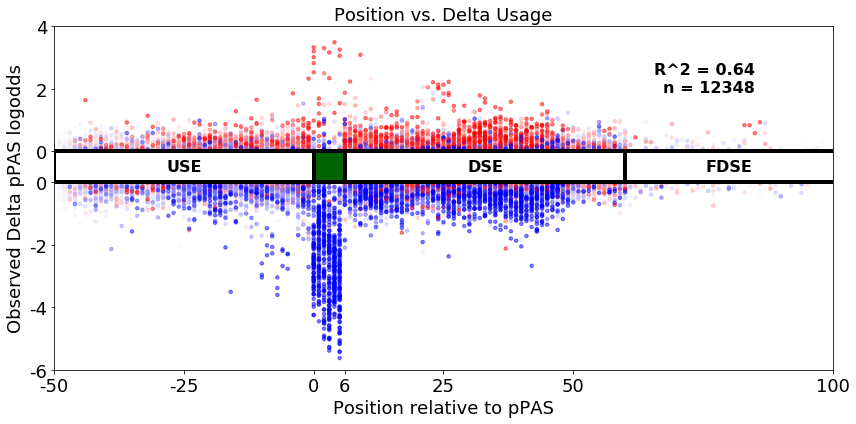

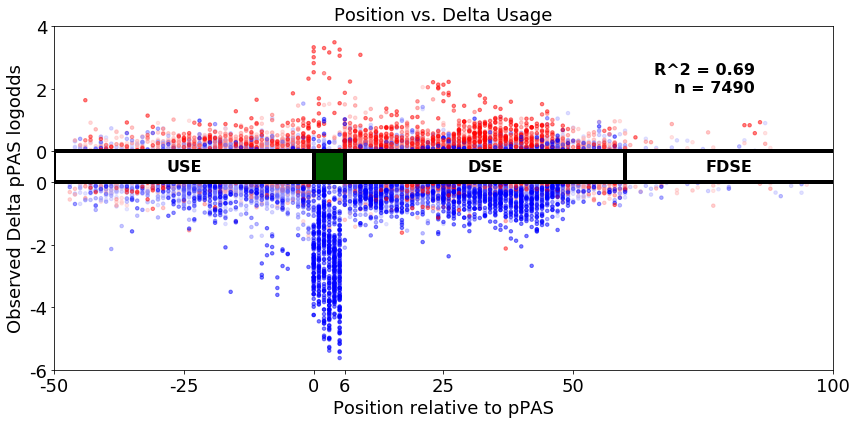

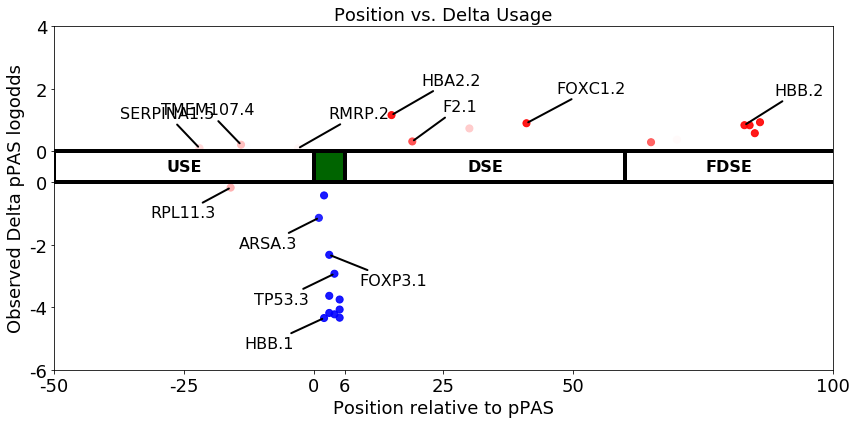

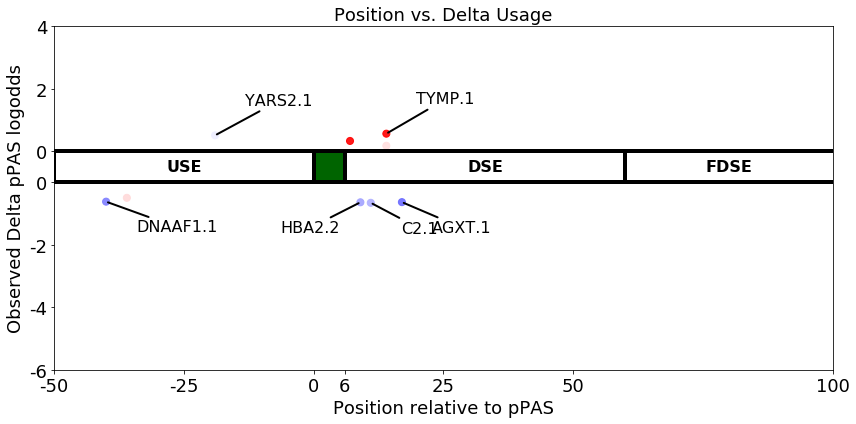

In [29]:

save_figs = False

#All variants
df_to_use = human_variant_df_filtered

figsize=(12, 6)

fig_name = None
if save_figs :
    fig_name = 'position_delta_all'
plot_position_delta_scatter(df_to_use, pred_column=['mean_delta_logodds_pred'], min_pred_filter=0.0, figsize=figsize, fig_name=fig_name, vmin=-0.5, vmax=0.5, fig_dpi=150, annotate=None)



#Filtered on prediction >= 0.1 (log)
df_to_use = human_variant_df_filtered

fig_name = None
if save_figs :
    fig_name = 'position_delta_all_pred_ge_01'
plot_position_delta_scatter(df_to_use, pred_column=['mean_delta_logodds_pred'], min_pred_filter=0.1, figsize=figsize, fig_name=fig_name, vmin=-0.5, vmax=0.5, fig_dpi=150, annotate=None)


#Annotate pathogenic variants
bg_df = human_variant_df_filtered

pathogenic_df = human_variant_df.query("significance == 'Pathogenic'")

gene_blacklist = [('RNU4ATAC.4', 200.0), ('HBB.3', 200), ('HBB.4', 200)]

keep_index = []
for index, row in pathogenic_df.iterrows() :
    blacklisted = False
    
    for filter_gene, filter_pos in gene_blacklist :
        if row['gene'] == filter_gene and row['snv_pos'] < filter_pos :
            blacklisted = True
    
    if not blacklisted :
        keep_index.append(index)

pathogenic_df = pathogenic_df.loc[keep_index]

annotate = {
    'annotate_right_list' : ['F2.1', 'FOXC1.2', 'RMRP.2', 'HBB.2', 'HBA2.2'],
    'annotate_right_down_list' : ['FOXP3.1', 'RNU4ATAC.4'],
    'annotate_left_list' : ['HBB.3', 'HBB.4', 'TMEM107.4', 'SERPINA1.5'],
    'annotate_left_down_list' : ['HBB.1', 'TP53.3', 'ARSA.3', 'RPL11.3']
}

fig_name = None
if save_figs :
    fig_name = 'position_delta_pathogenic'
plot_position_delta_scatter(pathogenic_df, pred_column=['mean_delta_logodds_pred'], min_pred_filter=0.0, figsize=figsize, dot_size=50, dot_alpha=0.9, vmin=-0.5, vmax=0.45, show_stats=False, fig_name=fig_name, fig_dpi=150, annotate=annotate, bg_df=None)


#Annotate conflicting variants, stat. significant only
bg_df = human_variant_df_filtered

conflicting_df = human_variant_df.query("significance == 'Conflicting' and delta_p_val < 0.05")

gene_blacklist = []
keep_index = []
for index, row in conflicting_df.iterrows() :
    blacklisted = False
    
    for filter_gene, filter_pos in gene_blacklist :
        if row['gene'] == filter_gene and row['snv_pos'] < filter_pos :
            blacklisted = True
    
    if not blacklisted :
        keep_index.append(index)

conflicting_df = conflicting_df.loc[keep_index]

annotate = {
    'annotate_right_list' : ['TYMP.1', 'TAF1C.1', 'YARS2.1'],
    'annotate_right_down_list' : ['C2.1', 'AGXT.1', 'DNAAF1.1'],
    'annotate_left_list' : ['APRT.2'],
    'annotate_left_down_list' : ['HBA2.2', 'MOCS2.6', 'GYS1.3']
}

fig_name = None
if save_figs :
    fig_name = 'position_delta_conflicting_significant'
plot_position_delta_scatter(conflicting_df, pred_column=['mean_delta_logodds_pred'], min_pred_filter=0.0, figsize=figsize, dot_size=50, dot_alpha=0.9, vmin=-0.5, vmax=0.5, show_stats=False, fig_name=fig_name, fig_dpi=150, annotate=annotate, bg_df=None)


In [30]:
p_thresh = 0.0001
delta_thresh = 0.693
#delta_thresh = 1.386

#Calculate summary variant statistics

#df_to_use = human_variant_df_filtered.copy()
df_to_use = human_variant_df_filtered.query("pooled_proximal_logodds_ref >= -3.0 and pooled_proximal_logodds_ref <= 3.0").copy()

df_to_use['delta_logodds_pred'] = df_to_use['mean_delta_logodds_pred']

delta_pred_thresh = 0.05
df_to_use = df_to_use.query("delta_logodds_pred < -" + str(delta_pred_thresh) + " or delta_logodds_pred > " + str(delta_pred_thresh))


df_gene = df_to_use
df_gene_nopas = df_to_use.query("snv_pos < 50 or snv_pos > 55")

df_gene_signi = df_gene.query("delta_p_val < " + str(p_thresh) + " and (delta_logodds_true < -" + str(delta_thresh) + " or delta_logodds_true > " + str(delta_thresh) + ")")
df_gene_signi_nopas = df_gene_nopas.query("delta_p_val < " + str(p_thresh) + " and (delta_logodds_true < -" + str(delta_thresh) + " or delta_logodds_true > " + str(delta_thresh) + ")")

df_gene_signi_use = df_gene_signi_nopas.query("snv_pos < 50")
df_gene_signi_dse = df_gene_signi_nopas.query("snv_pos > 55")

n_variants = len(df_gene)
n_variants_nopas = len(df_gene_nopas)
n_variants_signi = len(df_gene_signi)
n_variants_signi_nopas = len(df_gene_signi_nopas)

n_variants_use = len(df_gene.query("snv_pos < 50"))
n_variants_use_nopas = len(df_gene_nopas.query("snv_pos < 50"))
n_variants_use_signi = len(df_gene_signi.query("snv_pos < 50"))
n_variants_use_signi_nopas = len(df_gene_signi_nopas.query("snv_pos < 50"))

n_variants_dse = len(df_gene.query("snv_pos > 55"))
n_variants_dse_nopas = len(df_gene_nopas.query("snv_pos > 55"))
n_variants_dse_signi = len(df_gene_signi.query("snv_pos > 55"))
n_variants_dse_signi_nopas = len(df_gene_signi_nopas.query("snv_pos > 55"))

r_val, _ = pearsonr(df_gene['delta_logodds_pred'], df_gene['delta_logodds_true'])
r2 = round(r_val * r_val, 2)
r_val_nopas, _ = pearsonr(df_gene_nopas['delta_logodds_pred'], df_gene_nopas['delta_logodds_true'])
r2_nopas = round(r_val_nopas * r_val_nopas, 2)

r_val, _ = pearsonr(df_gene_signi['delta_logodds_pred'], df_gene_signi['delta_logodds_true'])
r2_signi = round(r_val * r_val, 2)
r_val_nopas, _ = pearsonr(df_gene_signi_nopas['delta_logodds_pred'], df_gene_signi_nopas['delta_logodds_true'])
r2_signi_nopas = round(r_val_nopas * r_val_nopas, 2)

significant_labels = np.zeros(len(df_gene))
significant_labels[(df_gene['delta_p_val'] < p_thresh) & (np.abs(df_gene['delta_logodds_true']) > delta_thresh)] = 1
significant_auc = np.nan
if np.sum(significant_labels) != 0 and np.sum(significant_labels) != len(significant_labels) :
    significant_auc = round(roc_auc_score(significant_labels, np.ravel(np.abs(df_gene['delta_logodds_pred']))), 3)

significant_labels_nopas = np.zeros(len(df_gene_nopas))
significant_labels_nopas[(df_gene_nopas['delta_p_val'] < p_thresh) & (np.abs(df_gene_nopas['delta_logodds_true']) > delta_thresh)] = 1
significant_auc_nopas = np.nan
if np.sum(significant_labels_nopas) != 0 and np.sum(significant_labels_nopas) != len(significant_labels_nopas) :
    significant_auc_nopas = round(roc_auc_score(significant_labels_nopas, np.ravel(np.abs(df_gene_nopas['delta_logodds_pred']))), 3)

direction_labels = np.zeros(len(df_gene_signi))
direction_labels[df_gene_signi['delta_logodds_true'] > 0.0] = 1
direction_auc = np.nan
if np.sum(direction_labels) != 0 and np.sum(direction_labels) != len(direction_labels) :
    direction_auc = round(roc_auc_score(direction_labels, np.ravel(df_gene_signi['delta_logodds_pred'])), 3)

direction_acc = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi['delta_logodds_pred'])) == np.sign(np.ravel(df_gene_signi['delta_logodds_true'])))[0]))
direction_acc /= float(len(df_gene_signi))
direction_acc = round(direction_acc, 3)

direction_labels_nopas = np.zeros(len(df_gene_signi_nopas))
direction_labels_nopas[df_gene_signi_nopas['delta_logodds_true'] > 0.0] = 1
direction_auc_nopas = np.nan
if np.sum(direction_labels_nopas) != 0 and np.sum(direction_labels_nopas) != len(direction_labels_nopas) :
    direction_auc_nopas = round(roc_auc_score(direction_labels_nopas, np.ravel(df_gene_signi_nopas['delta_logodds_pred'])), 3)

direction_acc_nopas = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi_nopas['delta_logodds_pred'])) == np.sign(np.ravel(df_gene_signi_nopas['delta_logodds_true'])))[0]))
direction_acc_nopas /= float(len(df_gene_signi_nopas))
direction_acc_nopas = round(direction_acc_nopas, 3)

direction_labels_use = np.zeros(len(df_gene_signi_use))
direction_labels_use[df_gene_signi_use['delta_logodds_true'] > 0.0] = 1
direction_auc_use = np.nan
if np.sum(direction_labels_use) != 0 and np.sum(direction_labels_use) != len(direction_labels_use) :
    direction_auc_use = round(roc_auc_score(direction_labels_use, np.ravel(df_gene_signi_use['delta_logodds_pred'])), 3)

direction_acc_use = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi_use['delta_logodds_pred'])) == np.sign(np.ravel(df_gene_signi_use['delta_logodds_true'])))[0]))
direction_acc_use /= float(len(df_gene_signi_use))
direction_acc_use = round(direction_acc_use, 3)

direction_labels_dse = np.zeros(len(df_gene_signi_dse))
direction_labels_dse[df_gene_signi_dse['delta_logodds_true'] > 0.0] = 1
direction_auc_dse = np.nan
if np.sum(direction_labels_dse) != 0 and np.sum(direction_labels_dse) != len(direction_labels_dse) :
    direction_auc_dse = round(roc_auc_score(direction_labels_dse, np.ravel(df_gene_signi_dse['delta_logodds_pred'])), 3)

direction_acc_dse = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi_dse['delta_logodds_pred'])) == np.sign(np.ravel(df_gene_signi_dse['delta_logodds_true'])))[0]))
direction_acc_dse /= float(len(df_gene_signi_dse))
direction_acc_dse = round(direction_acc_dse, 3)


print("# UTRs = " + str(len(df_gene['gene'].unique())))
print("# Variants = " + str(n_variants) + " (" + str(n_variants_nopas) + ")")
print("## USE Variants = " + str(n_variants_use) + " (" + str(n_variants_use_nopas) + ")")
print("## DSE Variants = " + str(n_variants_dse) + " (" + str(n_variants_dse_nopas) + ")")
print("# R^2 = " + str(r2) + " (" + str(r2_nopas) + ")")
print("")

print("Significance filter = p < " + str(p_thresh) + ", delta > " + str(delta_thresh))
print("# Significant variants = " + str(n_variants_signi) + " (" + str(n_variants_signi_nopas) + ")")
print("## USE Variants = " + str(n_variants_use_signi) + " (" + str(n_variants_use_signi_nopas) + ")")
print("## DSE Variants = " + str(n_variants_dse_signi) + " (" + str(n_variants_dse_signi_nopas) + ")")
print("# R^2 = " + str(r2_signi) + " (" + str(r2_signi_nopas) + ")")
print("# % Significant = " + str(100. * n_variants_signi / n_variants) + " (" + str(100. * n_variants_signi_nopas / n_variants_nopas) + ")")
print("## % USE Significant = " + str(100. * n_variants_use_signi / n_variants_use) + " (" + str(100. * n_variants_use_signi_nopas / n_variants_use_nopas) + ")")
print("## % DSE Significant = " + str(100. * n_variants_dse_signi / n_variants_dse) + " (" + str(100. * n_variants_dse_signi_nopas / n_variants_dse_nopas) + ")")
print("# Significant? AUC = " + str(significant_auc) + " (" + str(significant_auc_nopas) + ")")
print("# Direction? AUC = " + str(direction_auc) + " (" + str(direction_auc_nopas) + ")")
print("# Direction? Accuracy = " + str(direction_acc) + " (" + str(direction_acc_nopas) + ")")
print("# USE Direction? AUC = " + str(direction_auc_use))
print("# USE Direction? Accuracy = " + str(direction_acc_use))
print("# DSE Direction? AUC = " + str(direction_auc_dse))
print("# DSE Direction? Accuracy = " + str(direction_acc_dse))


# UTRs = 729
# Variants = 6783 (6276)
## USE Variants = 2386 (2386)
## DSE Variants = 3890 (3890)
# R^2 = 0.73 (0.41)

Significance filter = p < 0.0001, delta > 0.693
# Significant variants = 1065 (596)
## USE Variants = 137 (137)
## DSE Variants = 459 (459)
# R^2 = 0.73 (0.62)
# % Significant = 15.701017249004865 (9.496494582536647)
## % USE Significant = 5.7418273260687345 (5.7418273260687345)
## % DSE Significant = 11.79948586118252 (11.79948586118252)
# Significant? AUC = 0.877 (0.792)
# Direction? AUC = 0.983 (0.963)
# Direction? Accuracy = 0.956 (0.923)
# USE Direction? AUC = 0.989
# USE Direction? Accuracy = 0.942
# DSE Direction? AUC = 0.957
# DSE Direction? Accuracy = 0.917


In [31]:
save_figs = False

#All variants
df_to_use = apadb_variant_df_filtered.query("native_usage > 0.0 and native_usage < 1.0")

figsize=(12, 6)

fig_name = None
if save_figs :
    fig_name = 'position_delta_all'
plot_position_delta_scatter(df_to_use, min_pred_filter=0.0, figsize=figsize, fig_name=fig_name, vmin=-0.1, vmax=0.1, fig_dpi=150, annotate=None, pred_column='delta_psi_pred' + polyadb_suffix, true_column='delta_psi_true' + polyadb_suffix)



#Filtered on prediction >= 0.1 (log)
df_to_use = apadb_variant_df_filtered.query("native_usage > 0.0 and native_usage < 1.0")

fig_name = None
if save_figs :
    fig_name = 'position_delta_all_pred_ge_01'
plot_position_delta_scatter(df_to_use, min_pred_filter=0.05, figsize=figsize, fig_name=fig_name, vmin=-0.1, vmax=0.1, fig_dpi=150, annotate=None, pred_column='delta_psi_pred' + polyadb_suffix, true_column='delta_psi_true' + polyadb_suffix)


NameError: name 'polyadb_suffix' is not defined

Pathogenic vs. Benign AUC score (based on predicted APA fold change) = 0.915


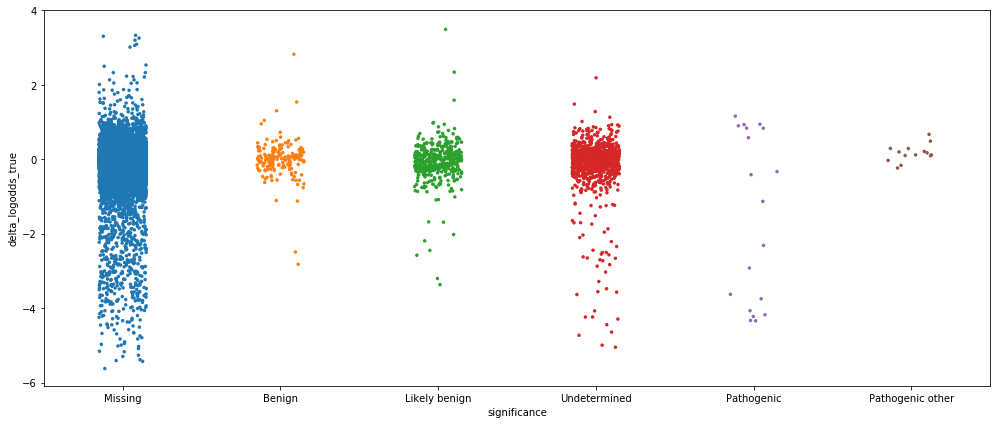

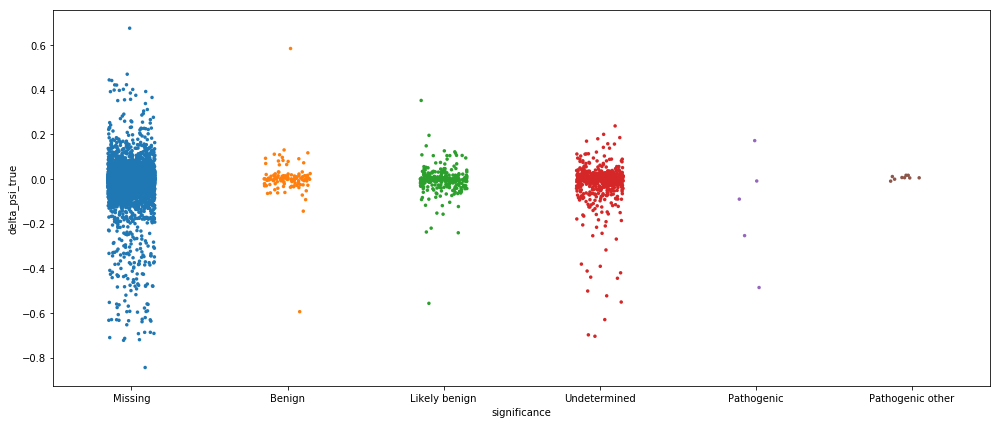

In [32]:

df_to_use = human_variant_df_filtered
df_clinvar = df_to_use.query("variant == 'snv'").copy()
df_clinvar.loc[df_clinvar.significance == 'Likely pathogenic', 'significance'] = 'Pathogenic'

#Re-annotate variants that are pathogenic for other reasons than APA
df_clinvar.loc[df_clinvar.gene == 'SPRTN.10', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'RMRP.2', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'RNU4ATAC.4', 'significance'] = 'Pathogenic UTR5'
df_clinvar.loc[df_clinvar.gene == 'RPL11.3', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'SERPINA1.5', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'TMEM107.4', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'HBB.3', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'HBB.4', 'significance'] = 'Pathogenic other'


patho_vs_benign_labels = []
patho_vs_benign_delta_pred = []
for index, row in df_clinvar.iterrows() :
    if row['significance'] == 'Benign' :
        patho_vs_benign_labels.append(0)
    elif row['significance'] == 'Pathogenic' :
        patho_vs_benign_labels.append(1)
    else :
        continue
    
    patho_vs_benign_delta_pred.append(row['delta_logodds_pred'])

patho_vs_benign_pred_auc = roc_auc_score(np.ravel(patho_vs_benign_labels), np.abs(np.ravel(patho_vs_benign_delta_pred)))
print('Pathogenic vs. Benign AUC score (based on predicted APA fold change) = ' + str(round(patho_vs_benign_pred_auc, 3)))

f = plt.figure(figsize=(14, 6))
sns.stripplot(x="significance", y="delta_logodds_true", data=df_clinvar, jitter=0.15, size=3.5, order=['Missing', 'Benign', 'Likely benign', 'Undetermined', 'Pathogenic', 'Pathogenic other'])

plt.tight_layout()
plt.show()


#APADB-scaled dPSIs
df_to_use = apadb_variant_df_filtered.copy()
df_clinvar = df_to_use.query("variant == 'snv' and native_usage > 0.01 and native_usage < 0.99").copy()
df_clinvar.loc[df_clinvar.significance == 'Likely pathogenic', 'significance'] = 'Pathogenic'

#Re-annotate variants that are pathogenic for other reasons than APA
df_clinvar.loc[df_clinvar.gene == 'SPRTN.10', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'RMRP.2', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'RNU4ATAC.4', 'significance'] = 'Pathogenic UTR5'
df_clinvar.loc[df_clinvar.gene == 'RPL11.3', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'SERPINA1.5', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'TMEM107.4', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'HBB.3', 'significance'] = 'Pathogenic other'
df_clinvar.loc[df_clinvar.gene == 'HBB.4', 'significance'] = 'Pathogenic other'


f = plt.figure(figsize=(14, 6))
sns.stripplot(x="significance", y="delta_psi_true", data=df_clinvar, jitter=0.15, size=3.5, order=['Missing', 'Benign', 'Likely benign', 'Undetermined', 'Pathogenic', 'Pathogenic other'])

plt.tight_layout()
plt.show()





<h2>Saturation Mutagenesis of Disease-Implicated PASs </h2>

UTR = F2.1
# Clinvar IDs = 
NM_000506.4(F2):c.*97G>A 1.37 (1.38)
c.*106T>A 1.41 (1.04)
c.*108C>T 2.08 (1.08)
c.*96C>T 1.17 (1.03)
NM_000506.4(F2):c.*44G>T 1.57 (1.08)
# Variants = 272 (254)
# R^2 = 0.72 (0.28)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 35 (18)
# % Significant = 12.867647058823529 (7.086614173228346)
# Significant? AUC = 0.879 (0.771)
# Direction? AUC = 0.976 (0.925)
# Direction? Accuracy = 0.943 (0.889)

Observed:


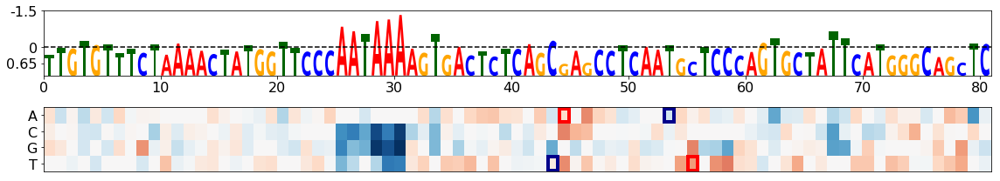

Predicted:


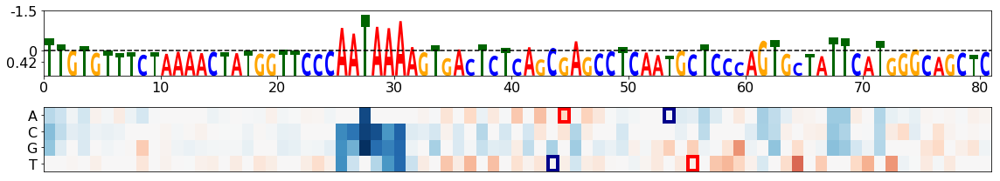

UTR = FOXP3.1
# Clinvar IDs = 
MANUAL_FOXP3_IPEX 10.14 (17.64)
# Variants = 27 (23)
# R^2 = 0.82 (0.2)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 3 (0)
# % Significant = 11.11111111111111 (0.0)
# Significant? AUC = 1.0 (nan)
# Direction? AUC = nan (nan)
# Direction? Accuracy = 1.0 (nan)

Observed:


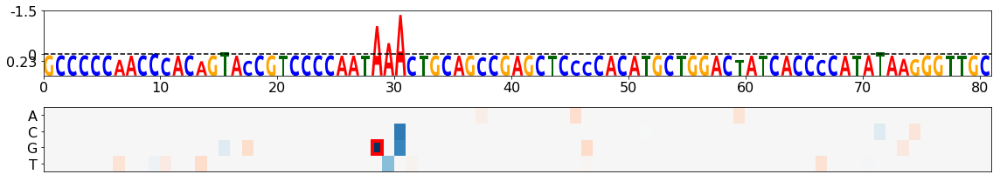

Predicted:


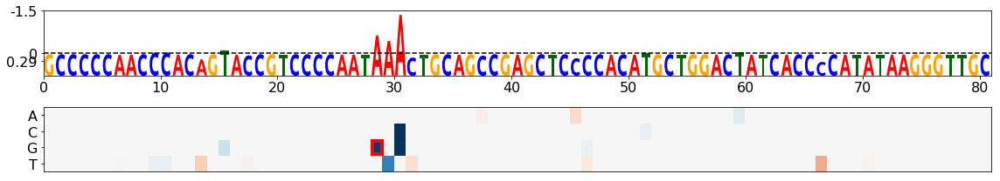

UTR = TP53.3
# Clinvar IDs = 
NM_000546.5(TP53):c.*1160T>G 1.09 (1.09)
NM_001126113.2(TP53):c.*1422G>C 1.13 (1.13)
NM_000546.5(TP53):c.*1175A>C 18.59 (23.18)
# Variants = 270 (252)
# R^2 = 0.86 (0.46)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 33 (15)
# % Significant = 12.222222222222221 (5.9523809523809526)
# Significant? AUC = 0.963 (0.918)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 0.97 (0.933)

Observed:


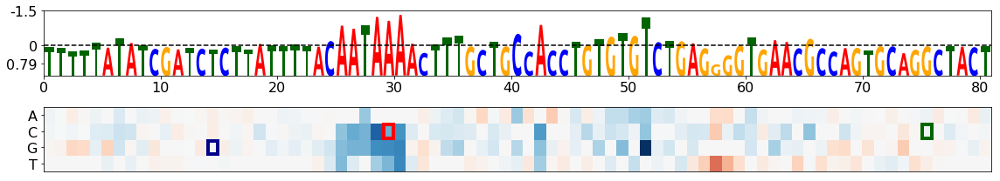

Predicted:


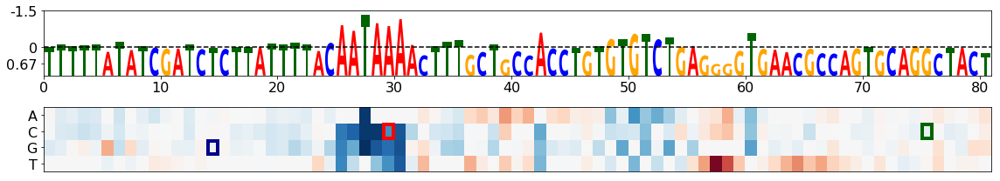

UTR = INS.1
# Clinvar IDs = 
NM_000207.2(INS):c.*28G>A 1.41 (1.19)
NM_000207.2(INS):c.*59A>G 42.46 (58.75)
NM_000207.2(INS):c.*42C>T 1.5 (1.19)
# Variants = 259 (241)
# R^2 = 0.76 (0.62)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 35 (18)
# % Significant = 13.513513513513514 (7.468879668049793)
# Significant? AUC = 0.955 (0.921)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


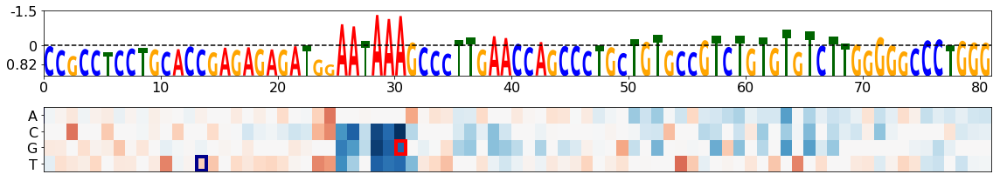

Predicted:


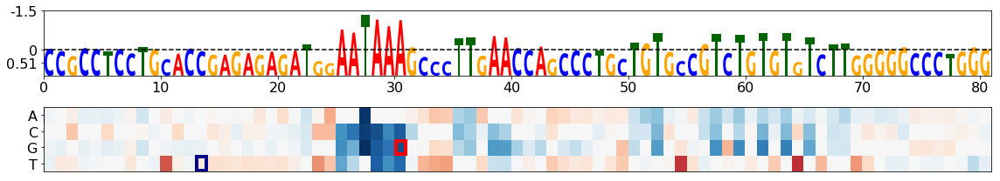

UTR = HBA2.2
# Clinvar IDs = 
c.*82G>A 1.22 (1.11)
c.*98T>C 1.89 (1.2)
c.*103G>A 1.19 (1.06)
NM_000517.4(HBA2):c.*136A>G 1.11 (1.26)
c.*104G>T 3.19 (2.09)
NM_000517.4(HBA2):c.*94A>G 76.04 (35.74)
NM_000517.4(HBA2):c.*92A>G 65.28 (28.86)
# Variants = 258 (240)
# R^2 = 0.79 (0.52)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 56 (38)
# % Significant = 21.705426356589147 (15.833333333333334)
# Significant? AUC = 0.879 (0.821)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


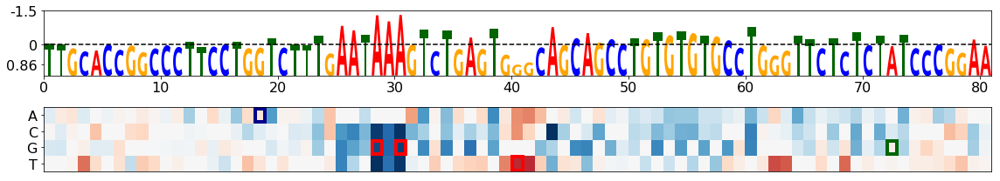

Predicted:


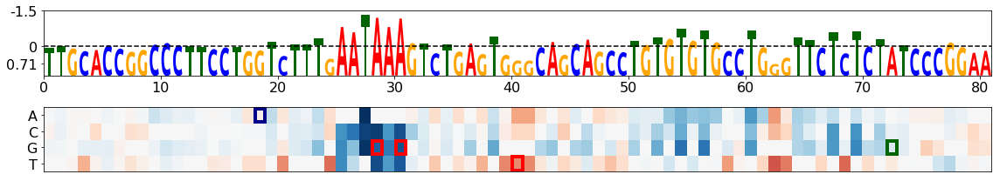

UTR = ARSA.3
# Clinvar IDs = 
c.*130C>A 1.32 (1.18)
c.*125C>G 1.07 (1.14)
c.*103C>T 1.43 (1.03)
MANUAL_ARSA_Meta_Leuko 3.1 (1.59)
# Variants = 263 (245)
# R^2 = 0.46 (0.34)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 19 (11)
# % Significant = 7.224334600760456 (4.489795918367347)
# Significant? AUC = 0.84 (0.779)
# Direction? AUC = 0.922 (1.0)
# Direction? Accuracy = 0.947 (1.0)

Observed:


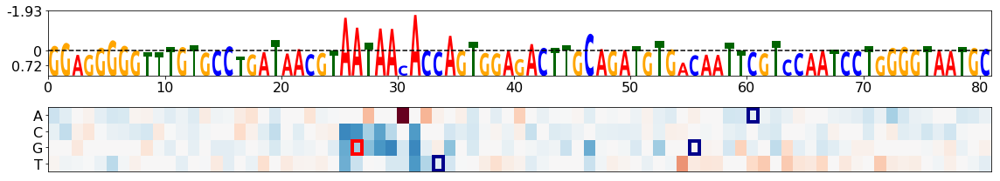

Predicted:


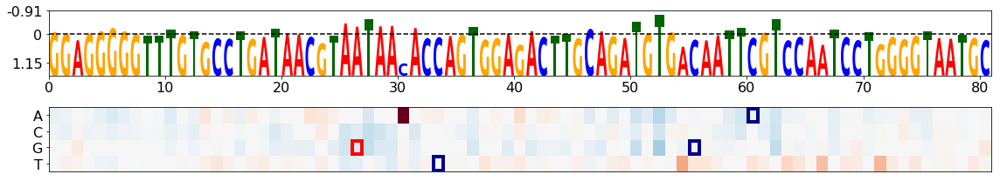

UTR = HBB.1
# Clinvar IDs = 
NM_000518.4(HBB):c.*91G>A 1.13 (1.03)
NM_000518.4(HBB):c.*96T>C 1.45 (1.19)
NM_000518.4(HBB):c.*110_*114delTAAAA 236.35 (36.09)
NM_000518.4(HBB):c.*110T>C 76.82 (30.09)
c.*129T>C 1.15 (1.03)
c.*132C>A 1.05 (1.46)
c.*132C>T 1.81 (1.26)
c.*118A>G 1.24 (1.04)
NM_000518.4(HBB):c.*113A>G 58.53 (20.64)
NM_000518.4(HBB):c.*112A>G 68.25 (14.23)
NM_000518.4(HBB):c.*111A>G 37.73 (18.62)
# Variants = 255 (237)
# R^2 = 0.92 (0.56)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 34 (17)
# % Significant = 13.333333333333334 (7.172995780590718)
# Significant? AUC = 0.95 (0.901)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


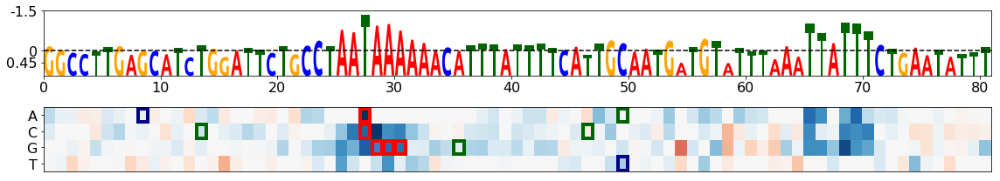

Predicted:


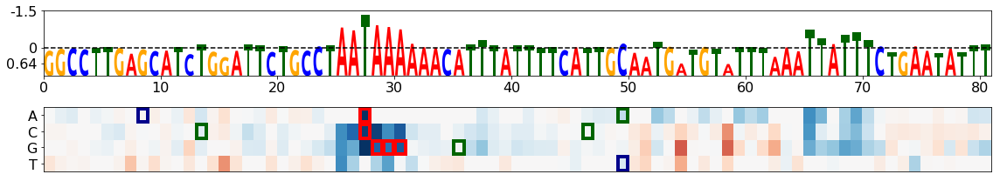

UTR = FOXC1.2
# Clinvar IDs = 
NM_001453.2(FOXC1):c.*734A>T 2.46 (2.73)
# Variants = 258 (240)
# R^2 = 0.85 (0.4)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 33 (15)
# % Significant = 12.790697674418604 (6.25)
# Significant? AUC = 0.96 (0.912)
# Direction? AUC = 0.989 (0.972)
# Direction? Accuracy = 0.97 (0.933)

Observed:


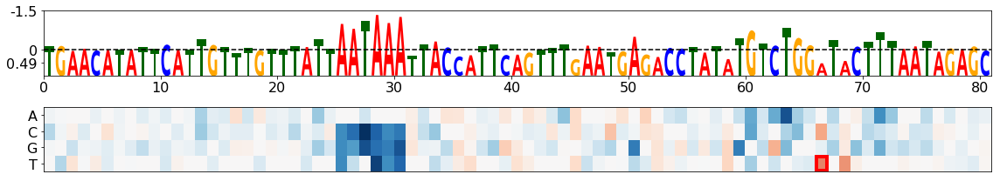

Predicted:


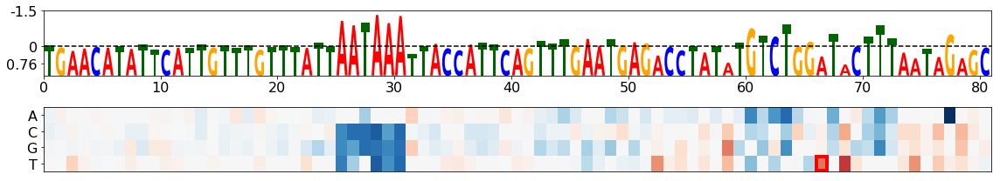

UTR = BMP1.3
# Clinvar IDs = 
NM_001199.3(BMP1):c.*241T>C 1.51 (4.12)
# Variants = 258 (240)
# R^2 = 0.46 (0.14)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 23 (13)
# % Significant = 8.914728682170542 (5.416666666666667)
# Significant? AUC = 0.688 (0.477)
# Direction? AUC = 0.962 (0.773)
# Direction? Accuracy = 0.826 (0.692)

Observed:


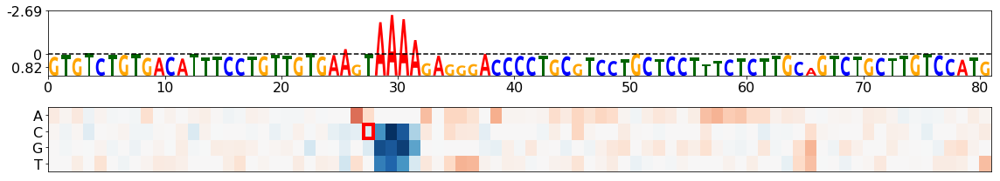

Predicted:


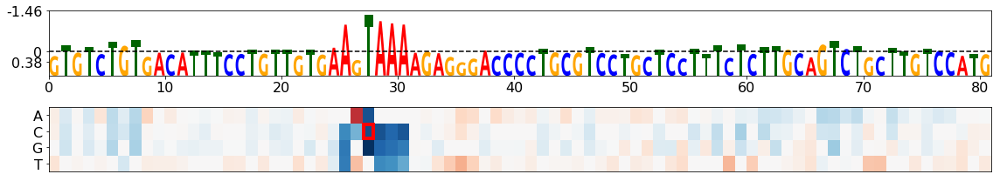

UTR = BRCA1.1
# Clinvar IDs = 
NM_007294.3(BRCA1):c.*1327G>A 1.0 (1.38)
NM_007294.3(BRCA1):c.*1332G>A 1.18 (1.58)
c.*1363A>T 73.27 (16.22)
NM_007294.3(BRCA1):c.*1323A>G 1.31 (1.1)
# Variants = 272 (254)
# R^2 = 0.88 (0.57)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 44 (26)
# % Significant = 16.176470588235293 (10.236220472440944)
# Significant? AUC = 0.928 (0.878)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


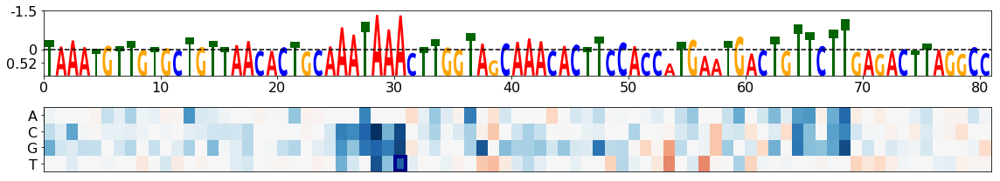

Predicted:


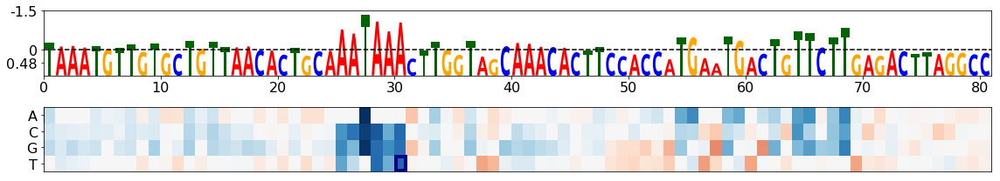

UTR = BRCA2.1
# Clinvar IDs = 
# Variants = 262 (244)
# R^2 = 0.9 (0.41)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 19 (1)
# % Significant = 7.251908396946565 (0.4098360655737705)
# Significant? AUC = 0.973 (0.494)
# Direction? AUC = 1.0 (nan)
# Direction? Accuracy = 1.0 (1.0)

Observed:


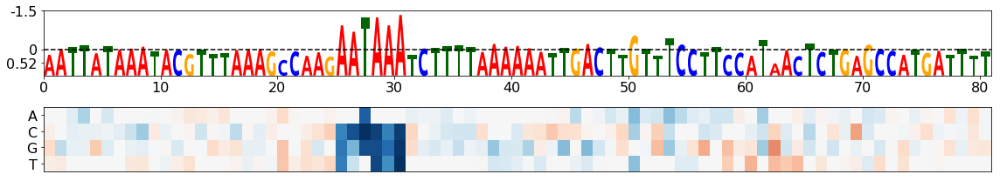

Predicted:


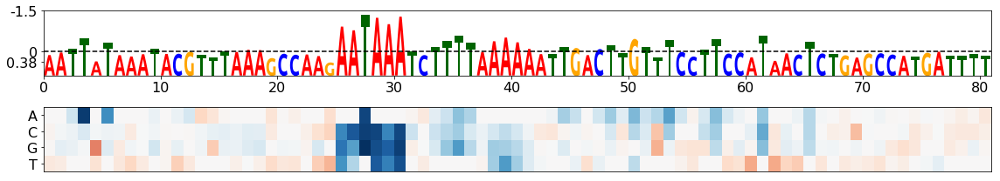

UTR = PTEN.13
# Clinvar IDs = 
# Variants = 265 (247)
# R^2 = 0.89 (0.57)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 23 (5)
# % Significant = 8.679245283018869 (2.0242914979757085)
# Significant? AUC = 0.994 (0.975)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


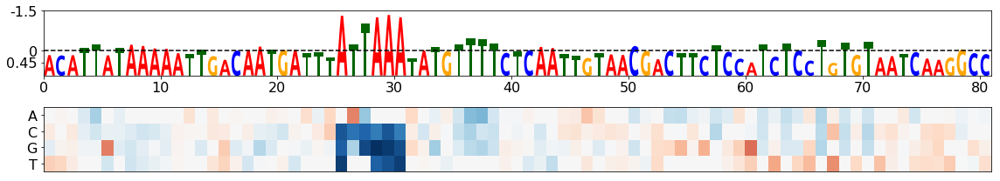

Predicted:


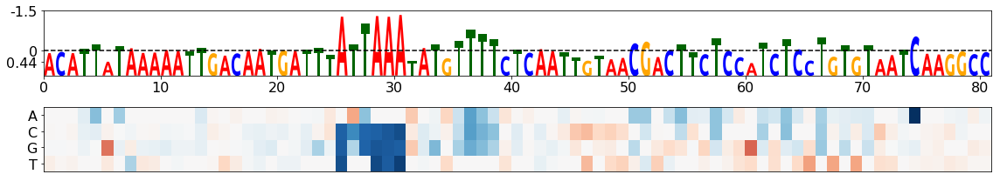

UTR = PTEN.15
# Clinvar IDs = 
c.*282G>A 1.06 (1.28)
# Variants = 266 (248)
# R^2 = 0.84 (0.2)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 29 (12)
# % Significant = 10.902255639097744 (4.838709677419355)
# Significant? AUC = 0.866 (0.679)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 0.897 (0.75)

Observed:


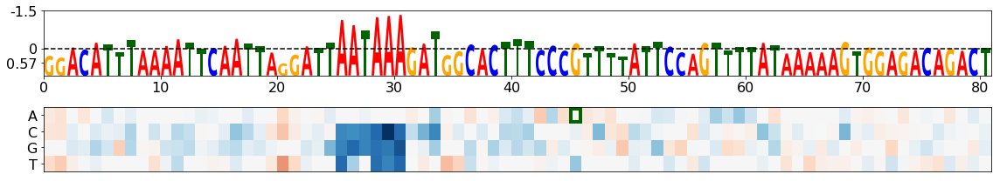

Predicted:


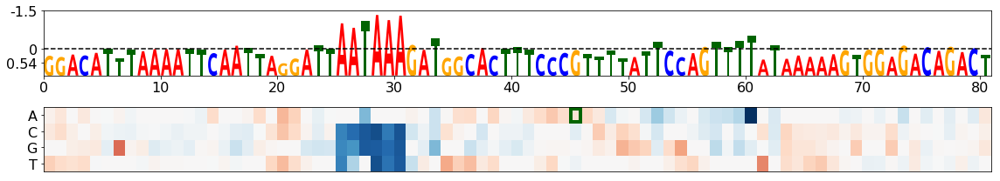

UTR = PTEN.16
# Clinvar IDs = 
c.*65T>C 1.07 (1.0)
c.*74T>C 1.13 (1.1)
c.*78T>G 1.22 (1.67)
# Variants = 260 (242)
# R^2 = 0.6 (0.8)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 26 (24)
# % Significant = 10.0 (9.917355371900827)
# Significant? AUC = 0.923 (0.933)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 0.923 (0.917)

Observed:


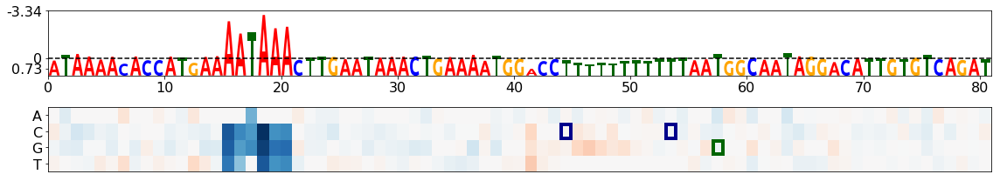

Predicted:


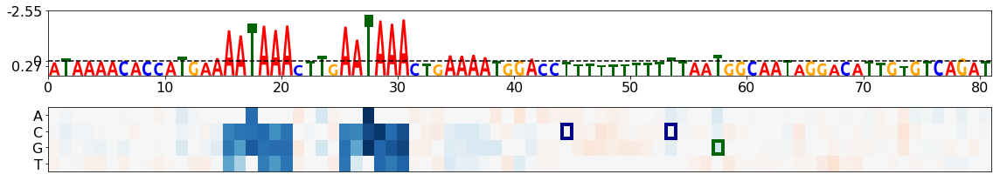

UTR = PTEN.8
# Clinvar IDs = 
# Variants = 265 (247)
# R^2 = 0.52 (0.47)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 71 (56)
# % Significant = 26.79245283018868 (22.672064777327936)
# Significant? AUC = 0.787 (0.752)
# Direction? AUC = 0.977 (0.979)
# Direction? Accuracy = 0.887 (0.857)

Observed:


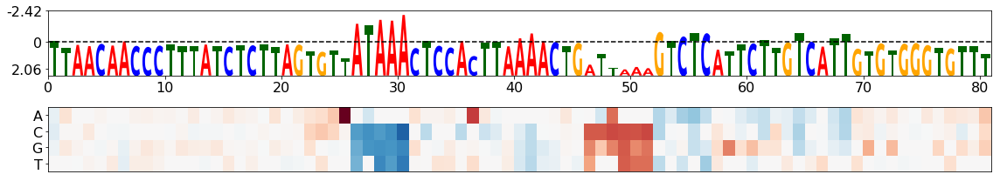

Predicted:


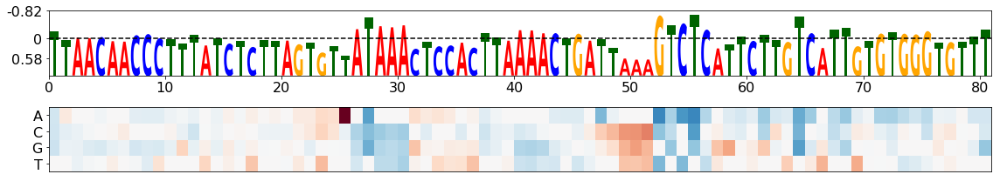

UTR = TPMT.1
# Clinvar IDs = 
NM_000367.4(TPMT):c.*2340T>C 1.37 (1.51)
# Variants = 266 (248)
# R^2 = 0.71 (0.51)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 39 (22)
# % Significant = 14.661654135338345 (8.870967741935484)
# Significant? AUC = 0.933 (0.889)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 1.0 (1.0)

Observed:


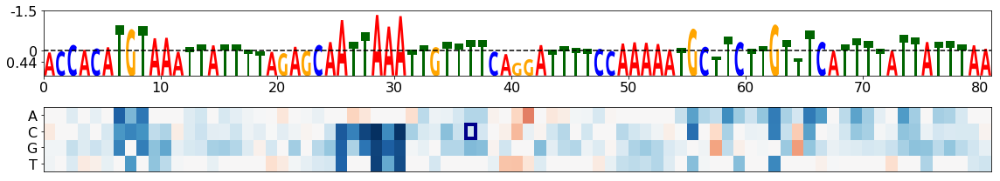

Predicted:


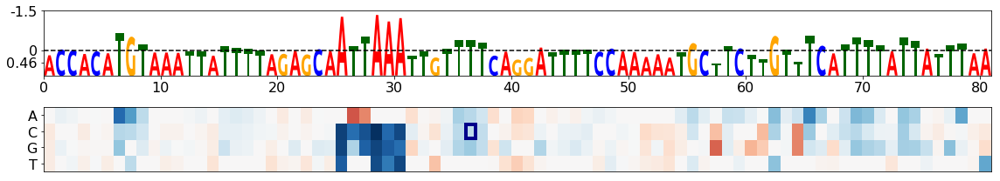

UTR = TPMT.3
# Clinvar IDs = 
# Variants = 264 (246)
# R^2 = 0.91 (0.29)

Significance filter = p < 0.001, delta > 0.693
# Significant variants = 26 (8)
# % Significant = 9.848484848484848 (3.252032520325203)
# Significant? AUC = 0.914 (0.721)
# Direction? AUC = 1.0 (1.0)
# Direction? Accuracy = 0.962 (0.875)

Observed:


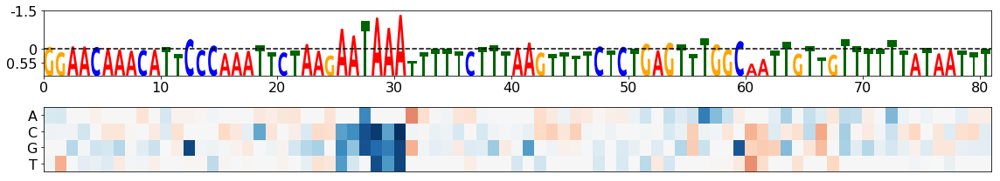

Predicted:


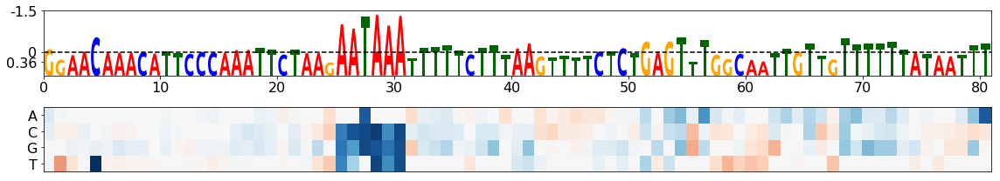

In [33]:

gene_names = [
    'F2.1',
    'FOXP3.1',
    'TP53.3',
    'INS.1',
    'HBA2.2',
    'ARSA.3',
    'HBB.1',
    'FOXC1.2',
    'BMP1.3',
    'BRCA1.1',
    'BRCA2.1',
    'PTEN.13',
    'PTEN.15',
    'PTEN.16',
    'PTEN.8',
    'TPMT.1',
    'TPMT.3'
]

delta_logodds_pred_bias = 0.0#-0.05

configs = [
    [25, 106, (16,3)]
]

save_figs = False

gene_exceptions = ['FOXP3.1']

valid_wt_seqs = human_variant_df.groupby('wt_seq').agg({'delta_logodds_true' : 'count'}).reset_index().query("delta_logodds_true > 50")['wt_seq'].unique()
df_to_use = human_variant_df.loc[human_variant_df.wt_seq.isin(valid_wt_seqs) | human_variant_df.gene.isin(gene_exceptions)]

df_to_use = df_to_use.copy().set_index('master_seq')
df_to_use['snv_pos'] = pd.to_numeric(df_to_use['snv_pos'], downcast='integer')
df_to_use['delta_logodds_pred'] = df_to_use['mean_delta_logodds_pred']

p_thresh = 0.001
delta_thresh = 0.693

fixed_scale=True

for gene_name in gene_names :
    for seq_start, seq_end, figsize in configs :
        
        #Calculate per-utr statistics

        df_gene = df_to_use.query("gene == '" + gene_name + "'")
        df_gene_nopas = df_to_use.query("gene == '" + gene_name + "' and (snv_pos < 50 or snv_pos > 55)")

        df_gene_signi = df_gene.query("delta_p_val < " + str(p_thresh) + " and (delta_logodds_true < -" + str(delta_thresh) + " or delta_logodds_true > " + str(delta_thresh) + ")")
        df_gene_signi_nopas = df_gene_nopas.query("delta_p_val < " + str(p_thresh) + " and (delta_logodds_true < -" + str(delta_thresh) + " or delta_logodds_true > " + str(delta_thresh) + ")")

        n_variants = len(df_gene)
        n_variants_nopas = len(df_gene_nopas)

        n_variants_signi = len(df_gene_signi)
        n_variants_signi_nopas = len(df_gene_signi_nopas)

        r_val, _ = pearsonr(df_gene['delta_logodds_pred'], df_gene['delta_logodds_true'])
        r2 = round(r_val * r_val, 2)
        r_val_nopas, _ = pearsonr(df_gene_nopas['delta_logodds_pred'], df_gene_nopas['delta_logodds_true'])
        r2_nopas = round(r_val_nopas * r_val_nopas, 2)

        significant_labels = np.zeros(len(df_gene))
        significant_labels[(df_gene['delta_p_val'] < p_thresh) & (np.abs(df_gene['delta_logodds_true']) > delta_thresh)] = 1
        significant_auc = np.nan
        if np.sum(significant_labels) != 0 and np.sum(significant_labels) != len(significant_labels) :
            significant_auc = round(roc_auc_score(significant_labels, np.ravel(np.abs(df_gene['delta_logodds_pred']))), 3)

        direction_acc = np.nan
        if len(df_gene_signi) > 0 :
            direction_acc = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi['delta_logodds_pred'] + delta_logodds_pred_bias)) == np.sign(np.ravel(df_gene_signi['delta_logodds_true'])))[0]))
            direction_acc /= float(len(df_gene_signi))
            direction_acc = round(direction_acc, 3)
        
        significant_labels_nopas = np.zeros(len(df_gene_nopas))
        significant_labels_nopas[(df_gene_nopas['delta_p_val'] < p_thresh) & (np.abs(df_gene_nopas['delta_logodds_true']) > delta_thresh)] = 1
        significant_auc_nopas = np.nan
        if np.sum(significant_labels_nopas) != 0 and np.sum(significant_labels_nopas) != len(significant_labels_nopas) :
            significant_auc_nopas = round(roc_auc_score(significant_labels_nopas, np.ravel(np.abs(df_gene_nopas['delta_logodds_pred']))), 3)

        direction_acc_nopas = np.nan
        if len(df_gene_signi_nopas) > 0 :
            direction_acc_nopas = float(len(np.nonzero(np.sign(np.ravel(df_gene_signi_nopas['delta_logodds_pred'] + delta_logodds_pred_bias)) == np.sign(np.ravel(df_gene_signi_nopas['delta_logodds_true'])))[0]))
            direction_acc_nopas /= float(len(df_gene_signi_nopas))
            direction_acc_nopas = round(direction_acc_nopas, 3)
        
        direction_labels = np.zeros(len(df_gene_signi))
        direction_labels[df_gene_signi['delta_logodds_true'] > 0.0] = 1
        direction_auc = np.nan
        if np.sum(direction_labels) != 0 and np.sum(direction_labels) != len(direction_labels) :
            direction_auc = round(roc_auc_score(direction_labels, np.ravel(df_gene_signi['delta_logodds_pred'])), 3)

        direction_labels_nopas = np.zeros(len(df_gene_signi_nopas))
        direction_labels_nopas[df_gene_signi_nopas['delta_logodds_true'] > 0.0] = 1
        direction_auc_nopas = np.nan
        if np.sum(direction_labels_nopas) != 0 and np.sum(direction_labels_nopas) != len(direction_labels_nopas) :
            direction_auc_nopas = round(roc_auc_score(direction_labels_nopas, np.ravel(df_gene_signi_nopas['delta_logodds_pred'])), 3)

        print("UTR = " + gene_name)
        
        clinvar_ids = 'N/A'
        clinvar_id_list = []
        if not (len(df_gene['clinvar_id']) == 1 and df_gene['clinvar_id'].unique()[0] == 'Missing') :
            clinvar_ids = ''
            for clinvar_id in list(df_gene['clinvar_id'].unique()) :
                if clinvar_id != 'Missing' :
                    clinvar_id_list.append(clinvar_id)
                    snv_pos = df_gene.query("clinvar_id == '" + clinvar_id + "'")['snv_pos'].values[0]
                    snv_nt = df_gene.query("clinvar_id == '" + clinvar_id + "'").index.values[0][int(snv_pos)]
                    clinvar_ids += clinvar_id + ': ' + str(int(snv_pos))
                    clinvar_ids += ' (' + snv_nt + ')\n'

        #print("# Clinvar IDs = " + clinvar_ids)
        print("# Clinvar IDs = ")
        for clinvar_id in clinvar_id_list :
            if len(df_to_use.query("clinvar_id == '" + clinvar_id + "'")) > 0 :
                true_fold = np.exp(list(df_to_use.query("clinvar_id == '" + clinvar_id + "'")['delta_logodds_true'].values)[0])
                pred_fold = np.exp(list(df_to_use.query("clinvar_id == '" + clinvar_id + "'")['delta_logodds_pred'].values)[0])
                
                if true_fold < 1.0 :
                    true_fold = 1.0 / true_fold
                if pred_fold < 1.0 :
                    pred_fold = 1.0 / pred_fold
                
                print(clinvar_id + " " + str(round(true_fold, 2)) + " (" + str(round(pred_fold, 2)) + ")")
        
        print("# Variants = " + str(n_variants) + " (" + str(n_variants_nopas) + ")")
        print("# R^2 = " + str(r2) + " (" + str(r2_nopas) + ")")
        print("")

        print("Significance filter = p < " + str(p_thresh) + ", delta > " + str(delta_thresh))
        print("# Significant variants = " + str(n_variants_signi) + " (" + str(n_variants_signi_nopas) + ")")
        print("# % Significant = " + str(100. * n_variants_signi / n_variants) + " (" + str(100. * n_variants_signi_nopas / n_variants_nopas) + ")")
        print("# Significant? AUC = " + str(significant_auc) + " (" + str(significant_auc_nopas) + ")")
        print("# Direction? AUC = " + str(direction_auc) + " (" + str(direction_auc_nopas) + ")")
        print("# Direction? Accuracy = " + str(direction_acc) + " (" + str(direction_acc_nopas) + ")")
        print("")

        pas = df_gene['wt_seq'].values[0][50:56]
        cano_pas = True if pas in ['AATAAA', 'ATTAAA'] else False
        
        cano_pas_downscaling = 0.5
        cano_pas_mode = 'frac'
        if fixed_scale :
            cano_pas_downscaling = -1.5
            cano_pas_mode = 'value'
        
        print('Observed:')

        pas_max_val_obs = mut_map_v2(
                df_to_use,
                gene_name,
                experiment=None,
                mode='true',
                figsize=figsize,
                mark_pathogenic=True,
                mark_benign=True,
                mark_undetermined=True,
                seq_trim_start=seq_start, seq_trim_end=seq_end,
                plot_start=0, plot_end=seq_end - seq_start,
                pas_downscaling=cano_pas_downscaling if cano_pas else 1.0,
                pas_downscale_mode=cano_pas_mode if cano_pas else 'frac',
                fig_name=(gene_name.replace('.', '_') + '_Mutmap_Observed_' + str(seq_start) + '_' + str(seq_end)) if save_figs else None,
                fig_dpi=150
        )

        print('Predicted:')
        
        mut_map_v2(
                df_to_use,
                gene_name,
                experiment=None,
                mode='pred',
                figsize=figsize,
                mark_pathogenic=True,
                mark_benign=True,
                mark_undetermined=True,
                seq_trim_start=seq_start, seq_trim_end=seq_end,
                plot_start=0, plot_end=seq_end - seq_start,
                #pas_downscaling=0.5,
                pas_downscaling=pas_max_val_obs if cano_pas else 1.0,
                pas_downscale_mode='value'if cano_pas else 'frac',
                fig_name=(gene_name.replace('.', '_') + '_Mutmap_Predicted_' + str(seq_start) + '_' + str(seq_end)) if save_figs else None,
                fig_dpi=150
        )

<h2>Cleavage Alteration (Measured and Predicted) of F2 97G>A Variant</h2>

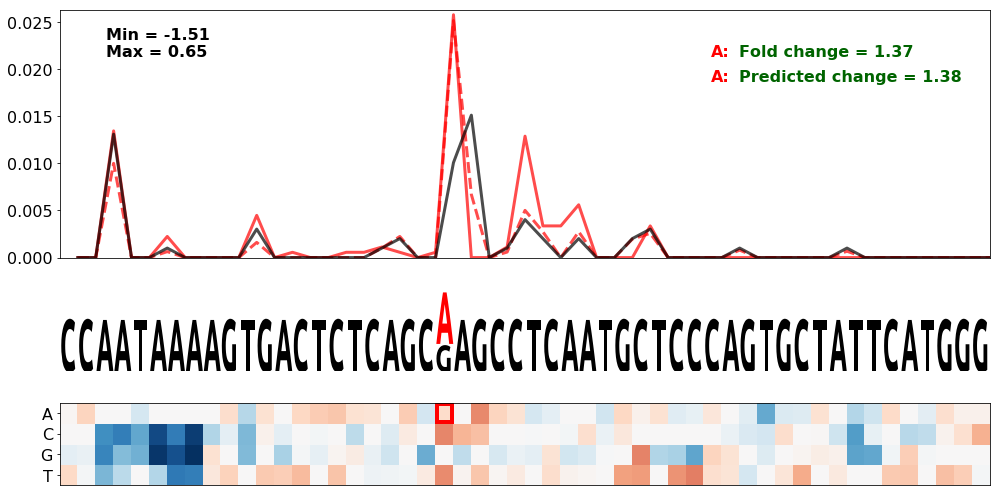

In [34]:
gene_name = 'F2.1'

snvs = [(69, 'A', 'red')]

seq_start = 48
seq_end = 100

save_figs = False

df_gene = human_variant_df.query("gene == '" + str(gene_name) + "'").copy().set_index('master_seq')
df_gene['delta_logodds_pred'] = df_gene['mean_delta_logodds_pred']

mut_map_with_cuts(
        df_gene,
        gene_name,
        snvs,
        mode='true',
        column_suffix='',
        figsize=(14, 7),
        height_ratios=[6, 2, 2],
        bg_alpha=0.999,
        plot_simple_mutmap=True,
        annotate_folds=True,
        plot_true_cuts=True,
        plot_pred_cuts=True,
        scale_pred_cuts=True,
        #fold_change_from_cut_range=[65, 80],
        ref_var_scales=[0.5, 1.0],
        border_eta = 0.06,
        seq_trim_start=seq_start, seq_trim_end=seq_end,
        plot_start=0, plot_end=seq_end-seq_start,
        plot_as_bars=False,
        pas_downscaling=0.5,
        fig_name=(gene_name.replace('.', '_') + '_Cut_Both_Pathogenic') if save_figs else None,
        fig_dpi=150
)

<h2>Complex/Interesting Cut Alteration Variants</h2>

Interesting cut alteration examples:
Gene = TPM1.7
WT seq = GAACCTTGAACAGATACAACTAATTTACATATTACTAACCAAACTTAAACATTAAACTTTTTCTACTACTTTAAATTCTAACCTGGAATGTTTCAGAGTTCTTCATTCTAATATCACCCTGAATTCCATTGAAGCTGGAAATGTCATTTTCCAAGCCCACCTGT
SNV pos = 79
SNV nt = C
ClinVar id = Missing


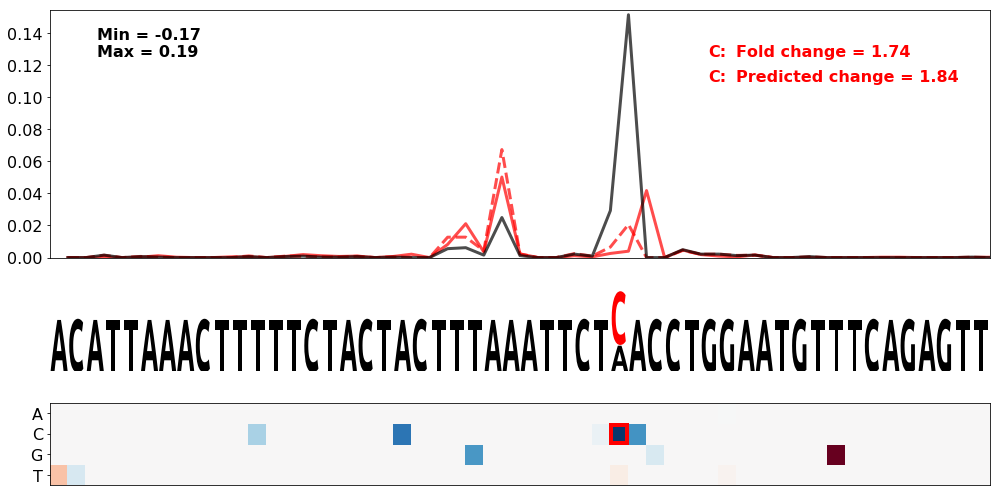

Gene = CPOX.2
WT seq = TATGATTTCTTTGTTCATATATTATGAATGTATTATTTTATTTGCTTCGTAATAAAGTTTATAAGGAAGAGCATCTCATACATATCATTATCGTGGAACACGTTGAATGTTTGTGATTCTGTGTGGCCTTTTTGGGGCTGGAAAATGTATGAATTCTTCAACTG
SNV pos = 77
SNV nt = G
ClinVar id = NM_000097.5(CPOX):c.*1105A>G


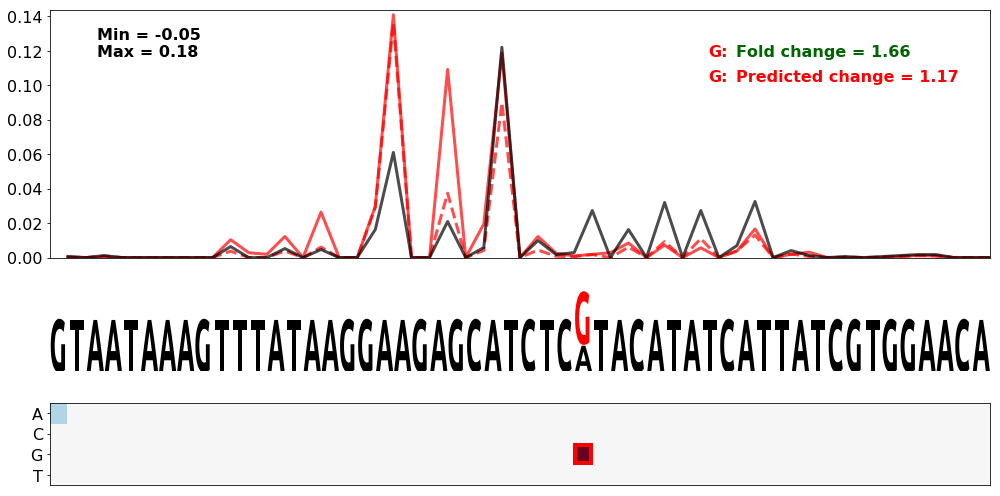

Gene = RYR2.5
WT seq = AGAAACAAGTTGATCAACGTGAGAGAAATTTCATGATAATTATTCATAGTAATAAAGTGTCGTGGGCTTAATTGTATATCTGGAGCCAGTGTCATCCACCAACAATGTGATACAATATGAACTTGACAGTAGTTTTGGGTTTTGCTCATTCTTTCAGCCACCTG
SNV pos = 75
SNV nt = G
ClinVar id = Missing


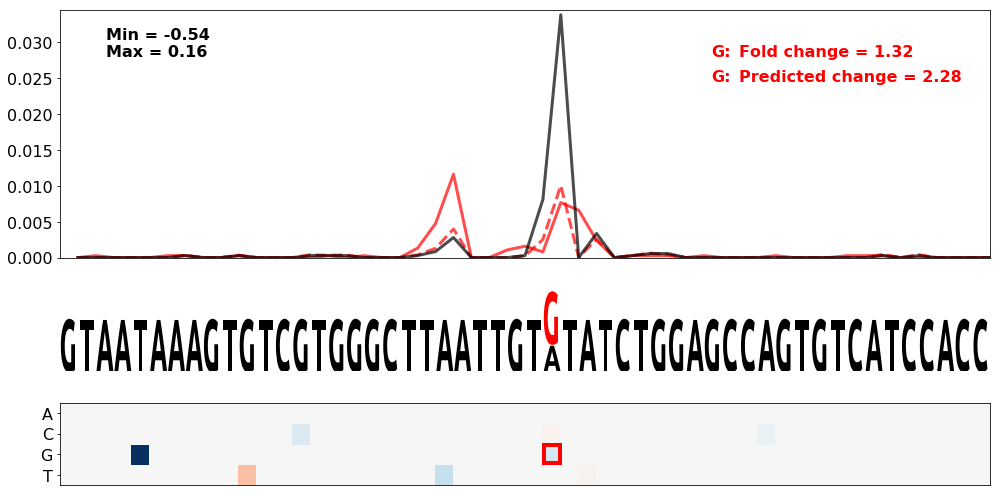

Gene = TGFBR2.6
WT seq = CACTGTAAACATTAGCTCTTTCCACTGCCTACCTGGACCCCAGTCTAGGAATTAAATCTGCACCTAACCAAGGTCCCTTGTAAGAAATGTCCATTCAAGCAGTCATTCTCTGGGTATATAATATGATTTTGACTACCTTATCTGGTGTTAAGATTTGAAGTTGG
SNV pos = 77
SNV nt = A
ClinVar id = Missing


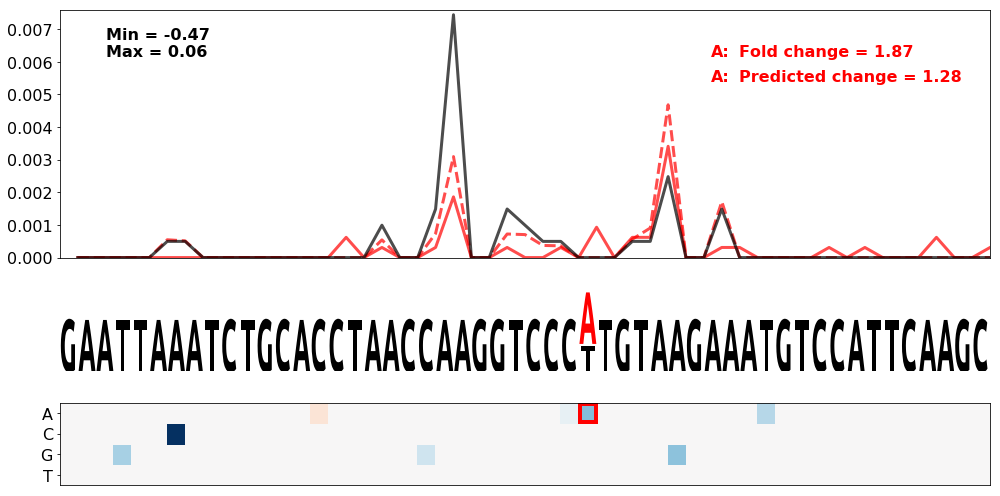

Gene = MSH2.1
WT seq = ACTGTTTGCAATTGACATAGGCAATAATAAGTGATGTGCTGAATTTTATAAATAAAATCATGTAGTTTGTGGAATTTGAGATGCATTGTAGTTCTTCGCAGTGTGACTTCAAATATTTTGGAAGAAACAAATAGCTCAGAGACCTCGTAAAATATCTTAAACTG
SNV pos = 72
SNV nt = G
ClinVar id = Missing


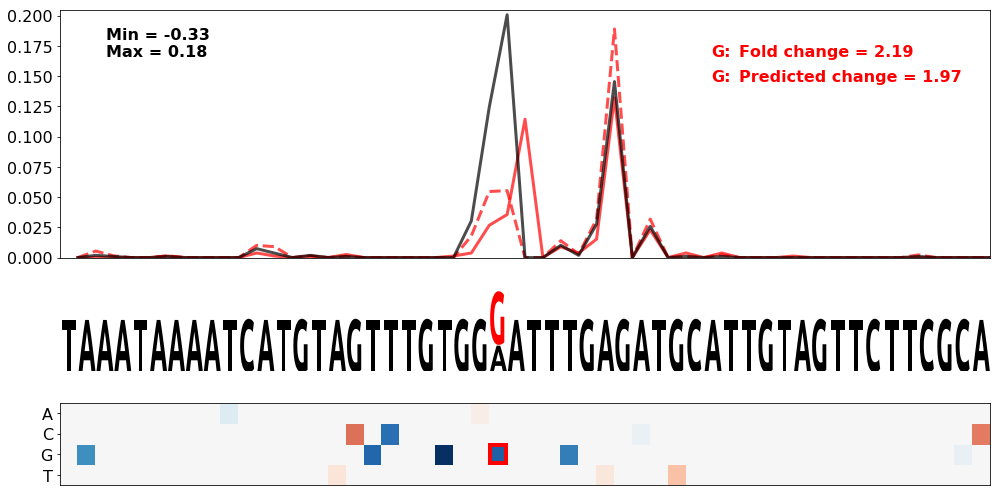

Gene = HBA2.2
WT seq = CTCCCAACGGGCCCTCCTCCCCTCCTTGCACCGGCCCTTCCTGGTCTTTGAATAAAGTCTGAGTGGGCAGCAGCCTGTGTGTGCCTGGGTTCTCTCTATCCCGGAATGTGCCAACAATGGAGGTGTTTACCTGTCTCAGACCAAGGACCTCTCTGCAGCTGCAT
SNV pos = 71
SNV nt = C
ClinVar id = Missing


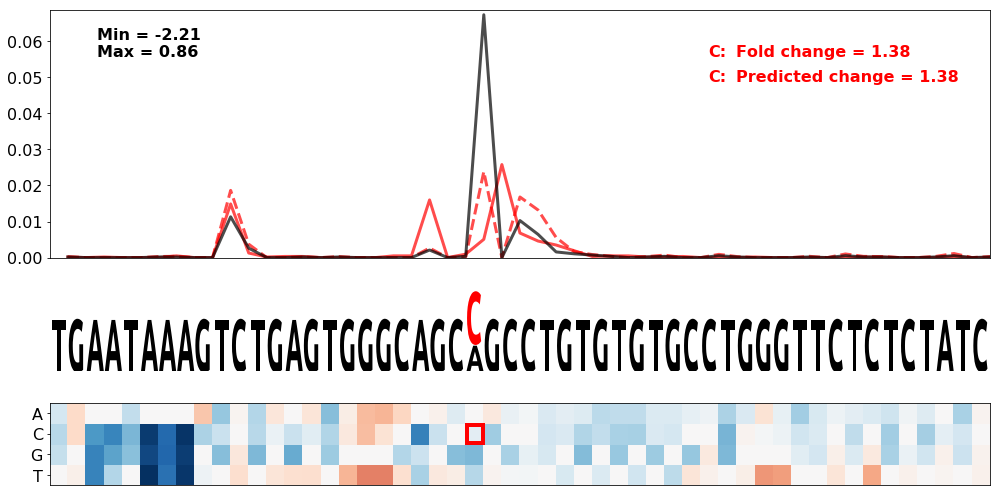

Gene = TP53.3
WT seq = CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
SNV pos = 73
SNV nt = A
ClinVar id = Missing


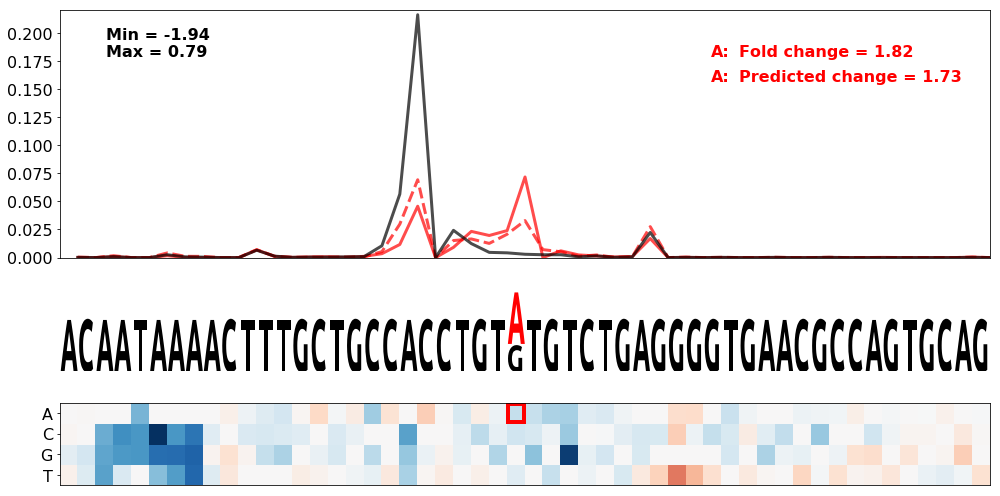

Gene = PRKAG2.2
WT seq = TGCAATTTTTTTACACATCTTTTGGTGGAGTAAACTTCACCACATCCATGAATAAACTCTCAGTTATTTTGAAATGGCAAATTTCTCATTATTTAAGTTTGGATCTGGAAAGGACATGACTTCTGAAATAGCCGCTGCTGGGTTTTAAAAGCTGAGGTCTCTCA
SNV pos = 76
SNV nt = A
ClinVar id = Missing


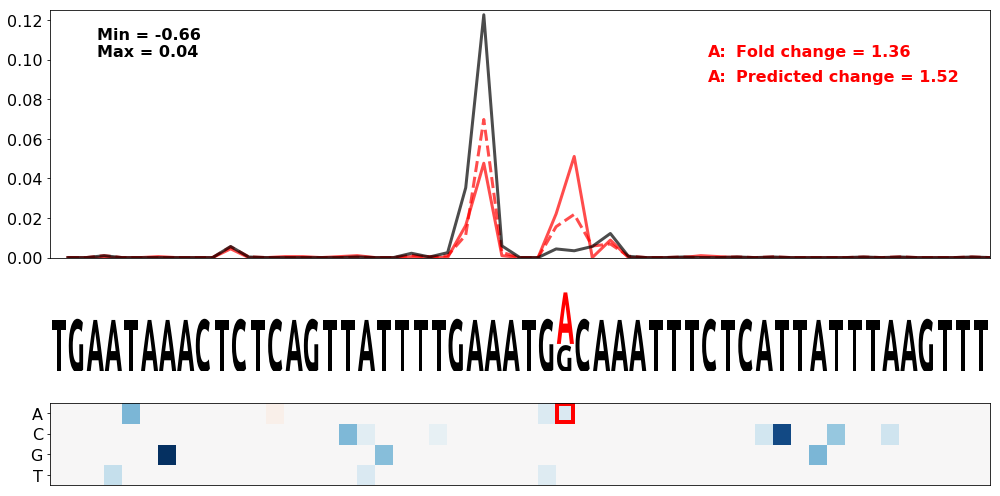

Gene = TP53.3
WT seq = CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
SNV pos = 70
SNV nt = A
ClinVar id = Missing


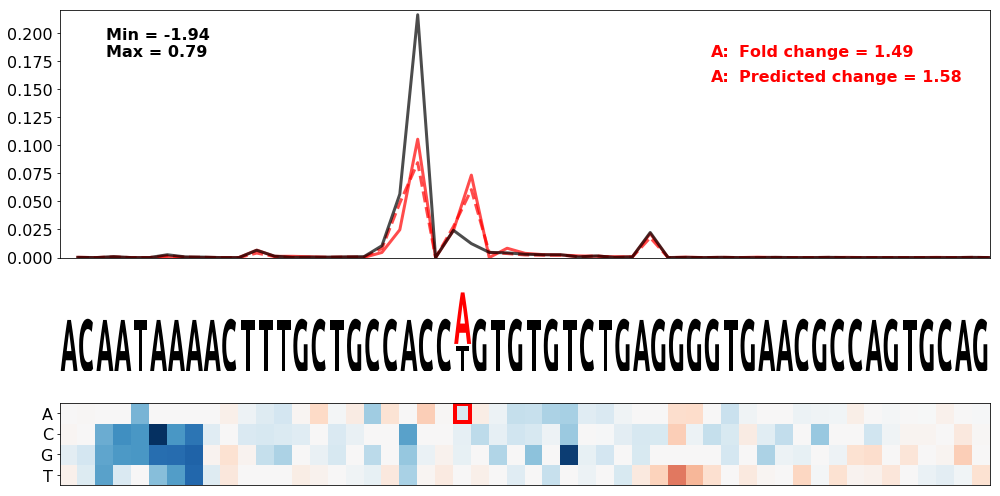

Gene = MRPS16.7
WT seq = GGTCCTTTTGAAACACTGCAGCGATCTTAATTTTGTTAGATTTGGAGTTCAATAAATGGAGTATCCTGAGTTGCCCTTGCTCTTCTGGCCTGGCCTGCACAGGGCCCAGGGAGAGATTTGTTCTTGTGTGACTTAGAGCTGGGTGTGGGTACTAATTAGCTTTT
SNV pos = 78
SNV nt = A
ClinVar id = NM_016065.3(MRPS16):c.*121G>A


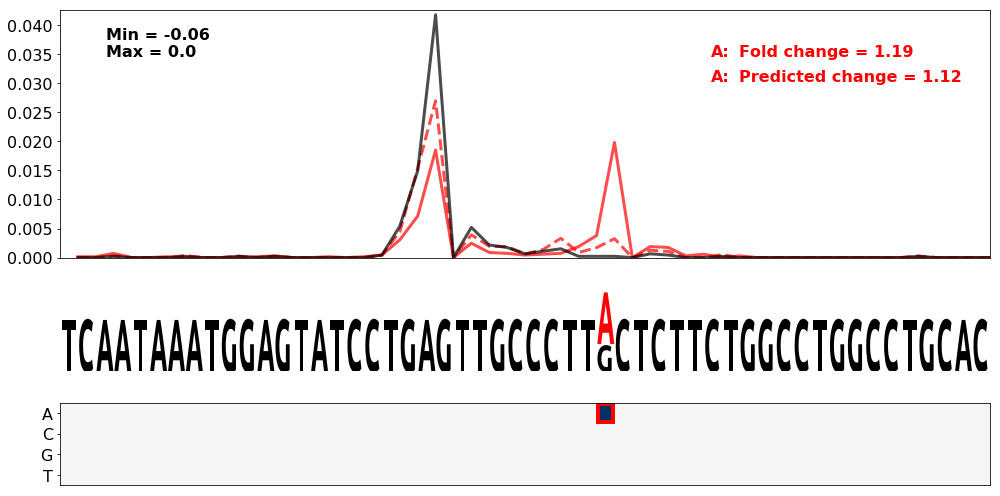

Gene = FOXC1.2
WT seq = TCTATCCTCTTTTCTTTCTTTTTGTTGAACATATTCATTGTTTGTTTATTAATAAATTACCATTCAGTTTGAATGAGACCTATATGTCTGGATACTTTAATAGAGCTTTAATTATTACGAAAAAAGATTTCAGAGATAAAACACTAGAAGTTACCTATTCTCCA
SNV pos = 68
SNV nt = A
ClinVar id = Missing


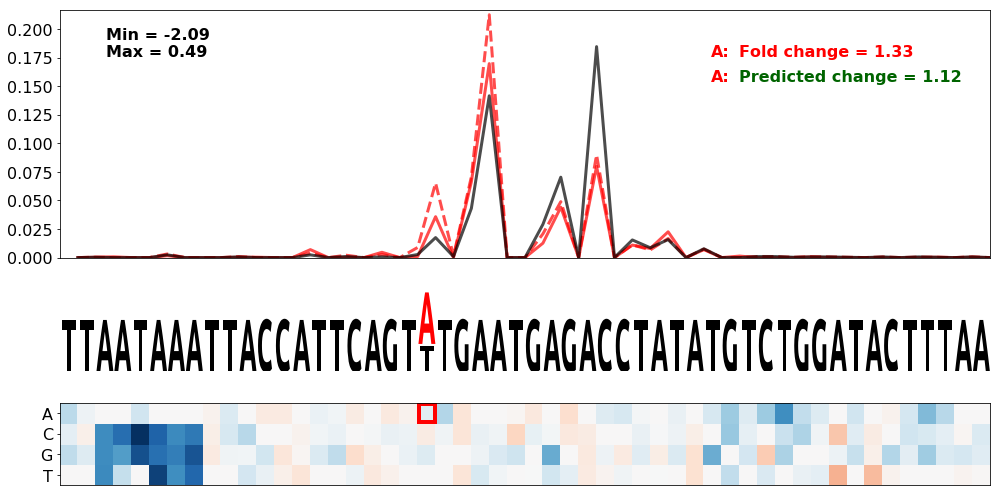

Gene = FOXC1.2
WT seq = TCTATCCTCTTTTCTTTCTTTTTGTTGAACATATTCATTGTTTGTTTATTAATAAATTACCATTCAGTTTGAATGAGACCTATATGTCTGGATACTTTAATAGAGCTTTAATTATTACGAAAAAAGATTTCAGAGATAAAACACTAGAAGTTACCTATTCTCCA
SNV pos = 77
SNV nt = G
ClinVar id = Missing


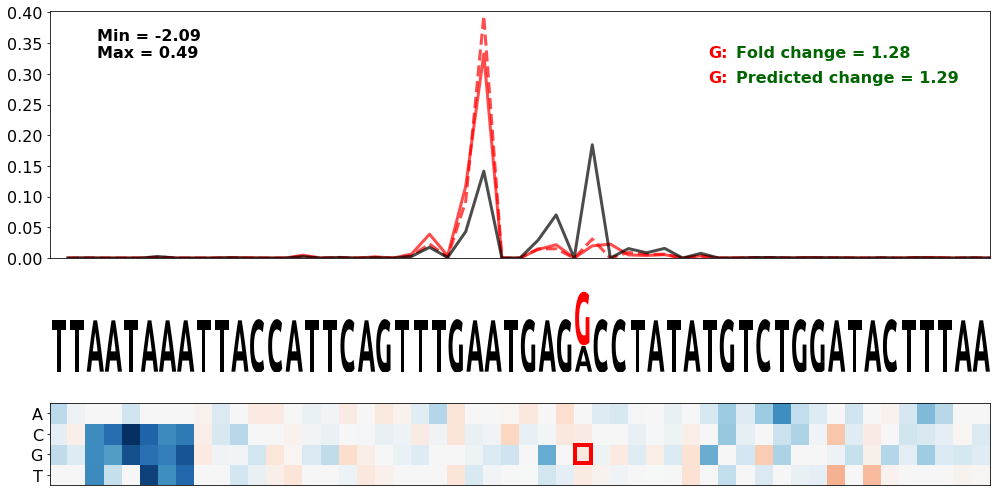

Gene = FOLR1.1
WT seq = CCCAACTATTTGGTTCCTGCTCCATGGTCGGGCCTCTGACAGCCACTTTGAATAAACCAGACACCGCACATGTGTCTTGAGAATTATTTGGATATGAATGGGAACGTGACTGTTTTGTTTTCCAATTCCCATTGATTGAAACCAGTGAGACTGGGCCAATTCCT
SNV pos = 67
SNV nt = G
ClinVar id = NM_016725.2(FOLR1):c.*122A>G


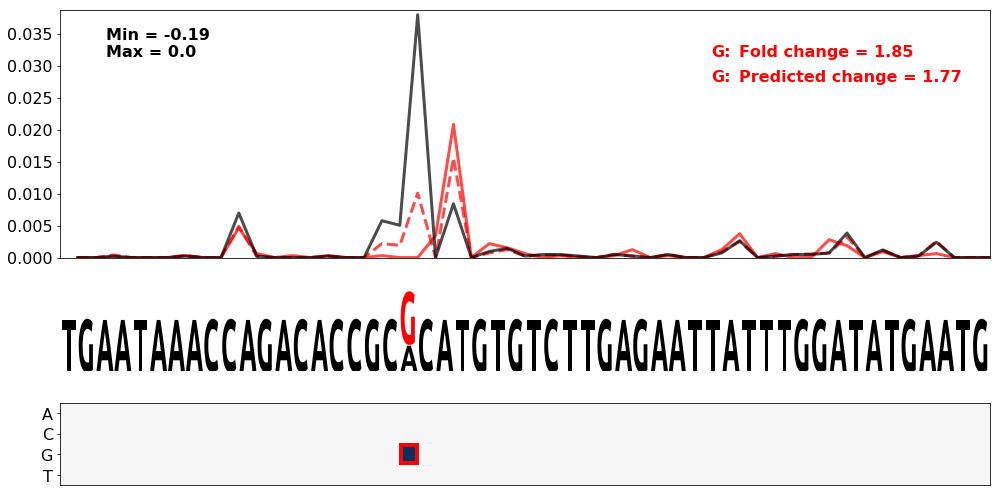

Gene = BRCA1.1
WT seq = ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG
SNV pos = 71
SNV nt = A
ClinVar id = Missing


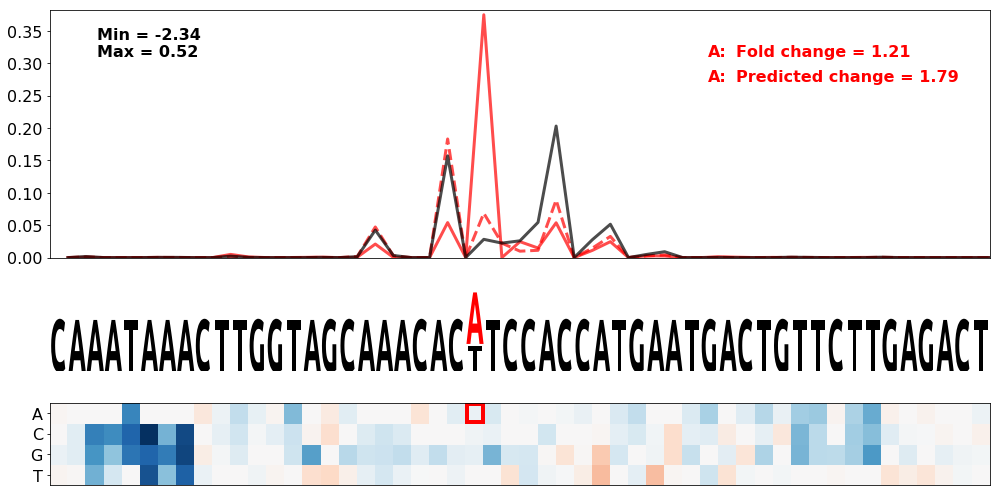

Gene = BRCA1.1
WT seq = ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG
SNV pos = 72
SNV nt = A
ClinVar id = Missing


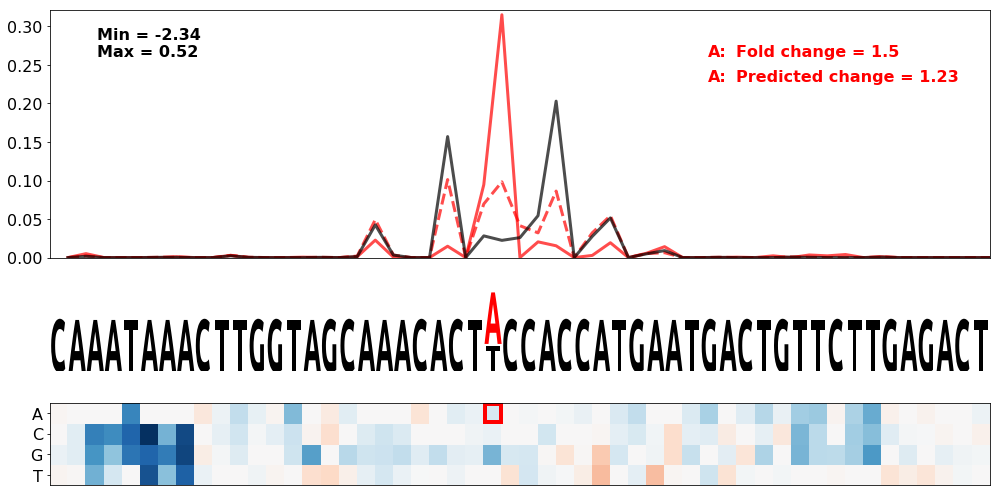

Gene = RB1.14
WT seq = ATAATTTACAGAAAGCTACAGAAATCATATTTACCAGGACACATCTGTTAAATAAAAGCATTGTTTCATGTTGGTGTACGTCTATACAGGGCTATGTATAACCGACTCCTGTTTCTCCTCCCTGCAACCACAGAACCATCACACACACACACACACACACACAC
SNV pos = 71
SNV nt = A
ClinVar id = Missing


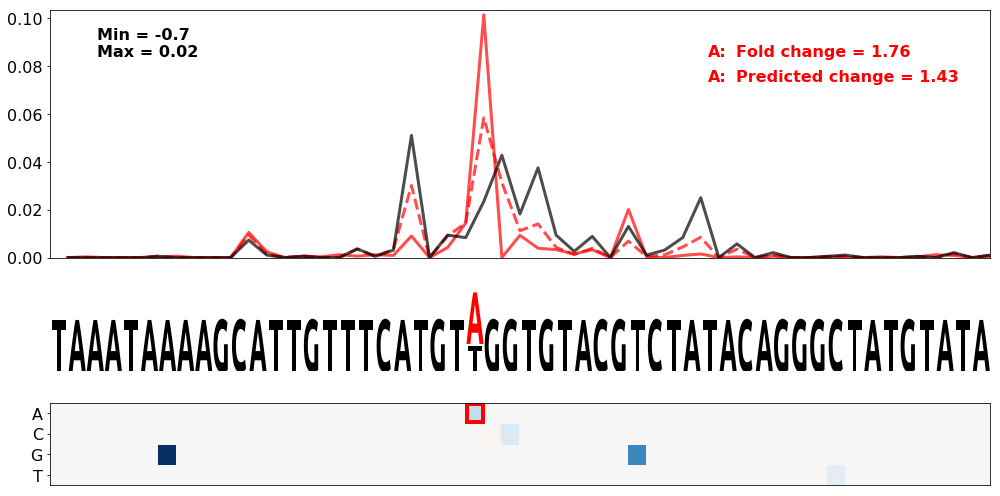

Gene = GLA.6
WT seq = AATCCCACAGGCACTGTTTTGCTTCAGCTAGAAAATACAATGCAGATGTCATTAAAAGACTTACTTTAAAATGTTTATTTTATTGCCAACTACTACTTCCTGTCCACCTTTTTCTCCATTCACTTTAAAAGCTCAAGGCTAGGTGGCTCATGCCTGTAATCCCA
SNV pos = 75
SNV nt = A
ClinVar id = Missing


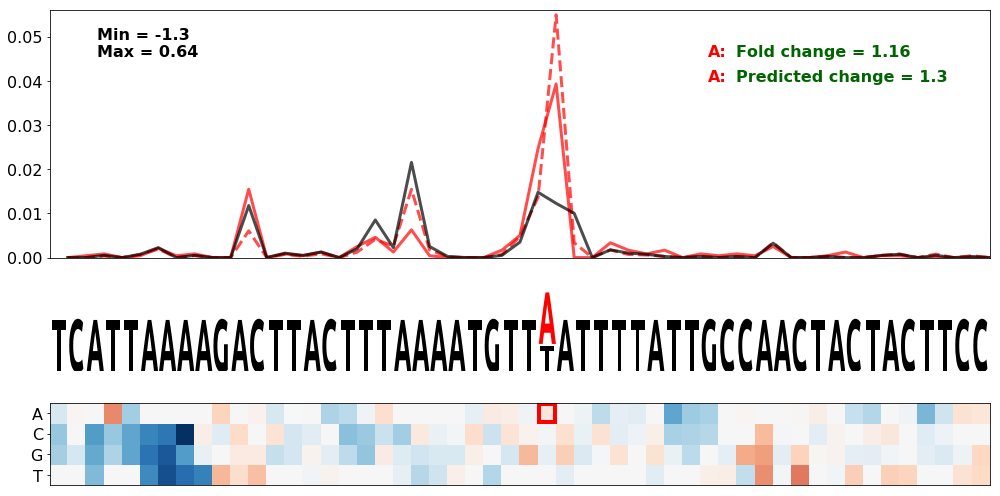

Gene = TPMT.3
WT seq = TACATTTTAATTAAACAATCTATATGGAACAAACATTCCCAAATTCTAAGAATAAATTTTTCTTTAAGTTTTCTCTGAGTTTGGCAATTGTTGTTTTTTATAATTTAATCTGTTTAAATCATCAGGTCTTATAAAATATAATGTACTTAGAGCTGGATTCATGG
SNV pos = 72
SNV nt = T
ClinVar id = Missing


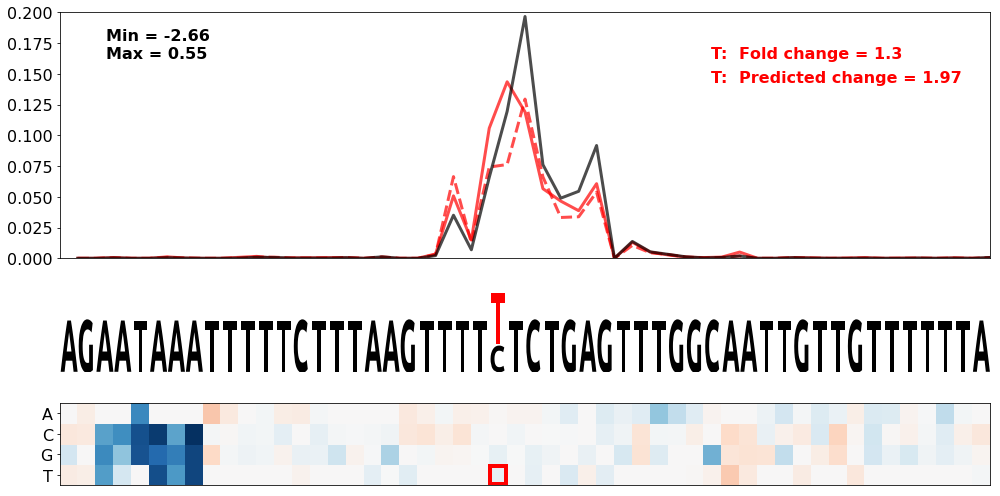

Gene = ARSA.1
WT seq = GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG
SNV pos = 75
SNV nt = A
ClinVar id = Missing


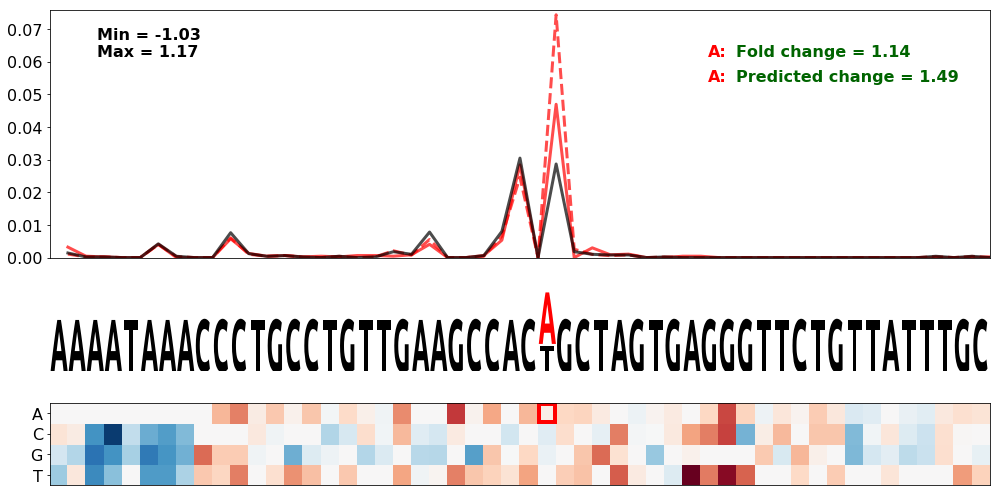

Gene = ARSA.1
WT seq = GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG
SNV pos = 73
SNV nt = T
ClinVar id = Missing


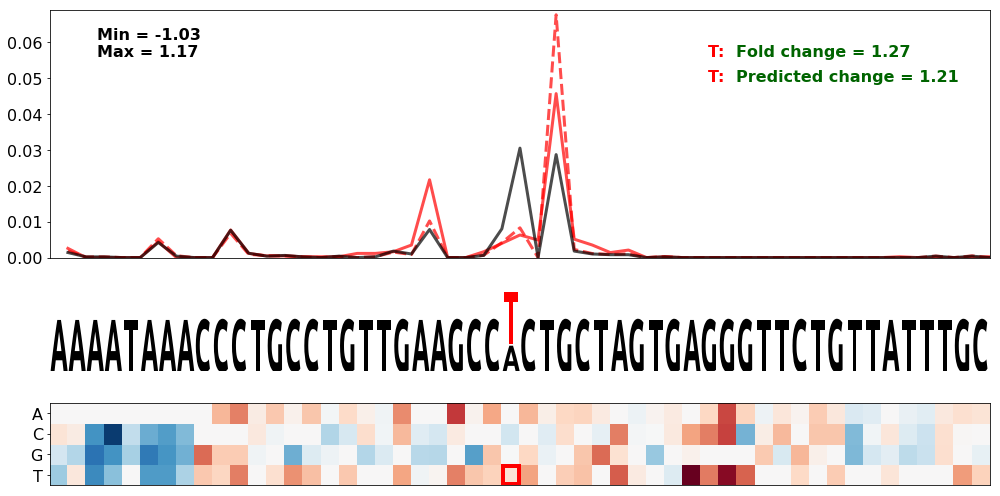

Gene = ARSA.1
WT seq = GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG
SNV pos = 73
SNV nt = C
ClinVar id = Missing


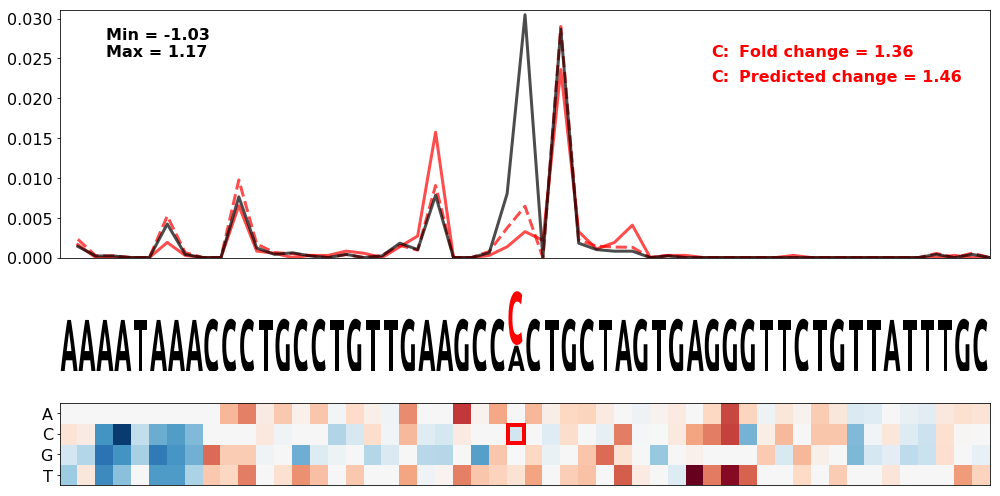

In [35]:
print('Interesting cut alteration examples:')

experiment_name = 'cut_alteration'

gene_names = [
    'TPM1.7',
    'CPOX.2',
    'RYR2.5',
    'TGFBR2.6',
    'MSH2.1',
    'HBA2.2',
    'TP53.3',
    'PRKAG2.2',
    'TP53.3',
    'MRPS16.7',
    'FOXC1.2',
    'FOXC1.2',
    'FOLR1.1',
    'BRCA1.1',
    'BRCA1.1',
    'RB1.14',
    'GLA.6',
    'TPMT.3',
    'ARSA.1',
    'ARSA.1',
    'ARSA.1'
]

snv_list = [
    [(79, 'C', 'red')],
    [(77, 'G', 'red')],
    [(75, 'G', 'red')],
    [(77, 'A', 'red')],
    [(72, 'G', 'red')],
    [(71, 'C', 'red')],
    [(73, 'A', 'red')],
    [(76, 'A', 'red')],
    [(70, 'A', 'red')],
    [(78, 'A', 'red')],
    [(68, 'A', 'red')],
    [(77, 'G', 'red')],
    [(67, 'G', 'red')],
    [(71, 'A', 'red')],
    [(72, 'A', 'red')],
    [(71, 'A', 'red')],
    [(75, 'A', 'red')],
    [(72, 'T', 'red')],
    [(75, 'A', 'red')],
    [(73, 'T', 'red')],
    [(73, 'C', 'red')]
]

wt_seq_list = [
    'GAACCTTGAACAGATACAACTAATTTACATATTACTAACCAAACTTAAACATTAAACTTTTTCTACTACTTTAAATTCTAACCTGGAATGTTTCAGAGTTCTTCATTCTAATATCACCCTGAATTCCATTGAAGCTGGAAATGTCATTTTCCAAGCCCACCTGT',
    'TATGATTTCTTTGTTCATATATTATGAATGTATTATTTTATTTGCTTCGTAATAAAGTTTATAAGGAAGAGCATCTCATACATATCATTATCGTGGAACACGTTGAATGTTTGTGATTCTGTGTGGCCTTTTTGGGGCTGGAAAATGTATGAATTCTTCAACTG',
    'AGAAACAAGTTGATCAACGTGAGAGAAATTTCATGATAATTATTCATAGTAATAAAGTGTCGTGGGCTTAATTGTATATCTGGAGCCAGTGTCATCCACCAACAATGTGATACAATATGAACTTGACAGTAGTTTTGGGTTTTGCTCATTCTTTCAGCCACCTG',
    'CACTGTAAACATTAGCTCTTTCCACTGCCTACCTGGACCCCAGTCTAGGAATTAAATCTGCACCTAACCAAGGTCCCTTGTAAGAAATGTCCATTCAAGCAGTCATTCTCTGGGTATATAATATGATTTTGACTACCTTATCTGGTGTTAAGATTTGAAGTTGG',
    'ACTGTTTGCAATTGACATAGGCAATAATAAGTGATGTGCTGAATTTTATAAATAAAATCATGTAGTTTGTGGAATTTGAGATGCATTGTAGTTCTTCGCAGTGTGACTTCAAATATTTTGGAAGAAACAAATAGCTCAGAGACCTCGTAAAATATCTTAAACTG',
    'CTCCCAACGGGCCCTCCTCCCCTCCTTGCACCGGCCCTTCCTGGTCTTTGAATAAAGTCTGAGTGGGCAGCAGCCTGTGTGTGCCTGGGTTCTCTCTATCCCGGAATGTGCCAACAATGGAGGTGTTTACCTGTCTCAGACCAAGGACCTCTCTGCAGCTGCAT',
    'CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG',
    'TGCAATTTTTTTACACATCTTTTGGTGGAGTAAACTTCACCACATCCATGAATAAACTCTCAGTTATTTTGAAATGGCAAATTTCTCATTATTTAAGTTTGGATCTGGAAAGGACATGACTTCTGAAATAGCCGCTGCTGGGTTTTAAAAGCTGAGGTCTCTCA',
    'CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG',
    'GGTCCTTTTGAAACACTGCAGCGATCTTAATTTTGTTAGATTTGGAGTTCAATAAATGGAGTATCCTGAGTTGCCCTTGCTCTTCTGGCCTGGCCTGCACAGGGCCCAGGGAGAGATTTGTTCTTGTGTGACTTAGAGCTGGGTGTGGGTACTAATTAGCTTTT',
    'TCTATCCTCTTTTCTTTCTTTTTGTTGAACATATTCATTGTTTGTTTATTAATAAATTACCATTCAGTTTGAATGAGACCTATATGTCTGGATACTTTAATAGAGCTTTAATTATTACGAAAAAAGATTTCAGAGATAAAACACTAGAAGTTACCTATTCTCCA',
    'TCTATCCTCTTTTCTTTCTTTTTGTTGAACATATTCATTGTTTGTTTATTAATAAATTACCATTCAGTTTGAATGAGACCTATATGTCTGGATACTTTAATAGAGCTTTAATTATTACGAAAAAAGATTTCAGAGATAAAACACTAGAAGTTACCTATTCTCCA',
    'CCCAACTATTTGGTTCCTGCTCCATGGTCGGGCCTCTGACAGCCACTTTGAATAAACCAGACACCGCACATGTGTCTTGAGAATTATTTGGATATGAATGGGAACGTGACTGTTTTGTTTTCCAATTCCCATTGATTGAAACCAGTGAGACTGGGCCAATTCCT',
    'ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG',
    'ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG',
    'ATAATTTACAGAAAGCTACAGAAATCATATTTACCAGGACACATCTGTTAAATAAAAGCATTGTTTCATGTTGGTGTACGTCTATACAGGGCTATGTATAACCGACTCCTGTTTCTCCTCCCTGCAACCACAGAACCATCACACACACACACACACACACACAC',
    'AATCCCACAGGCACTGTTTTGCTTCAGCTAGAAAATACAATGCAGATGTCATTAAAAGACTTACTTTAAAATGTTTATTTTATTGCCAACTACTACTTCCTGTCCACCTTTTTCTCCATTCACTTTAAAAGCTCAAGGCTAGGTGGCTCATGCCTGTAATCCCA',
    'TACATTTTAATTAAACAATCTATATGGAACAAACATTCCCAAATTCTAAGAATAAATTTTTCTTTAAGTTTTCTCTGAGTTTGGCAATTGTTGTTTTTTATAATTTAATCTGTTTAAATCATCAGGTCTTATAAAATATAATGTACTTAGAGCTGGATTCATGG',
    'GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG',
    'GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG',
    'GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG'
]

seq_start = 48
seq_end = 100

save_figs = False

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = human_variant_df.copy().set_index('master_seq')
    if specific_seq is not None :
        df_sel = human_variant_df.query("wt_seq == '" + specific_seq + "'").copy().set_index('master_seq')

    df_sel['delta_logodds_pred'] = df_sel['mean_delta_logodds_pred']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

In [19]:

df_all_snvs = seq_predicted_isoform_df_delta.query("variant == 'snv'").copy().reset_index(drop=False).sort_values(by='delta_logodds_true', ascending=False)

df_all_snvs = df_all_snvs[[
    'gene',
    'clinvar_id',
    'significance',
    'in_acmg',
    'sitetype',
    'wt_seq',
    'master_seq',
    'snv_pos',
    'delta_logodds_true',
    'delta_logodds_pred',
    'delta_p_val'
]]

df_clinvar_snvs = df_all_snvs.query("significance != 'Missing'")

df_all_snvs.to_csv('array_all_snvs.csv', sep='\t', index=False)
df_clinvar_snvs.to_csv('array_clinvar_snvs.csv', sep='\t', index=False)


<h2>Rare Functional Variant analysis</h2>

In [16]:
df_var = seq_predicted_isoform_df_delta_filtered.query("variant == 'snv' and snv_pos != -1").copy().reset_index()

mer6_weights_doubledope = np.load('apa_6mer_weights/apa_6mer_v_general3_antimisprime_orig_pasaligned_margin_doubledope_weights.npy')[1:]
mer6_weights_simple = np.load('apa_6mer_weights/apa_6mer_v_general3_antimisprime_orig_pasaligned_margin_simple_weights.npy')[1:]
mer6_weights_tomm5 = np.load('apa_6mer_weights/apa_6mer_v_general3_antimisprime_orig_pasaligned_margin_tomm5_weights.npy')[1:]
mer6_weights_all = np.load('apa_6mer_weights/apa_6mer_v_general3_antimisprime_orig_pasaligned_margin_all_weights.npy')[1 + 36:]

mer6_weights_use = (mer6_weights_tomm5[:4096] + mer6_weights_simple[:4096]) / 2.
mer6_weights_pas = mer6_weights_doubledope[4096:2*4096]
mer6_weights_dse = (mer6_weights_tomm5[2*4096:] + mer6_weights_simple[2*4096:]) / 2.

mer6_dict = {}
mer6_list = []
i = 0
bases = ['A', 'C', 'G', 'T']
for b1 in bases :
    for b2 in bases :
        for b3 in bases :
            for b4 in bases :
                for b5 in bases :
                    for b6 in bases :
                        mer6_dict[b1 + b2 + b3 + b4 + b5 + b6] = i
                        mer6_list.append(b1 + b2 + b3 + b4 + b5 + b6)
                        i += 1

delta_6mer_scores = []

for _, row in df_var.iterrows() :
    
    snv_pos = row['snv_pos']
    
    var_seq = row['master_seq']
    ref_seq = row['wt_seq']
    
    delta_score = 0
    
    mer6_weights = mer6_weights_use
    if snv_pos >= 50 and snv_pos <= 56 :
        mer6_weights = mer6_weights_pas
    elif snv_pos > 56 :
        mer6_weights = mer6_weights_dse
    
    for offset in range(-6 + 1, 6 - 1) :
        
        var_motif = var_seq[snv_pos+offset:snv_pos+offset + 6]
        if len(var_motif) == 6 :
            delta_score += mer6_weights[mer6_dict[var_motif]]
        
        ref_motif = ref_seq[snv_pos+offset:snv_pos+offset + 6]
        if len(ref_motif) == 6 :
            delta_score -= mer6_weights[mer6_dict[ref_motif]]
    
    delta_6mer_scores.append(delta_score)

df_var['delta_6mer_score'] = delta_6mer_scores


<h2>Gain/Loss of canonical CSE Hexamer (A\[A/T\]TAAA)</h2>

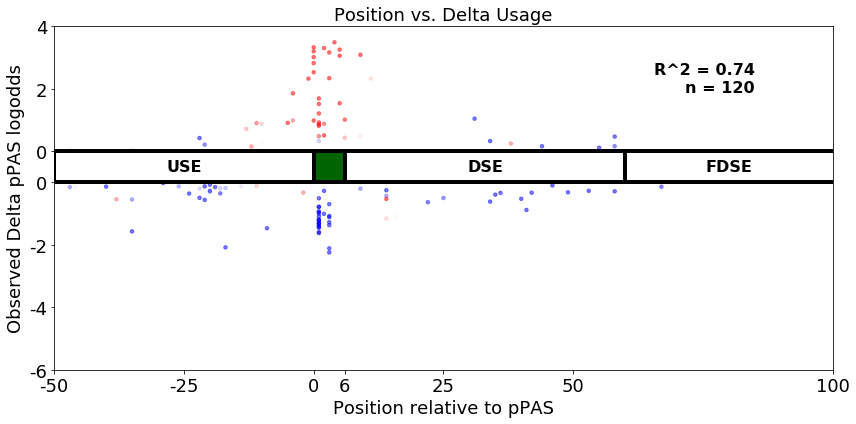

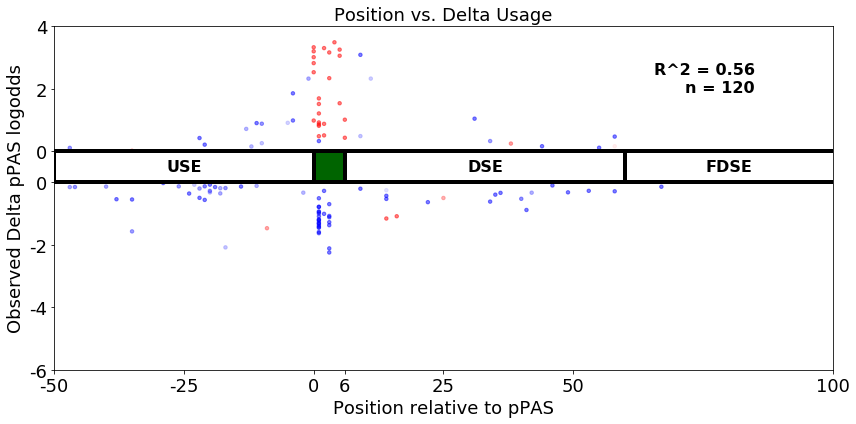


# Gain of ['AATAAA', 'ATTAAA'] = 120
# Neural net / Observation agreement = 103
# Neural net / 6-mer model agreement = 100
## Gain of motif in USE = 39
### Gain of motif, Loss of function = 26
### Gain of motif, Gain of function = 13
### Neural net / 6-mer model agreement = 26
## Gain of motif in DSE = 31
### Gain of motif, Loss of function = 19
### Gain of motif, Gain of function = 12
### Neural net / 6-mer model agreement = 24


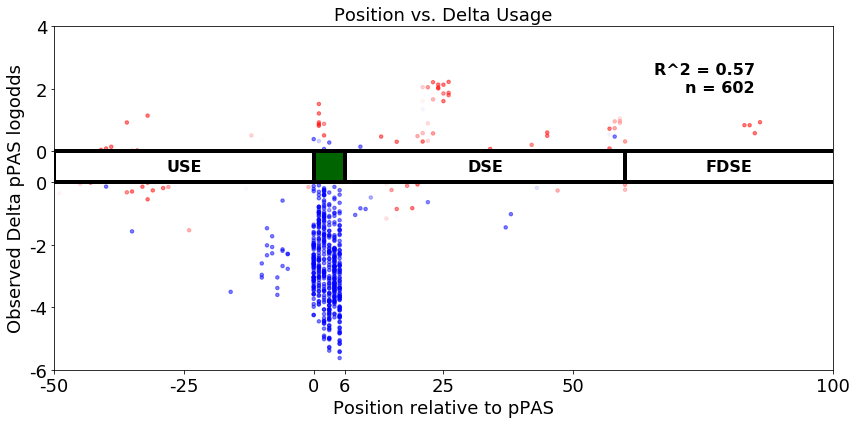

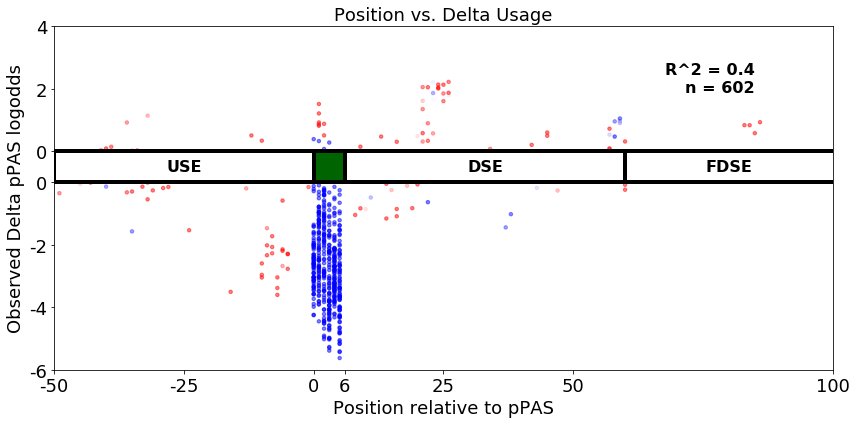


# Loss of ['AATAAA', 'ATTAAA'] = 602
# Neural net / Observation agreement = 569
# Neural net / 6-mer model agreement = 566
## Loss of motif in USE = 45
### Loss of motif, Loss of function = 36
### Loss of motif, Gain of function = 9
### Neural net / 6-mer model agreement = 23
## Loss of motif in DSE = 63
### Loss of motif, Loss of function = 19
### Loss of motif, Gain of function = 44
### Neural net / 6-mer model agreement = 49


In [184]:
#Gain/Loss of de novo canonical PAS (CSE Hexamer)

save_figs = False

motifs = ['AATAAA', 'ATTAAA']#['AATAAA', 'ATTAAA']#['TATAAA', 'GATAAA', 'CATAAA', 'ACTAAA', 'AGTAAA']#['AATAAA', 'ATTAAA', 'TATAAA', 'GATAAA', 'CATAAA', 'ACTAAA', 'AGTAAA']

gain_of_motif_index = []
loss_of_motif_index = []

for motif in motifs :
    i = 0
    for _, row in df_var.iterrows() :

        snv_pos = row['snv_pos']

        var_seq = row['master_seq']
        ref_seq = row['wt_seq']

        motif_len = len(motif)

        var_motif_dict = {}
        ref_motif_dict = {}
        for offset in range(-motif_len + 1, motif_len - 1) :

            var_motif = var_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(var_motif) == motif_len :
                if var_motif not in var_motif_dict :
                    var_motif_dict[var_motif] = 0
                var_motif_dict[var_motif] += 1

            ref_motif = ref_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(ref_motif) == motif_len :
                if ref_motif not in ref_motif_dict :
                    ref_motif_dict[ref_motif] = 0
                ref_motif_dict[ref_motif] += 1

        if motif in var_motif_dict and motif not in ref_motif_dict :
            gain_of_motif_index.append(i)
        elif motif not in var_motif_dict and motif in ref_motif_dict :
            loss_of_motif_index.append(i)

        i += 1



gain_of_motif_df = df_var.iloc[gain_of_motif_index].copy().set_index('master_seq')
loss_of_motif_df = df_var.iloc[loss_of_motif_index].copy().set_index('master_seq')

fig_name = None
if save_figs :
    fig_name = 'gain_of_canonical_pas_neural_net'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'gain_of_canonical_pas_hexamer_model'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Gain of ' + str(motifs) + ' = ' + str(len(gain_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_6mer_score']))[0])))
print('## Gain of motif in USE = ' + str(len(gain_of_motif_df.query("snv_pos < 50"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Gain of motif in DSE = ' + str(len(gain_of_motif_df.query("snv_pos >= 56"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


fig_name = None
if save_figs :
    fig_name = 'loss_of_canonical_pas_neural_net'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'loss_of_canonical_pas_hexamer_model'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Loss of ' + str(motifs) + ' = ' + str(len(loss_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_6mer_score']))[0])))
print('## Loss of motif in USE = ' + str(len(loss_of_motif_df.query("snv_pos < 50"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Loss of motif in DSE = ' + str(len(loss_of_motif_df.query("snv_pos >= 56"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


Gene = PRKAG2.3
WT seq = TACCAAATCAGTTTGTTTTCTTTAGATTTGTCAAAAAGTTGTAATTTGAATATAAATAATTACTTTAAAATTGTAATGACACTTTTACACGTAAGTGTTTTGTTCTGGGCTACCGTGTCAACGAGGCTGCTTTACAACAGCTTTATTTATTTTTACTTTCATGC
SNV pos = 59
SNV nt = A
0.0956862265717704
0.7027773814577154
0.0956862265717704
0.1516437284772955


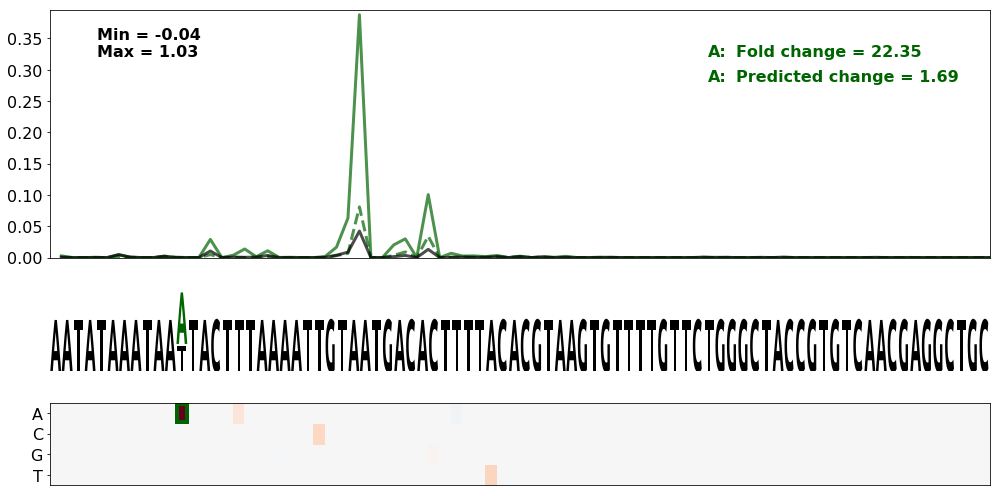

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 61
SNV nt = A
0.7265790766673279
0.8546421853407027
0.7265790766673279
1.1186634978231338


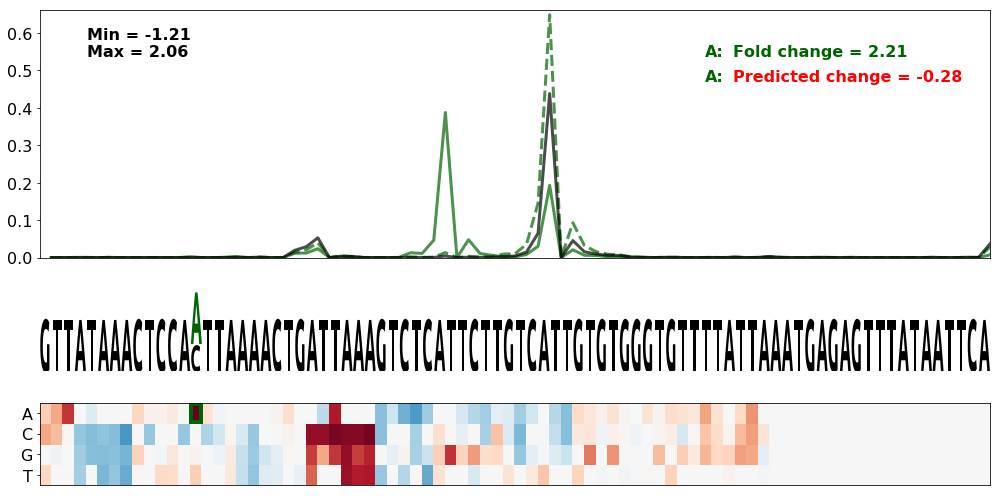

Gene = MET.2
WT seq = ACTTGTCACTGCCTATACCTGCAGCTGAACTGAATGGTACTTCGTATGTTAATAGTTGTTCTGATAAATCATGCAATTAAAGTAAAGTGATGCAACATCTTGTATACTGATAGTGGTTATTGCCAGTCATGCTTGATTACCTGCATTTGCATAATGATAGAGGA
SNV pos = 81
SNV nt = A
0.37823106022010544
0.15432782303544368
0.37823106022010544
0.3748414063249017


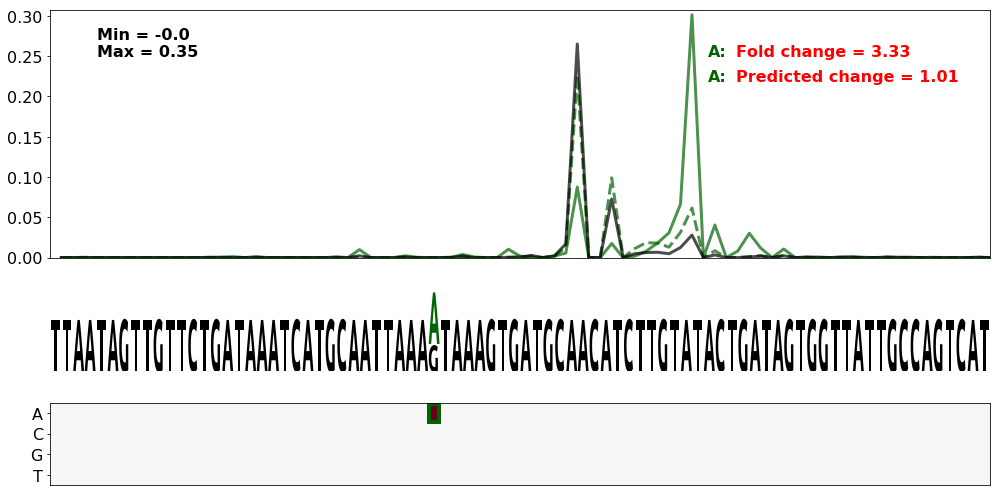

Gene = LDLR.6
WT seq = TAAACCACTGTATAGAAGGTTTTTGTAGCCTGAATGTCTTACTGTGATCAATTAAATTTCTTAAATGAACCAATTTGTCTAAACTCGATGCACGTTCTTCTGTTCGCGCGCTTCTTTTTGTTTTTTTTTTTTTCCTGAGATGGAGCCTGGCTCTGTCACCCCTG
SNV pos = 59
SNV nt = A
0.7941202447192723
0.8905352655217454
0.7941202447192723
0.7327232061683353


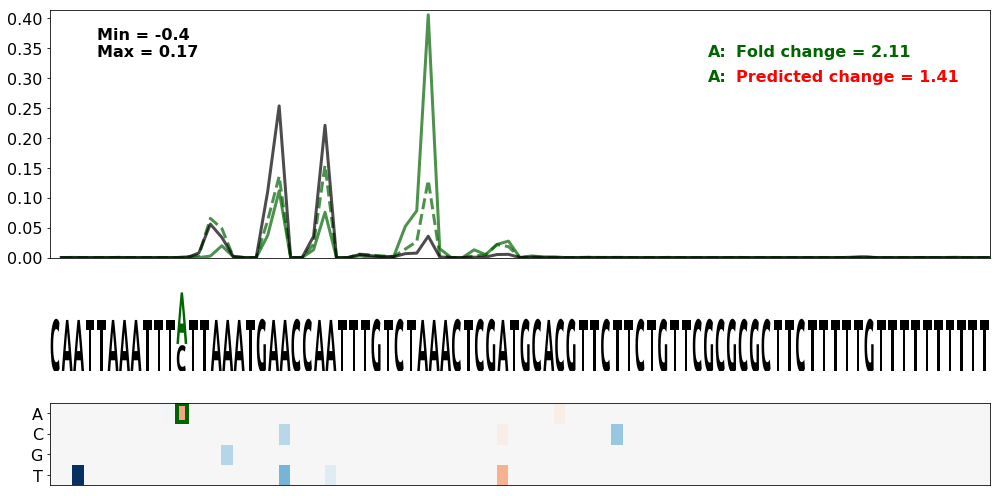

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = A
0.7265790766673279
0.5041824632815048
0.7265790766673279
0.6777648309746702


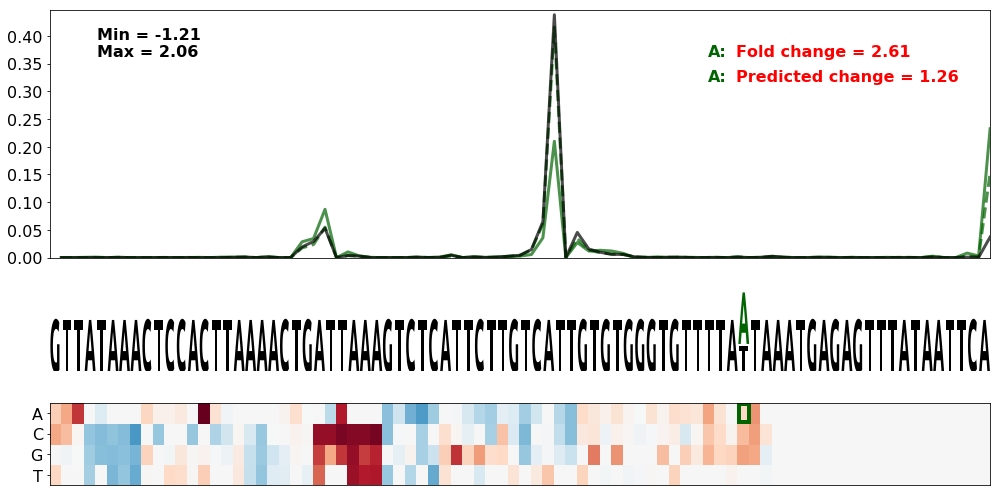

Gene = TGFBR1.3
WT seq = ACAGCCATGTGGGTCCTTTCTGTGCACTATGAACGCTTCTTTCCCAGGACAGAAAATGTGTAGTCTACCTTTATTTTTTATTAACAAAACTTGTTTTTTAAAAAGATGATTGCTGGTCTTAACTTTAGGTAACTCTGCTGTGCTGGAGATCATCTTTAAGGGCA
SNV pos = 84
SNV nt = A
0.024581160572721694
0.231589858626708
0.024581160572721694
0.06337545655101315


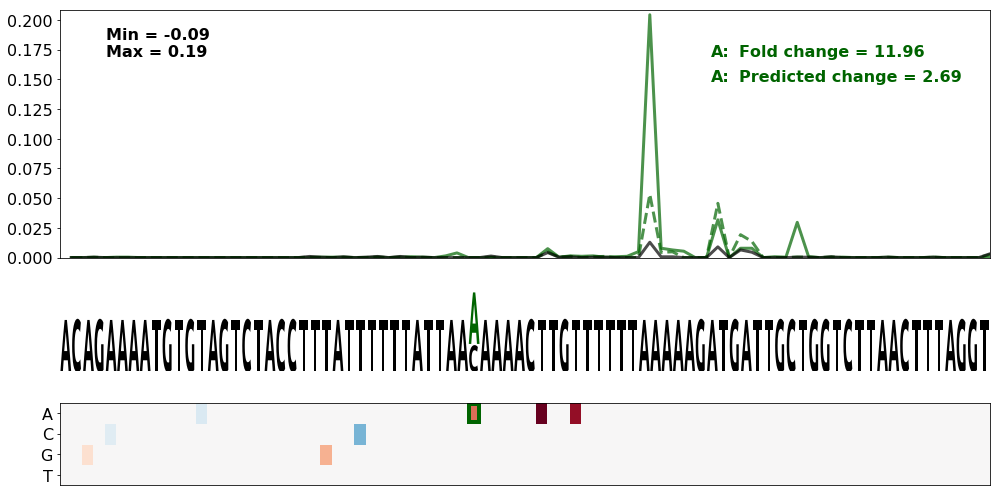

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = T
0.08781012845006006
0.08550393520111667
0.08781012845006006
0.07639493455781826


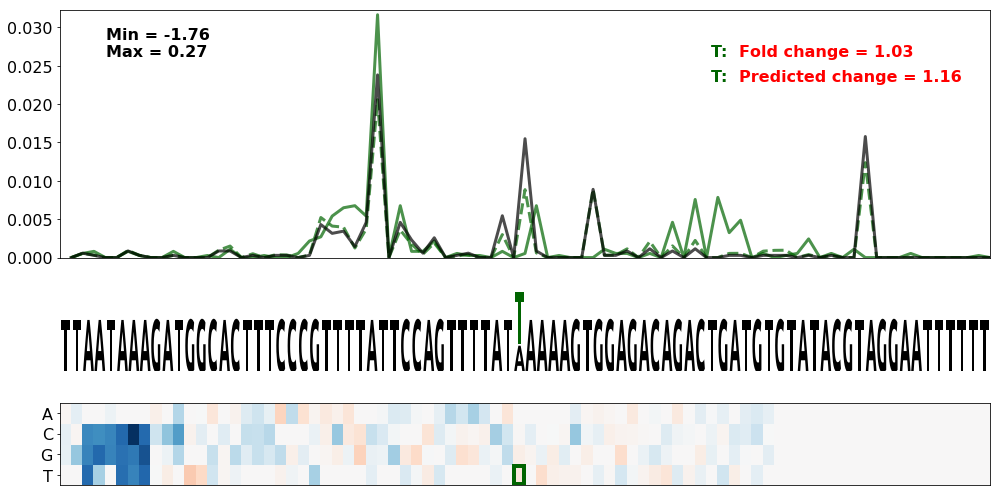

Gene = RYR2.6
WT seq = TCTTTTATTACAAGTCTGCTTGTTAATTTTAGAACTGTAAAACCGCTCTGATTAAACTATTTAACTAACTTTCTCATCCTCTTCTTTCTCCATTTAAAACTTATAACTGGGACTCATAAAATCTTGAGCTTCTAACTTGAGGTGGATATAGGACAATCCTAAAC
SNV pos = 94
SNV nt = A
0.2981027466278019
0.3344825858052114
0.2981027466278019
0.26157049713587854


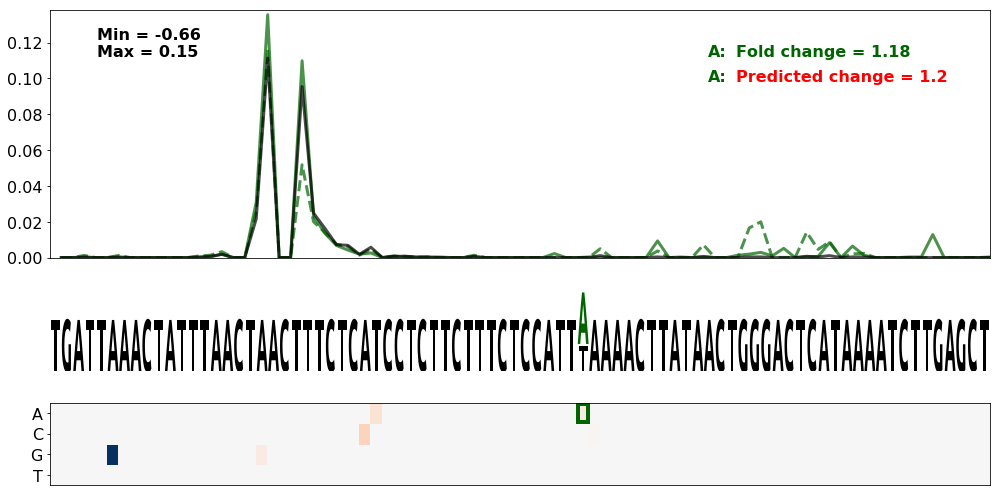

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 108
SNV nt = T
0.8097446825109856
0.8355341510980198
0.8097446825109856
0.7591396372931258


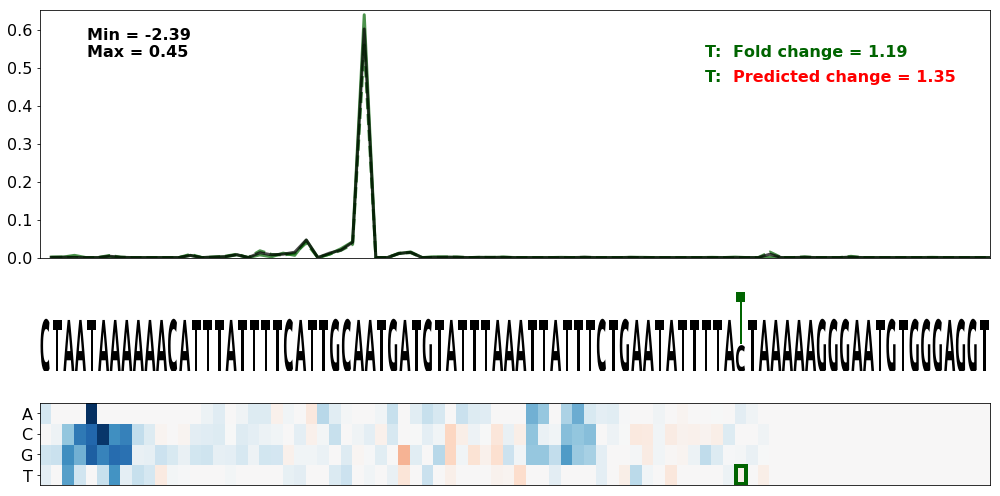

Gene = TPMT.3
WT seq = TACATTTTAATTAAACAATCTATATGGAACAAACATTCCCAAATTCTAAGAATAAATTTTTCTTTAAGTTTTCTCTGAGTTTGGCAATTGTTGTTTTTTATAATTTAATCTGTTTAAATCATCAGGTCTTATAAAATATAATGTACTTAGAGCTGGATTCATGG
SNV pos = 105
SNV nt = A
0.7277534860259833
0.7497344751581321
0.7277534860259833
0.7245433957498293


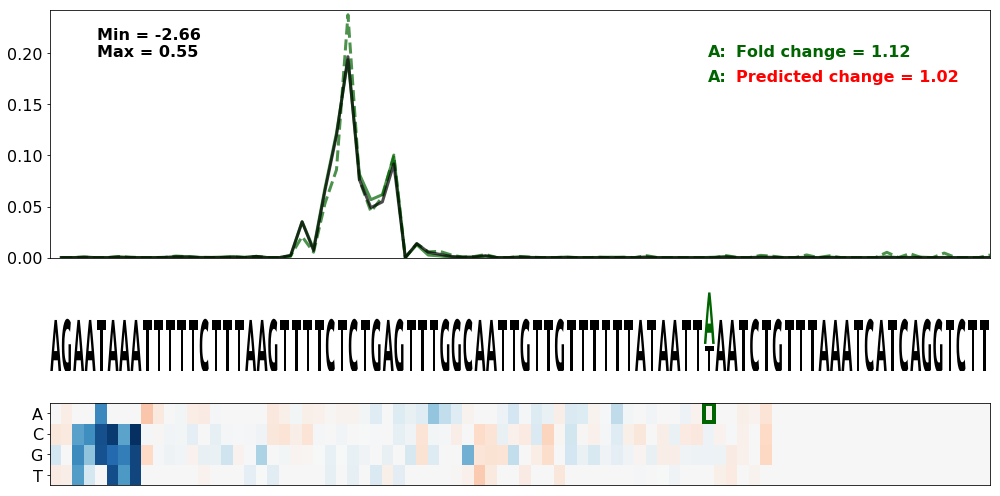

In [217]:

df_sel = gain_of_motif_df.query("snv_pos >= 57 and delta_logodds_true > 0.0").sort_values(by='delta_logodds_true', ascending=False)

seq_start = 48
seq_end = 130#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Gene = PTEN.12
WT seq = TTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGGGCAGCCAAATGTGAATACAAA
SNV pos = 87
SNV nt = G
0.645348328249508
0.2992175389873676
0.645348328249508
0.6101710295842548


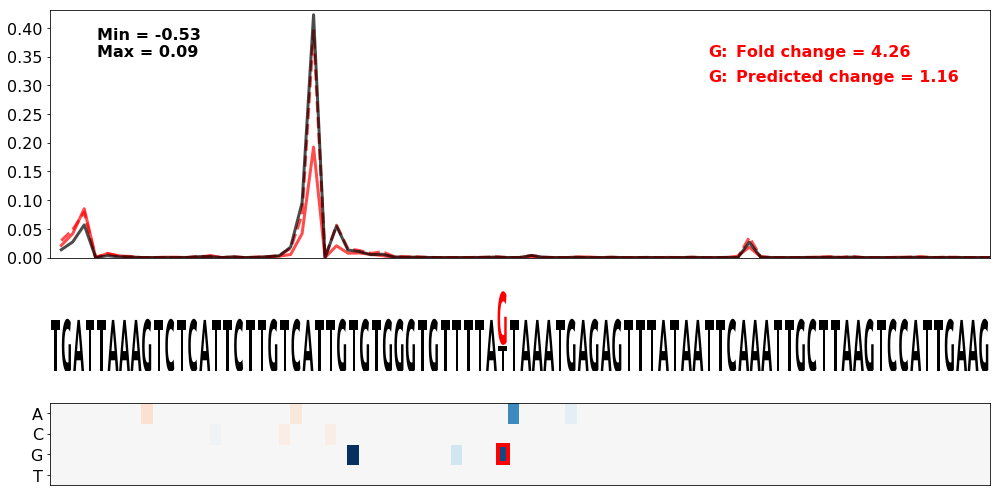

Gene = DSG2.2
WT seq = TATTAGTTTTACATTTGTTTTTTGGAAGATTATATTTGTATATGTATCATCATAAAATATTTAAATAAAAAGTATCTTTAGAGTGACCCTTTCCCCATAGATTTTTATTTCTCTATTATATTTTACAAGGAATATAACTCAGTTTGTTAGGGAGAGTGCCTTAA
SNV pos = 64
SNV nt = T
0.7261418158604942
0.38811858855254183
0.7261418158604942
0.4211353667820251


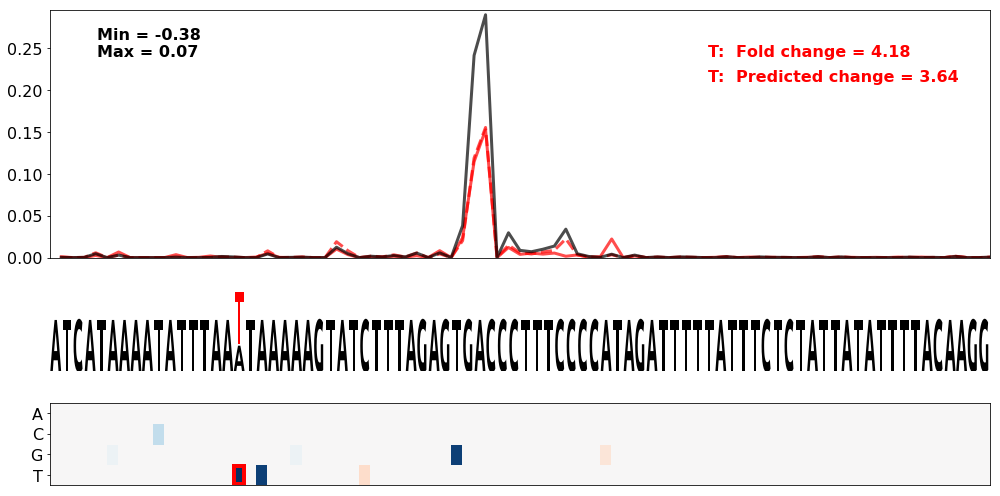

Gene = DSG2.2
WT seq = TATTAGTTTTACATTTGTTTTTTGGAAGATTATATTTGTATATGTATCATCATAAAATATTTAAATAAAAAGTATCTTTAGAGTGACCCTTTCCCCATAGATTTTTATTTCTCTATTATATTTTACAAGGAATATAACTCAGTTTGTTAGGGAGAGTGCCTTAA
SNV pos = 66
SNV nt = T
0.7261418158604942
0.3881871879611567
0.7261418158604942
0.4094705478054425


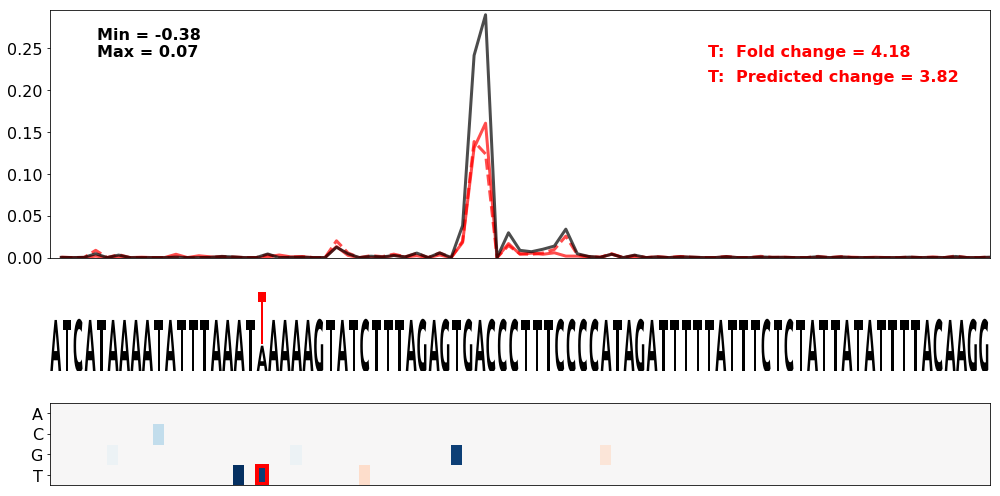

Gene = STK11.3
WT seq = GCGGCGGGGACTCGGAGGGTGCCGTGCGGGCGAGGCCGCCCAAATTTGGCAATAAATAAAGCTTGGGAAGCTTGGACCTGGCCGTCTGGGTTTTGTTCGCGTCTCAACGTGGATGGGGCGGCAGCGGGGCGGGCGCCGTTGACATGCGGAGGGCAGTGGGGACT
SNV pos = 58
SNV nt = C
0.3568089620333474
0.16250655675904585
0.3568089620333474
0.2819280717210097


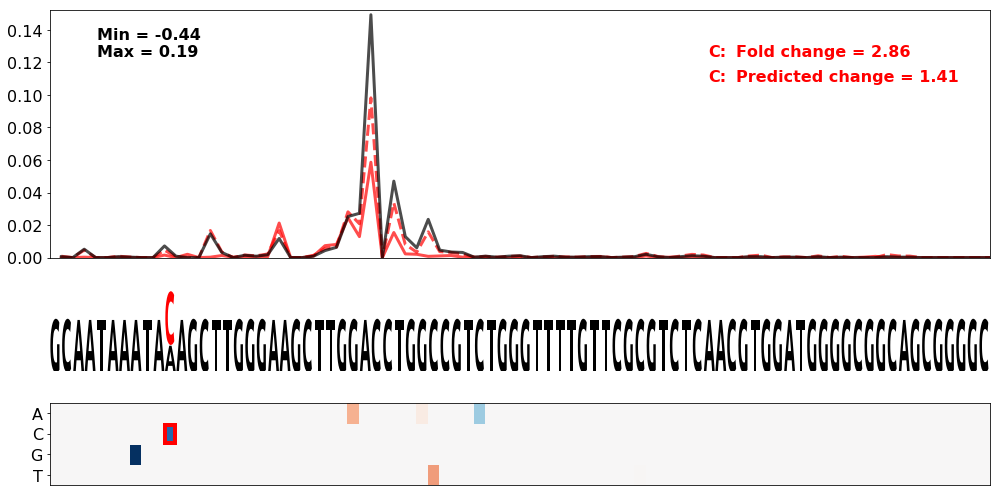

Gene = PTEN.12
WT seq = TTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGGGCAGCCAAATGTGAATACAAA
SNV pos = 88
SNV nt = A
0.645348328249508
0.39331904740193624
0.645348328249508
0.5974596608241276


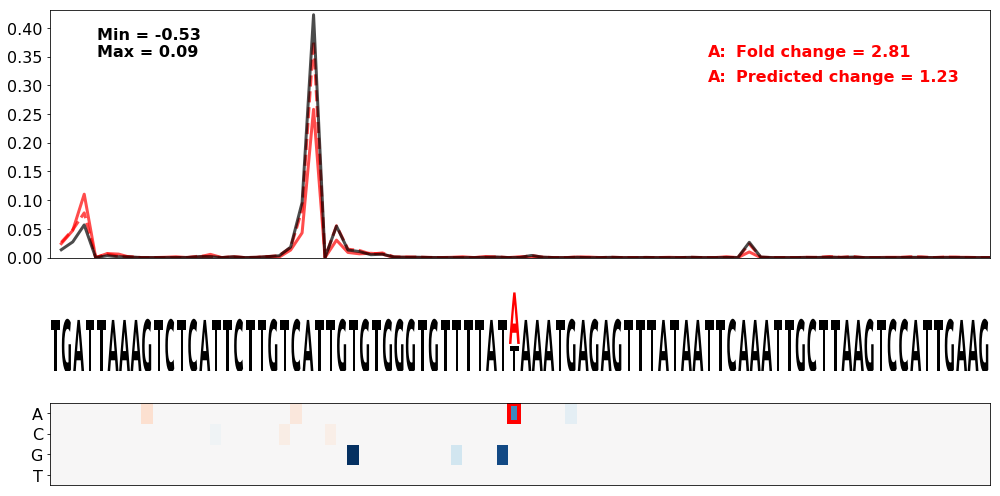

Gene = GLA.3
WT seq = AAAAAAGTTCTATTTCCTTGAATAAAATTTTCCGAAGTTTAAACTTTAGGAATAAAACTATTAAACCCATATTTACTCATCCAGATACCCACCCCCCTTGTTGAGATTCTCTCCCAATTATCAAAATGTGTAGCATATTTAACTACCAAGAGCTAAACATCATT
SNV pos = 60
SNV nt = C
0.036605376243475964
0.016298456594921504
0.036605376243475964
0.020728908048014364


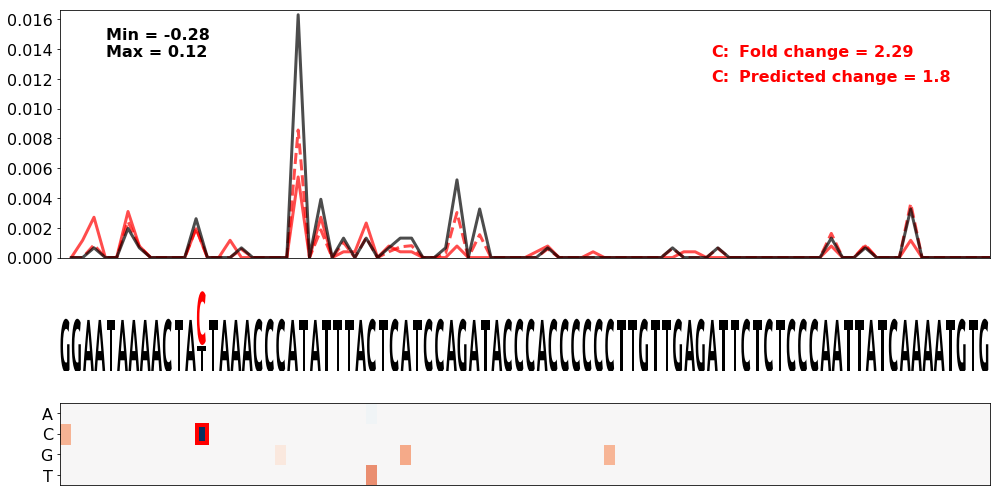

Gene = TMEM43.3
WT seq = AAAATTTGAAAGCTTTGGAAAACCAAATTTGTAATATCATTGTATTTTTTATTAAAAGTTTTGTAATAAATTTCTAAATTATCTTCTGGTGTGGGACTTTAACAAACATCCTATTTTTAGTTTCAGATTTTTTTTTTTTGGCATTCTTTCCAAAATGTCTGTAA
SNV pos = 66
SNV nt = G
0.450798214067312
0.2501901918115953
0.450798214067312
0.23036676755994984


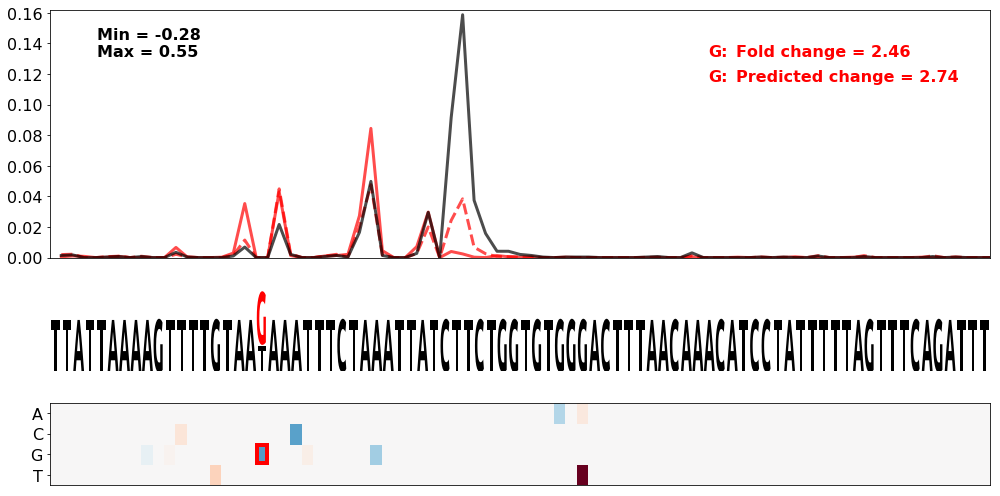

Gene = COL3A1.1
WT seq = TGTTTTATTTTTTTACCAATTCCAATTTCAAAATGTCTCAATGGTGCTATAATAAATAAACTTCAACACTCTTTATGATAACAACACTGTGTTATATTCTTTGAATCCTAGCCCATCTGCAGAGCAATGACTGTGCTCACCAGTAAAAGATAACCTTTCTTTCT
SNV pos = 59
SNV nt = T
0.6661107495155868
0.4673066860309901
0.6661107495155868
0.522332056809968


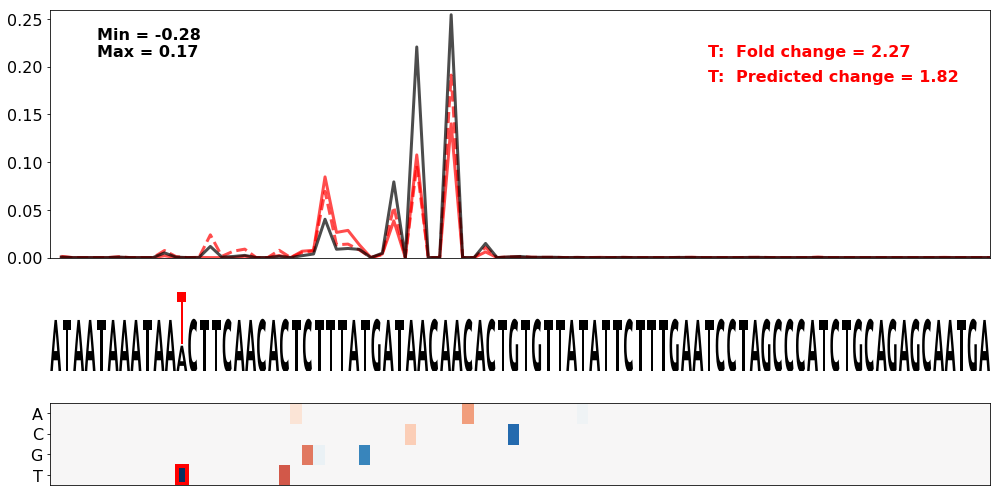

Gene = TMEM43.3
WT seq = AAAATTTGAAAGCTTTGGAAAACCAAATTTGTAATATCATTGTATTTTTTATTAAAAGTTTTGTAATAAATTTCTAAATTATCTTCTGGTGTGGGACTTTAACAAACATCCTATTTTTAGTTTCAGATTTTTTTTTTTTGGCATTCTTTCCAAAATGTCTGTAA
SNV pos = 69
SNV nt = C
0.450798214067312
0.25131118628910754
0.450798214067312
0.22311368197021894


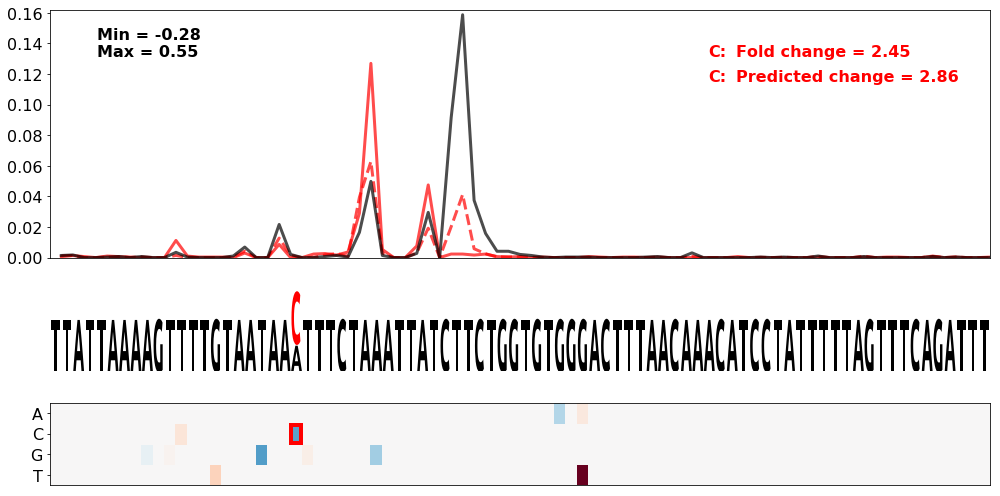

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 72
SNV nt = A
0.7265790766673279
0.8654506928220921
0.7265790766673279
0.8251443366797726


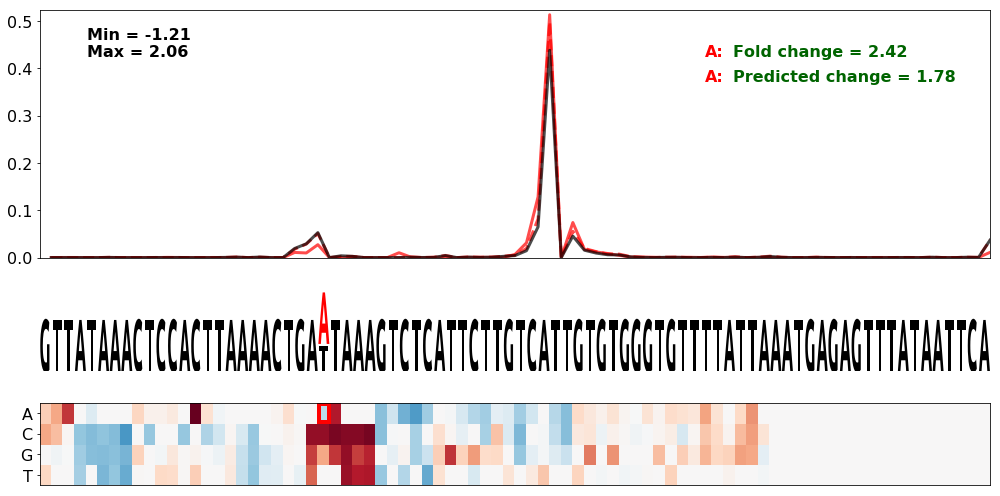

Gene = TGFBR1.11
WT seq = TACCTCACTGAGAGGGAACAGAAGGATATTGCTTCCTTTTGCAGCAGTGTAATAAAGTCAATTAAAAACTTCCCAGGATTTCTTTGGACCCAGGAAACAGCCATGTGGGTCCTTTCTGTGCACTATGAACGCTTCTTTCCCAGGACAGAAAATGTGTAGTCTAC
SNV pos = 61
SNV nt = G
0.04135723409002667
0.02874043910420323
0.04135723409002667
0.0404864058619491


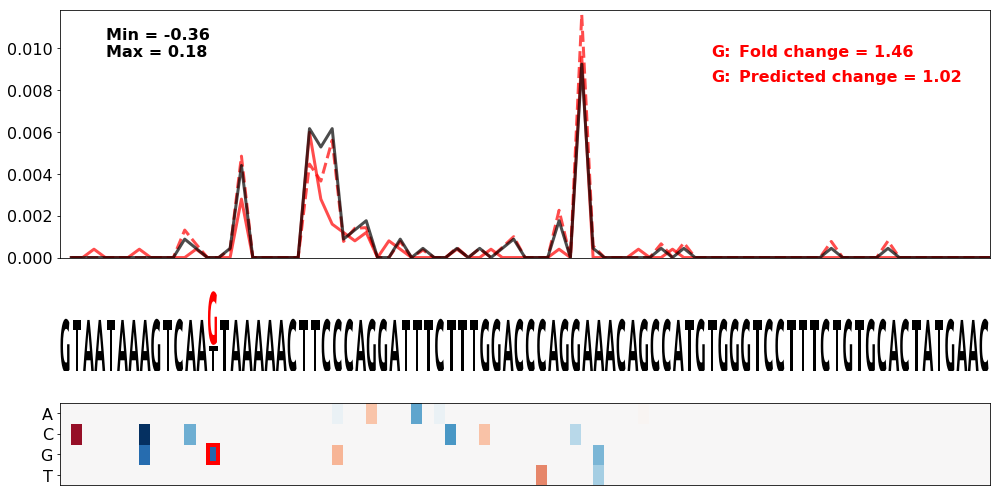

Gene = PTEN.4
WT seq = ATCATAATTAGTAATTGTACTTTTTCCCCTATTACAATAACTGGTTTCATAATAAAATGGTATCCCTTCAATAACAAGCATTTATAGTAGTTTATTAAAACTAAGGGTGTTATCTATTCAAACCAAGCAATGCAGACTTACTGTTGACTCTGTTAATATATTTT
SNV pos = 97
SNV nt = G
0.4942132351217728
0.4309006497833504
0.4942132351217728
0.5119011561464445


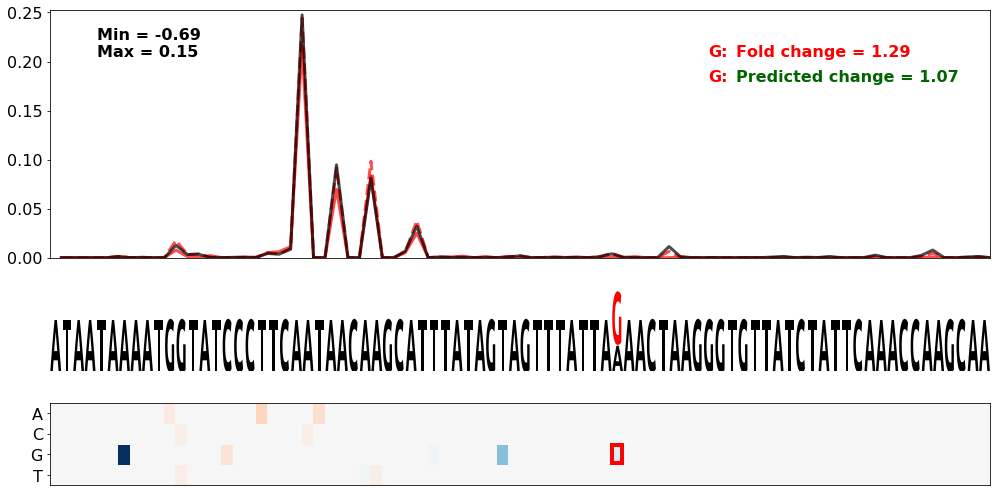

Gene = COL3A1.1
WT seq = TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC
SNV pos = 65
SNV nt = G
0.634486046939955
0.5755113030355206
0.634486046939955
0.6899782426633416


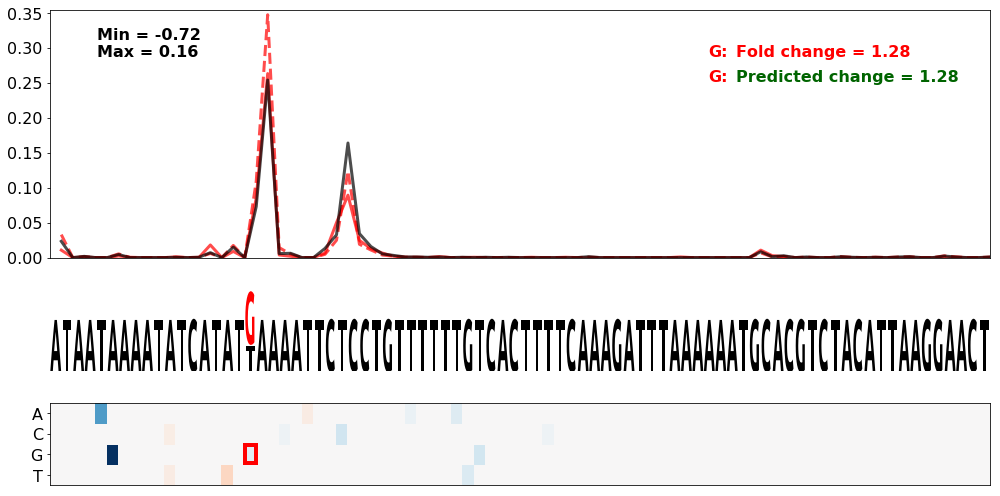

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 110
SNV nt = G
0.7265790766673279
0.8312353717896975
0.7265790766673279
0.8346210207557619


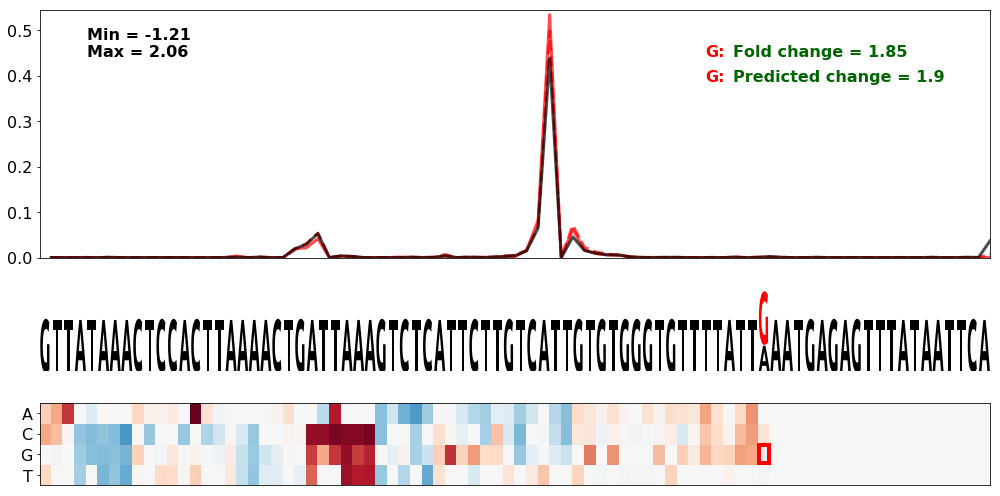

Gene = RET.5
WT seq = GTTGCTTTTTGAAAGAACATGGTCTGTGGTGCTGTGGTCTTACAATGGACAGTAAATATGGTTCTTGCCAAAACTCCTTCTTTTGTCTTTGATTAAATACTAGAAATTTTTTCTGTTTCCTAACTTCATCATTGATTGTTTGAAATCTTGGAGTTTCAAGCATT
SNV pos = 93
SNV nt = C
0.07252494660054537
0.06324465833196535
0.07252494660054537
0.07636760948168908


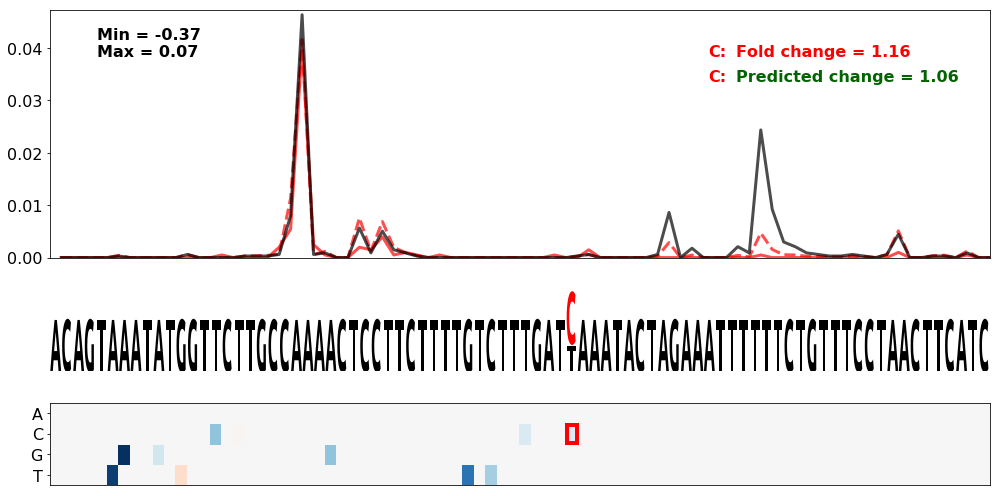

Gene = COL3A1.1
WT seq = TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC
SNV pos = 68
SNV nt = C
0.634486046939955
0.6109739488225681
0.634486046939955
0.5219556681908456


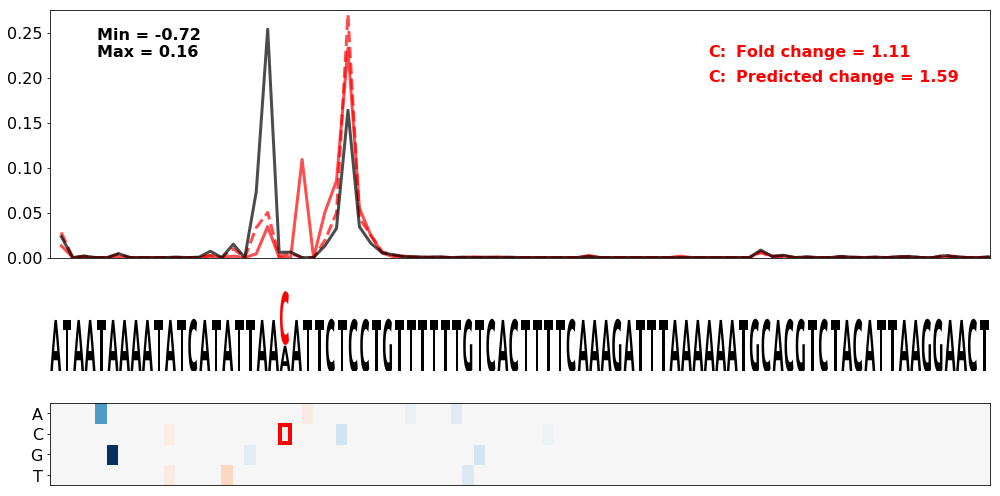

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 110
SNV nt = T
0.7265790766673279
0.8185763649016369
0.7265790766673279
0.8758375747348799


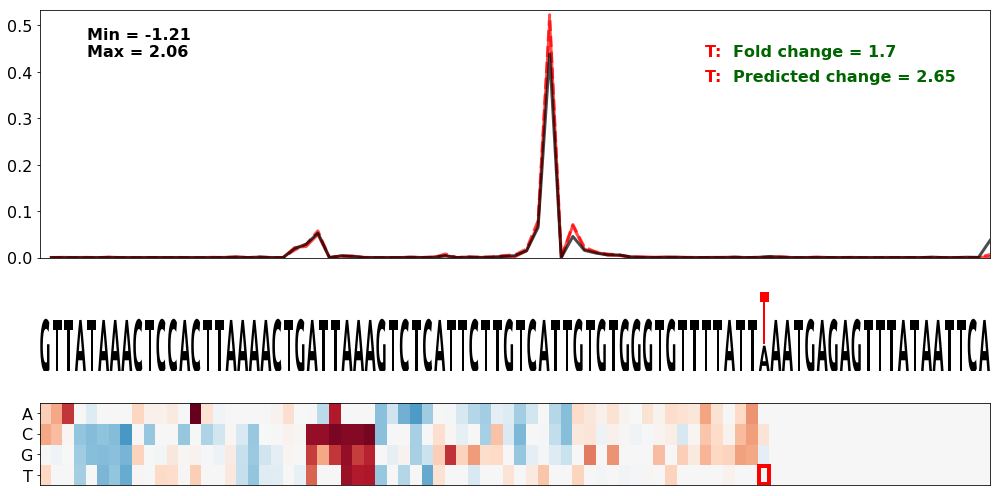

Gene = SDHD.1
WT seq = CAATGGGAATCTCTAATGTGAAAATGTATTCTATGAAAATAATTTTTTTAAATAAAATGTTATATAATAAAAGTGTCTTCTATGCTTTTATATATTAGCTATCAGTAGTTTTATTCATTAGAATTAGGTGTCCATTGCATCCACAGCATGAAAACAAAATTGGG
SNV pos = 70
SNV nt = G
0.8808032982932243
0.8458144025060516
0.8808032982932243
0.8519875638238762


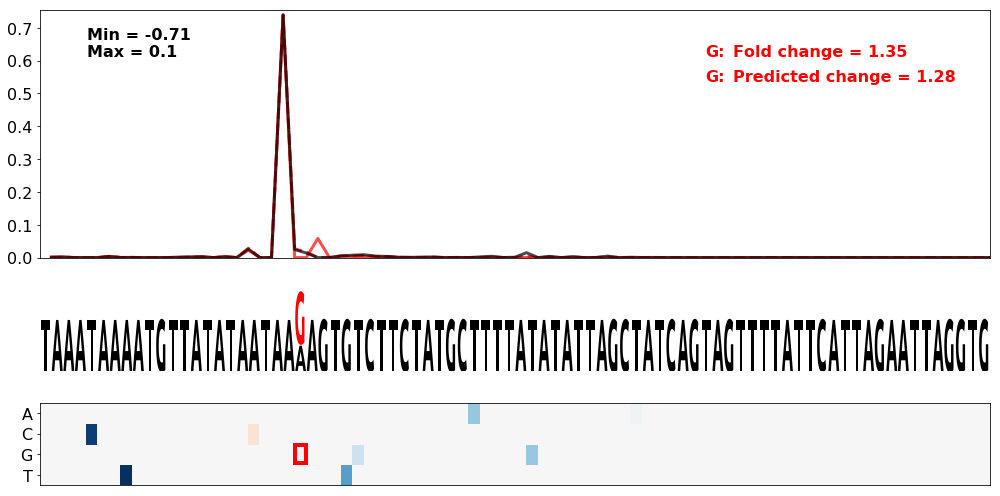

Gene = PMS2.1
WT seq = GGTGAGTTGTAGAATTATTTAATTATATGTTACAATGTAATAATAGTAGAAATAAAGTGCACAATAAATGCAATGCACTTGAATCGTCCTGAAACCATCCCTCCCCGACCCCAATCCATGGAAAAATTGTGTTCCGCGAAACCGGTCTCTGGTGCCAAAAAGGT
SNV pos = 64
SNV nt = C
0.13003723978177015
0.12252955653208131
0.13003723978177015
0.10820200217426143


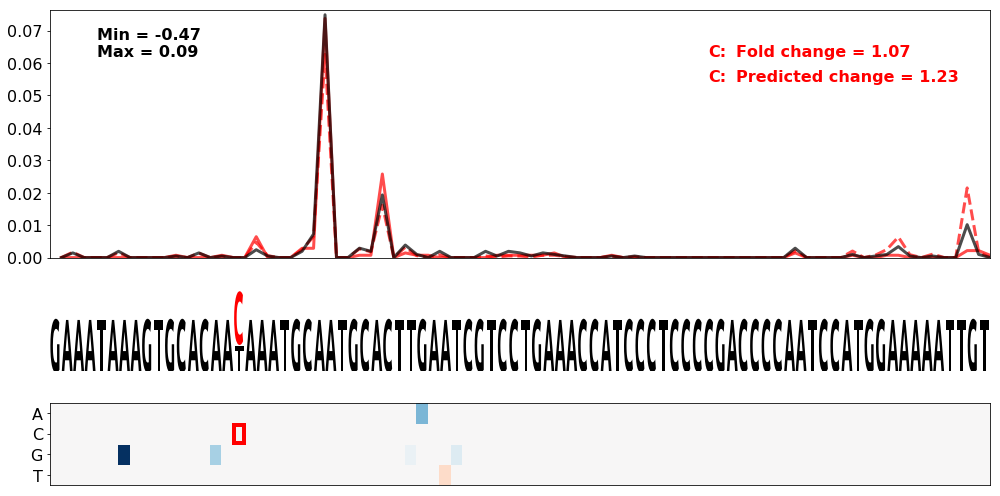

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 107
SNV nt = C
0.7265790766673279
0.7861192935947077
0.7265790766673279
0.7890787067965664


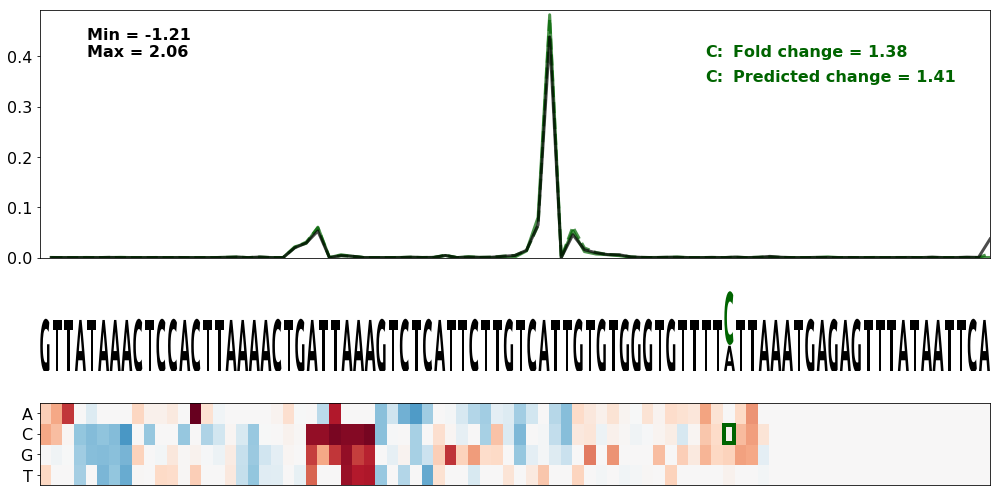

Gene = TPMT.6
WT seq = GTCTTGCAGATTGCAAGATATTTTACCAATCAGCATGTGTTACCTGTACAATTAAAAAAATATTTCAAAATGCAATGCATATTAAATATAATACACACAGAAAAACTGGCATTTATTTTGTTTTATTTTTTTGAGATGGAGTTTCGTTCTTGTTGCCCAACCTG
SNV pos = 84
SNV nt = C
0.38879652852015884
0.12368481487004061
0.38879652852015884
0.3227294563001515


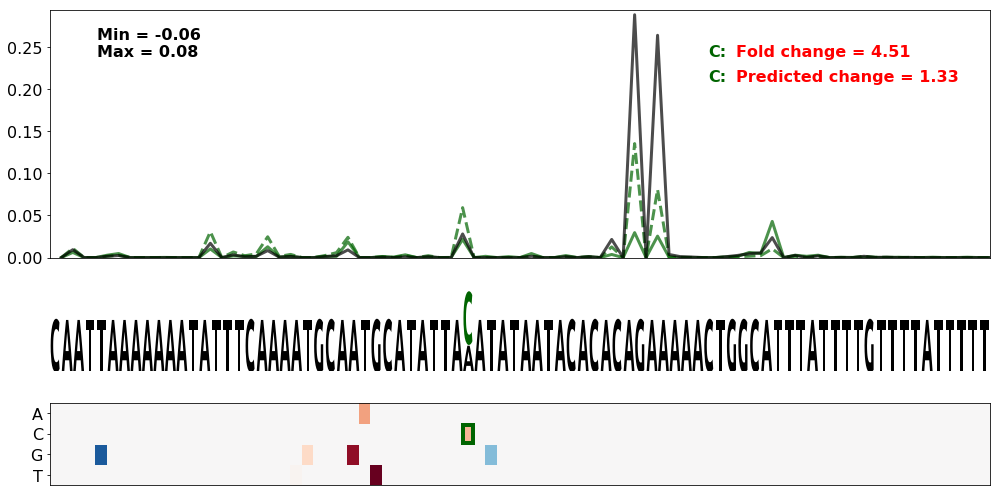

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 107
SNV nt = T
0.7265790766673279
0.8205781523951414
0.7265790766673279
0.8473781436762311


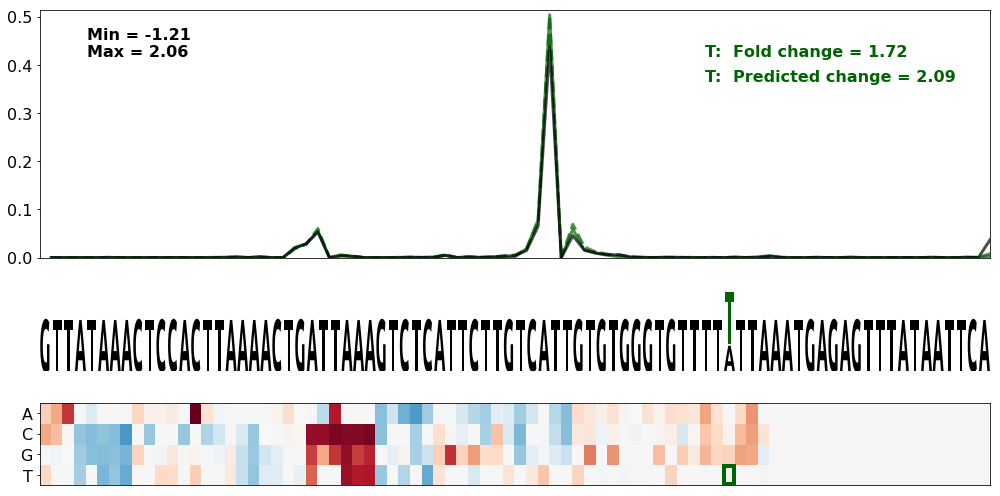

Gene = TSC2.1
WT seq = CCGGGGCCCTCCCTCCTGCACTGGCCTTGGACGGTATTGCCTGTCAGTGAAATAAATAAAGTCCTGACCCCAGTGCACAGACATAGAGGCACAGATTGCAGTCAGACAGCTCTTTTATTGACTTTGTCTGCTTGGTGCGGGGGTTGGGGGGGTGTCGAGGCTCT
SNV pos = 59
SNV nt = C
0.07442534492500484
0.05244096566239351
0.07442534492500484
0.055822817517151


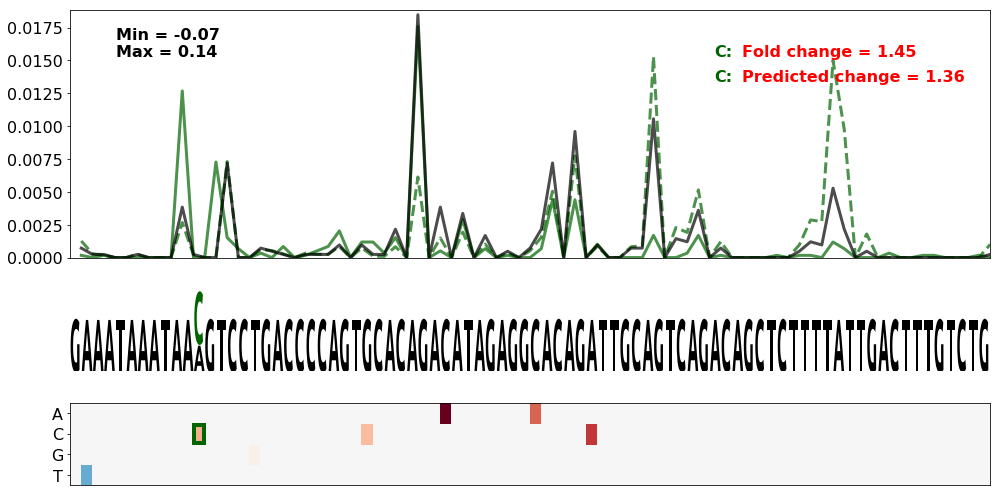

Gene = TGFBR1.5
WT seq = GATGCTTATGTTAAGTCCTAACACTACAGTAGAAGAATGGAAGCAGTGCAAATAAATTACATTTTTCCCAAGTGCCAGTGGCATATTTTAAAATAAAGTGTATACGTTGGAATGAGTCATGCCATATGTAGTTGCTGTAGATGGCAACTAGAACCTTTGAGTTA
SNV pos = 92
SNV nt = G
0.15742022917550597
0.17148548913462303
0.15742022917550597
0.16544487074854367


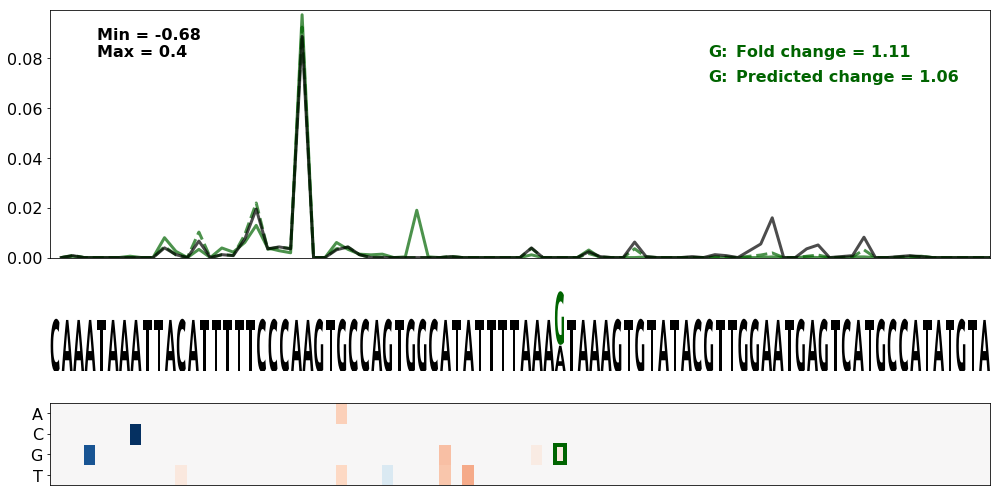

Gene = SDHD.1
WT seq = CAATGGGAATCTCTAATGTGAAAATGTATTCTATGAAAATAATTTTTTTAAATAAAATGTTATATAATAAAAGTGTCTTCTATGCTTTTATATATTAGCTATCAGTAGTTTTATTCATTAGAATTAGGTGTCCATTGCATCCACAGCATGAAAACAAAATTGGG
SNV pos = 66
SNV nt = C
0.8808032982932243
0.8872218421362204
0.8808032982932243
0.917270827532473


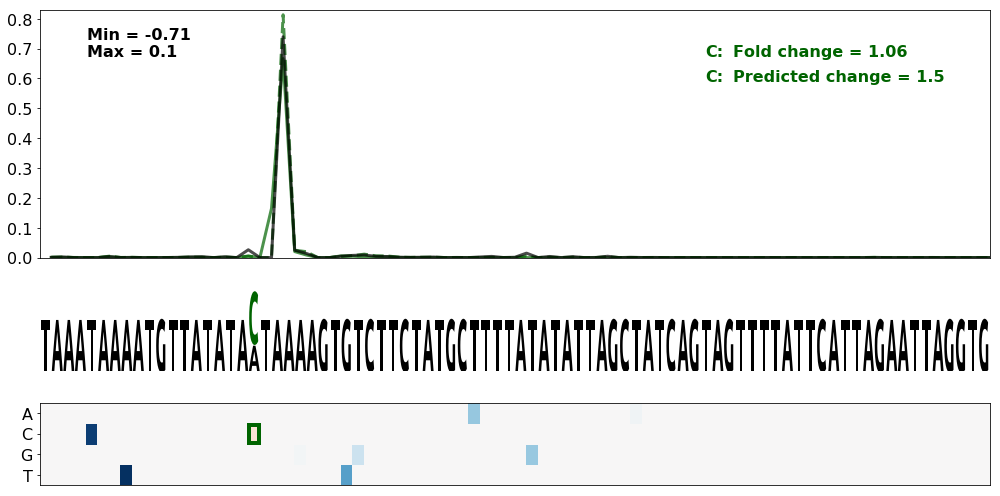

Gene = TGFBR2.2
WT seq = AAAGTCTCAAGCACTTATTTTTATTCTATGCATTGTTTGTCTTTTACATAAATAAAATGTTTATTAGATTGAATAAAGCAAAATACTCAGGTGAGCATCCTGCCTCCTGTTCCCATTCCTAGTAGCTAAATCCATTTGCCTCATTTGGTTATTTTGCAATTTAT
SNV pos = 71
SNV nt = G
0.3889996224907467
0.16334162001593877
0.3889996224907467
0.20960595845826963


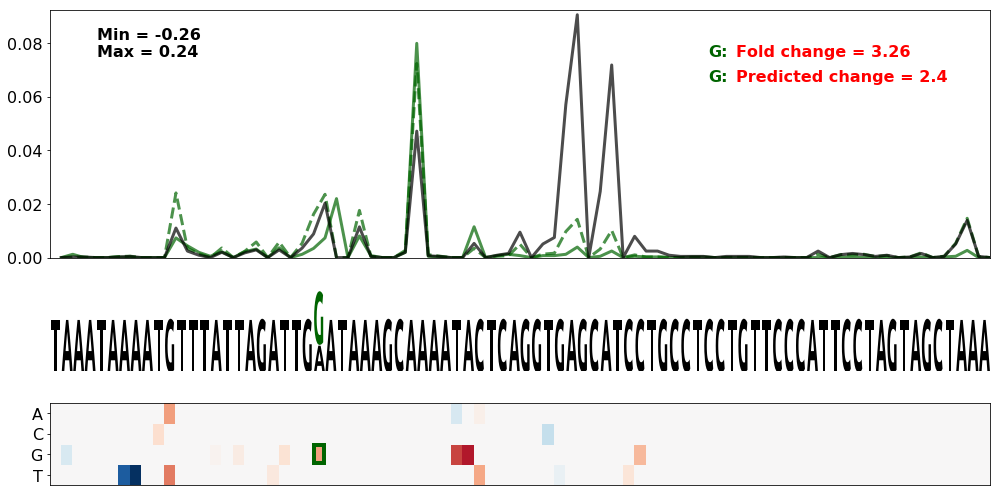

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 110
SNV nt = C
0.7265790766673279
0.8125242921510631
0.7265790766673279
0.853981136867272


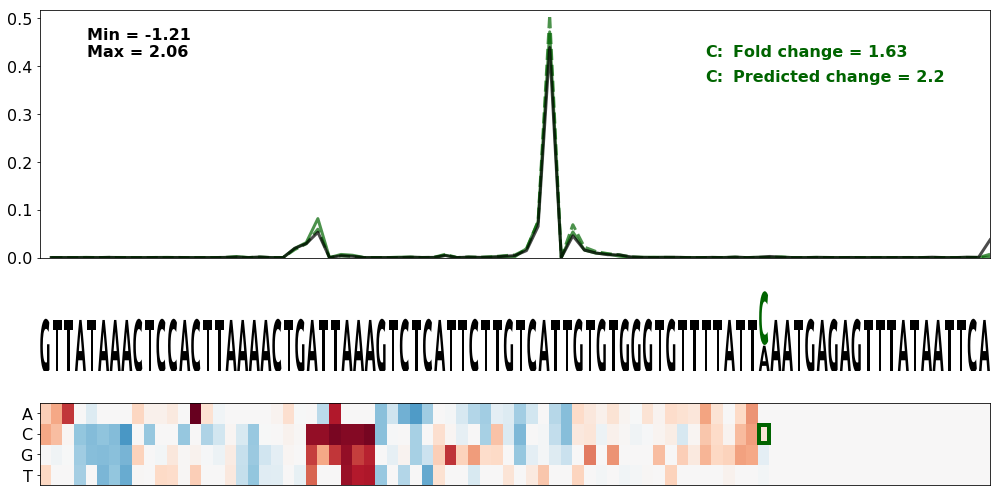

Gene = PKP2.1
WT seq = CTCCAGATAATAAATGTGTGTTCAGAACTTTTTGTGTTTTTTAAGGCATTAATAAAGCCTTCGATAATATTAAATACAAAATGAGACCAAAGTAGTGTTGCTTGCATTGGCGTCTGTGTATATCTGGTTTATTTGTGTATCTTGGAATATATGGTATGATTGAC
SNV pos = 72
SNV nt = T
0.6661357486430284
0.5272741949211339
0.6661357486430284
0.44198839299810166


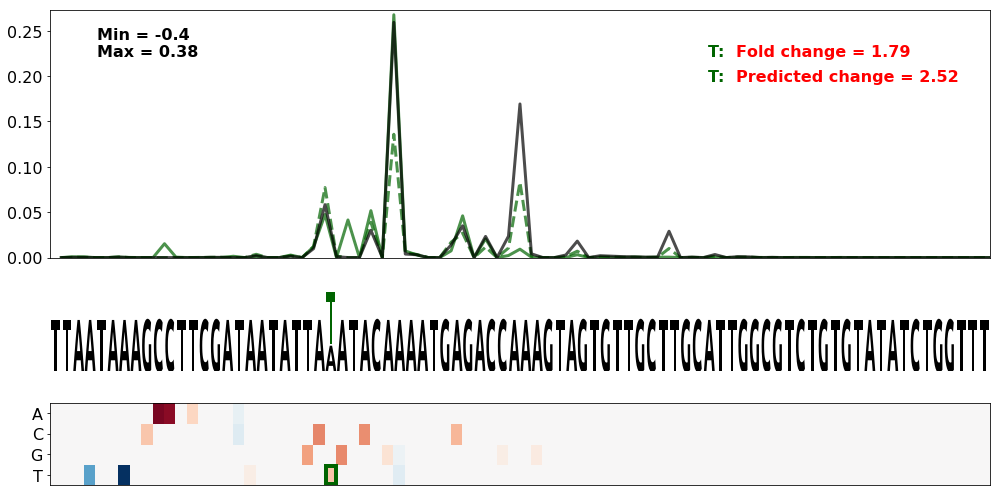

Gene = COL3A1.1
WT seq = TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC
SNV pos = 63
SNV nt = T
0.634486046939955
0.7355524030818915
0.634486046939955
0.7698545995730681


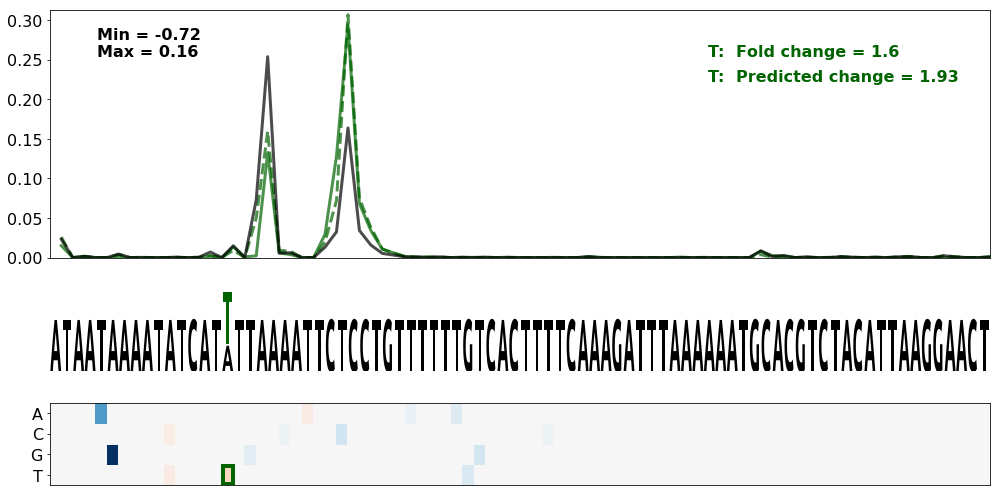

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = A
0.7265790766673279
0.5041824632815048
0.7265790766673279
0.6777648309746702


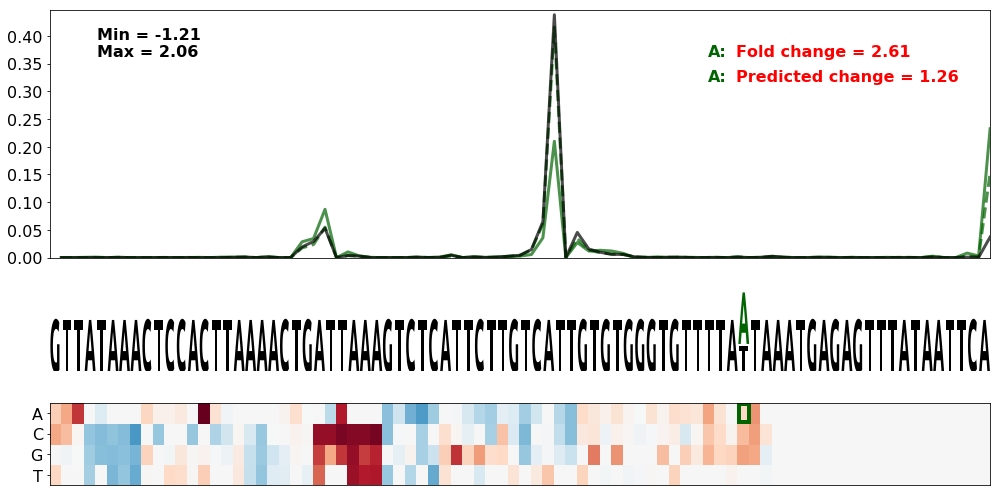

Gene = PKP2.1
WT seq = CTCCAGATAATAAATGTGTGTTCAGAACTTTTTGTGTTTTTTAAGGCATTAATAAAGCCTTCGATAATATTAAATACAAAATGAGACCAAAGTAGTGTTGCTTGCATTGGCGTCTGTGTATATCTGGTTTATTTGTGTATCTTGGAATATATGGTATGATTGAC
SNV pos = 70
SNV nt = G
0.6661357486430284
0.6127929286179767
0.6661357486430284
0.6145426659432175


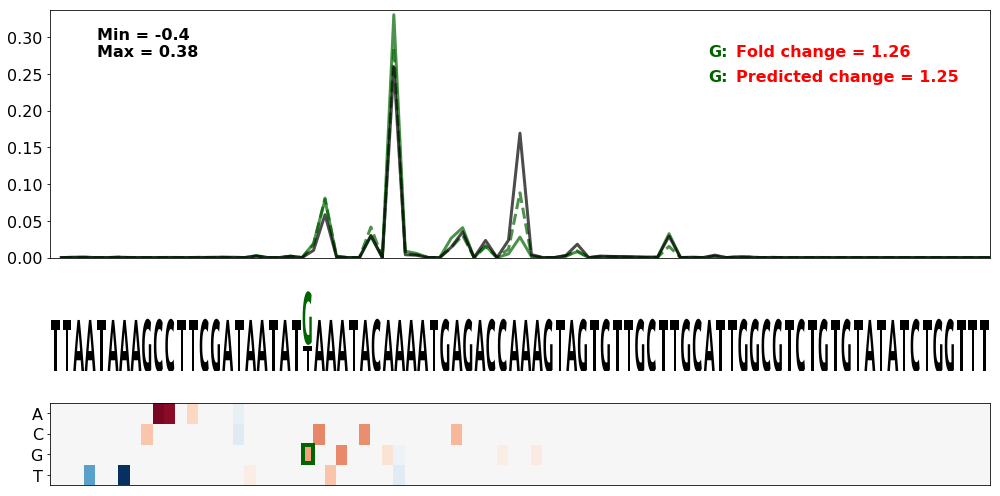

Gene = PKP2.2
WT seq = TTTCCAGAGTTCTGATGATAAGCATTTGGAGTGCATTTATTCCTCCAGATAATAAATGTGTGTTCAGAACTTTTTGTGTTTTTTAAGGCATTAATAAAGCCTTCGATAATATTAAATACAAAATGAGACCAAAGTAGTGTTGCTTGCATTGGCGTCTGTGTATA
SNV pos = 95
SNV nt = C
0.039879233028749565
0.061179434898646474
0.039879233028749565
0.0756924298415672


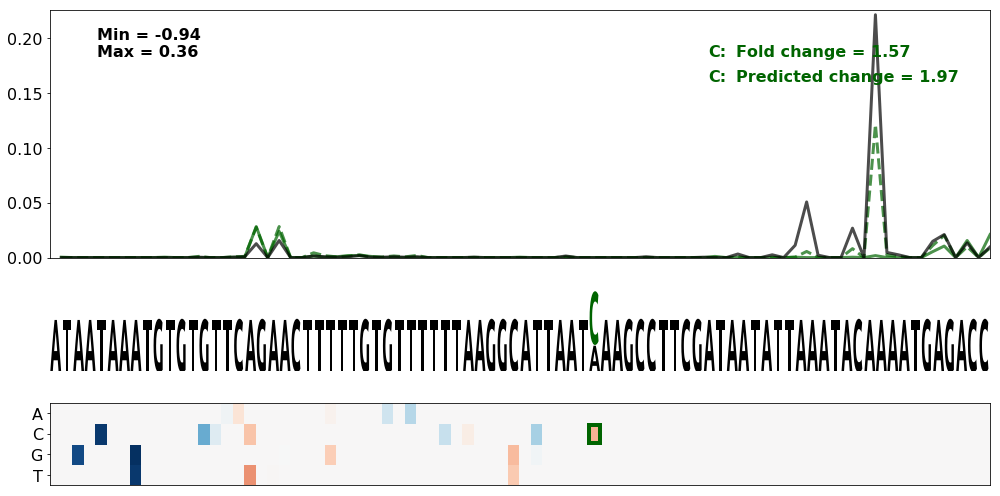

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 107
SNV nt = G
0.7265790766673279
0.6795769768904778
0.7265790766673279
0.756113320178132


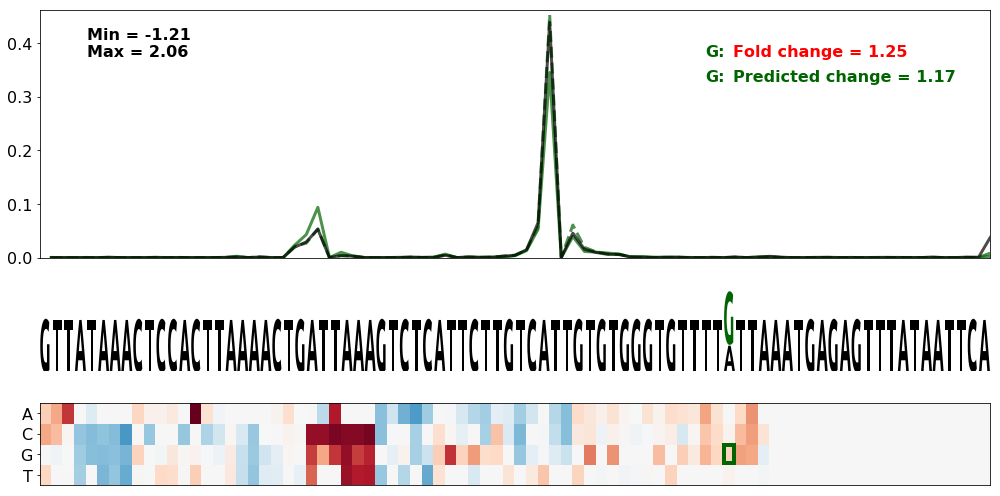

Gene = PKP2.1
WT seq = CTCCAGATAATAAATGTGTGTTCAGAACTTTTTGTGTTTTTTAAGGCATTAATAAAGCCTTCGATAATATTAAATACAAAATGAGACCAAAGTAGTGTTGCTTGCATTGGCGTCTGTGTATATCTGGTTTATTTGTGTATCTTGGAATATATGGTATGATTGAC
SNV pos = 73
SNV nt = G
0.6661357486430284
0.5832873360803911
0.6661357486430284
0.5475004248341624


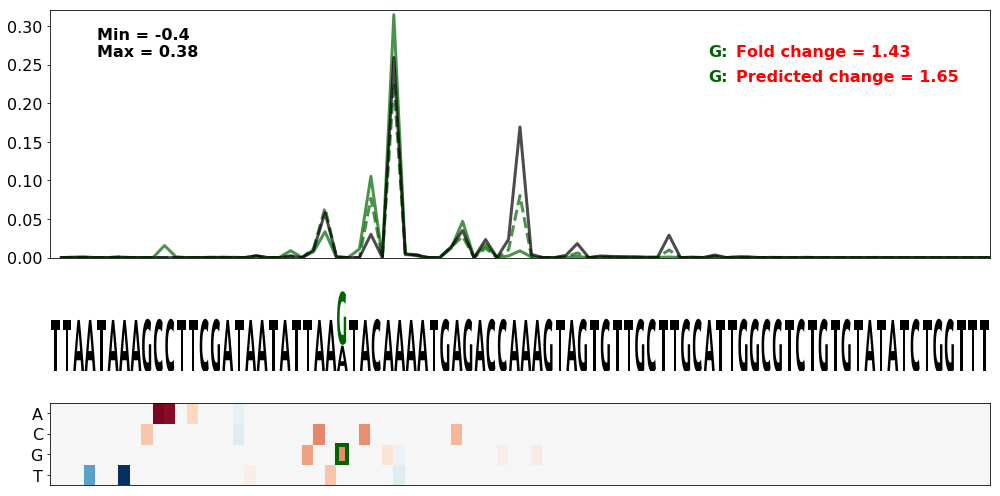

Gene = HBB.2
WT seq = GCCCTGGCCCACAAGTATCACTAAGCTCGCTTTCTTGCTGTCCAATTTCTATTAAAGGTTCCTTTGTTCCCTAAGTCCAACTACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGT
SNV pos = 135
SNV nt = G
0.008452988899264907
0.013171273876555034
0.008452988899264907
0.015052198877613226


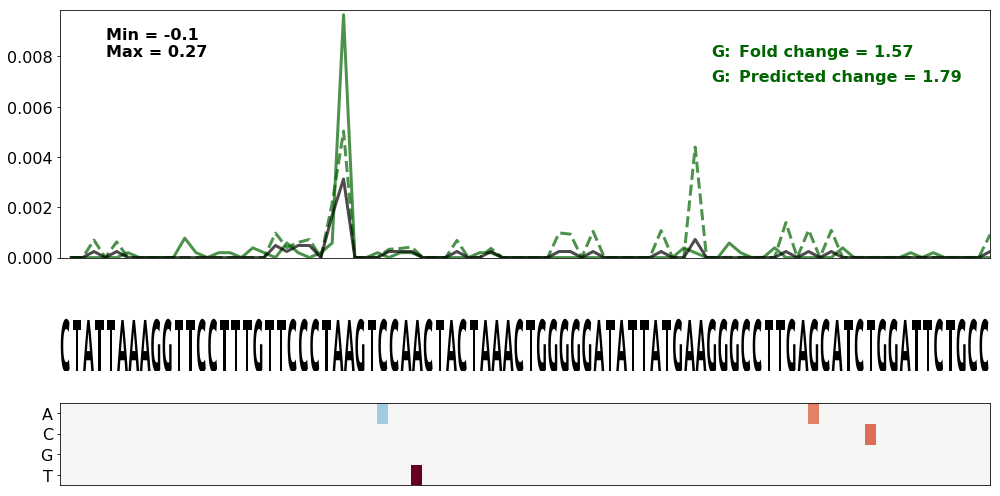

Gene = PKP2.1
WT seq = CTCCAGATAATAAATGTGTGTTCAGAACTTTTTGTGTTTTTTAAGGCATTAATAAAGCCTTCGATAATATTAAATACAAAATGAGACCAAAGTAGTGTTGCTTGCATTGGCGTCTGTGTATATCTGGTTTATTTGTGTATCTTGGAATATATGGTATGATTGAC
SNV pos = 71
SNV nt = C
0.6661357486430284
0.6085783670200976
0.6661357486430284
0.5475244987571641


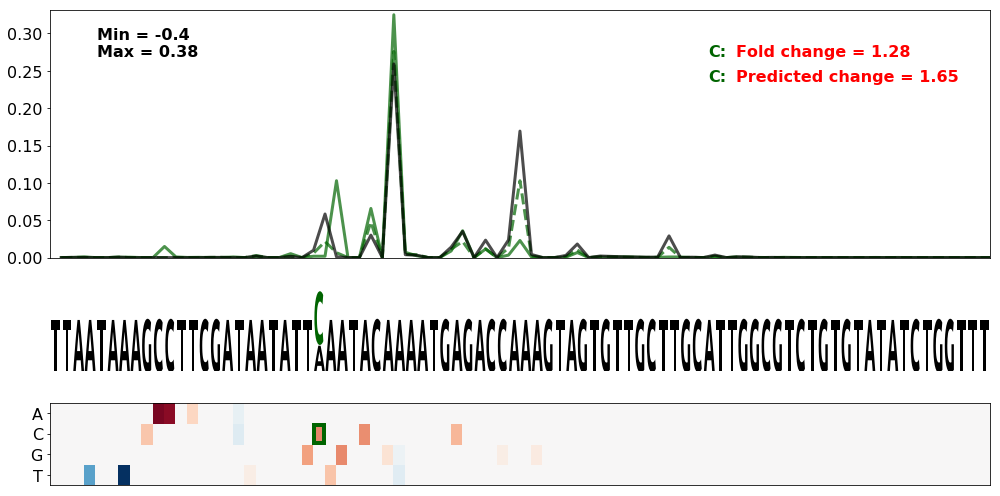

Gene = LDLR.1
WT seq = TGTATGTATGAGTGGCTTCTGGGAGATGGGTGTCACTTTTTAAACCACTGTATAGAAGGTTTTTGTAGCCTGAATGTCTTACTGTGATCAATTAAATTTCTTAAATGAACCAATTTGTCTAAACTCGATGCACGTTCTTCTGTTCGCGCGCTTCTTTTTGTTTT
SNV pos = 95
SNV nt = T
0.0013220413755840516
0.0016320709028367873
0.0013220413755840516
0.005313490209212724


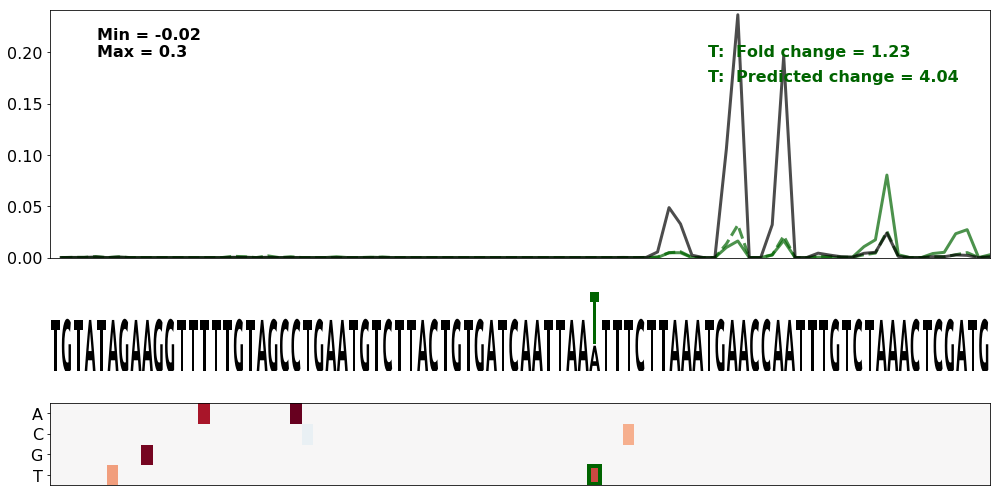

Gene = SPTLC1.2
WT seq = GCTTGAGGTATTTTGTACATATGTGCCTTGTGATTGCTGCTGCTTTAAAGGATAAAGTACTCTTTGGGGGATGAGTCTGGTTTGTTTTGTTTTATTTTTTAATGAAATAAACCTATATTCCTGATTATTAGTCTATTTGCATATGTAATATATCCAACAGAATA
SNV pos = 107
SNV nt = G
0.023132547103617576
0.04468971494779875
0.023132547103617576
0.03394704324174004


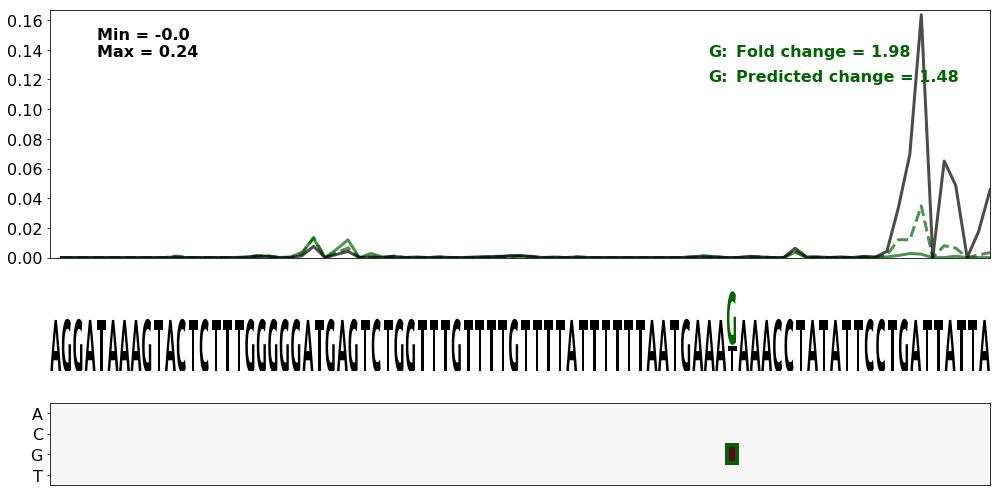

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = C
0.7265790766673279
0.7341633489242849
0.7265790766673279
0.662519453920672


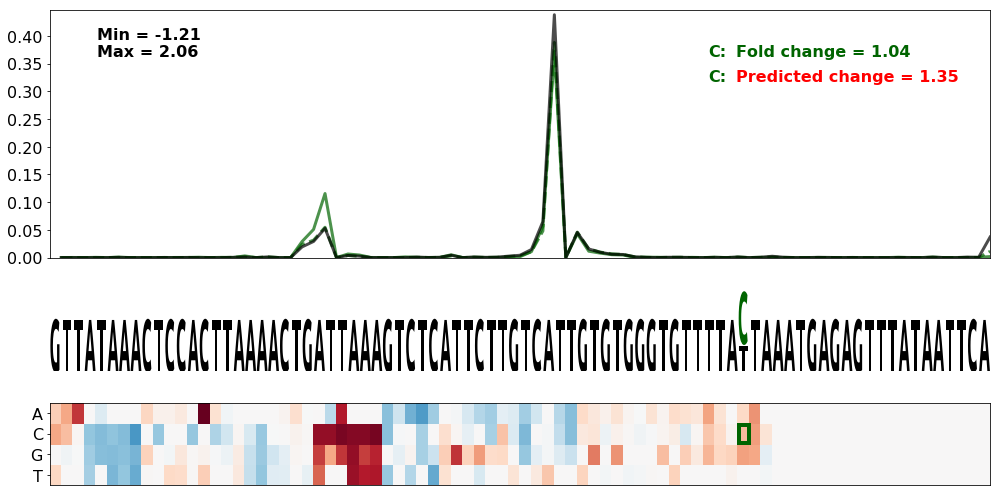

Gene = HBB.2
WT seq = GCCCTGGCCCACAAGTATCACTAAGCTCGCTTTCTTGCTGTCCAATTTCTATTAAAGGTTCCTTTGTTCCCTAAGTCCAACTACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGT
SNV pos = 134
SNV nt = G
0.008452988899264907
0.017298054865457275
0.008452988899264907
0.014503518572974177


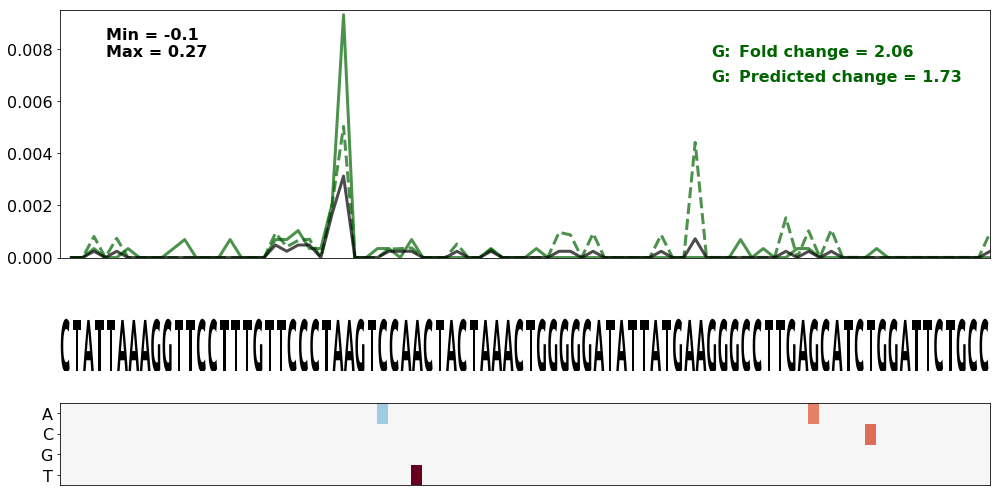

Gene = HBB.2
WT seq = GCCCTGGCCCACAAGTATCACTAAGCTCGCTTTCTTGCTGTCCAATTTCTATTAAAGGTTCCTTTGTTCCCTAAGTCCAACTACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGT
SNV pos = 133
SNV nt = C
0.008452988899264907
0.01786329845054395
0.008452988899264907
0.01502770034382639


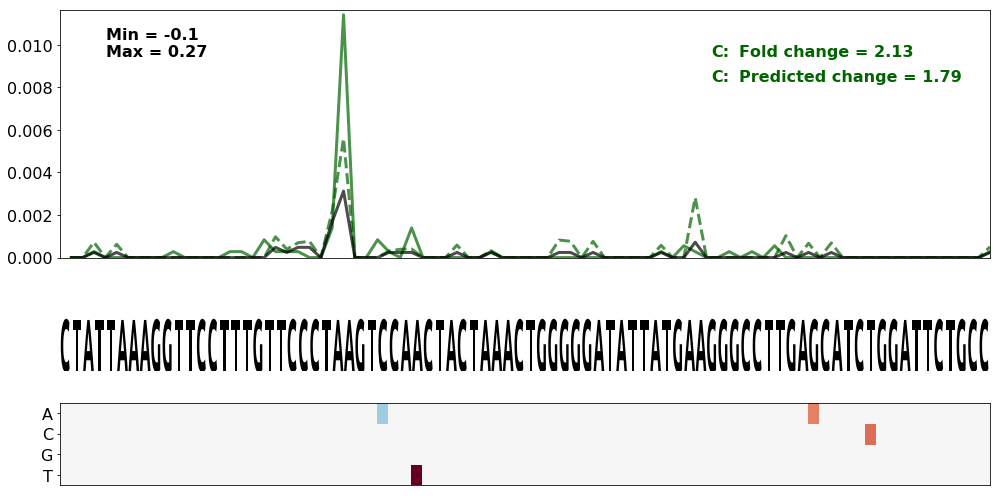

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 72
SNV nt = G
0.7265790766673279
0.5872292815209966
0.7265790766673279
0.6324741797928322


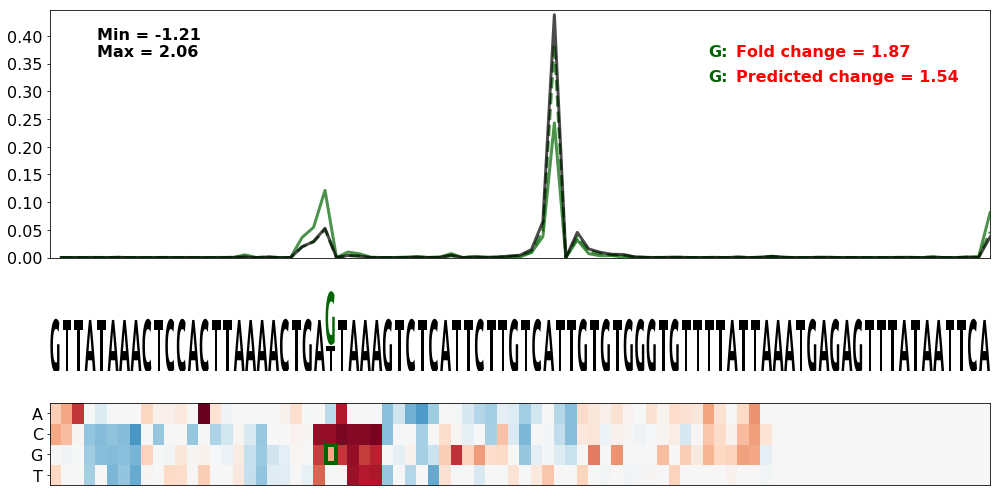

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 109
SNV nt = G
0.7265790766673279
0.5882995889164921
0.7265790766673279
0.6860997546445459


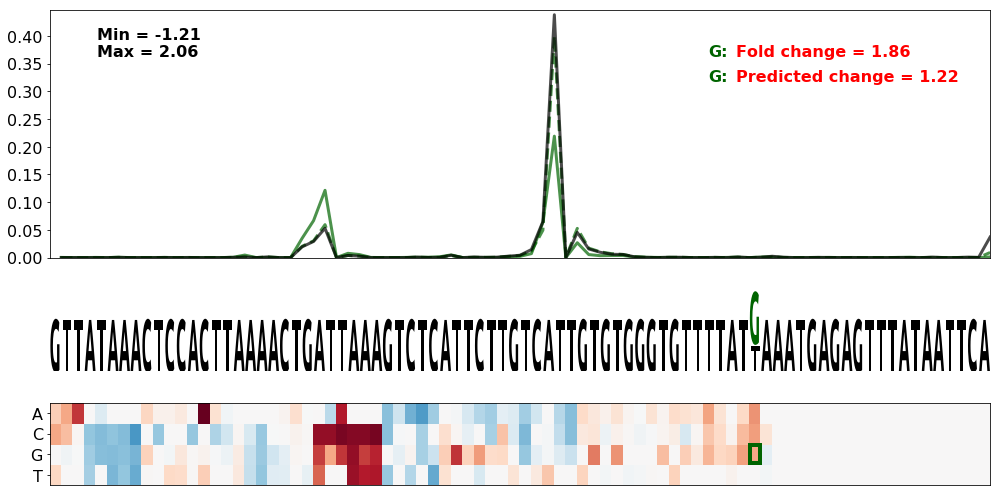

Gene = HBB.2
WT seq = GCCCTGGCCCACAAGTATCACTAAGCTCGCTTTCTTGCTGTCCAATTTCTATTAAAGGTTCCTTTGTTCCCTAAGTCCAACTACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGT
SNV pos = 136
SNV nt = G
0.008452988899264907
0.018981101301683012
0.008452988899264907
0.01585275914778034


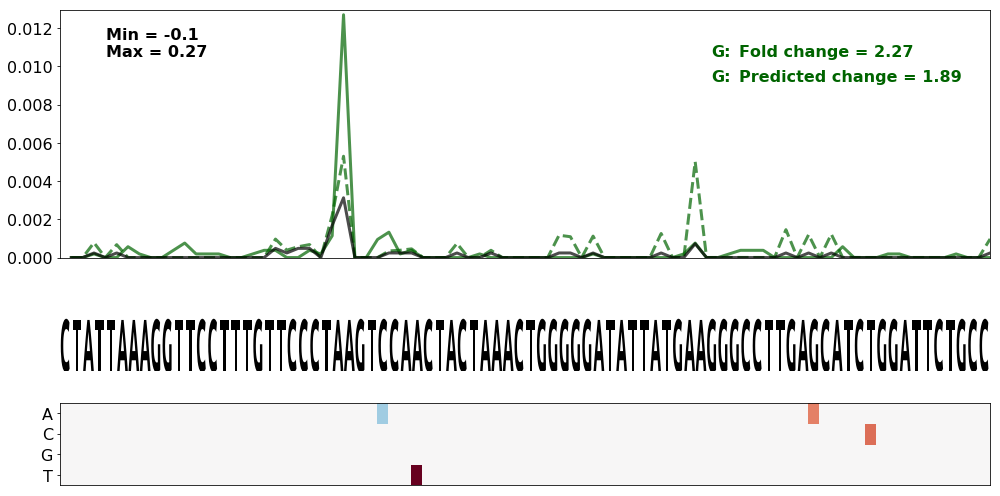

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = G
0.7265790766673279
0.606891086060286
0.7265790766673279
0.6658227718250462


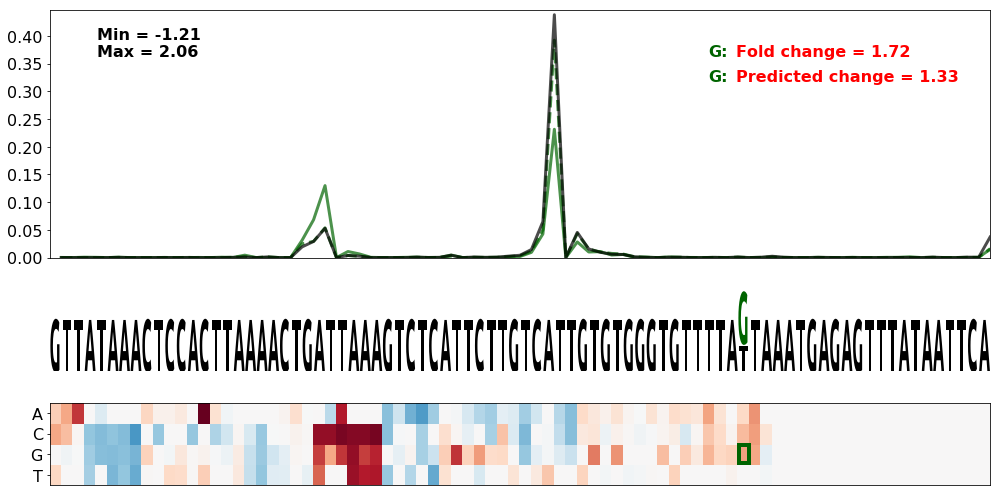

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 109
SNV nt = C
0.7265790766673279
0.663724085599551
0.7265790766673279
0.6866055674118974


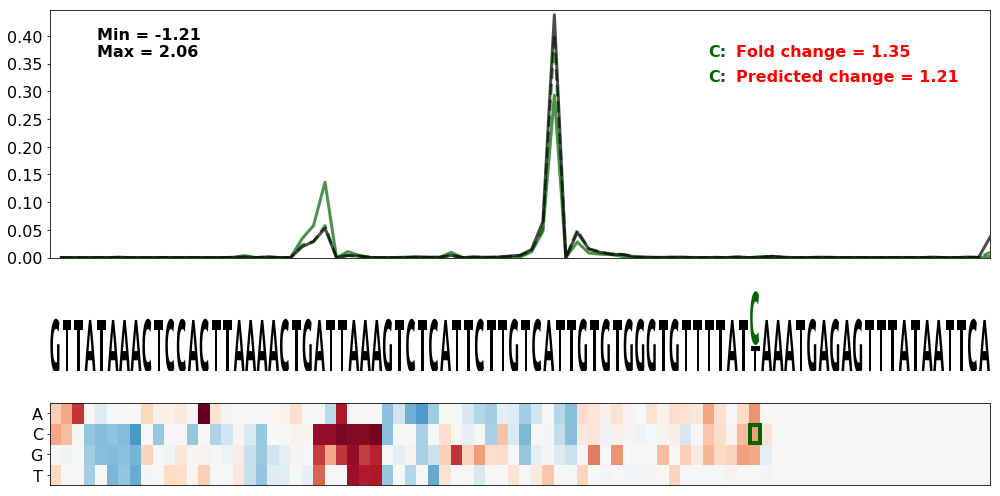

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 109
SNV nt = A
0.7265790766673279
0.6409514845933418
0.7265790766673279
0.683944841111288


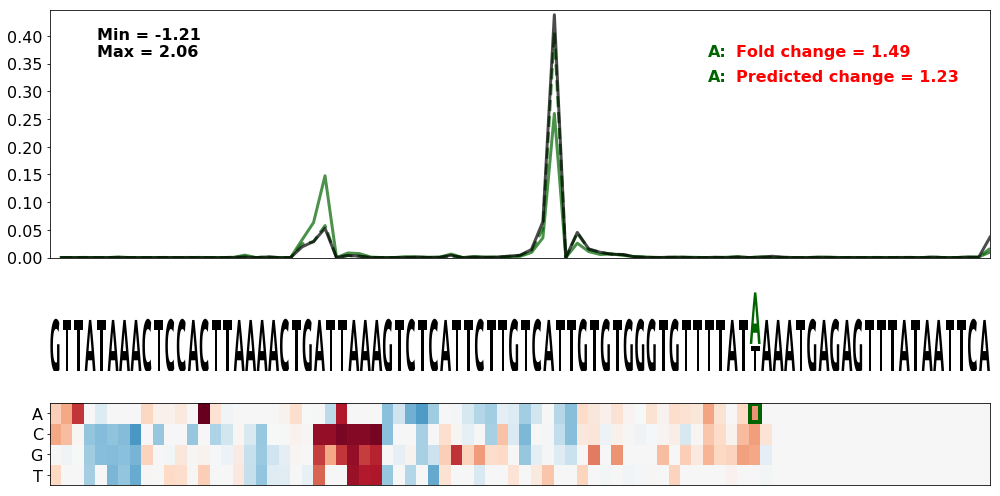

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 71
SNV nt = T
0.7265790766673279
0.3452688692624635
0.7265790766673279
0.6762555090320038


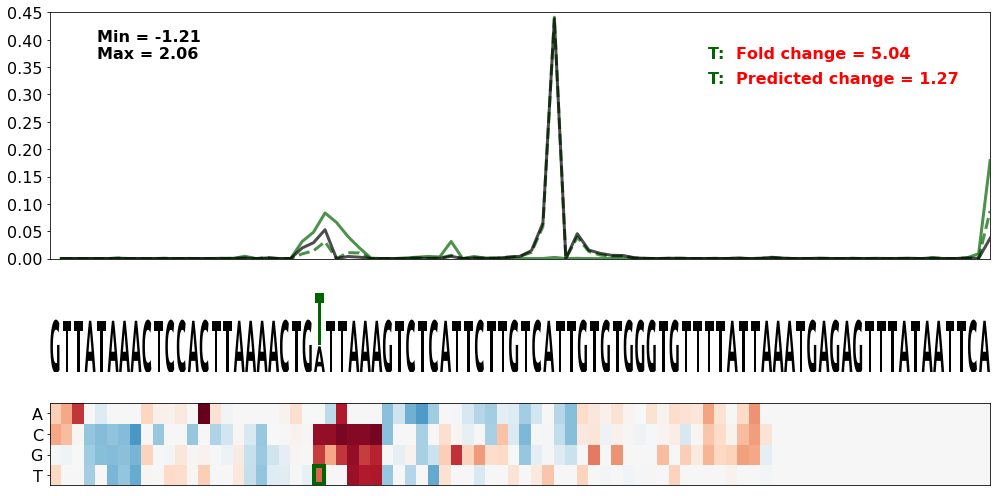

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 75
SNV nt = G
0.7265790766673279
0.4072969013800693
0.7265790766673279
0.5270650681694029


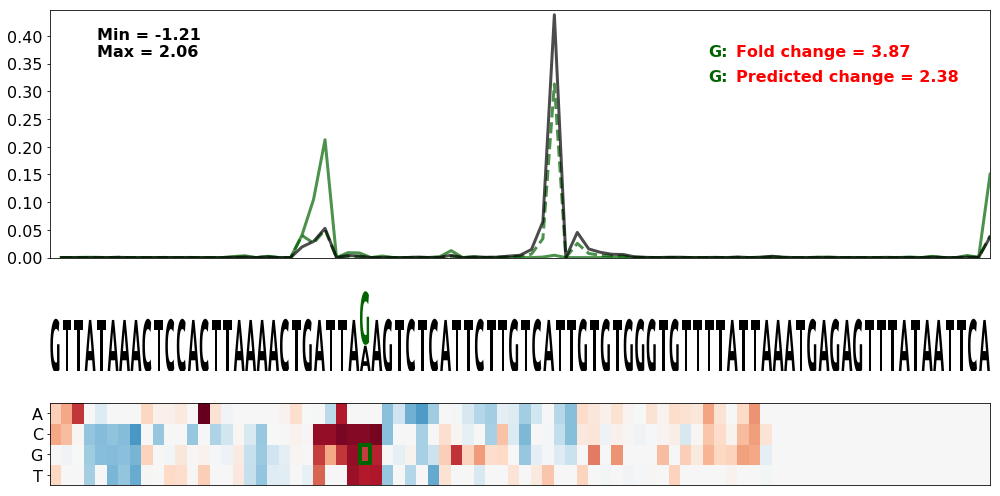

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 71
SNV nt = G
0.7265790766673279
0.4144263095278845
0.7265790766673279
0.6679901760420917


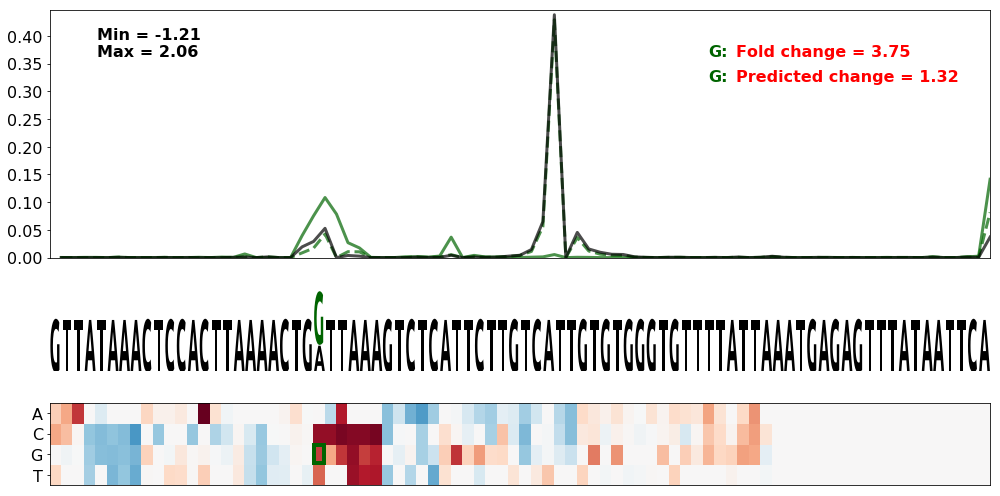

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 73
SNV nt = G
0.7265790766673279
0.41641783127080423
0.7265790766673279
0.498248575768575


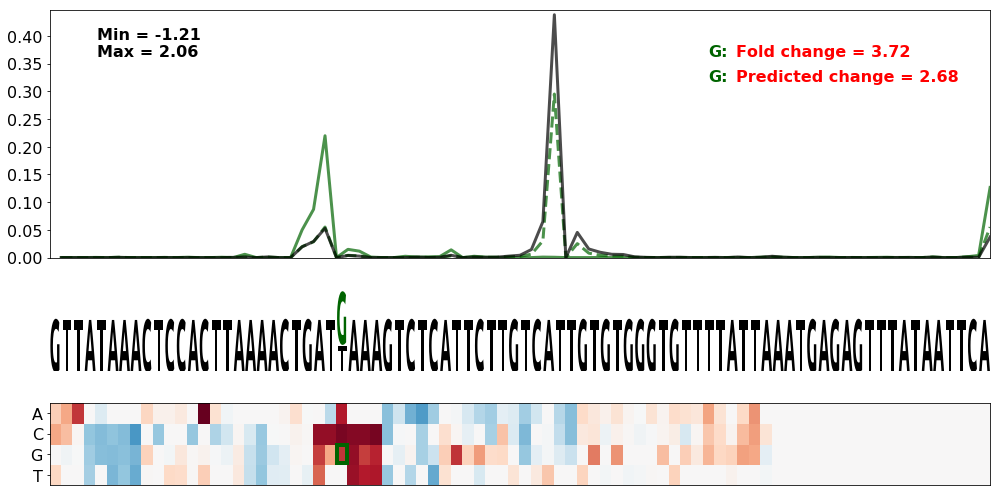

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 76
SNV nt = G
0.7265790766673279
0.45013809472510624
0.7265790766673279
0.48969638066440646


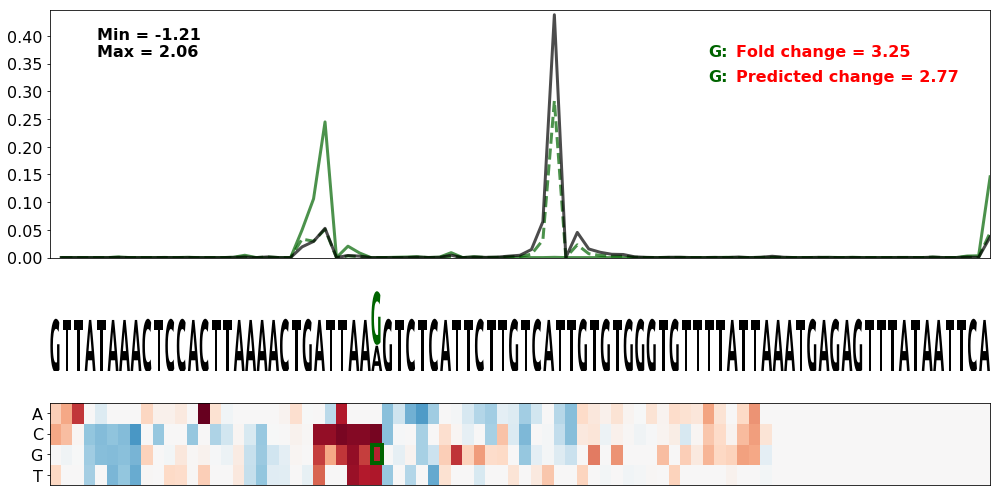

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 75
SNV nt = T
0.7265790766673279
0.46802695134182926
0.7265790766673279
0.5713460943042612


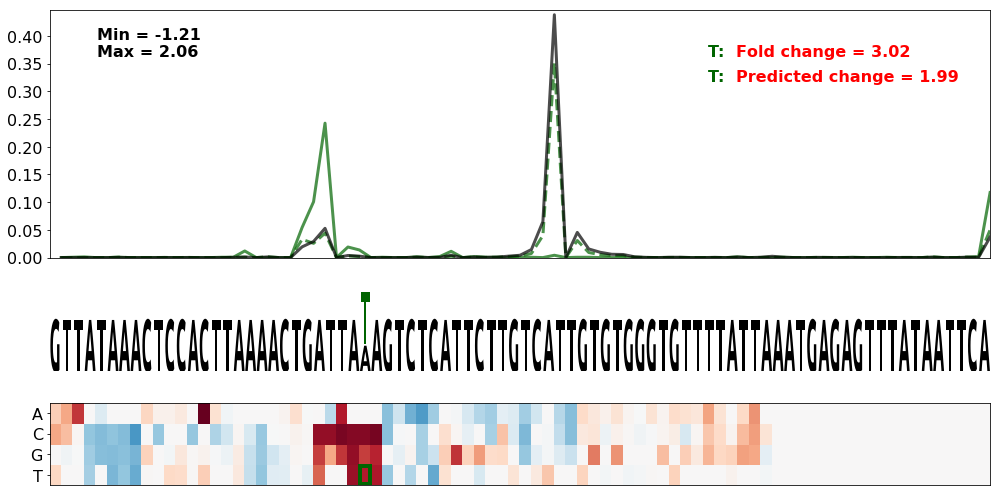

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 73
SNV nt = A
0.7265790766673279
0.6148390906362657
0.7265790766673279
0.5892785900931968


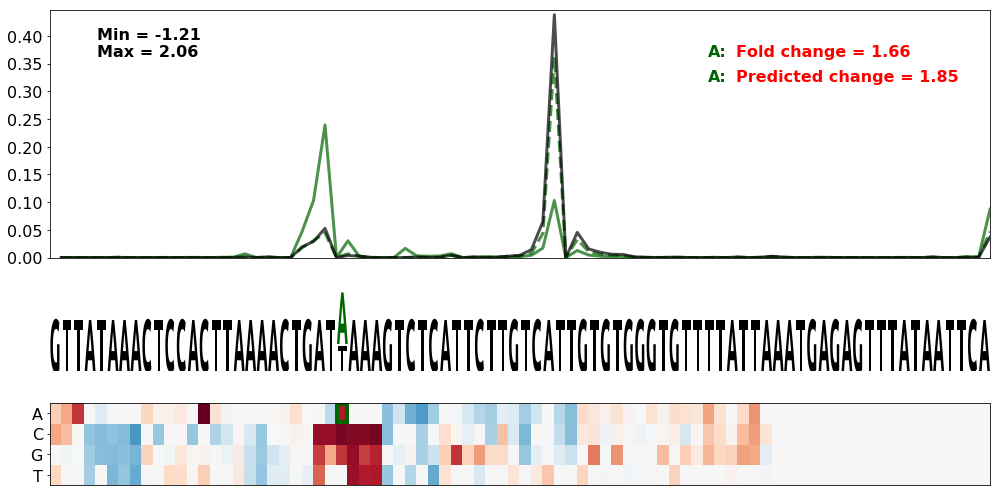

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 76
SNV nt = T
0.7265790766673279
0.4690120052532496
0.7265790766673279
0.4695728457127851


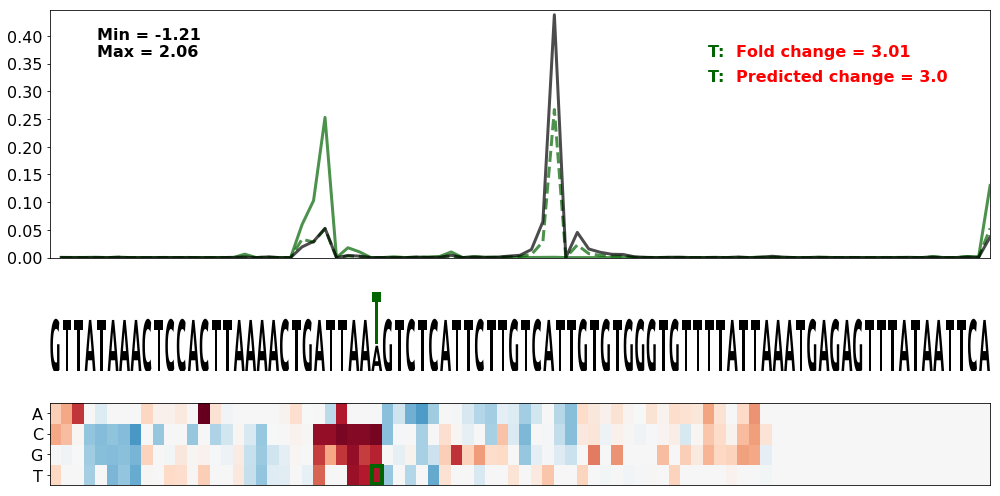

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 74
SNV nt = T
0.7265790766673279
0.5034738634064252
0.7265790766673279
0.5899216806140558


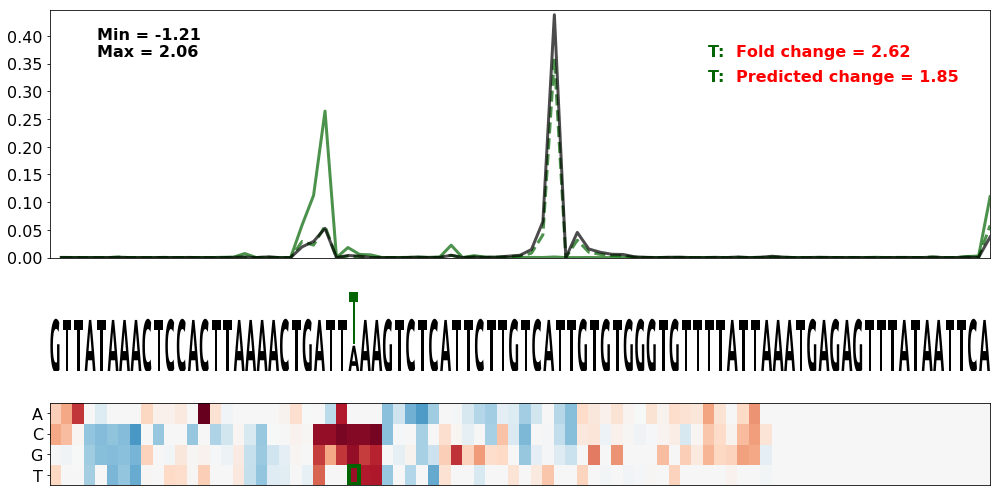

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 74
SNV nt = G
0.7265790766673279
0.5087638740700976
0.7265790766673279
0.5974318984670935


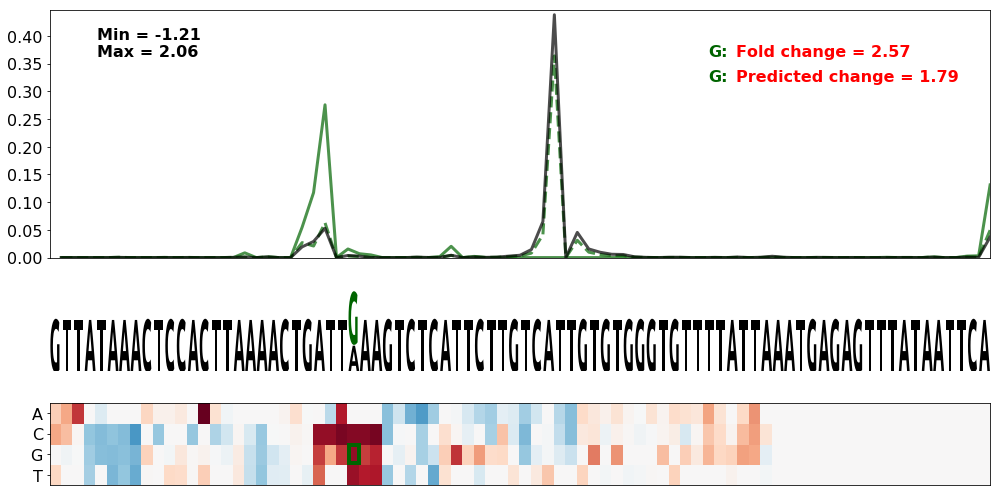

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 72
SNV nt = C
0.7265790766673279
0.5430033094556285
0.7265790766673279
0.5654435032150452


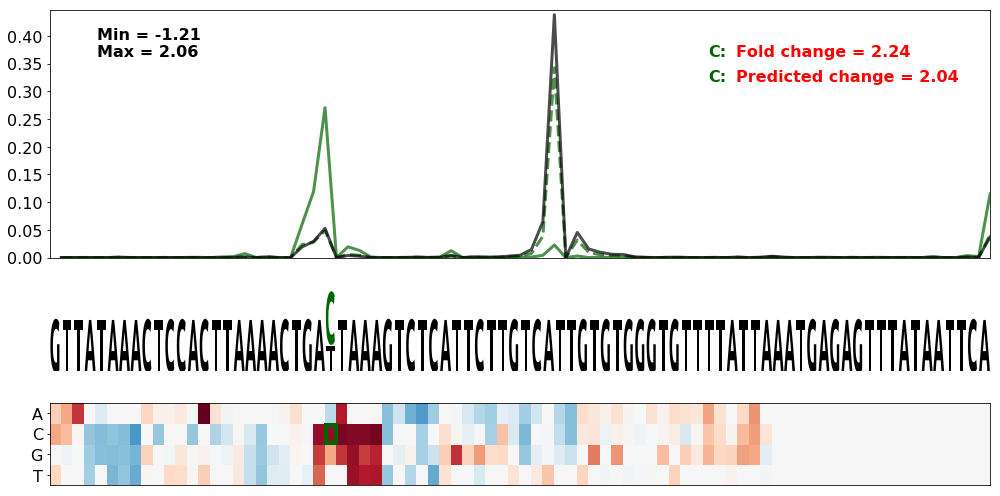

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 71
SNV nt = C
0.7265790766673279
0.5175890868613526
0.7265790766673279
0.6326030379293566


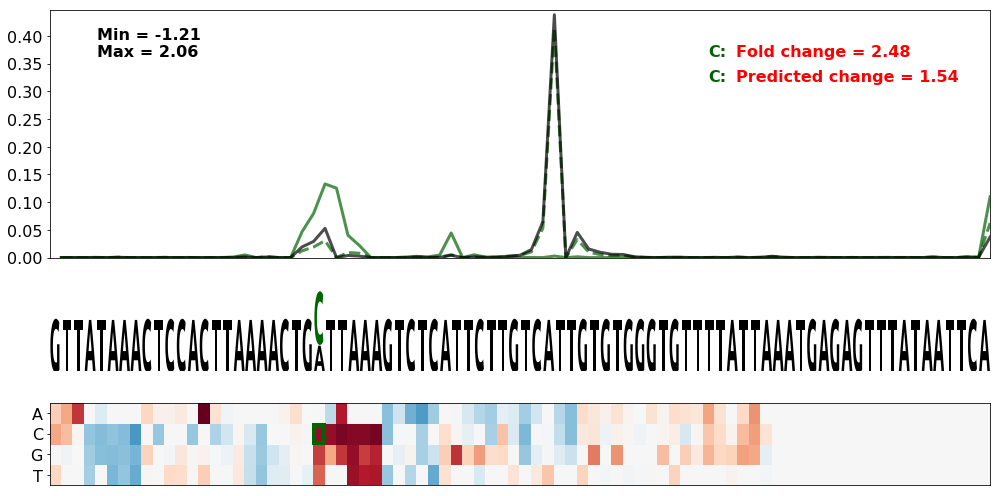

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 75
SNV nt = C
0.7265790766673279
0.5470813783974507
0.7265790766673279
0.4783801617010155


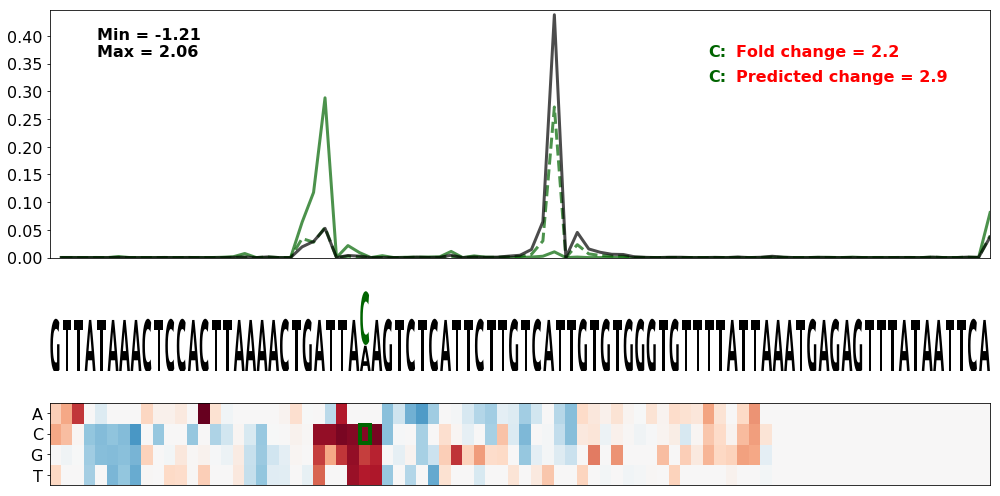

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 74
SNV nt = C
0.7265790766673279
0.5342790605730362
0.7265790766673279
0.5447136720803526


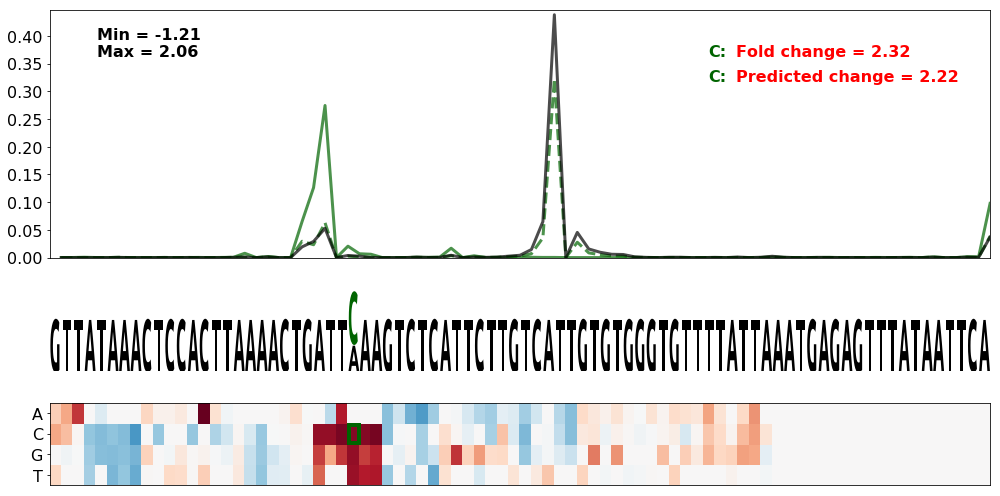

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 73
SNV nt = C
0.7265790766673279
0.5663107895659256
0.7265790766673279
0.4654816335649856


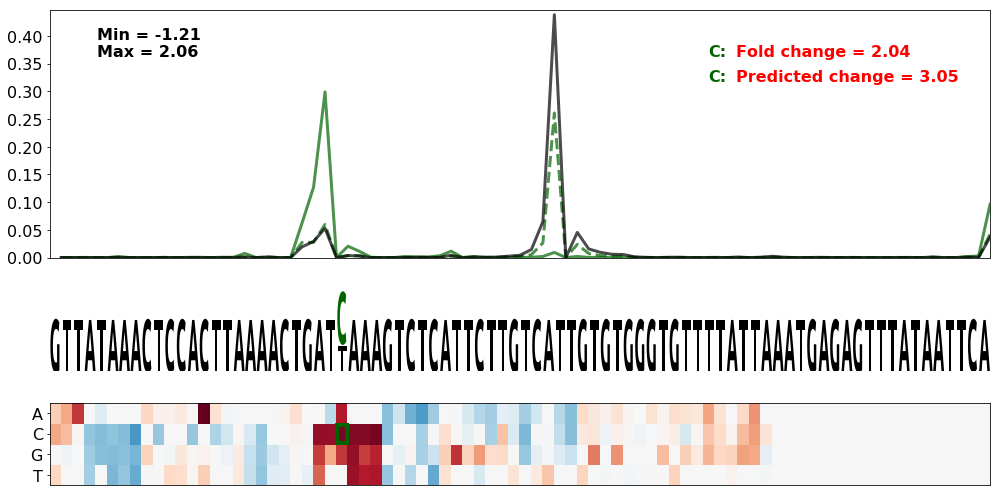

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 76
SNV nt = C
0.7265790766673279
0.5545097632444447
0.7265790766673279
0.4344871432367856


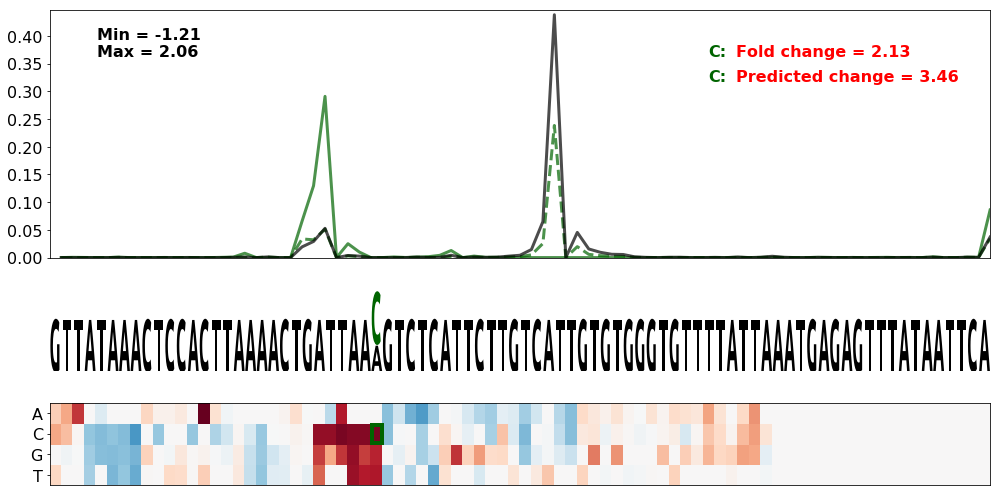

In [220]:

df_sel = loss_of_motif_df.query("snv_pos >= 57").sort_values(by='delta_logodds_true')
#and delta_logodds_true < 0.0

seq_start = 48
seq_end = 130#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Loss of canonical competing CSE:
Gene = COL3A1.1
WT seq = TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC
SNV pos = 68
SNV nt = C
ClinVar id = Missing
Observed:


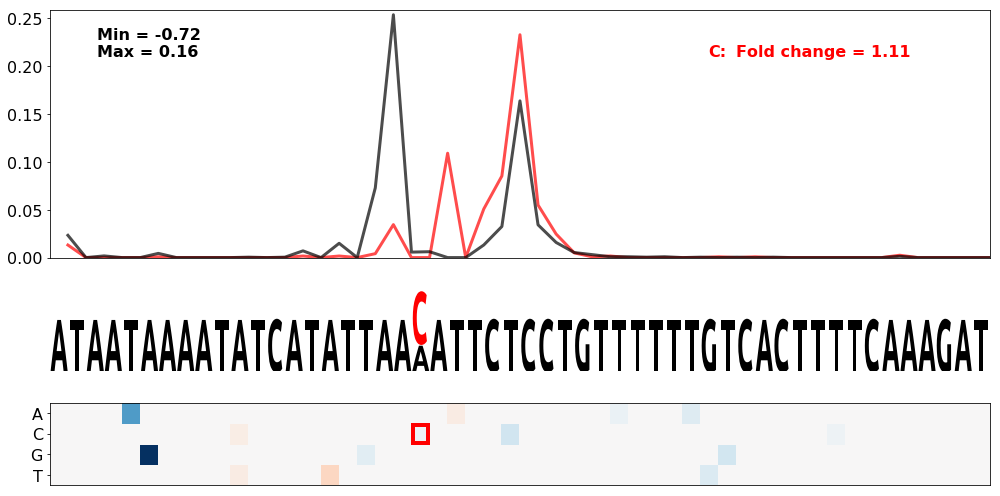

Predicted:


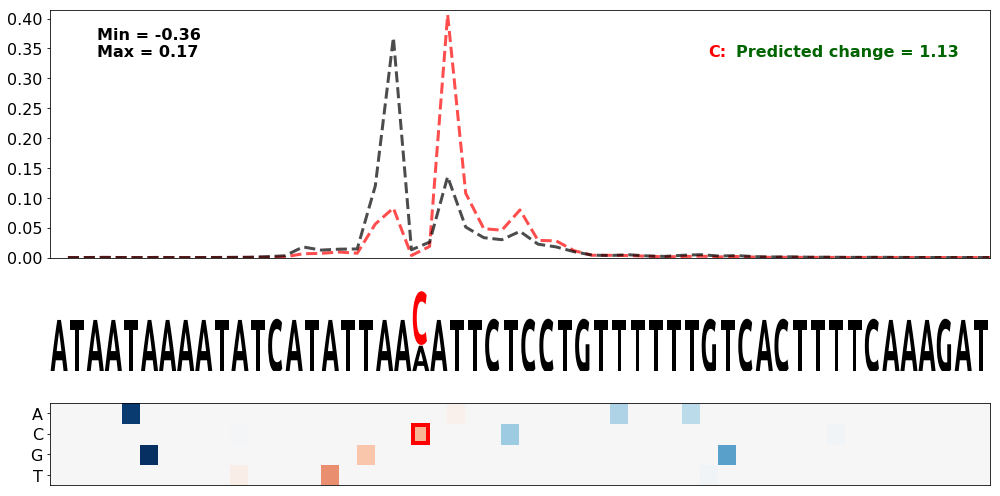

Both:


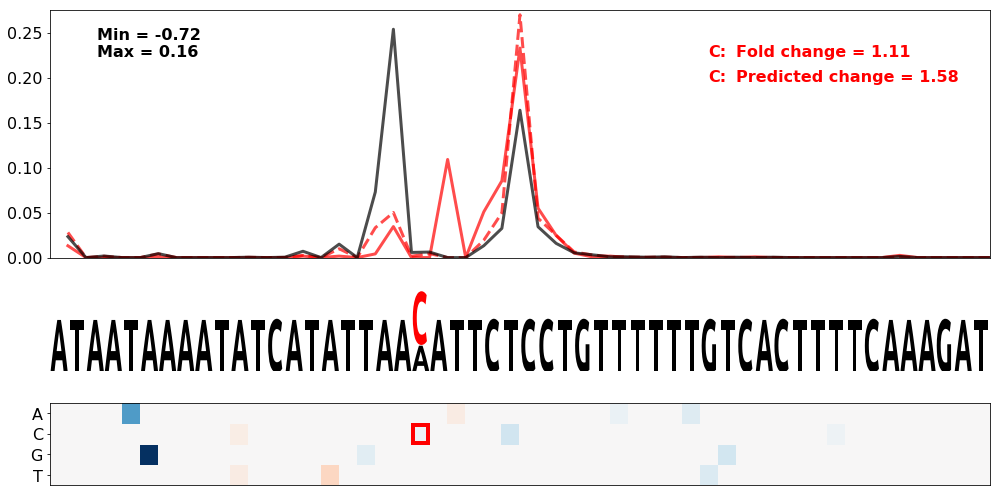

Gene = PTEN.12
WT seq = TTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGGGCAGCCAAATGTGAATACAAA
SNV pos = 87
SNV nt = G
ClinVar id = Missing
Observed:


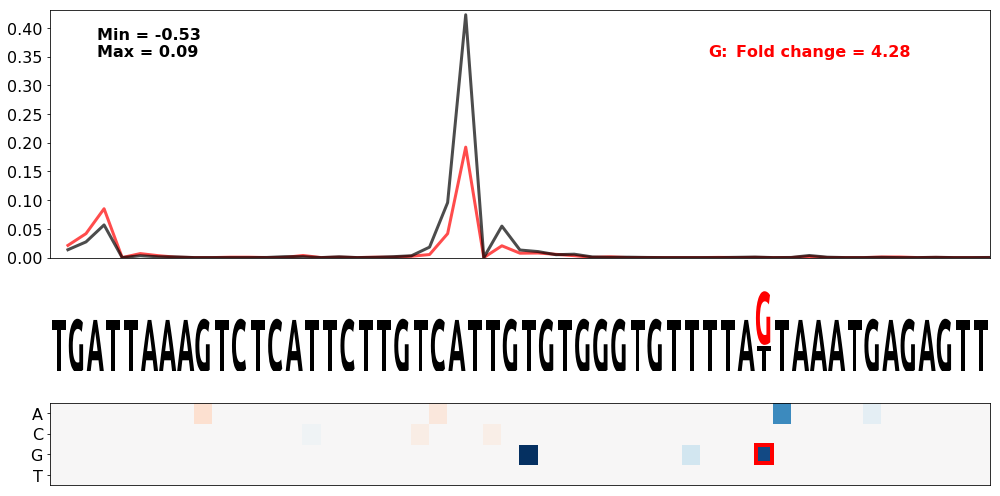

Predicted:


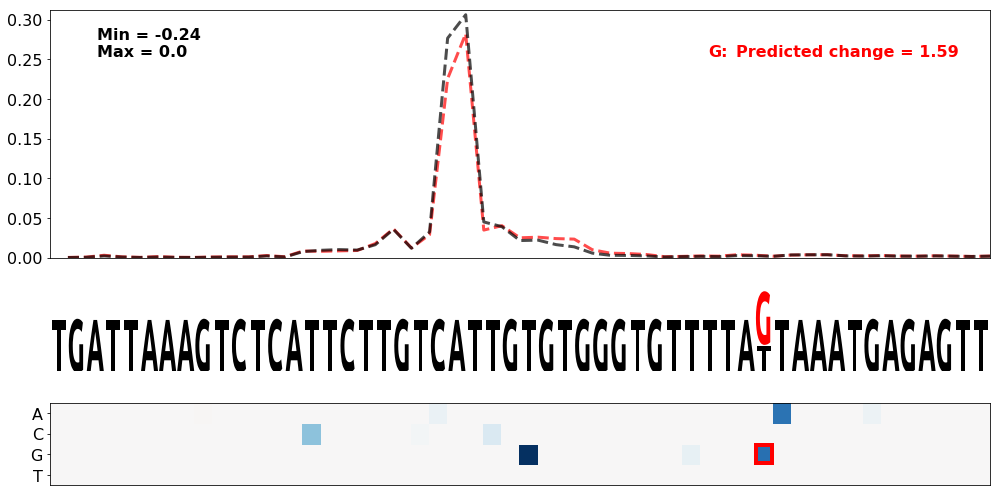

Both:


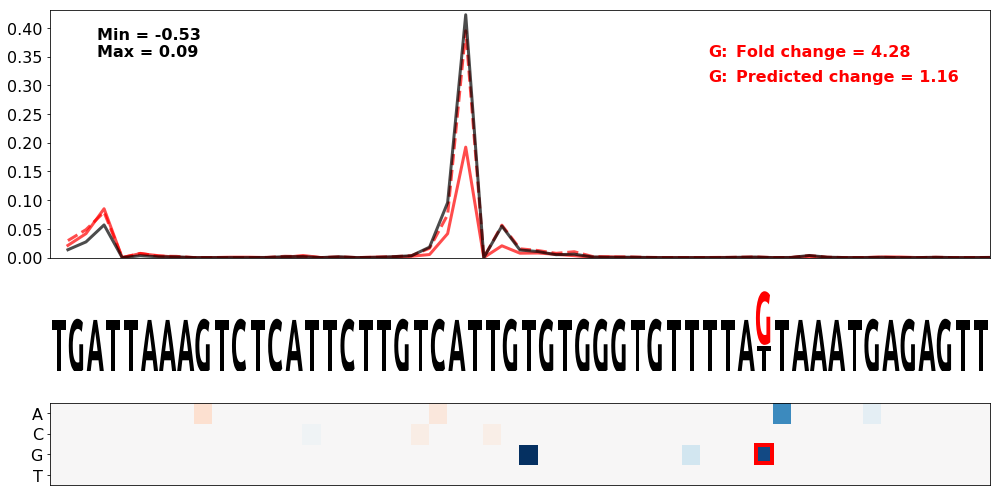

Gene = COL3A1.1
WT seq = TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC
SNV pos = 63
SNV nt = T
ClinVar id = Missing
Observed:


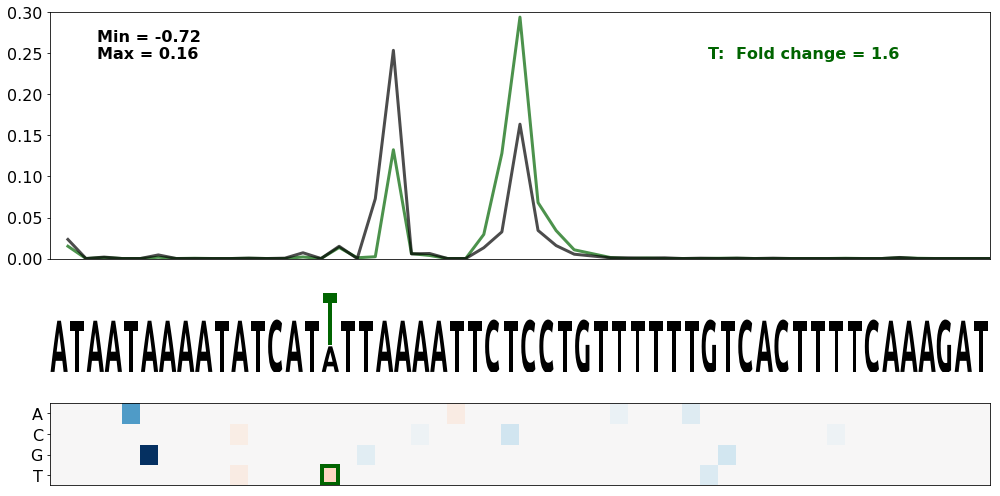

Predicted:


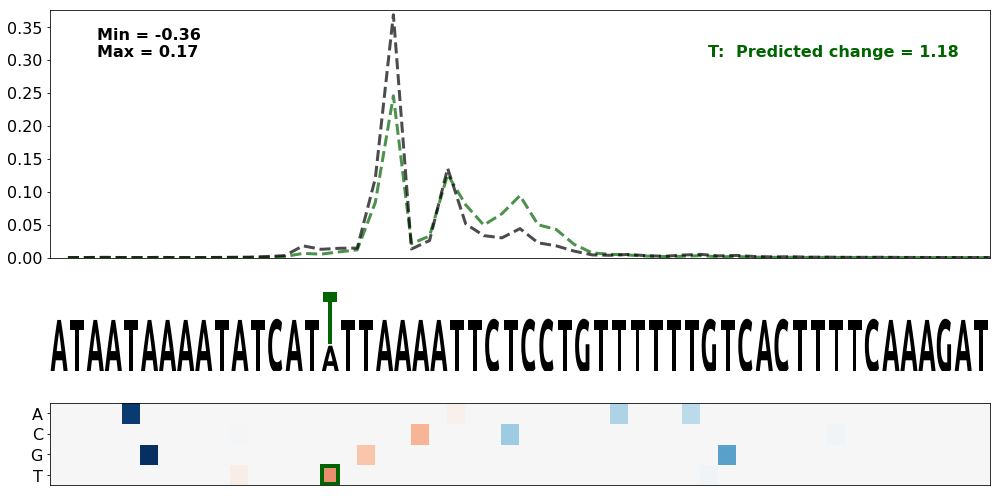

Both:


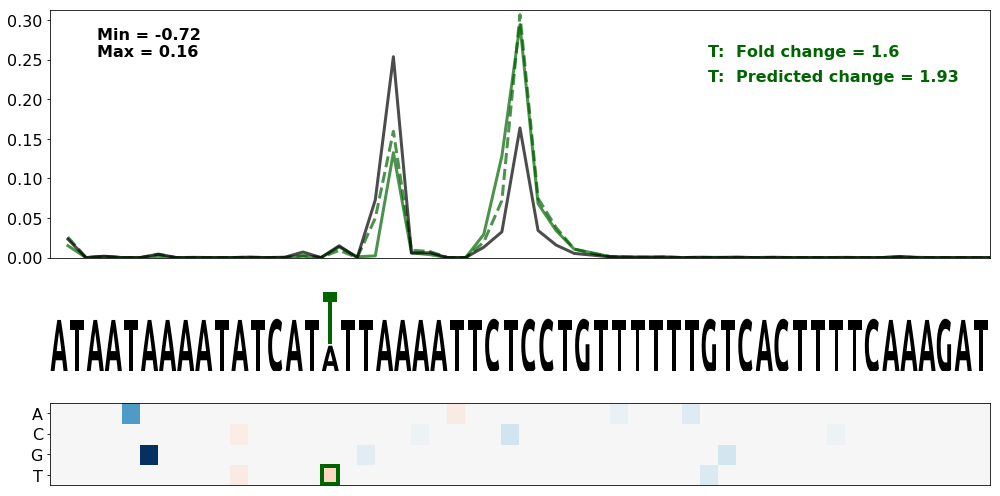

In [187]:
print('Loss of canonical competing CSE:')

experiment_name = 'loss_of_cse'

gene_names = [
    'COL3A1.1',
    'PTEN.12',
    'COL3A1.1',
    
    'TMEM43.3',
    'TMEM43.3'
]

snv_list = [
    [(68, 'C', 'red')],
    [(87, 'G', 'red')],
    [(63, 'T', 'darkgreen')],
    
    [(66, 'G', 'red')],
    [(69, 'C', 'red')]
]

wt_seq_list = [
    'TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC',
    'TTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGGGCAGCCAAATGTGAATACAAA',
    'TGTAAGCTTGTATGTGGTTGTTGATCTTTTTTTTCCTTACAGACACCCATAATAAAATATCATATTAAAATTCTCCTGTTTTTTGTCACTTTTCAAAGATTTAAAAAATGCACGTCTACATTAAGGAACTCCAGTAATCTTGAAAAAGTATATTGAATTCTAAC',
    
    'AAAATTTGAAAGCTTTGGAAAACCAAATTTGTAATATCATTGTATTTTTTATTAAAAGTTTTGTAATAAATTTCTAAATTATCTTCTGGTGTGGGACTTTAACAAACATCCTATTTTTAGTTTCAGATTTTTTTTTTTTGGCATTCTTTCCAAAATGTCTGTAA',
    'AAAATTTGAAAGCTTTGGAAAACCAAATTTGTAATATCATTGTATTTTTTATTAAAAGTTTTGTAATAAATTTCTAAATTATCTTCTGGTGTGGGACTTTAACAAACATCCTATTTTTAGTTTCAGATTTTTTTTTTTTGGCATTCTTTCCAAAATGTCTGTAA'
]

seq_start = 48
seq_end = 100

save_figs = False

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

Gain of canonical competing CSE:
Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = T
ClinVar id = Missing
Observed:


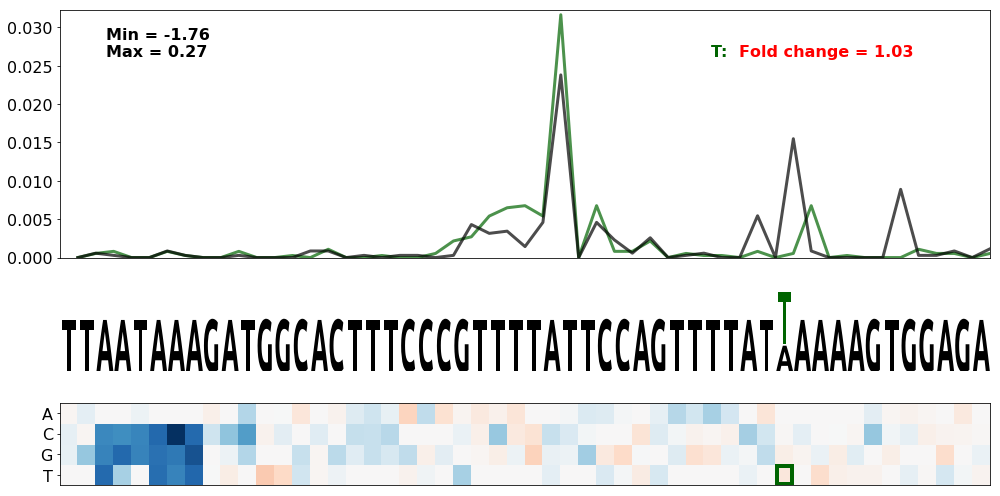

Predicted:


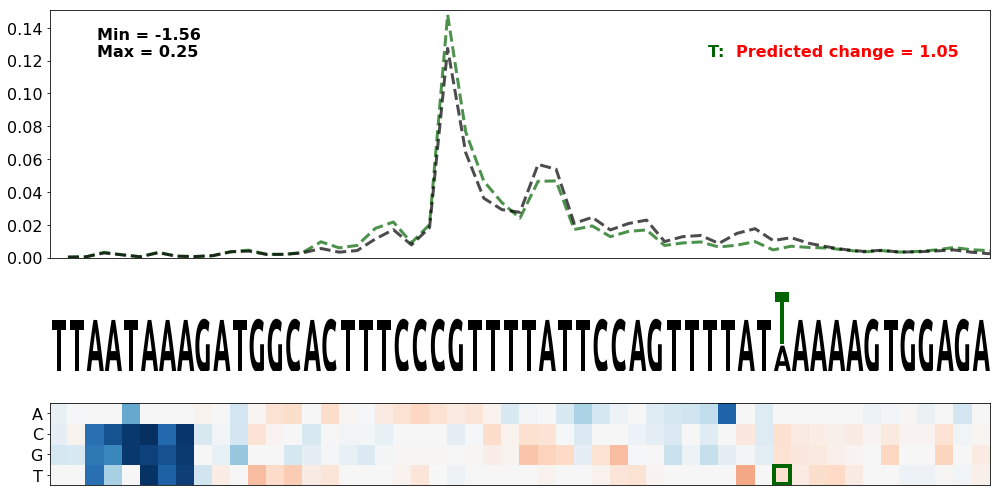

Both:


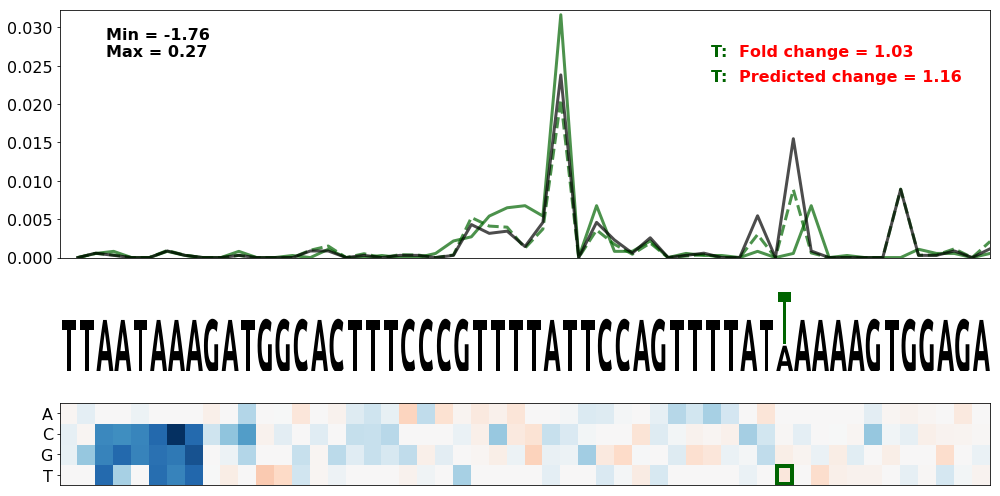

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 75
SNV nt = T
ClinVar id = Missing
Observed:


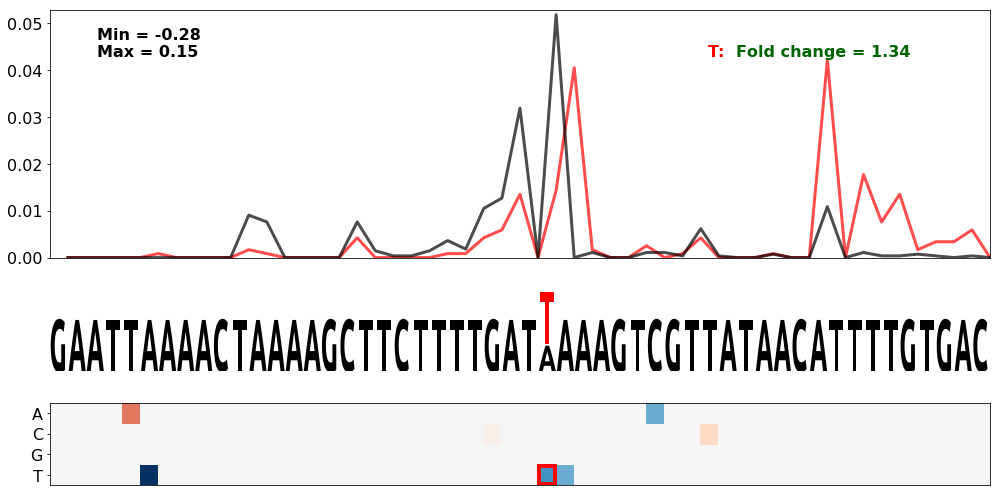

Predicted:


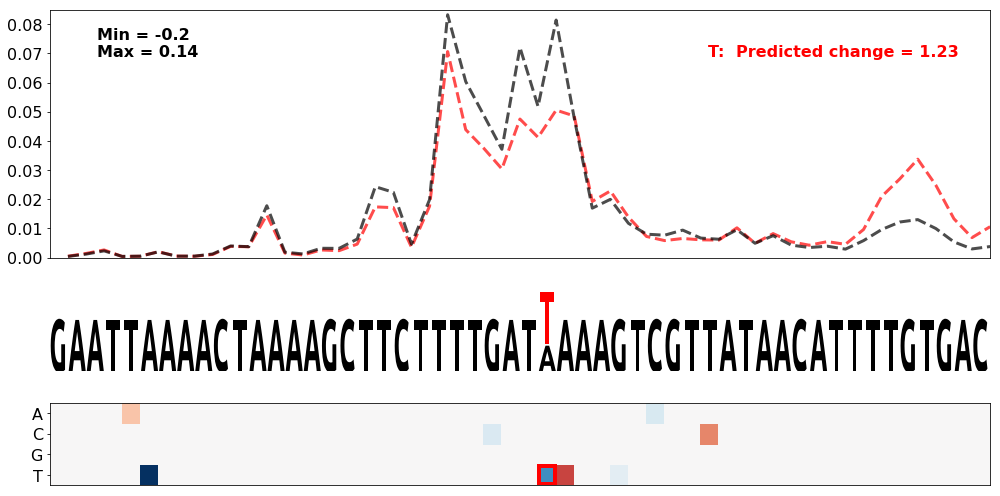

Both:


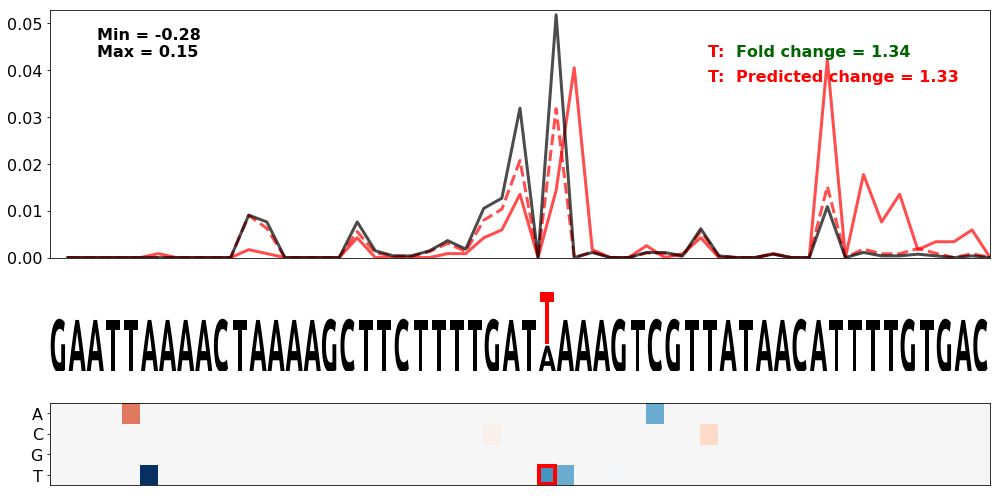

In [23]:
print('Gain of canonical competing CSE:')

experiment_name = 'gain_of_cse'

gene_names = [
    'PTEN.15',
    'SMAD4.1'
]

snv_list = [
    [(88, 'T', 'darkgreen')],
    [(75, 'T', 'red')]
]

wt_seq_list = [
    'ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA',
    'AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT'
]

seq_start = 48
seq_end = 100

save_figs = True

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

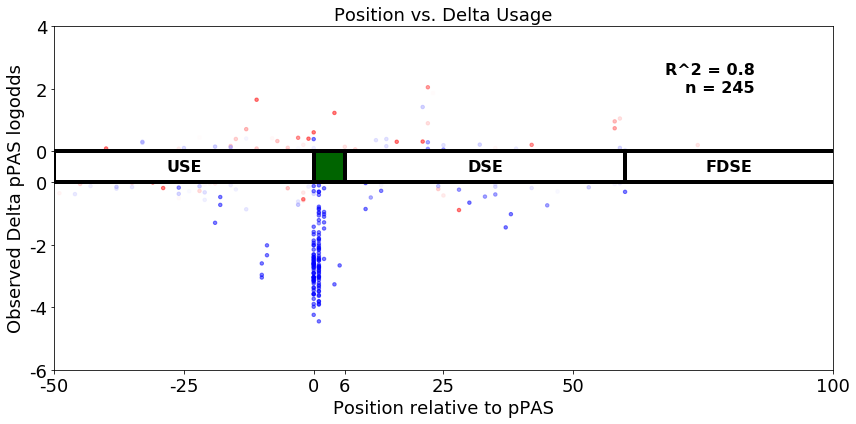

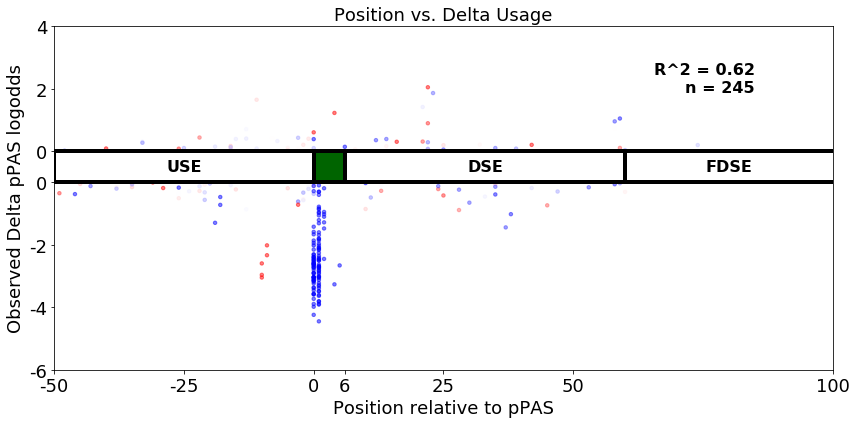


# Gain of ['TATAAA', 'GATAAA', 'CATAAA', 'ACTAAA', 'AGTAAA'] = 245
# Neural net / Observation agreement = 204
# Neural net / 6-mer model agreement = 209
## Gain of motif in USE = 67
### Gain of motif, Loss of function = 42
### Gain of motif, Gain of function = 25
### Neural net / 6-mer model agreement = 47
## Gain of motif in DSE = 50
### Gain of motif, Loss of function = 24
### Gain of motif, Gain of function = 26
### Neural net / 6-mer model agreement = 35


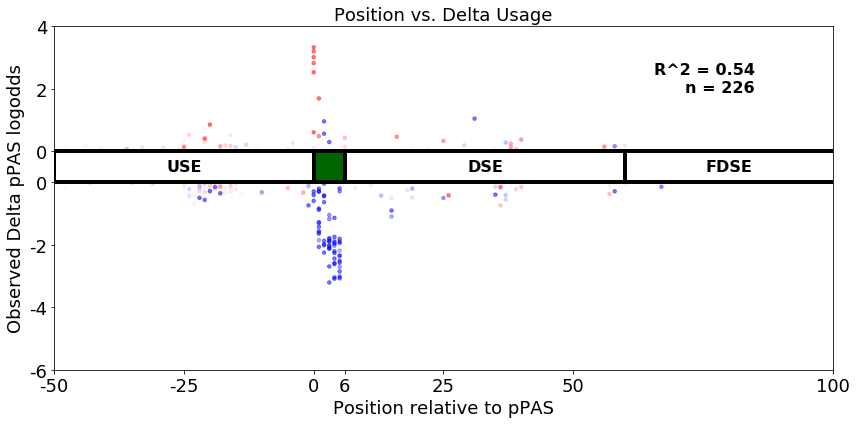

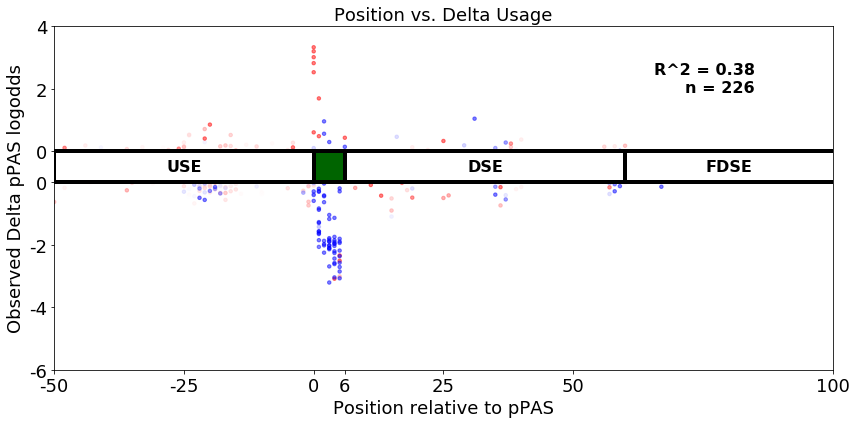


# Loss of ['TATAAA', 'GATAAA', 'CATAAA', 'ACTAAA', 'AGTAAA'] = 226
# Neural net / Observation agreement = 167
# Neural net / 6-mer model agreement = 172
## Loss of motif in USE = 96
### Loss of motif, Loss of function = 67
### Loss of motif, Gain of function = 29
### Neural net / 6-mer model agreement = 64
## Loss of motif in DSE = 49
### Loss of motif, Loss of function = 29
### Loss of motif, Gain of function = 20
### Neural net / 6-mer model agreement = 32


In [24]:
#Gain/Loss of de novo cryptic PAS (CSE Hexamer)

motifs = ['TATAAA', 'GATAAA', 'CATAAA', 'ACTAAA', 'AGTAAA']

gain_of_motif_index = []
loss_of_motif_index = []

save_figs = True

for motif in motifs :
    i = 0
    for _, row in df_var.iterrows() :

        snv_pos = row['snv_pos']

        var_seq = row['master_seq']
        ref_seq = row['wt_seq']

        motif_len = len(motif)

        var_motif_dict = {}
        ref_motif_dict = {}
        for offset in range(-motif_len + 1, motif_len - 1) :

            var_motif = var_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(var_motif) == motif_len :
                if var_motif not in var_motif_dict :
                    var_motif_dict[var_motif] = 0
                var_motif_dict[var_motif] += 1

            ref_motif = ref_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(ref_motif) == motif_len :
                if ref_motif not in ref_motif_dict :
                    ref_motif_dict[ref_motif] = 0
                ref_motif_dict[ref_motif] += 1

        if motif in var_motif_dict and motif not in ref_motif_dict :
            gain_of_motif_index.append(i)
        elif motif not in var_motif_dict and motif in ref_motif_dict :
            loss_of_motif_index.append(i)

        i += 1



gain_of_motif_df = df_var.iloc[gain_of_motif_index].copy().set_index('master_seq')
loss_of_motif_df = df_var.iloc[loss_of_motif_index].copy().set_index('master_seq')

fig_name = None
if save_figs :
    fig_name = 'gain_of_cryptic_pas_neural_net'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'gain_of_cryptic_pas_hexamer_model'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Gain of ' + str(motifs) + ' = ' + str(len(gain_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_6mer_score']))[0])))
print('## Gain of motif in USE = ' + str(len(gain_of_motif_df.query("snv_pos < 50"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Gain of motif in DSE = ' + str(len(gain_of_motif_df.query("snv_pos >= 56"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


fig_name = None
if save_figs :
    fig_name = 'loss_of_cryptic_pas_neural_net'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'loss_of_cryptic_pas_hexamer_model'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Loss of ' + str(motifs) + ' = ' + str(len(loss_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_6mer_score']))[0])))
print('## Loss of motif in USE = ' + str(len(loss_of_motif_df.query("snv_pos < 50"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Loss of motif in DSE = ' + str(len(loss_of_motif_df.query("snv_pos >= 56"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 72
SNV nt = C
0.7265790766673279
0.5430033094556285
0.7265790766673279
0.5654435032150452


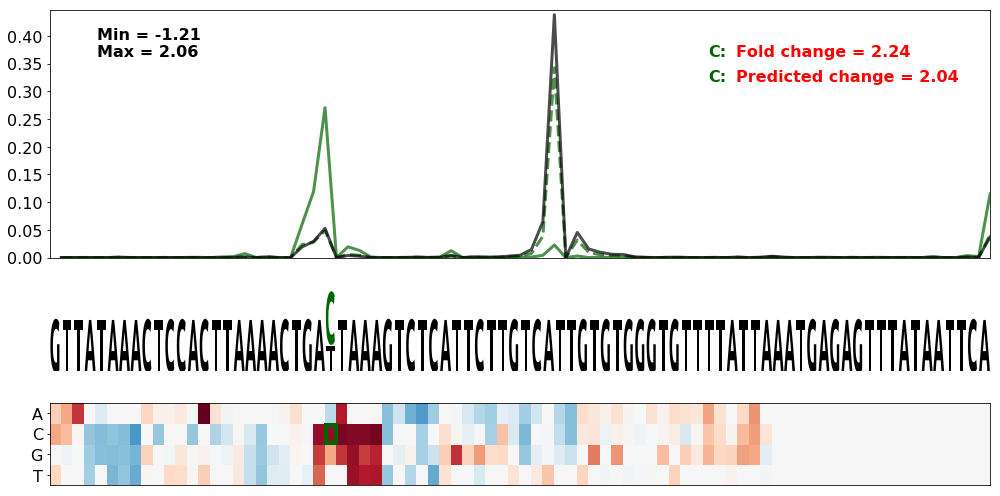

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 73
SNV nt = A
0.7265790766673279
0.6148390906362657
0.7265790766673279
0.5892785900931968


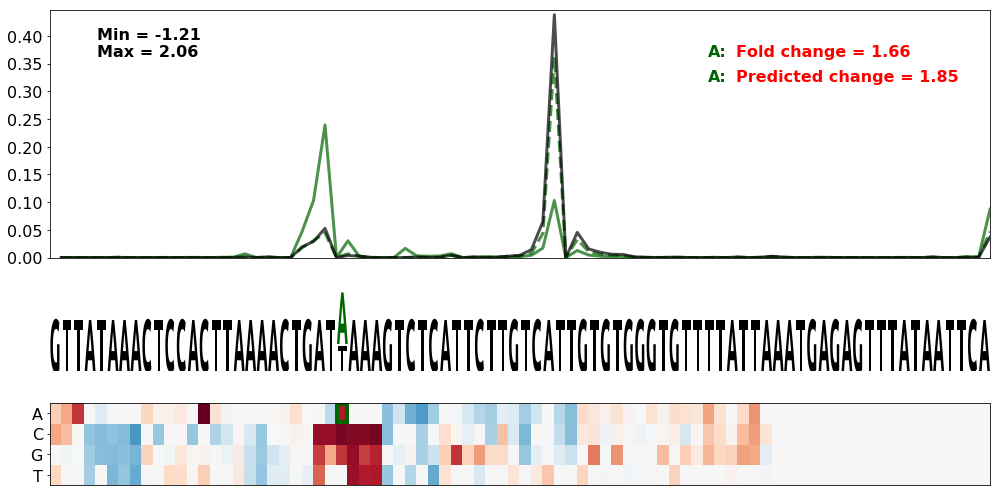

Gene = APC.7
WT seq = AAGATGTGGAATTAAGAATAATGCCTCCAGTTCAGGAAAATGACAATGGGAATGAAACAGAATCAGAGCAGCCTAAAGAATCAAATGAAAACCAAGAGAAAGAGGCAGAAAAAACTATTGATTCTGAAAAGGACCTATTAGATGATTCAGATGATGATGATATT
SNV pos = 71
SNV nt = A
0.08061356224837535
0.2737732149910631
0.08061356224837535
0.061063455988584314


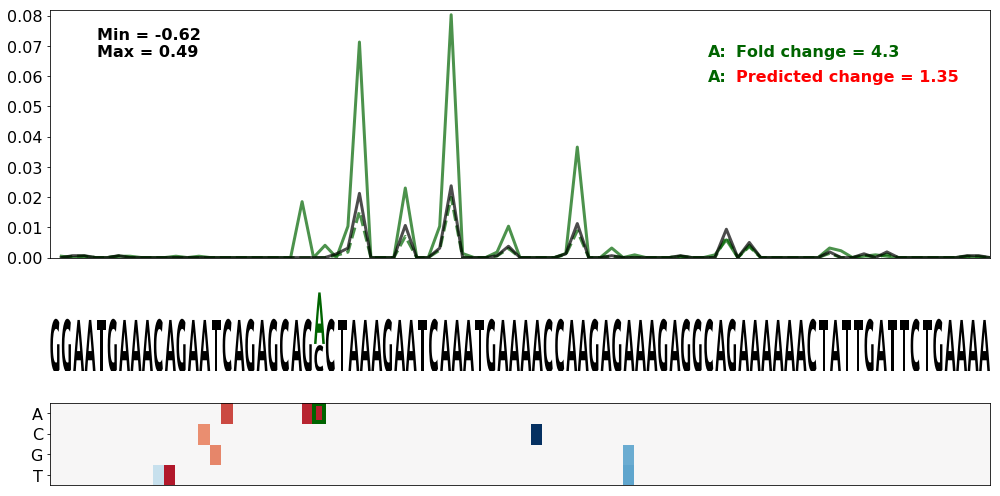

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 109
SNV nt = A
0.7265790766673279
0.6409514845933418
0.7265790766673279
0.683944841111288


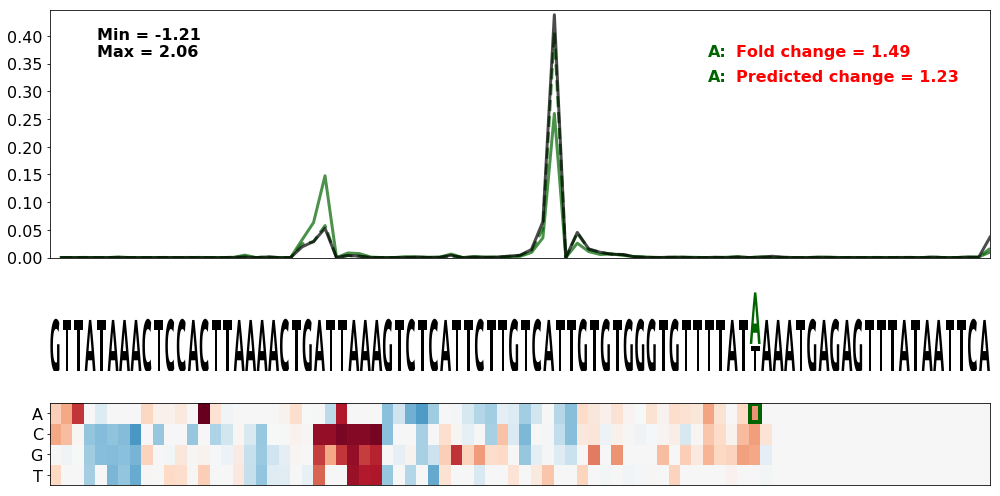

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = G
0.7265790766673279
0.606891086060286
0.7265790766673279
0.6658227718250462


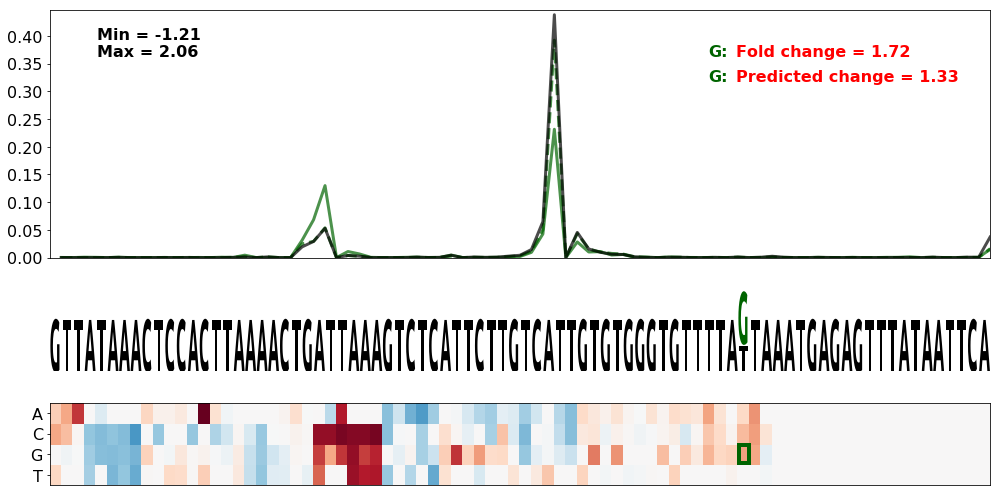

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 72
SNV nt = G
0.7265790766673279
0.5872292815209966
0.7265790766673279
0.6324741797928322


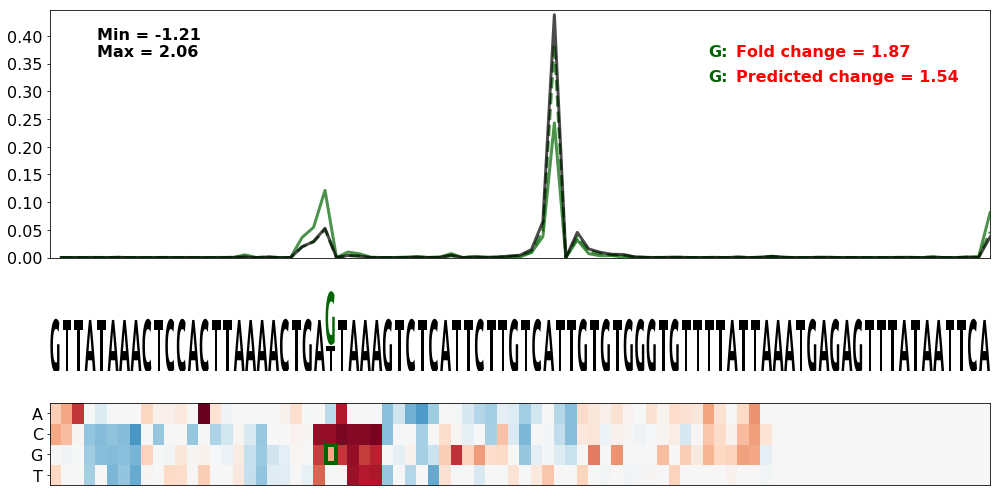

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 108
SNV nt = C
0.7265790766673279
0.7341633489242849
0.7265790766673279
0.662519453920672


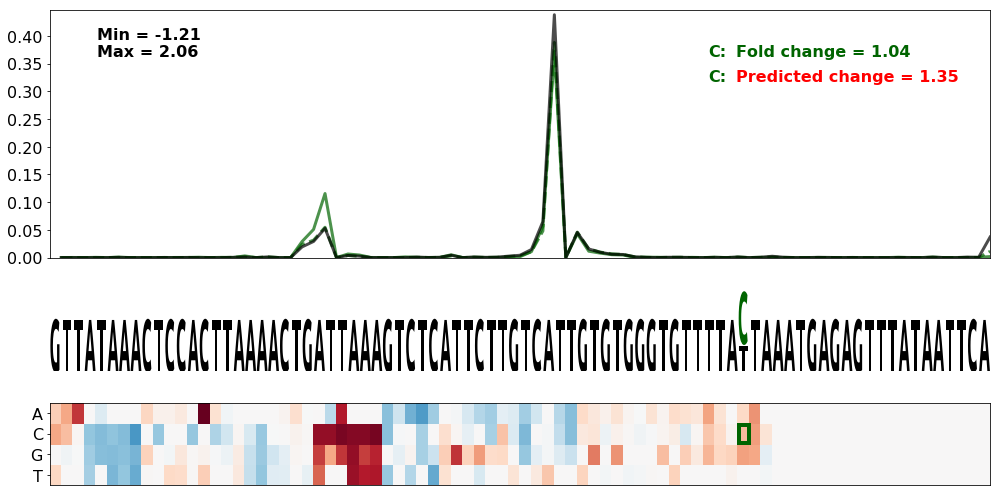

Gene = PRKAG2.3
WT seq = TACCAAATCAGTTTGTTTTCTTTAGATTTGTCAAAAAGTTGTAATTTGAATATAAATAATTACTTTAAAATTGTAATGACACTTTTACACGTAAGTGTTTTGTTCTGGGCTACCGTGTCAACGAGGCTGCTTTACAACAGCTTTATTTATTTTTACTTTCATGC
SNV pos = 64
SNV nt = A
0.0956862265717704
0.1526054400871793
0.0956862265717704
0.0901081090855062


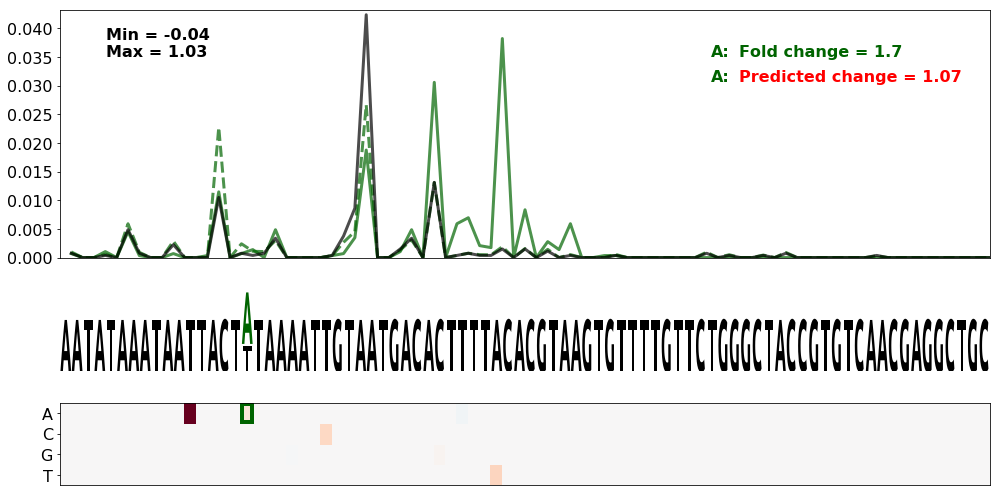

Gene = PTEN.8
WT seq = AGATGTCCATTTGTTATTGTGTTTGTTAACAACCCTTTATCTCTTAGTGTTATAAACTCCACTTAAAACTGATTAAAGTCTCATTCTTGTCATTGTGTGGGTGTTTTATTAAATGAGAGTTTATAATTCAAATTGCTTAAGTCCATTGAAGTTTTAATTAATGG
SNV pos = 62
SNV nt = A
0.7265790766673279
0.7547601643470117
0.7265790766673279
0.8722492508480315


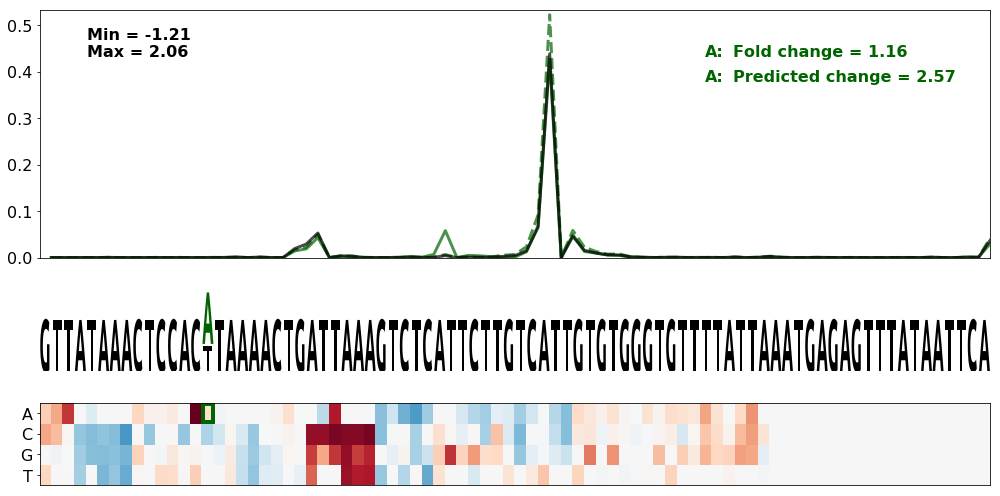

Gene = TGFBR2.2
WT seq = AAAGTCTCAAGCACTTATTTTTATTCTATGCATTGTTTGTCTTTTACATAAATAAAATGTTTATTAGATTGAATAAAGCAAAATACTCAGGTGAGCATCCTGCCTCCTGTTCCCATTCCTAGTAGCTAAATCCATTTGCCTCATTTGGTTATTTTGCAATTTAT
SNV pos = 71
SNV nt = G
0.3889996224907467
0.16334162001593877
0.3889996224907467
0.20960595845826963


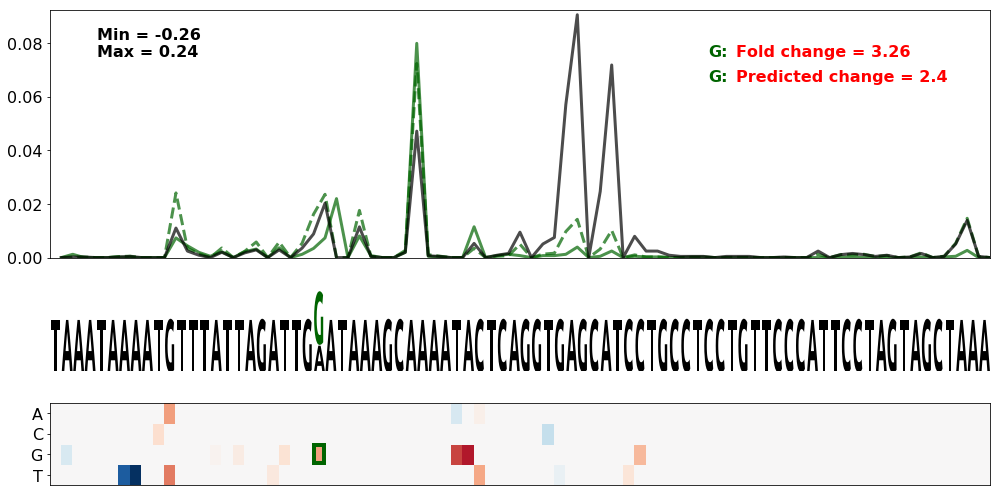

Gene = SDHD.1
WT seq = CAATGGGAATCTCTAATGTGAAAATGTATTCTATGAAAATAATTTTTTTAAATAAAATGTTATATAATAAAAGTGTCTTCTATGCTTTTATATATTAGCTATCAGTAGTTTTATTCATTAGAATTAGGTGTCCATTGCATCCACAGCATGAAAACAAAATTGGG
SNV pos = 66
SNV nt = C
0.8808032982932243
0.8872218421362204
0.8808032982932243
0.917270827532473


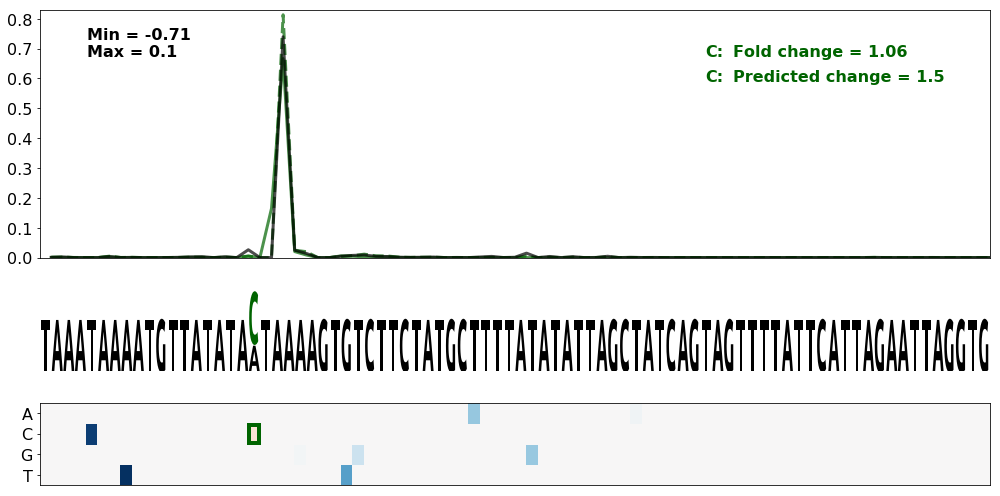

Gene = PTEN.24
WT seq = GAGTTAAGTAATTTCACTGAAATTGATTGCTTTTTGTGTCTTGGAGTCAAAATAAATAACTGAAATCTACTATACTTGGCTCATGCTTAATTAATATACTTAGACCATATTTCGGATGAATTATTCACAGAATCTAAAGGAGTATCCTCGTGTTCTTACCTTCT
SNV pos = 72
SNV nt = A
0.7254311868123275
0.7722798053566979
0.7254311868123275
0.827218170077167


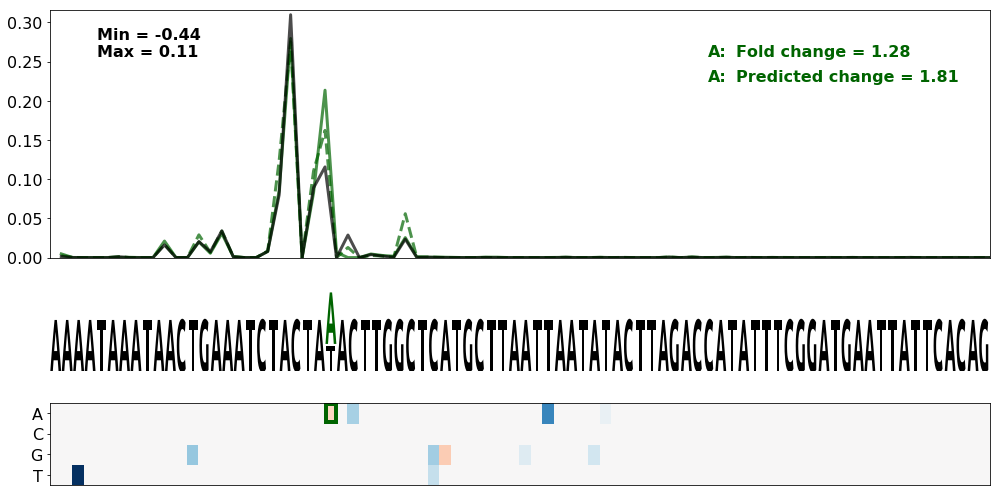

Gene = TPM1.9
WT seq = CCCTTTTTGTCATAACCTAGAATAGTCATTGTTTTTTCACTTTCTGCTAATATAAAGGCCAATTAGATTAAGTCTGTCTATACAAACCATTTTCTTTTCAGAATCCGTTTATTTTGTAAACGCTGAACTAGAGCAGTGAACTAGAATGAGTGACCTTGAGCACT
SNV pos = 82
SNV nt = T
0.04025515548288738
0.05366914280835953
0.04025515548288738
0.03757890870209388


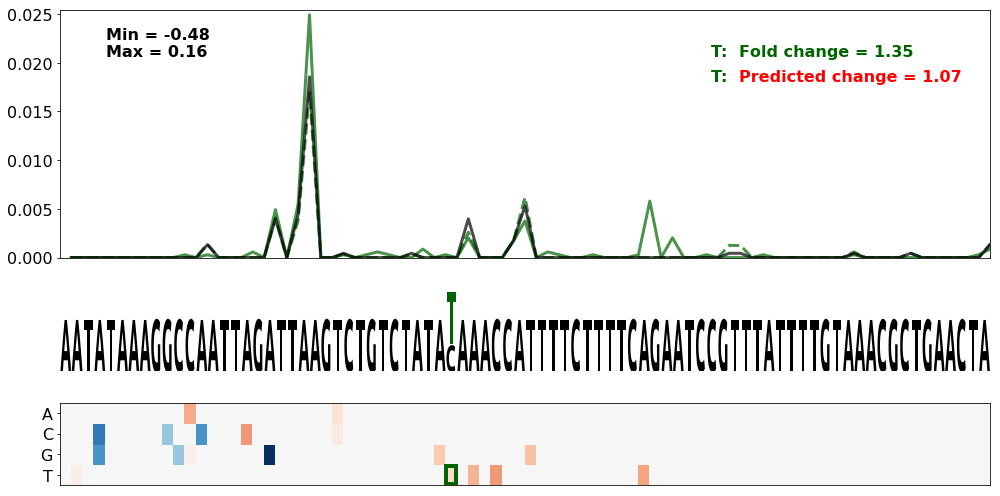

Gene = TGFBR1.5
WT seq = GATGCTTATGTTAAGTCCTAACACTACAGTAGAAGAATGGAAGCAGTGCAAATAAATTACATTTTTCCCAAGTGCCAGTGGCATATTTTAAAATAAAGTGTATACGTTGGAATGAGTCATGCCATATGTAGTTGCTGTAGATGGCAACTAGAACCTTTGAGTTA
SNV pos = 92
SNV nt = G
0.15742022917550597
0.17148548913462303
0.15742022917550597
0.16544487074854367


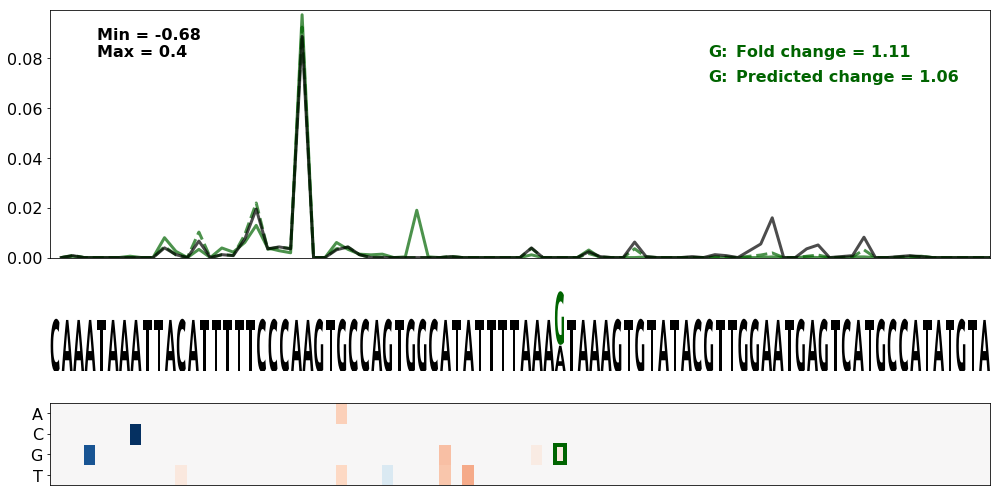

Gene = HPS1.3
WT seq = GCACCTCCGTCCCAGGGTGGTGTGAGGATTACCCAGTGTGGTAGGTGCTCAATAAATGTTGGTCATTGTTATCACTGAAGCCCAACATGCTAGTGCTTCTAGACCCTTCTGTCAGTGCTGATAAGCCCTTGCTAAGTCCCAGCCCCTTCATGCTTGGCTGGCGT
SNV pos = 124
SNV nt = A
0.02497858365220157
0.02937928166576207
0.02497858365220157
0.02486874535431495


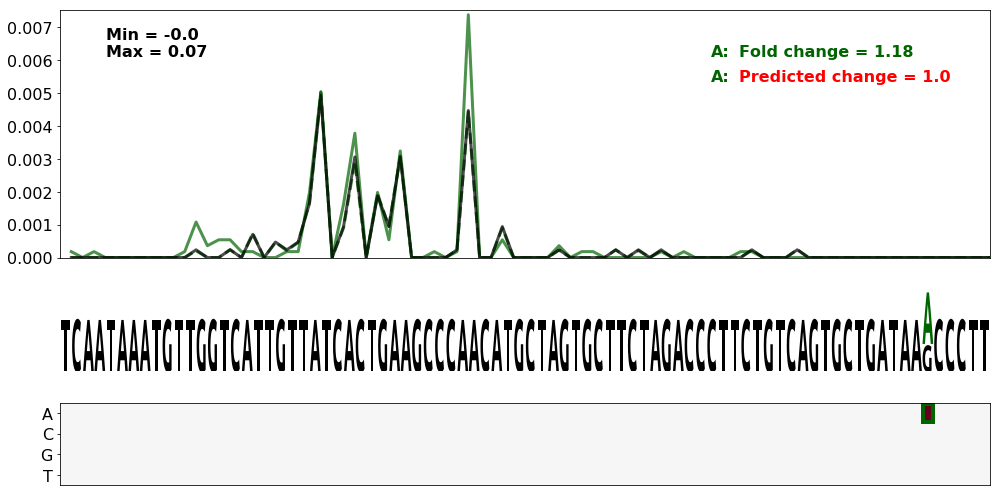

Gene = DOCK8.2
WT seq = ATTTGAGAATTAAATTATATATTTTTAATATGACTGTGACCTTGACTGATAATAAAGATGTAATAAGAATTGCAAGCTAAATGTTTCCCTTTGCAACTCATGCTTTGTGTTTTGTTTTGATGACCTACTCGCTCGTAATGTTTTGTAAGGCACTTCAGAGAGAA
SNV pos = 75
SNV nt = A
0.44955535501629973
0.5645859652107805
0.44955535501629973
0.5463047883687131


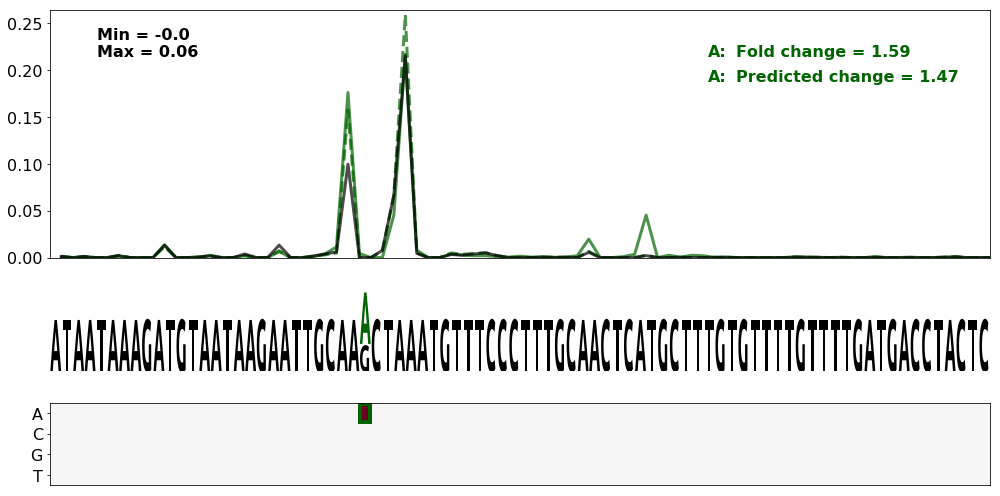

Gene = BRCA1.1
WT seq = ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG
SNV pos = 64
SNV nt = T
0.6327641196335845
0.6694211902565106
0.6327641196335845
0.7604742584332764


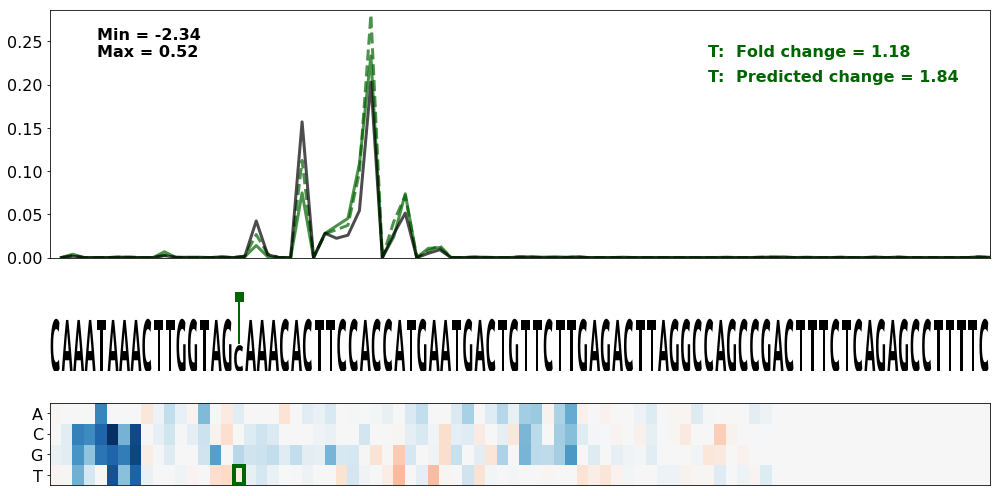

Gene = FGFR1.2
WT seq = GGATGAAGAATCTAAAAGTCTTCATAAGTCCTTGGGAGAGGTGCTAGAAAAATATAAGGCACTATCATAATTACAGTGATGTCCTTGCTGTTACTACTCAAATCACCCACAAATTTCCCCAAAGACTGCGCTAGCTGTCAAATAAAAGACAGTGAAATTGACCT
SNV pos = 109
SNV nt = T
0.007208106347292108
0.005711796841119808
0.007208106347292108
0.005950575355242668


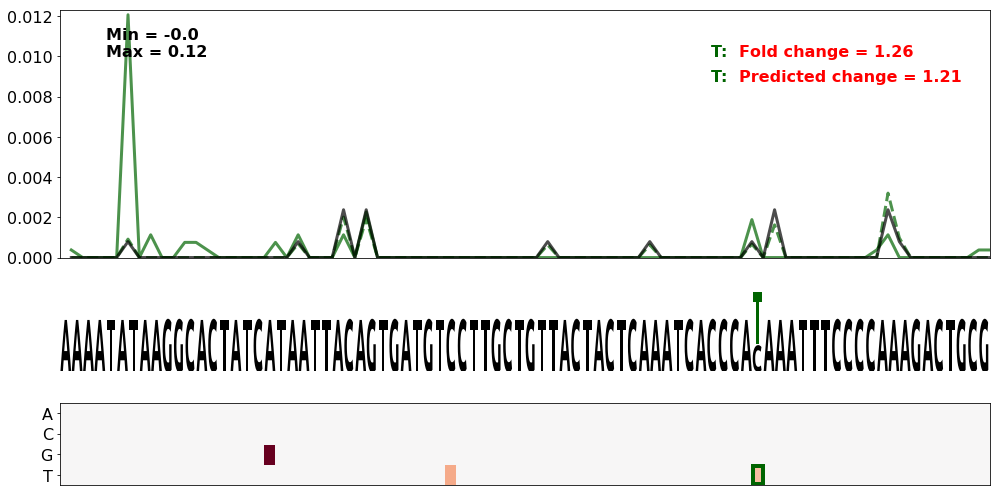

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 85
SNV nt = C
0.08781012845006006
0.08529366027816303
0.08781012845006006
0.10461340916356636


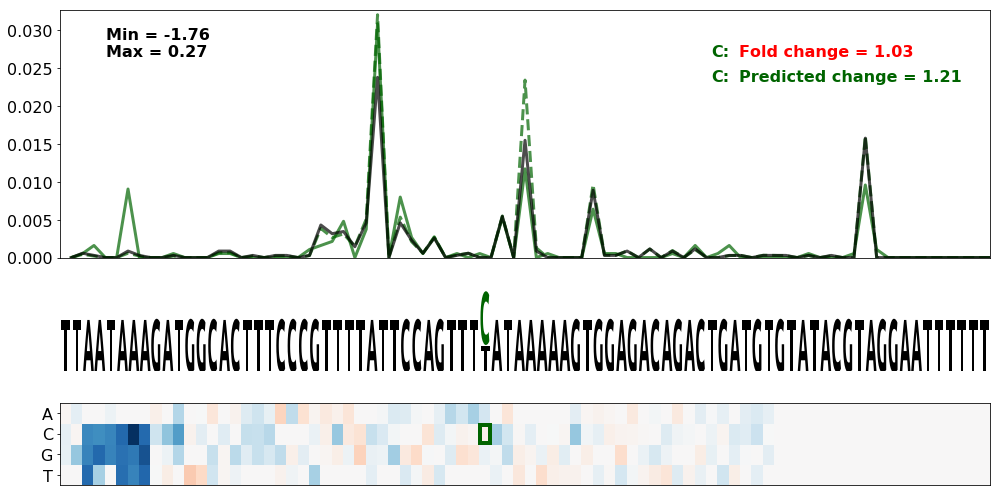

Gene = BRCA2.1
WT seq = TGTATAATATCATGTTTTCAAATCTAATTATAAATACGTTTAAAGCCAAGAATAAATCTTTTAAAAAATTGACTTGTTTCCTTCCATAACTCTGAGCCATGATTTTTCTGTTCTGTAAAAAGCATTAACAAAATTGTCTATTTTGCTACTCCCTGTAACTTAAG
SNV pos = 89
SNV nt = A
0.5125794077417087
0.5326959301240459
0.5125794077417087
0.5247521554876157


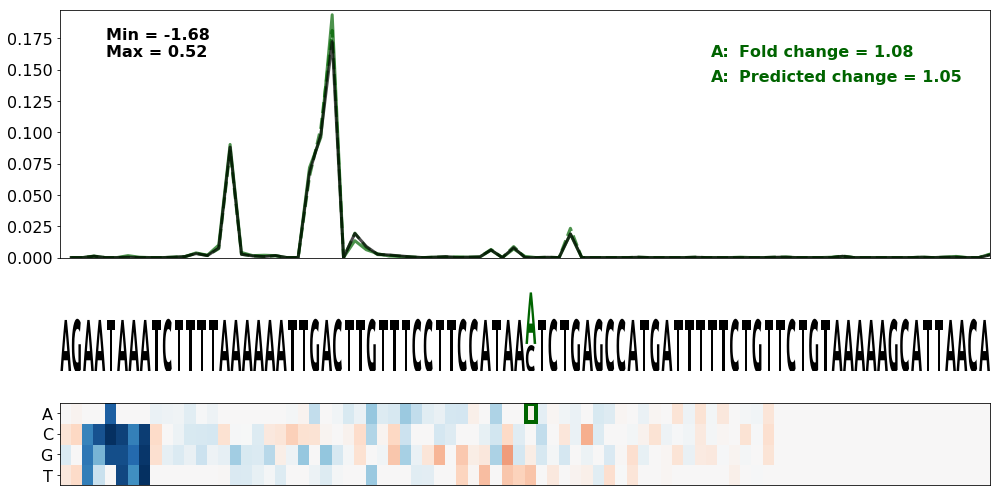

Gene = DSG2.1
WT seq = CTTAAAGGCAGGTGTTTCTTGGACTTTGTTATTTAATTAGATCTGCTTGCAATAAAAAAAGTTGTCGGTTATCTAAAATTCAAATTTATCGGGGTACTTGGCATTTTCATTGTCCAACTCTGGCAACCTTGTTCCTAAGGAAGTGAAGGTTGCTCTCTGCCCAG
SNV pos = 72
SNV nt = A
0.20305270046533805
0.21829598548557183
0.20305270046533805
0.19917541725964227


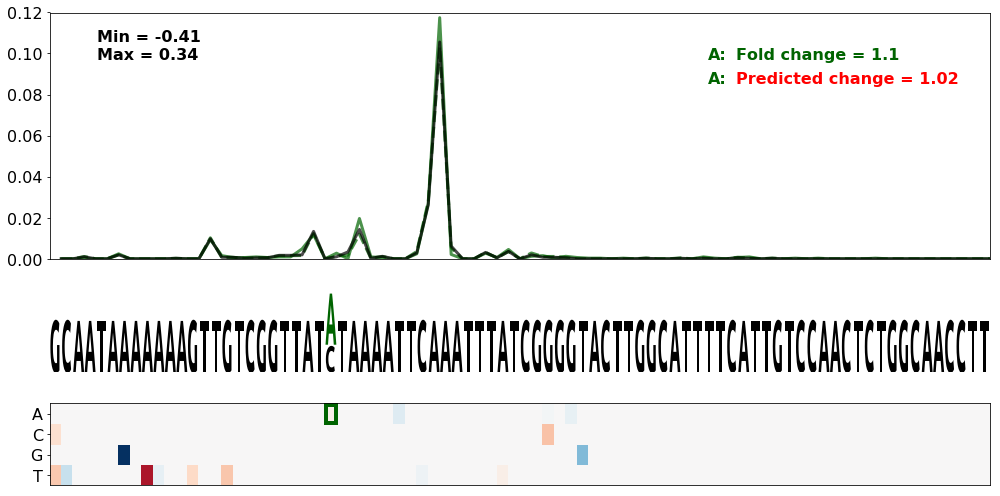

Gene = PTEN.16
WT seq = TCTGAATTTTTTTTTATCAAGAGGGATAAAACACCATGAAAATAAACTTGAATAAACTGAAAATGGACCTTTTTTTTTTTAATGGCAATAGGACATTGTGTCAGATTACCAGTTATAGGAACAATTCTCTTTTCCTGACCAATCTTGTTTTACCCTATACATCC
SNV pos = 58
SNV nt = A
0.034579726269334976
0.03286614832183605
0.034579726269334976
0.03349785643900296


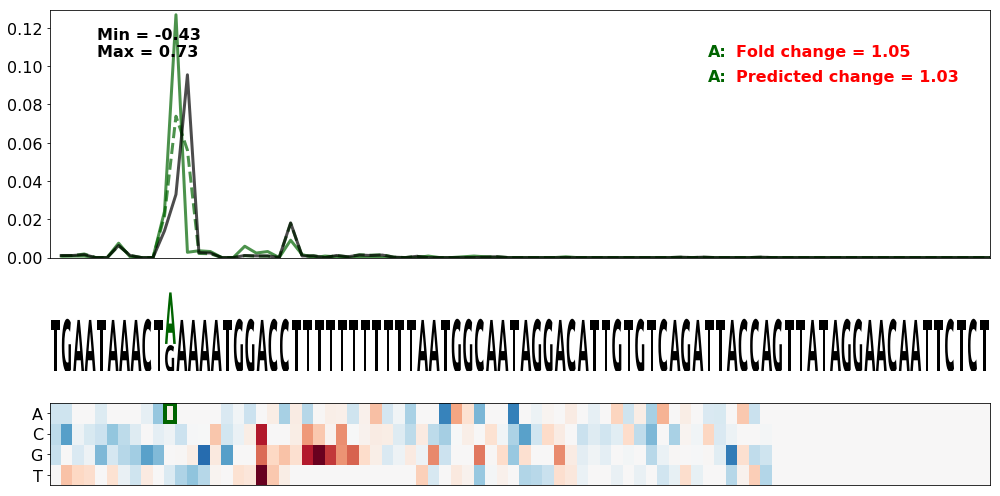

Gene = NF2.5
WT seq = CTGATTGCTTCTGGCTTTATGCCTTTCAGTTTATGAATAAAAACTTCATGAATAAAAATTACTGTTATCTTCATATACTTAAAAATAACCAATTTGTGTCTTTTAGAGAGTATTGGGGCTTGTGTTCTTTAGGGAATTTTTTAAAGTCTTTTTGAGGAACACCA
SNV pos = 75
SNV nt = A
0.19814054722315577
0.21287514307272057
0.19814054722315577
0.22025127240553133


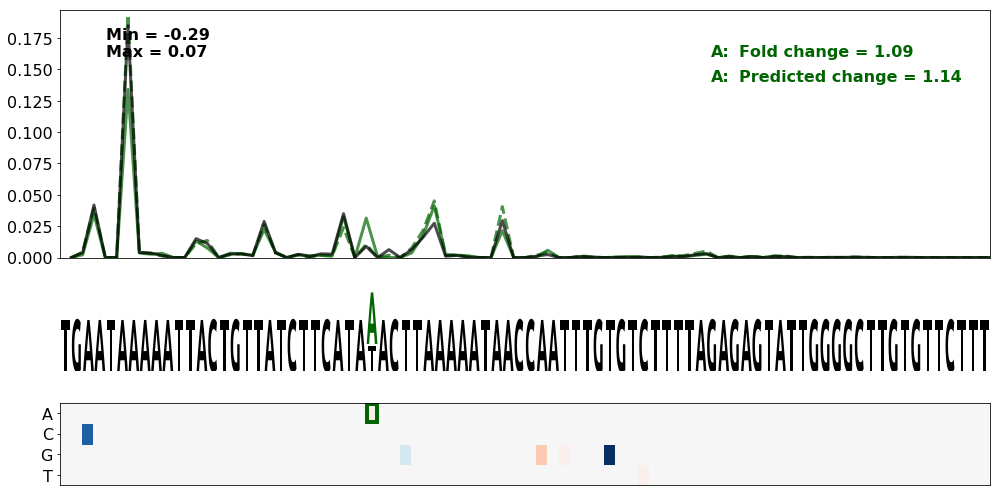

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 72
SNV nt = C
0.1485146363824651
0.14370500732263652
0.1485146363824651
0.15007755179841992


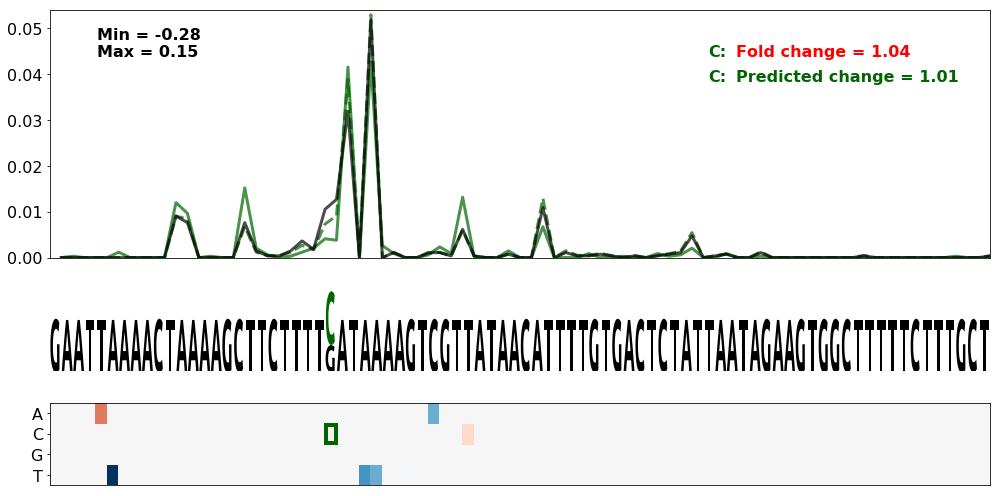

Gene = PTEN.13
WT seq = GCTATCAACAAAGAATGGGCTTGAAACATTATAAAAATTGACAATGATTTATTAAATATGTTTTCTCAATTGTAACGACTTCTCCATCTCCTGTGTAATCAAGGCCAGTGCTAAAATTCAGATGCTGTTAGTACCTACATCAGTCAACAACTTACACTTATTTT
SNV pos = 110
SNV nt = A
0.1760014154005467
0.18081785148208768
0.1760014154005467
0.1805350171715201


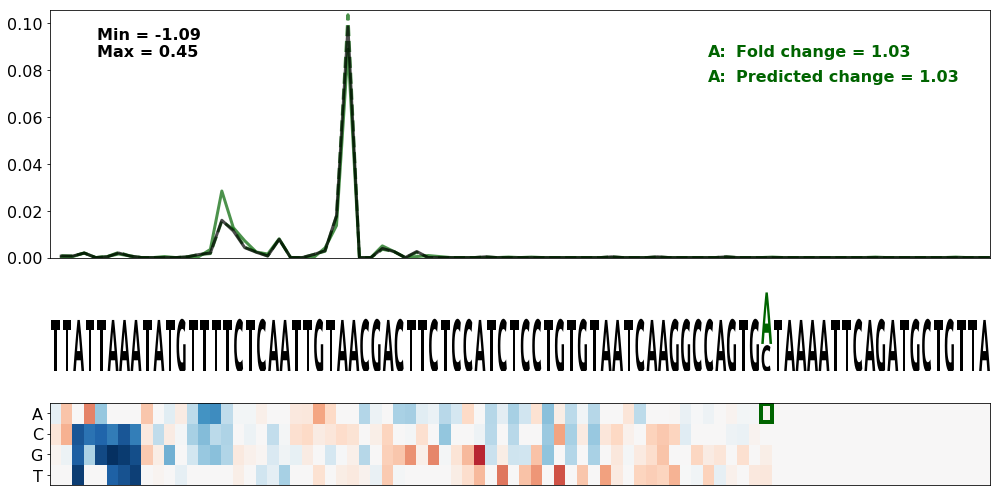

In [234]:

df_sel = gain_of_motif_df.query("snv_pos >= 57 and delta_logodds_true > 0.0").sort_values(by='delta_logodds_true', ascending=False)

seq_start = 48
seq_end = 130#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Gene = MYH11.1
WT seq = AGGAATGCTGCACTGTTTACACCCTGACTGTGCTTAAAAACACTTTCACTAATAAATGGTTATAAATCACAATGTCGTTGGCTTTTCTGTTGAGCTGTTTTCTATAGAGGAAAAGGAGTTGGGGAAGGCTGGGTTTTGCTTCATCGTCCCAAAGATTCTCTGAA
SNV pos = 65
SNV nt = G
0.9346671601819332
0.8253935218483821
0.9346671601819332
0.9412466166349401


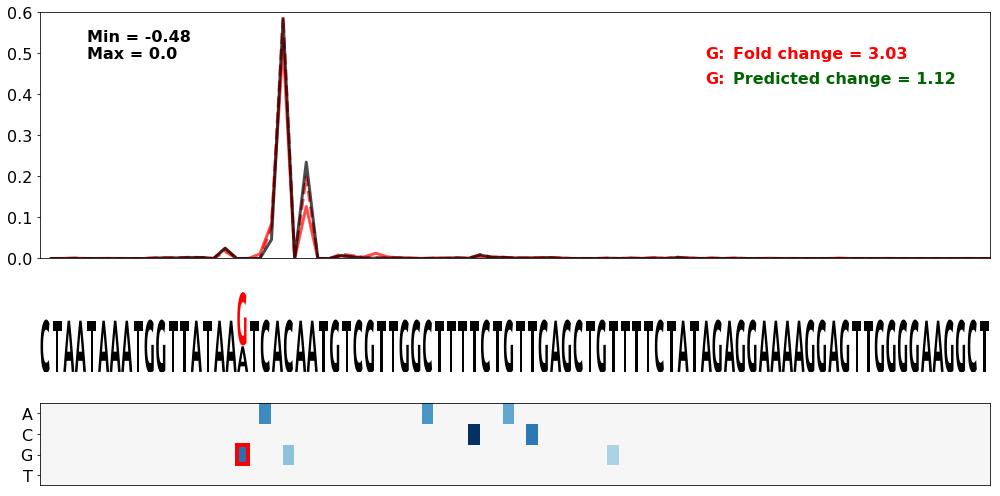

Gene = RET.2
WT seq = AAGTGTGTCCTAAATTCACACTAACTTTATCACACAAACATGGCAAGAATATTAAAATCTCAGTAAAGGAAGACAAGCCATCACTTATGCTTCCCCAGATTCCTTTCATTCTCTGGGGCAGGGTTGATGGAGCACTTGGTTTTTTGCATGCTGCCCTTTTTCAC
SNV pos = 65
SNV nt = G
0.04682377764931708
0.019290649650958697
0.04682377764931708
0.032169451463146426


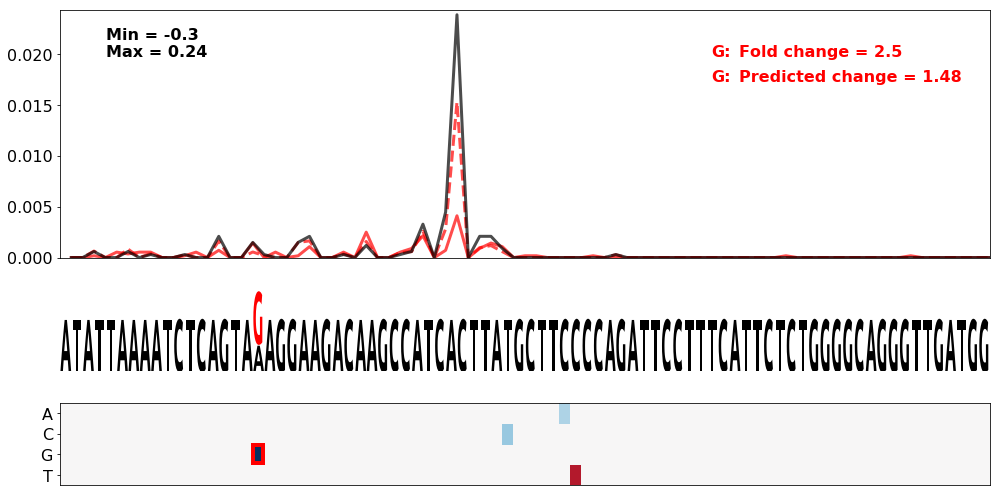

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 86
SNV nt = C
0.08781012845006006
0.06675008785684058
0.08781012845006006
0.09988523135259839


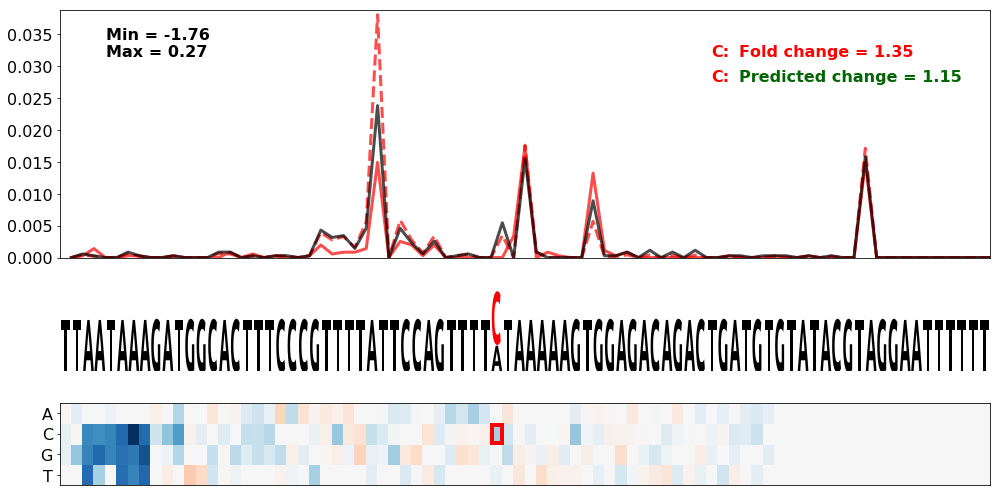

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 87
SNV nt = G
0.08781012845006006
0.05622237203015622
0.08781012845006006
0.09422998553299389


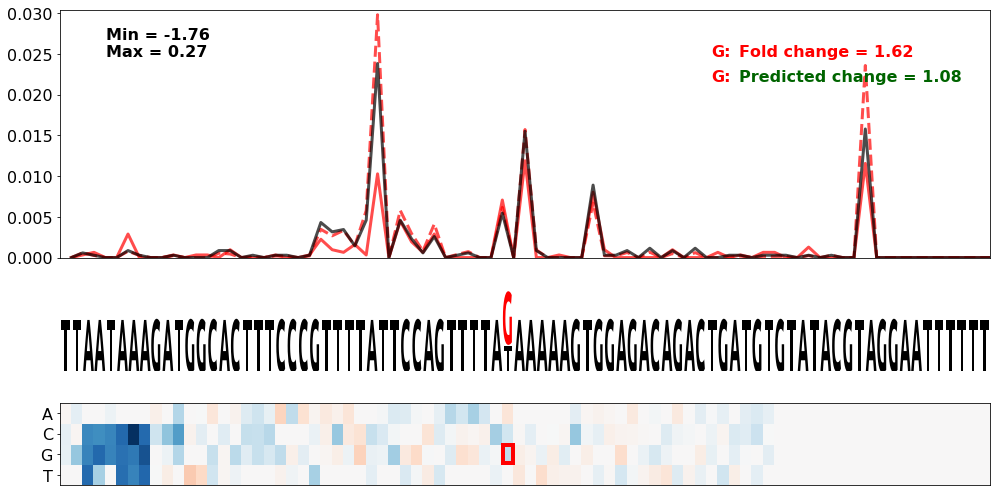

Gene = KCNQ1.8
WT seq = AGCAGGTGCTGGTGCCATATTTCCTGTATAGCCTGAAGAACTGTGAGCCAATTAAAATCTTCTTTATAAATTACCCAGCCTCGGGTGTTCCTTTATAGTAACACAAAACTGGACCAGCACAAATTTATGTCATCTCCAAATAGTTCTACTTCTTTCTTTCAGTC
SNV pos = 65
SNV nt = C
0.4160960319958421
0.30216698635744377
0.4160960319958421
0.38329509521092214


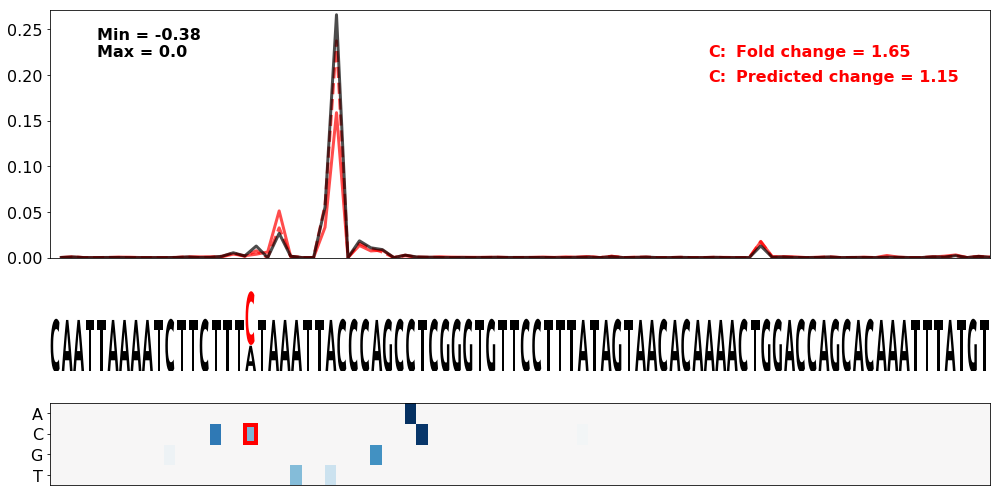

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 75
SNV nt = T
0.1485146363824651
0.18988289430119346
0.1485146363824651
0.11586468925600779


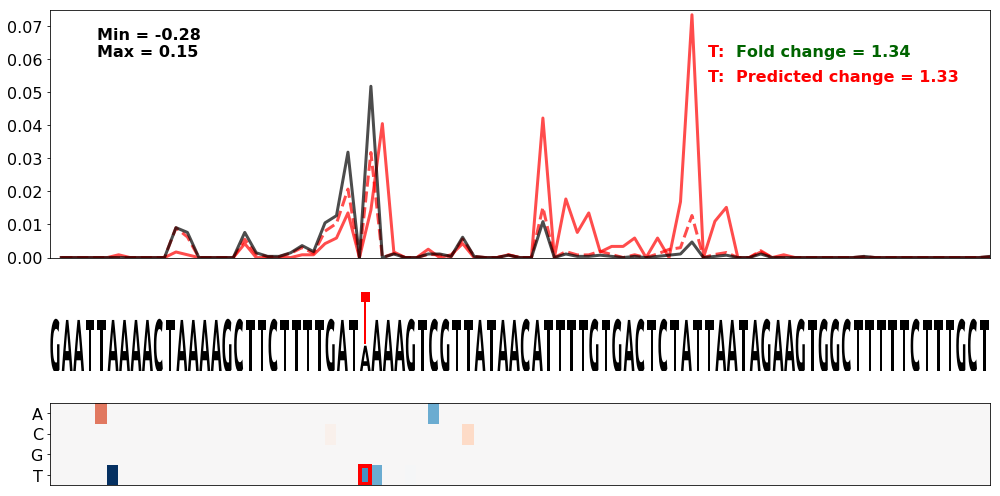

Gene = KCNQ1.8
WT seq = AGCAGGTGCTGGTGCCATATTTCCTGTATAGCCTGAAGAACTGTGAGCCAATTAAAATCTTCTTTATAAATTACCCAGCCTCGGGTGTTCCTTTATAGTAACACAAAACTGGACCAGCACAAATTTATGTCATCTCCAAATAGTTCTACTTCTTTCTTTCAGTC
SNV pos = 69
SNV nt = T
0.4160960319958421
0.3045249439663604
0.4160960319958421
0.3958105421838159


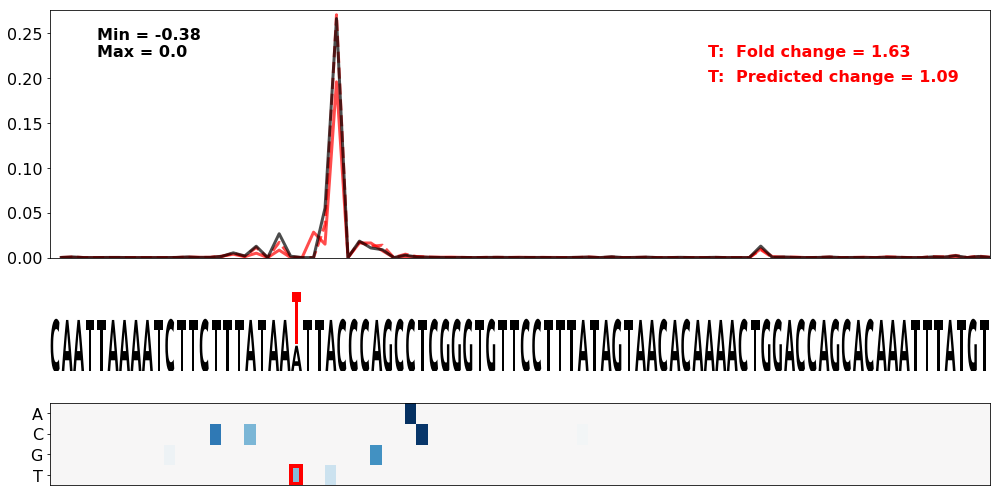

Gene = DSG2.6
WT seq = ATTTTGCCTAATTCCAAAAGCATTTGTGGCCATTACAGAAAACACCTACCAATAAAAGAGTAAAATATTTTTTACATGTCTAGTCATTTAATAAATGCTATTTTGAATTGAAATTGTATTTTAGTTAGTTTGCTTGTTTGAGCAATCCAACGACTTCAAGGAAA
SNV pos = 63
SNV nt = T
0.37609143226661307
0.2836903212646894
0.37609143226661307
0.33701803230887617


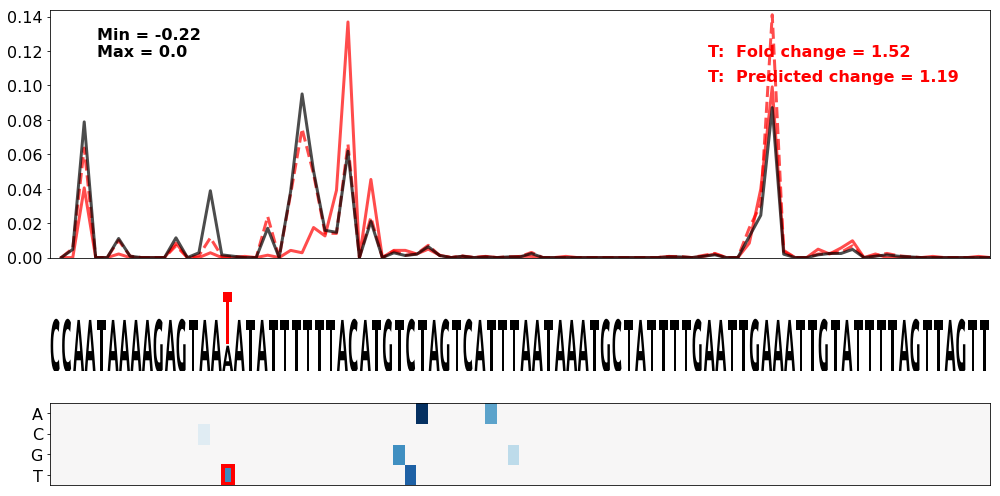

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 76
SNV nt = T
0.1485146363824651
0.10080278880520639
0.1485146363824651
0.13914500229300727


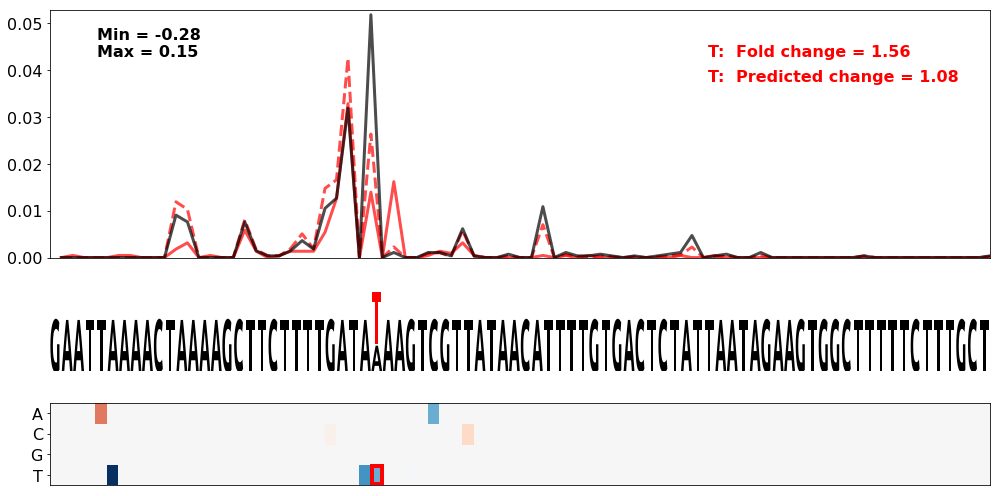

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 87
SNV nt = C
0.08781012845006006
0.07609746782178496
0.08781012845006006
0.10306783812402986


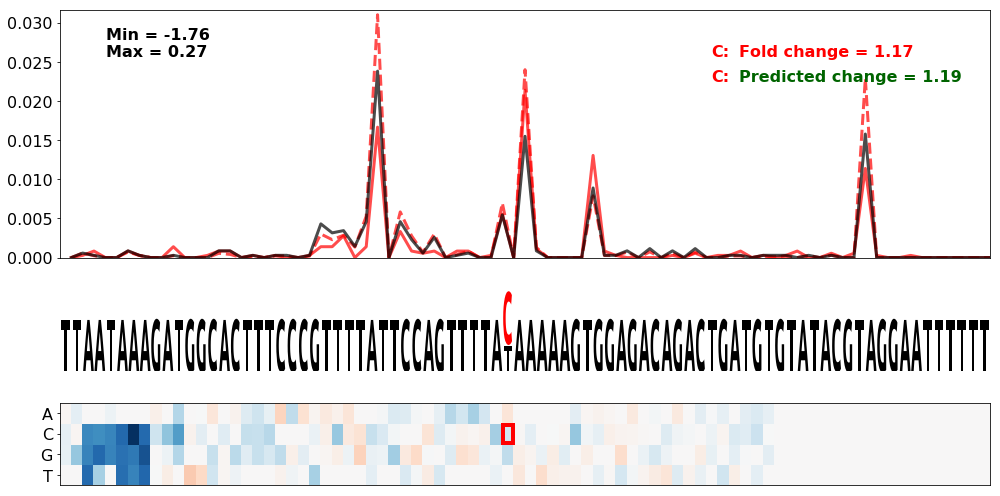

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 85
SNV nt = A
0.08781012845006006
0.05967438317676657
0.08781012845006006
0.06963183314314607


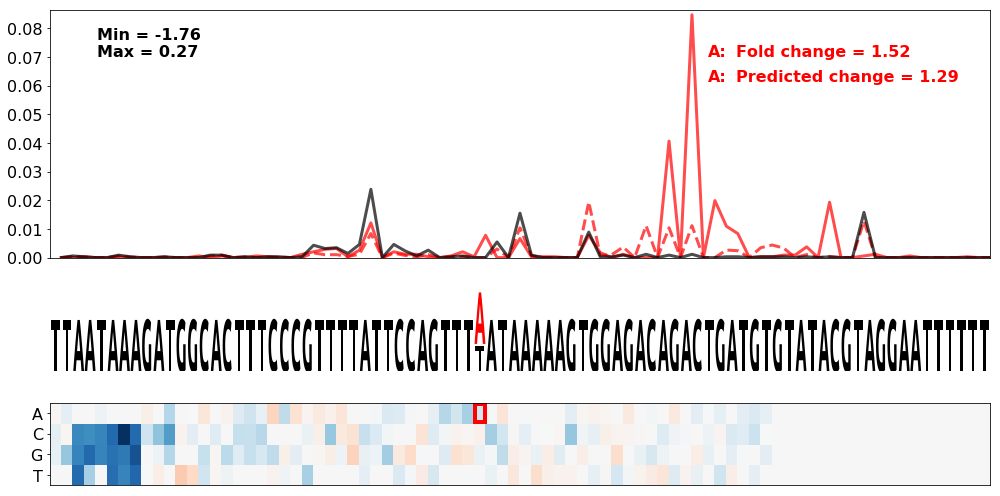

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 107
SNV nt = C
0.8097446825109856
0.7470904971022835
0.8097446825109856
0.8212026563084757


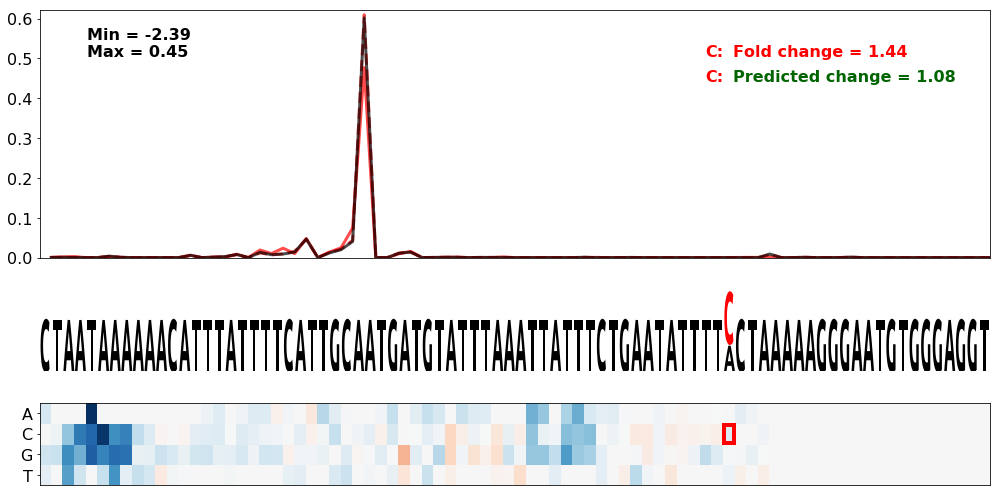

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 108
SNV nt = A
0.8097446825109856
0.768044988701108
0.8097446825109856
0.7389354795650914


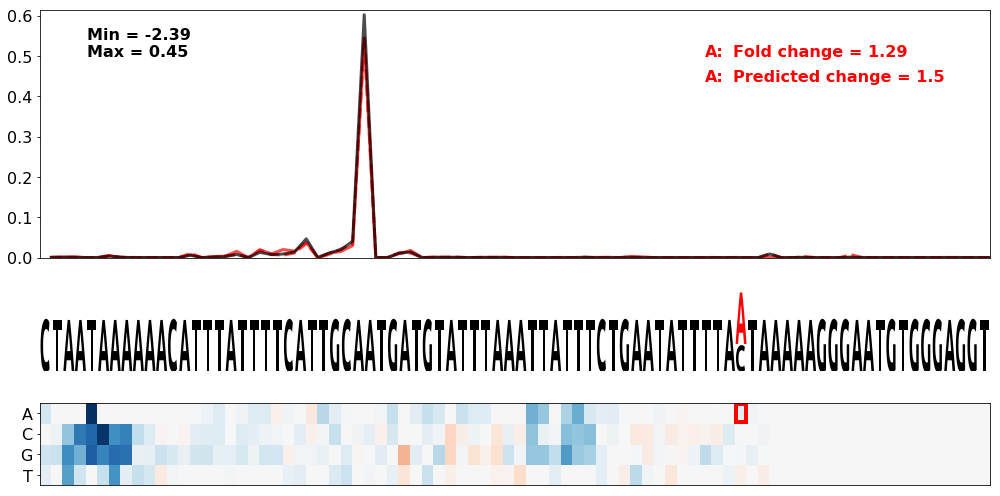

Gene = TMEM43.11
WT seq = AGTGAATTTGAGAATTAAATAATACTTGTAAAACACTTAGGACAGTATCAAATAAATGGTGAGTGATAAATGTGACCTGTTTTTGTTGTTACGGACTCTGAGAGAGGGCCCGATTCAGATCAGAGGGTCAGGGAAAGCCCTCTGAAGAAATGGGGTTCAAGCAA
SNV pos = 68
SNV nt = C
0.36278388017012386
0.3027202077534386
0.36278388017012386
0.2838231030222389


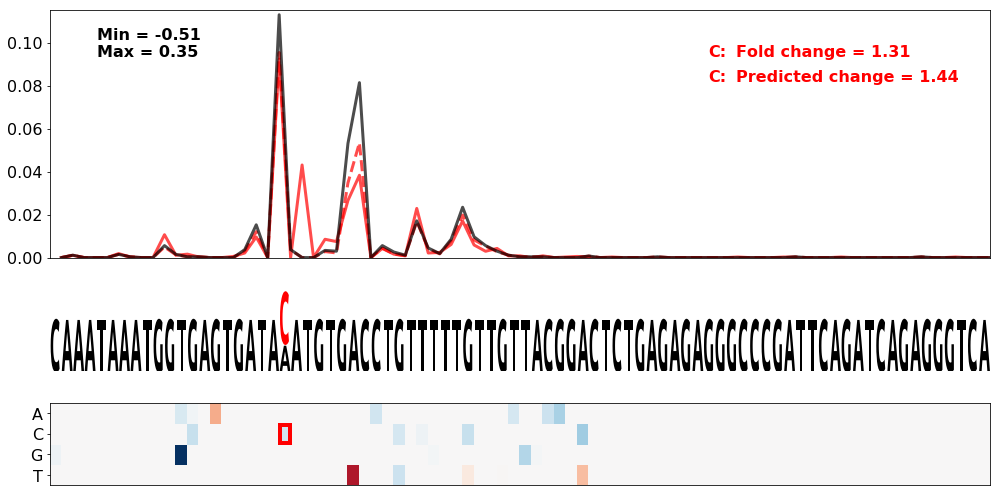

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 89
SNV nt = C
0.08781012845006006
0.055402071954624765
0.08781012845006006
0.08311963883191181


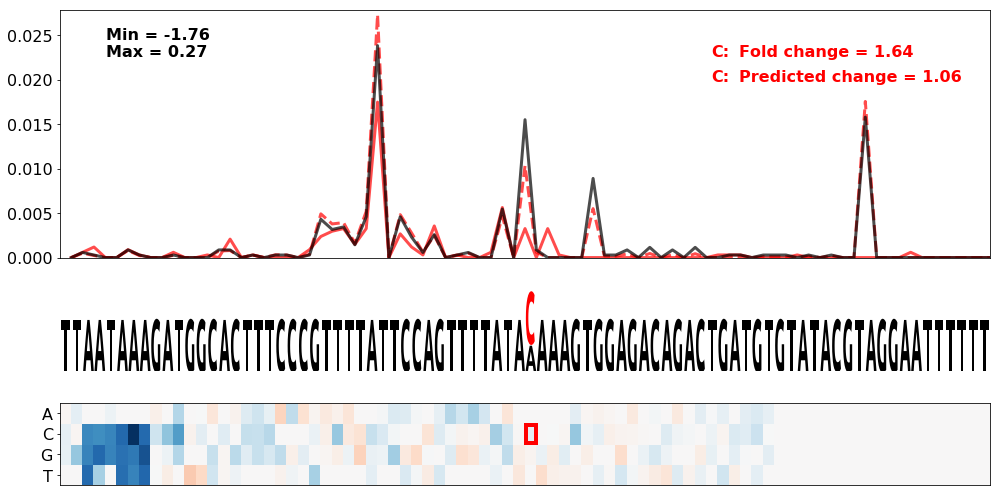

Gene = SMAD4.1
WT seq = AAAAAATAGTCGAACCTTTCTTGAGAACTCTGTAACAAAGTATGTTTTTGATTAAAAGAGAAAGCCAACTAAATCATTATGTGCTCATTCTTTTTCTTAAGCTTGTGGATGTCTTGGATCTGGAAAGGGTTTCTGATCACTTAGAGAATTTTCAAACTTTAGGT
SNV pos = 69
SNV nt = G
0.6973111740337841
0.6558190640002988
0.6973111740337841
0.6770209018688922


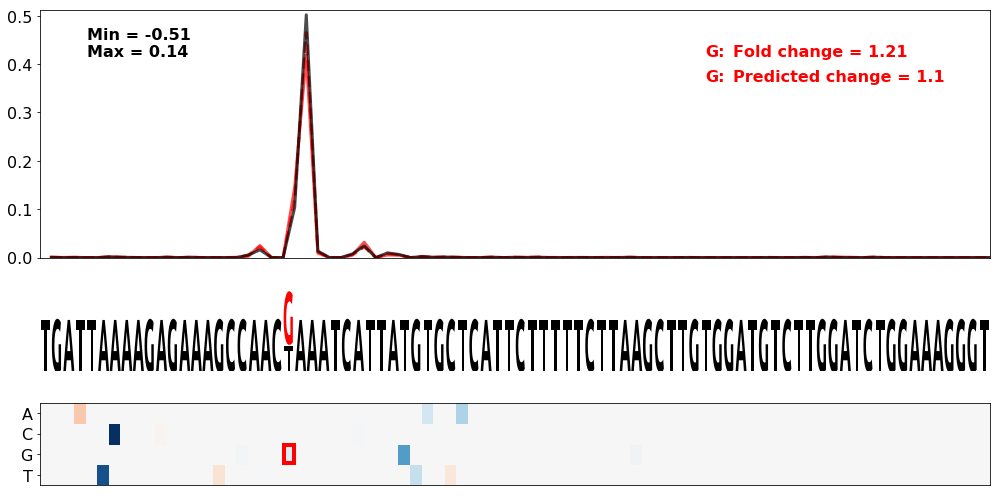

Gene = PRKAG2.7
WT seq = TCACCTTGAAACCCTGTAAAATGGTCTCTCTTATGGGAGAAATGTGGAAGAATAAACTAAATGGCTCAGAATTGCATGCCAATGGGTGAACCTGTGTTGCTTTAAGGTTCTCTGACCTAAGTGTTTTAAACCTTTCTACCTGTTACCTTGTTTTGAAATATATT
SNV pos = 58
SNV nt = T
0.10822472491172798
0.08878571458342607
0.10822472491172798
0.1041598972686831


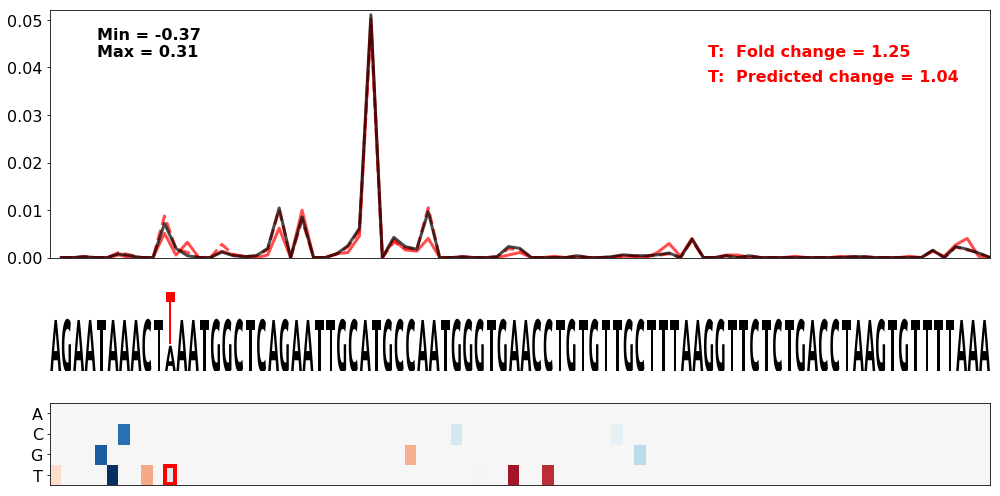

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 107
SNV nt = T
0.8097446825109856
0.7856729856022391
0.8097446825109856
0.8232501978846665


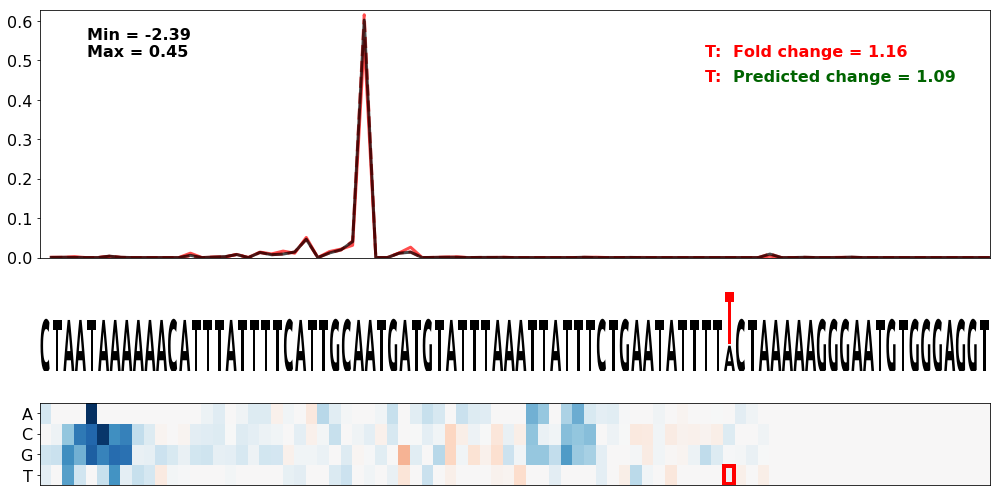

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 86
SNV nt = T
0.08781012845006006
0.07523637486495752
0.08781012845006006
0.0833063205735321


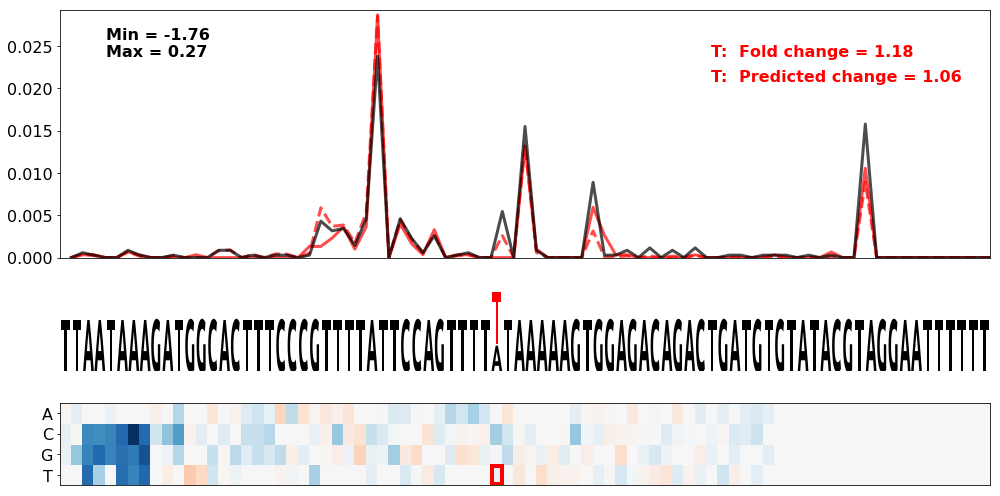

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 90
SNV nt = G
0.08781012845006006
0.06139343470507694
0.08781012845006006
0.08211155381097086


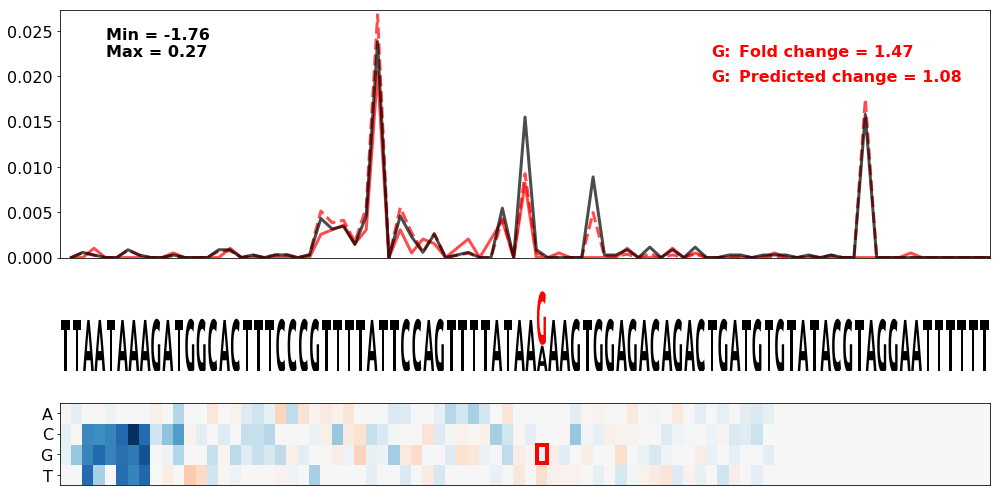

Gene = HAL.4
WT seq = TGACTTTCTTTGGCTAATTTTACTTTGCATGATATGCCTTAATATGCCTTCATAAATAACCATTTTAAGTCATAATTTGTCCTTAAGCTGCTTTTTTCTTCTATTAATTGGATCATAGTAAAGAGTAGTCAATAGGGTCTTCAGCTATTAATTGTAGAGGTGAT
SNV pos = 117
SNV nt = A
0.09803727721047505
0.08650258379515562
0.09803727721047505
0.09805232444347421


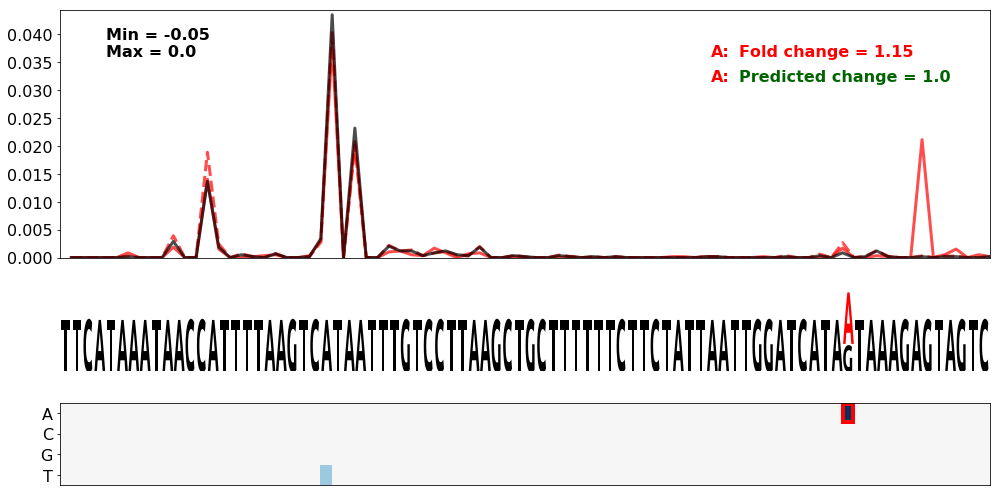

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 85
SNV nt = G
0.08781012845006006
0.07823334952036028
0.08781012845006006
0.09498001166704047


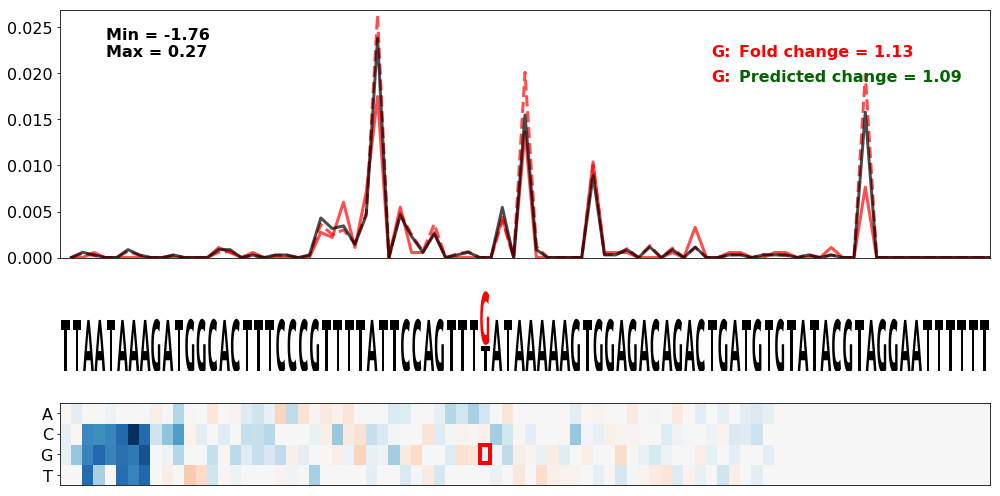

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 109
SNV nt = A
0.8097446825109856
0.7968026481785003
0.8097446825109856
0.8249172326680496


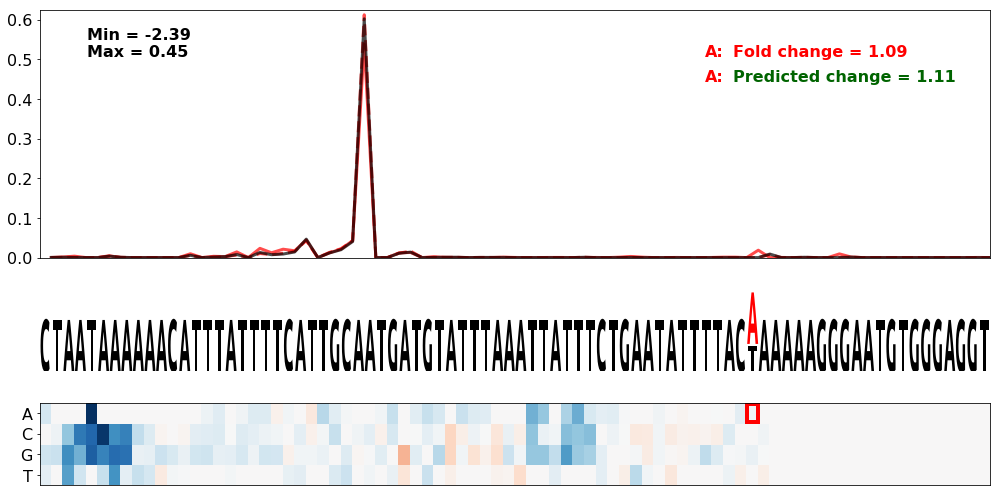

Gene = DSG2.6
WT seq = ATTTTGCCTAATTCCAAAAGCATTTGTGGCCATTACAGAAAACACCTACCAATAAAAGAGTAAAATATTTTTTACATGTCTAGTCATTTAATAAATGCTATTTTGAATTGAAATTGTATTTTAGTTAGTTTGCTTGTTTGAGCAATCCAACGACTTCAAGGAAA
SNV pos = 61
SNV nt = C
0.37609143226661307
0.36077477583429773
0.37609143226661307
0.325508579729688


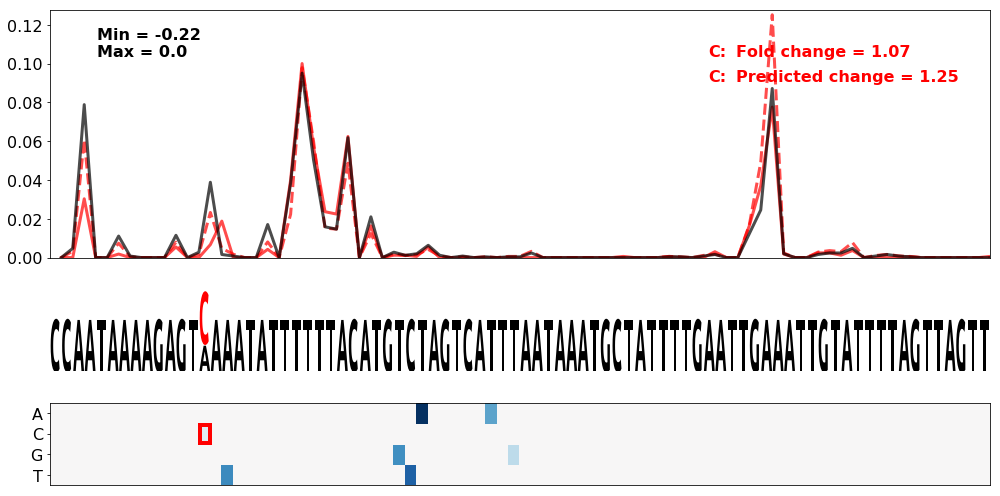

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 108
SNV nt = G
0.8097446825109856
0.8023178960782011
0.8097446825109856
0.7687326396704183


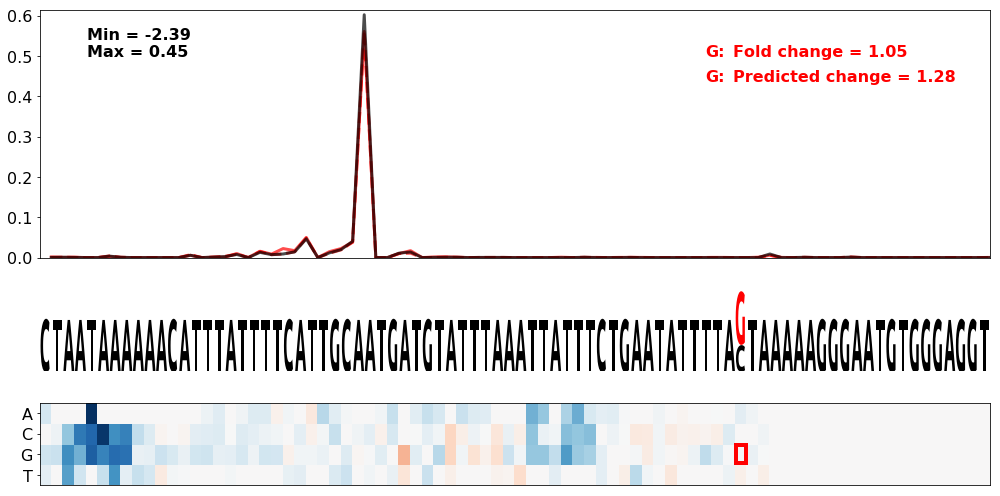

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 86
SNV nt = G
0.08781012845006006
0.08506693070752006
0.08781012845006006
0.08167197995780504


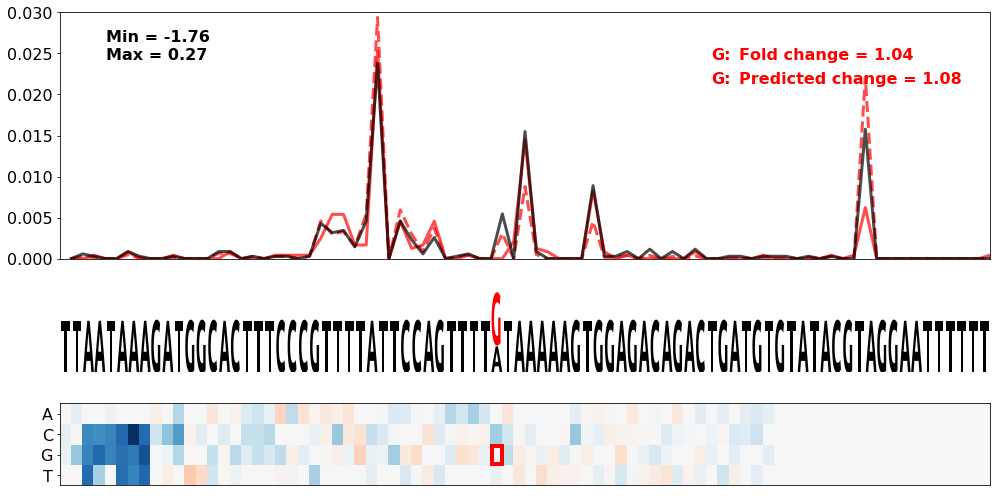

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 107
SNV nt = G
0.8097446825109856
0.8069220062292569
0.8097446825109856
0.8127650730233118


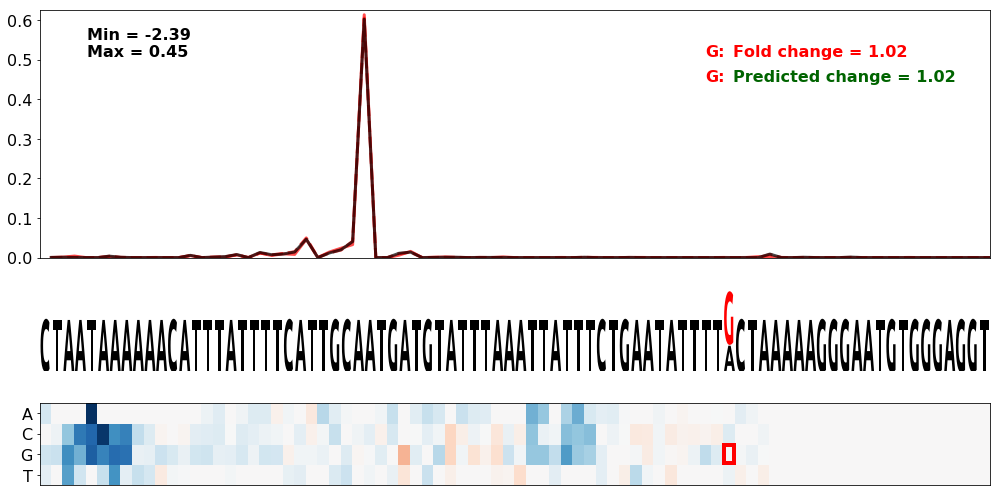

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 110
SNV nt = G
0.8097446825109856
0.8084572825791675
0.8097446825109856
0.810331359504928


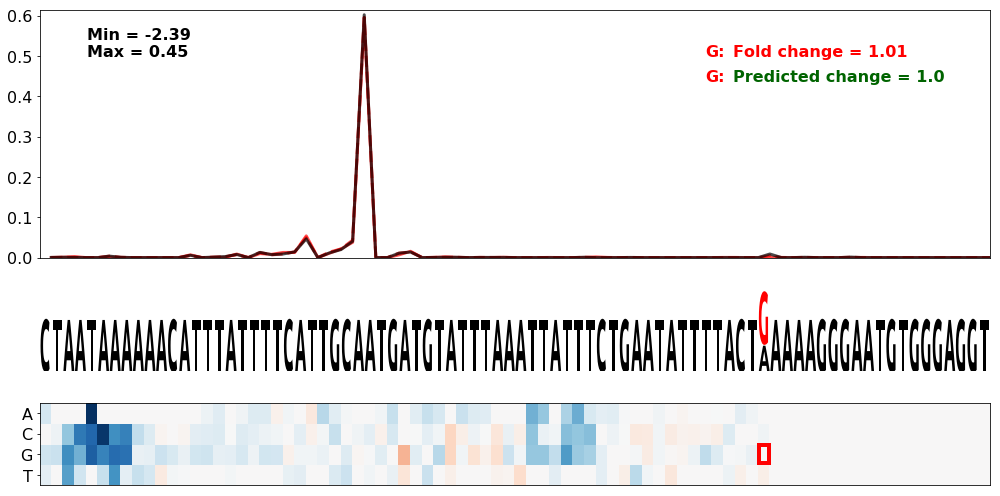

Gene = SMAD4.1
WT seq = AAAAAATAGTCGAACCTTTCTTGAGAACTCTGTAACAAAGTATGTTTTTGATTAAAAGAGAAAGCCAACTAAATCATTATGTGCTCATTCTTTTTCTTAAGCTTGTGGATGTCTTGGATCTGGAAAGGGTTTCTGATCACTTAGAGAATTTTCAAACTTTAGGT
SNV pos = 67
SNV nt = T
0.6973111740337841
0.6930968002983109
0.6973111740337841
0.7147106989268865


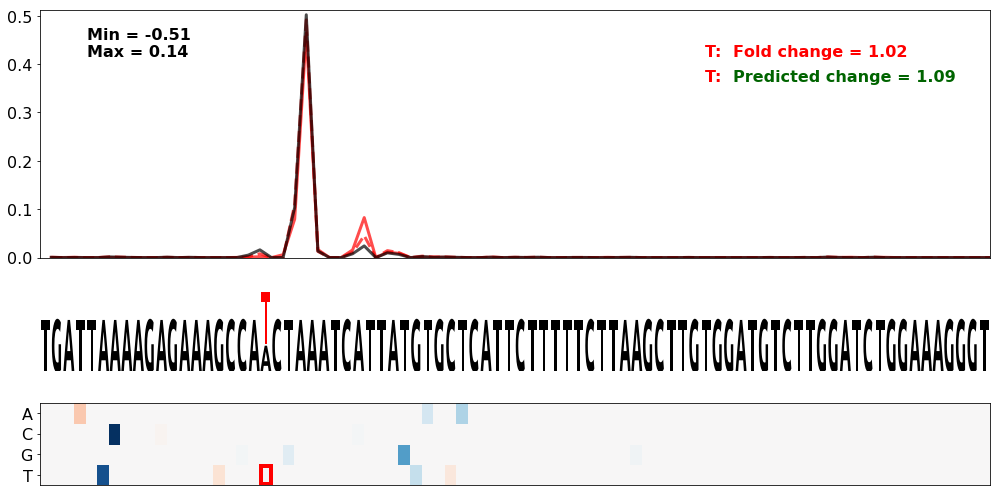

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 90
SNV nt = C
0.08781012845006006
0.07264511511270566
0.08781012845006006
0.07976127542512818


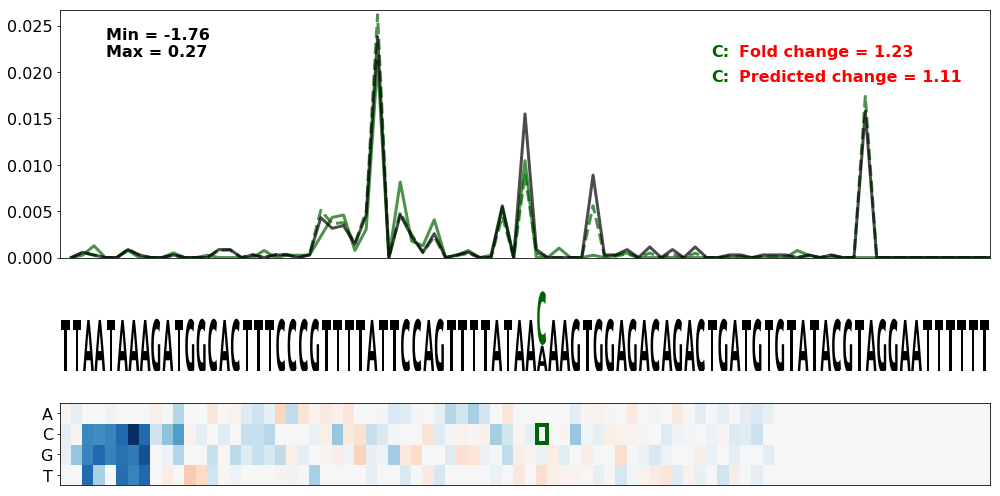

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 109
SNV nt = C
0.8097446825109856
0.8144228464253825
0.8097446825109856
0.7987181226352501


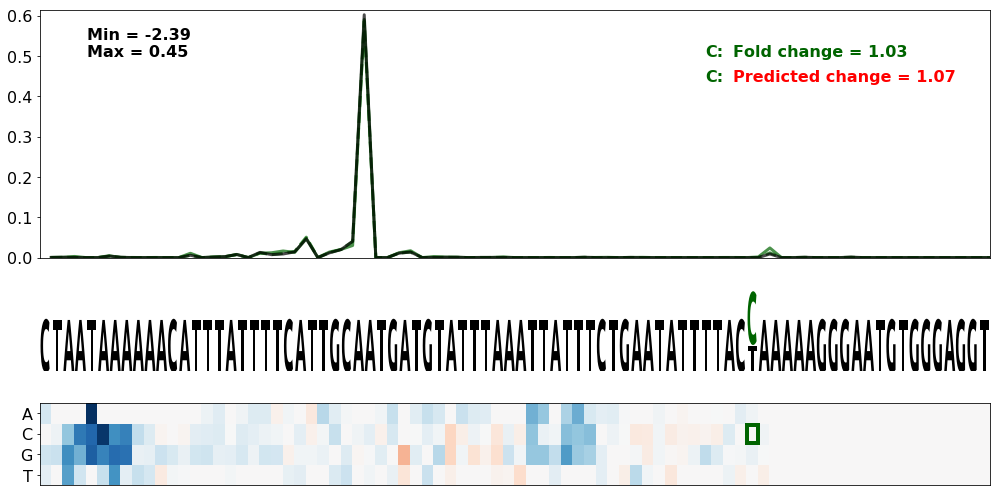

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = C
0.08781012845006006
0.07696387216461914
0.08781012845006006
0.0882216023847492


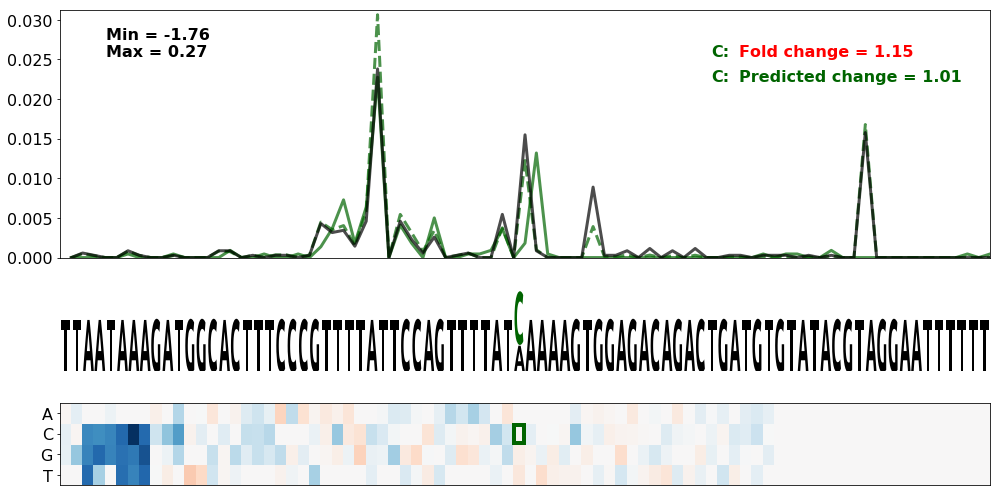

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 72
SNV nt = C
0.1485146363824651
0.14370500732263652
0.1485146363824651
0.15007755179841992


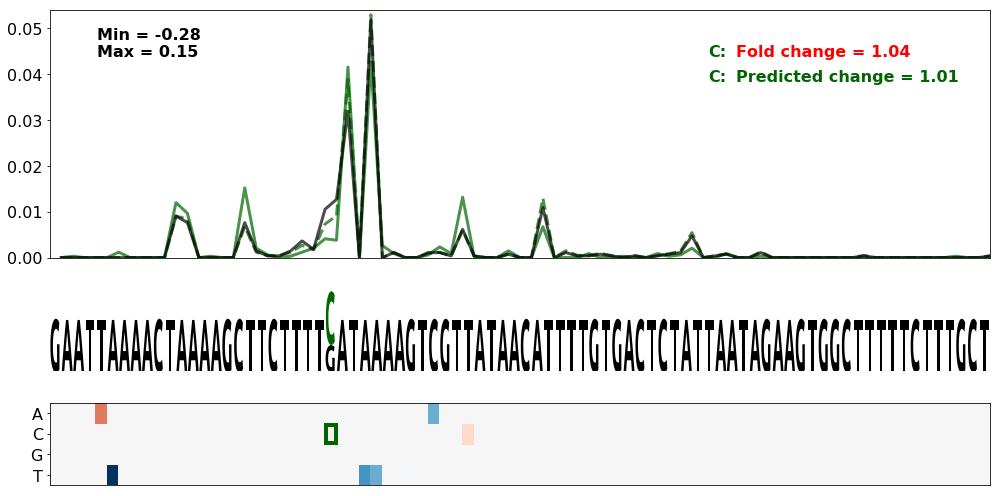

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 89
SNV nt = G
0.08781012845006006
0.07348552319024723
0.08781012845006006
0.08106086095182158


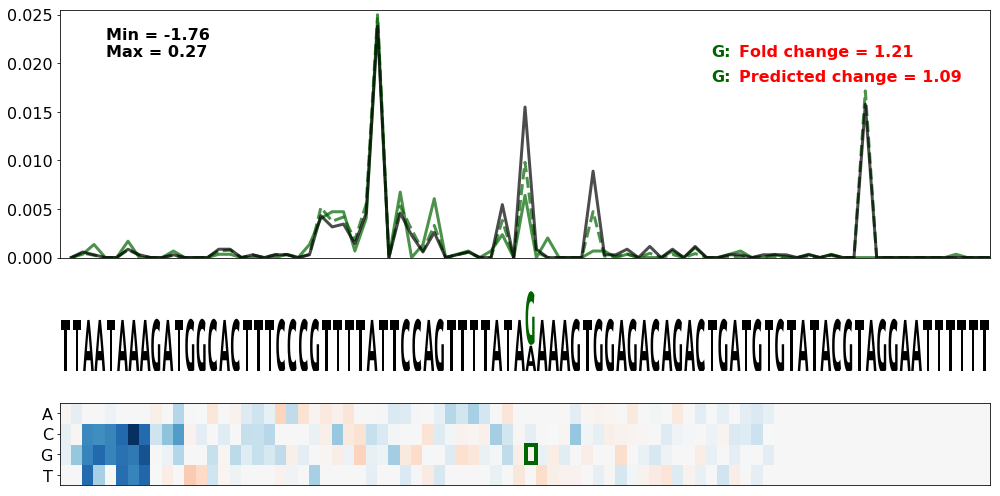

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 85
SNV nt = C
0.08781012845006006
0.08529366027816303
0.08781012845006006
0.10461340916356636


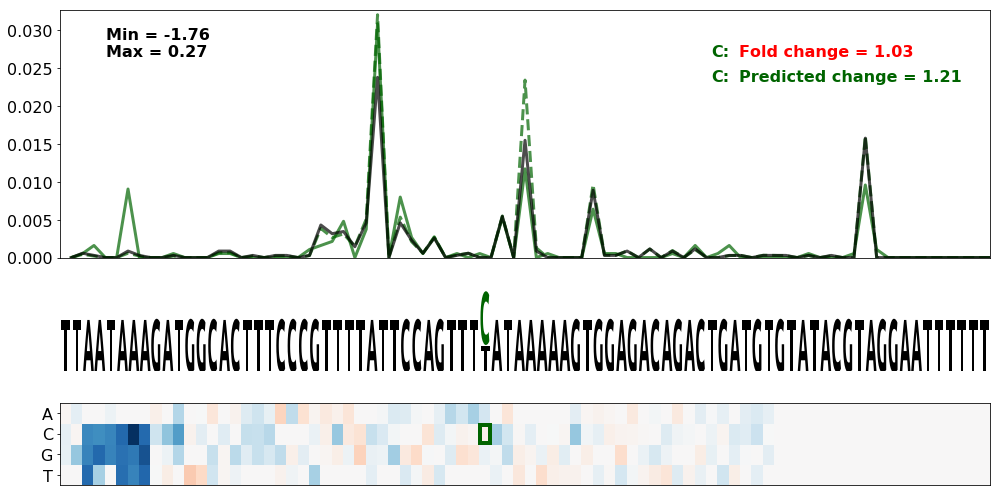

Gene = BRCA1.3
WT seq = GGTCCTTAATGCCAGAAATGGGAATTGCTTCATACTGTGGAAAAATACCCATTAAAATATTAAGACCAGTAAAACCTCGTTTCTGCTTGGGCTATTTGTGGATTTCAGACATCCTGAGAAGTTTACCACCCCTGTAATTAATTGTCATTGTCATCACTTCATAA
SNV pos = 69
SNV nt = C
0.23615003981867355
0.25951757749023385
0.23615003981867355
0.33001225616253277


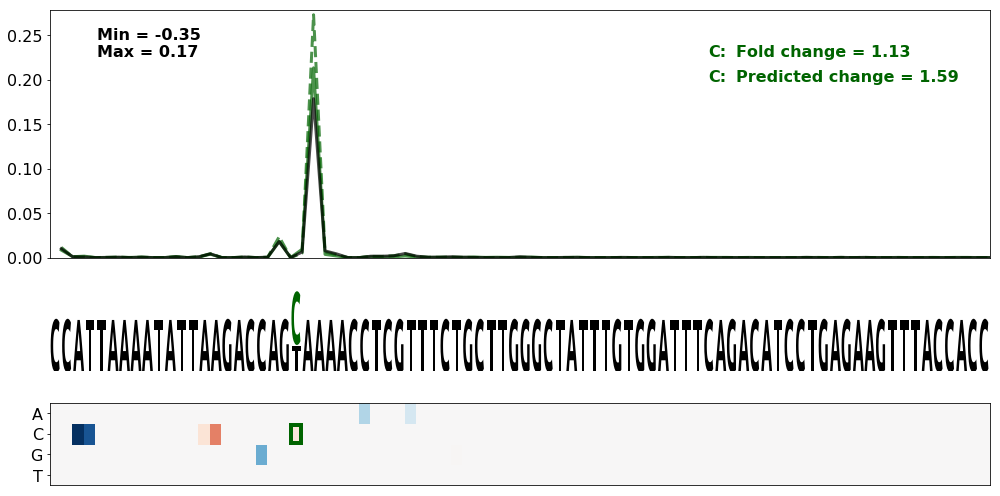

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = G
0.08781012845006006
0.07504514380791744
0.08781012845006006
0.08484099744508565


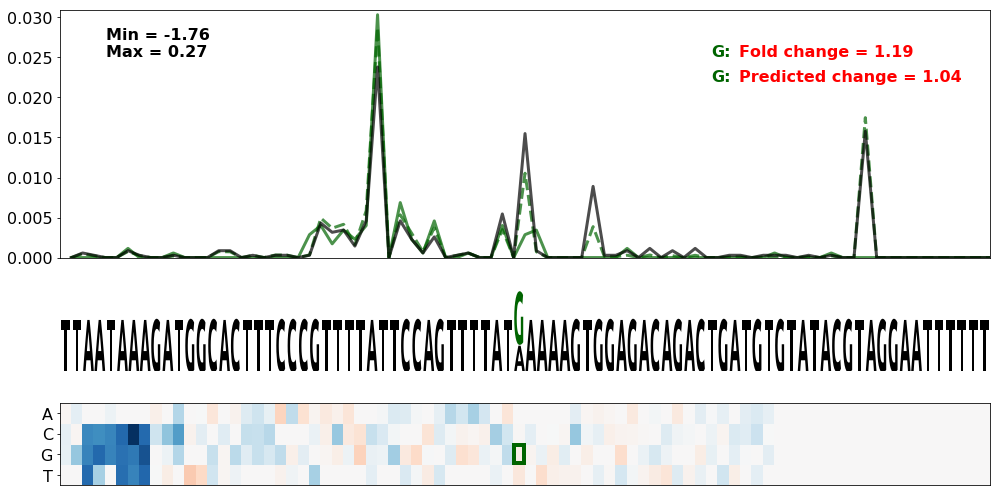

Gene = MKKS.4
WT seq = GTAAAATTTCAGTCTCAAAGCAAACAAAAGAGTATTGAAGAGTGAAGTAAAATAAATATTTGGAATTACTAATTTGTCATTAAATCATTCTATGCTGATTAGCTTCATAAACATTGAACTTTTTGATTTTATAGCCACAATGCTGCATATTCATACTTTAATTC
SNV pos = 106
SNV nt = G
0.31088537165951813
0.36276286235105343
0.31088537165951813
0.3261896089654329


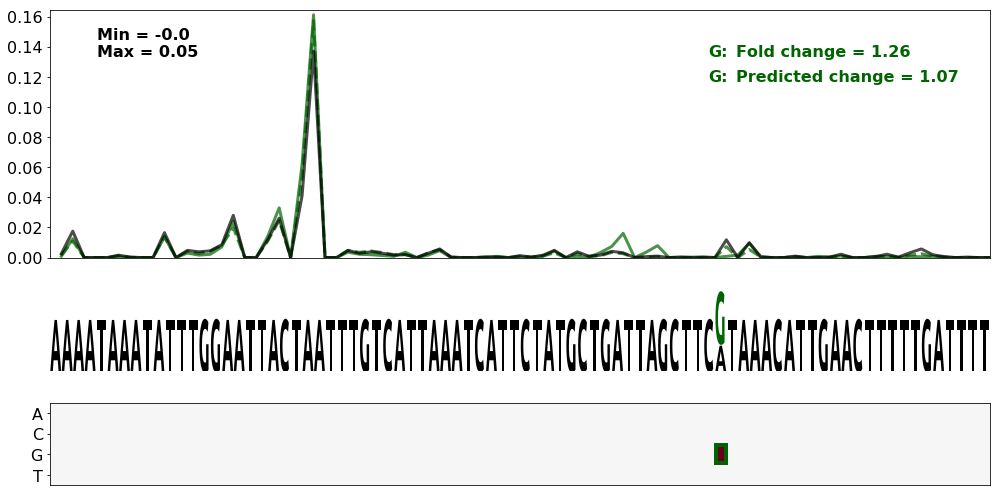

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 108
SNV nt = T
0.8097446825109856
0.8355341510980198
0.8097446825109856
0.7591396372931258


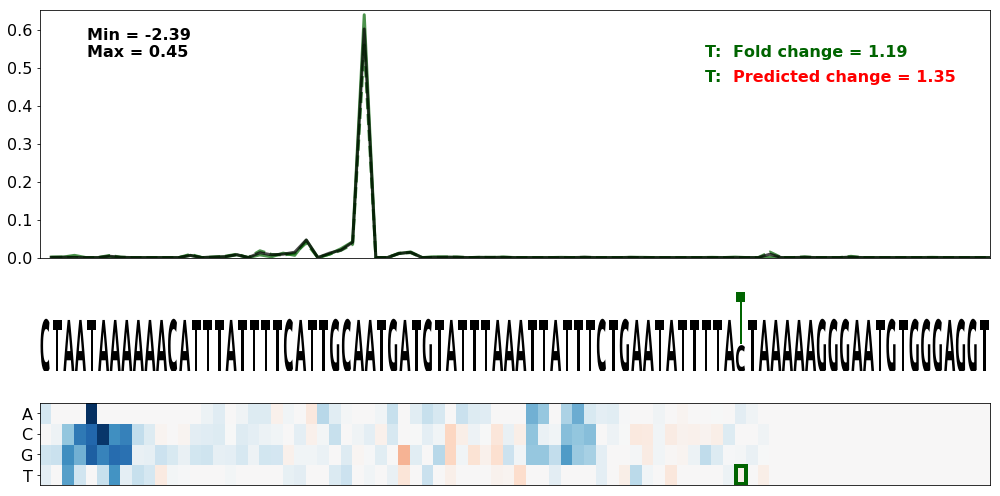

Gene = HBB.1
WT seq = TACTAAACTGGGGGATATTATGAAGGGCCTTGAGCATCTGGATTCTGCCTAATAAAAAACATTTATTTTCATTGCAATGATGTATTTAAATTATTTCTGAATATTTTACTAAAAAGGGAATGTGGGAGGTCAGTGCATTTAAAACATAAAGAAATGAAGAGCTA
SNV pos = 110
SNV nt = T
0.8097446825109856
0.8388415697656826
0.8097446825109856
0.8019562313122639


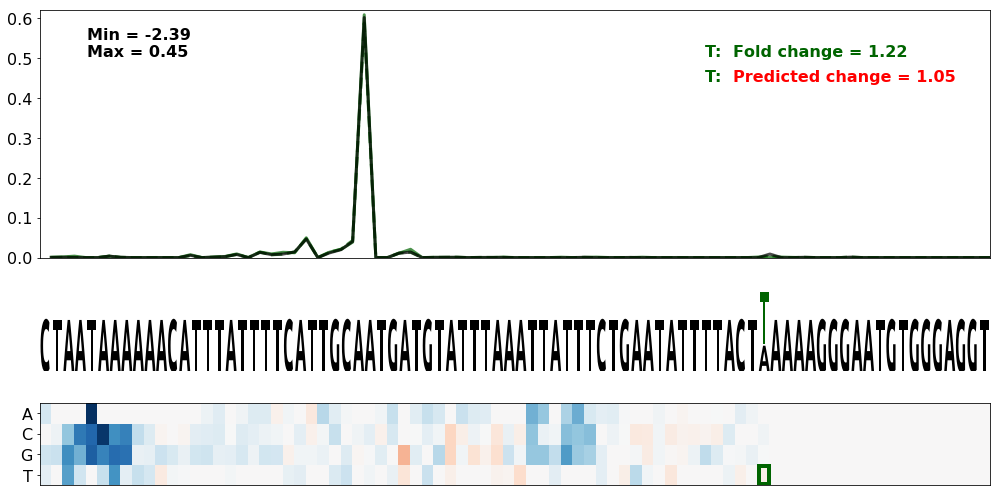

Gene = BMPR1A.2
WT seq = AAAGAAGGGTAAAAGCAAGCAGTTTTATCAGGCAGTTGTAAAACACCAAAAATATAGATTCGTCTTTGACGTGTAACACACTAAATGTATTTTGTACAGCATCTGGTTTAAAAGGTGCCTTAAGAGTTTACCATTACTTGCTTTGTTCTATATACAGATTATGT
SNV pos = 79
SNV nt = C
0.02737037163775816
0.03422841794505856
0.02737037163775816
0.03287672877500382


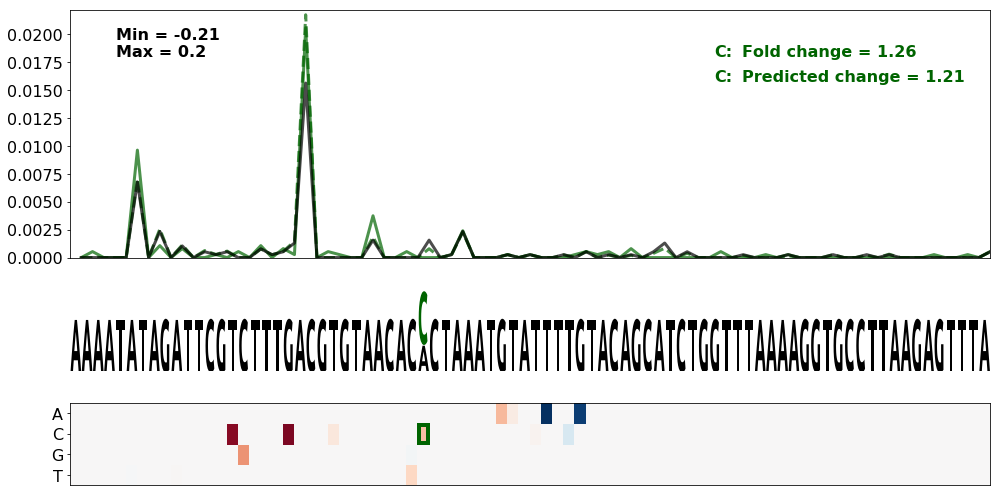

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = T
0.08781012845006006
0.08550393520111667
0.08781012845006006
0.07639493455781826


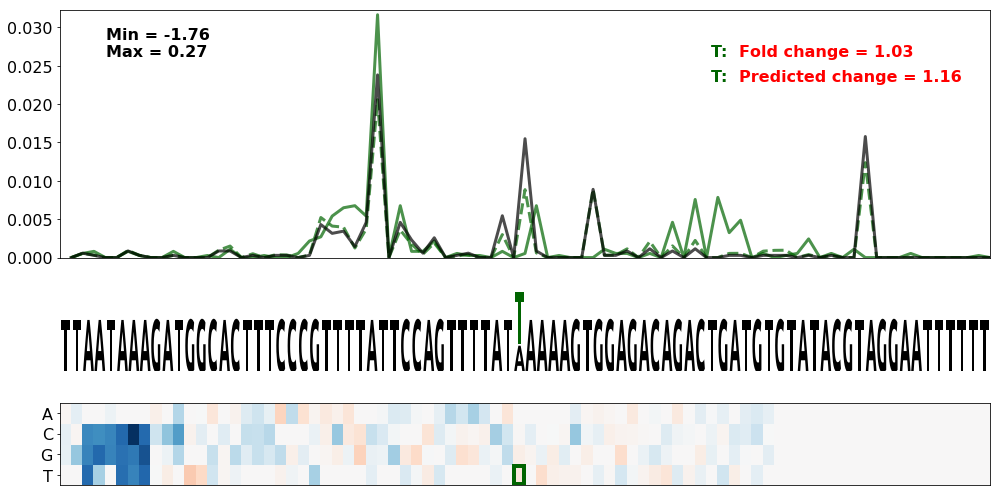

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 87
SNV nt = A
0.08781012845006006
0.09177800364046967
0.08781012845006006
0.10044343139909176


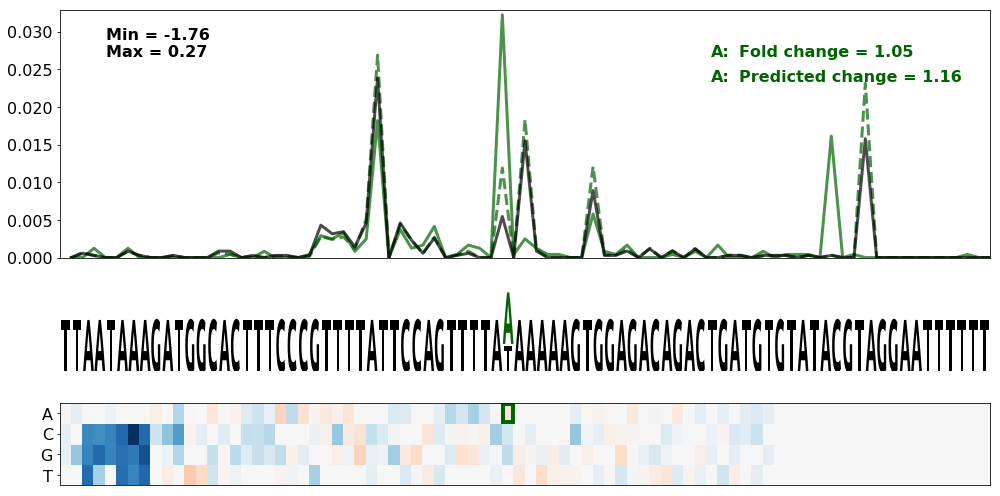

Gene = PMS2.2
WT seq = CTGCTCTGGCTGGACATAGTTTAGTCTATAACTTTCAACCCTTAATGATAATTAAATTCATCTTTGTTTAATTTCATAAATTTAAAAGTAGGGTCCTTTTCAGTTAGTGATTCTCAGCCCTGATTCACATTAAATTTTTAAACACGGGGGATTCTCTGCCCGGC
SNV pos = 75
SNV nt = T
0.054291706165778664
0.06721255587745967
0.054291706165778664
0.05896861196499205


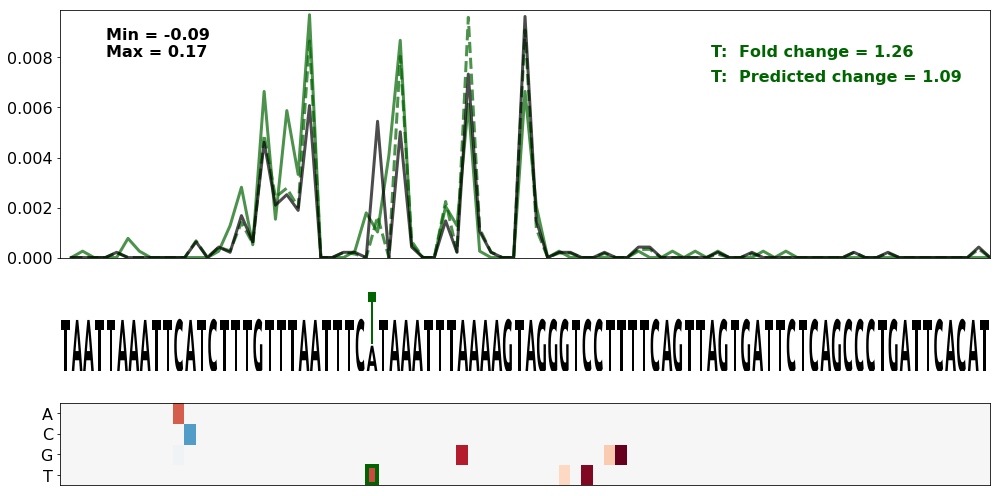

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 90
SNV nt = T
0.08781012845006006
0.09444705998179528
0.08781012845006006
0.08201497111654961


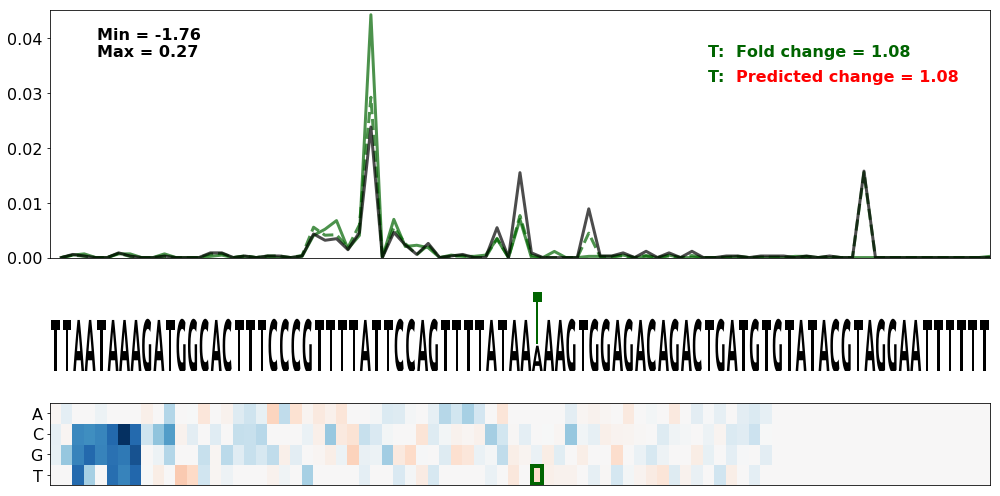

Gene = TPM1.20
WT seq = AACCCTCTGCTGAGTAACCAAGCCTTTAATTTTGTGTTTTTATGAAAGGAATTAAAATACCCACGATAAATATTTACCACAACCTGTGTCAAATAAATGGGAAATTAAACACAGATTGTACAATGTGAGCTTGGGAGTTAATGGCCCAGATTTTACTGTTAGGC
SNV pos = 66
SNV nt = A
0.07400056252489318
0.11753054778440501
0.07400056252489318
0.0861390406383785


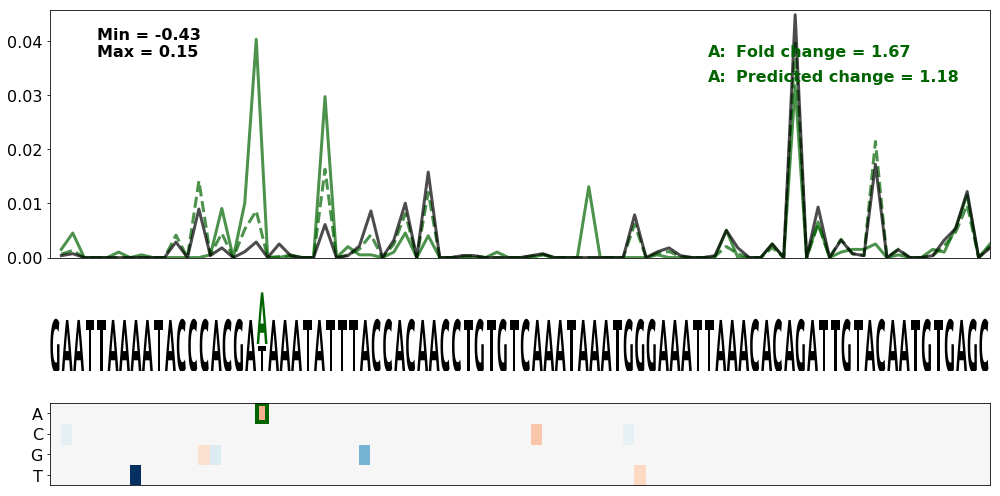

Gene = MET.2
WT seq = ACTTGTCACTGCCTATACCTGCAGCTGAACTGAATGGTACTTCGTATGTTAATAGTTGTTCTGATAAATCATGCAATTAAAGTAAAGTGATGCAACATCTTGTATACTGATAGTGGTTATTGCCAGTCATGCTTGATTACCTGCATTTGCATAATGATAGAGGA
SNV pos = 81
SNV nt = A
0.37823106022010544
0.15432782303544368
0.37823106022010544
0.3748414063249017


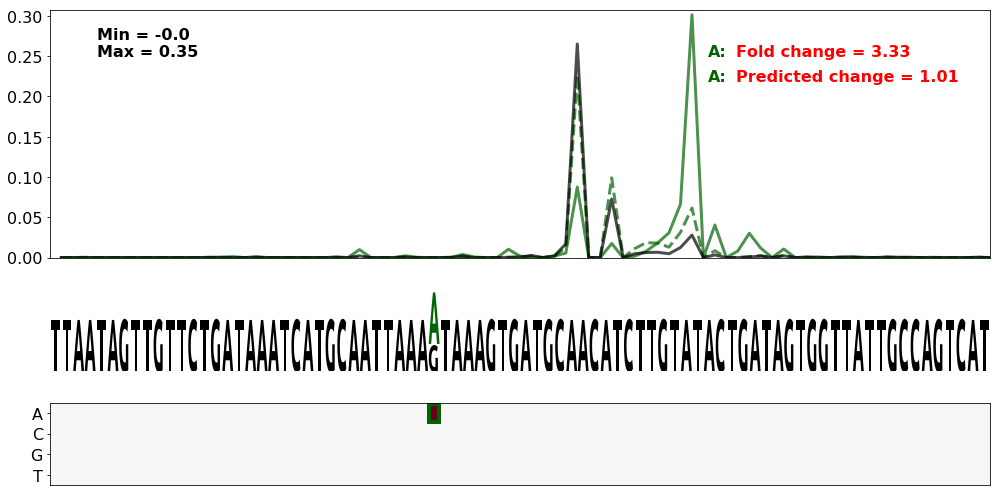

In [235]:

df_sel = loss_of_motif_df.query("snv_pos >= 57").sort_values(by='delta_logodds_true')
#and delta_logodds_true < 0.0

seq_start = 48
seq_end = 130#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Loss of cryptic competing CSE:
Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 75
SNV nt = T
ClinVar id = Missing
Observed:


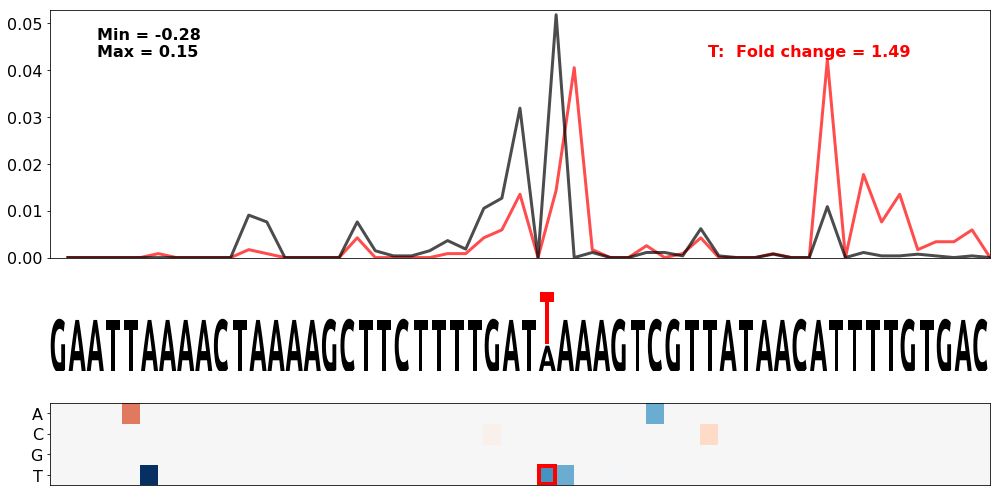

Predicted:


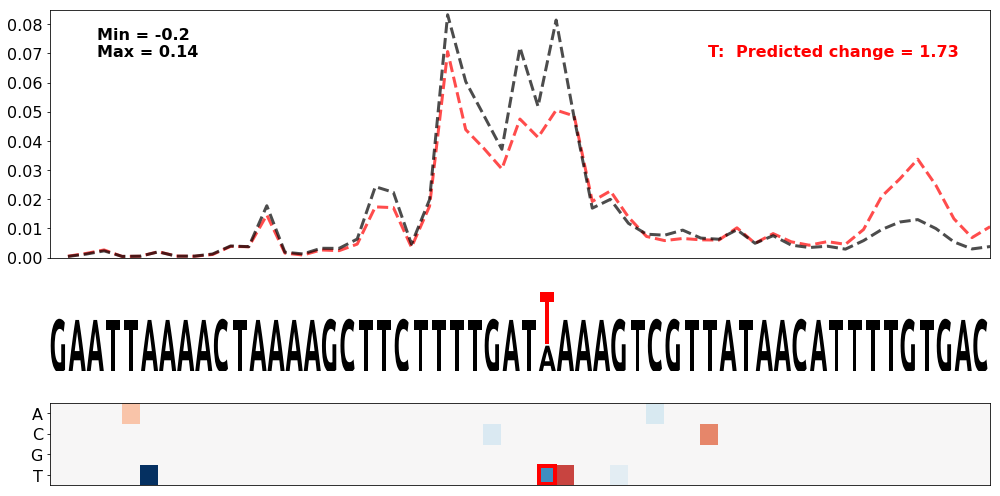

Both:


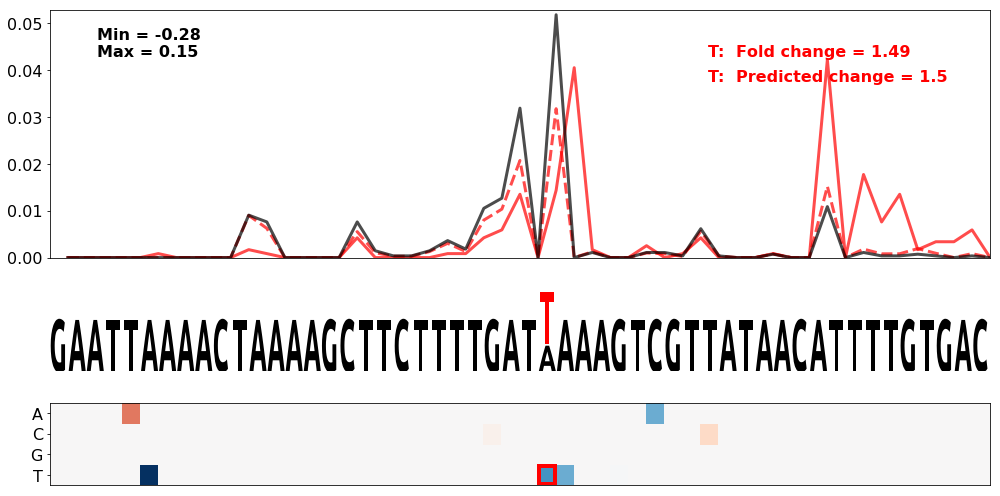

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 76
SNV nt = T
ClinVar id = Missing
Observed:


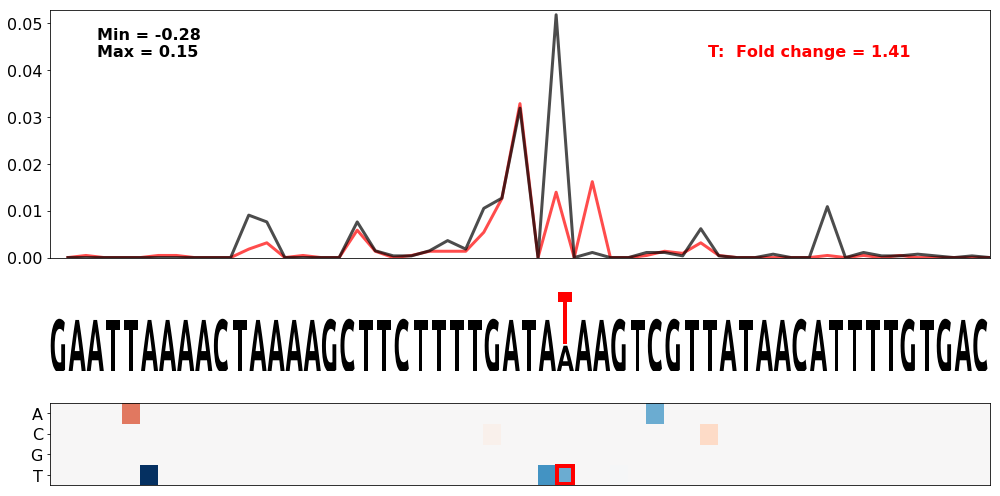

Predicted:


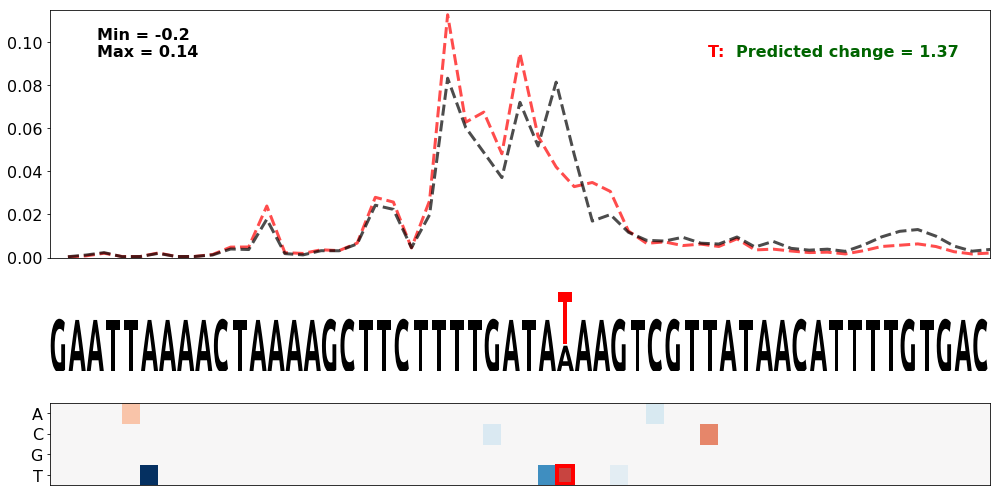

Both:


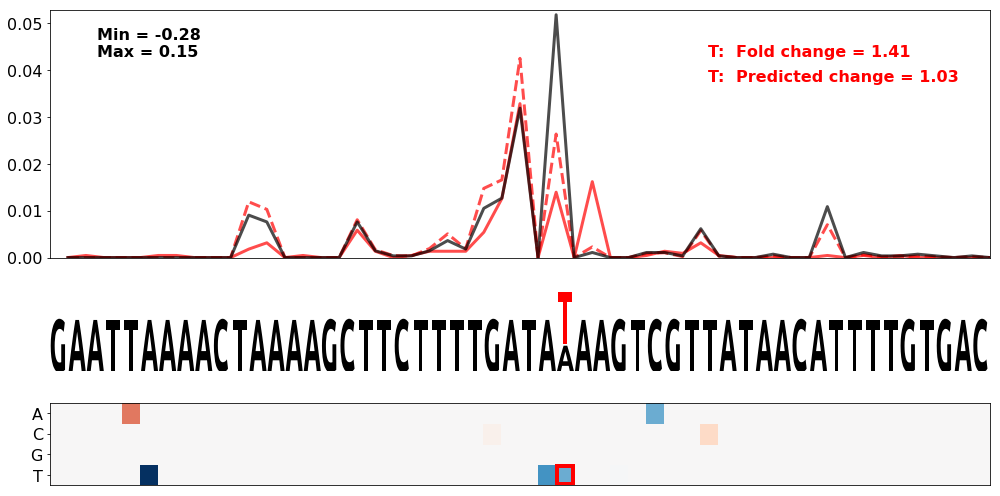

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 89
SNV nt = C
ClinVar id = Missing
Observed:


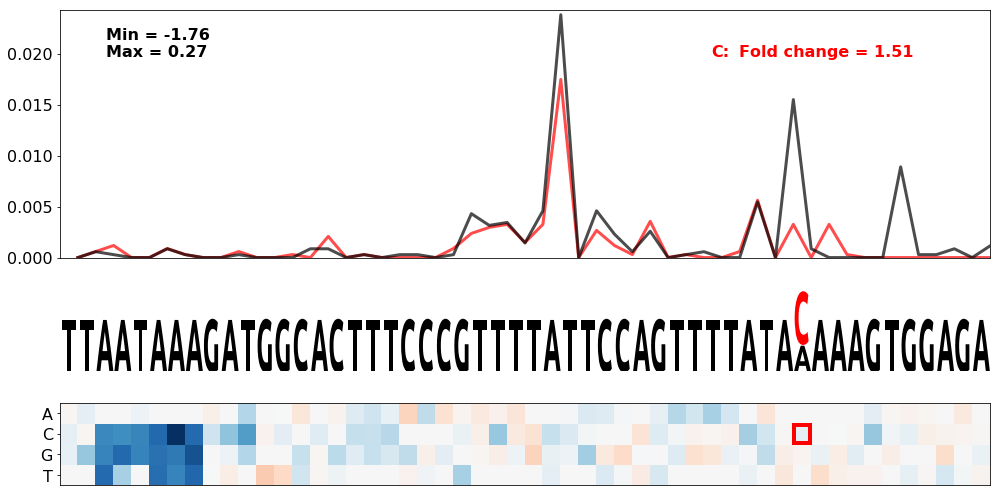

Predicted:


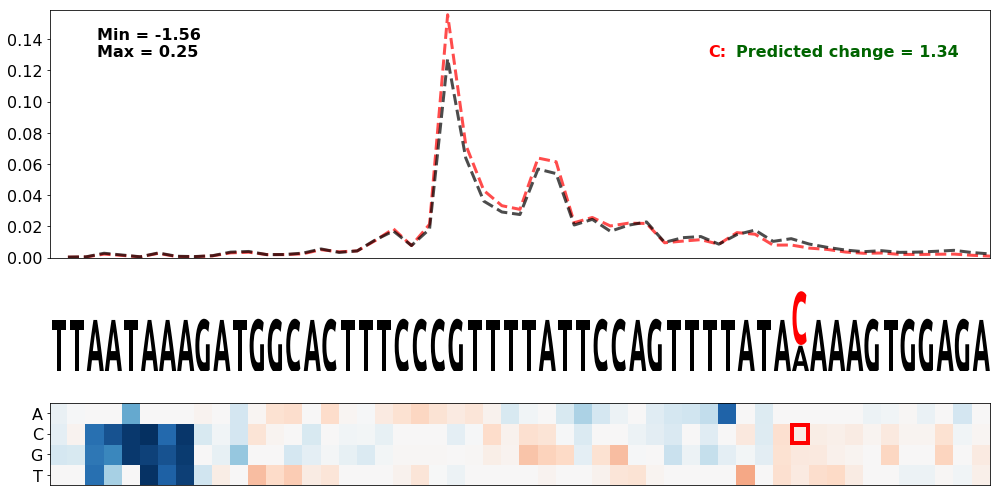

Both:


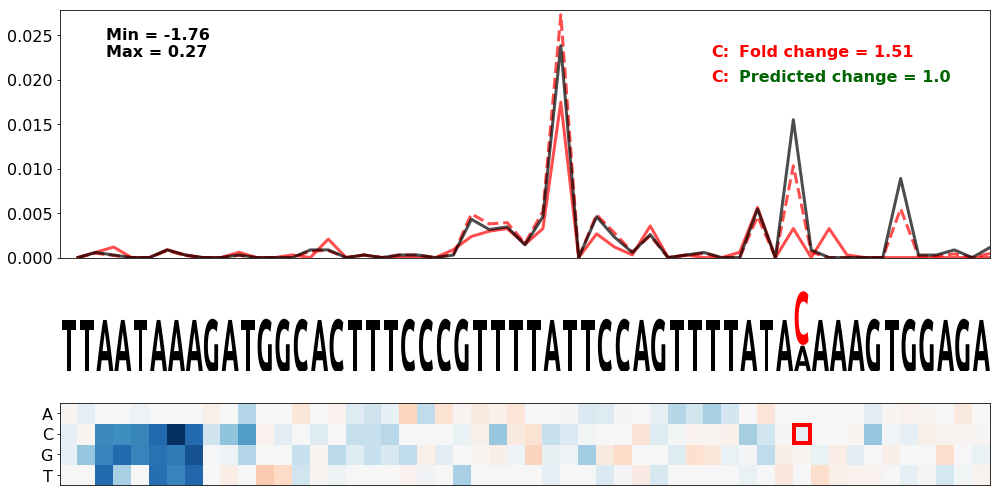

Gene = TMEM43.11
WT seq = AGTGAATTTGAGAATTAAATAATACTTGTAAAACACTTAGGACAGTATCAAATAAATGGTGAGTGATAAATGTGACCTGTTTTTGTTGTTACGGACTCTGAGAGAGGGCCCGATTCAGATCAGAGGGTCAGGGAAAGCCCTCTGAAGAAATGGGGTTCAAGCAA
SNV pos = 68
SNV nt = C
ClinVar id = Missing
Observed:


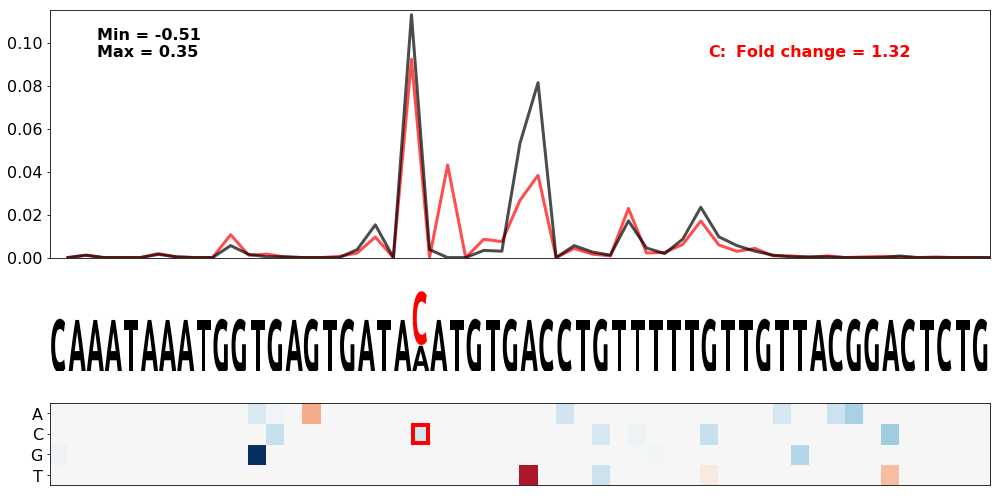

Predicted:


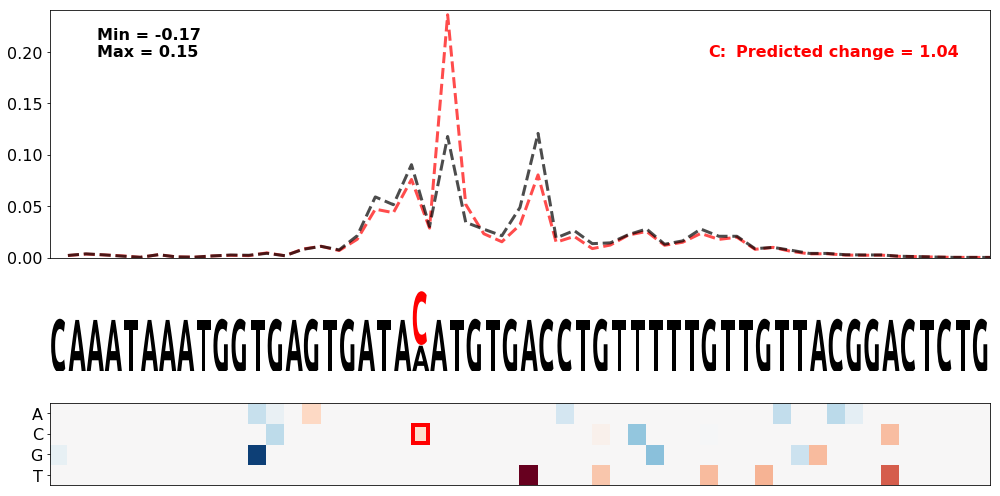

Both:


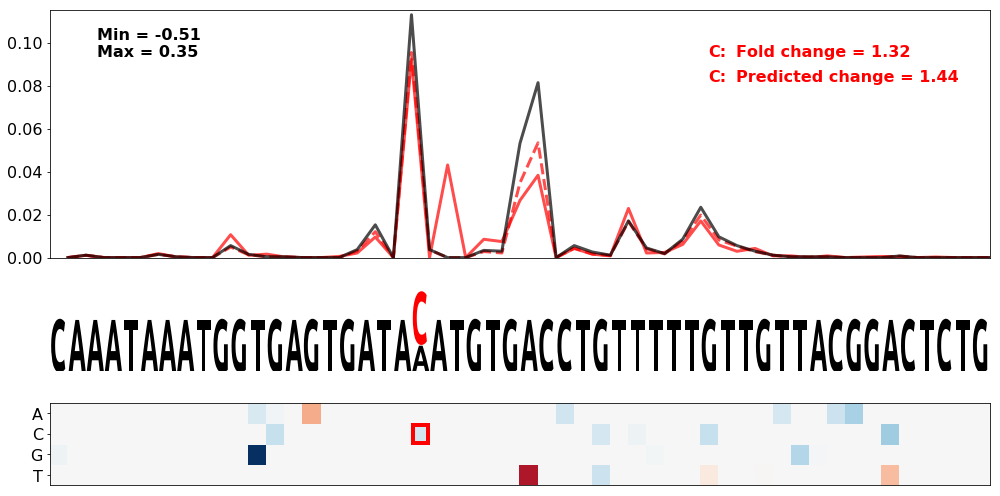

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = G
ClinVar id = Missing
Observed:


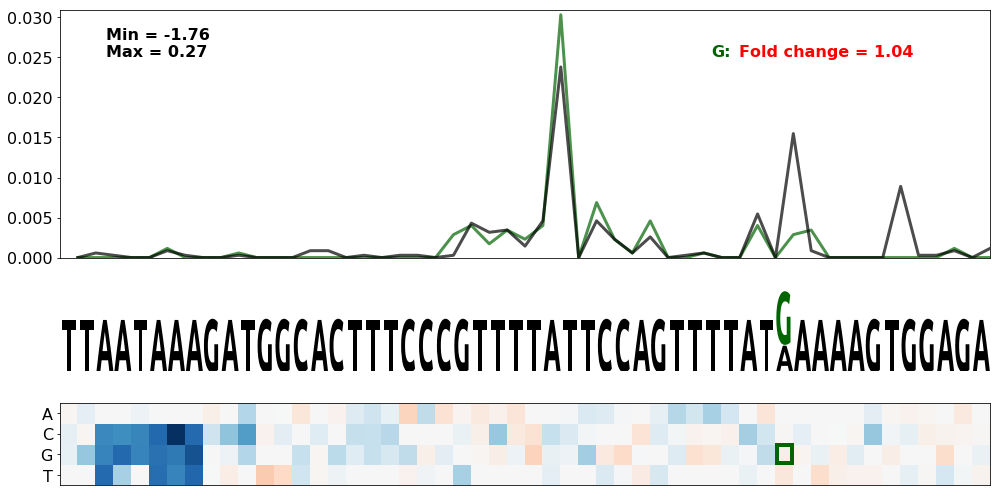

Predicted:


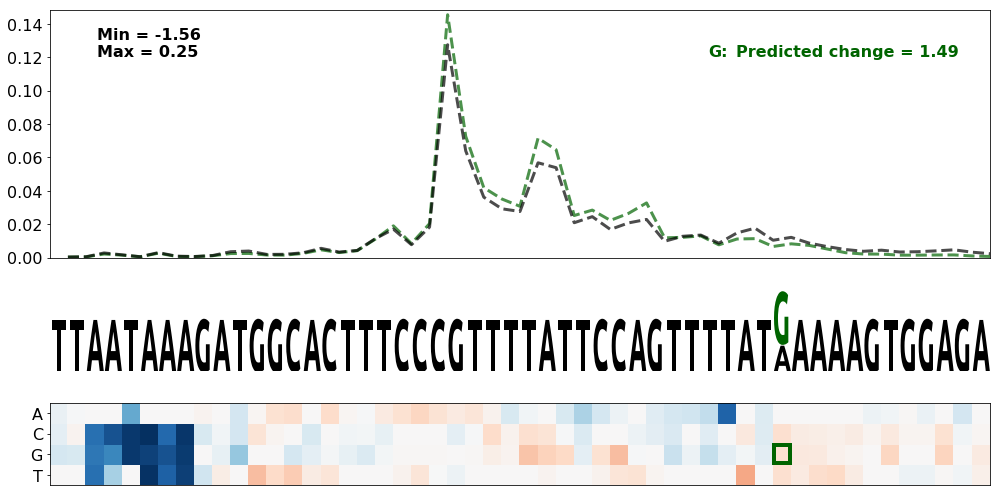

Both:


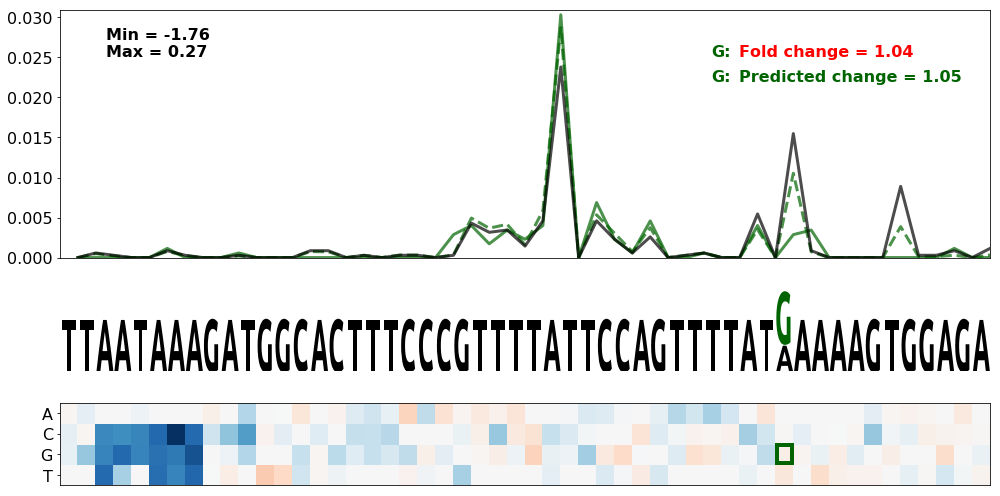

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 88
SNV nt = T
ClinVar id = Missing
Observed:


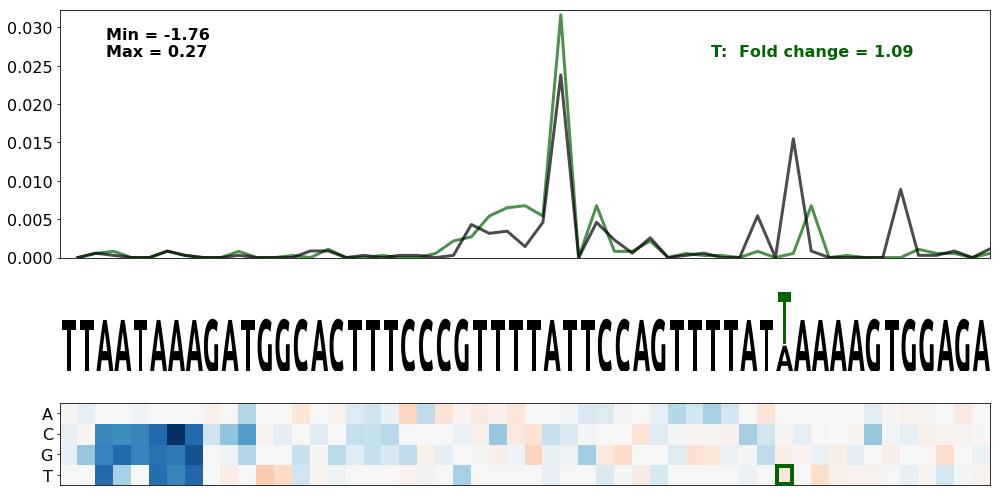

Predicted:


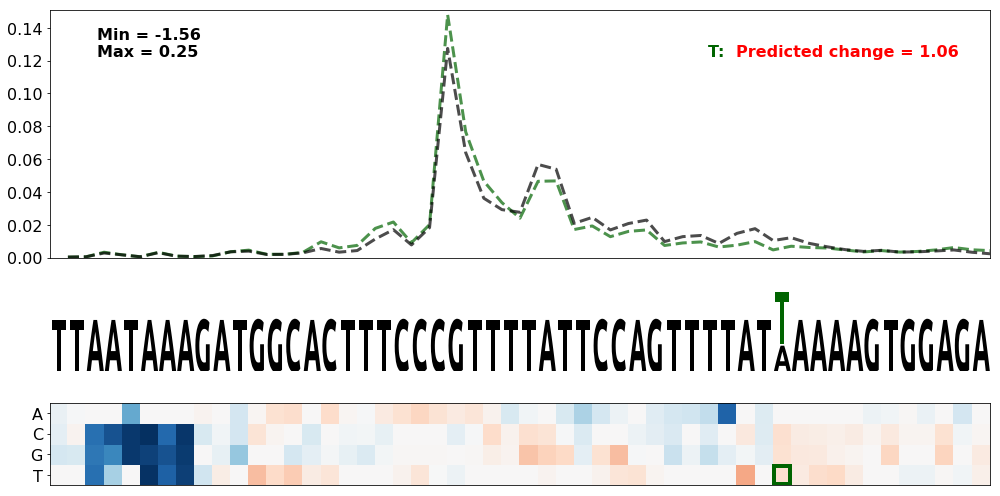

Both:


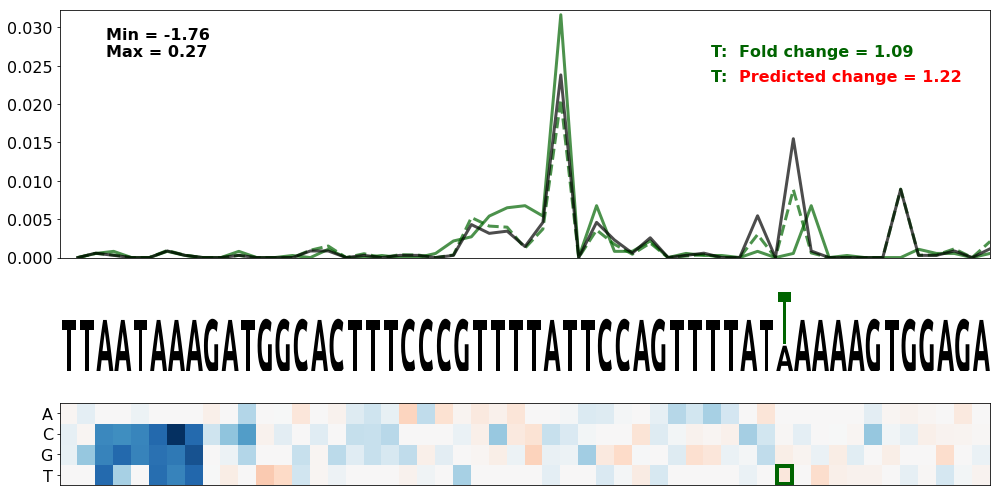

Gene = PTEN.15
WT seq = ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA
SNV pos = 87
SNV nt = A
ClinVar id = Missing
Observed:


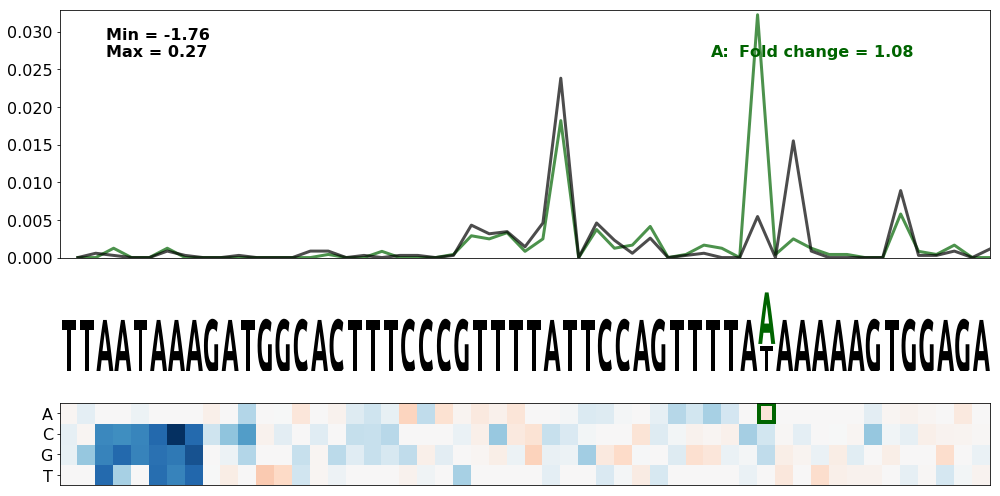

Predicted:


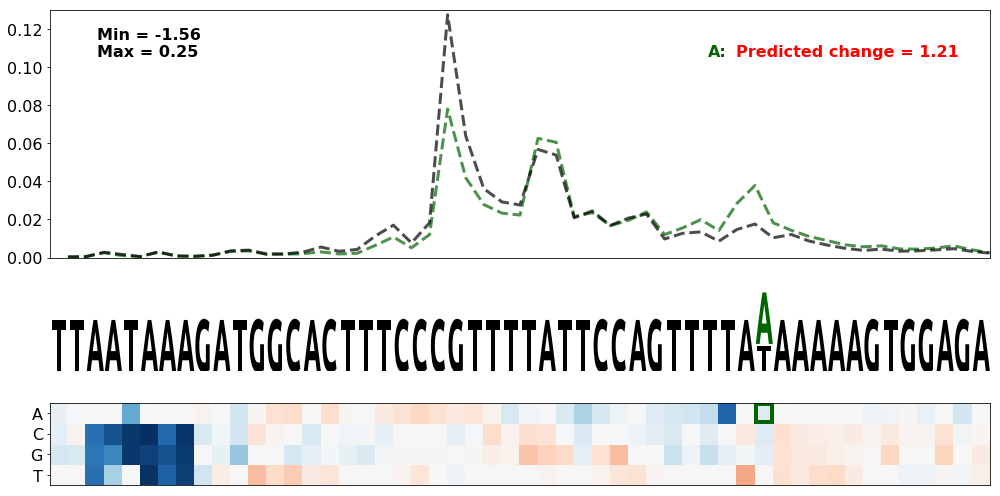

Both:


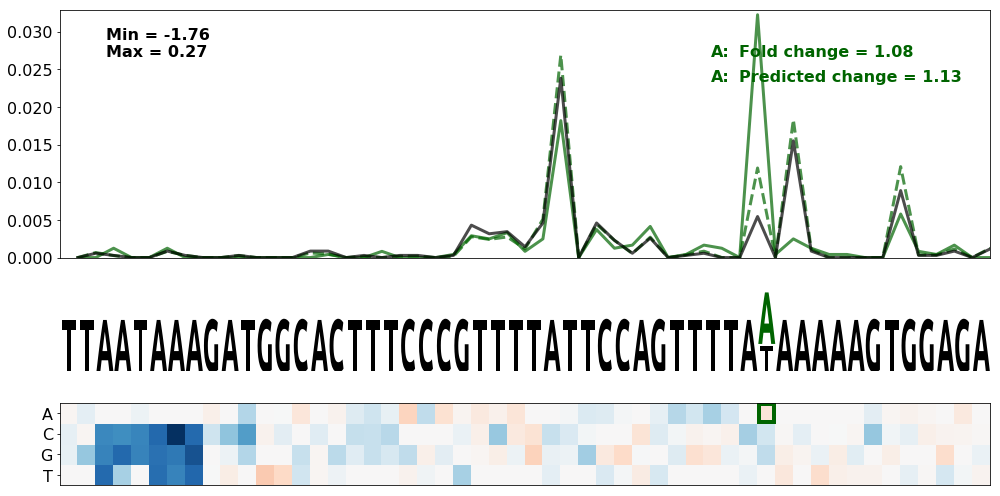

Gene = TPM1.20
WT seq = AACCCTCTGCTGAGTAACCAAGCCTTTAATTTTGTGTTTTTATGAAAGGAATTAAAATACCCACGATAAATATTTACCACAACCTGTGTCAAATAAATGGGAAATTAAACACAGATTGTACAATGTGAGCTTGGGAGTTAATGGCCCAGATTTTACTGTTAGGC
SNV pos = 66
SNV nt = A
ClinVar id = Missing
Observed:


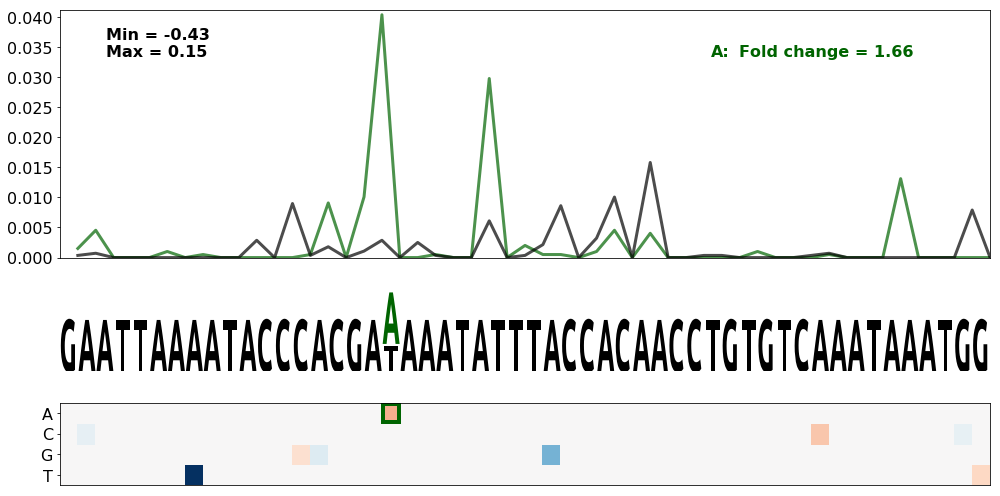

Predicted:


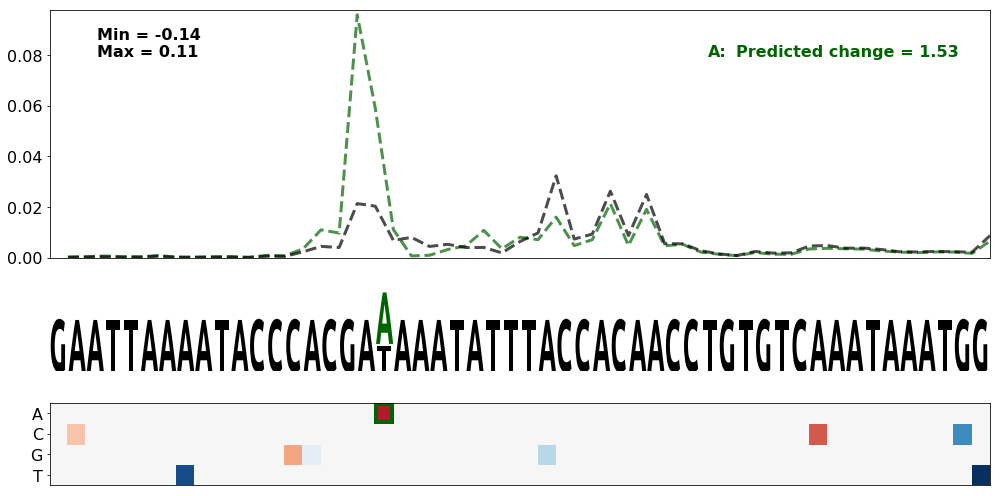

Both:


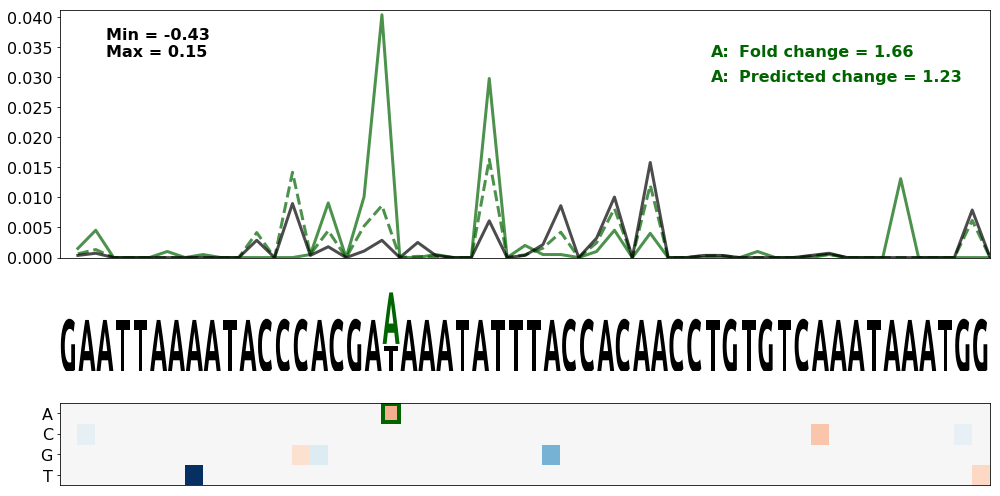

In [26]:
print('Loss of cryptic competing CSE:')

experiment_name = 'loss_of_cryptic_cse'

gene_names = [
    'SMAD4.1',
    'SMAD4.1',
    'PTEN.15',
    'TMEM43.11',
    'PTEN.15',
    'PTEN.15',
    'PTEN.15',
    'TPM1.20'
]

snv_list = [
    [(75, 'T', 'red')],
    [(76, 'T', 'red')],
    [(89, 'C', 'red')],
    [(68, 'C', 'red')],
    [(88, 'G', 'darkgreen')],
    [(88, 'T', 'darkgreen')],
    [(87, 'A', 'darkgreen')],
    [(66, 'A', 'darkgreen')]
]

wt_seq_list = [
    'AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT',
    'AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT',
    'ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA',
    'AGTGAATTTGAGAATTAAATAATACTTGTAAAACACTTAGGACAGTATCAAATAAATGGTGAGTGATAAATGTGACCTGTTTTTGTTGTTACGGACTCTGAGAGAGGGCCCGATTCAGATCAGAGGGTCAGGGAAAGCCCTCTGAAGAAATGGGGTTCAAGCAA',
    'ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA',
    'ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA',
    'ATGTATATACCTTTTTGTGTCAAAAGGACATTTAAAATTCAATTAGGATTAATAAAGATGGCACTTTCCCGTTTTATTCCAGTTTTATAAAAAGTGGAGACAGACTGATGTGTATACGTAGGAATTTTTTCCTTTTGTGTTCTGTCACCAACTGAAGTGGCTAA',
    'AACCCTCTGCTGAGTAACCAAGCCTTTAATTTTGTGTTTTTATGAAAGGAATTAAAATACCCACGATAAATATTTACCACAACCTGTGTCAAATAAATGGGAAATTAAACACAGATTGTACAATGTGAGCTTGGGAGTTAATGGCCCAGATTTTACTGTTAGGC'
]

seq_start = 48
seq_end = 100

save_figs = True

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

Gain of cryptic competing CSE:
Gene = PTEN.24
WT seq = GAGTTAAGTAATTTCACTGAAATTGATTGCTTTTTGTGTCTTGGAGTCAAAATAAATAACTGAAATCTACTATACTTGGCTCATGCTTAATTAATATACTTAGACCATATTTCGGATGAATTATTCACAGAATCTAAAGGAGTATCCTCGTGTTCTTACCTTCT
SNV pos = 72
SNV nt = A
ClinVar id = Missing
Observed:


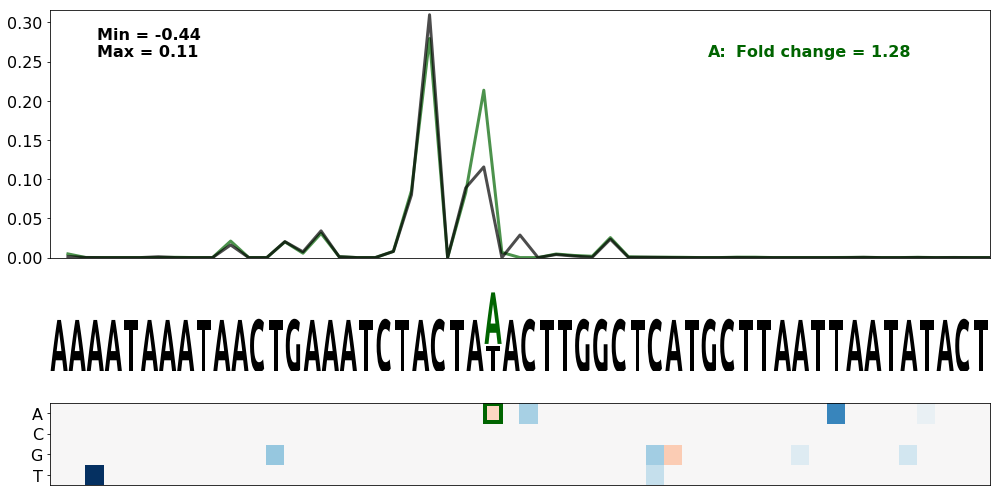

Predicted:


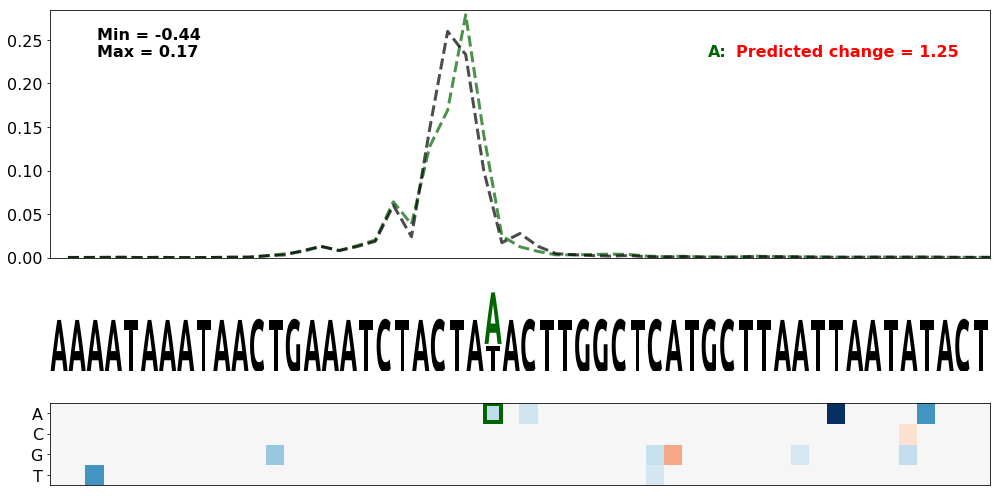

Both:


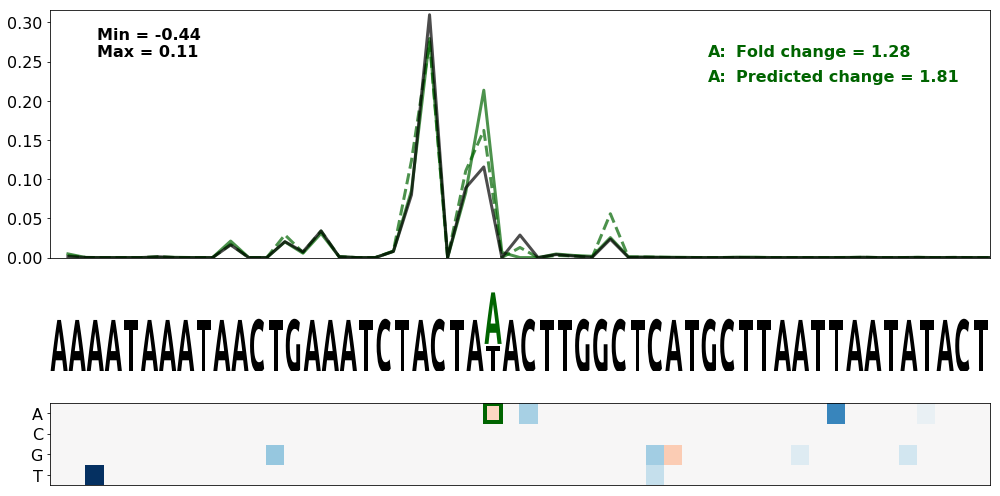

Gene = DOCK8.2
WT seq = ATTTGAGAATTAAATTATATATTTTTAATATGACTGTGACCTTGACTGATAATAAAGATGTAATAAGAATTGCAAGCTAAATGTTTCCCTTTGCAACTCATGCTTTGTGTTTTGTTTTGATGACCTACTCGCTCGTAATGTTTTGTAAGGCACTTCAGAGAGAA
SNV pos = 75
SNV nt = A
ClinVar id = NM_203447.3(DOCK8):c.*1031G>A
Observed:


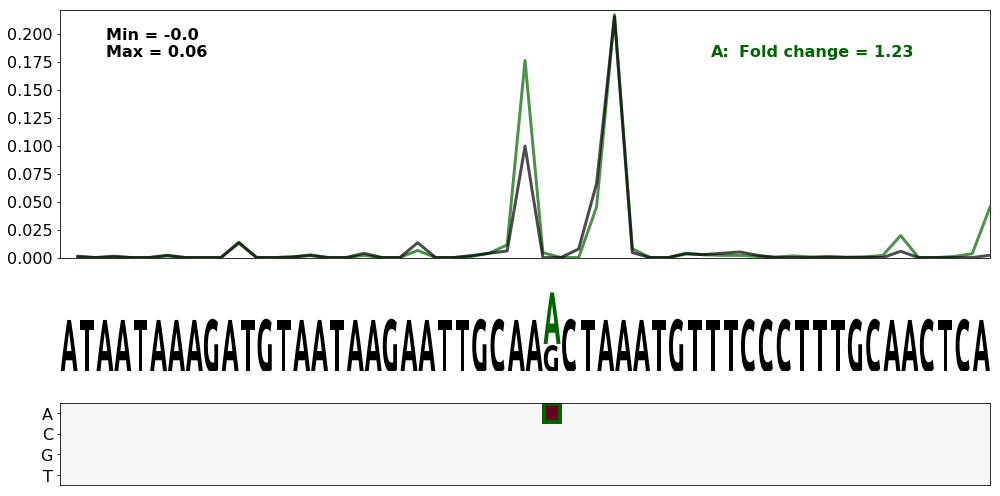

Predicted:


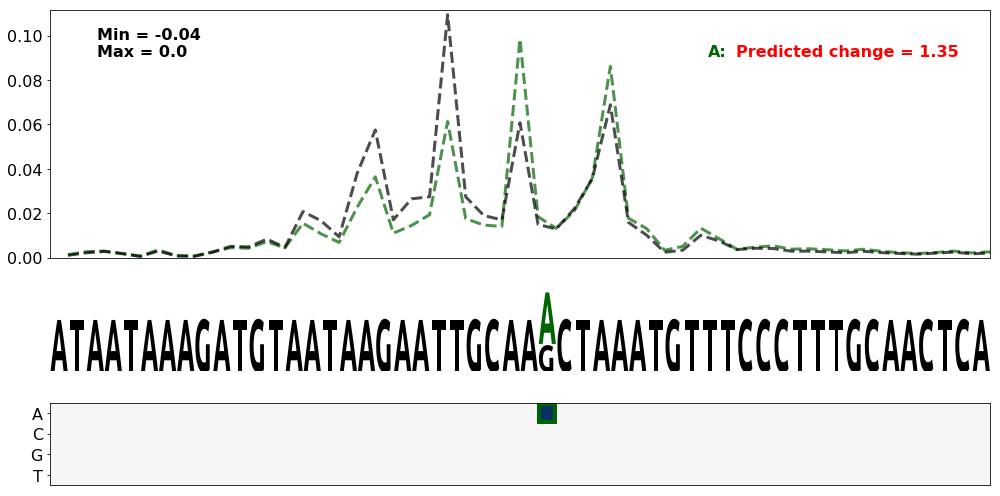

Both:


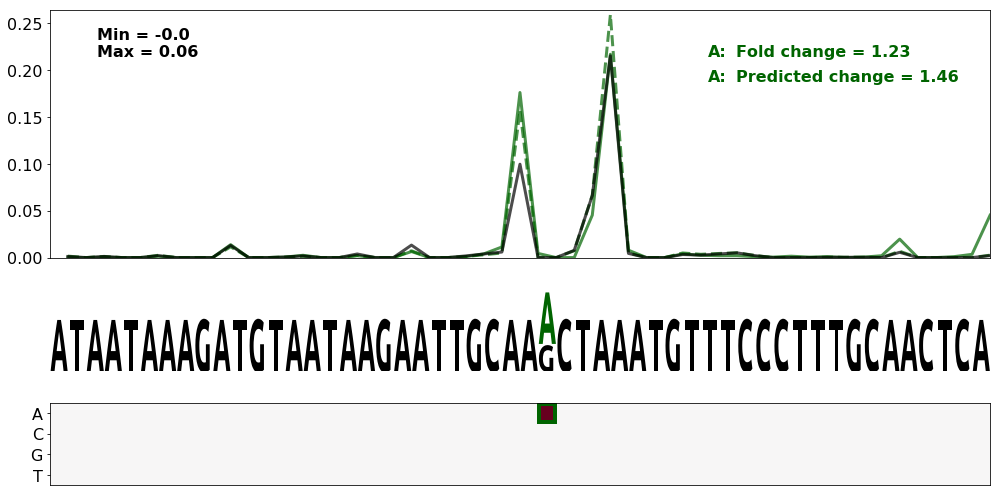

Gene = SMAD4.1
WT seq = AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT
SNV pos = 72
SNV nt = C
ClinVar id = Missing
Observed:


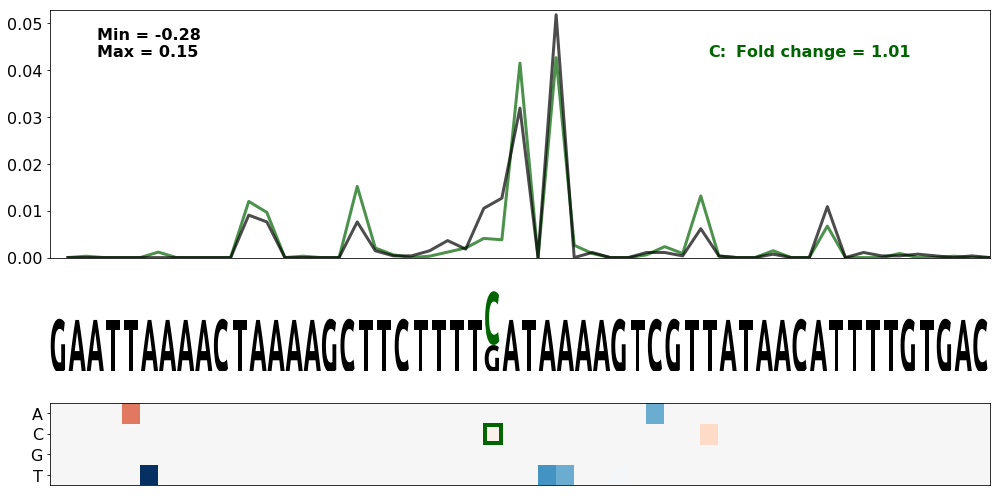

Predicted:


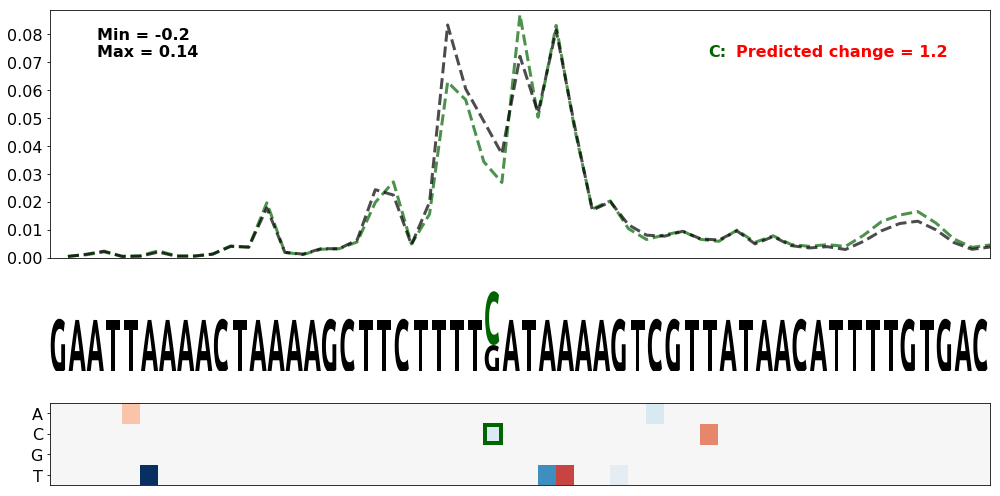

Both:


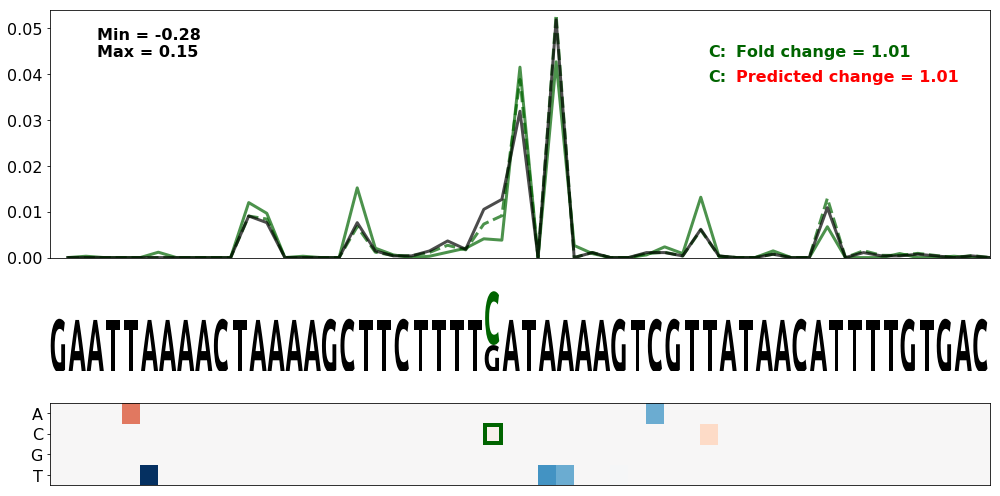

Gene = ATP7B.1
WT seq = TTTTTGTCAGATAATCATTTCTACTTCAAAAACATTTCATGCAATATTAGAATAAAGTTCCTGTCATTCCTCTAAAAATCTGCCTGTGAGTGAGATGCGTGGTCAGAGGCCAGTGCCGTCTTGTCTTCACGAGGGCTTCTGTGAGGCACTGGCTTGGCTTCATG
SNV pos = 74
SNV nt = T
ClinVar id = Missing
Observed:


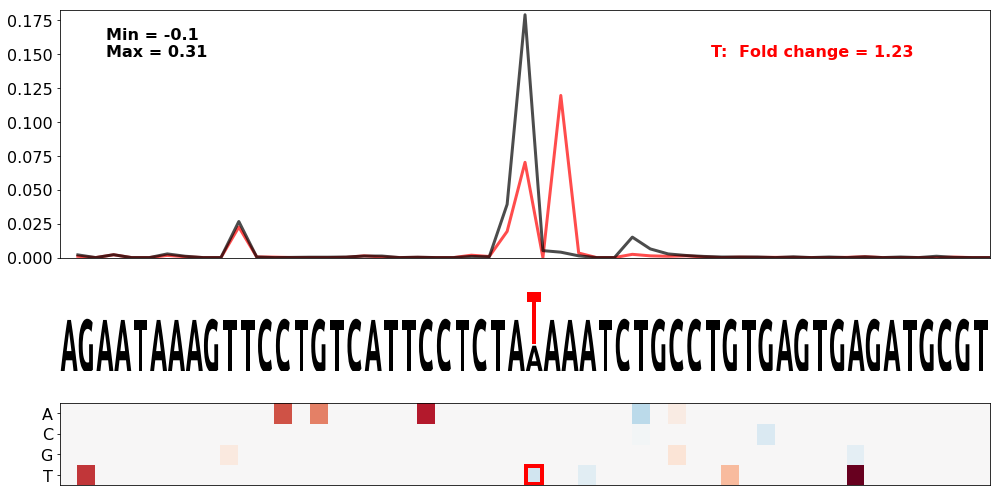

Predicted:


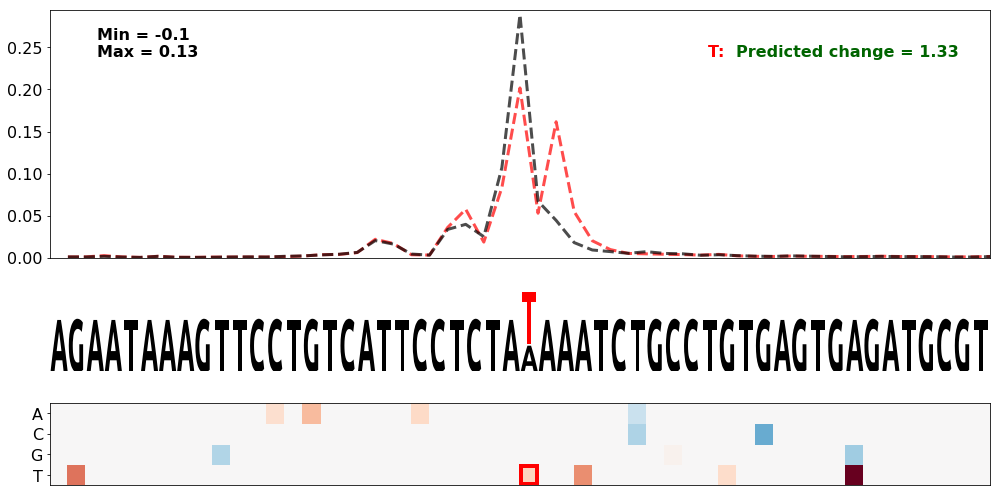

Both:


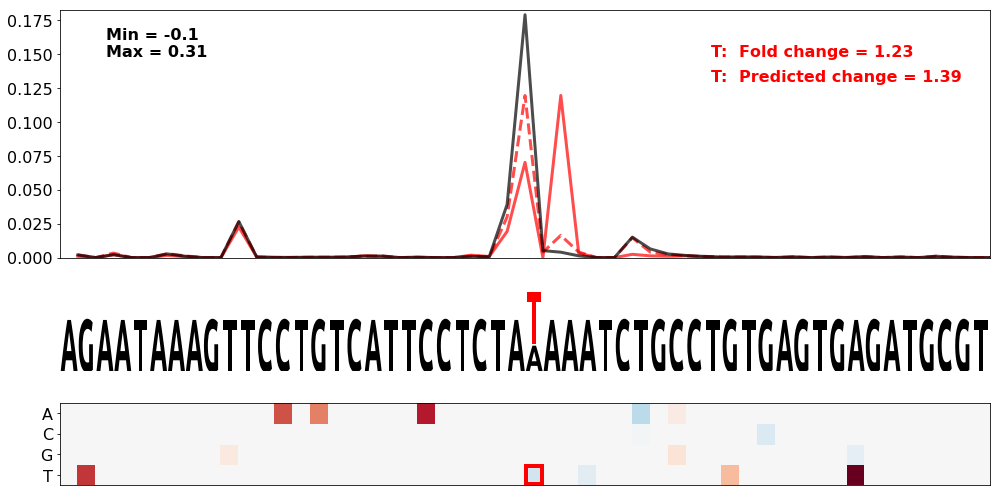

Gene = BRCA2.1
WT seq = TGTATAATATCATGTTTTCAAATCTAATTATAAATACGTTTAAAGCCAAGAATAAATCTTTTAAAAAATTGACTTGTTTCCTTCCATAACTCTGAGCCATGATTTTTCTGTTCTGTAAAAAGCATTAACAAAATTGTCTATTTTGCTACTCCCTGTAACTTAAG
SNV pos = 63
SNV nt = T
ClinVar id = Missing
Observed:


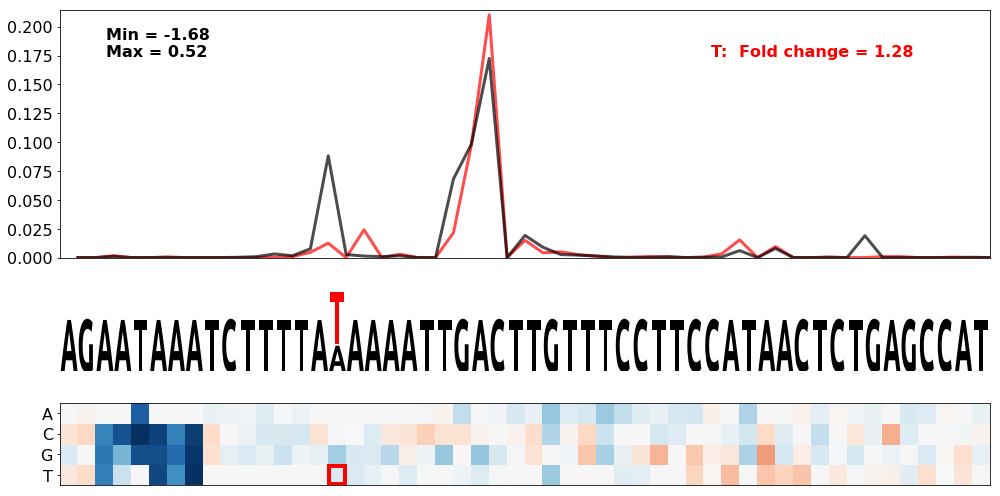

Predicted:


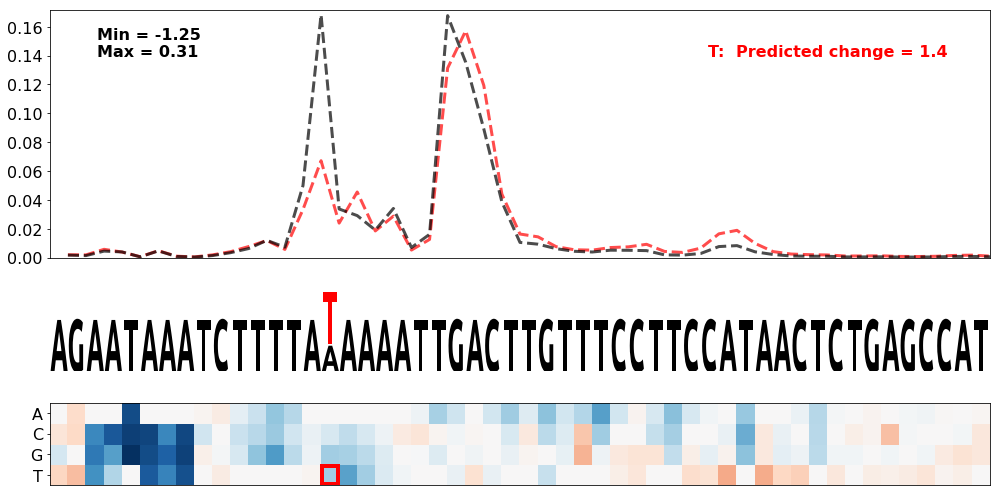

Both:


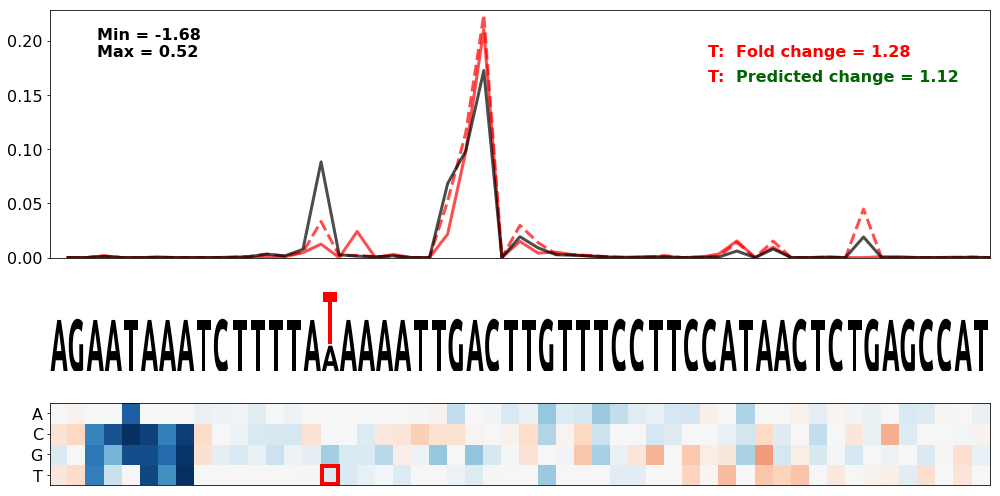

Gene = TPMT.1
WT seq = CCTAAAATCTCAAGATGGAAGATATACCACATGTAAATTATTTTAGAGCAATTAAATTGTTTTCAGGATTTTCCAAAAATGCTTCTTGTTTCATTTTATTATTTAAGTAACAGATTATCTGAGCCTCTGTGCCCTGCACACAGTGGTTTATAAATGCCTTGCCC
SNV pos = 75
SNV nt = T
ClinVar id = Missing
Observed:


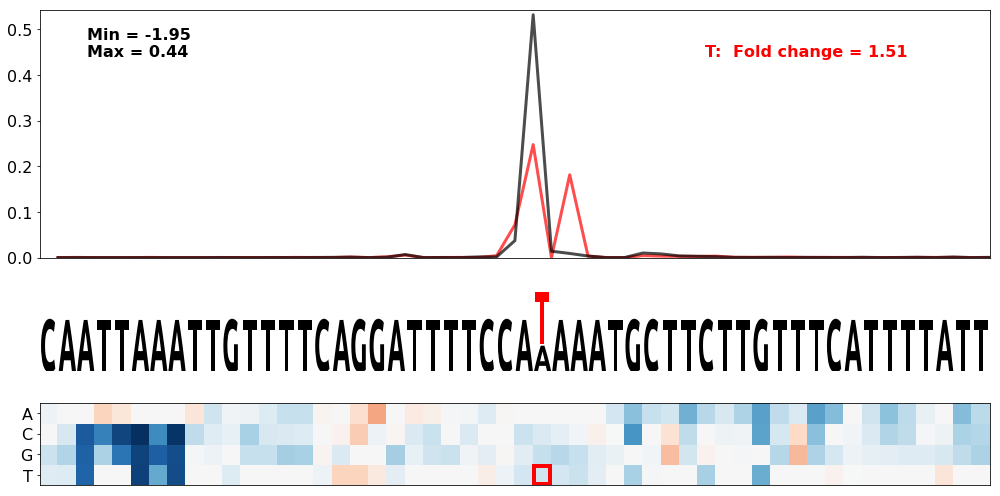

Predicted:


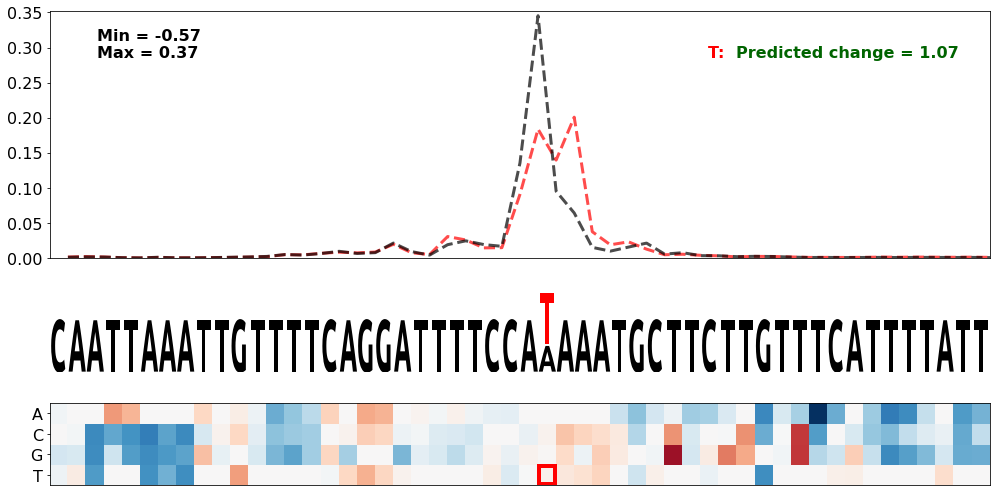

Both:


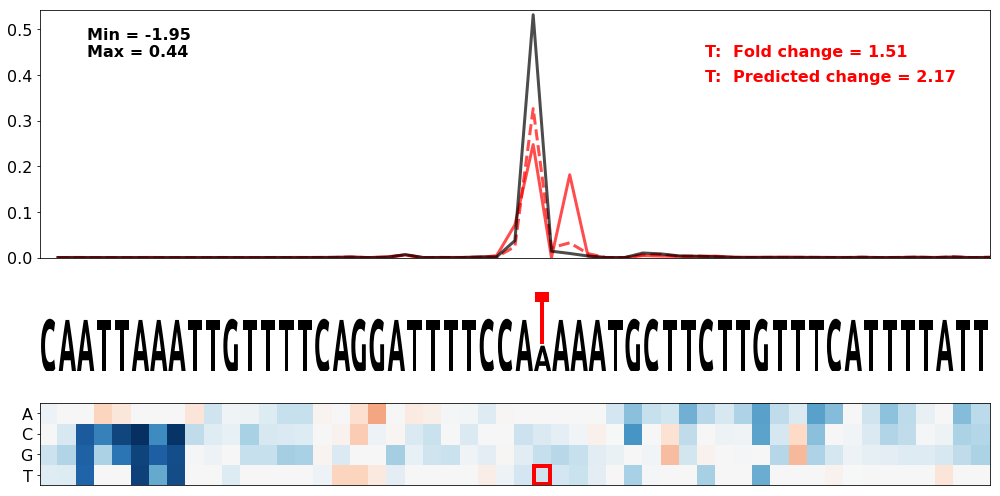

Gene = BRCA1.1
WT seq = ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG
SNV pos = 80
SNV nt = A
ClinVar id = Missing
Observed:


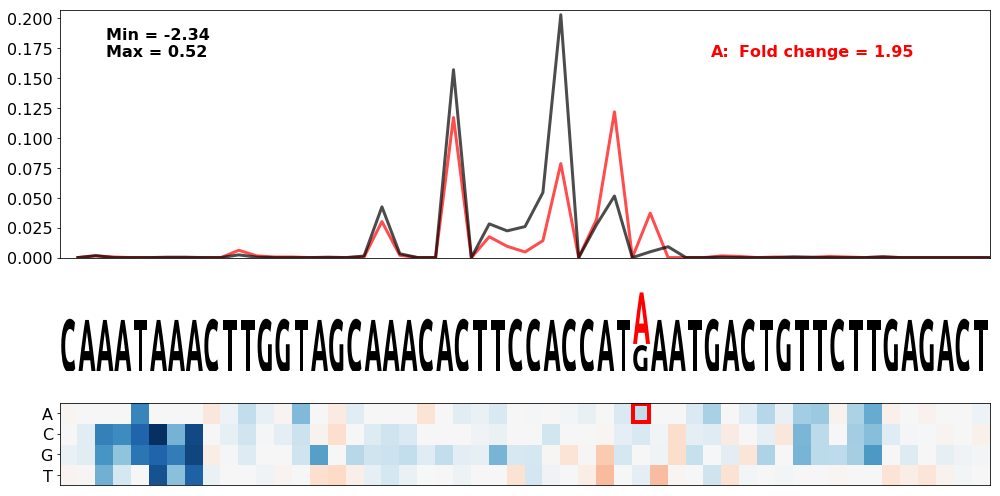

Predicted:


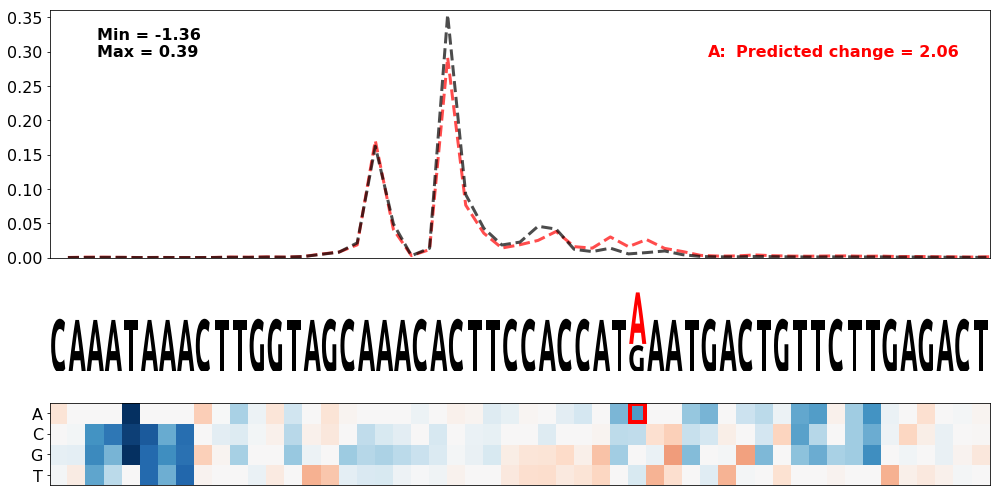

Both:


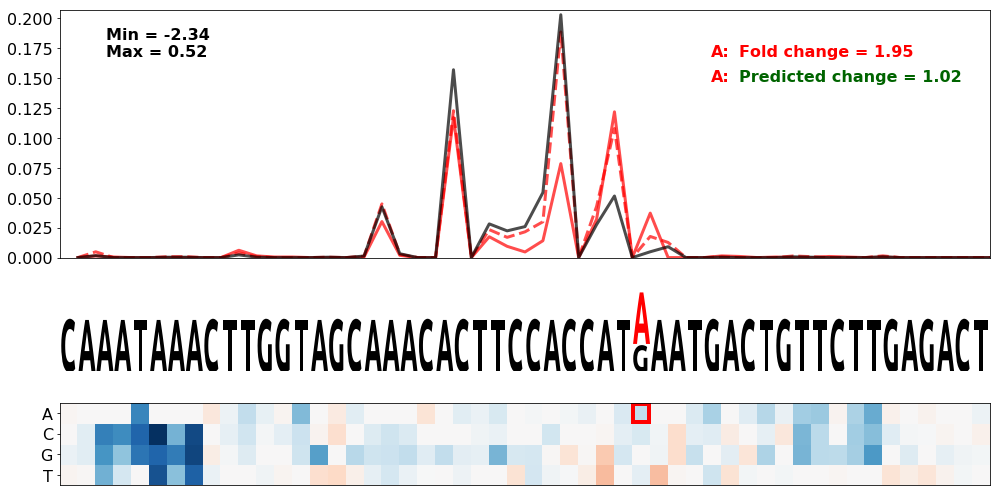

In [27]:
print('Gain of cryptic competing CSE:')

experiment_name = 'gain_of_cryptic_cse'

gene_names = [
    'PTEN.24',
    'DOCK8.2',
    'SMAD4.1',
    'ATP7B.1',
    'BRCA2.1',
    'TPMT.1',
    'BRCA1.1'
]

snv_list = [
    [(72, 'A', 'darkgreen')],
    [(75, 'A', 'darkgreen')],
    [(72, 'C', 'darkgreen')],
    [(74, 'T', 'red')],
    [(63, 'T', 'red')],
    [(75, 'T', 'red')],
    [(80, 'A', 'red')]
]

wt_seq_list = [
    'GAGTTAAGTAATTTCACTGAAATTGATTGCTTTTTGTGTCTTGGAGTCAAAATAAATAACTGAAATCTACTATACTTGGCTCATGCTTAATTAATATACTTAGACCATATTTCGGATGAATTATTCACAGAATCTAAAGGAGTATCCTCGTGTTCTTACCTTCT',
    'ATTTGAGAATTAAATTATATATTTTTAATATGACTGTGACCTTGACTGATAATAAAGATGTAATAAGAATTGCAAGCTAAATGTTTCCCTTTGCAACTCATGCTTTGTGTTTTGTTTTGATGACCTACTCGCTCGTAATGTTTTGTAAGGCACTTCAGAGAGAA',
    'AGCTTTAGGTCTAAAGACGATGGTGAATTATGTAGGTTTAAGTTGTTGGAATTAAAACTAAAAGCTTCTTTTGATAAAAGTCGTTATAACATTTTGTGACTCTATTAATAGAAGTGGCTTTTTCTTTGCTTTCCAGGTTTTTGGGCGAGTTTTAAAGAAGTATT',
    'TTTTTGTCAGATAATCATTTCTACTTCAAAAACATTTCATGCAATATTAGAATAAAGTTCCTGTCATTCCTCTAAAAATCTGCCTGTGAGTGAGATGCGTGGTCAGAGGCCAGTGCCGTCTTGTCTTCACGAGGGCTTCTGTGAGGCACTGGCTTGGCTTCATG',
    'TGTATAATATCATGTTTTCAAATCTAATTATAAATACGTTTAAAGCCAAGAATAAATCTTTTAAAAAATTGACTTGTTTCCTTCCATAACTCTGAGCCATGATTTTTCTGTTCTGTAAAAAGCATTAACAAAATTGTCTATTTTGCTACTCCCTGTAACTTAAG',
    'CCTAAAATCTCAAGATGGAAGATATACCACATGTAAATTATTTTAGAGCAATTAAATTGTTTTCAGGATTTTCCAAAAATGCTTCTTGTTTCATTTTATTATTTAAGTAACAGATTATCTGAGCCTCTGTGCCCTGCACACAGTGGTTTATAAATGCCTTGCCC',
    'ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG'
]

seq_start = 48
seq_end = 100

save_figs = True

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

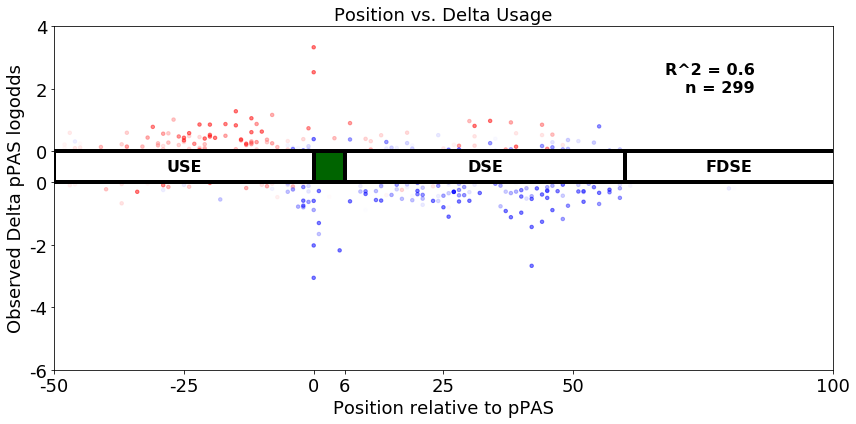

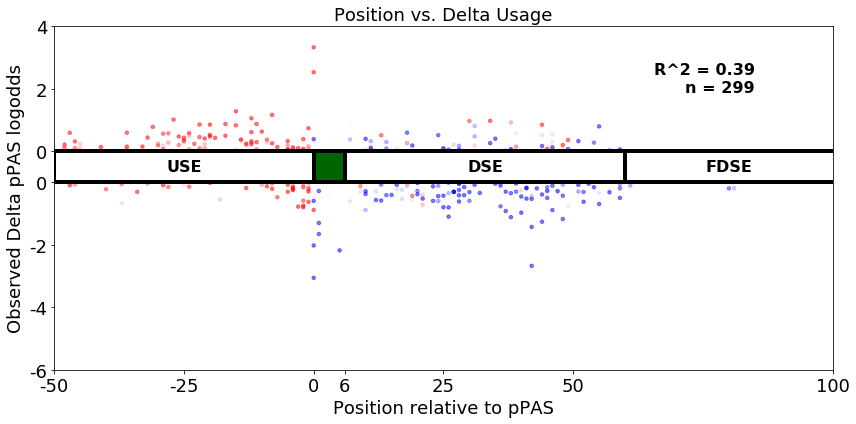


# Gain of TGTA = 299
# Neural net / Observation agreement = 231
# Neural net / 6-mer model agreement = 241
## Gain of motif in USE = 122
### Gain of motif, Loss of function = 39
### Gain of motif, Gain of function = 83
### Neural net / 6-mer model agreement = 93
## Gain of motif in DSE = 164
### Gain of motif, Loss of function = 109
### Gain of motif, Gain of function = 55
### Neural net / 6-mer model agreement = 138


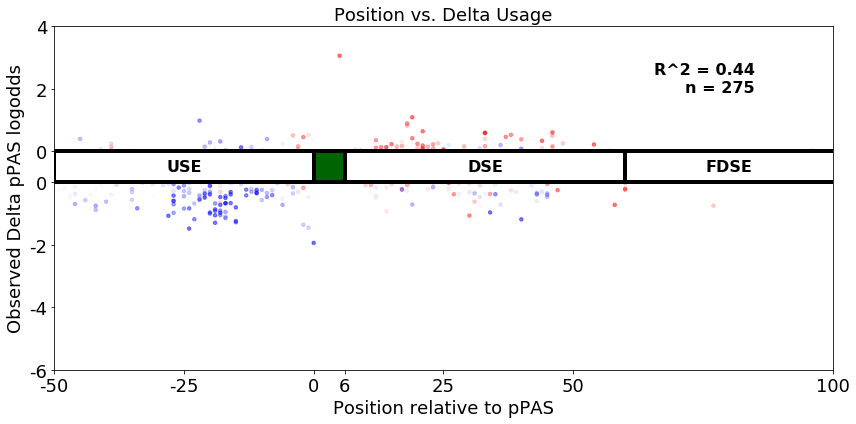

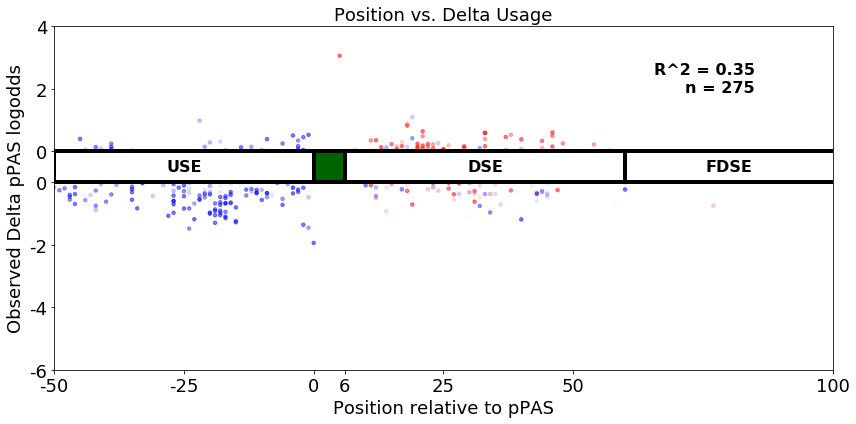


# Loss of TGTA = 275
# Neural net / Observation agreement = 201
# Neural net / 6-mer model agreement = 222
## Loss of motif in USE = 151
### Loss of motif, Loss of function = 123
### Loss of motif, Gain of function = 28
### Neural net / 6-mer model agreement = 133
## Loss of motif in DSE = 122
### Loss of motif, Loss of function = 61
### Loss of motif, Gain of function = 61
### Neural net / 6-mer model agreement = 87


In [34]:
#Gain/Loss of motif

save_figs = False

motif = 'TGTA'

gain_of_motif_index = []
loss_of_motif_index = []

i = 0
for _, row in df_var.iterrows() :
    snv_pos = row['snv_pos']
    
    var_seq = row['master_seq']
    ref_seq = row['wt_seq']
    
    motif_len = len(motif)
    
    var_motif_dict = {}
    ref_motif_dict = {}
    for offset in range(-motif_len + 1, motif_len - 1) :
        
        var_motif = var_seq[snv_pos+offset:snv_pos+offset + motif_len]
        if len(var_motif) == motif_len :
            if var_motif not in var_motif_dict :
                var_motif_dict[var_motif] = 0
            var_motif_dict[var_motif] += 1
        
        ref_motif = ref_seq[snv_pos+offset:snv_pos+offset + motif_len]
        if len(ref_motif) == motif_len :
            if ref_motif not in ref_motif_dict :
                ref_motif_dict[ref_motif] = 0
            ref_motif_dict[ref_motif] += 1
    
    if motif in var_motif_dict and motif not in ref_motif_dict :
        gain_of_motif_index.append(i)
    elif motif not in var_motif_dict and motif in ref_motif_dict :
        loss_of_motif_index.append(i)
    
    i += 1


gain_of_motif_df = df_var.iloc[gain_of_motif_index].copy().set_index('master_seq')
loss_of_motif_df = df_var.iloc[loss_of_motif_index].copy().set_index('master_seq')

fig_name = None
if save_figs :
    fig_name = 'gain_of_tgta_neural_net'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'gain_of_tgta_hexamer_model'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Gain of ' + str(motif) + ' = ' + str(len(gain_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_6mer_score']))[0])))
print('## Gain of motif in USE = ' + str(len(gain_of_motif_df.query("snv_pos < 50"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Gain of motif in DSE = ' + str(len(gain_of_motif_df.query("snv_pos >= 56"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


fig_name = None
if save_figs :
    fig_name = 'loss_of_tgta_neural_net'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'loss_of_tgta_hexamer_model'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Loss of ' + str(motif) + ' = ' + str(len(loss_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_6mer_score']))[0])))
print('## Loss of motif in USE = ' + str(len(loss_of_motif_df.query("snv_pos < 50"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Loss of motif in DSE = ' + str(len(loss_of_motif_df.query("snv_pos >= 56"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


In [153]:

simple_df = pd.read_csv('../simple/processed_data/noacut/final/simple_noacut_final.csv', sep=',')

simple_cuts = spio.loadmat('../simple/processed_data/noacut/final/simple_noacut_final_cuts')['cuts']

#keep_index = np.nonzero(simple_df.total_count >= 20)[0]
keep_index = np.nonzero((simple_df.total_count >= 20) & ((simple_df.seq.str.slice(50+20, 56+20) == 'AATAAA') | (simple_df.seq.str.slice(50+20, 56+20) == 'NNTAAA')))[0]

simple_df = simple_df.iloc[keep_index].copy()
simple_cuts = simple_cuts[keep_index, :]

print(len(simple_df))

simple_proximal_usage = (np.sum(simple_cuts[:, 57+20:87+20], axis=1) + 0.1) / (np.sum(simple_cuts, axis=1) + 2. * 0.1)

simple_cuts = None

simple_df['proximal_usage'] = simple_proximal_usage

225609


In [154]:

doubledope_df = pd.read_csv('../doubledope/processed_data/score_60/final/doubledope_score_60_final.csv', sep=',')

doubledope_cuts = spio.loadmat('../doubledope/processed_data/score_60/final/doubledope_score_60_final_cuts')['cuts']

#keep_index = np.nonzero(simple_df.total_count >= 20)[0]
keep_index = np.nonzero((doubledope_df.total_count >= 10) & ((doubledope_df.seq.str.slice(50+20, 56+20) == 'AATAAA') | (doubledope_df.seq.str.slice(50+20, 56+20) == 'ATTAAA')))[0]

doubledope_df = doubledope_df.iloc[keep_index].copy()
doubledope_cuts = doubledope_cuts[keep_index, :]

print(len(doubledope_df))

doubledope_proximal_usage = (np.sum(doubledope_cuts[:, 57+20:87+20], axis=1) + 0.1) / (np.sum(doubledope_cuts, axis=1) + 2. * 0.1)

doubledope_cuts = None

doubledope_df['proximal_usage'] = doubledope_proximal_usage

68547


In [155]:
#motif_df_to_use = doubledope_df
motif_df_to_use = pd.concat([simple_df, doubledope_df])

In [180]:

mer4_dict = {}
mer4 = []
i = 0
bases = ['A', 'C', 'G', 'T']
for b1 in bases :
    for b2 in bases :
        for b3 in bases :
            for b4 in bases :
                mer4_dict[b1 + b2 + b3 + b4] = i
                mer4.append(b1 + b2 + b3 + b4)
                i += 1


tgta_pos_lor = {}

for offset in range(-4, 4 + 1) :
    tgta_boundary_lor = {}

    for mer_i, mer in enumerate(mer4) :
        if mer_i % 100 == 0 :
            print('Processing n-mer ' + str(mer_i))

        p_has_avg = motif_df_to_use[motif_df_to_use.seq.str.slice(46+20 + offset, 50+20 + offset) == mer]['proximal_usage'].mean()
        p_not_avg = motif_df_to_use[motif_df_to_use.seq.str.slice(46+20 + offset, 50+20 + offset) != mer]['proximal_usage'].mean()

        tgta_boundary_lor[mer] = np.log((p_has_avg / (1. - p_has_avg)) / (p_not_avg / (1. - p_not_avg)))

    tgta_pos_lor[offset] = tgta_boundary_lor

Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200
Processing n-mer 0
Processing n-mer 100
Processing n-mer 200


In [57]:
#Load position nmer weights and build decoder dicts

simple_pos_weights = np.load('simple_position_nmer_weights.npy')
simple_large_pos_weights = np.load('simple_large_position_nmer_weights.npy')
simple_aataaa_pos_weights = np.load('simple_aataaa_position_nmer_weights.npy')
doubledope_pos_weights = np.load('doubledope_position_nmer_weights.npy')

mer4_dict = {}
mer4_list = []
mer6_dict = {}
mer6_list = []
bases = list('ACGT')

#Build dictionary of 6-mer -> index
i6 = 0
i4 = 0
for b1 in bases :
    for b2 in bases :
        for b3 in bases :
            for b4 in bases :
                mer4_dict[b1 + b2 + b3 + b4] = i4
                mer4_list.append(b1 + b2 + b3 + b4)
                i4 += 1
                for b5 in bases :
                    for b6 in bases :
                        mer6_dict[b1 + b2 + b3 + b4 + b5 + b6] = i6
                        mer6_list.append(b1 + b2 + b3 + b4 + b5 + b6)
                        i6 += 1


Pearson r correlation = -0.6869340217194285
P-value = 0.04093801966070813


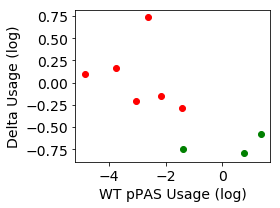

[-0.55536766 -0.57123236 -0.59806459 -0.41900311 -0.34134801 -0.42639456
 -0.40590812 -0.21677544  0.00432058]
Pearson r correlation = -0.7045330288823158
P-value = 0.034080831345743086


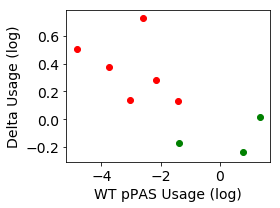

In [72]:
save_figs = True

tgta_boundary_df = gain_of_motif_df.query("snv_pos >= 47 and snv_pos <= 49").sort_values(by='delta_logodds_true')

#slice_index = tgta_boundary_df.index.str.slice(47, 53).str.contains('TGTA')
slice_index = tgta_boundary_df.index.str.slice(47, 50).str.contains('TGT')

slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('AATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('ATTAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('CATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('GATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('AGTAAA'))

tgta_boundary_df = tgta_boundary_df[slice_index]

has_up_tgta = tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA')
not_up_tgta = ~(tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA'))
    


r_val, p_val = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'])

print('Pearson r correlation = ' + str(r_val))
print('P-value = ' + str(p_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'gain_of_overlapping_tgta_scatter'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()




linear_boundary_delta = np.zeros(len(tgta_boundary_df))

i = 0
for index, row in tgta_boundary_df.iterrows() :
    
    var_score = 0
    ref_score = 0
    for offset in range(-3, 3 + 1) :
        var_mer = index[46 + offset: 50 + offset]
        ref_mer = row['wt_seq'][46 + offset: 50 + offset]
        
        rel_pos = 46 + offset
        
        var_s = simple_pos_weights[rel_pos * 256 + mer4_dict[var_mer]]
        #var_s = simple_large_pos_weights[rel_pos * 256 + mer4_dict[var_mer]]
        #var_s = simple_aataaa_pos_weights[rel_pos * 256 + mer4_dict[var_mer]]
        #var_s = doubledope_pos_weights[rel_pos * 256 + mer4_dict[var_mer]]
        #var_s /= 2.
        
        ref_s = simple_pos_weights[rel_pos * 256 + mer4_dict[ref_mer]]
        #ref_s = simple_large_pos_weights[rel_pos * 256 + mer4_dict[ref_mer]]
        #ref_s = simple_aataaa_pos_weights[rel_pos * 256 + mer4_dict[ref_mer]]
        #ref_s = doubledope_pos_weights[rel_pos * 256 + mer4_dict[ref_mer]]
        #ref_s /= 2.
        
        var_score += var_s
        ref_score += ref_s
    
    linear_boundary_delta[i] = var_score - ref_score
    
    i += 1

print(linear_boundary_delta)

r_val, p_val = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'] - linear_boundary_delta)

print('Pearson r correlation = ' + str(r_val))
print('P-value = ' + str(p_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta] - linear_boundary_delta[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta] - linear_boundary_delta[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'gain_of_overlapping_tgta_scatter_multi_4mer_correction'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()





In [49]:
simple_pos_weights[46 * 256 + mer4_dict['TGTA']]

-0.14031836890301225

Pearson r correlation = -0.6869340217194285
P-value = 0.04093801966070813


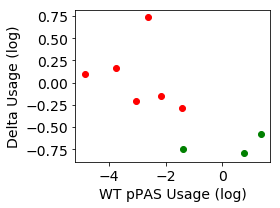

Pearson r correlation = -0.7338676439748003
P-value = 0.02439637798236559


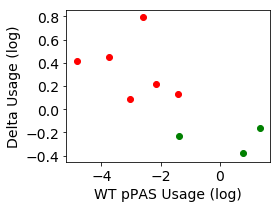

Pearson r correlation = -0.765676601207074
P-value = 0.016165081565762775


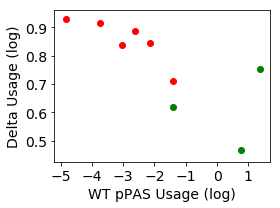

In [200]:
save_figs = True

tgta_boundary_df = gain_of_motif_df.query("snv_pos >= 47 and snv_pos <= 49").sort_values(by='delta_logodds_true')

#slice_index = tgta_boundary_df.index.str.slice(47, 53).str.contains('TGTA')
slice_index = tgta_boundary_df.index.str.slice(47, 50).str.contains('TGT')

slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('AATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('ATTAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('CATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('GATAAA'))
slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('AGTAAA'))

tgta_boundary_df = tgta_boundary_df[slice_index]

has_up_tgta = tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA')
not_up_tgta = ~(tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA'))
    


r_val, p_val = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'])

print('Pearson r correlation = ' + str(r_val))
print('P-value = ' + str(p_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'gain_of_overlapping_tgta_scatter'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()


linear_boundary_delta = np.zeros(len(tgta_boundary_df))

i = 0
for index, row in tgta_boundary_df.iterrows() :
    
    var_score = 0
    ref_score = 0
    for offset in range(0, 0 + 1) :
        var_mer = index[46 + offset: 50 + offset]
        ref_mer = row['wt_seq'][46 + offset: 50 + offset]
        
        if not np.isnan(tgta_pos_lor[offset][var_mer]) and not np.isnan(tgta_pos_lor[offset][ref_mer]) :
            var_score += tgta_pos_lor[offset][var_mer]
            ref_score += tgta_pos_lor[offset][ref_mer]
    
    linear_boundary_delta[i] = var_score - ref_score
    
    if row['delta_logodds_true'] > 1.6 :
        print(ref_score)
        print(ref_score)
    
    i += 1

r_val, p_val = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'] - linear_boundary_delta)

print('Pearson r correlation = ' + str(r_val))
print('P-value = ' + str(p_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta] - linear_boundary_delta[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta] - linear_boundary_delta[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'gain_of_overlapping_tgta_scatter_single_4mer_correction'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()


linear_boundary_delta = np.zeros(len(tgta_boundary_df))

i = 0
for index, row in tgta_boundary_df.iterrows() :
    
    var_score = 0
    ref_score = 0
    for offset in range(-1, 2 + 1) :
        var_mer = index[46 + offset: 50 + offset]
        ref_mer = row['wt_seq'][46 + offset: 50 + offset]
        
        if not np.isnan(tgta_pos_lor[offset][var_mer]) and not np.isnan(tgta_pos_lor[offset][ref_mer]) :
            var_score += tgta_pos_lor[offset][var_mer]
            ref_score += tgta_pos_lor[offset][ref_mer]
    
    linear_boundary_delta[i] = var_score - ref_score
    
    if row['delta_logodds_true'] > 1.6 :
        print(ref_score)
        print(ref_score)
    
    i += 1

r_val, p_val = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'] - linear_boundary_delta)

print('Pearson r correlation = ' + str(r_val))
print('P-value = ' + str(p_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta] - linear_boundary_delta[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta] - linear_boundary_delta[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'gain_of_overlapping_tgta_scatter_multi_4mer_correction'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()





In [193]:
tgta_boundary_df = gain_of_motif_df.query("snv_pos >= 46 and snv_pos <= 50 and experiment != 'tgta'").sort_values(by='delta_logodds_true')
slice_index = (tgta_boundary_df.index.str.slice(46, 51).str.contains('TGTA'))

slice_index1 = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA'))
slice_index1 = slice_index1 & (~tgta_boundary_df.wt_seq.str.slice(57, 150).str.contains('TGTA'))

slice_index2 = slice_index & (tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA'))
#slice_index2 = slice_index2 | (tgta_boundary_df.wt_seq.str.slice(57, 70).str.contains('TGTA'))

tgta_boundary_df1 = tgta_boundary_df[slice_index1]
tgta_boundary_df2 = tgta_boundary_df[slice_index2]

print("Gain of competing TGTA (with upstream WT TGTA) = " + str(len(tgta_boundary_df1)))
print("# Mean delta logodds = " + str(tgta_boundary_df1['delta_logodds_true'].mean()))

print("Gain of competing TGTA (without upstream WT TGTA) = " + str(len(tgta_boundary_df2)))
print("# Mean delta logodds = " + str(tgta_boundary_df2['delta_logodds_true'].mean()))


Gain of competing TGTA (with upstream WT TGTA) = 9
# Mean delta logodds = 0.460566132922797
Gain of competing TGTA (without upstream WT TGTA) = 4
# Mean delta logodds = -0.5578097885165643


Gene = INS.1
WT seq = CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
SNV pos = 49
SNV nt = T


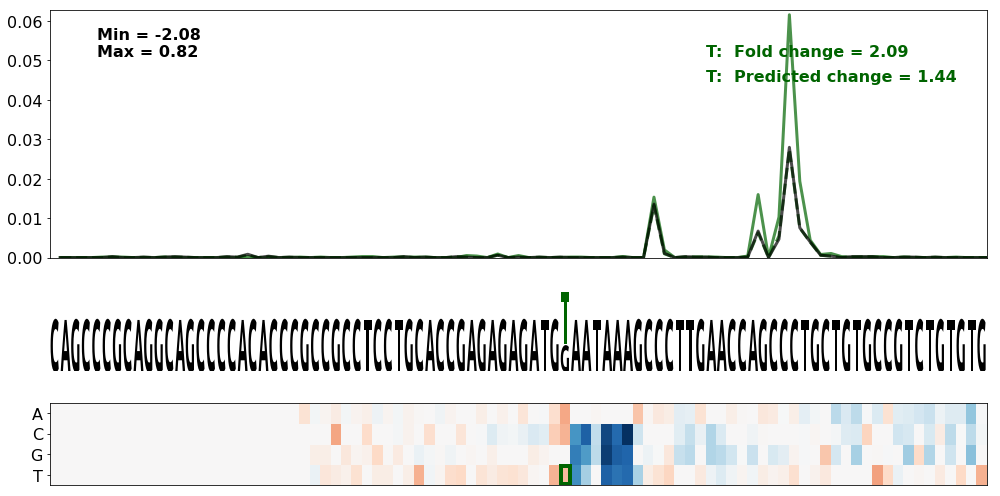

Gene = BMP1.3
WT seq = TGCCCTACCCCCTCCCATTTTGATGGTGTCTGTGACATTTCCTGTTGTGAAGTAAAAGAGGGACCCCTGCGTCCTGCTCCTTTCTCTTGCAGTCTGCTTGTCCATGTGTCTATTTTTCCACTTGTCCATCTGTCCAGTAAGCAGGTAATGGTGACCCATGCTGG
SNV pos = 49
SNV nt = T


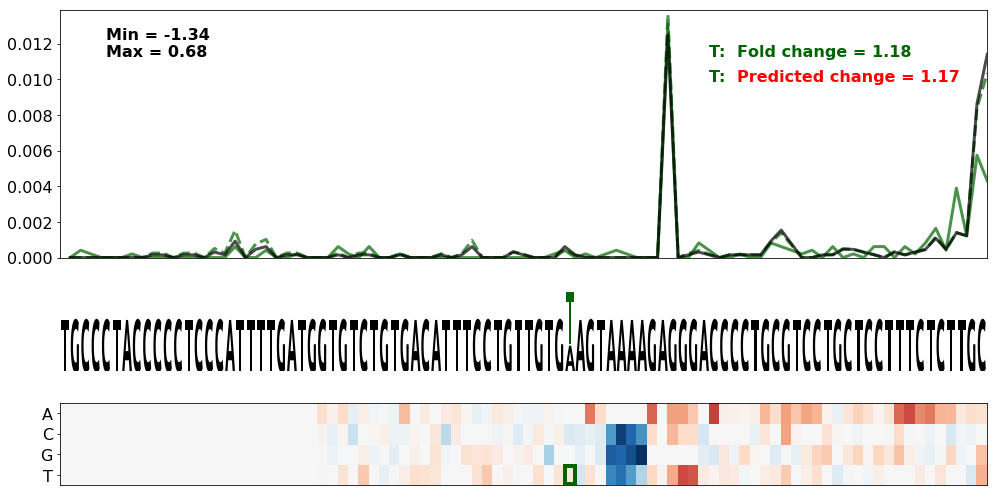

Gene = ARSA.3
WT seq = GCCTGTGGGGGAGGCTCAGGTGTCTGGAGGGGGTTTGTGCCTGATAACGTAATAACACCAGTGGAGACTTGCAGATGTGACAATTCGTCCAATCCTGGGGTAATGCTGTGTGCTGGTGCCGGTCCCCTGTGGTACGAATGAGGAAACTGAGGTGCAGAGAGGTT
SNV pos = 47
SNV nt = T


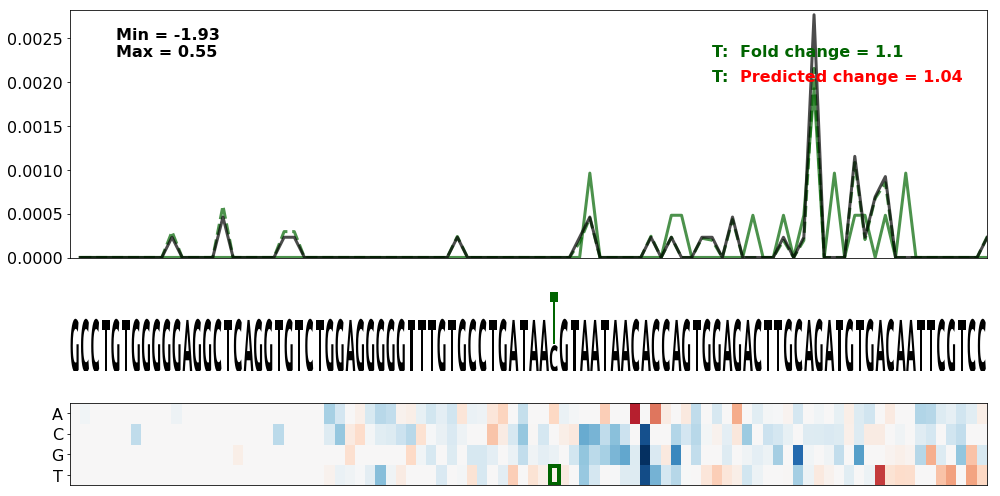

Gene = ACTA2.2
WT seq = AGAGGAAAACAAAGCTAACAACTTAAGCCAAATCGCATAGCCCCAGCTATATTAAACATTCACAATTACTTCCTGTCCTTCGTTACTCATTATTTCCTGGCCAATTTTCTTTAAAAAAAAATCTTGTAATTCTTTCGTGCTCTGGTGAACACTGTTCAAAGTCA
SNV pos = 48
SNV nt = G


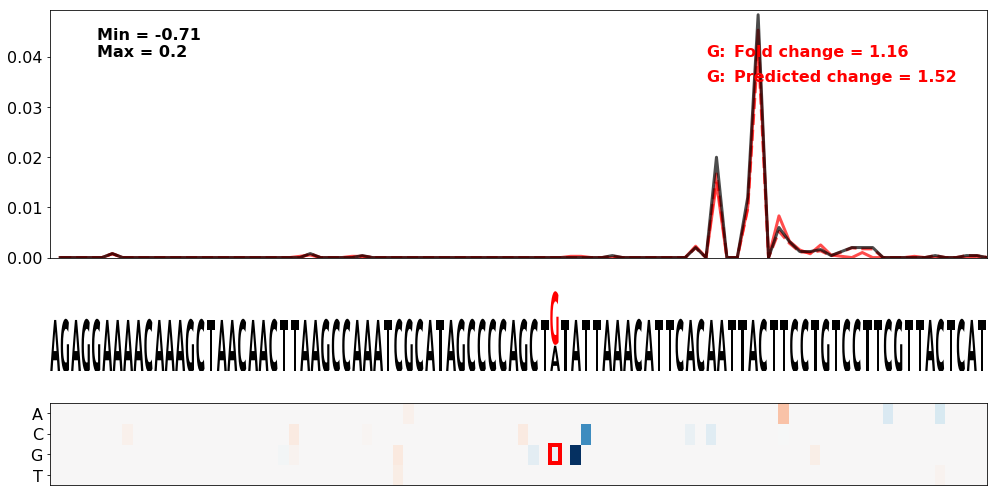

Gene = TSC2.1
WT seq = CCGGGGCCCTCCCTCCTGCACTGGCCTTGGACGGTATTGCCTGTCAGTGAAATAAATAAAGTCCTGACCCCAGTGCACAGACATAGAGGCACAGATTGCAGTCAGACAGCTCTTTTATTGACTTTGTCTGCTTGGTGCGGGGGTTGGGGGGGTGTCGAGGCTCT
SNV pos = 49
SNV nt = T


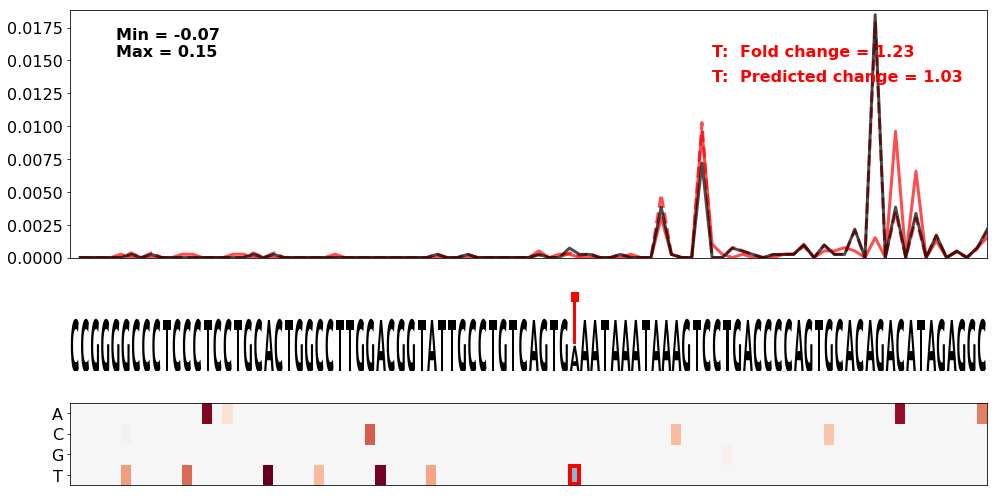

Gene = DSG2.1
WT seq = CTTAAAGGCAGGTGTTTCTTGGACTTTGTTATTTAATTAGATCTGCTTGCAATAAAAAAAGTTGTCGGTTATCTAAAATTCAAATTTATCGGGGTACTTGGCATTTTCATTGTCCAACTCTGGCAACCTTGTTCCTAAGGAAGTGAAGGTTGCTCTCTGCCCAG
SNV pos = 49
SNV nt = T


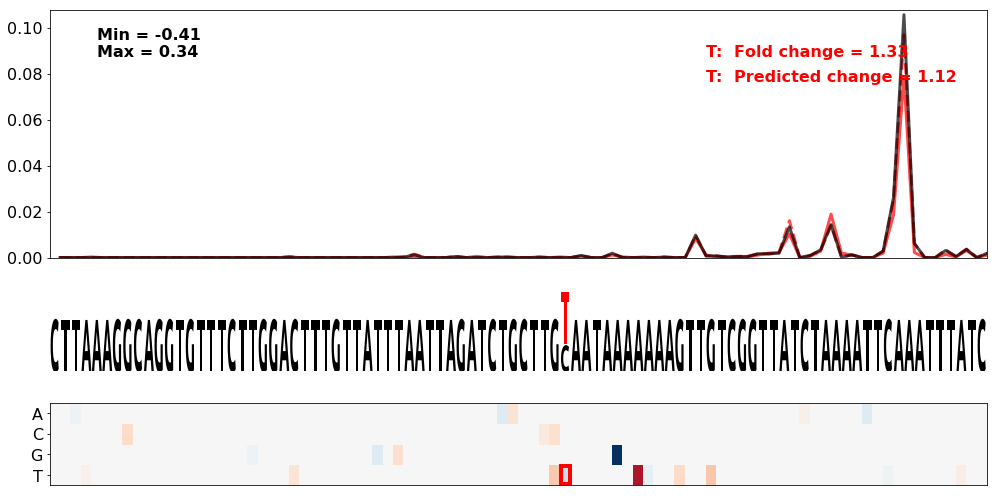

Gene = SNRNP200.3
WT seq = TATAGCATTTTCAGGCATGTTCCTGGTAGTTCTTTTGAGTCTGACATTCTAATAAAATAATTTGTAGAAACCATTTGTCTTTGTAGTGATTCCAAATTAAAAGTTTTCTTTCTCCAACCTGAGGGCACGGCCAAAAAGATCTGGTTATTTTTTAGCCAGGAACG
SNV pos = 48
SNV nt = G


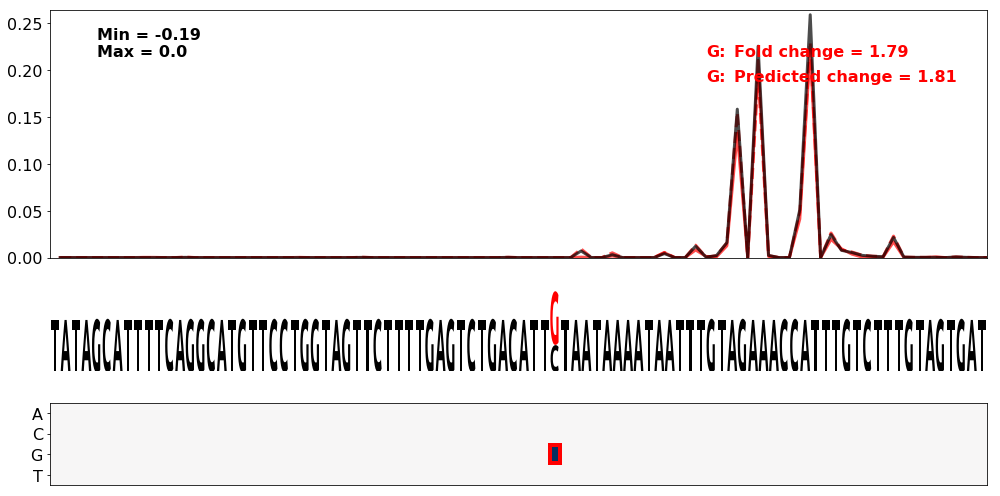

Gene = TSC1.4
WT seq = AATTTTAAAAGTTGAGTGTTCTGTATTAAGCAGTAACCATTATTAATTTTATTAAATCTTAGCCCTTGAGAACATGTATGTGTAATATTCTTCGTGGCAAAATAGAAAATATGCATAAGGCACATGTACTGCATACCAGGGTATGATGGTGACCTCTGGCCCTC
SNV pos = 48
SNV nt = G


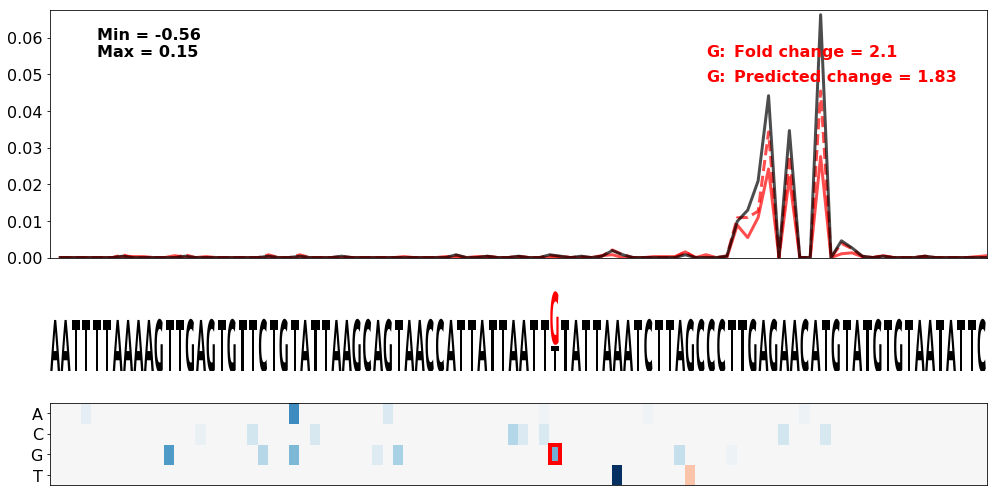

Gene = PTEN.17
WT seq = TATGTATTATTTCGAAGCAGTGTTTACGTAGCAGTAACATGAAAGTTTCTAATAAAATACCCAATGTACACAGCGTCAAAAAAGCTGCATTTTTCCTTTTCCTAATTCTTCGTTGTTTGCTGAAATCTGGGGCAAAGGTGCGGGAGGGGGCTAAATGACTGGGA
SNV pos = 48
SNV nt = G


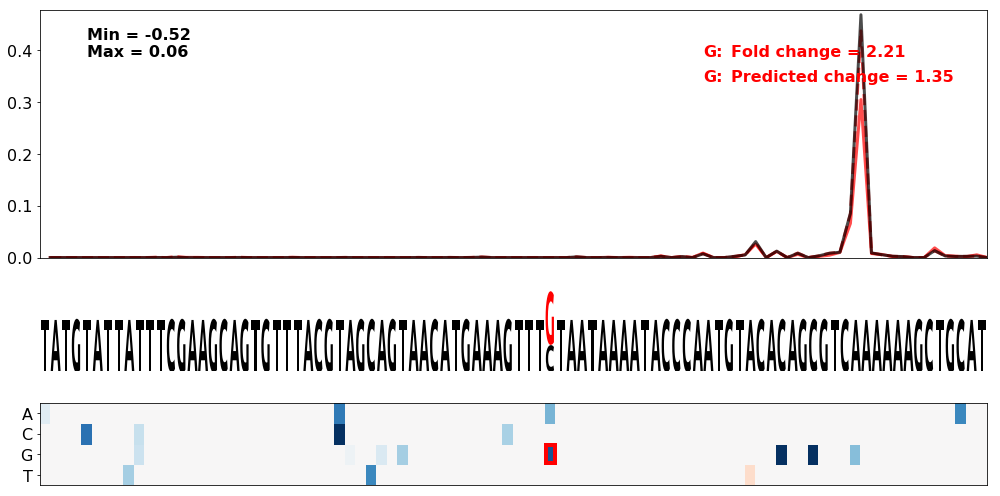

In [189]:

df_sel = tgta_boundary_df.sort_values(by='delta_logodds_true', ascending=False)
# and delta_logodds_true > 0.0

seq_start = 0
seq_end = 90#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            #fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Pearson r correlation = 0.45558787815298024


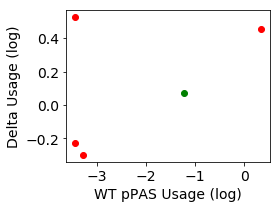

In [199]:
save_figs = True

tgta_boundary_df = loss_of_motif_df.query("snv_pos >= 46 and snv_pos <= 49 and experiment != 'tgta'")#.sort_values(by='delta_logodds_true')

slice_index = tgta_boundary_df.wt_seq.str.slice(50-3, 51) == 'TGTA'

slice_index = slice_index & (~tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA'))

tgta_boundary_df = tgta_boundary_df[slice_index]

has_up_tgta = tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA')
not_up_tgta = ~(tgta_boundary_df.wt_seq.str.slice(0, 45).str.contains('TGTA') | tgta_boundary_df.wt_seq.str.slice(57, 110).str.contains('TGTA'))
    


r_val, _ = pearsonr(tgta_boundary_df['pooled_proximal_logodds_true_wt'], tgta_boundary_df['delta_logodds_true'])

print('Pearson r correlation = ' + str(r_val))

f = plt.figure(figsize=(4, 3))

plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[has_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[has_up_tgta], c='green')
plt.scatter(tgta_boundary_df['pooled_proximal_logodds_true_wt'].loc[not_up_tgta], tgta_boundary_df['delta_logodds_true'].loc[not_up_tgta], c='red')

plt.xlabel('WT pPAS Usage (log)', fontsize=14)
plt.ylabel('Delta Usage (log)', fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout()

if save_figs :
    fig_name = 'loss_of_overlapping_tgta_scatter'
    plt.savefig(fig_name + '.png', transparent=True, dpi=150)
    plt.savefig(fig_name + '.eps')

plt.show()


Gene = TGFBR1.11
WT seq = TACCTCACTGAGAGGGAACAGAAGGATATTGCTTCCTTTTGCAGCAGTGTAATAAAGTCAATTAAAAACTTCCCAGGATTTCTTTGGACCCAGGAAACAGCCATGTGGGTCCTTTCTGTGCACTATGAACGCTTCTTTCCCAGGACAGAAAATGTGTAGTCTAC
SNV pos = 49
SNV nt = C


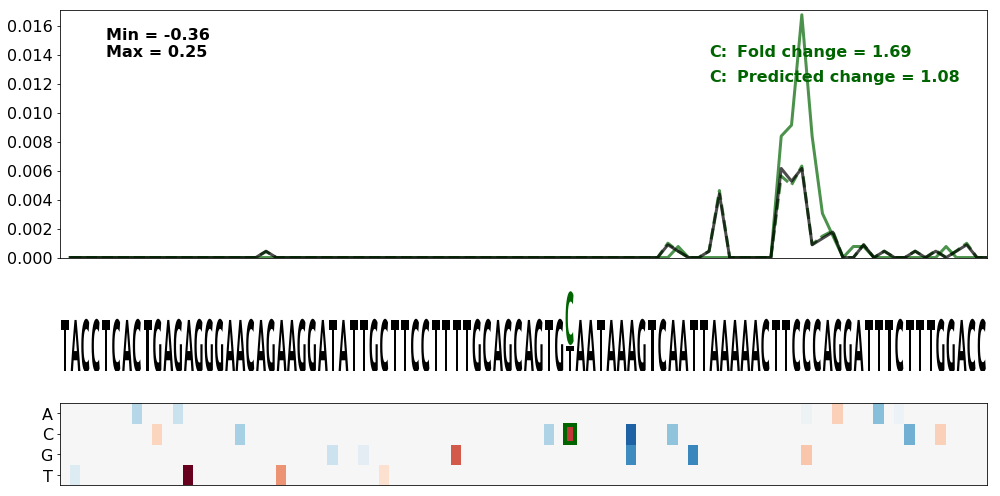

Gene = WDR72.1
WT seq = ATGTTGATGTTGTGGAGTTTTTGCAGTAATTTAATTTTTATAAATATTGTATTAAAATATATTTATCTTGATTACTGTTTTTTGTTTGTTTTGTTGTGTTTTGCCAGCACCTACTCTTGGATTCTGCTTGTTAAGTCTAAGATAAATTCACCTTTACCCCAGAA
SNV pos = 48
SNV nt = A


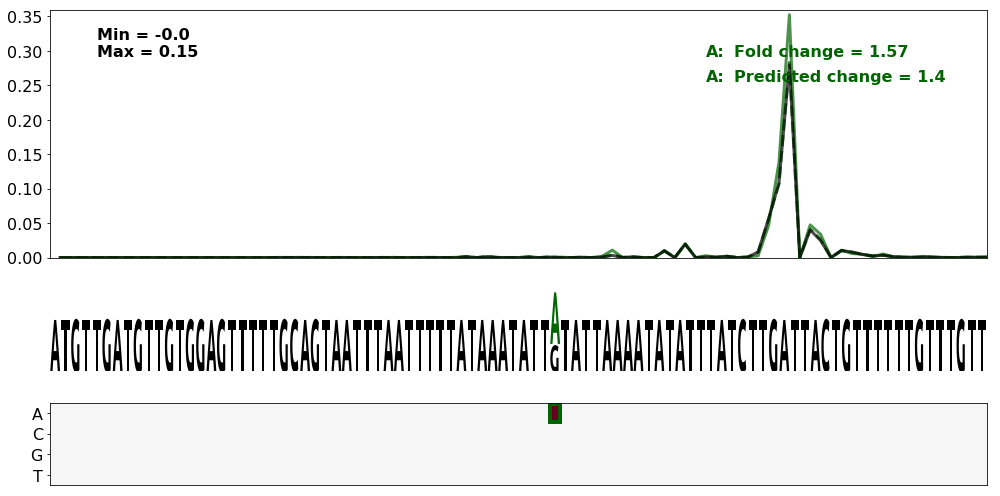

Gene = RB1.16
WT seq = TTACTGGATATTTGGGTTTTTTCCAACTTTTTGATGCTATAAAATAATGTAATAAACATTTGTATTCGTAAGAATAATGCCTGGCACAAAGTGAGTCCTTGATAACTTGTTAAATAAATTAATGAATGAATCTCTGATTATTTTATTAGAATAAATTCTTATAA
SNV pos = 47
SNV nt = C


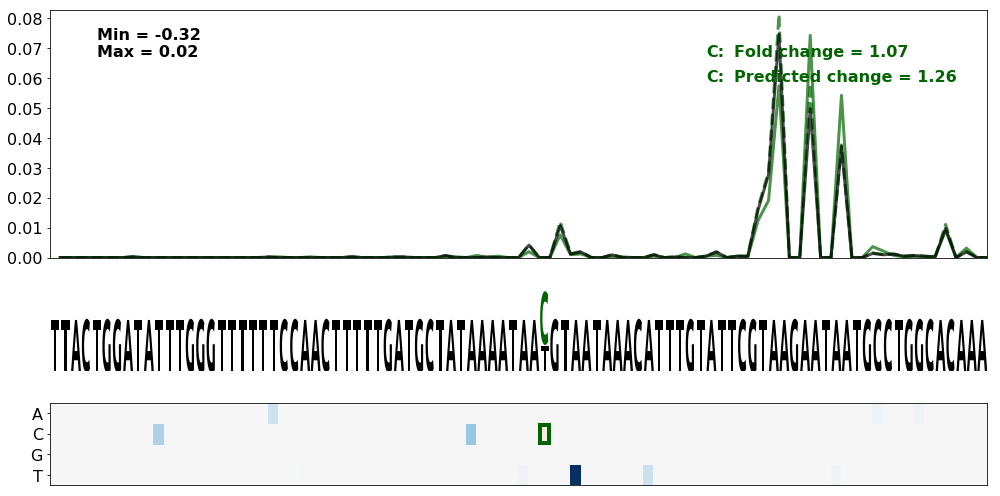

Gene = TGFBR1.11
WT seq = TACCTCACTGAGAGGGAACAGAAGGATATTGCTTCCTTTTGCAGCAGTGTAATAAAGTCAATTAAAAACTTCCCAGGATTTCTTTGGACCCAGGAAACAGCCATGTGGGTCCTTTCTGTGCACTATGAACGCTTCTTTCCCAGGACAGAAAATGTGTAGTCTAC
SNV pos = 47
SNV nt = C


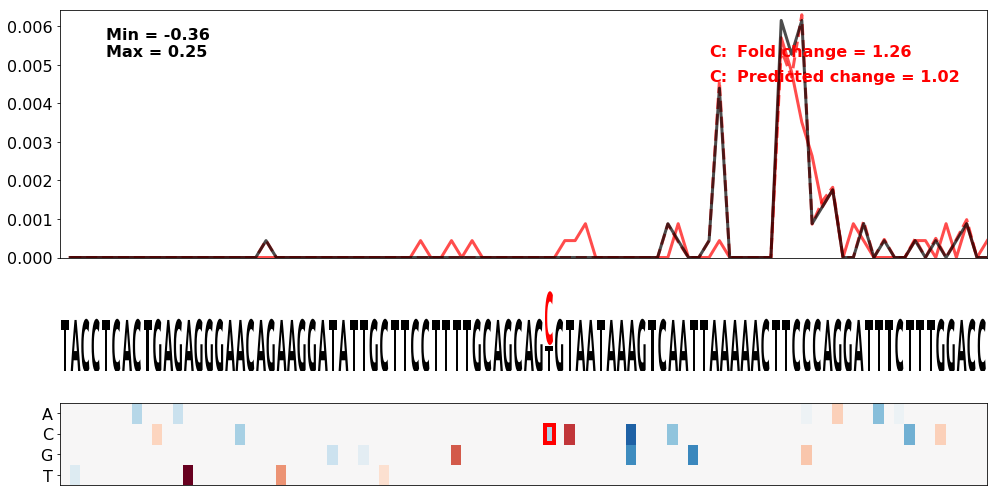

Gene = SYNE4.1
WT seq = CTACCTGGTGCTCAGCTATGTCAATGGTCTTCCCCCAGTCTGATGTGTGTAATAAATGGTCACTGTCAAAGGATGTGTGAAGATACTAGGTGCCTTCATACCCGGAATCTAGGATGTGGCCTGGATATGTCTGGATGGACCCTTTTGCCTTGAGAACAGAATAC
SNV pos = 47
SNV nt = C


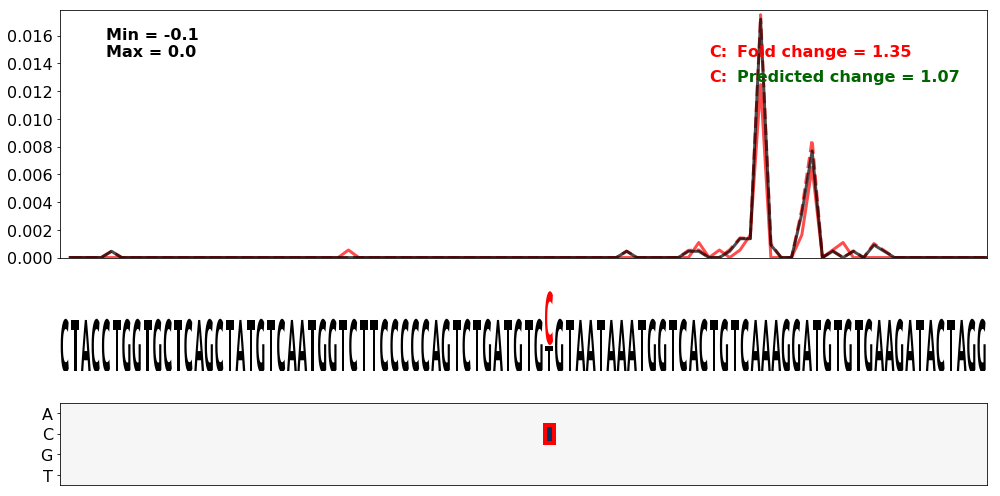

In [191]:
df_sel = tgta_boundary_df.sort_values(by='delta_logodds_true', ascending=False)
# and delta_logodds_true > 0.0

seq_start = 0
seq_end = 90#150

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    print('Gene = ' + gene_name)
    print('WT seq = ' + wt_seq)
    print('SNV pos = ' + str(snv_pos))
    print('SNV nt = ' + snv_nt)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen' if row['delta_logodds_true'] > 0 else 'red')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            #fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=150
    )

Gain of overlapping CSE:
Gene = INS.1
WT seq = CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
SNV pos = 49
SNV nt = T
ClinVar id = Missing
Observed:


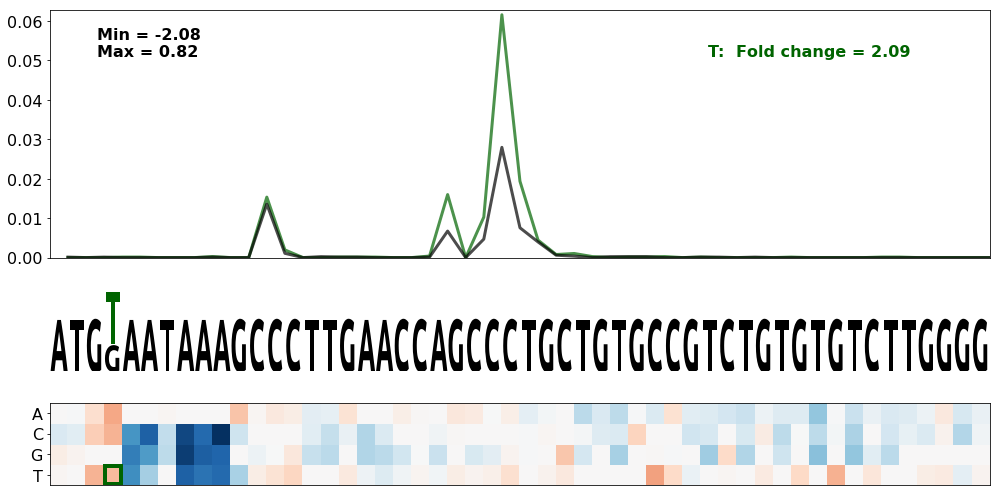

Predicted:


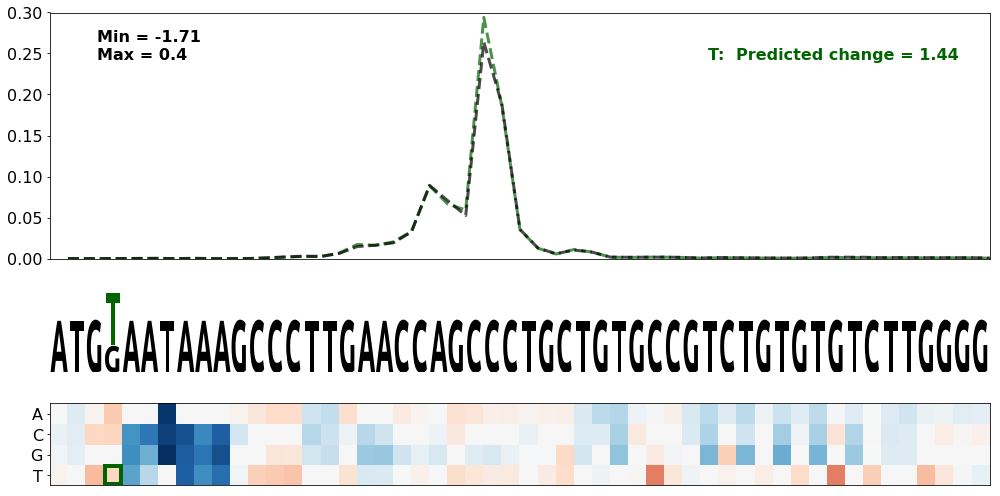

Both:


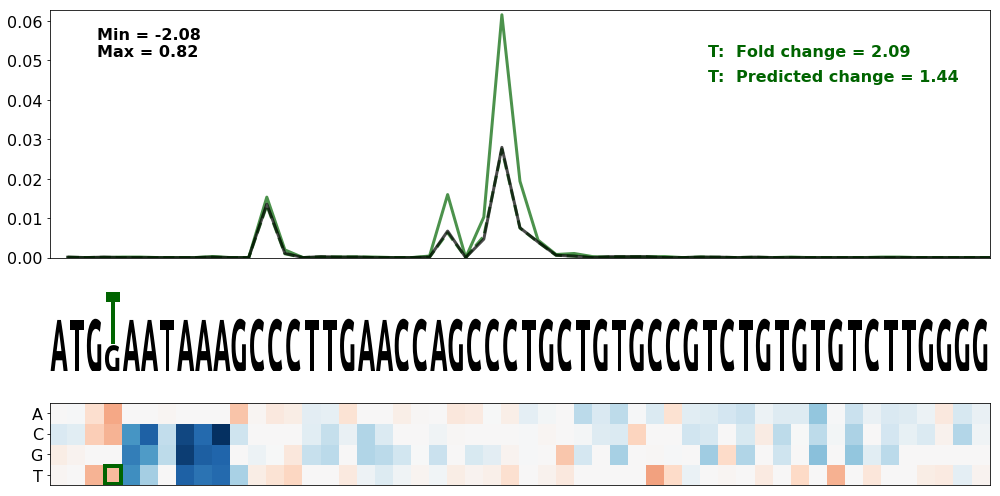

Gene = DSG2.1
WT seq = CTTAAAGGCAGGTGTTTCTTGGACTTTGTTATTTAATTAGATCTGCTTGCAATAAAAAAAGTTGTCGGTTATCTAAAATTCAAATTTATCGGGGTACTTGGCATTTTCATTGTCCAACTCTGGCAACCTTGTTCCTAAGGAAGTGAAGGTTGCTCTCTGCCCAG
SNV pos = 49
SNV nt = T
ClinVar id = Missing
Observed:


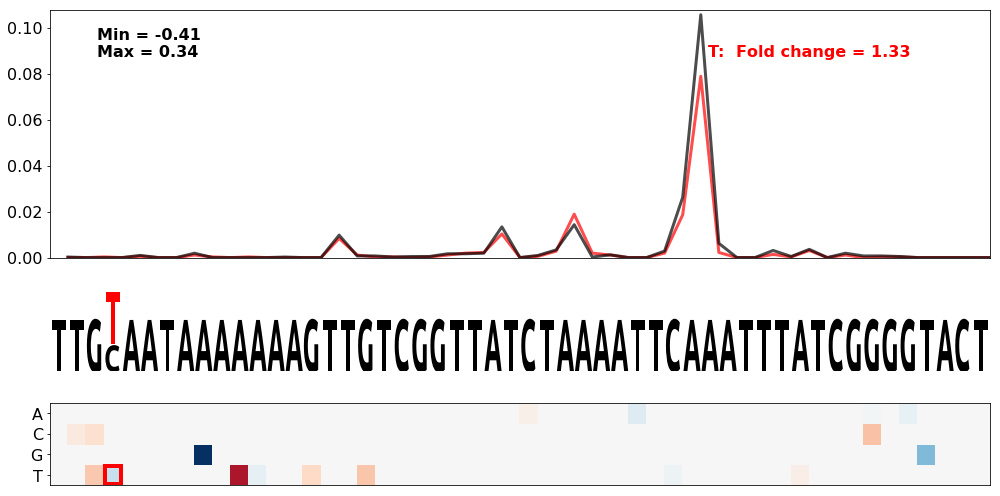

Predicted:


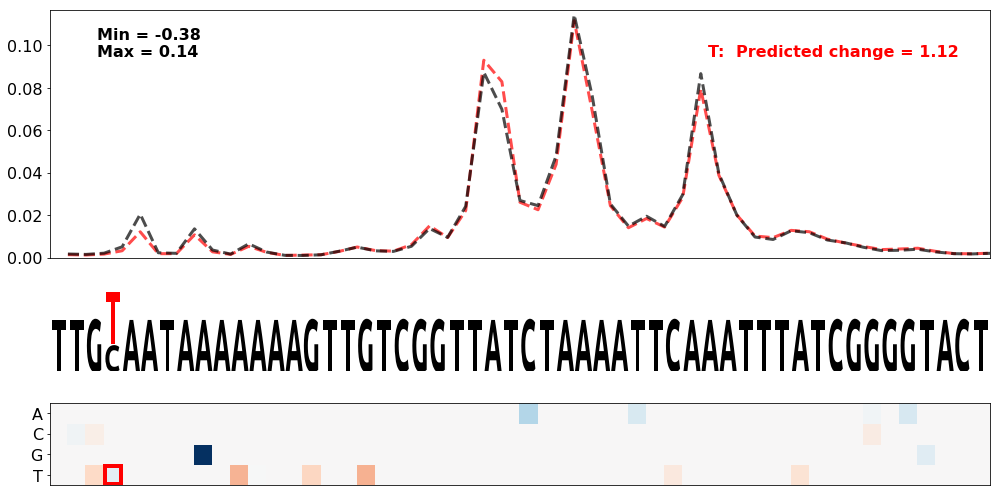

Both:


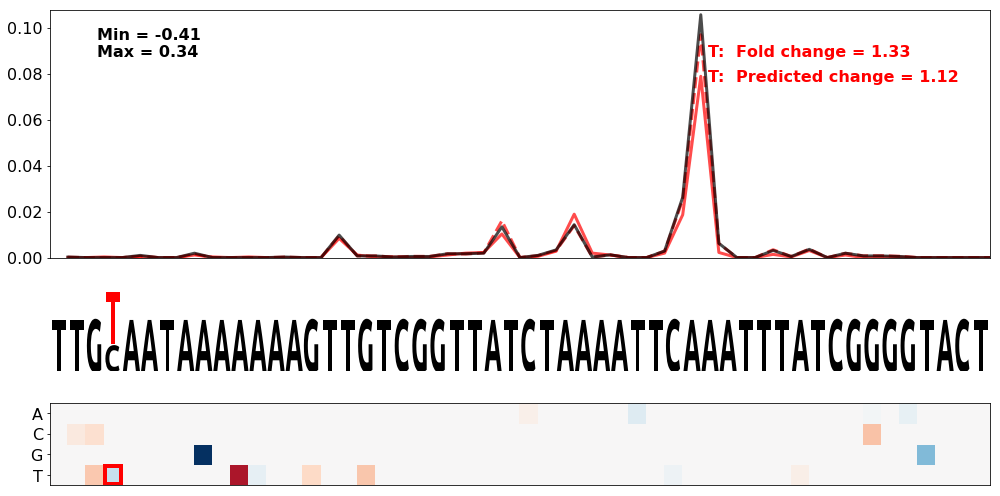

Gene = SNRNP200.3
WT seq = TATAGCATTTTCAGGCATGTTCCTGGTAGTTCTTTTGAGTCTGACATTCTAATAAAATAATTTGTAGAAACCATTTGTCTTTGTAGTGATTCCAAATTAAAAGTTTTCTTTCTCCAACCTGAGGGCACGGCCAAAAAGATCTGGTTATTTTTTAGCCAGGAACG
SNV pos = 48
SNV nt = G
ClinVar id = NM_014014.4(SNRNP200):c.*257C>G
Observed:


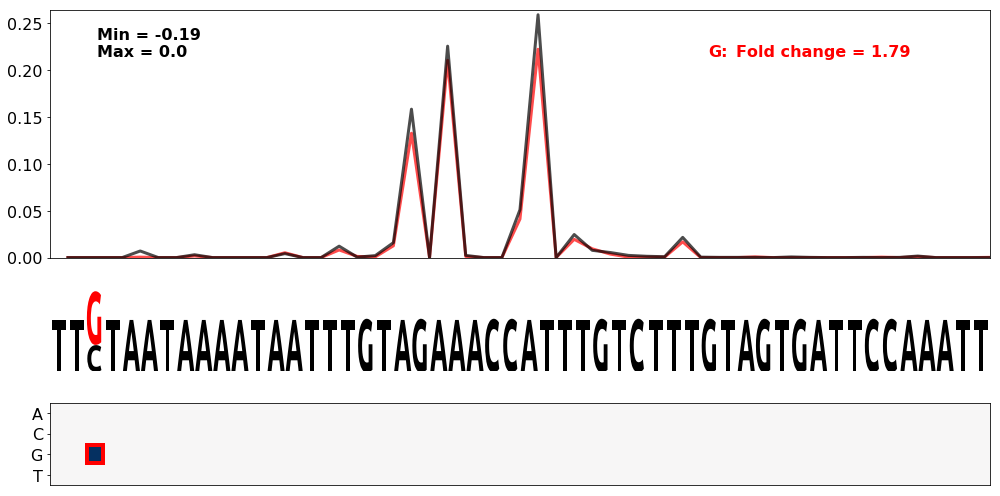

Predicted:


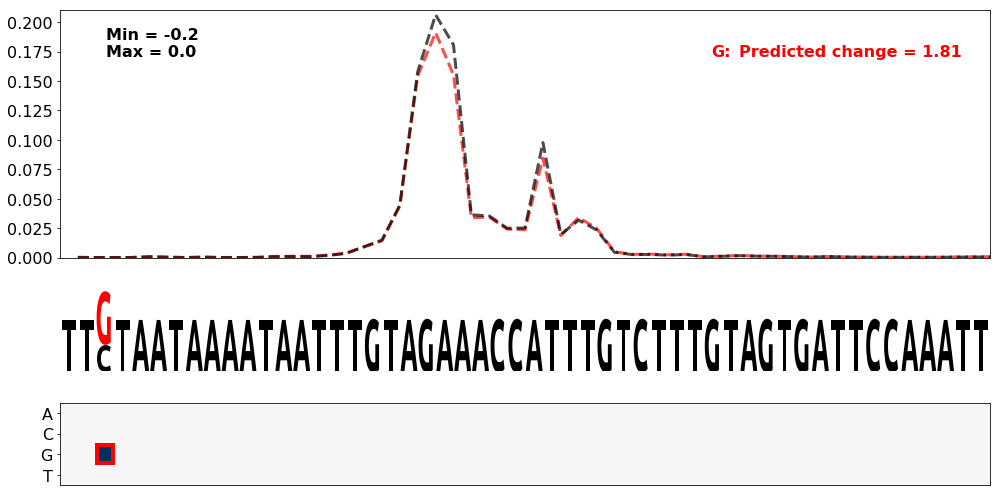

Both:


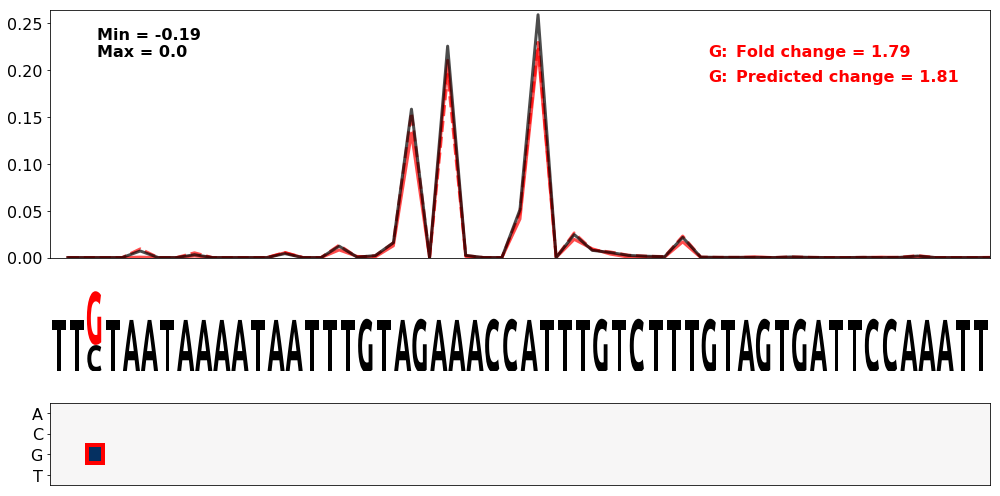

In [202]:
print('Gain of overlapping CSE:')

experiment_name = 'gain_of_overlapping_tgta'

gene_names = [
    'INS.1',
    'DSG2.1',
    'SNRNP200.3'
]

snv_list = [
    [(49, 'T', 'darkgreen')],
    [(49, 'T', 'red')],
    [(48, 'G', 'red')],
]

wt_seq_list = [
    'CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG',
    'CTTAAAGGCAGGTGTTTCTTGGACTTTGTTATTTAATTAGATCTGCTTGCAATAAAAAAAGTTGTCGGTTATCTAAAATTCAAATTTATCGGGGTACTTGGCATTTTCATTGTCCAACTCTGGCAACCTTGTTCCTAAGGAAGTGAAGGTTGCTCTCTGCCCAG',
    'TATAGCATTTTCAGGCATGTTCCTGGTAGTTCTTTTGAGTCTGACATTCTAATAAAATAATTTGTAGAAACCATTTGTCTTTGTAGTGATTCCAAATTAAAAGTTTTCTTTCTCCAACCTGAGGGCACGGCCAAAAAGATCTGGTTATTTTTTAGCCAGGAACG'
]

seq_start = 46
seq_end = 98

save_figs = False

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

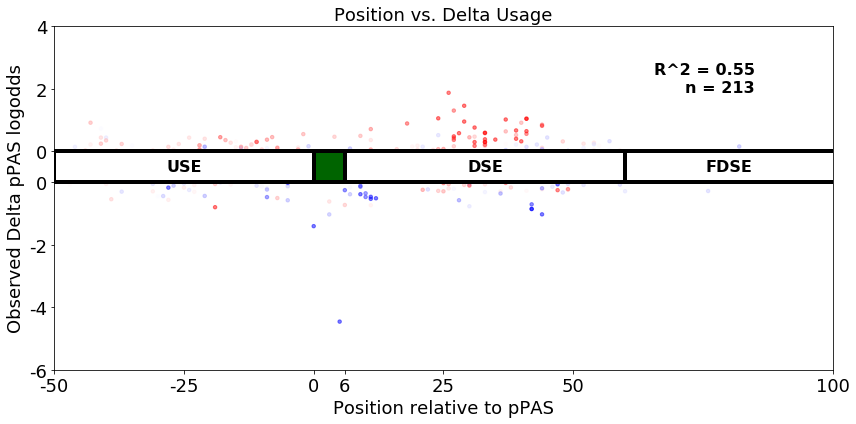

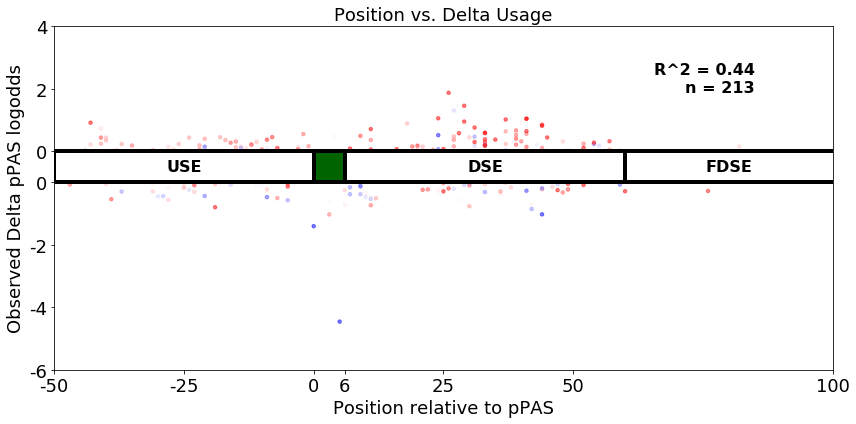


# Gain of ['TGTCT', 'TGTGT'] = 213
# Neural net / Observation agreement = 150
# Neural net / 6-mer model agreement = 155
## Gain of motif in USE = 83
### Gain of motif, Loss of function = 34
### Gain of motif, Gain of function = 49
### Neural net / 6-mer model agreement = 62
## Gain of motif in DSE = 125
### Gain of motif, Loss of function = 50
### Gain of motif, Gain of function = 75
### Neural net / 6-mer model agreement = 91


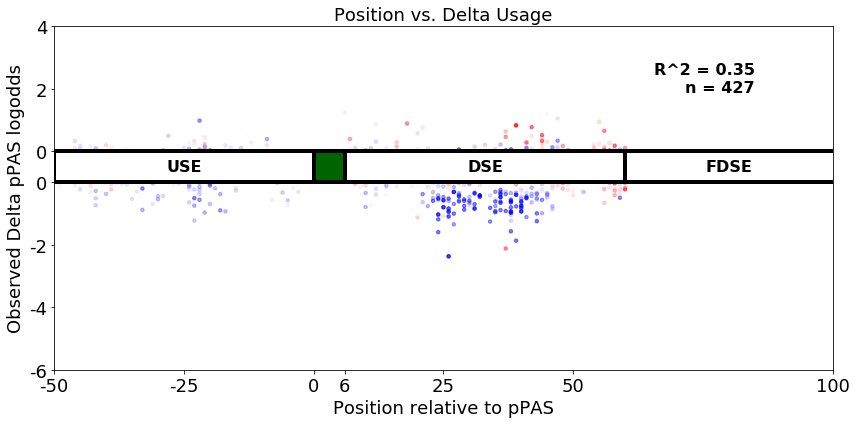

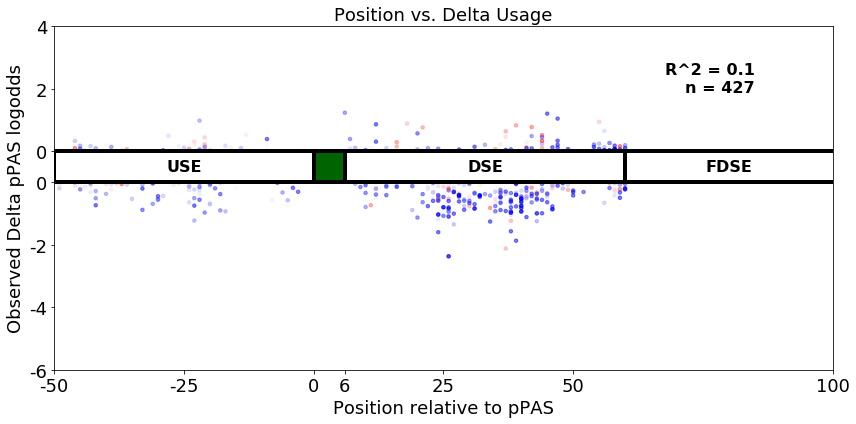


# Loss of ['TGTCT', 'TGTGT'] = 427
# Neural net / Observation agreement = 301
# Neural net / 6-mer model agreement = 330
## Loss of motif in USE = 115
### Loss of motif, Loss of function = 70
### Loss of motif, Gain of function = 45
### Neural net / 6-mer model agreement = 98
## Loss of motif in DSE = 312
### Loss of motif, Loss of function = 229
### Loss of motif, Gain of function = 83
### Neural net / 6-mer model agreement = 232


In [15]:
#Gain/Loss of CSTF site

save_figs = False

motifs = ['TGTCT', 'TGTGT']

gain_of_motif_index = []
loss_of_motif_index = []

for motif in motifs :
    i = 0
    for _, row in df_var.iterrows() :

        snv_pos = row['snv_pos']

        var_seq = row['master_seq']
        ref_seq = row['wt_seq']

        motif_len = len(motif)

        var_motif_dict = {}
        ref_motif_dict = {}
        for offset in range(-motif_len + 1, motif_len - 1) :

            var_motif = var_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(var_motif) == motif_len :
                if var_motif not in var_motif_dict :
                    var_motif_dict[var_motif] = 0
                var_motif_dict[var_motif] += 1

            ref_motif = ref_seq[snv_pos+offset:snv_pos+offset + motif_len]
            if len(ref_motif) == motif_len :
                if ref_motif not in ref_motif_dict :
                    ref_motif_dict[ref_motif] = 0
                ref_motif_dict[ref_motif] += 1

        if motif in var_motif_dict and motif not in ref_motif_dict :
            gain_of_motif_index.append(i)
        elif motif not in var_motif_dict and motif in ref_motif_dict :
            loss_of_motif_index.append(i)

        i += 1


gain_of_motif_df = df_var.iloc[gain_of_motif_index].copy().set_index('master_seq')
loss_of_motif_df = df_var.iloc[loss_of_motif_index].copy().set_index('master_seq')

fig_name = None
if save_figs :
    fig_name = 'gain_of_tgtct_neural_net'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'gain_of_tgtct_hexamer_model'
plot_position_delta_scatter(gain_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Gain of ' + str(motifs) + ' = ' + str(len(gain_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df['delta_logodds_pred']) == np.sign(gain_of_motif_df['delta_6mer_score']))[0])))
print('## Gain of motif in USE = ' + str(len(gain_of_motif_df.query("snv_pos < 50"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Gain of motif in DSE = ' + str(len(gain_of_motif_df.query("snv_pos >= 56"))))
print('### Gain of motif, Loss of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Gain of motif, Gain of function = ' + str(len(gain_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(gain_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


fig_name = None
if save_figs :
    fig_name = 'loss_of_tgtct_neural_net'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)
fig_name = None
if save_figs :
    fig_name = 'loss_of_tgtct_hexamer_model'
plot_position_delta_scatter(loss_of_motif_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=fig_name, fig_dpi=150, annotate=None)

print('')
print('# Loss of ' + str(motifs) + ' = ' + str(len(loss_of_motif_df)))
print("# Neural net / Observation agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_logodds_true']))[0])))
print("# Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df['delta_logodds_pred']) == np.sign(loss_of_motif_df['delta_6mer_score']))[0])))
print('## Loss of motif in USE = ' + str(len(loss_of_motif_df.query("snv_pos < 50"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos < 50 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos < 50")['delta_6mer_score']))[0])))

print('## Loss of motif in DSE = ' + str(len(loss_of_motif_df.query("snv_pos >= 56"))))
print('### Loss of motif, Loss of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true < 0.0"))))
print('### Loss of motif, Gain of function = ' + str(len(loss_of_motif_df.query("snv_pos >= 56 and delta_logodds_true > 0.0"))))
print("### Neural net / 6-mer model agreement = " + str(len(np.nonzero(np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_logodds_pred']) == np.sign(loss_of_motif_df.query("snv_pos >= 56")['delta_6mer_score']))[0])))


Gain of TGT[C/G]T:
Gene = PRKAG2.1
SNV pos = 74
SNV nt = G
ClinVar id = Missing
Observed:


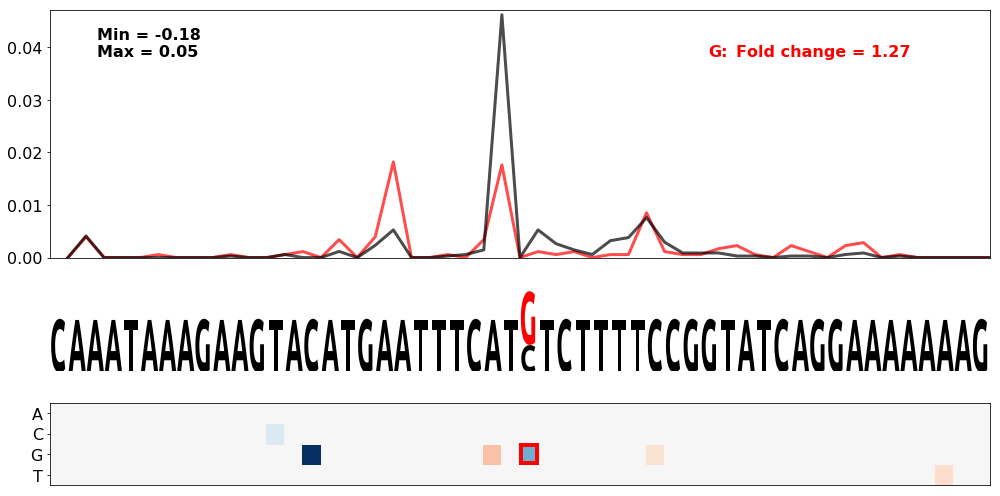

Predicted:


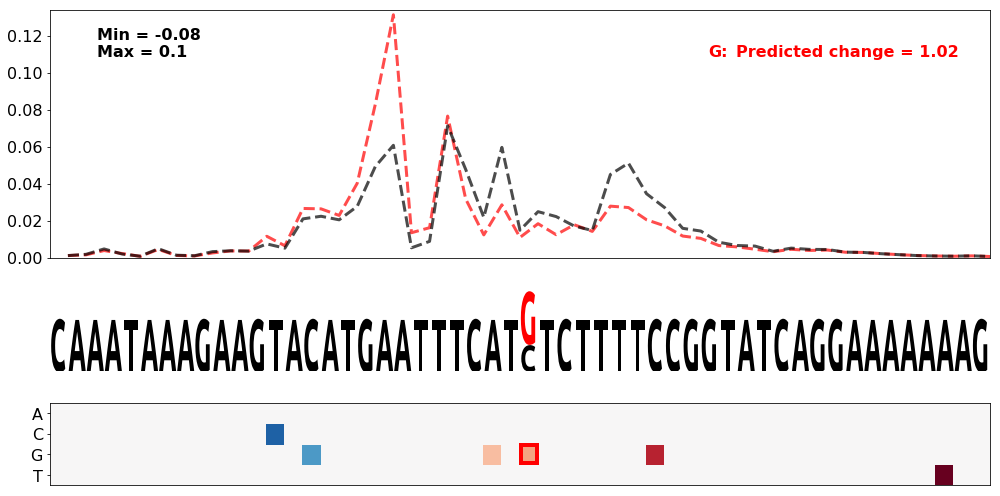

Both:


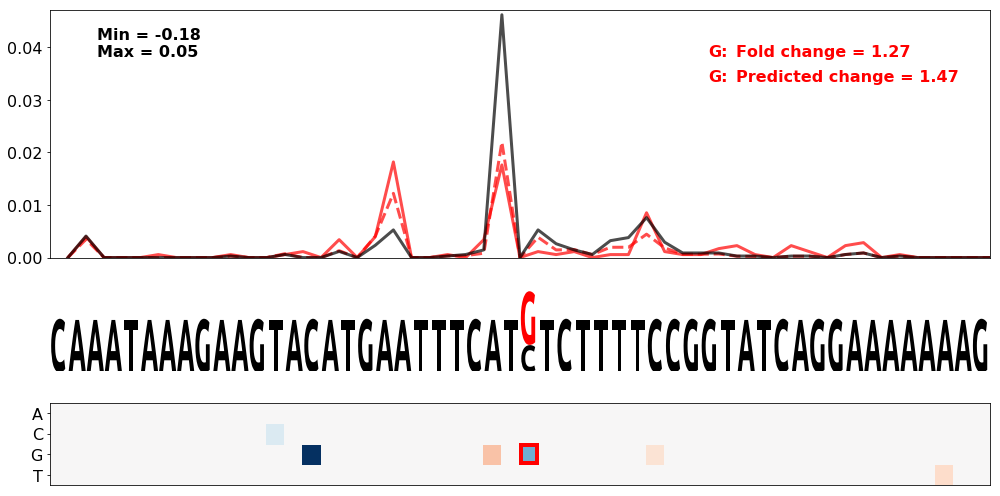

Gene = RYR2.5
SNV pos = 75
SNV nt = G
ClinVar id = Missing
Observed:


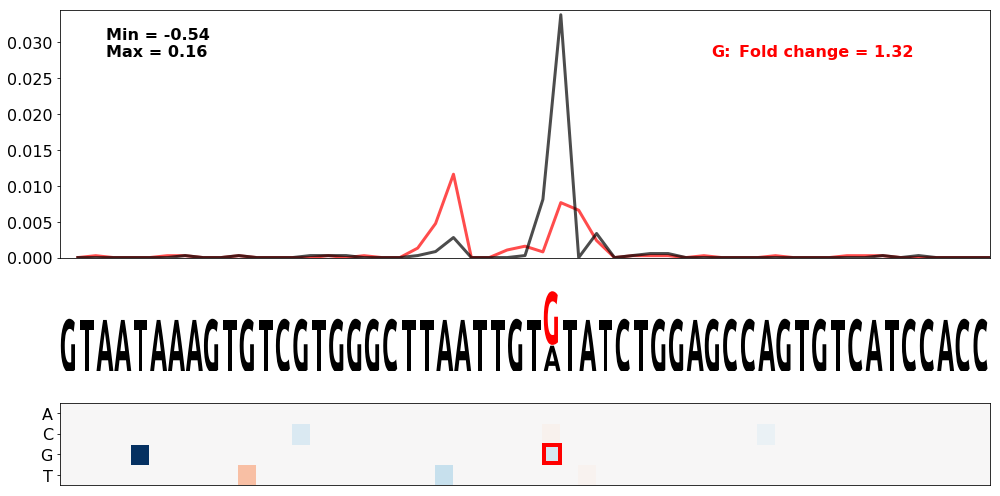

Predicted:


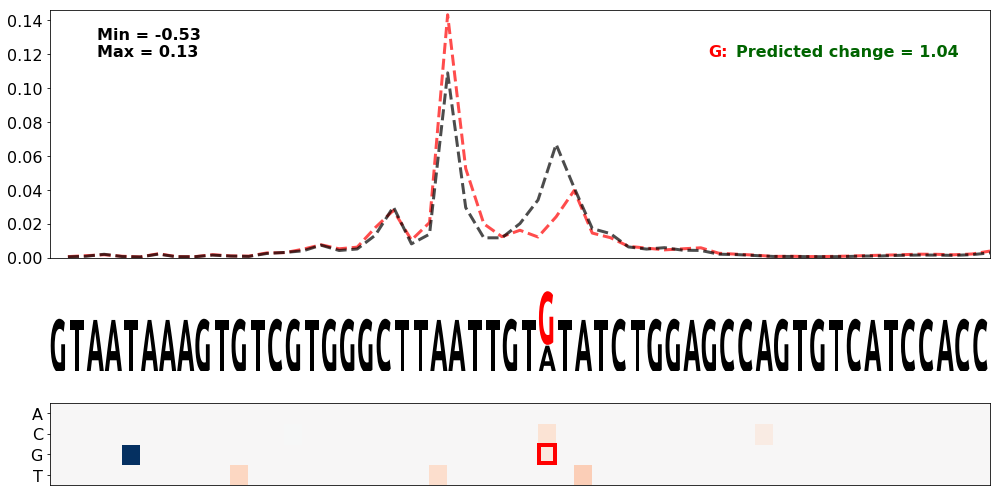

Both:


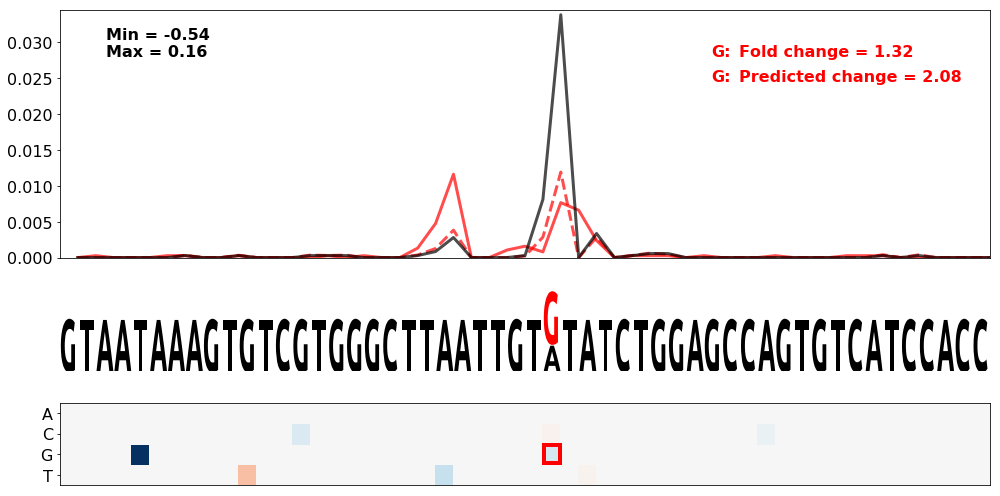

Gene = TP53.3
WT seq = CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
SNV pos = 73
SNV nt = C
ClinVar id = Missing
Observed:


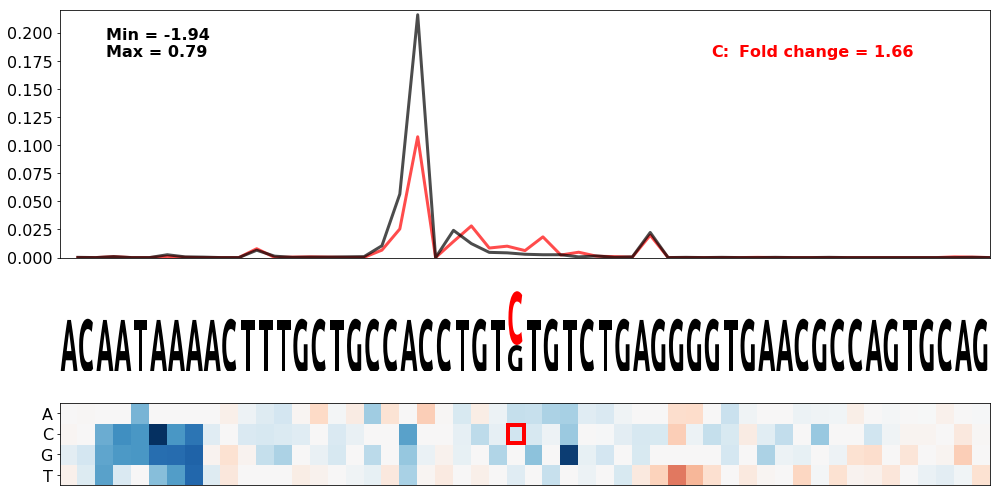

Predicted:


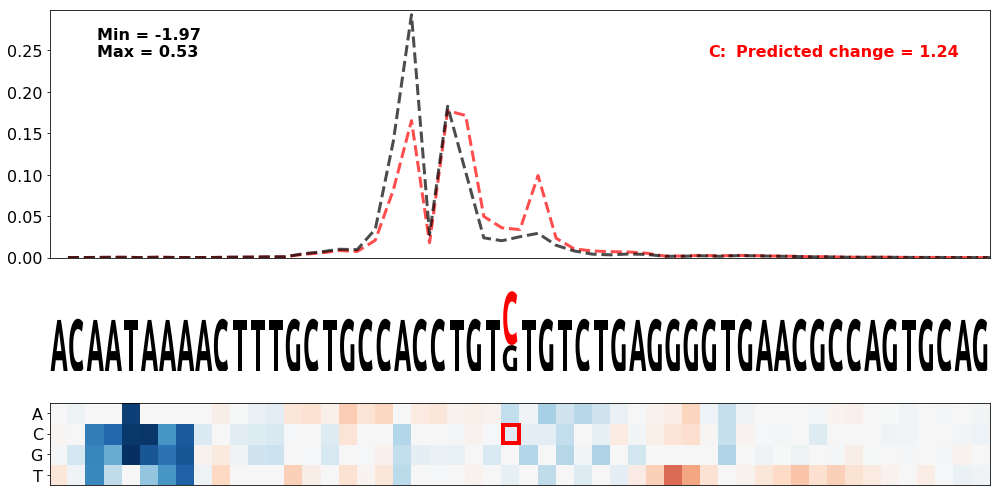

Both:


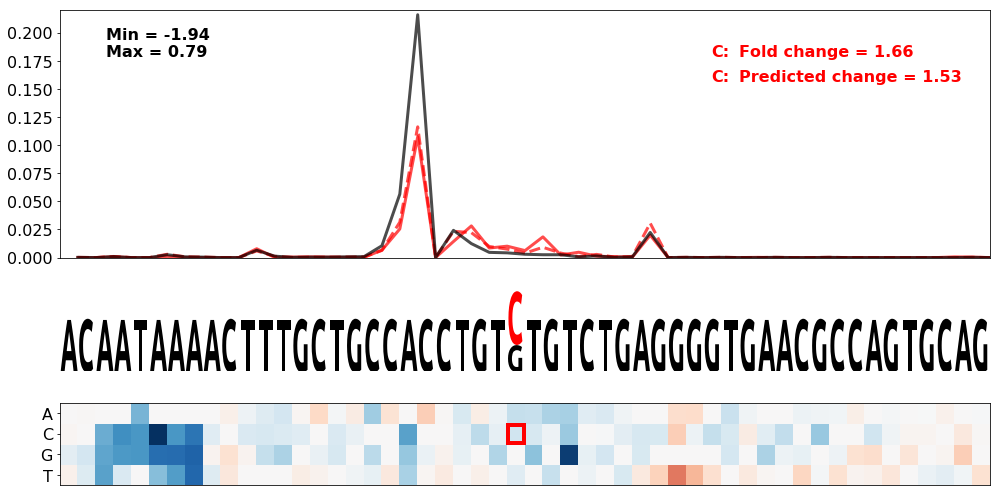

In [208]:
print('Gain of TGT[C/G]T:')

experiment_name = 'gain_of_tgtct'

gene_names = [
    'PRKAG2.1',
    'RYR2.5',
    'TP53.3'
]

snv_list = [
    [(74, 'G', 'red')],
    [(75, 'G', 'red')],
    [(73, 'C', 'red')]
]

wt_seq_list = [
    None,
    None,
    'CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG'
]

seq_start = 48
seq_end = 100

save_figs = True

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    if specific_seq is not None :
        print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

Loss of TGT[C/G]T:
Gene = PTEN.13
SNV pos = 92
SNV nt = T
ClinVar id = Missing
Observed:


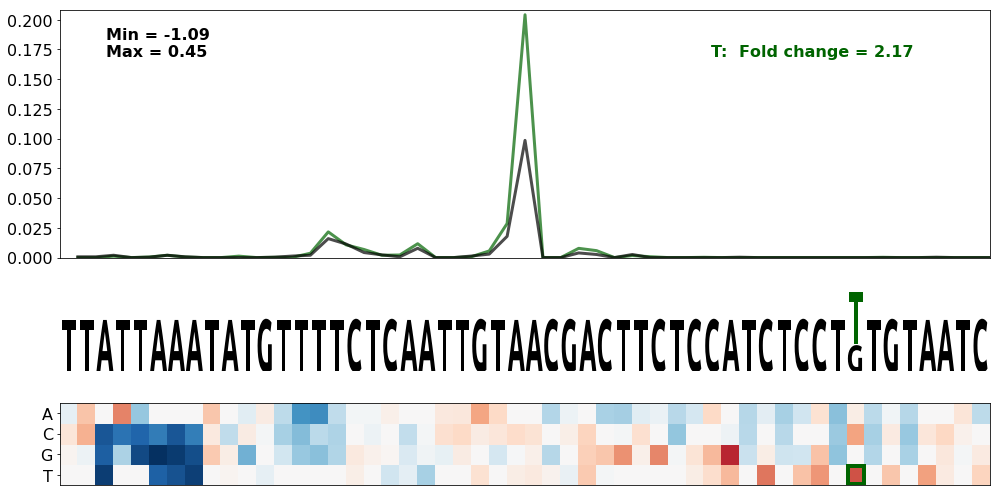

Predicted:


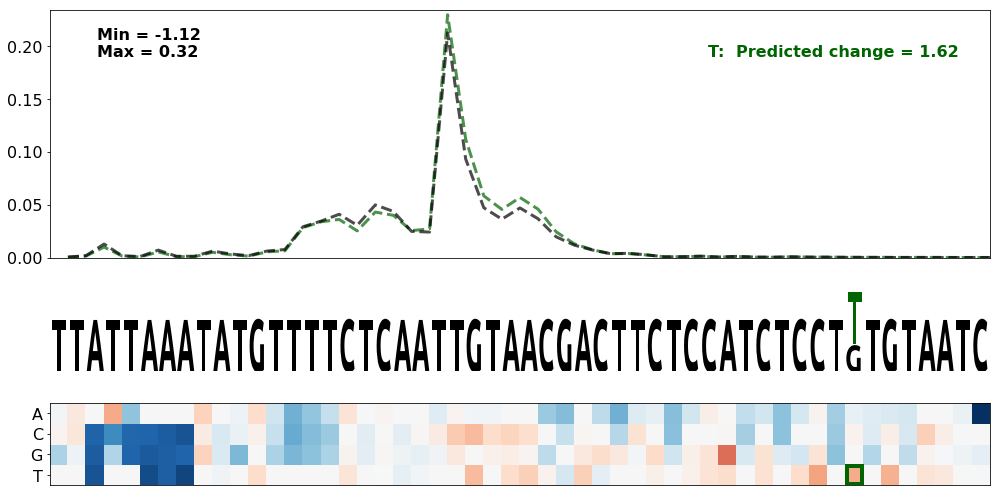

Both:


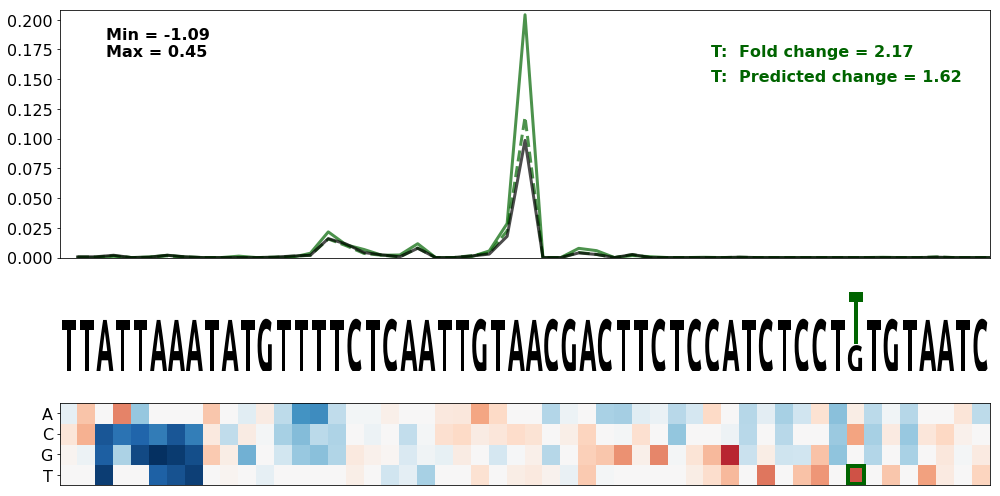

Gene = PTEN.8
SNV pos = 95
SNV nt = G
ClinVar id = Missing
Observed:


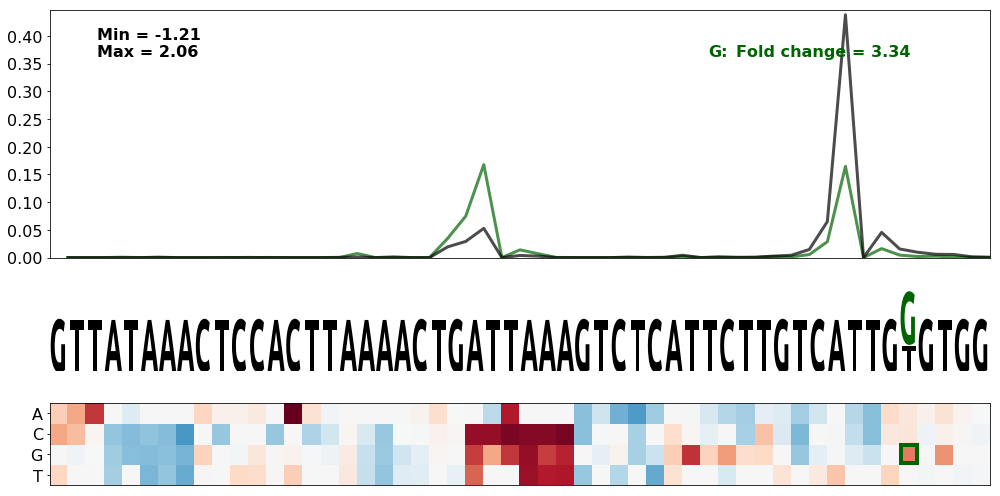

Predicted:


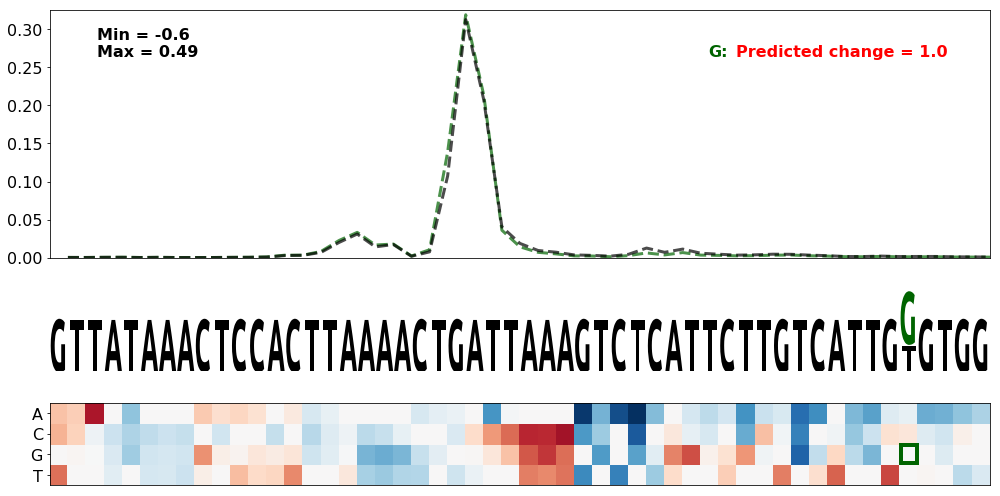

Both:


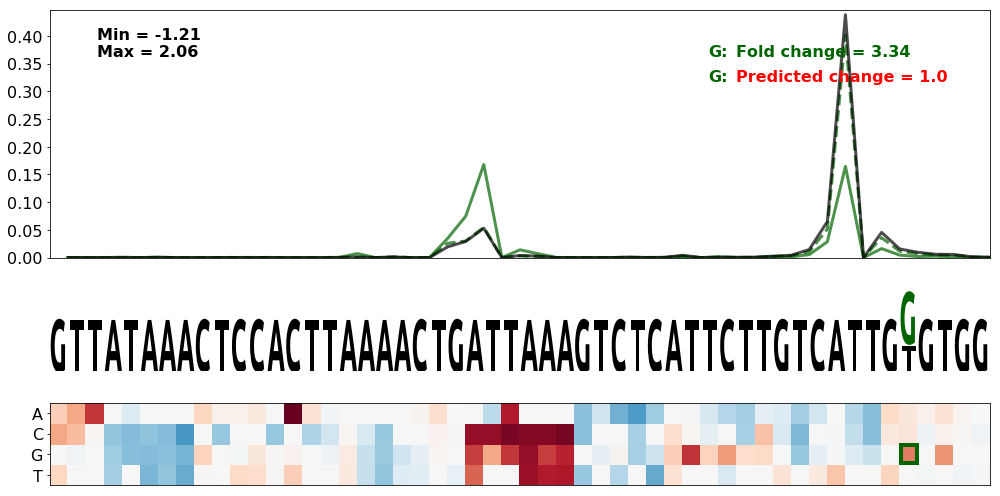

Gene = INS.1
SNV pos = 89
SNV nt = T
ClinVar id = Missing
Observed:


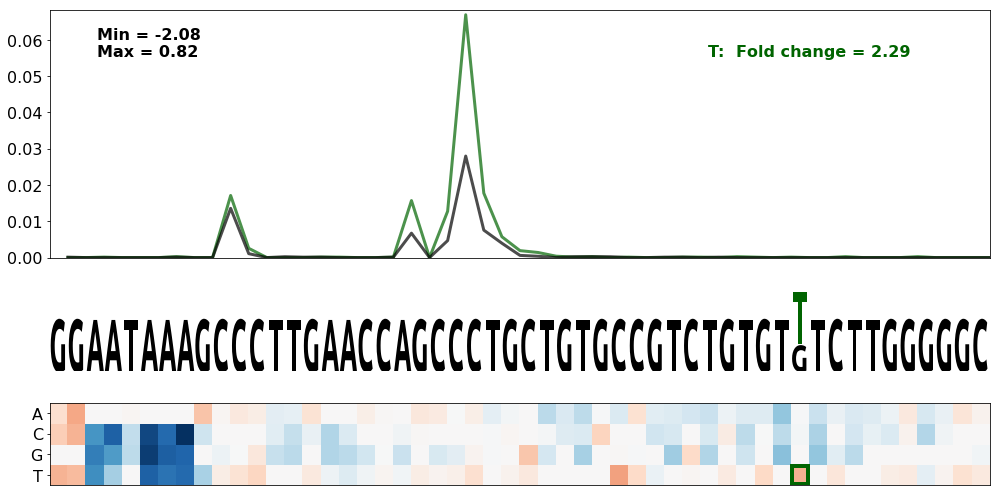

Predicted:


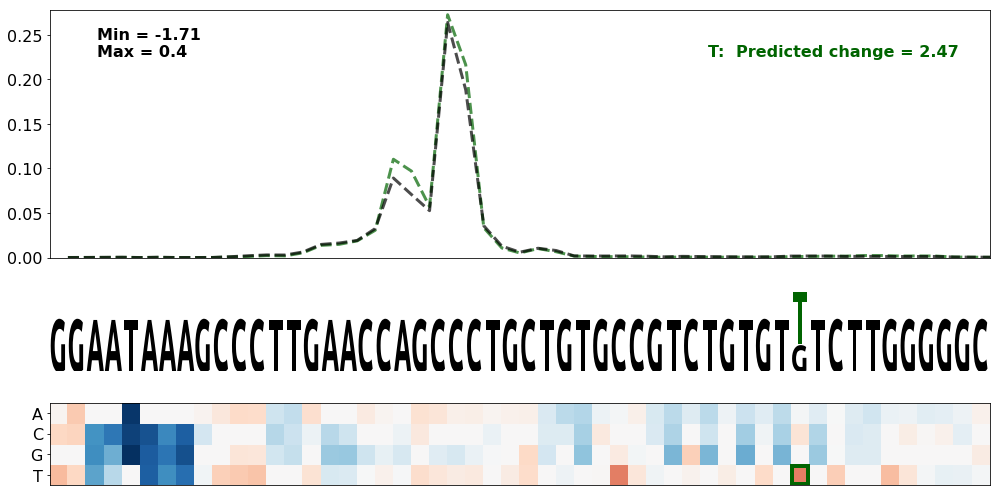

Both:


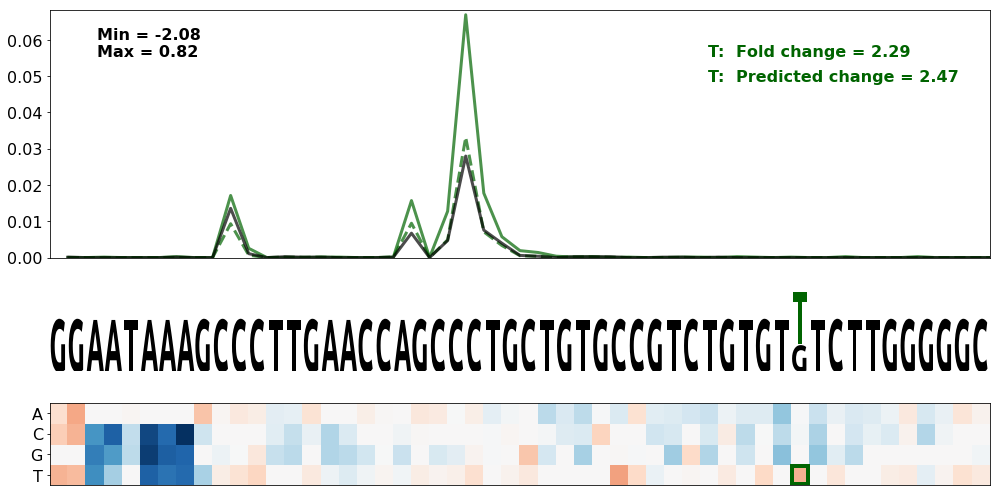

In [210]:
print('Loss of TGT[C/G]T:')

experiment_name = 'loss_of_tgtct'

gene_names = [
    'PTEN.13',
    'PTEN.8',
    'INS.1'
]

snv_list = [
    [(92, 'T', 'darkgreen')],
    [(95, 'G', 'darkgreen')],
    [(89, 'T', 'darkgreen')]
]

wt_seq_list = [
    None,
    None,
    None
]

seq_start = 48
seq_end = 100

save_figs = True

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = seq_predicted_isoform_df_delta
    if specific_seq is not None :
        df_sel = seq_predicted_isoform_df_delta.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    if specific_seq is not None :
        print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts(
            df_sel,
            gene_name,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            #fold_change_from_cut_range=[60, 90],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

In [13]:
df_var['avg_pos_true_wt'] = df_var['pooled_cut_prob_true_wt'].apply(lambda p: np.sum(np.arange(len(p[57:110])) * (p[57:110] / np.sum(p[57:110]))))
df_var['avg_pos_true_var'] = df_var['pooled_cut_prob_true_var'].apply(lambda p: np.sum(np.arange(len(p[57:110])) * (p[57:110] / np.sum(p[57:110]))))

pas_dict = {
    'AATAAA' : True,
    'ATTAAA' : True,
    'TATAAA' : True,
    'GATAAA' : True,
    'CATAAA' : True,
    'AGTAAA' : True,
    'ACTAAA' : True,
    'AAGAAA' : True,
    'AGGAAA' : True,
    'AACAAA' : True,
    'AATAAT' : True
}

pas_list = [
    'AATAAA',
    'ATTAAA',
    'TATAAA',
    'GATAAA',
    'CATAAA',
    'AGTAAA',
    'ACTAAA',
]

keep_index = []
i = 0
for _, row in df_var.iterrows() :
    snv_pos = row['snv_pos']

    var_region = row['master_seq'][57:105]
    ref_region = row['wt_seq'][57:105]

    pas_found = False
    for pas in pas_dict :
        if pas in var_region or pas in ref_region :
            pas_found = True
            break

    if not pas_found :
        keep_index.append(i)

    i += 1

df_var_no_pas = df_var.iloc[keep_index].copy()

print(len(df_var_no_pas))

df_var_no_pas['delta_pos_true'] = df_var_no_pas['avg_pos_true_var'] - df_var_no_pas['avg_pos_true_wt']

#df_var_no_pas[['master_seq', 'wt_seq']].to_csv('array_cut_var_seqs.csv', sep=',')
df_var_no_pas_fold = pd.read_csv('array_cut_var_seqs_folded.csv', sep=',')
df_var_no_pas = df_var_no_pas.join(df_var_no_pas_fold.set_index('master_seq'), on='master_seq', rsuffix='folded')

10399


In [14]:
delta_entropy = []

for _, row in df_var_no_pas.iterrows() :
    
    var_seq = row['master_seq']
    ref_seq = row['wt_seq']
    
    snv_pos = row['snv_pos']
    
    ref_prob_tot = row['pooled_cut_prob_true_wt']
    var_prob_tot = row['pooled_cut_prob_true_var']
    
    ref_prob = ref_prob_tot[57:105] / np.sum(ref_prob_tot[57:105])
    var_prob = var_prob_tot[57:105] / np.sum(var_prob_tot[57:105])
    
    delta_ent = np.sum(ref_prob[(ref_prob > 0) & (var_prob > 0)] * np.log(ref_prob[(ref_prob > 0) & (var_prob > 0)] / var_prob[(ref_prob > 0) & (var_prob > 0)]))
    
    delta_entropy.append(delta_ent)
    
df_var_no_pas['delta_entropy'] = delta_entropy

In [15]:
keep_index = []

i = 0
for _, row in df_var_no_pas.iterrows() :
    
    var_seq = row['master_seq']
    ref_seq = row['wt_seq']
    
    struct_var = row['struct_var']
    struct_ref = row['struct_wt']
    
    mfe_var = row['mfe_var']
    mfe_ref = row['mfe_wt']
    delta_mfe = row['delta_mfe']
    
    snv_pos = row['snv_pos']
    
    cut_pos_var = int(row['avg_pos_true_var']) #+ 57
    cut_pos_ref = int(row['avg_pos_true_wt']) #+ 57
    
    if delta_mfe < -2 and mfe_var < -4.0 : #and struct_var != struct_ref :
    #if np.abs(delta_mfe) > 3.0 :
        keep_index.append(i)
    
    i += 1

df_var_foldchange = df_var_no_pas.iloc[keep_index]

print(len(df_var_no_pas))

print(len(df_var_foldchange))

10399
147


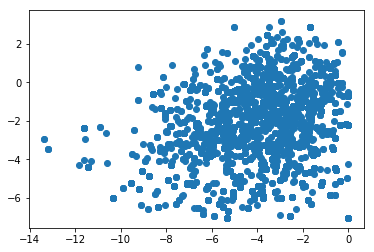

In [16]:

f = plt.figure()

plt.scatter(df_var_no_pas['mfe_wt'], df_var_no_pas['pooled_proximal_logodds_true_wt'])

plt.show()


LDLR.4
AATATCGAGAACTGCCATTGTCGTCTTTATGTCCGCCCACCTAGTGCTTCCACTTCTATGCAAATGCCTCCAAGCCATTCACTTCCCCAATCTTGTCGTTGATGGGTATGTGTTTAAAACATGCACGGTGAGGCCGGGCGCAGTGGCTCACGCCTGTAATCCCA
66
G
-3.9010000000000002
-8.762
...((....))..................((((.............))))....
......((((((.....))))))......((((.............))))....


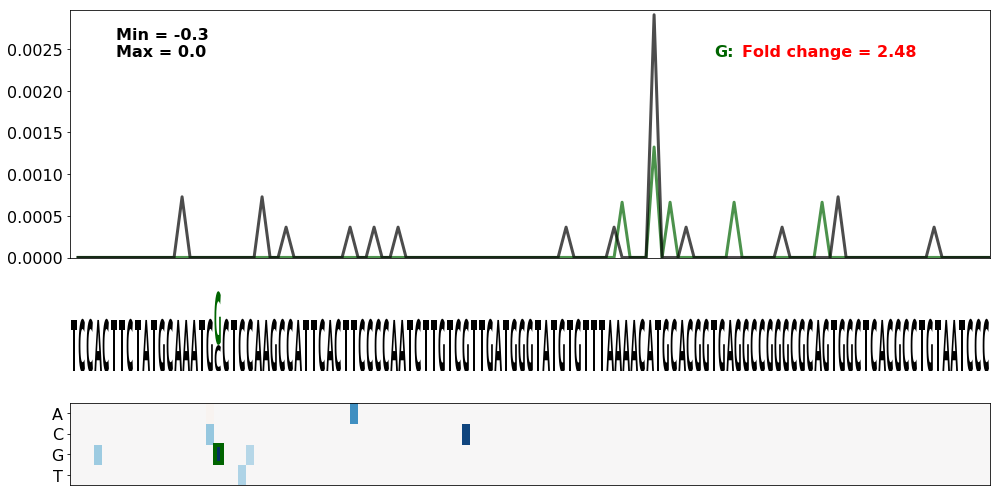

NF2.3
TCCGTGGGAGCTCCAGAACTTTCCCCAGCTGAGTGAAGAGCCCAGCCCCTCTTATGTGCAATTGCCTTGAACTACGACCCTGTAGAGATTTCTCTCATGGCGTTCTAGTTCTCTGACCTGAGTCTTTGTTTTAAGAAGTATTTGTCTTCCTTTGTCTAATGTGG
97
G
-6.22
-10.873
..(((.....)))....(((.((.((.((((....)))))).))))).......
..(((.....)))....(((.(((((.((((....)))))))))))).......


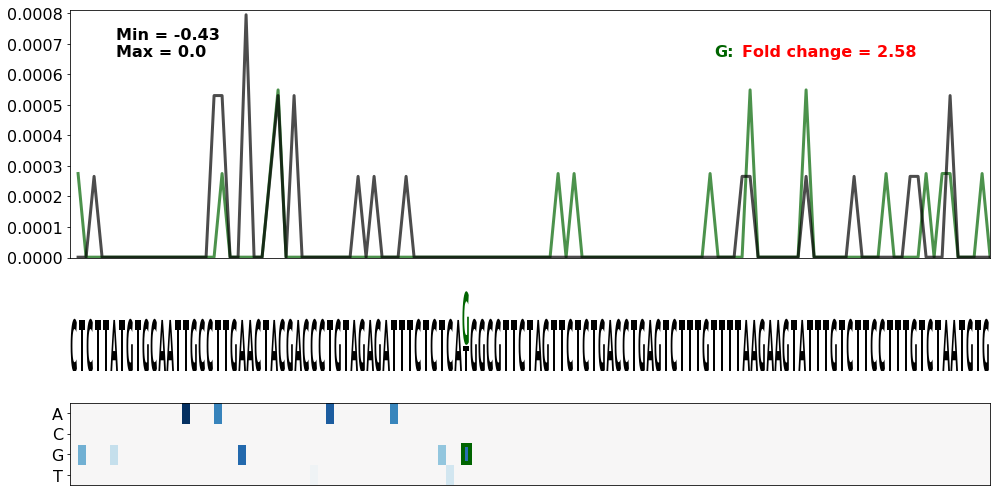

PTEN.16
TCTGAATTTTTTTTTATCAAGAGGGATAAAACACCATGAAAATAAACTTGAATAAACTGAAAATGGACCTTTTTTTTTTTAATGGCAATAGGACATTGTGTCAGATTACCAGTTATAGGAACAATTCTCTTTTCCTGACCAATCTTGTTTTACCCTATACATCC
107
G
-3.766
-8.232999999999999
((((.((((..(((.((.............)).))).))))...))))......
...((((......))))..........((((((..((((...))))..))))))


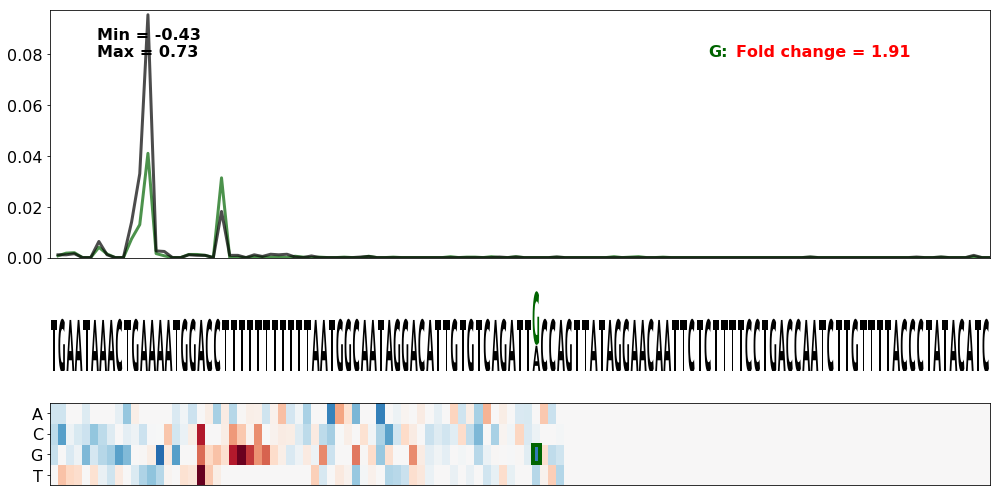

ARSA.3
GCCTGTGGGGGAGGCTCAGGTGTCTGGAGGGGGTTTGTGCCTGATAACGTAATAACACCAGTGGAGACTTGCAGATGTGACAATTCGTCCAATCCTGGGGTAATGCTGTGTGCTGGTGCCGGTCCCCTGTGGTACGAATGAGGAAACTGAGGTGCAGAGAGGTT
83
G
-5.0889999999999995
-9.451
.((((((((((.(((((....)).))).)).))))...))))............
.((((((((((((((((....)).)))))).))))...))))............


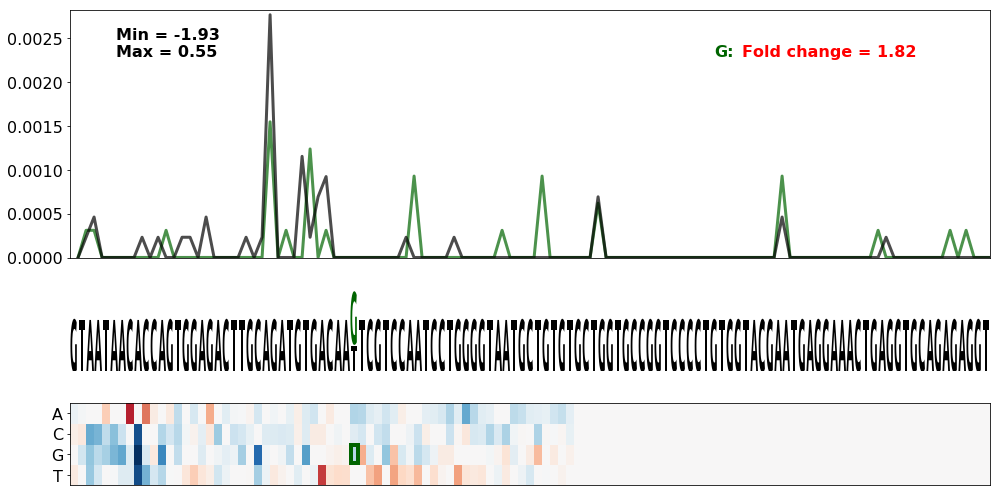

TMEM43.6
ATTAAAAGTTTTGTAATAAATTTCTAAATTATCTTCTGGTGTGGGACTTTAACAAACATCCTATTTTTAGTTTCAGATTTTTTTTTTTTGGCATTCTTTCCAAAATGTCTGTAAAGAATTCAGCCATAGGATTTATTGAGAACTGAATTTTGTGGAAATCTGAG
98
G
-3.82
-8.166
....(((....)))...............((((((........)))))).....
....(((....)))...............((((((((....)))))))).....


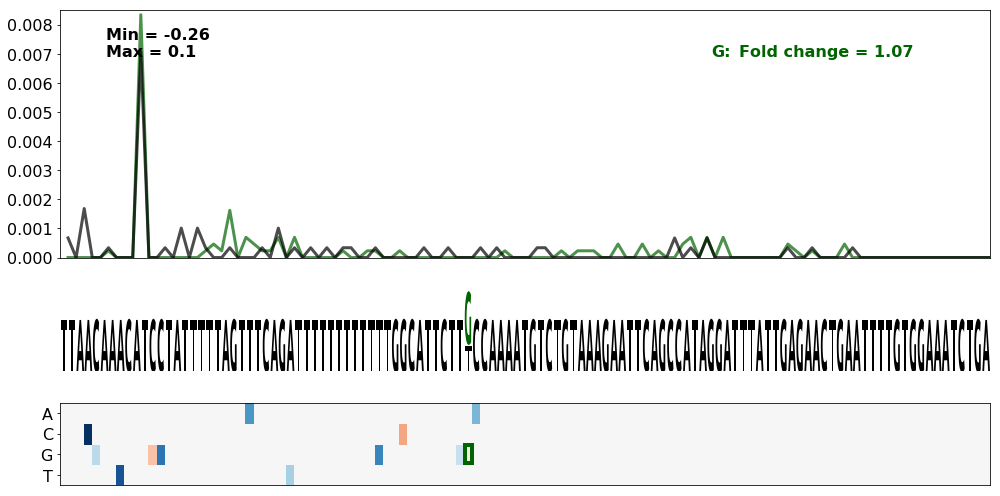

PEX5.3
GAATATGTGTAAATGATTTAAAAATAAAACTGTAAAATATTTGTACGAAGAATAAATGGAACTGATGTGGGTATGAGTTCTGCTGGTCATGAAGCTGGGATGGCAGAAGGTGAGTTGGCGTTTGGAGGACTGGGATTCAACAGTTTCTGCCTTTCAAATTCTCA
74
C
-5.011
-9.081
..(((((.((......)).)))))..............(((......)))....
..((((((((......))))))))..............(((......)))....


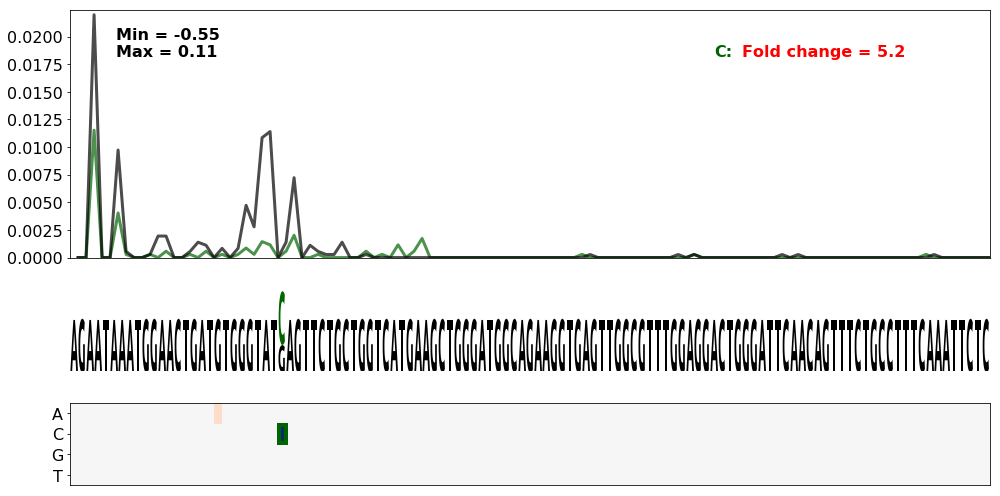

VHL.5
CACAGAAAATACGAGAAAATCTGCATGTTTGATTATAGTATTAATGGACAAATAAGTTTTTGCTAAATGTGAGTATTTCTGTTCCTTTTTGTAAATATGTGACATTCCTGATTGATTTGGGTTTTTTTGTTGTTGTTGTTTTGTTTTGTTTTGTTTTTTTGAGA
70
C
-1.7069999999999999
-5.771
.........(((((..((((((..............))))))...)))))....
.........(((((((.(((((..............)))))..)))))))....


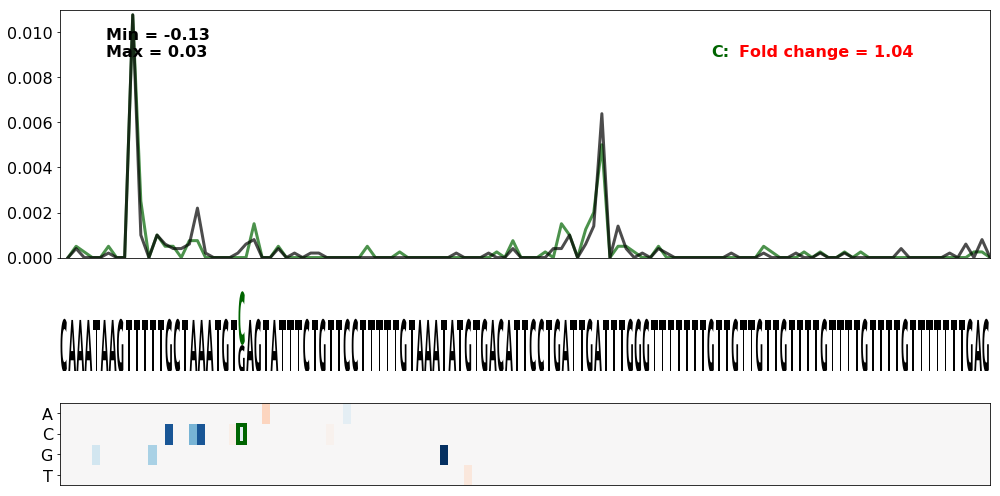

BRCA2.1
TGTATAATATCATGTTTTCAAATCTAATTATAAATACGTTTAAAGCCAAGAATAAATCTTTTAAAAAATTGACTTGTTTCCTTCCATAACTCTGAGCCATGATTTTTCTGTTCTGTAAAAAGCATTAACAAAATTGTCTATTTTGCTACTCCCTGTAACTTAAG
65
C
-0.465
-4.521
...................(((.........)))..........((....))..
......((((((.....)))))).....................((....))..


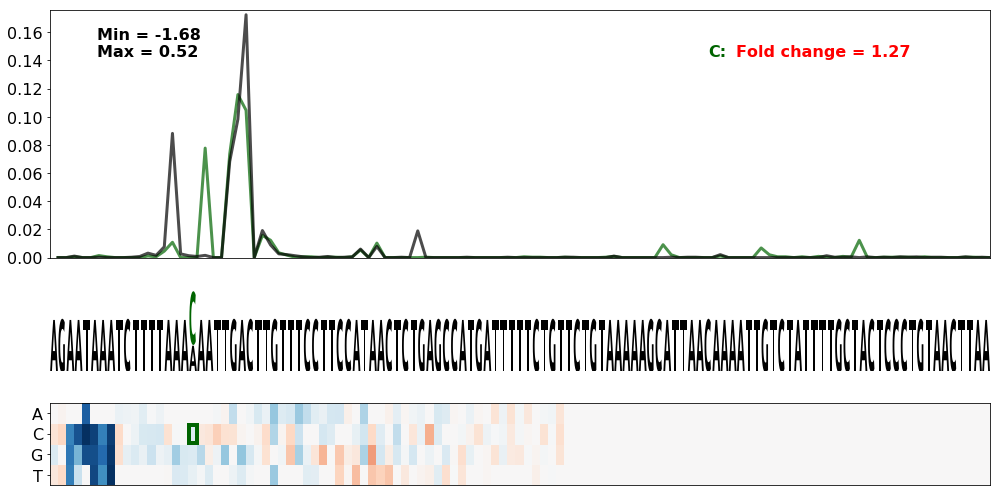

NF2.2
TAGAGATTTCTCTCATGGCGTTCTAGTTCTCTGACCTGAGTCTTTGTTTTAAGAAGTATTTGTCTTCCTTTGTCTAATGTGGGATTCCTGACTCCCTTCGTCCAAGGCACCGGTGTGTGTGTGTCTTGCACTCCAGAGCTGACCTCCACCGCCCAGCCTGGGAA
70
G
-2.975
-6.9
...............(((.(((.....)))...)))..((((.....))))...
..........((((((........((((.(....).)))).....))))))...


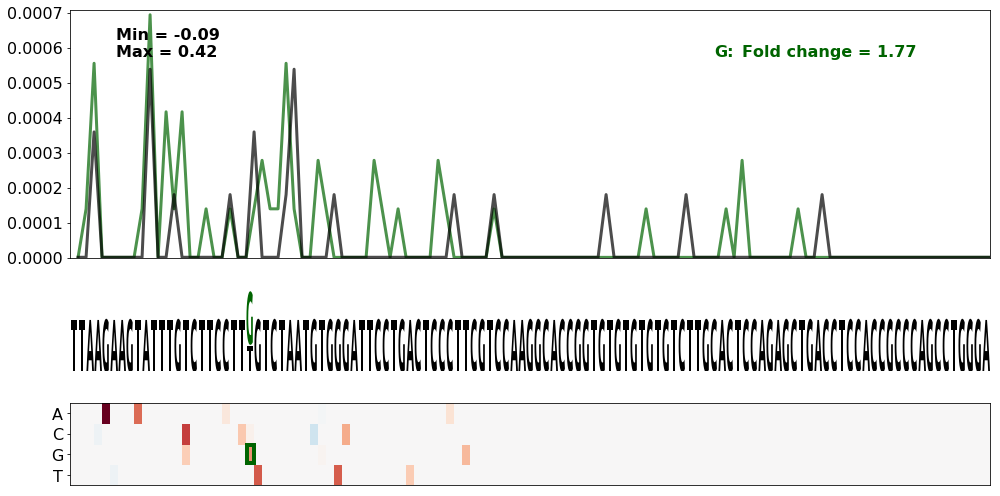

MLH1.3
ATTGTGAAACAGTGTCTGATGGTAGTTTTTATTTGCATTTTCTTGGTTGAAATAAAGTTGTGTATTTCAGCCAGGTGCGTTGGCTCATGCCTATAATCCCAGCACTTTAGGAGGCCAAGGTGGGCAGATCACTTGAGGCCAGGAGTTCAAGACCAGCCCAGCCA
70
G
-4.408
-8.241
..................((((...(((....)))..........)))).....
...(((((((..(((((.(.((....)).).)))))..)))....)))).....


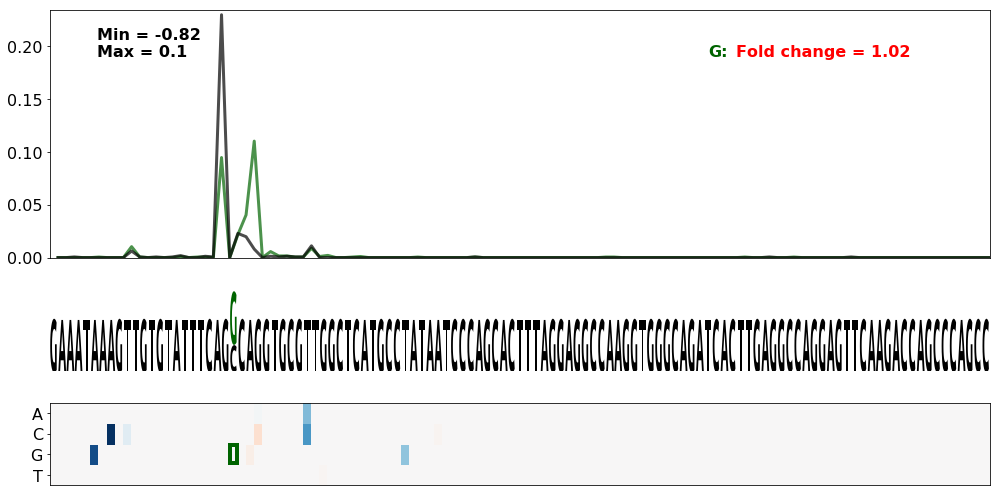

TP53.3
CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
76
G
-8.283999999999999
-12.027999999999999
..........((((.............))))..(.(((((.......))))).)
......(.(((((....))))).).........(.(((((.......))))).)


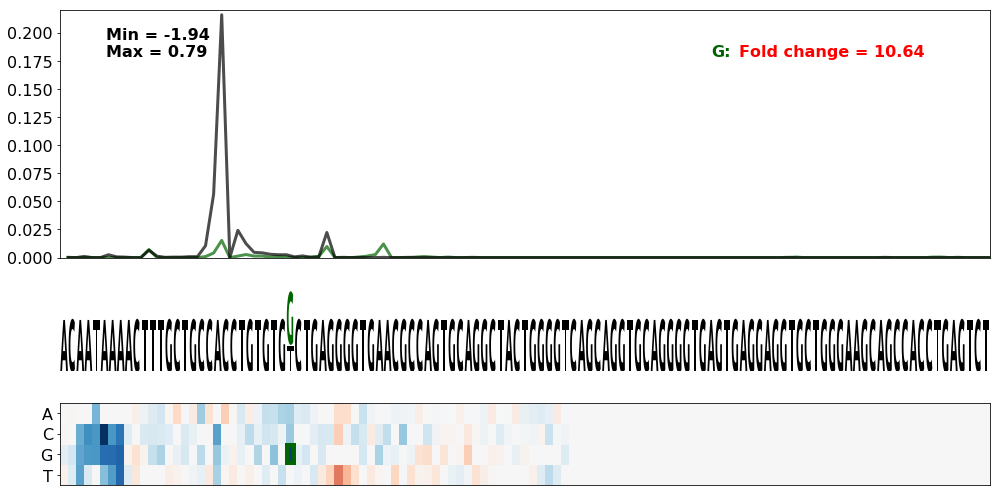

ARSA.3
GCCTGTGGGGGAGGCTCAGGTGTCTGGAGGGGGTTTGTGCCTGATAACGTAATAACACCAGTGGAGACTTGCAGATGTGACAATTCGTCCAATCCTGGGGTAATGCTGTGTGCTGGTGCCGGTCCCCTGTGGTACGAATGAGGAAACTGAGGTGCAGAGAGGTT
67
A
-5.0889999999999995
-8.601
.((((((((((.(((((....)).))).)).))))...))))............
.((((((((((((((((....)).)))))).))))...))))............


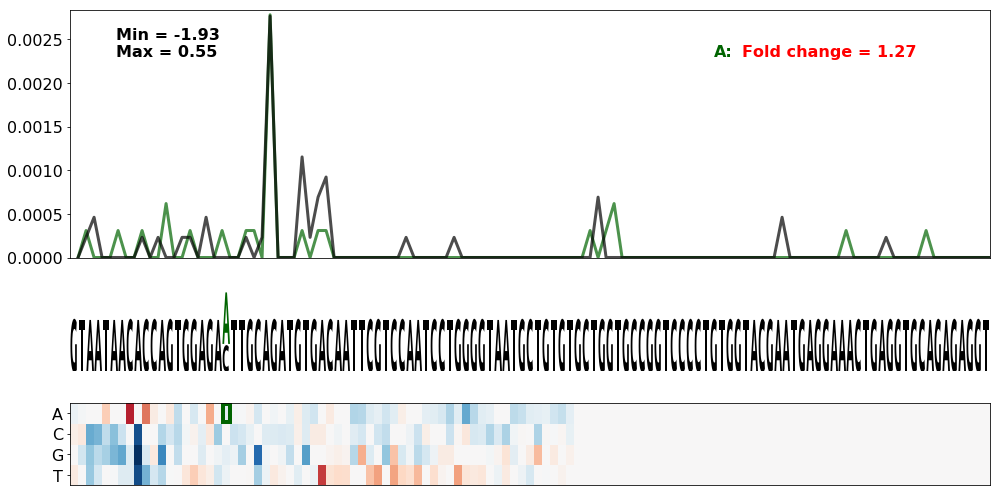

HBA2.2
CTCCCAACGGGCCCTCCTCCCCTCCTTGCACCGGCCCTTCCTGGTCTTTGAATAAAGTCTGAGTGGGCAGCAGCCTGTGTGTGCCTGGGTTCTCTCTATCCCGGAATGTGCCAACAATGGAGGTGTTTACCTGTCTCAGACCAAGGACCTCTCTGCAGCTGCAT
85
G
-6.671
-10.152999999999999
.........(((....))).........(((((..........)))))......
.........(((....)))........(((((...........)))))......


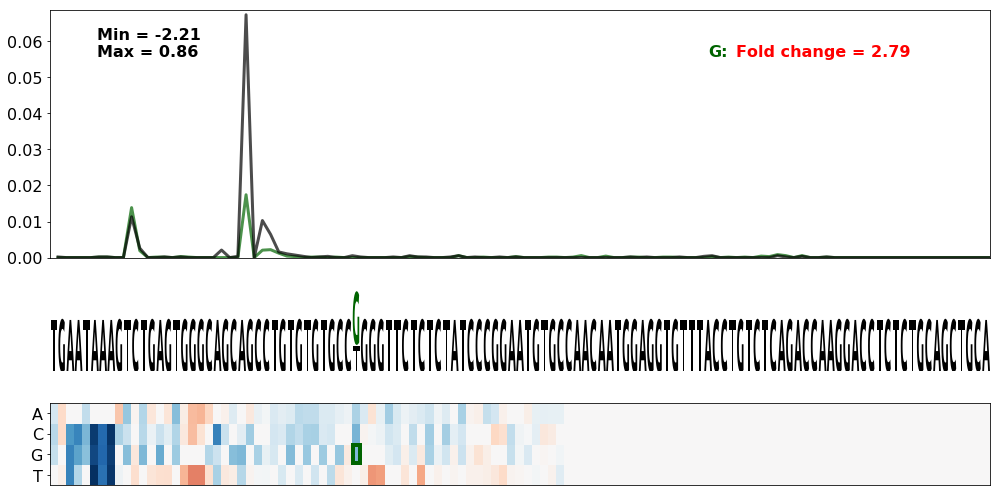

BRCA1.1
ACTTGATTGTACAAAATACGTTTTGTAAATGTTGTGCTGTTAACACTGCAAATAAACTTGGTAGCAAACACTTCCACCATGAATGACTGTTCTTGAGACTTAGGCCAGCCGACTTTCTCAGAGCCTTTTCACTGTGCTTCAGTCTCCCACTCTGTAAAATGGGG
72
A
-3.298
-6.675
...((.((......)).))..((.((((....)))).)).......((....))
...(((((......)))))..((.((((....)))).)).......((....))


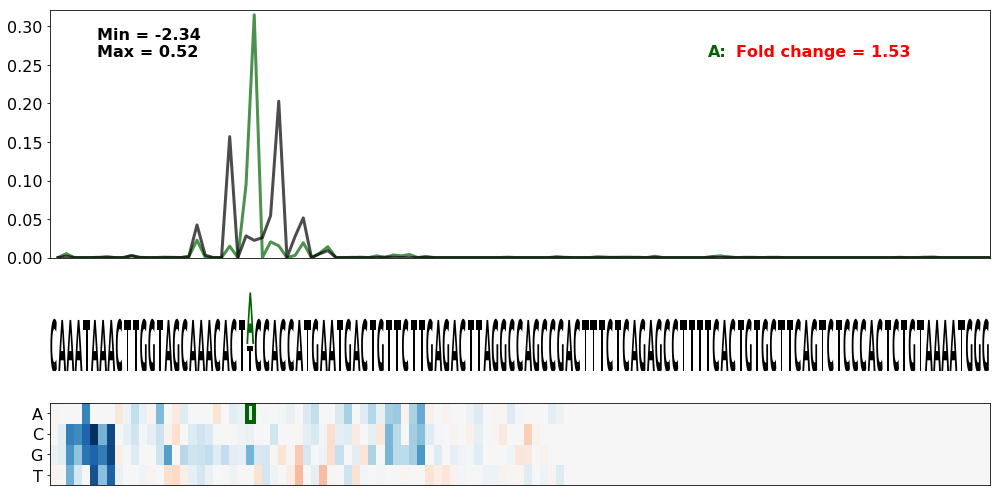

TMEM43.6
TACCTCTCAGTATTTTGTGTCACTGAGAAGCTTTACAATGGATGCTTTTGAAACAAGTATCAGCAAAAGGATTTGTTTTCACTCTGGGAGGAGAGGGTGGAGAAAGCACTTGCTTTCATCCTCTGGCATCGGAAACTCCCCTATGCACTTGAAGATGGTTTAAA
99
C
-6.749
-9.968
.......((((....))))......((((....))))...(((.......))).
.......((((....))))......((((....))))...((((.....)))).


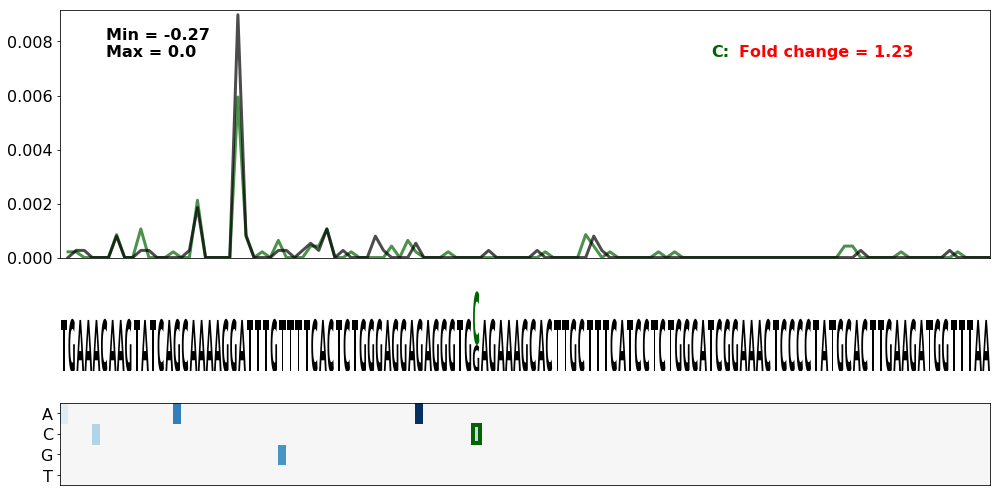

TPM1.13
ATTGGATATTTGTCGATTTTGTGTGTGTGTGTTTTTAATGAAGATACTGAAACAAACACCTTGGGAGTTTTATGACAATTGATAGTATGATGTCCTGCTGTGCTTAATATACGGGGTTGTTCTGAGTTGAGTAAATCGTTCTAGTTAAGTGTTTGTAAATGGCT
72
G
-2.6180000000000003
-5.768
..((...))........((((.............))))..((...)).......
..((...))......((((((.............))))))..............


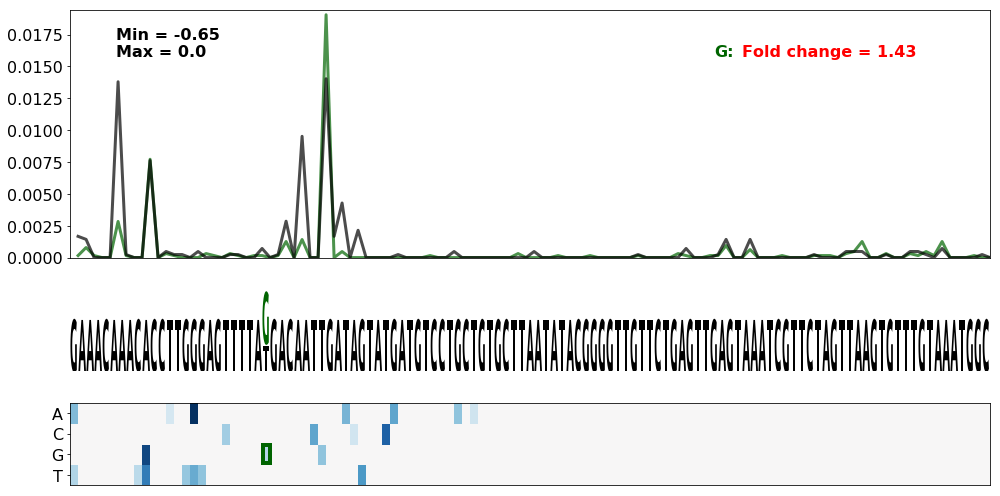

TGFBR2.3
ATAAAGGGAAAGTTTTATTCTTTTATGGAACACTTCAGCTGTACTCATGTATTAAAATAGGAATGTGAATGCTATATACTCTTTTTATATCAAAAGTCTCAAGCACTTATTTTTATTCTATGCATTGTTTGTCTTTTACATAAATAAAATGTTTATTAGATTGA
68
G
-3.2430000000000003
-6.36
((((..((....)).)))).....(((((......)))))..............
...........((((((.......(((((......))))).....))))))...


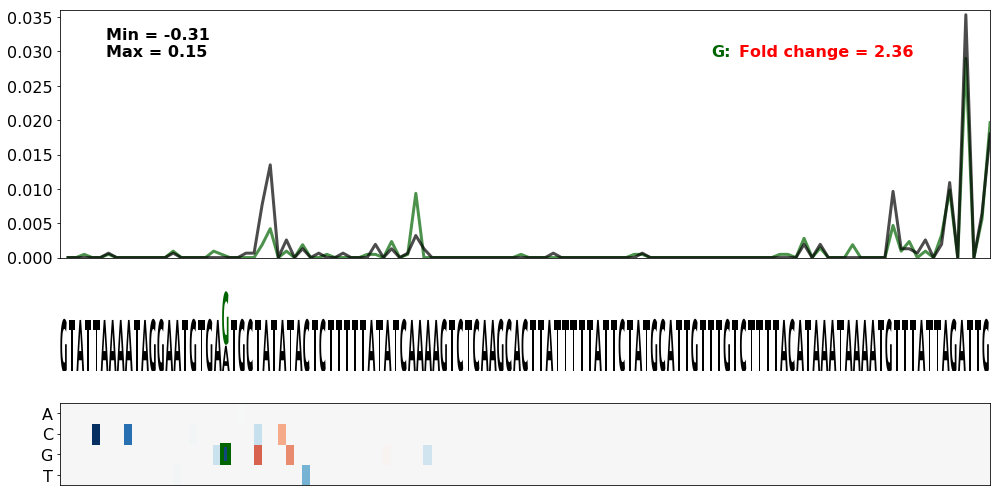

RMRP.1
TGGCGCGGGGGCGTCATCCGTCAGCTCCCTCTAGTTACGCAGGCAGTGCGTGTCCGCGCACCAACCACACGGGGCTCATTCTCAGCGCGGCTGTTTTTTGTTCCCGAGACCACGGCTCACTGCAGCCTCGACCTCCCCGGGCTCACGCGATGCCTCACCTCAGG
106
T
-6.609
-9.685
.............((((.........((((...)))).........))))....
...........((((((.........((((...)))).........))))))..


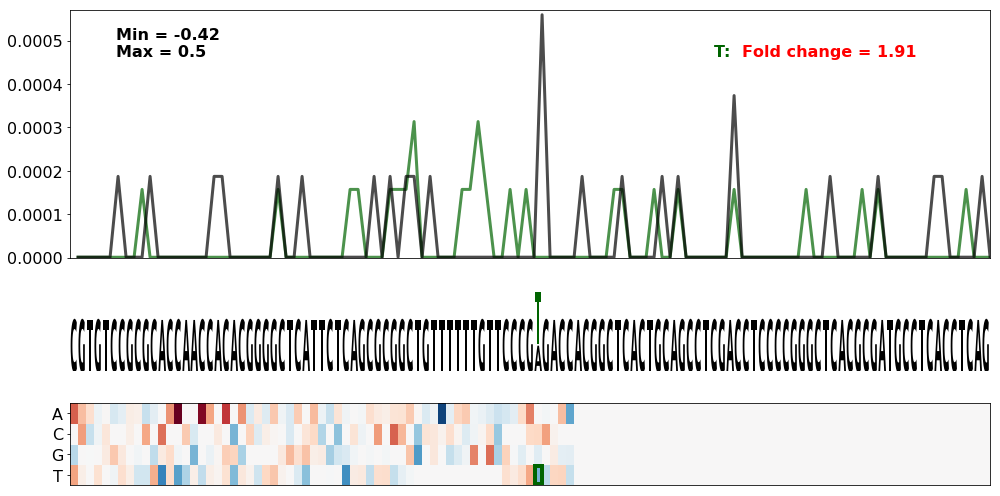

KCNQ1.1
CAGACAGGACCCCTGCAGTTCCCCTGGAAGCAGTGCCCAGGTGGCTGTGGAATAGGAACGCTATGTCCGTGTACTGAGGAGTAGGTCAGGGTTCAGAGGGGCTGCAAGATGCCATCGAAGGCTCTAGCTTAGCGACGTCGCTCCTGTTCTGGGCCCTGGGCTGG
66
G
-5.3
-8.361
..(.((.((.((.((((((....))))...)).))..)).)).)..........
.((((.....))))...((((........))))....(((.....)))......


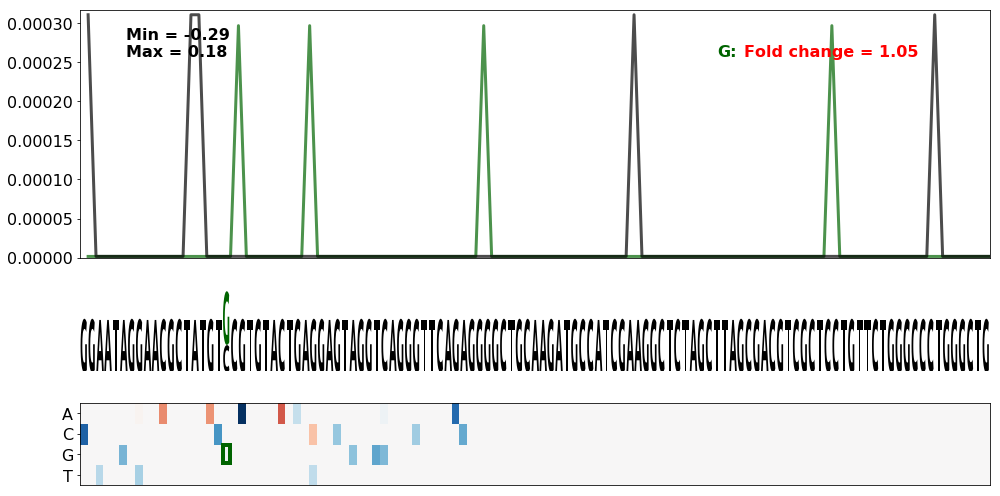

MLH1.2
GAAATTGATGAGGTGTGACAGCCATTCTTATACTTCTGTTGTATTCTTCAAATAAAATTTCCAGCCGGGTGCGGTGGCTCATGGCTGTAATCCCAGCACTTTGGGAGGCTGAGGTGGGCAGATAACTTGGGGTCAGGAGTTCAAAACCAGCTGGCCAACATGAT
69
A
-11.604000000000001
-14.564
.....((((((.(.((....)).).))))))...(((((......)))))....
.....((((((.((((....)))).))))))...(((((......)))))....


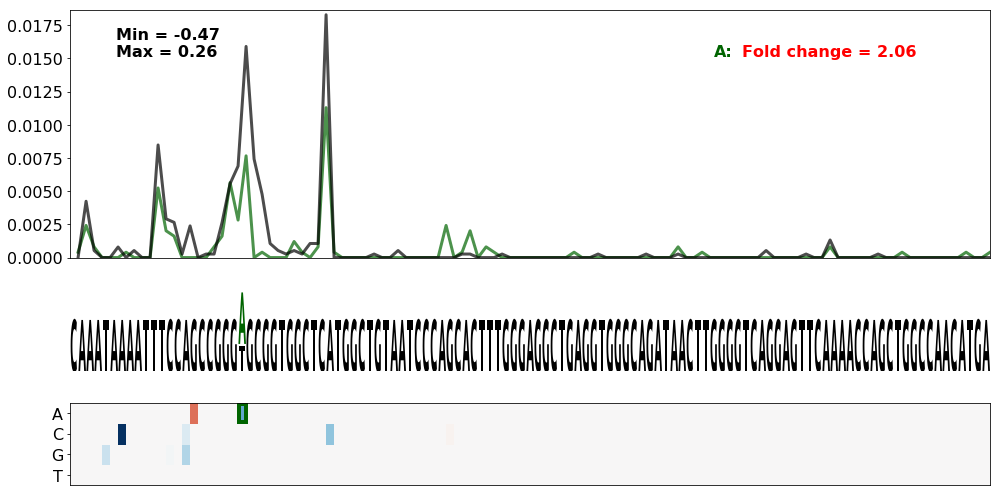

SDHAF2.2
TGGTCCTGCCTCAAGTGATGGACATAACCCTCTCCTAGGACATACATGTAAATGCACAATGTGACTCATTCTCATACTTTTTTGTTCAGCTCTGAGCCTCAAAAGTGATTTGTCAGCAGCGCTGGCATGCAGGCTTTGCCTGGCTGCTATCTCTAGAGGCAAGT
95
A
-6.148
-9.107999999999999
.((((.....)))).....((((((..(((((....)))))...))))))....
.((((.....)))).....((((((..(((((....)))))...))))))....


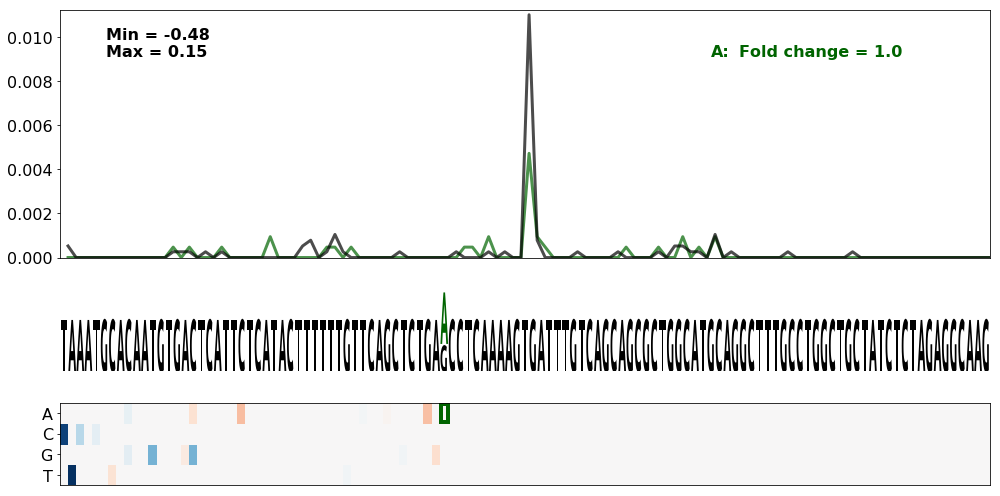

BMPR1A.5
TTAATAAGTTTCATCTGCCATAATTAAAGTCTGAAGTGTTCATCAAGATAAGTAAATTTGCATATGGATAATACCCAATAACTTGTTTTTTCAGAATTTTTCACCATATGTATACTGAGAAATACAAATATTTTAATCTGCGTTGCCGTATGATATGATTGCAC
87
A
-3.299
-6.227
....(((((((....................................)))))))
....(((((((.........(((((....))))).............)))))))


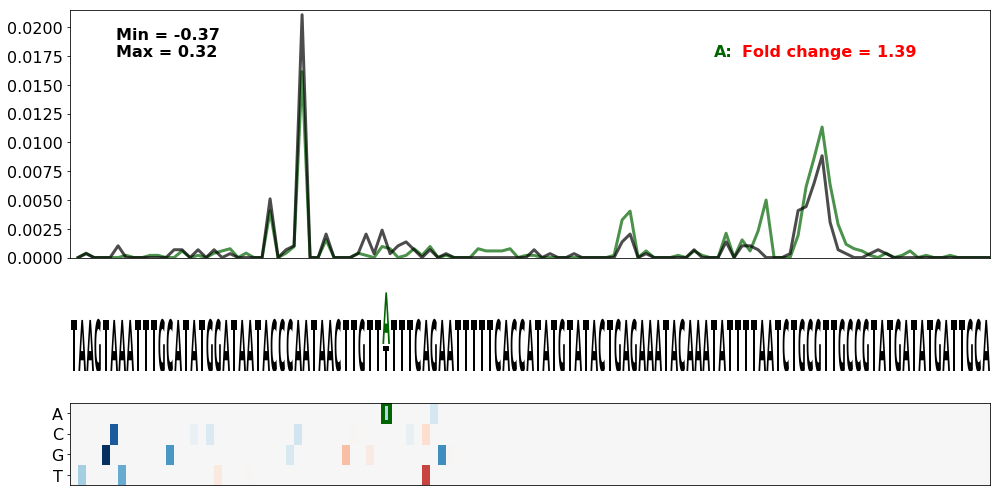

INS.1
CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
77
G
-7.207999999999999
-10.103
..........((((...))))....................((((...))))..
............((((....)))).................((((...))))..


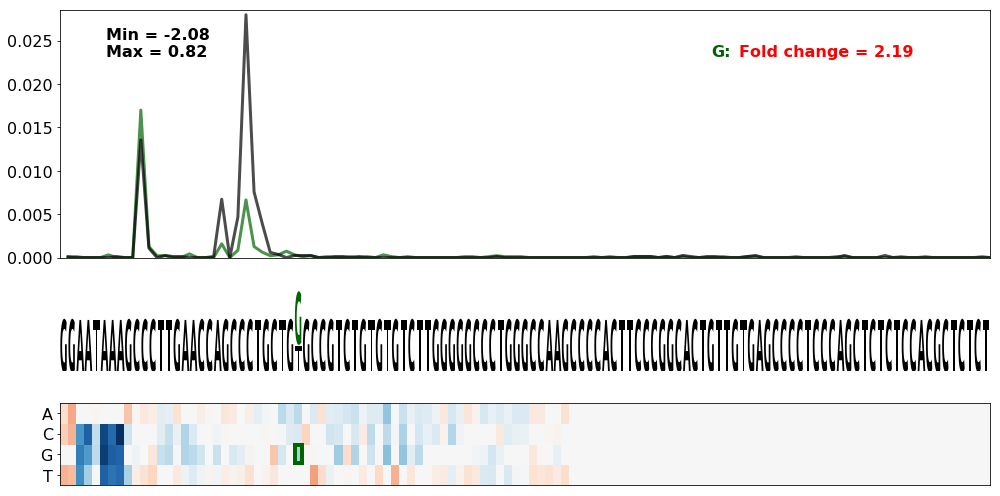

MOCS2.2
GGATATGAGAAAAACTACTAACTGTTGACTACAATTTAATTTTTGTTTCTCATAAATCAAATGAATTCTGCAACTTTTTGTACAAACATGCATTTATTTTTACAGTTTTTGTGGAAAGAGGCAAAACACATTTAATCAAAAACATCAAACACCACATTTGAAAA
77
G
-2.149
-5.025
.............(((..(((......)))..)))...................
.............(((..((((....))))..)))...................


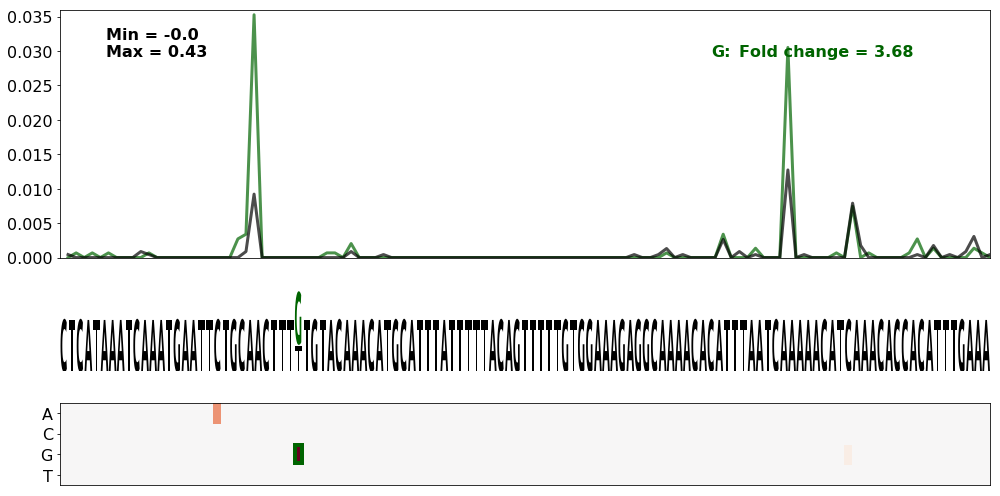

ARSA.1
GCTAACCCAGTGTCTCCAGCTGCCTACCTGGAGAGCTCCAAGCGTAAGAAAATAAACCCTGCCTGTTGAAGCCACTGCTAGTGAGGGTTCTGTTATTTGCAGCCAAAAGCCTTGCTGGAATGTGGCCTATGAATGGTTGTGTGGCGGGCACATGTGCCTGCGTG
73
T
-5.357
-8.198
...........(((.((...........)).))).....((((....))))...
...........(((.((((.......)))).))).....((((....))))...


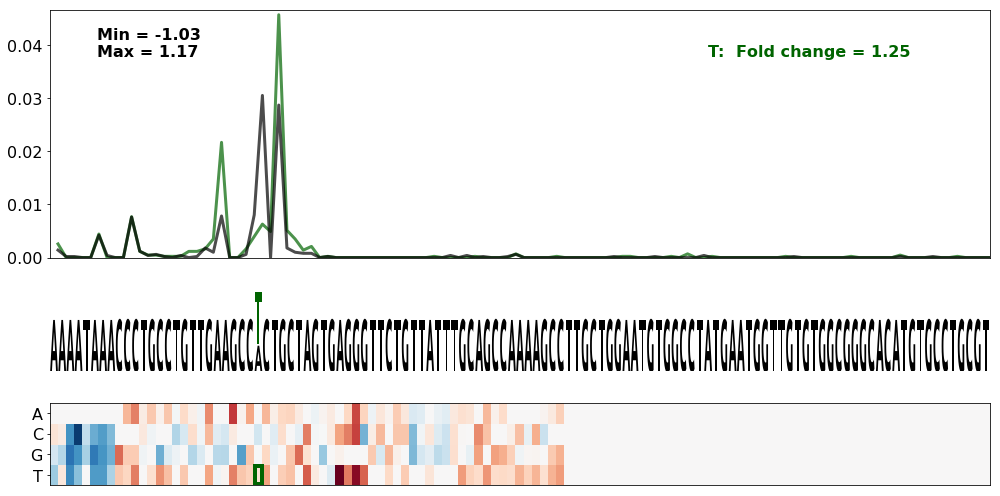

SLC19A1.1
TTGGGGCAGGTGAATGTCAGCATCAGGCTTCTGTTTTAAACTTTTAAAAAAATACACTCTTTGGCTTCCTTTTATTTCTTGAGGATTACATGAAACGTGAACTATACAGGAAAGTATGGCAGCCAGGTCCTGGGGCCAGGGGCTGGCCGGCCGCTCCCTGCCCA
89
G
-2.536
-5.348
...........(((...........)))....(((.....)))..((....)).
...........(((...........)))...((((...))))...((....)).


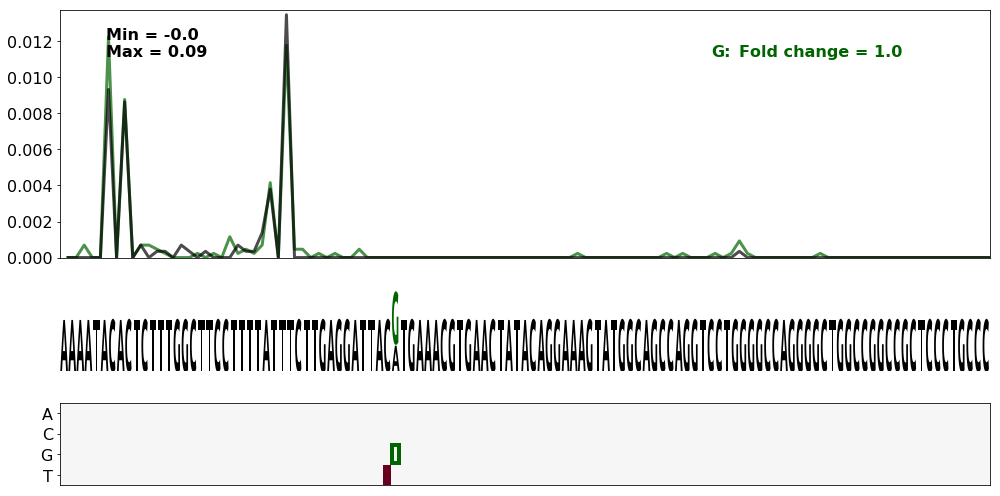

MLH1.2
GAAATTGATGAGGTGTGACAGCCATTCTTATACTTCTGTTGTATTCTTCAAATAAAATTTCCAGCCGGGTGCGGTGGCTCATGGCTGTAATCCCAGCACTTTGGGAGGCTGAGGTGGGCAGATAACTTGGGGTCAGGAGTTCAAAACCAGCTGGCCAACATGAT
80
C
-11.604000000000001
-14.41
.....((((((.(.((....)).).))))))...(((((......)))))....
.....((((((((.((....)).))))))))...(((((......)))))....


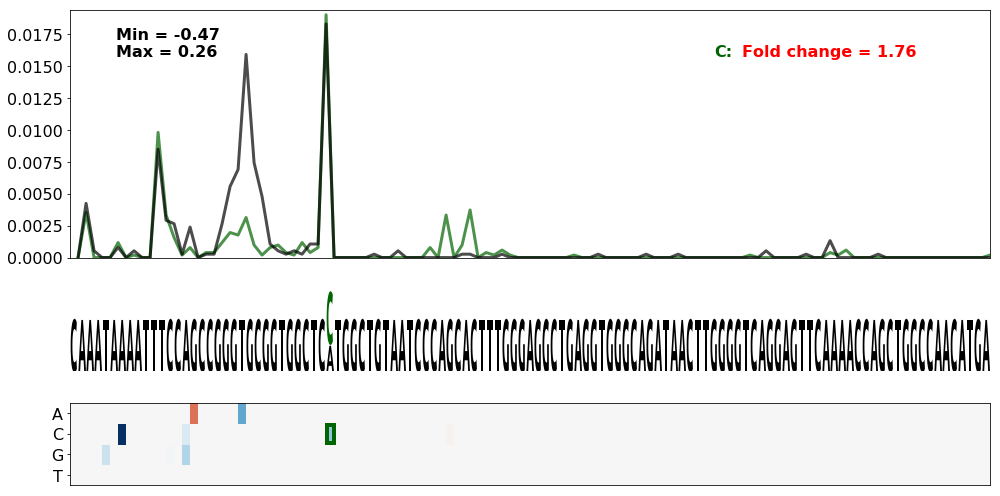

NF2.7
CTGACCTGAGTCTTTGTTTTAAGAAGTATTTGTCTTCCTTTGTCTAATGTGGGATTCCTGACTCCCTTCGTCCAAGGCACCGGTGTGTGTGTGTCTTGCACTCCAGAGCTGACCTCCACCGCCCAGCCTGGGAAGTCATTGTAGGGAGTGAGACACTGAAGCCC
83
A
-5.354
-8.131
........((((.....))))....(.(.((.((((.....))))..)).).).
........((((.....))))....(((((((.........)))))))......


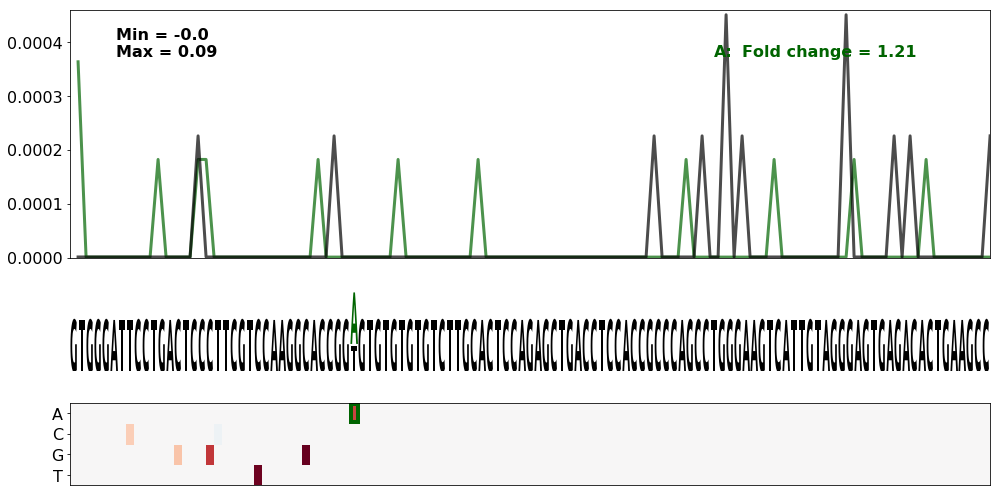

TGFBR1.8
ATAATGTTTAATATTTGTCAGAGCATTCTCCAGGTTTGCAGTTTTATTTCTATAAAGTATGGGTATTATGTTGCTCAGTTACTCAAATGGTACTGTATTGTTTATATTTGTACCCCAAATAACATCGTCTGTACTTTCTGTTTTCTGTATTGTATTTGTGCAGG
82
C
-1.524
-4.274
...................((((............))))...............
...((((((...((.....))..)))))).........................


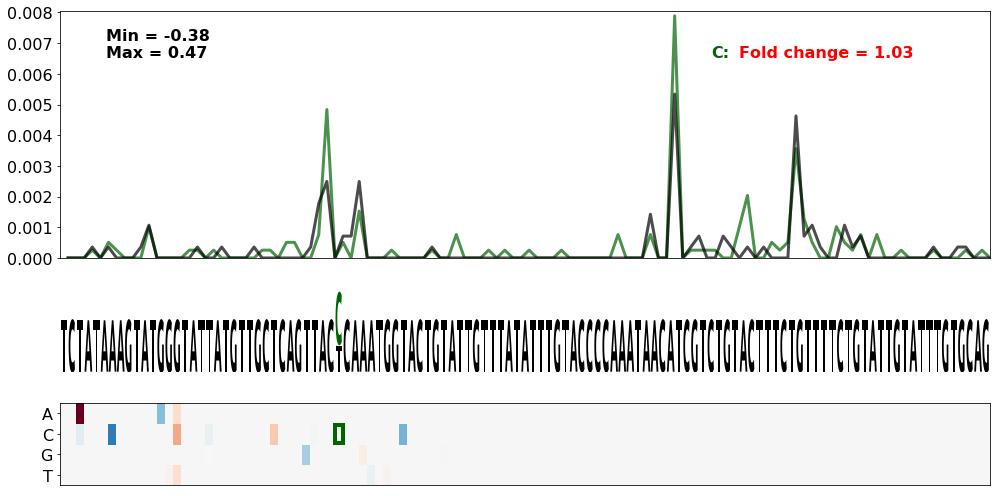

RMRP.1
TGGCGCGGGGGCGTCATCCGTCAGCTCCCTCTAGTTACGCAGGCAGTGCGTGTCCGCGCACCAACCACACGGGGCTCATTCTCAGCGCGGCTGTTTTTTGTTCCCGAGACCACGGCTCACTGCAGCCTCGACCTCCCCGGGCTCACGCGATGCCTCACCTCAGG
68
T
-6.609
-9.353
.............((((.........((((...)))).........))))....
...........((((((.........((((...)))).........))))))..


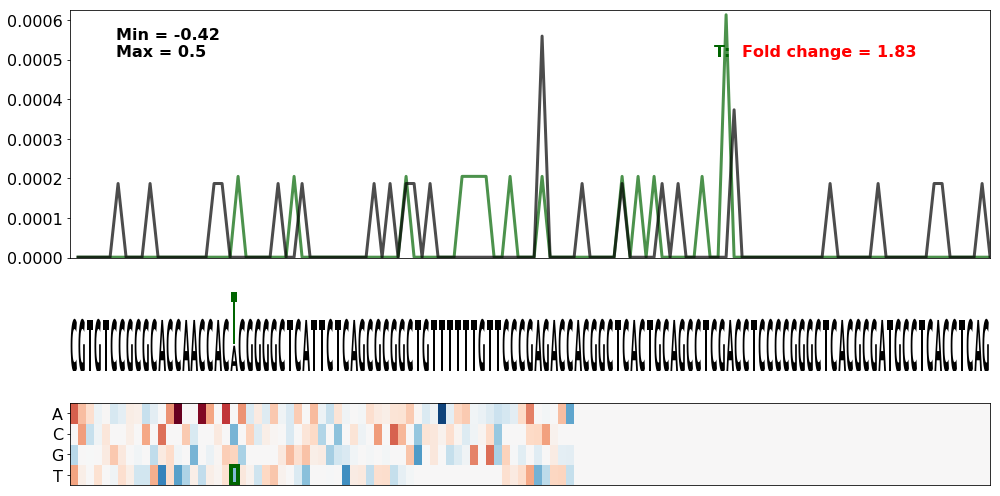

TPM1.18
TAAAACATTTAAATTCTAAACTACCTGGCTTTGGAAAAAGAGCCAAAAACCATATATGACTCTGAGCCTACTTTGTATAATGCAGATCAGATGCCTGCTCTATATATGGCTAAATGGAAGATGCCTGCCTCCCGCAAATTCTCCAGCAGGACGTTTATTTAGCT
71
A
-3.638
-6.33
.....((((.(.................).))))..(((............)))
.....((((..((.((((....)))).)).))))..(((............)))


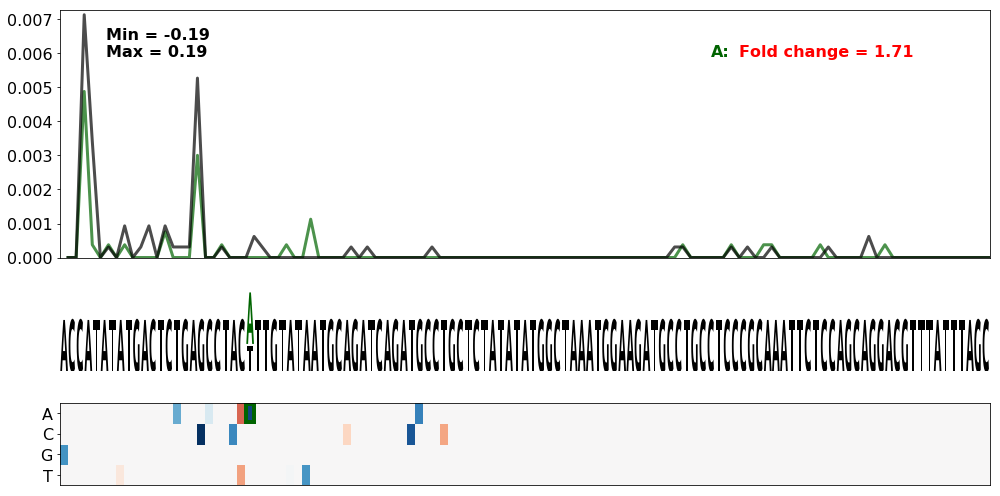

TPM1.9
GTAGTATCCCTGATGGTCTTGTTTCGAATTTTGTGTTGTCTTTCCACCTAAGTCAAAAGTGAGGCTGAAGGGGATCGAAGACTCCATTTTTTTCTGGCCCCCAATCTCTTCCCCAGTAACTGTGATATATCTGATATTTATAGCATATGAGTCTTTATCCCTTT
73
C
-3.2
-5.8870000000000005
.............((((..(..(((...........))).).))))........
.............(((((..(((............)))..))))).........


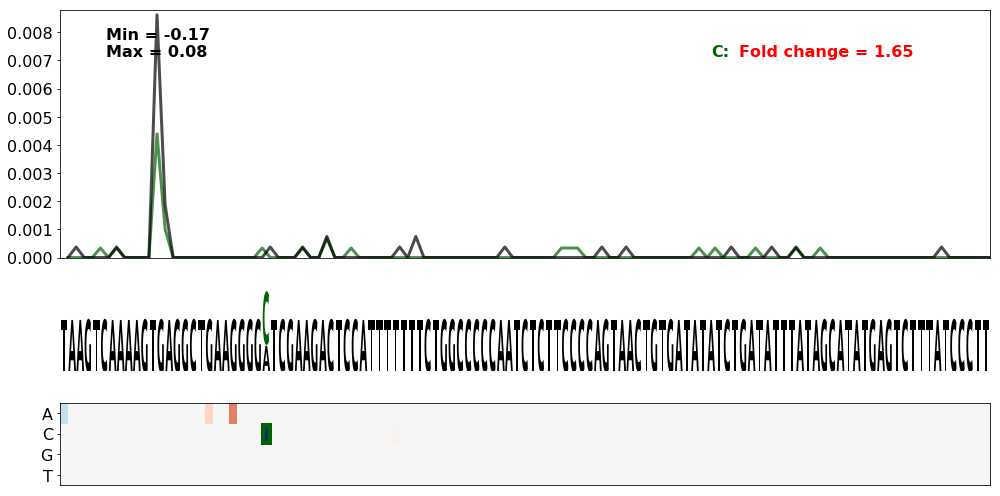

NF2.7
CTGACCTGAGTCTTTGTTTTAAGAAGTATTTGTCTTCCTTTGTCTAATGTGGGATTCCTGACTCCCTTCGTCCAAGGCACCGGTGTGTGTGTGTCTTGCACTCCAGAGCTGACCTCCACCGCCCAGCCTGGGAAGTCATTGTAGGGAGTGAGACACTGAAGCCC
77
G
-5.354
-8.033999999999999
........((((.....))))....(.(.((.((((.....))))..)).).).
.......(((((.....)))))...(.(.((.((((.....))))..)).).).


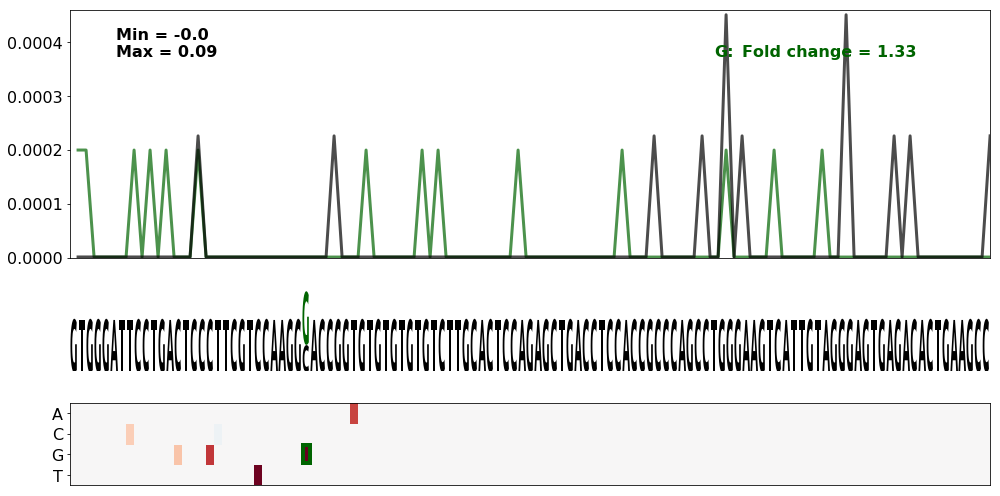

NF1.1
CACCCCATTTTCCTCCTTGTGTATGTACTTCCCCCACCCCCCTTTTTTTAAGTAAAATGTAAATTCAATCTGCTCTAAGATATGAGGAGTTATTTAATTTCTTCAGATGTATCGAGCTCTGTTTTCTTCCCCCCGAGTCCTCCCAATCTTTTGAAACATTAAGG
71
C
-3.5780000000000003
-6.212000000000001
....(((((.(((((.(((........))).))..))).)))))..........
....(((((.(((((((((........))))))..))).)))))..........


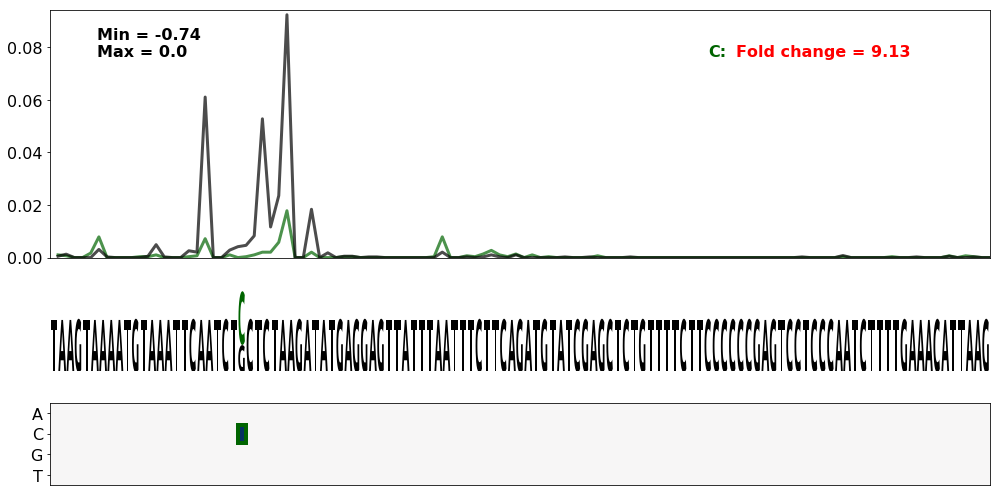

INS.1
CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
82
G
-7.207999999999999
-9.769
..........((((...))))....................((((...))))..
..........(((((..((...)).)))))...........((((...))))..


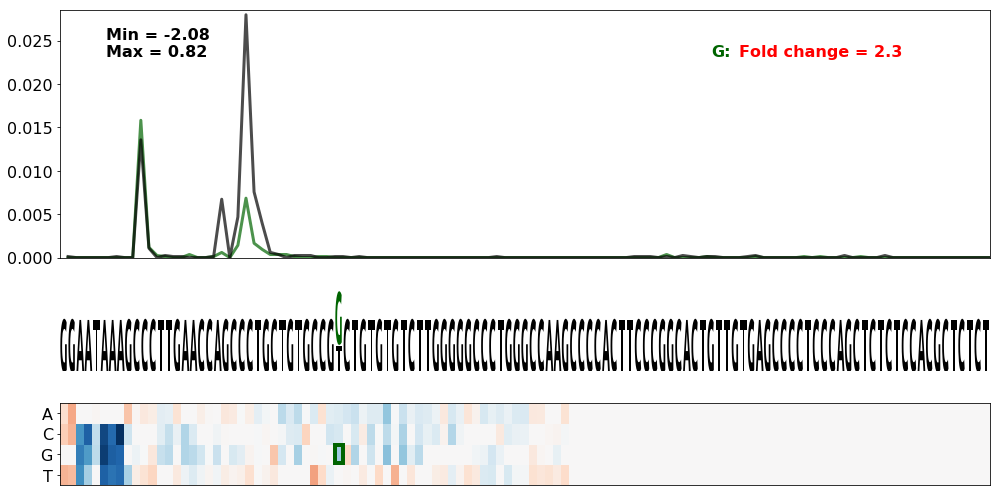

SMAD3.6
AAATATTGGTTTAATAATGTAAACATGTGATTGCTGTATTATTATAATGGAATAAAATTAACACGATTTAATGAACTGAGCGACCATTAATTTTTACTTGTTAATTTATTAGGAGATTTTAATGCCATTTGATGCACAGTACAGCCATTATTCTGCGTGAGCTC
73
G
-4.086
-6.629
(((((((....((((((...........))))))........))))))).....
(((((((....(((((((.(.....).)))))))........))))))).....


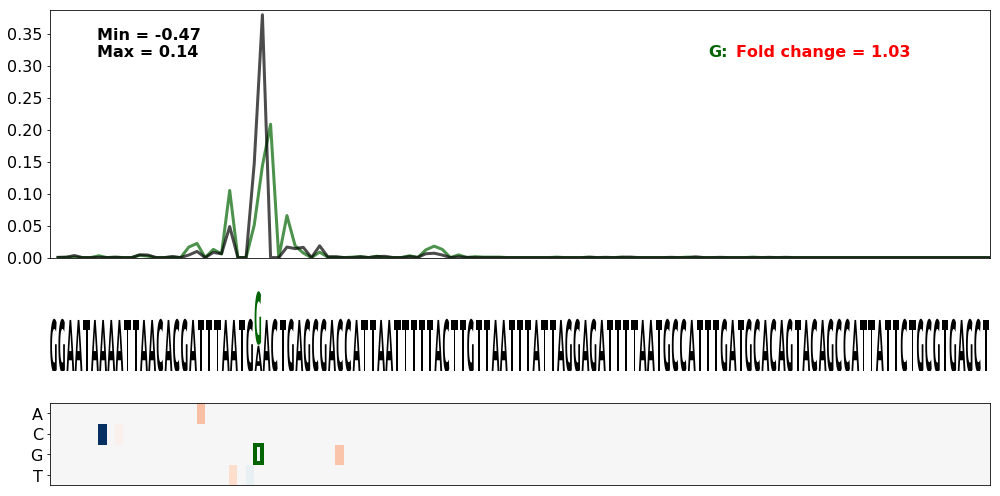

FANCD2.3
TCCATTCCCTCCATAACAGCTTCTGTGCTTATATAATTTTTGGGACCCAGAAGAAACAACGACACAATCTTAGAATCACTCCTGAGTATCTCGAGTTGTGGCATTTGTTATAGAGTTGACAATTTTCTGCATTATAGCCTCTCATTTTCCATGAATTCATATCT
59
T
-4.7589999999999995
-7.256
....(.(((((((..(((...(((....))).))).)).))))).)........
.((((.(((((((..(((...(((....))).))).)).))))).)))).....


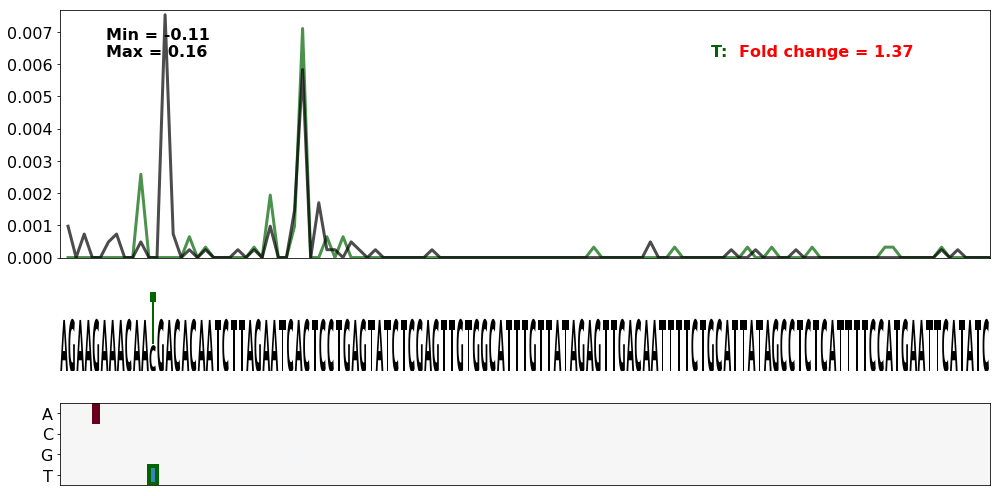

RMRP.1
TGGCGCGGGGGCGTCATCCGTCAGCTCCCTCTAGTTACGCAGGCAGTGCGTGTCCGCGCACCAACCACACGGGGCTCATTCTCAGCGCGGCTGTTTTTTGTTCCCGAGACCACGGCTCACTGCAGCCTCGACCTCCCCGGGCTCACGCGATGCCTCACCTCAGG
106
C
-6.609
-9.095
.............((((.........((((...)))).........))))....
.((.((........)).))..........(((((.............)))))..


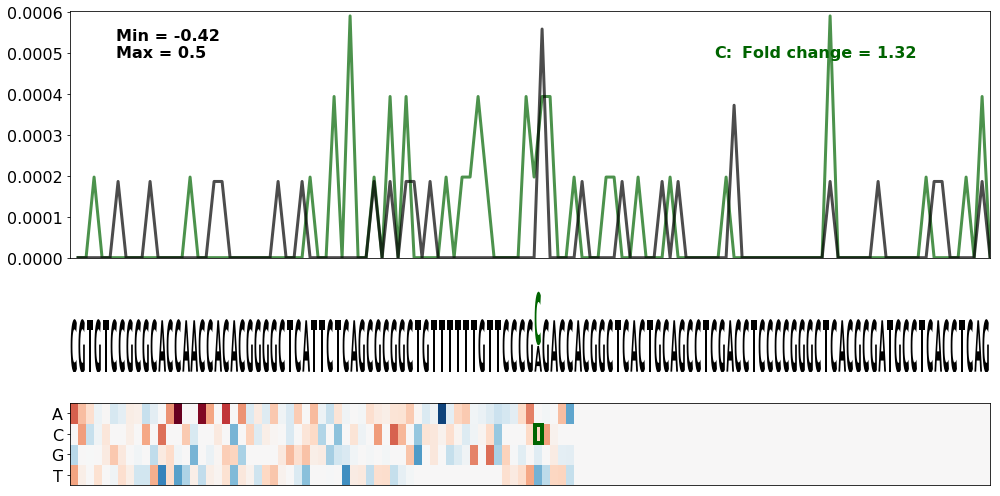

APC.3
AATTTTTTTCTTCAGCTTCTATGCATTAAGAGTAAAATTCCTCTTACTGTAATAAAAACAATTGAAGAAGACTGTTGCCACTTAACCATTCCATGCGTTGGCACTTATCTATTCCTGAAATTTCTTTTATGTGATTAGCTCATCTTGATTTTTAATATTTTTCC
95
G
-2.944
-5.399
....................((((..................))))........
....................((((...(.(((.....))).)))))........


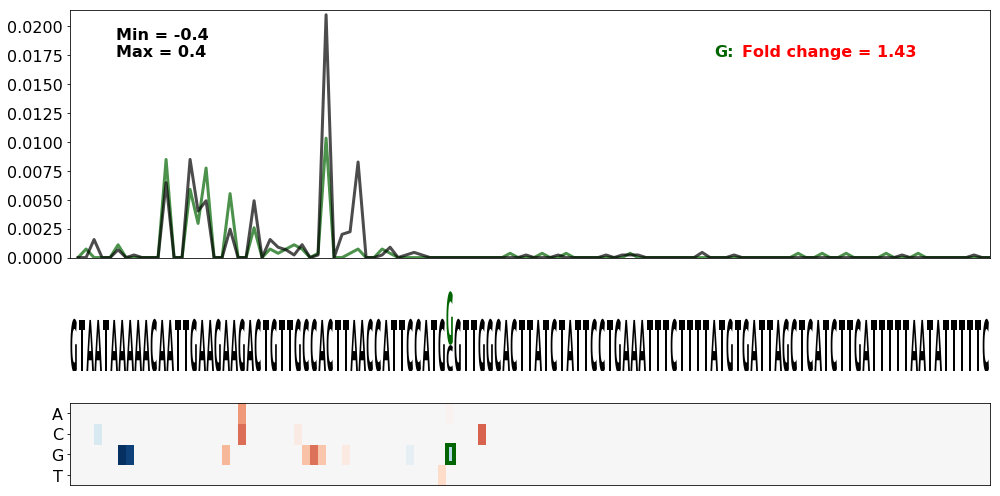

TP53.3
CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
65
A
-8.283999999999999
-10.693
..........((((.............))))..(.(((((.......))))).)
......(.(((((....))))).).........(.(((((.......))))).)


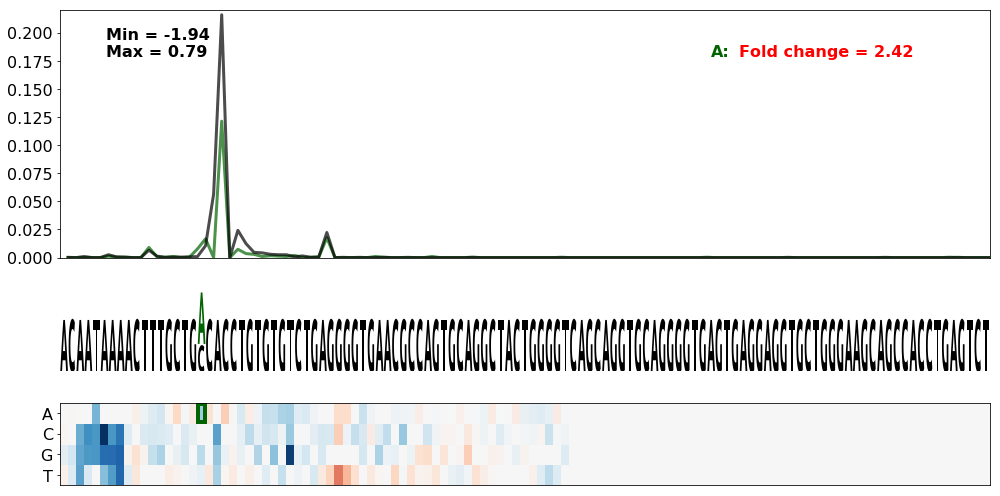

FANCA.3
CAAGCAAGGGGCCTATGAGGGCCTCGTTTATTAAGATCTTTAAACTGCTTTATACACTGTCACGTGGCTTCATCAGCTGTGTGCATTTCAGGATGGTTTTTAAAGAAACCTCAGAAAGCTATTTCCTTAACCACAGATTCTTGTCTTTTTTTTTTTTTGAGATG
63
A
-6.409
-8.815
....(((((((((.....)))))))))...........(((((......)))))
....(((((((((.....)))))))))...........(((((......)))))


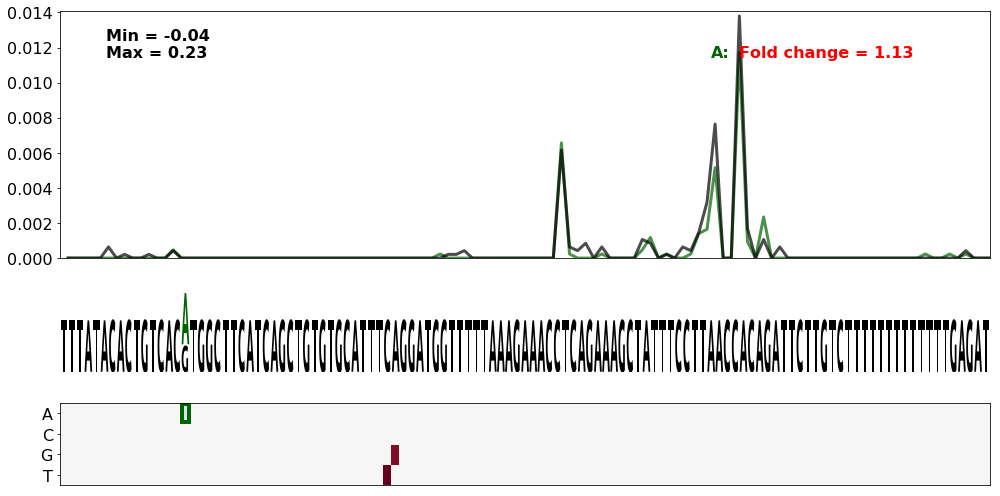

LCAT.2
CCAGGGTCCCCCTGCATCCCCGACTGCCAGCCCAGAGCCCCCGCCTCCTGAATAAAGACCTTCCTTTGCTACCGTAAGCCCTGATGGCTATGTTTCAGGTTGAAGGGAGGCACTAGAGTCCCACACTAGGTTTCACTCCTCACCAGCCACAGGCTCAGTGCTGT
66
C
-6.749
-9.111
..((((((((..(.(((...((((.....))))........))).)))))))))
..(((((((((...(((...((((.....))))........))).)))))))))


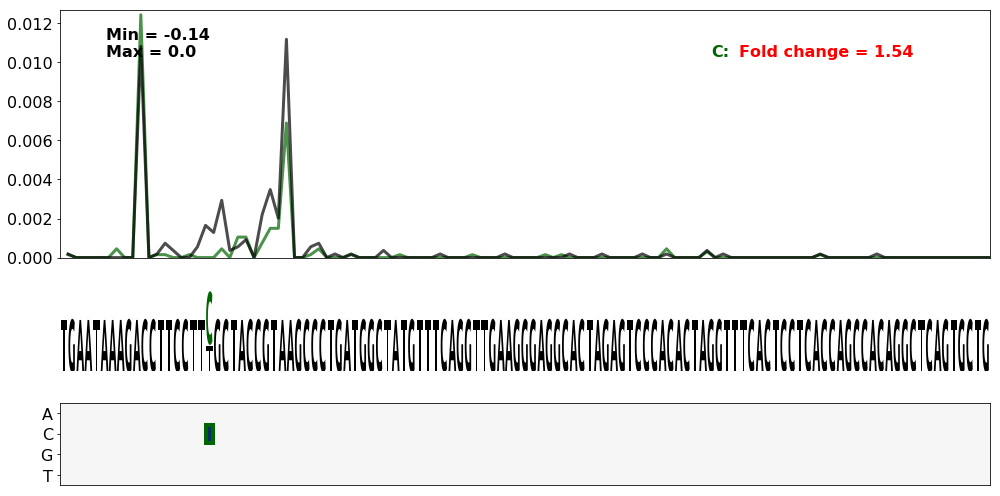

TPM1.15
GGGGCCCGGCCTGTTCTCCTGAGCCTTTGTTTTCCATCTCGCTGATCCAAAGTAAACGCTCCCAGGGGAAACGGGTGGTGTTGAGAAGGTTCTGGAAGGAGCATTTTCCCAGGAAGGGTCTGTTTCTGGGGTGGTGGCTTTCAGTCGTGTCTGTGCGTCCCCGG
77
C
-5.071000000000001
-7.391
.........((((((...(((.(.((.(((....)))..))..).)))))))))
.........((((((...(((((.((.(((....)))..))..)))))))))))


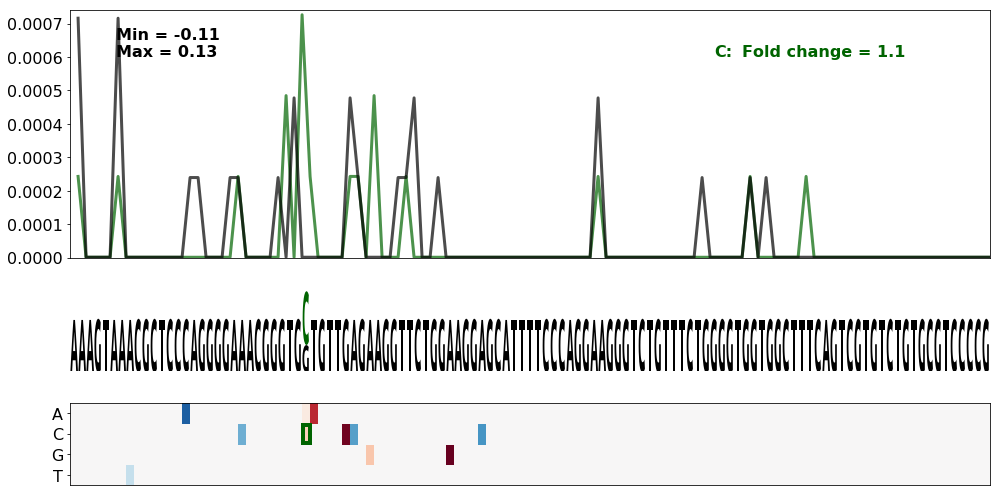

TPM1.28
TCTTGAGTTTTACTACAAGATGAGACTATGGATCCCGCATGCCTGAATTCACTAAAGCCAAGGGTCTGTAAGCCACGCTGCTCTTCCGAGACTTCCATTCCTTTCTGATTGGCACACGTGCAGCTCATGACAATCTGTAGGATAACAATCAGTGTGGATTTCCA
75
G
-3.992
-6.306
.....((.(.....).))......(((....)))....................
(((..((.(.....).)).)))..(((....)))....................


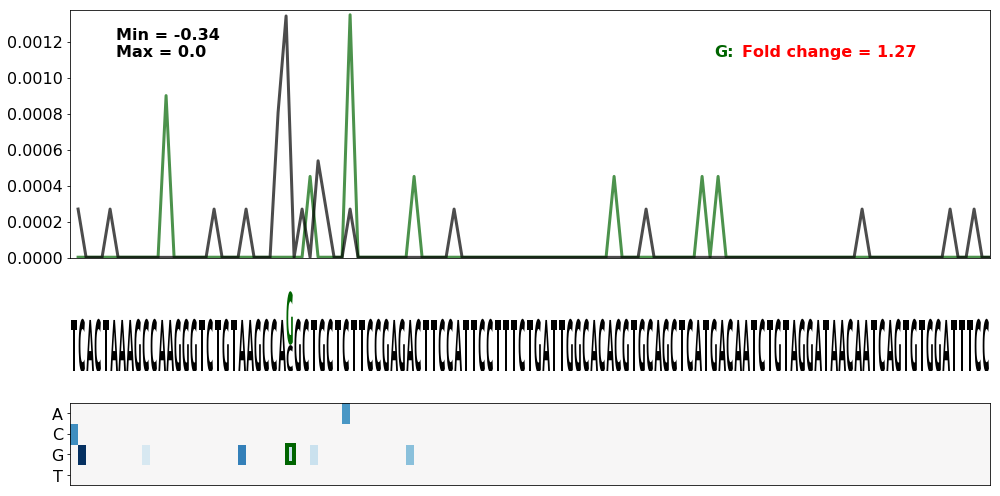

LDLR.2
ATCCTCCCGACCCCTACCCACTTCCATTCCCGTGGTCTCCTTGCACTTTCTCAGTTCAGAGTTGTACACTGTGTACATTTGGCATTTGTGTTATTATTTTGCACTGTTTTCTGTCGTGTGTGTTGGGATGGGATCCCAGGCCAGGGAAAGCCCGTGTCAATGAA
90
C
-4.771
-7.051
.......(((((...))))).....(((...............)))........
.......(((((...)))))...........((((.........))))......


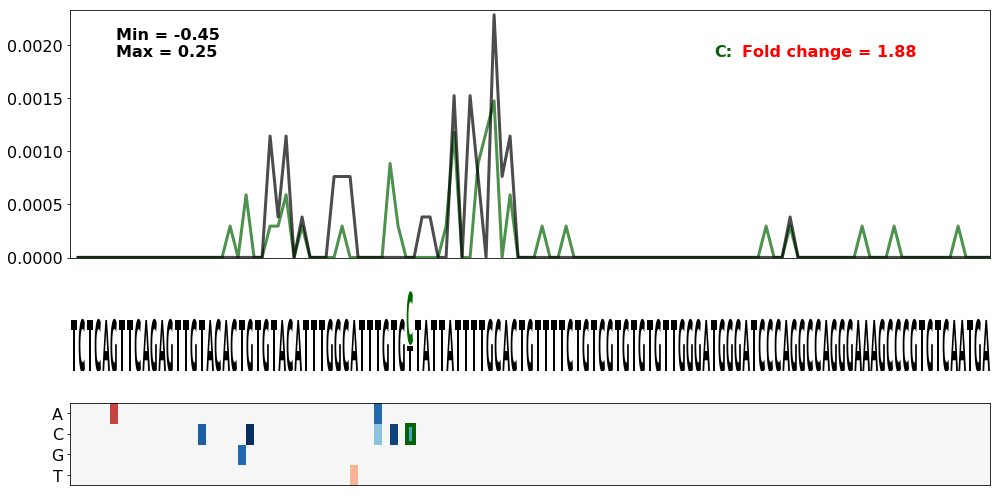

SMAD3.4
TTTGCTCATCCTCTCTCCTTCACCCTTGTGCATATTAATACTCACCTGGCAATTAGTCATATGCAACTCTTATATTGACCTTACATGTTCCGTGTCTTCTGTGCCCGTCTCTGGAGTTCCTGAAGATGAAGGGCTGTGTCTGCTGCACCTTCAGACTTTTTGAA
73
G
-2.3209999999999997
-4.5489999999999995
.......(((........))).....((((.....))))...............
.......((((......)))).....((((.....))))...............


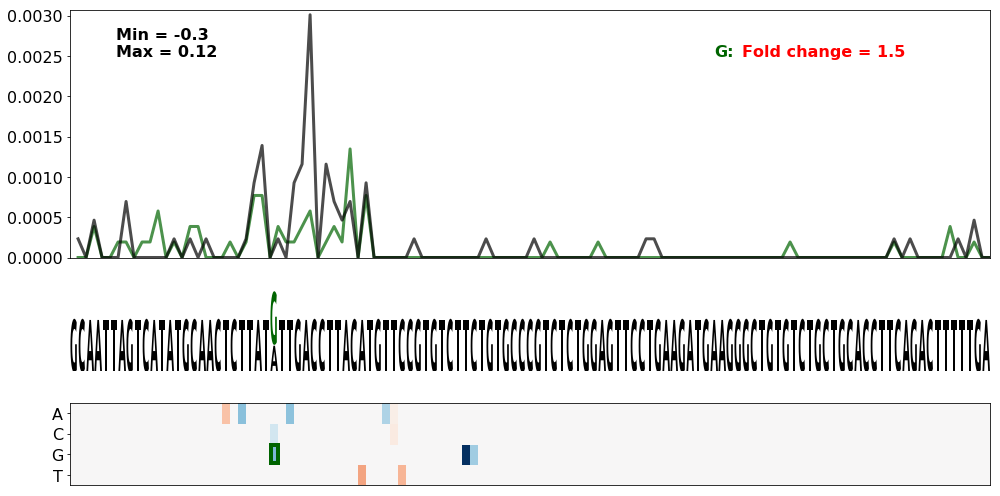

TSC1.5
TGGTCAATCAGTGTTAACTTGCATATTGTTGGCACAGAACAGGAGGTGTGAATGCACGTTTCAAAGCTTTCCTGTTTCCAGGGTCTGAGTGCAAGTTCATGTGTGGAAATGGGACGGAGGTCCTTTGGACAGCTGACTGAATGCAGAACGGTTTTTGGATCTGG
96
C
-3.218
-5.415
..............((((....))))............................
..............((((....))))..............(((....)))....


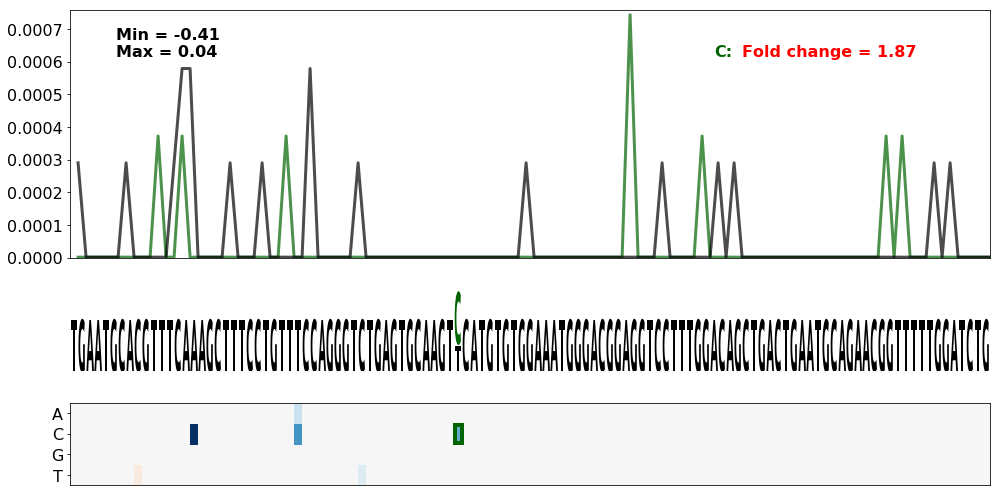

INS.1
CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
90
G
-7.207999999999999
-9.402000000000001
..........((((...))))....................((((...))))..
..........((((...)))).((((......)))).....((((...))))..


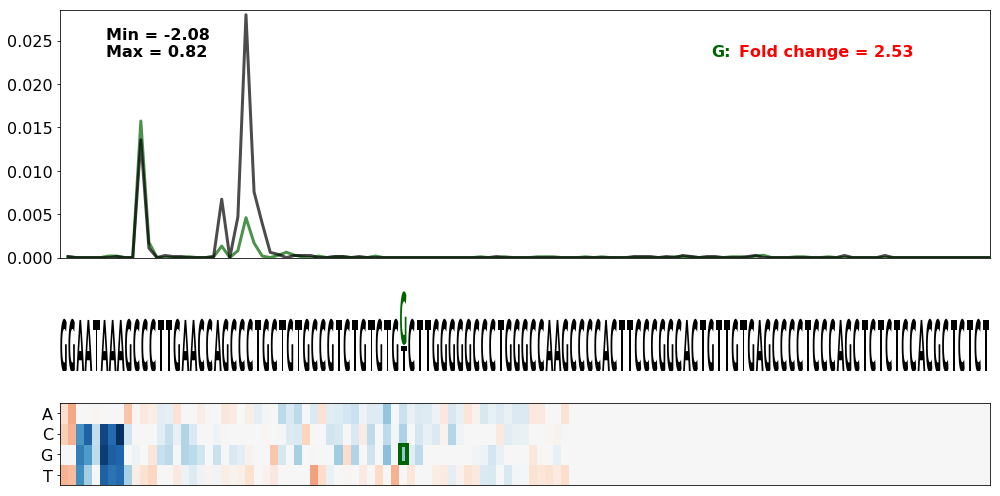

INS.1
CAGCCCGCAGGCAGCCCCACACCCGCCGCCTCCTGCACCGAGAGAGATGGAATAAAGCCCTTGAACCAGCCCTGCTGTGCCGTCTGTGTGTCTTGGGGGCCCTGGGCCAAGCCCCACTTCCCGGCACTGTTGTGAGCCCCTCCCAGCTCTCTCCACGCTCTCTG
70
A
-7.207999999999999
-9.378
..........((((...))))....................((((...))))..
............((((....)))).................((((...))))..


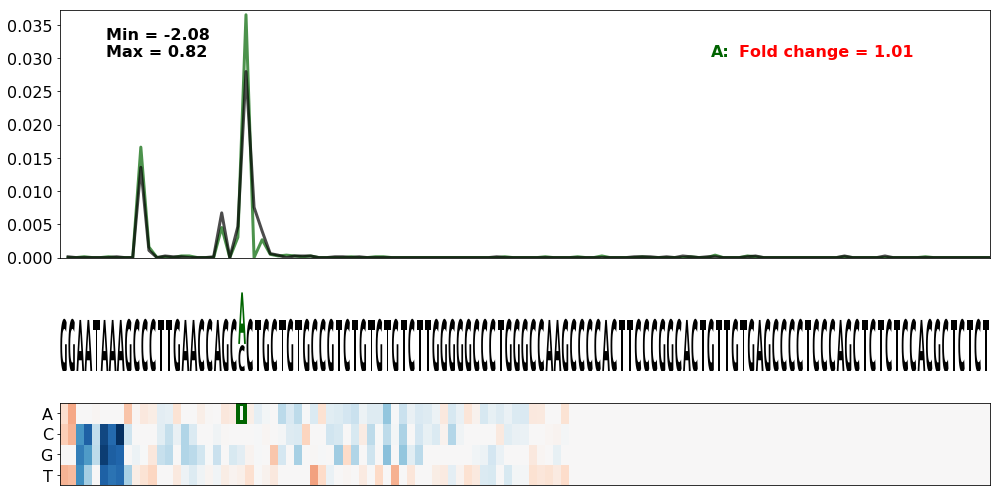

FRA10AC1.1
TTAAAAAAGAATTTGTGACTAGTTTCAGGATTGCATATTTTTTAATTTAAAATAAATTGGCACCAAAAATGTACCTATTTTTGTCATATTTTGCACTTTTGTTGAACTTTATTTTGCCCCTGGGATTTTTGGGCTAGCAATATATATTTTCTTCATAGTCACAG
68
G
-4.572
-6.73
.......(((((((......)))))))...........................
....((.(((((((((....................))))))))).))......


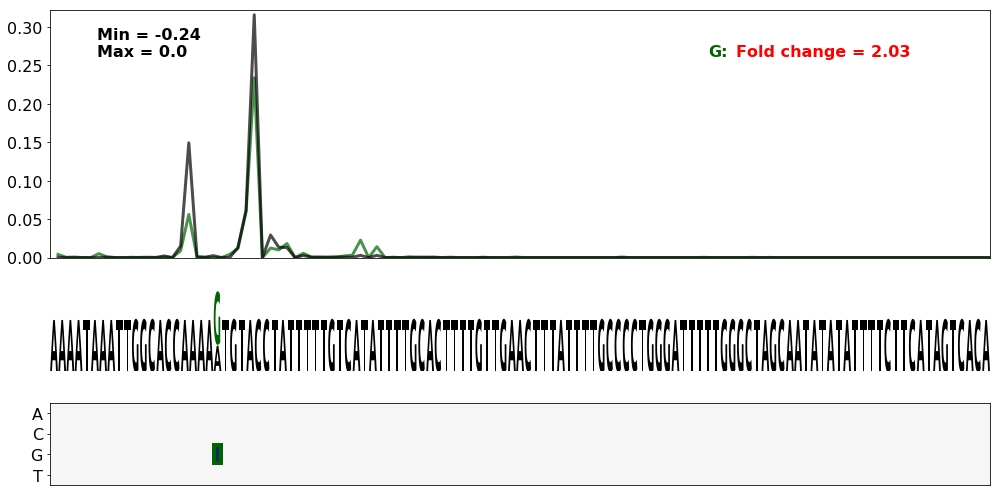

VHL.5
CAGTTGTGATAATAGCATTTTTGTAACTTGCCATCCGCACAGAAAATACGAGAAAATCTGCATGTTTGATTATAGTATTAATGGACAAATAAGTTTTTGCTAAATGTGAGTATTTCTGTTCCTTTTTGTAAATATGTGACATTCCTGATTGATTTGGGTTTTTT
89
A
-1.909
-4.06
....((....)).................((((......))))...........
....((....)).................(((((....)))))...........


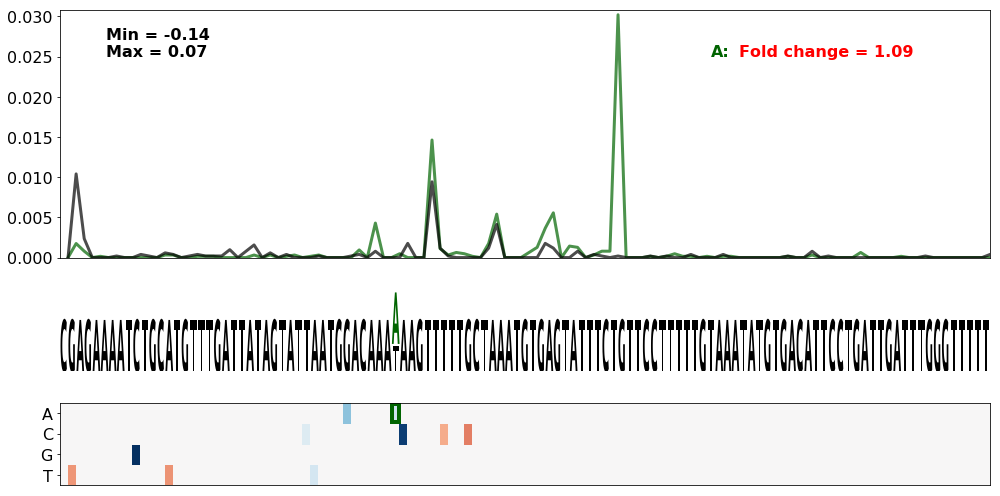

HBA2.2
CTCCCAACGGGCCCTCCTCCCCTCCTTGCACCGGCCCTTCCTGGTCTTTGAATAAAGTCTGAGTGGGCAGCAGCCTGTGTGTGCCTGGGTTCTCTCTATCCCGGAATGTGCCAACAATGGAGGTGTTTACCTGTCTCAGACCAAGGACCTCTCTGCAGCTGCAT
89
A
-6.671
-8.779
.........(((....))).........(((((..........)))))......
.........(((....))).........(((((((......)))))))......


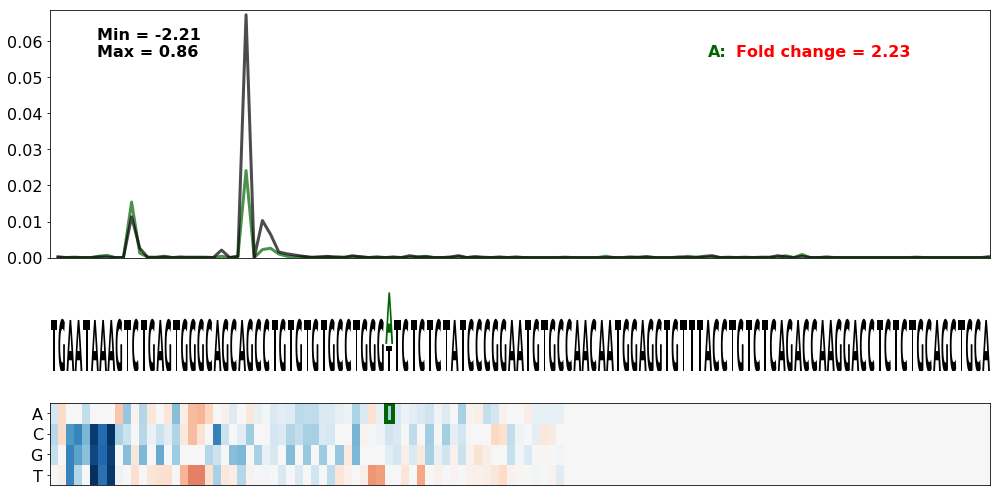

RMRP.1
TGGCGCGGGGGCGTCATCCGTCAGCTCCCTCTAGTTACGCAGGCAGTGCGTGTCCGCGCACCAACCACACGGGGCTCATTCTCAGCGCGGCTGTTTTTTGTTCCCGAGACCACGGCTCACTGCAGCCTCGACCTCCCCGGGCTCACGCGATGCCTCACCTCAGG
59
C
-6.609
-8.706
.............((((.........((((...)))).........))))....
.(((((........))))).......((((...)))).................


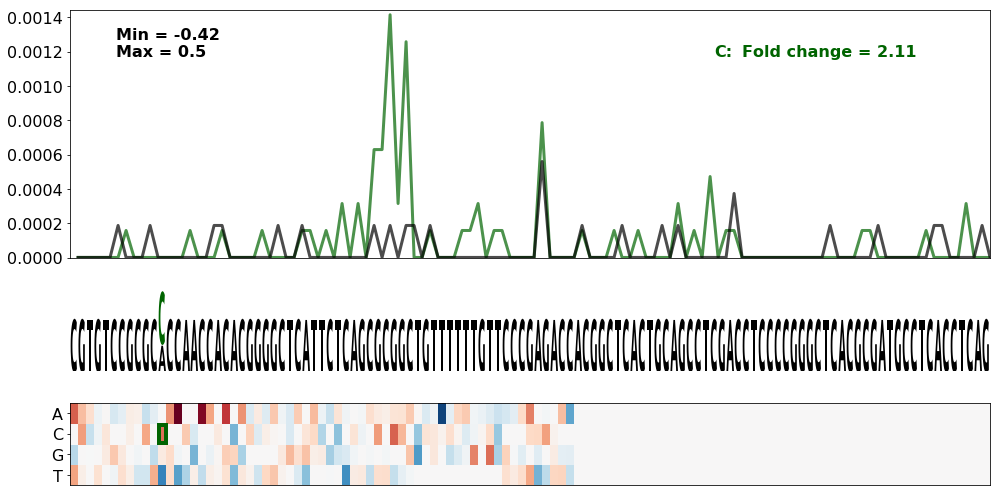

ELOVL4.1
CTGTACTGGTTCCCAAGAGCTATTCATTCCCTGCTACCTGATTTCAGCACAATAAATATACTTCTGCTGTGGGAAAAATATGATTTTTTTTTGTTAATCAGTTTATTATAATGTAAACTGTCTGCTAGATGTTTATTTGATTTAGTTAATTCTAAATTGTTTTC
78
A
-2.622
-4.711
.................(((((.....)))))......................
.................(((((((.....)))))))..................


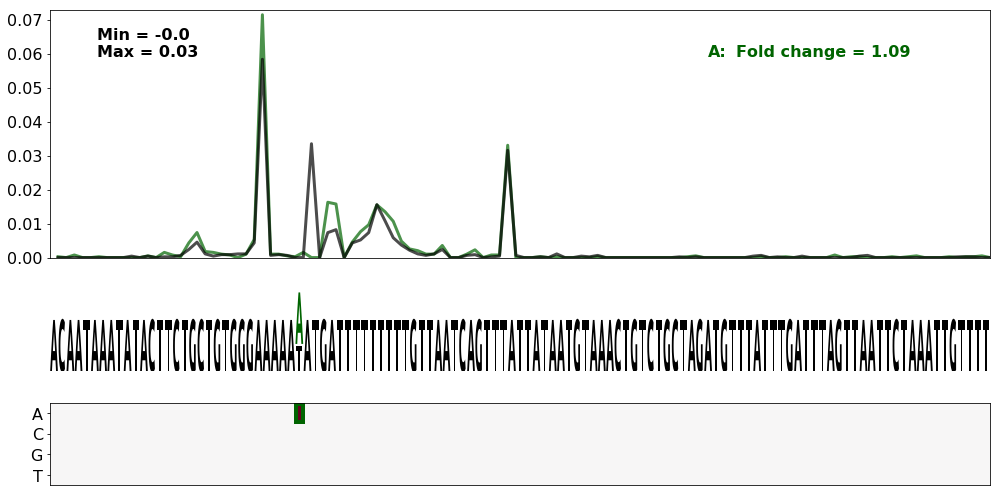

RMRP.1
TGGCGCGGGGGCGTCATCCGTCAGCTCCCTCTAGTTACGCAGGCAGTGCGTGTCCGCGCACCAACCACACGGGGCTCATTCTCAGCGCGGCTGTTTTTTGTTCCCGAGACCACGGCTCACTGCAGCCTCGACCTCCCCGGGCTCACGCGATGCCTCACCTCAGG
101
C
-6.609
-8.693999999999999
.............((((.........((((...)))).........))))....
.............(((((..((....((((...)))).....)).)))))....


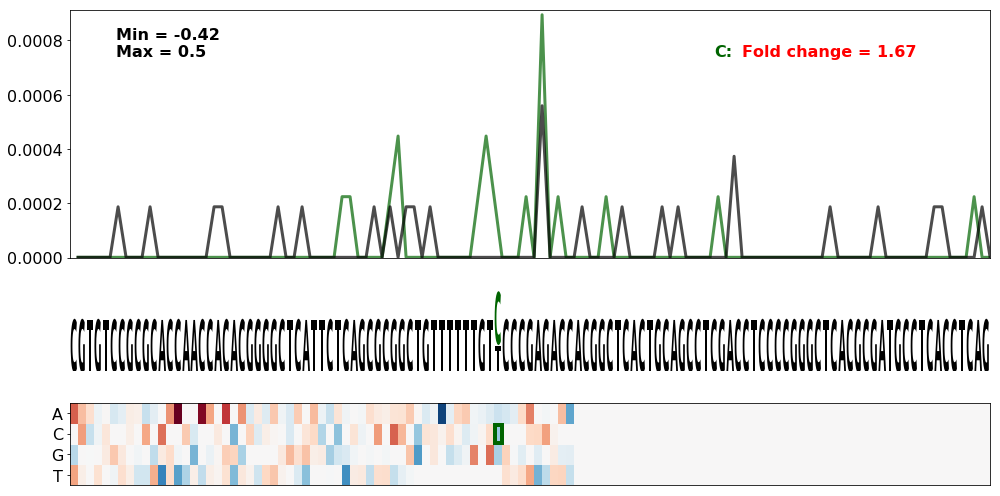

ARSA.3
GCCTGTGGGGGAGGCTCAGGTGTCTGGAGGGGGTTTGTGCCTGATAACGTAATAACACCAGTGGAGACTTGCAGATGTGACAATTCGTCCAATCCTGGGGTAATGCTGTGTGCTGGTGCCGGTCCCCTGTGGTACGAATGAGGAAACTGAGGTGCAGAGAGGTT
79
G
-5.0889999999999995
-7.167000000000001
.((((((((((.(((((....)).))).)).))))...))))............
.((((((((((.((((.......)))).)).))))...))))............


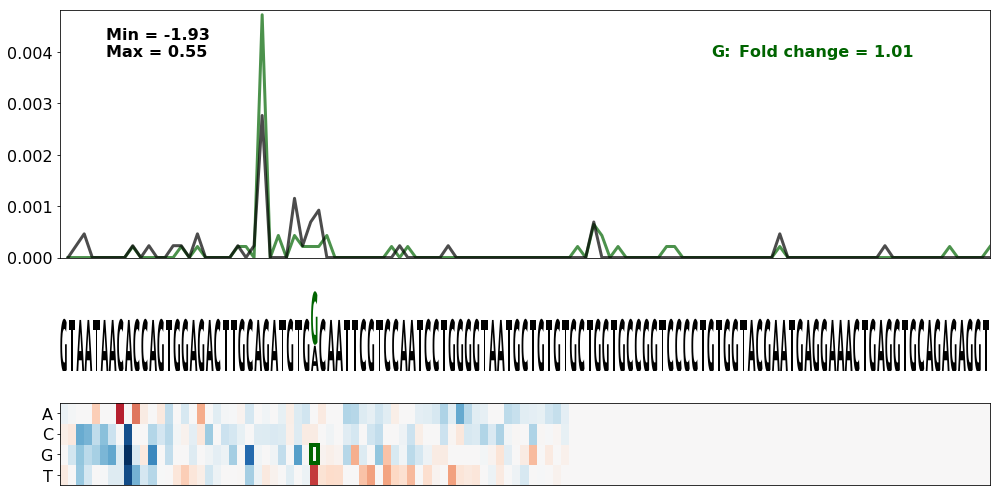

TPM1.28
TCTTGAGTTTTACTACAAGATGAGACTATGGATCCCGCATGCCTGAATTCACTAAAGCCAAGGGTCTGTAAGCCACGCTGCTCTTCCGAGACTTCCATTCCTTTCTGATTGGCACACGTGCAGCTCATGACAATCTGTAGGATAACAATCAGTGTGGATTTCCA
90
G
-3.992
-6.04
.....((.(.....).))......(((....)))....................
...((((......(((((.((.........)).))))).....)))).......


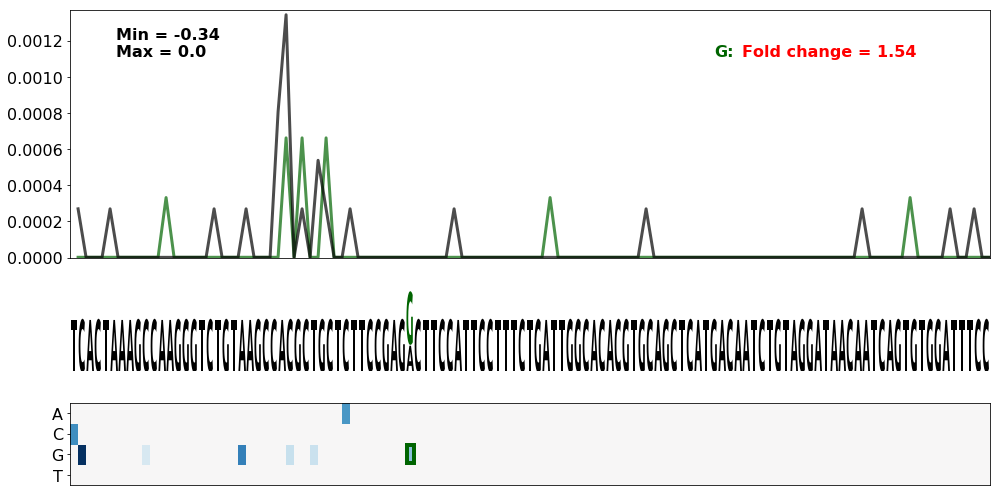

TPM1.15
GGGGCCCGGCCTGTTCTCCTGAGCCTTTGTTTTCCATCTCGCTGATCCAAAGTAAACGCTCCCAGGGGAAACGGGTGGTGTTGAGAAGGTTCTGGAAGGAGCATTTTCCCAGGAAGGGTCTGTTTCTGGGGTGGTGGCTTTCAGTCGTGTCTGTGCGTCCCCGG
95
G
-5.071000000000001
-7.093999999999999
.........((((((...(((.(.((.(((....)))..))..).)))))))))
..(((((((....((((.....)))).........)))))))............


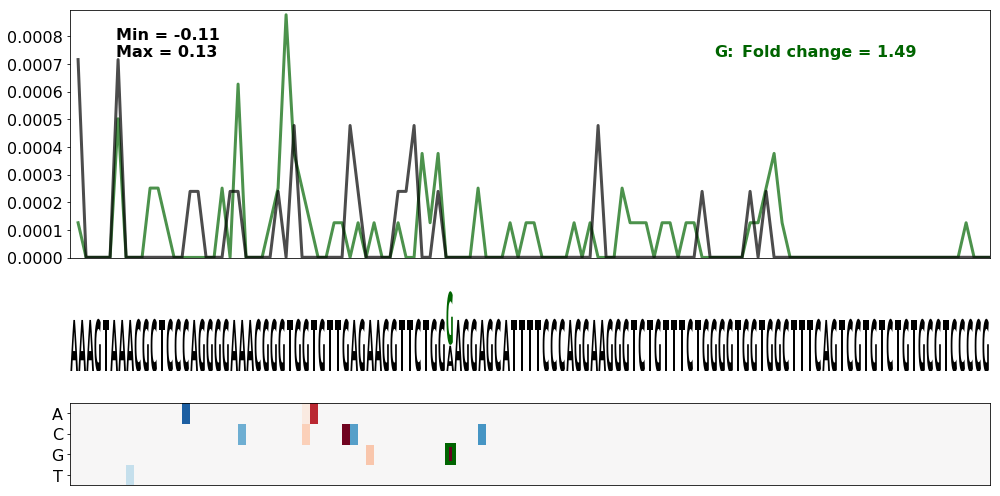

XPC.1
AAAGCTCTCTGTACTAAGGAGAAATGACTTTTATAACATTTTGAGAAAATAATAAAGCATTTATCTAAAGATTTGGCTCTATATTTTCTTTCAGATTTTTTTTTTTTTAAGGGGTCTTACTGTCTTGCGCAGGCTGGACTCCTGGGCTTGAGTGGTCTTCCTGA
66
G
-2.191
-4.21
......(((((((((...............))))).))))..............
......(((((((....................)))))))..............


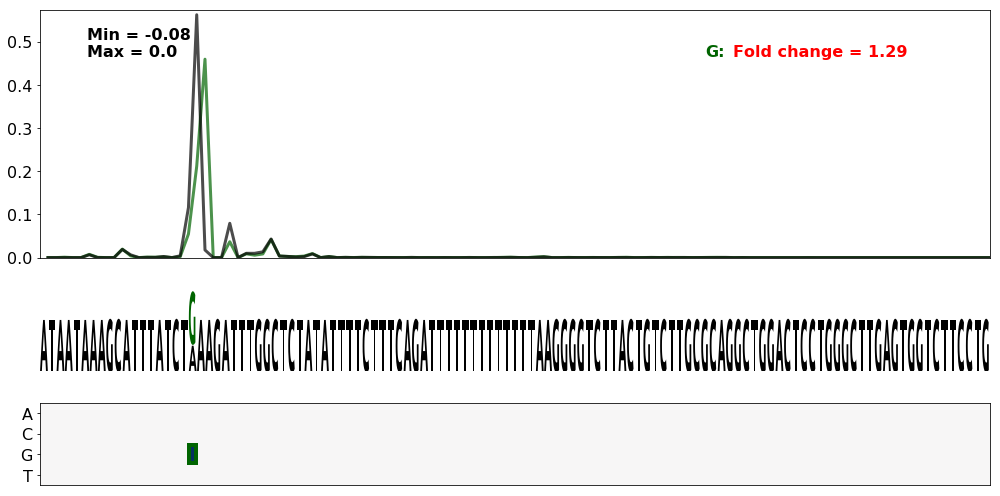

FOXC1.2
TCTATCCTCTTTTCTTTCTTTTTGTTGAACATATTCATTGTTTGTTTATTAATAAATTACCATTCAGTTTGAATGAGACCTATATGTCTGGATACTTTAATAGAGCTTTAATTATTACGAAAAAAGATTTCAGAGATAAAACACTAGAAGTTACCTATTCTCCA
75
G
-5.782
-7.787000000000001
....((((((...))))))...((.........))...((.....)).......
...(((((((...)))))))..((.........))...((.....)).......


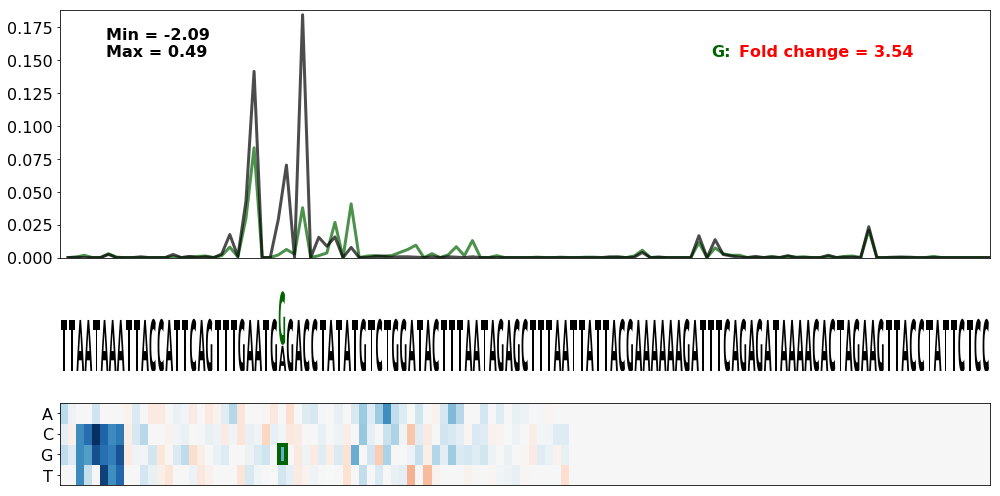

In [256]:

#df_sel = df_var_foldchange.query("delta_pos_true > 2 or delta_pos_true < -2").sort_values(by='delta_entropy', ascending=True).set_index('master_seq')
df_sel = df_var_foldchange.query("delta_entropy > 0.5 or delta_pos_true > 2 or delta_pos_true < -2").sort_values(by='delta_mfe', ascending=True).set_index('master_seq')
# and delta_logodds_true > 0.0

seq_start = 48
seq_end = 163#150

search_gene = None#'EARS2'

for index, row in df_sel.iterrows() :
    
    gene_name = row['gene']
    snv_pos = row['snv_pos']
    
    snv_nt = index[snv_pos]
    
    wt_seq = row['wt_seq']
    
    if search_gene is not None and search_gene not in gene_name :
        continue
    
    print(gene_name)
    print(wt_seq)
    print(snv_pos)
    print(snv_nt)
    
    struct_var = row['struct_var']
    struct_ref = row['struct_wt']
    
    mfe_var = row['mfe_var']
    mfe_ref = row['mfe_wt']
    delta_mfe = row['delta_mfe']
    
    print(mfe_ref)
    print(mfe_var)
    print(struct_ref)
    print(struct_var)
    
    mut_map_with_cuts(
            seq_predicted_isoform_df_delta.query("wt_seq == '" + wt_seq + "'"),
            gene_name,
            [(snv_pos, snv_nt, 'darkgreen')],
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=True,
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=None,
            fig_dpi=300
    )

In [12]:
def mut_map_with_cuts_and_fold(df, gene_name, mfe_ref, mfe_var, mfe_struct_ref, mfe_struct_var, cut_snvs, mode, column_suffix='', figsize=(12, 6), fold_height=0.5, height_ratios=[6, 2, 2], bg_alpha=0.5, plot_simple_mutmap=True, annotate_folds=True, plot_true_cuts=True, plot_pred_cuts=False, scale_pred_cuts=False, fold_change_from_cut_range=None, ref_var_scales=[0.3, 0.7], border_eta = 0.085, seq_trim_start=0, seq_trim_end=164, plot_start=0, plot_end=164, plot_as_bars=True, pas_downscaling=0.5, fig_name=None, fig_dpi=300) :

    mut_map = np.zeros((4, 164))

    df_gene = df.query("gene == '" + gene_name + "'")
    ref_seq = df_gene['wt_seq'].values[0]

    for index, row in df_gene.iterrows() :
        snv_pos = row['snv_pos']
        
        if row['wt_seq'] != ref_seq :
            continue

        delta_logodds_true = row['delta_logodds_' + mode + column_suffix]
        if np.isnan(delta_logodds_true) :
            delta_logodds_true = 0

        base = 0
        if index[snv_pos] == 'A' :
            base = 0
        elif index[snv_pos] == 'C' :
            base = 1
        elif index[snv_pos] == 'G' :
            base = 2
        elif index[snv_pos] == 'T' :
            base = 3

        mut_map[3-base, snv_pos] = delta_logodds_true

    #Down-scale PAS mutations
    mut_map[:, 50:50+6] = mut_map[:, 50:50+6] * pas_downscaling
    
    #Slice according to seq trim index
    ref_seq = ref_seq[seq_trim_start: seq_trim_end]
    mut_map = mut_map[:, seq_trim_start: seq_trim_end]
    mfe_struct_ref = mfe_struct_ref[seq_trim_start: seq_trim_end]
    mfe_struct_var = mfe_struct_var[seq_trim_start: seq_trim_end]
    
    fig = plt.figure(figsize=figsize) 
    gs = gridspec.GridSpec(3, 1, height_ratios=height_ratios)

    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1])
    ax2 = plt.subplot(gs[2])
    ax = [ax0, ax1, ax2]

    bias = np.max(np.sum(mut_map[:, :], axis=0)) / 3.0 + 0.5
    max_score = np.min(np.sum(mut_map[:, :], axis=0)) / 3.0 * -1 + bias

    for i in range(plot_start, plot_end) :
        mutability_score = np.sum(mut_map[:, i]) / 3.0 * -1 + bias
        
        color = 'black'
        alpha = bg_alpha
        char_height = 1
        
        for snv_pos, snv_nt, snv_color in cut_snvs :
            if i == snv_pos - seq_trim_start :
                #color = snv_color#None
                #alpha = 1.0
                
                color = 'black'
                alpha = bg_alpha
                char_height = ref_var_scales[0]
                
                letterAt(snv_nt, i + 0.5, ref_var_scales[0], ref_var_scales[1], ax[1], color=snv_color, alpha=1.0)
                
                break
        
        if not plot_simple_mutmap :
            letterAt(ref_seq[i], i + 0.5, 0, mutability_score, ax[1], color=color, alpha=alpha)
        else :
            letterAt(ref_seq[i], i + 0.5, 0, char_height, ax[1], color=color, alpha=alpha)
        
        if mfe_struct_ref[i] != 'X' :
            letterAt(mfe_struct_ref[i], i + 0.5, -fold_height, fold_height-0.05, ax[1], color='black')
        if mfe_struct_var[i] != 'X' :
            letterAt(mfe_struct_var[i], i + 0.5, -2*fold_height-0.05, fold_height-0.05, ax[1], color='black')
                
    annot_text = 'MFE = ' + str(round(mfe_ref, 1))
    #logo_ax[2].annotate(annot_text, xy=(56, -fold_height/2), xycoords='data', xytext=(-30, 0), ha='right', fontsize=10, weight="bold", color='black', textcoords='offset points', arrowprops=dict(headlength=8, headwidth=8, shrink=0.15, width=1.5, color='black'))
    ax[1].text(55-seq_trim_start, -fold_height/2 -0.05, annot_text, horizontalalignment='right', verticalalignment='center', color='black', fontsize=12, weight="bold")
    annot_text = 'MFE = ' + str(round(mfe_var, 1))
    #logo_ax[2].annotate(annot_text, xy=(56, -fold_height/2), xycoords='data', xytext=(-30, 0), ha='right', fontsize=10, weight="bold", color='black', textcoords='offset points', arrowprops=dict(headlength=8, headwidth=8, shrink=0.15, width=1.5, color='black'))
    ax[1].text(55-seq_trim_start, -fold_height -fold_height/2 -0.05-0.05, annot_text, horizontalalignment='right', verticalalignment='center', color='black', fontsize=12, weight="bold")
    

    if not plot_simple_mutmap :
        ax[1].plot([0, mut_map.shape[1]], [bias, bias], color='black', linestyle='--')

    plt.sca(ax[1])
    
    if not plot_simple_mutmap :
        plt.yticks([0.5, bias, max_score], [round(bias - 0.5, 2), 0, round((max_score - bias) * -1, 2)], fontsize=16)
        plt.ylim((-2*fold_height-0.175, max_score))
    else :
        plt.yticks([], [])
        plt.ylim((-2*fold_height-0.175, ref_var_scales[0] + ref_var_scales[1]))
        plt.axis('off')
    
    plt.xlim((plot_start, plot_end))
    plt.tight_layout()

    pcm = ax[2].pcolor(mut_map, cmap='RdBu_r', vmin=-np.abs(mut_map).max(), vmax=np.abs(mut_map).max())
    #fig.colorbar(pcm, ax=ax[1])

    plt.sca(ax[2])

    ref_seq_list = []
    for c in ref_seq :
        ref_seq_list.append(c)
    #plt.xticks(np.arange(len(ref_seq)) + 0.5, ref_seq_list)
    plt.xticks([], [])

    plt.yticks([0.5, 1.5, 2.5, 3.5], ['T', 'G', 'C', 'A'], fontsize=16)

    #plt.gca().xaxis.tick_top()
    #plt.xticks(fontsize=16)

    plt.axis([plot_start, plot_end, 0, 4])
    
    for i in range(plot_start, plot_end) :
        for j in range(0, 4) :
            base = 'A'
            if j == 3 :
                base = 'A'
            elif j == 2 :
                base = 'C'
            elif j == 1 :
                base = 'G'
            elif j == 0 :
                base = 'T'
            
            is_marked = False
            for snv_pos, snv_nt, _ in cut_snvs :
                if i == snv_pos - seq_trim_start and base == snv_nt :
                    is_marked = True
                    break
            
            if not is_marked :
                ax[2].add_patch(Rectangle((i, j), 1, 1, fill=True, facecolor='white', alpha=1. - bg_alpha, edgecolor=None))
    
    ref_cut_true = df_gene['pooled_cut_prob_true_wt'].values[0][seq_trim_start: seq_trim_end]
    ref_cut_pred = df_gene['cut_prob_pred_wt'].values[0][seq_trim_start: seq_trim_end]
    
    max_y_var_hat = 0
    for snv_pos, snv_nt, snv_color in cut_snvs :
        df_pos = df_gene.query("snv_pos == " + str(snv_pos))
        
        var_cut_true = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['pooled_cut_prob_true_var'][0][seq_trim_start: seq_trim_end]
        var_cut_pred = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['cut_prob_pred_var'][0][seq_trim_start: seq_trim_end]
        
        if scale_pred_cuts :
            ref_pred_logodds = np.zeros(ref_cut_pred.shape)
            var_pred_logodds = np.zeros(var_cut_pred.shape)

            ref_pred_logodds[ref_cut_pred > 0.0] = np.log(ref_cut_pred[ref_cut_pred > 0.0] / (1.0 - ref_cut_pred[ref_cut_pred > 0.0]))
            var_pred_logodds[var_cut_pred > 0.0] = np.log(var_cut_pred[var_cut_pred > 0.0] / (1.0 - var_cut_pred[var_cut_pred > 0.0]))

            pred_fold_change = np.exp(var_pred_logodds - ref_pred_logodds)

            #var_cut_pred = ref_cut_true * pred_fold_change
            ref_cut_true_odds = ref_cut_true / (1. - ref_cut_true)
            var_cut_pred_odds = ref_cut_true_odds * pred_fold_change
            var_cut_pred = var_cut_pred_odds / (1. + var_cut_pred_odds)
        
        if plot_true_cuts :
            max_y_var_hat = max(max_y_var_hat, np.max(var_cut_true[plot_start:plot_end]))
        if plot_pred_cuts :
            max_y_var_hat = max(max_y_var_hat, np.max(var_cut_pred[plot_start:plot_end]))
        
        if plot_as_bars :
            if plot_true_cuts :
                ax[0].step(np.arange(plot_end)[plot_start:plot_end] + 1, var_cut_true[plot_start:plot_end], color=snv_color, alpha=0.85, where='mid', linewidth=3)
            if plot_pred_cuts :
                ax[0].step(np.arange(plot_end)[plot_start:plot_end] + 1, var_cut_pred[plot_start:plot_end], color=snv_color, linestyle='--', alpha=0.85, where='mid', linewidth=3)
        else :
            if plot_true_cuts :
                ax[0].plot(np.arange(plot_end)[plot_start:plot_end] + 1, var_cut_true[plot_start:plot_end], color=snv_color, linestyle='-', linewidth=3, alpha=0.7)
            if plot_pred_cuts :
                ax[0].plot(np.arange(plot_end)[plot_start:plot_end] + 1, var_cut_pred[plot_start:plot_end], color=snv_color, linestyle='--', linewidth=3, alpha=0.7)
        
        #Highlight specific snv in mutation map
        
        base = 0
        if snv_nt == 'A' :
            base = 0
        elif snv_nt == 'C' :
            base = 1
        elif snv_nt == 'G' :
            base = 2
        elif snv_nt == 'T' :
            base = 3
        
        #ax[2].add_patch(Rectangle((snv_pos, 3 - base), 1, 1, fill=False, edgecolor=snv_color, lw=4))
        ax[2].add_patch(Rectangle((snv_pos - seq_trim_start + border_eta, 3 - base + border_eta), 1 - 2.*border_eta, 1 - 2.*border_eta, fill=False, edgecolor=snv_color, lw=4))
        #ax[1].add_patch(Rectangle((snv_pos, 0), 1, max_score, fill=False, edgecolor=snv_color, lw=4))
    
    if plot_true_cuts :
        max_y_var_hat = max(max_y_var_hat, np.max(ref_cut_true[plot_start:plot_end]))
    if plot_pred_cuts and not scale_pred_cuts :
        max_y_var_hat = max(max_y_var_hat, np.max(ref_cut_pred[plot_start:plot_end]))
    
    #Annotate min/max delta isoform log odds
    min_mutmap_logodds = round((max_score - bias) * -1, 2)
    max_mutmap_logodds = round(bias - 0.5, 2)
    annot_text = 'Min = ' + str(min_mutmap_logodds) + '\nMax = ' + str(max_mutmap_logodds)
    
    ax[0].text(0.05, 0.80, annot_text,
        horizontalalignment='left', verticalalignment='bottom',
        transform=ax[0].transAxes,
        color='black', fontsize=16, weight="bold")
    
    snv_i = 0
    for snv_pos, snv_nt, snv_color in cut_snvs :
        if annotate_folds :
            if plot_true_cuts :
                
                df_pos = df_gene.query("snv_pos == " + str(snv_pos))
                df_pos = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]
                
                fold_change = np.exp(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['delta_logodds_true' + column_suffix][0])
                
                if fold_change_from_cut_range :
                    fold_range_start = fold_change_from_cut_range[0]
                    fold_range_end = fold_change_from_cut_range[1]
                    
                    ref_p = np.sum(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['pooled_cut_prob_true_wt'][0][fold_range_start: fold_range_end])
                    var_p = np.sum(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['pooled_cut_prob_true_var'][0][fold_range_start: fold_range_end])
                    
                    fold_change = (var_p / (1. - var_p)) / (ref_p / (1. - ref_p))
                
                
                fold_color = 'darkgreen'
                if fold_change < 1. :
                    fold_color = 'red'
                    fold_change = 1. / fold_change
                #fold_color = snv_color
                
                row_multiplier = 0.1
                row_bias = 0
                if plot_pred_cuts :
                    row_multiplier = 0.2
                
                ax[0].text(0.70, 0.80 - row_multiplier * snv_i, snv_nt + ':',
                    horizontalalignment='left', verticalalignment='bottom',
                    transform=ax[0].transAxes,
                    color=snv_color, fontsize=16, weight="bold")
                ax[0].text(0.73, 0.80 - row_multiplier * snv_i, 'Fold change = ' + str(round(fold_change, 2)),
                    horizontalalignment='left', verticalalignment='bottom',
                    transform=ax[0].transAxes,
                    color=fold_color, fontsize=16, weight="bold")
            
            if plot_pred_cuts :
                
                df_pos = df_gene.query("snv_pos == " + str(snv_pos))
                df_pos = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]
                
                fold_change = np.exp(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['delta_logodds_pred' + column_suffix][0])
                
                if fold_change_from_cut_range :
                    fold_range_start = fold_change_from_cut_range[0]
                    fold_range_end = fold_change_from_cut_range[1]
                    
                    ref_p = np.sum(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['cut_prob_pred_wt'][0][fold_range_start: fold_range_end])
                    var_p = np.sum(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['cut_prob_pred_var'][0][fold_range_start: fold_range_end])
                    
                    if scale_pred_cuts :
                        ref_p = np.sum(df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['pooled_cut_prob_true_wt'][0][fold_range_start: fold_range_end])
                        
                        ref_cut_true_t = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['pooled_cut_prob_true_wt'][0]#[0: seq_trim_end]
                        ref_cut_pred_t = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['cut_prob_pred_wt'][0]#[0: seq_trim_end]
                        var_cut_pred_t = df_pos[df_pos.index.str.slice(snv_pos, snv_pos + 1) == snv_nt]['cut_prob_pred_var'][0]#[0: seq_trim_end]

                        ref_pred_logodds = np.zeros(ref_cut_pred_t.shape)
                        var_pred_logodds = np.zeros(var_cut_pred_t.shape)

                        ref_pred_logodds[ref_cut_pred_t > 0.0] = np.log(ref_cut_pred_t[ref_cut_pred_t > 0.0] / (1.0 - ref_cut_pred_t[ref_cut_pred_t > 0.0]))
                        var_pred_logodds[var_cut_pred_t > 0.0] = np.log(var_cut_pred_t[var_cut_pred_t > 0.0] / (1.0 - var_cut_pred_t[var_cut_pred_t > 0.0]))

                        pred_fold_change = np.exp(var_pred_logodds - ref_pred_logodds)

                        #var_cut_pred = ref_cut_true * pred_fold_change
                        ref_cut_true_odds = ref_cut_true_t / (1. - ref_cut_true_t)
                        var_cut_pred_odds = ref_cut_true_odds * pred_fold_change
                        var_cut_pred_t = var_cut_pred_odds / (1. + var_cut_pred_odds)
                        var_p = np.sum(var_cut_pred_t[fold_range_start: fold_range_end])
                    
                    fold_change = (var_p / (1. - var_p)) / (ref_p / (1. - ref_p))
                
                
                fold_color = 'darkgreen'
                if fold_change < 1. :
                    fold_color = 'red'
                    fold_change = 1. / fold_change
                #fold_color = snv_color
                
                row_multiplier = 0.1
                row_bias = 0.0
                if plot_true_cuts :
                    row_multiplier = 0.2
                    row_bias = 0.1
                
                ax[0].text(0.70, 0.80 - row_multiplier * snv_i - row_bias, snv_nt + ':',
                    horizontalalignment='left', verticalalignment='bottom',
                    transform=ax[0].transAxes,
                    color=snv_color, fontsize=16, weight="bold")
                ax[0].text(0.73, 0.80 - row_multiplier * snv_i - row_bias, 'Predicted change = ' + str(round(fold_change, 2)),
                    horizontalalignment='left', verticalalignment='bottom',
                    transform=ax[0].transAxes,
                    color=fold_color, fontsize=16, weight="bold")
        
        snv_i += 1
    
    #Plot reference cut distribution
    if plot_as_bars :
        if plot_true_cuts :
            ax[0].step(np.arange(plot_end)[plot_start:plot_end] + 1, ref_cut_true[plot_start:plot_end], color='black', alpha=0.85, where='mid', linewidth=3)
        if plot_pred_cuts and not scale_pred_cuts :
            ax[0].step(np.arange(plot_end)[plot_start:plot_end] + 1, ref_cut_pred[plot_start:plot_end], color='black', linestyle='--', alpha=0.85, where='mid', linewidth=3)
    else :
        if plot_true_cuts :
            ax[0].plot(np.arange(plot_end)[plot_start:plot_end] + 1, ref_cut_true[plot_start:plot_end], color='black', linestyle='-', linewidth=3, alpha=0.7)    
        if plot_pred_cuts and not scale_pred_cuts :
            ax[0].plot(np.arange(plot_end)[plot_start:plot_end] + 1, ref_cut_pred[plot_start:plot_end], color='black', linestyle='--', linewidth=3, alpha=0.7)

    #ax[0].plot([57, 57], [0, max(np.max(ref_cut[:164]), max_y_var_hat)], color='green', linestyle='--', linewidth=3)
    #ax[0].plot([97, 97], [0, max(np.max(ref_cut[:164]), max_y_var_hat)], color='green', linestyle='--', linewidth=3)

    plt.sca(ax[0])
    plt.xlim((plot_start, plot_end))
    plt.yticks(fontsize=16)
    plt.ylim(0, max_y_var_hat * 1.02)

    plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
    plt.tight_layout()
    
    if fig_name is not None :
        plt.savefig(fig_name + '.png', transparent=True, dpi=fig_dpi)
        plt.savefig(fig_name + '.svg')
        plt.savefig(fig_name + '.eps')
    plt.show()

Folding changes:
Gene = MLH1.2
SNV pos = 80
SNV nt = C
ClinVar id = Missing
Observed:


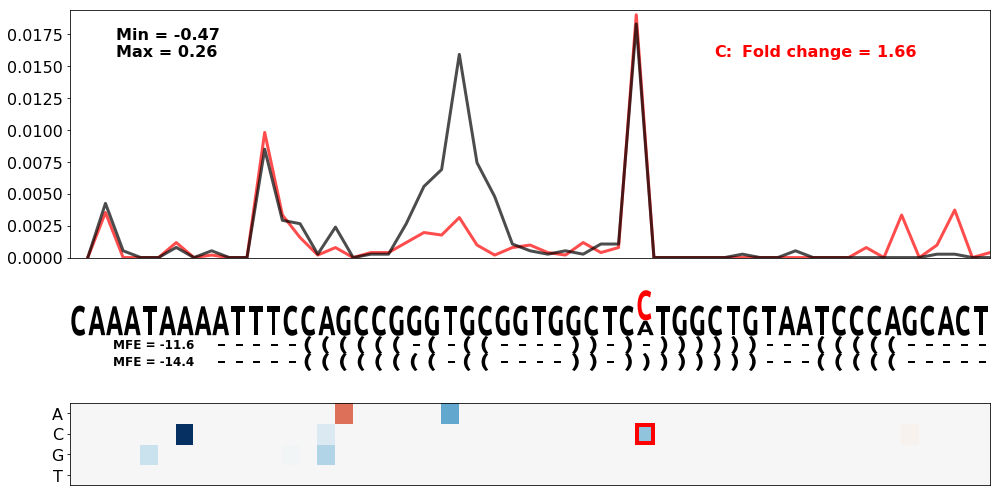

Predicted:


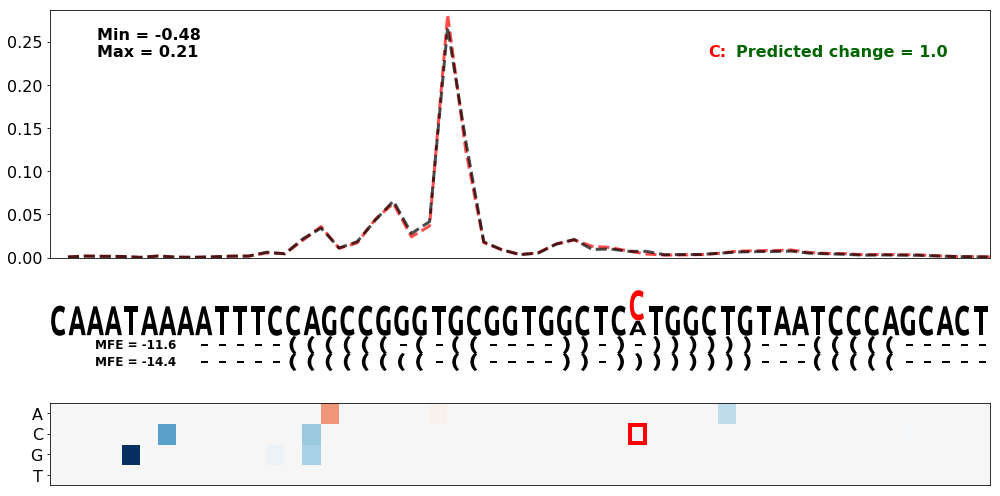

Both:


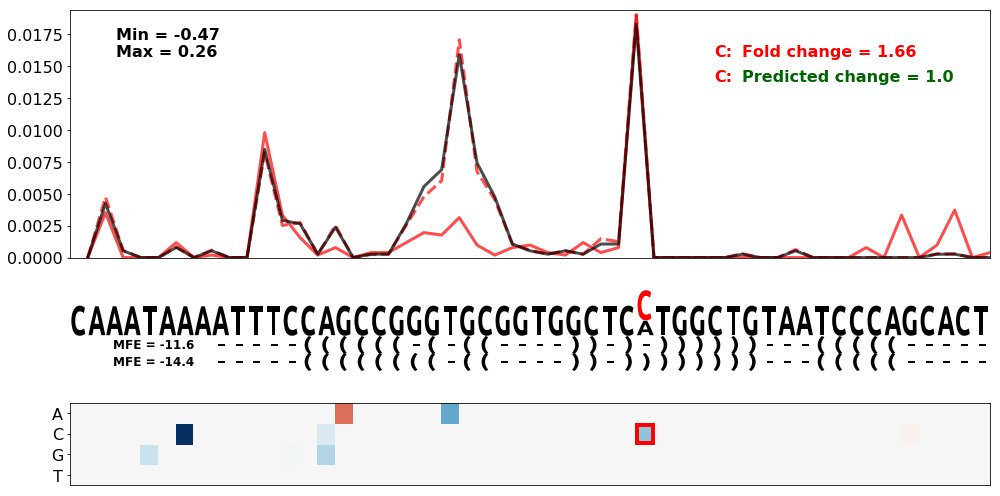

Gene = MLH1.2
SNV pos = 69
SNV nt = A
ClinVar id = Missing
Observed:


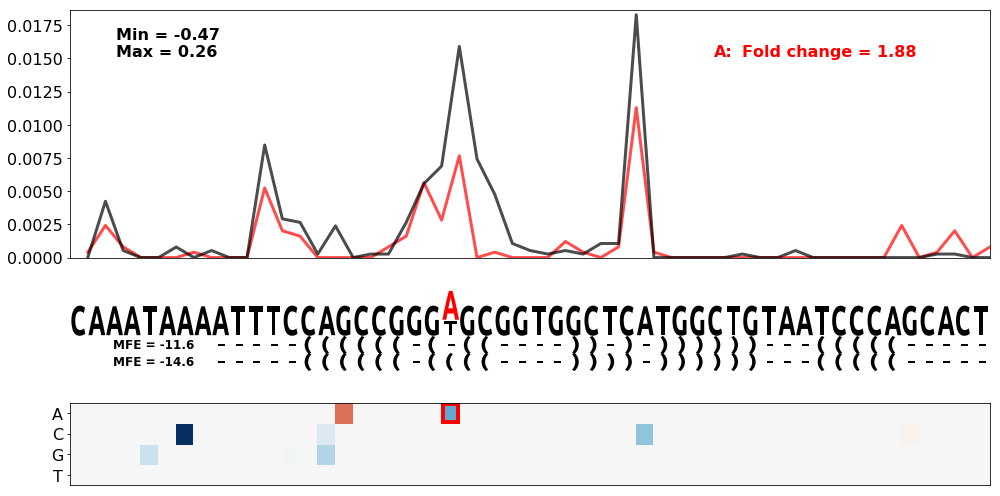

Predicted:


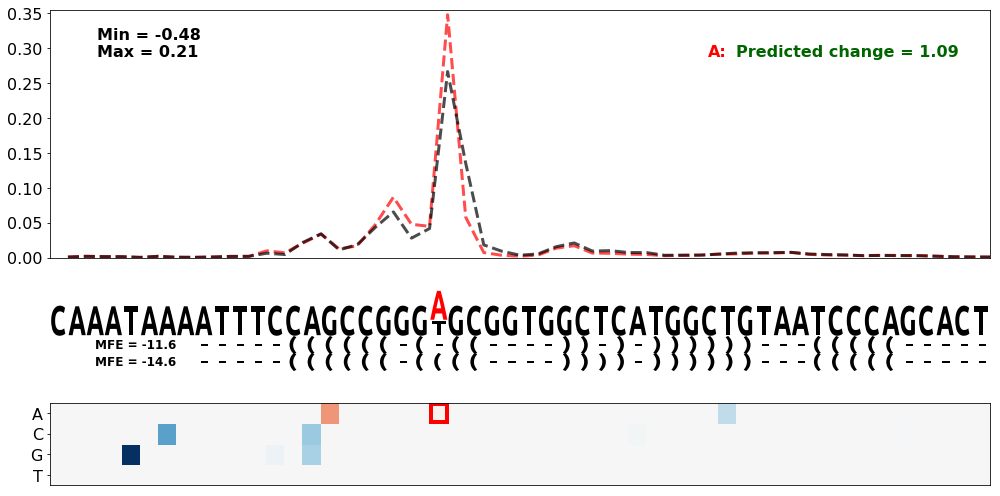

Both:


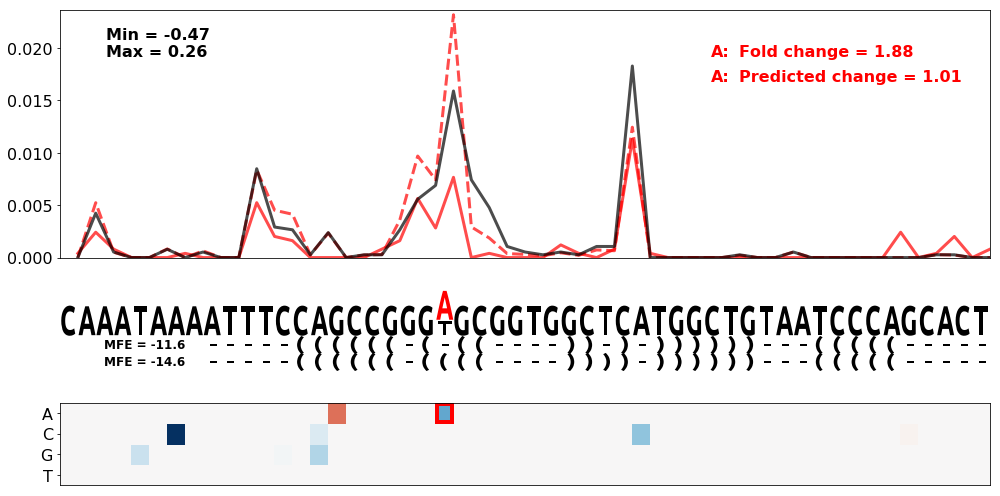

Gene = ARSA.3
SNV pos = 83
SNV nt = G
ClinVar id = Missing
Observed:


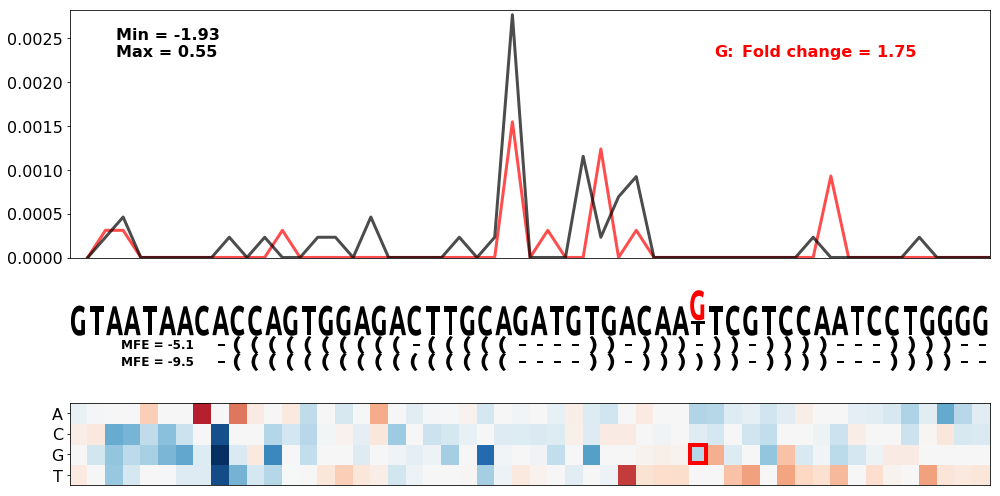

Predicted:


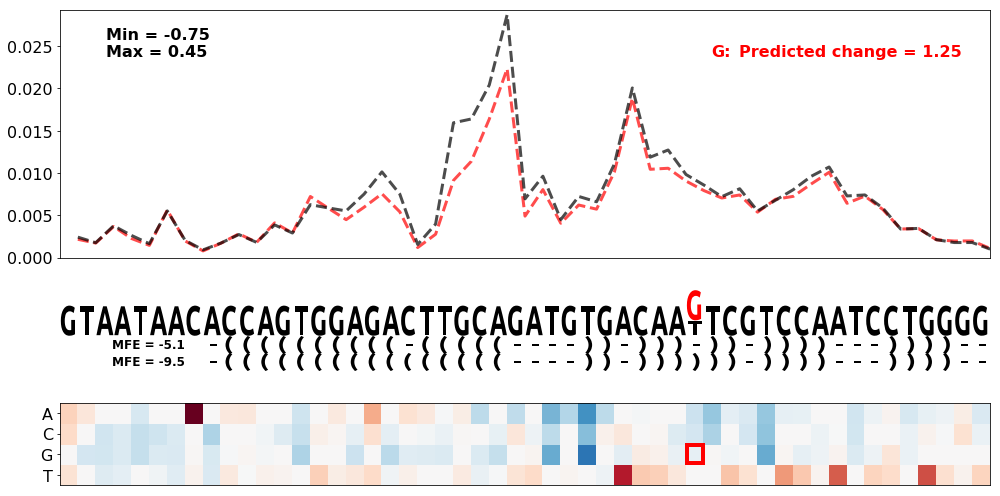

Both:


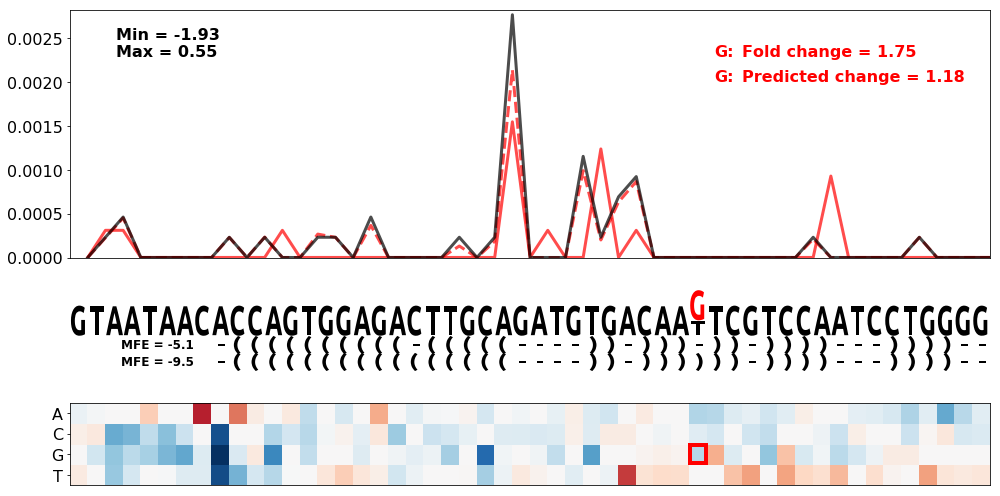

Gene = TP53.3
WT seq = CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
SNV pos = 76
SNV nt = G
ClinVar id = Missing
Observed:


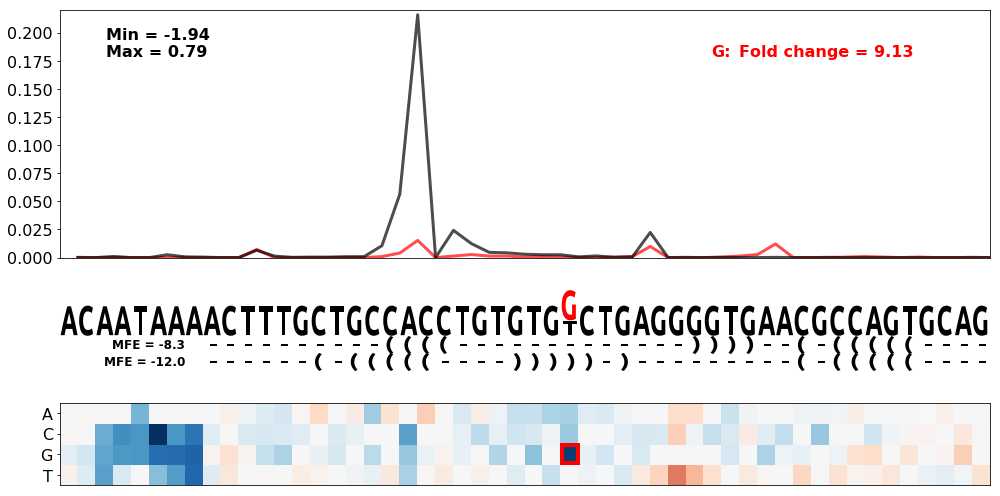

Predicted:


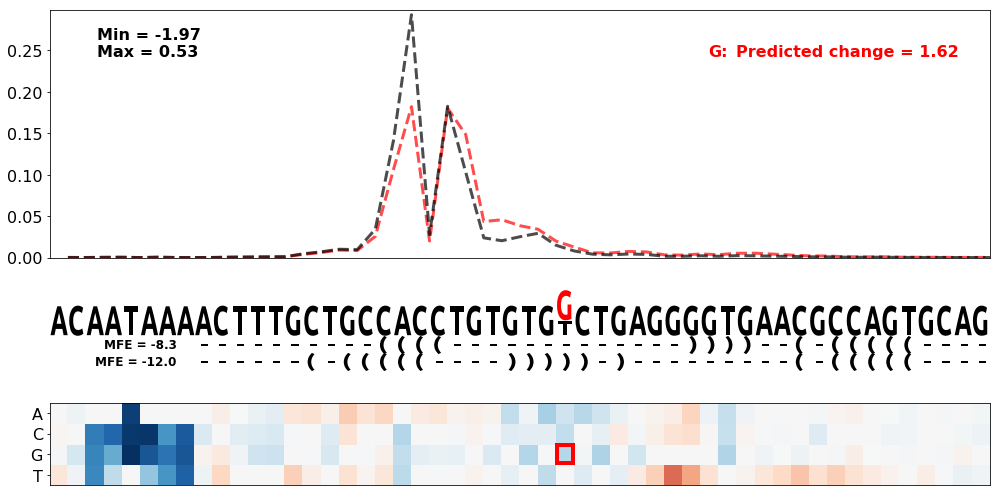

Both:


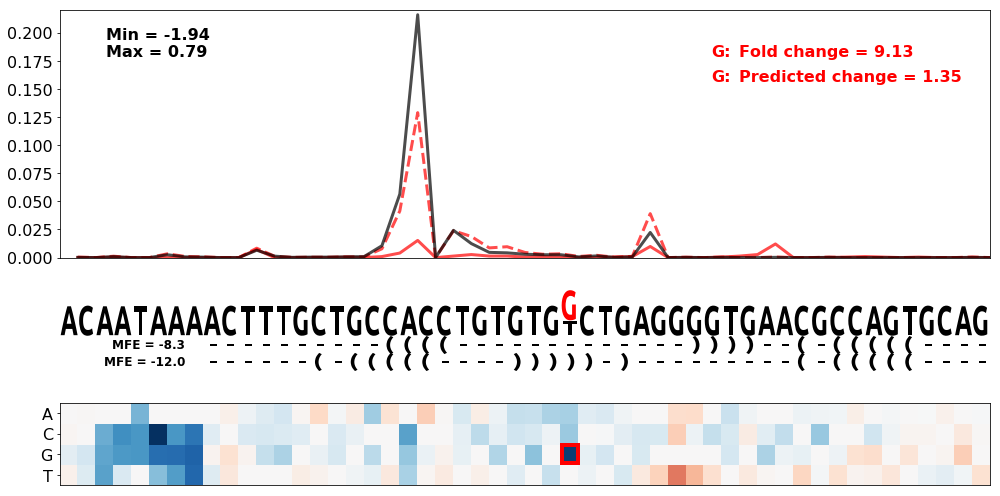

Gene = LDLR.8
SNV pos = 69
SNV nt = T
ClinVar id = Missing
Observed:


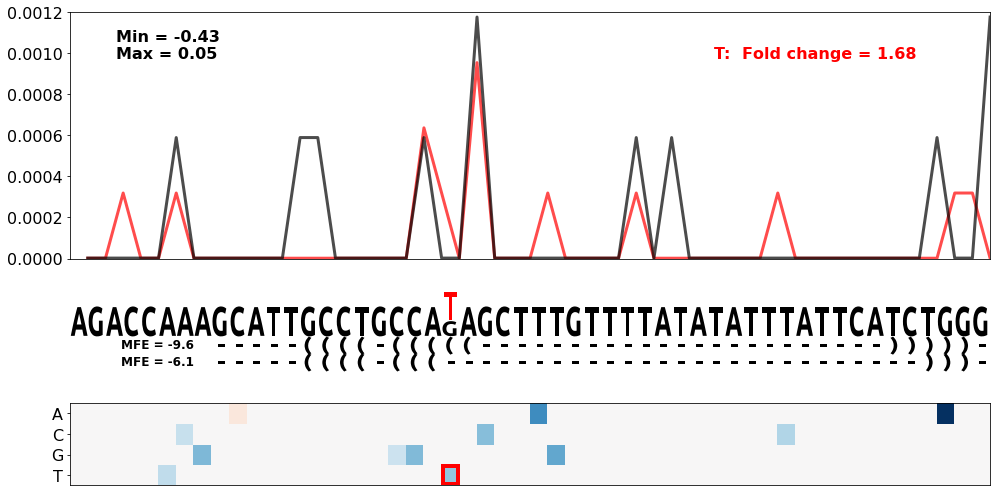

Predicted:


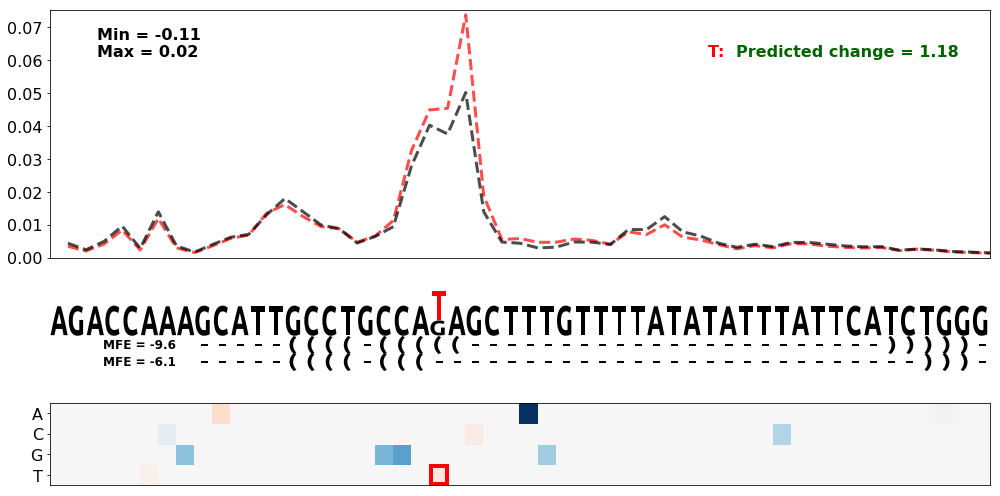

Both:


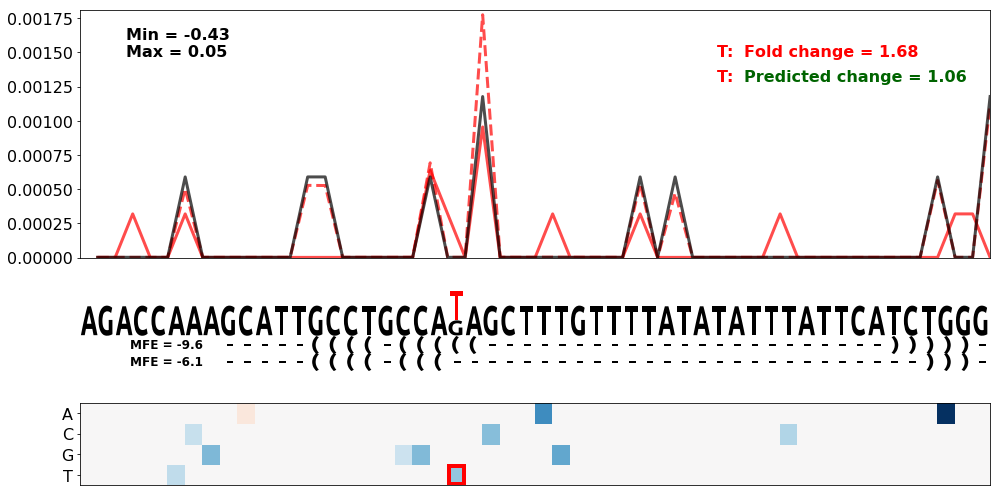

Gene = ARSA.3
SNV pos = 67
SNV nt = A
ClinVar id = Missing
Observed:


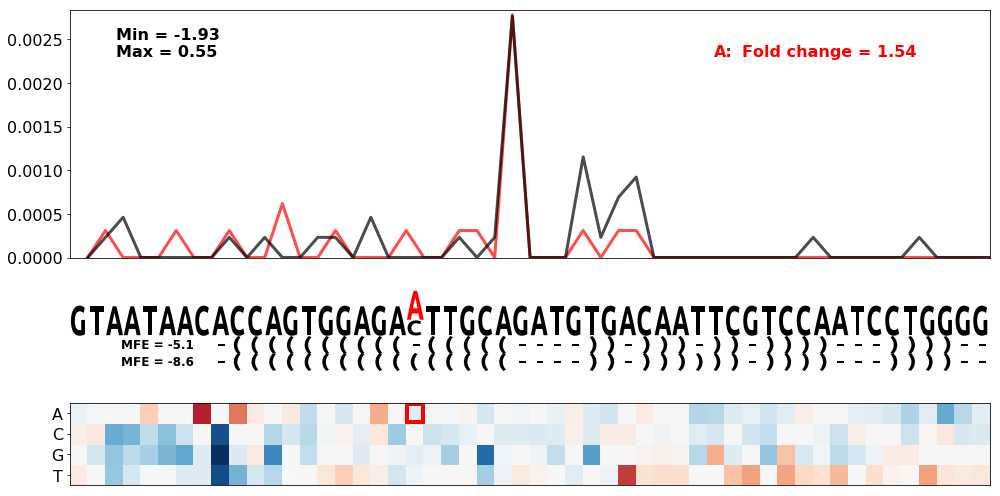

Predicted:


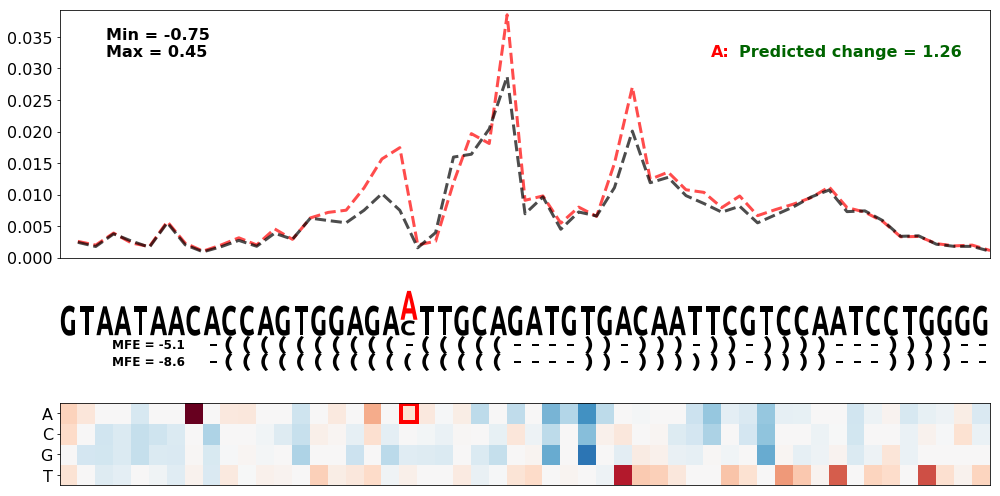

Both:


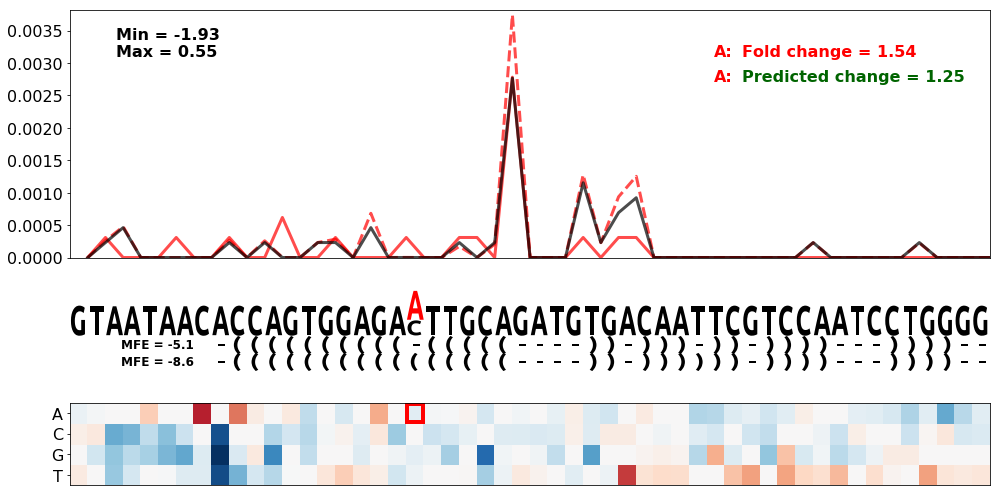

Gene = PTEN.16
SNV pos = 107
SNV nt = G
ClinVar id = Missing
Observed:


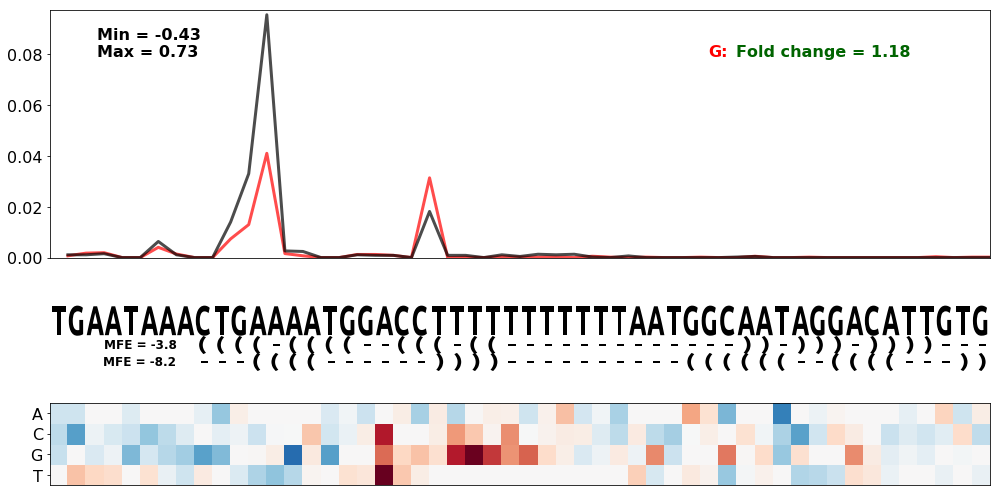

Predicted:


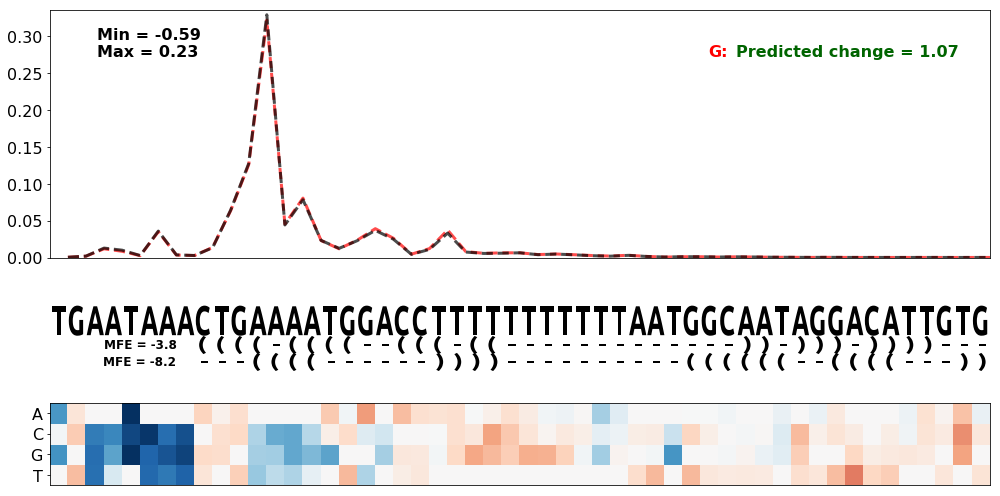

Both:


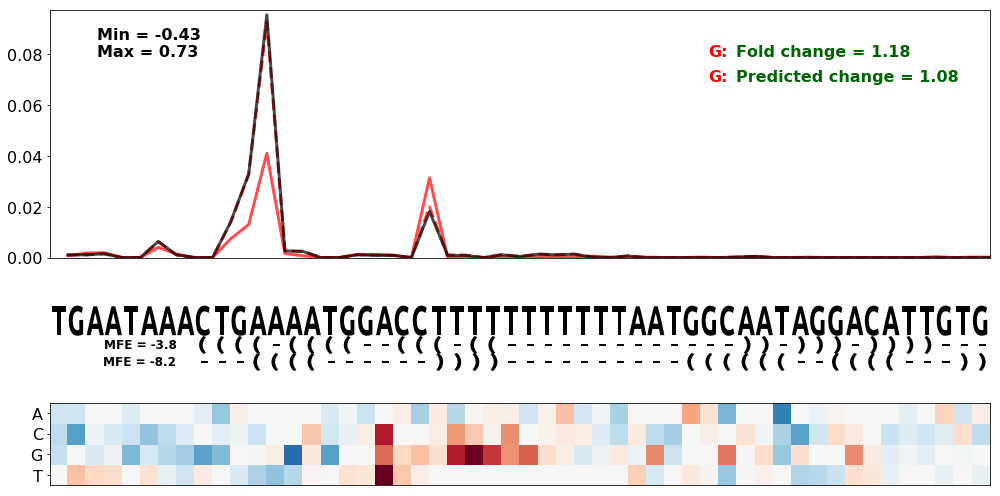

Gene = NF2.3
SNV pos = 97
SNV nt = G
ClinVar id = Missing
Observed:


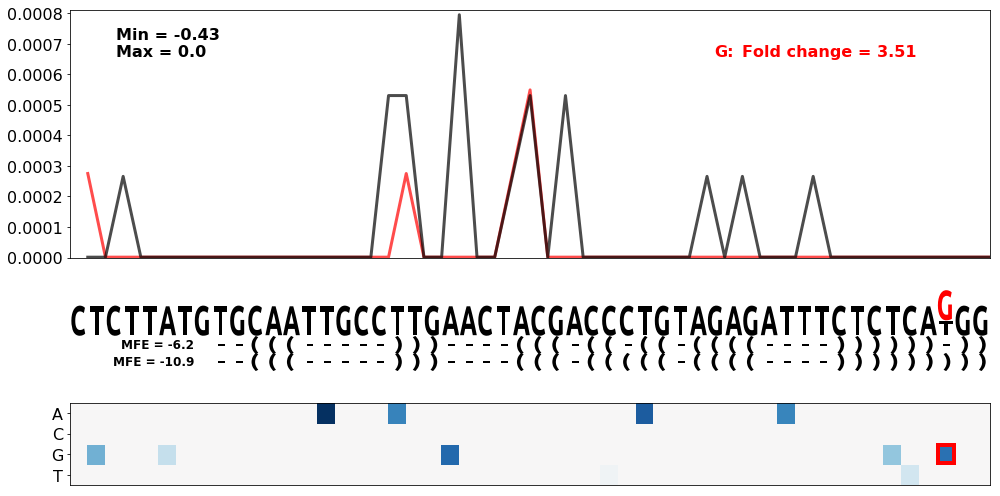

Predicted:


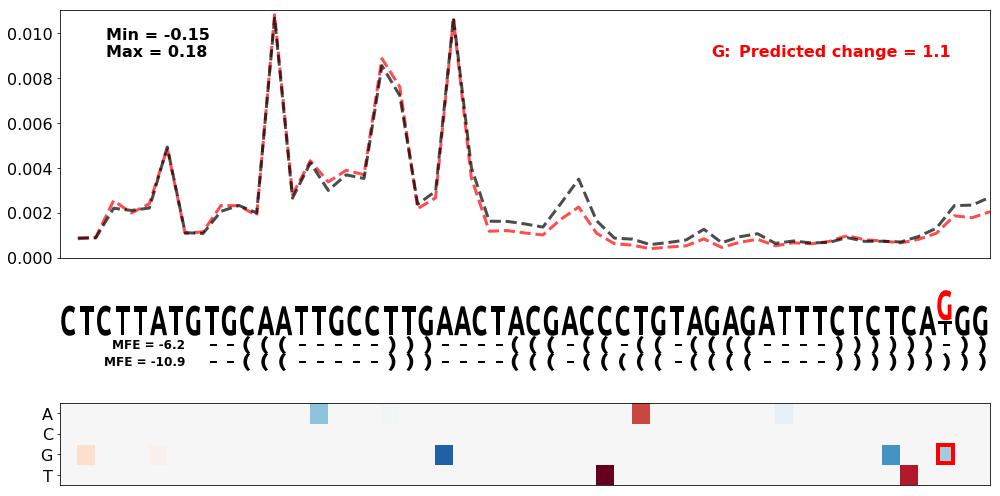

Both:


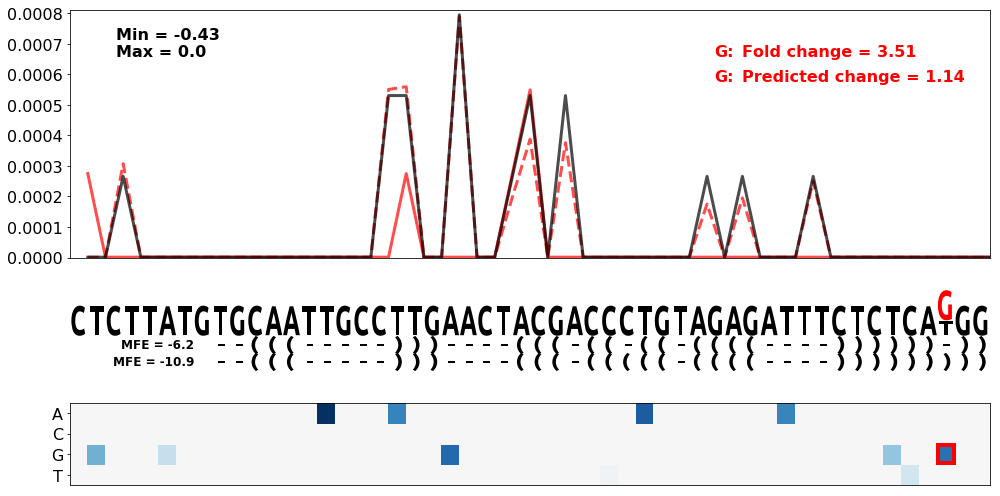

Gene = LDLR.4
SNV pos = 66
SNV nt = G
ClinVar id = Missing
Observed:


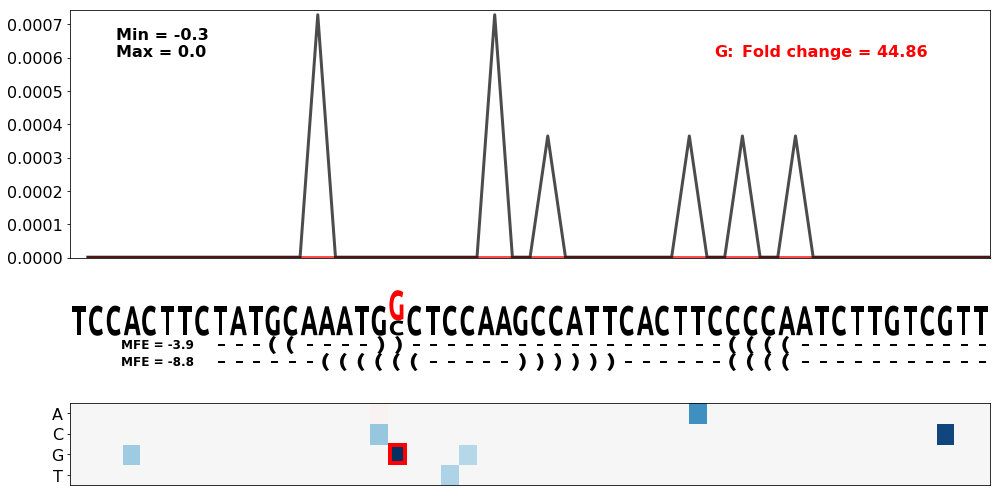

Predicted:


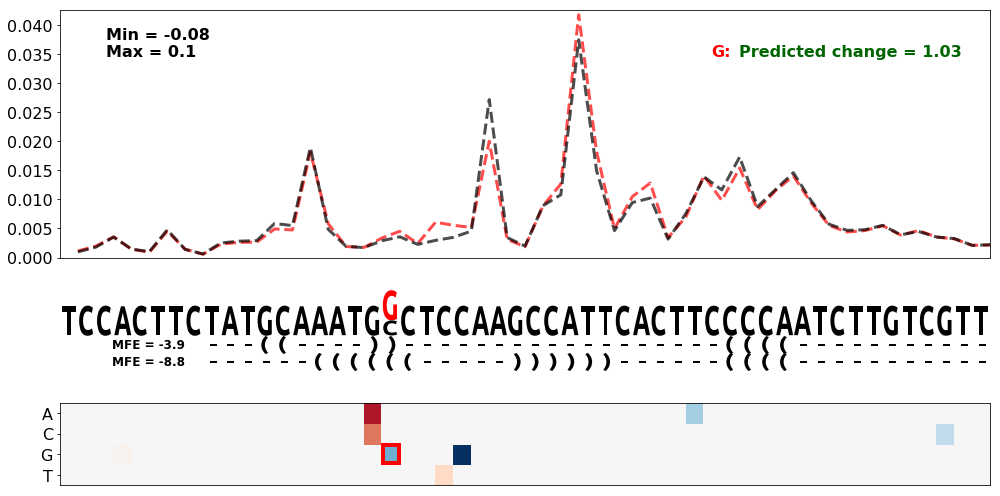

Both:


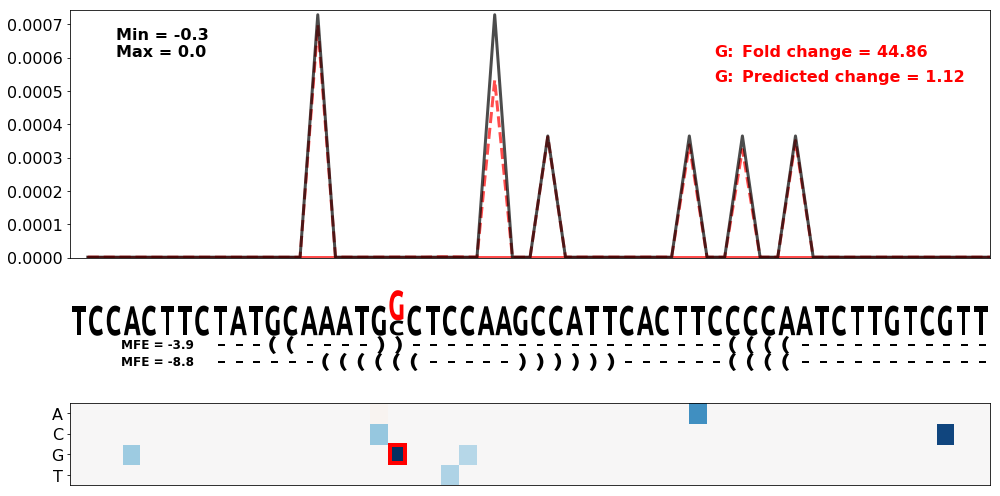

Gene = PEX5.3
SNV pos = 74
SNV nt = C
ClinVar id = NM_001131025.1(PEX5):c.*1259G>C
Observed:


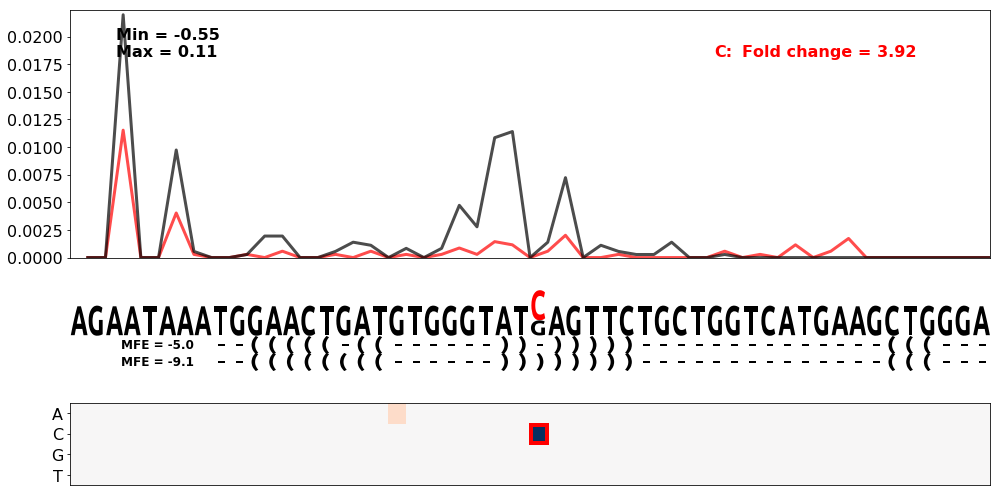

Predicted:


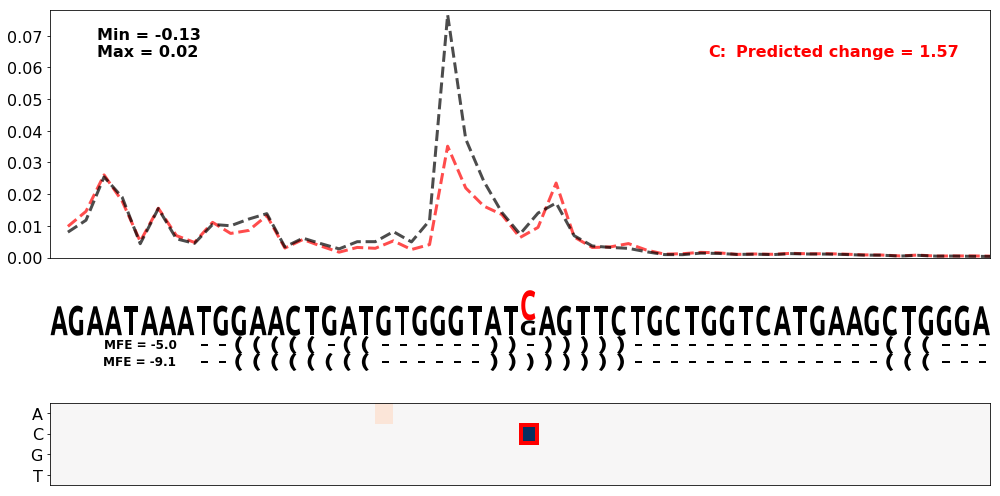

Both:


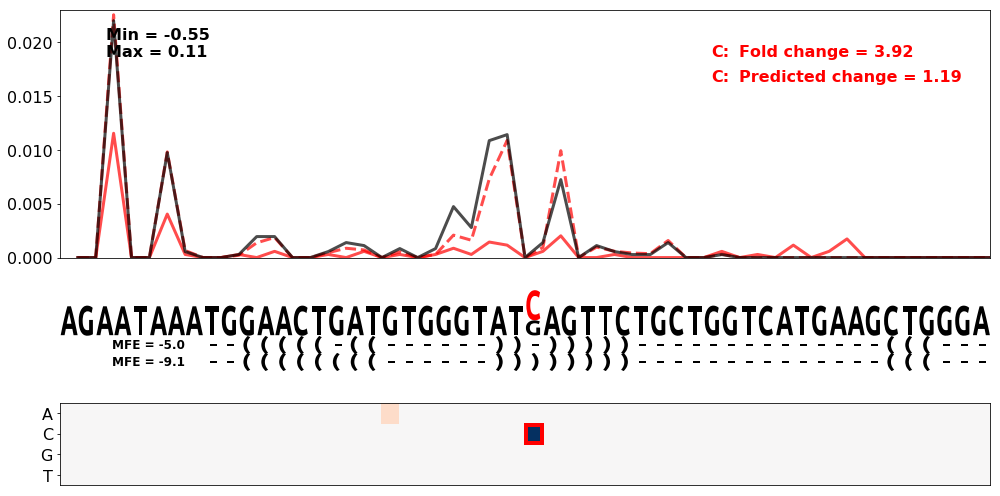

Gene = BRCA1.1
SNV pos = 72
SNV nt = A
ClinVar id = Missing
Observed:


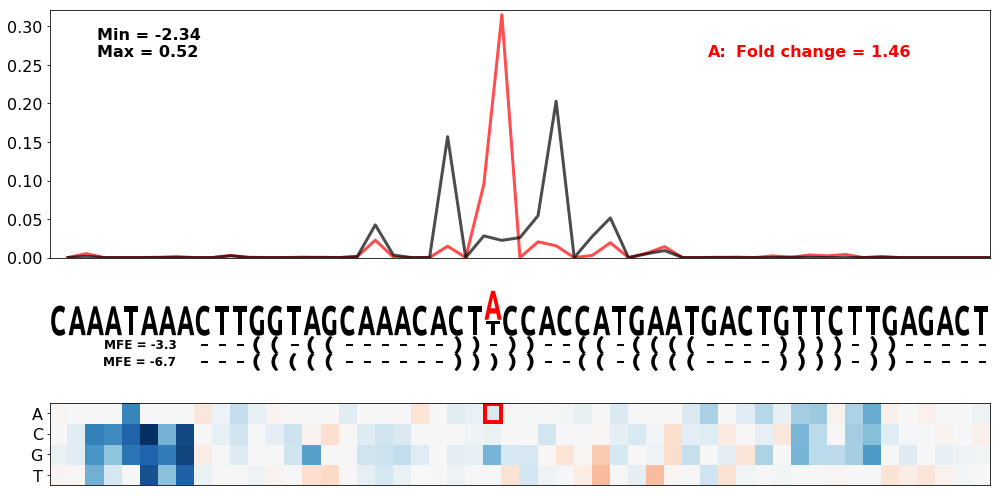

Predicted:


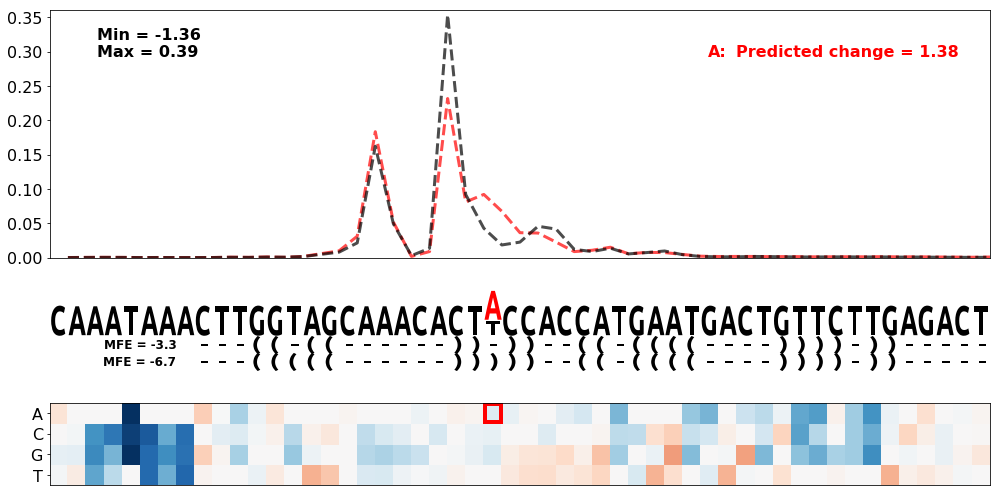

Both:


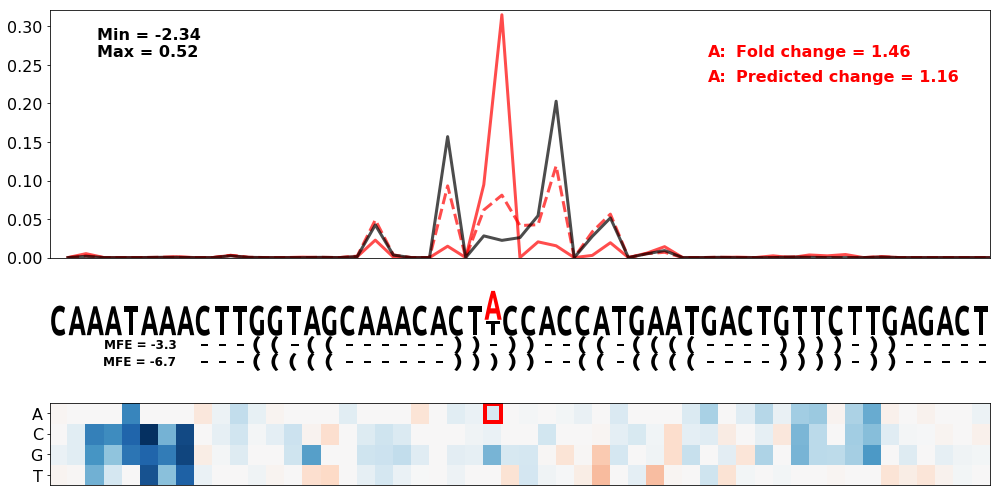

Gene = MYL2.1
SNV pos = 65
SNV nt = A
ClinVar id = Missing
Observed:


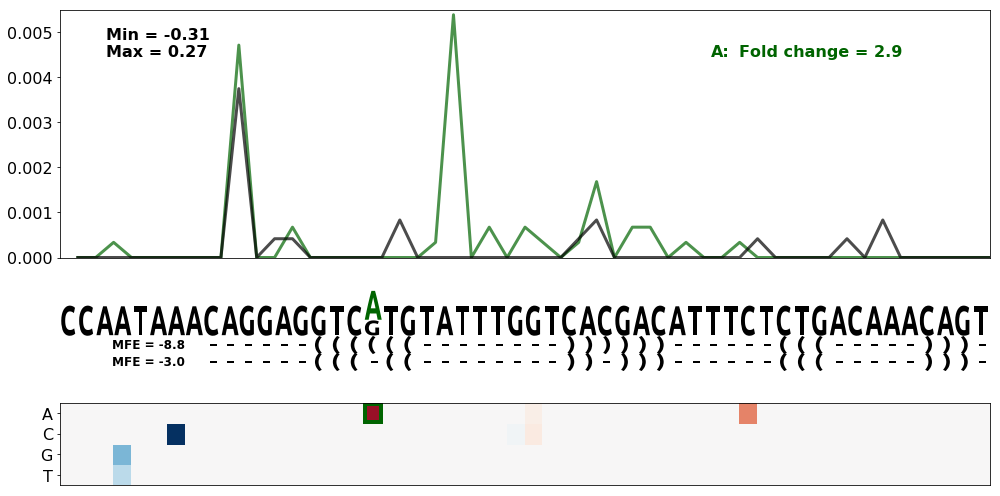

Predicted:


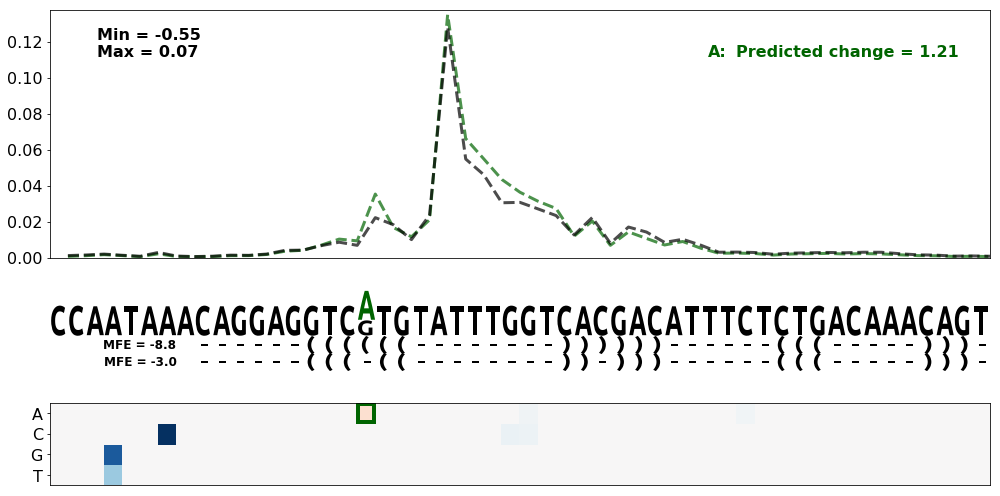

Both:


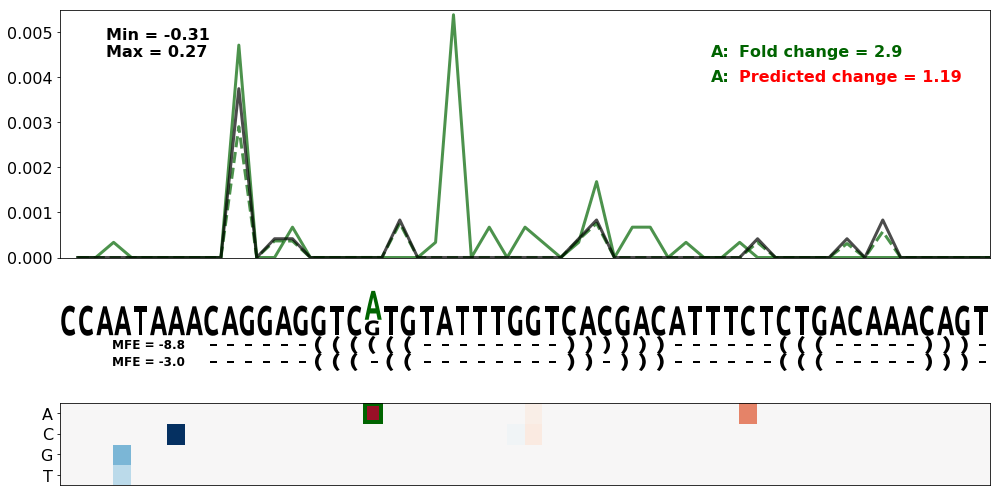

Gene = ARSA.3
SNV pos = 98
SNV nt = T
ClinVar id = Missing
Observed:


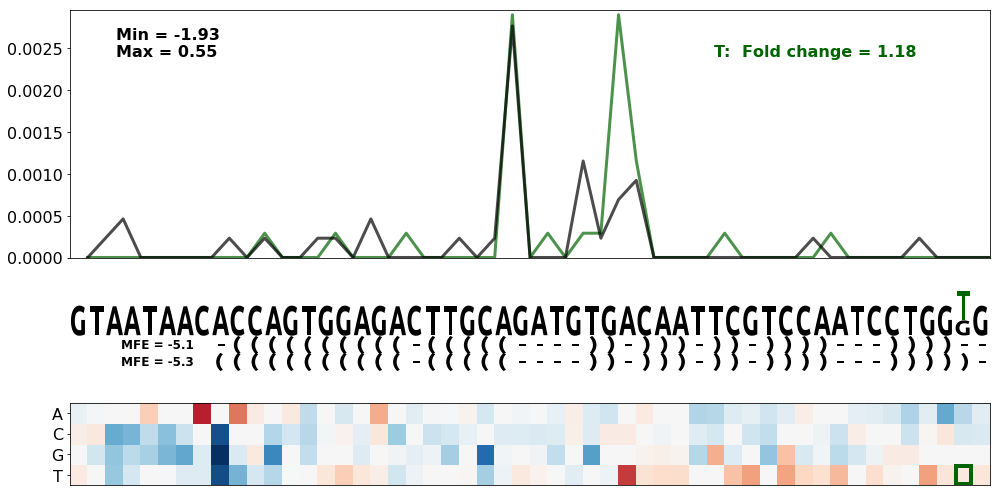

Predicted:


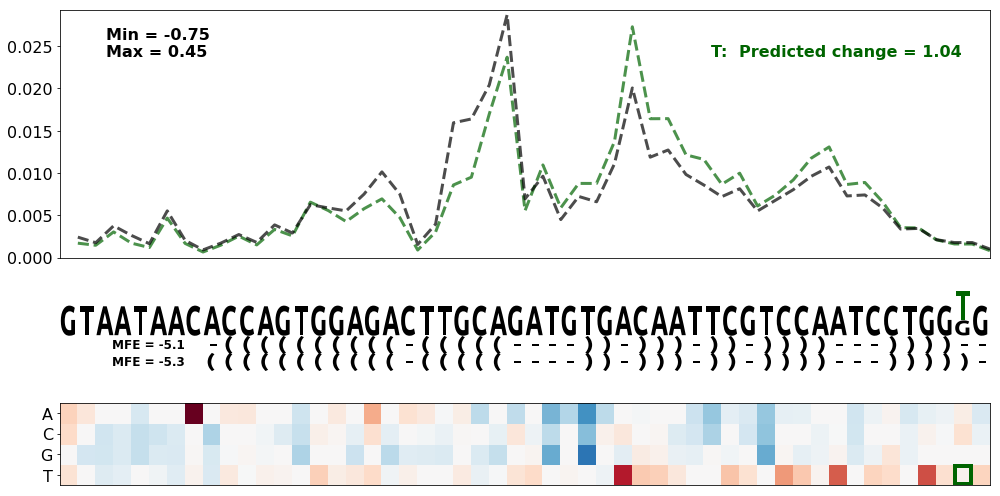

Both:


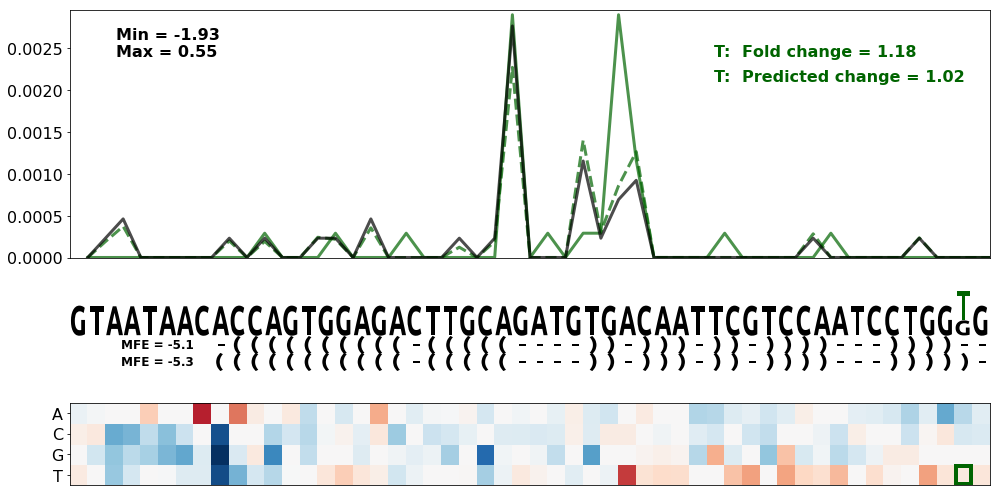

Gene = HBA2.2
SNV pos = 57
SNV nt = G
ClinVar id = Missing
Observed:


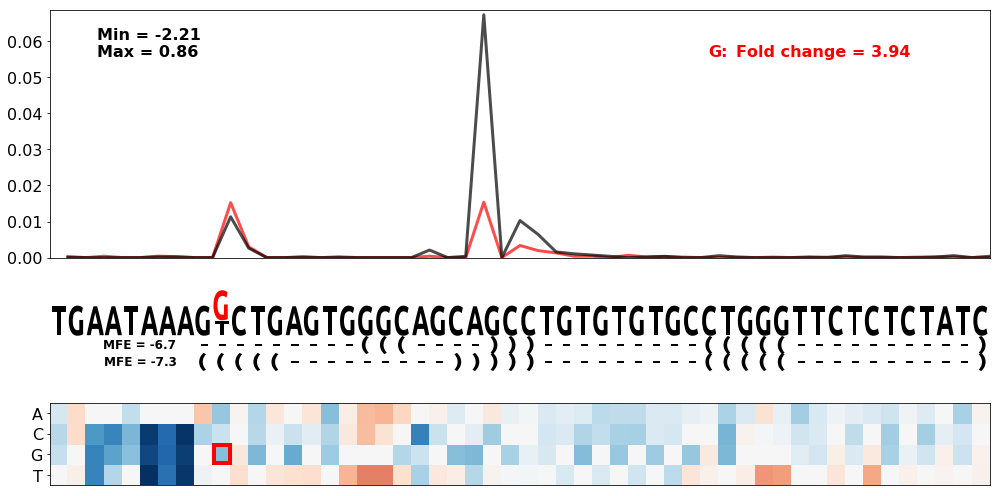

Predicted:


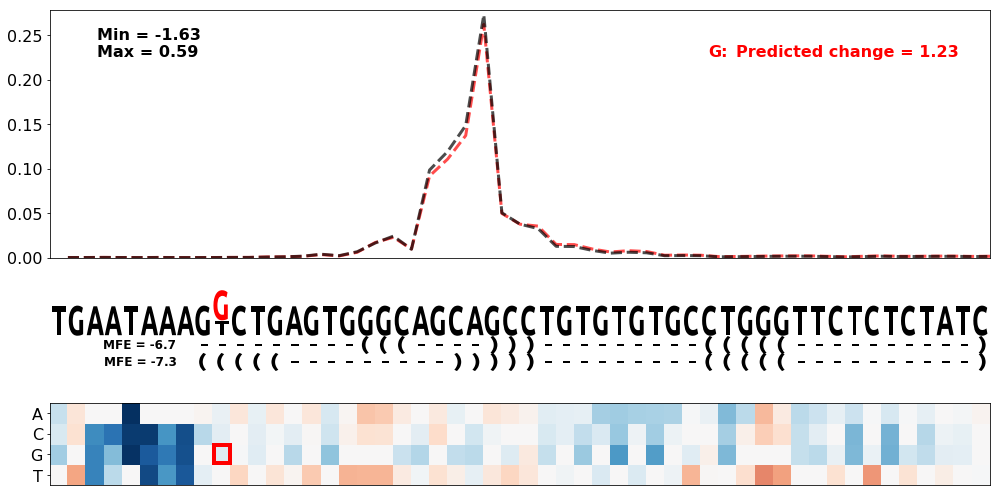

Both:


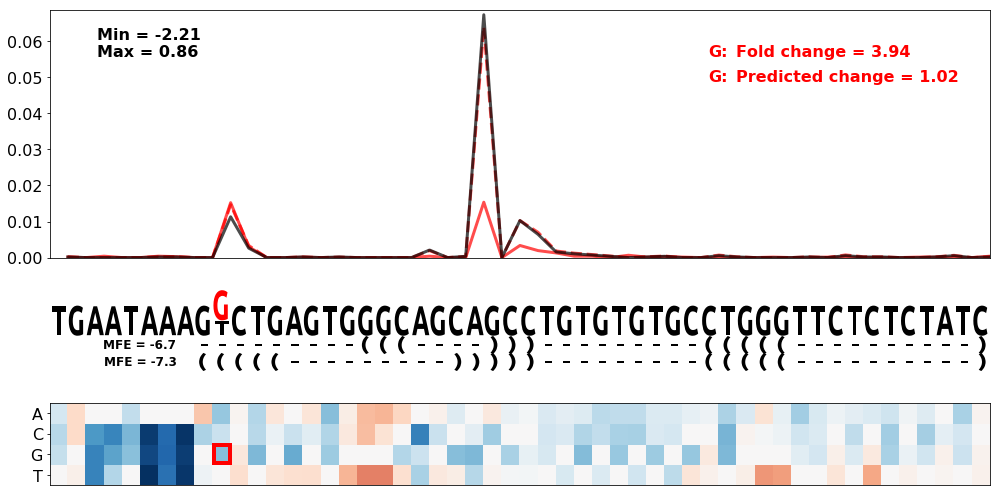

Gene = INS.1
SNV pos = 77
SNV nt = G
ClinVar id = Missing
Observed:


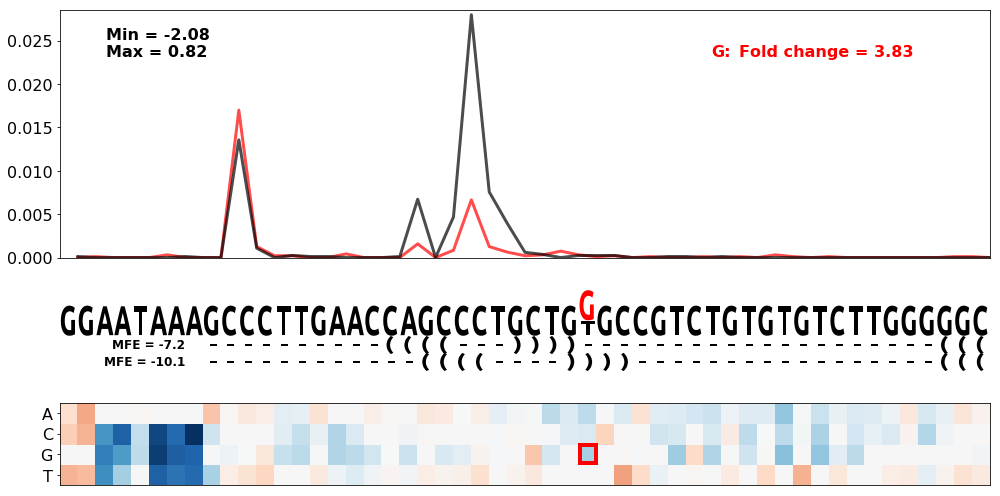

Predicted:


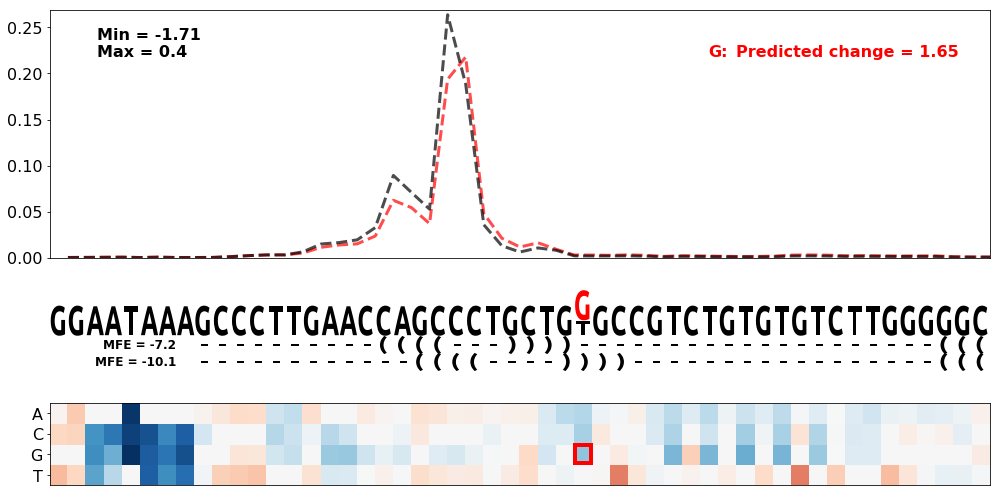

Both:


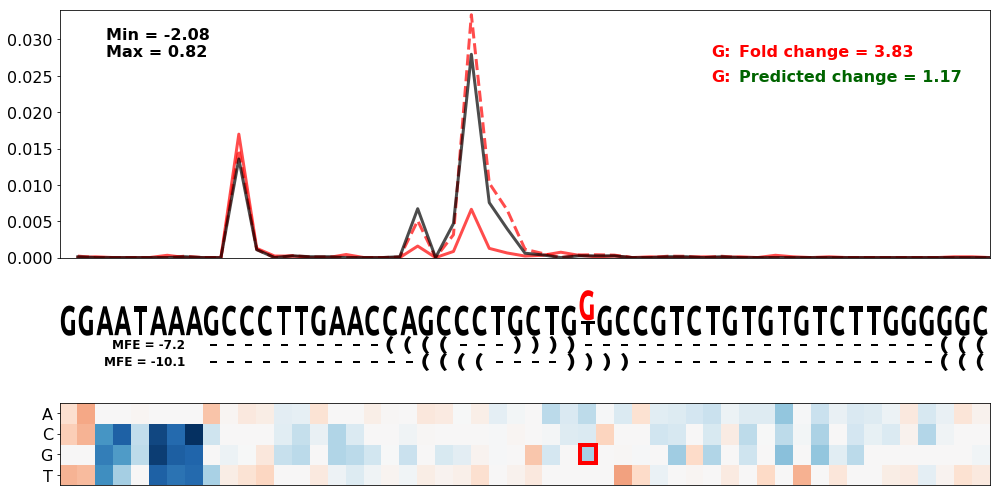

Gene = FANCD2.3
SNV pos = 59
SNV nt = T
ClinVar id = NM_033084.4(FANCD2):c.*44C>T
Observed:


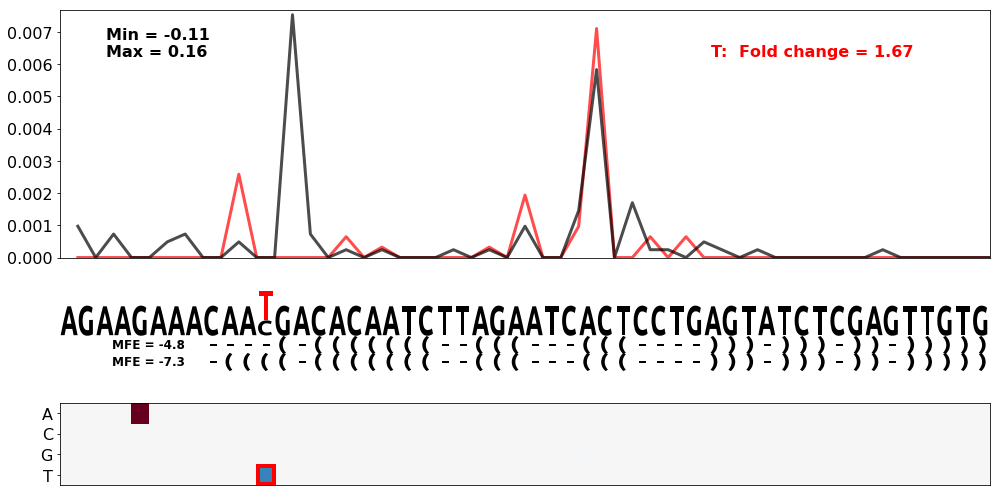

Predicted:


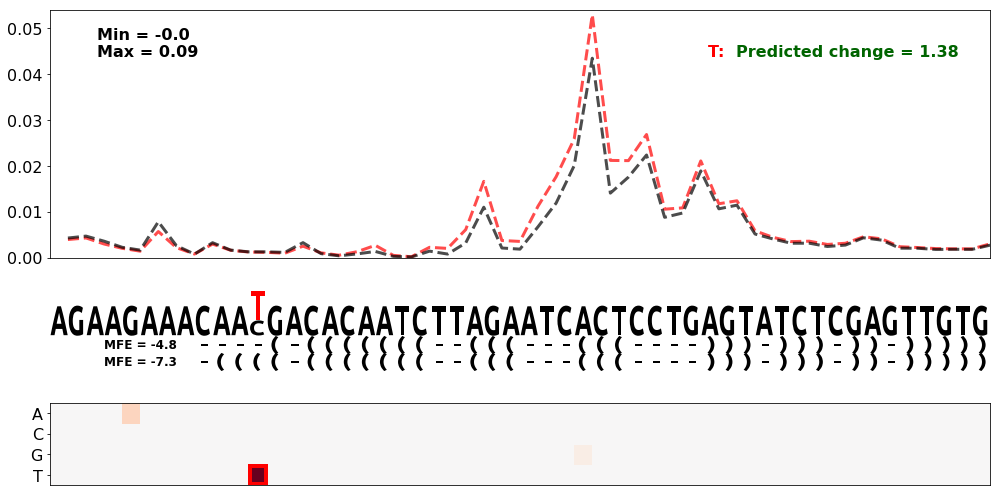

Both:


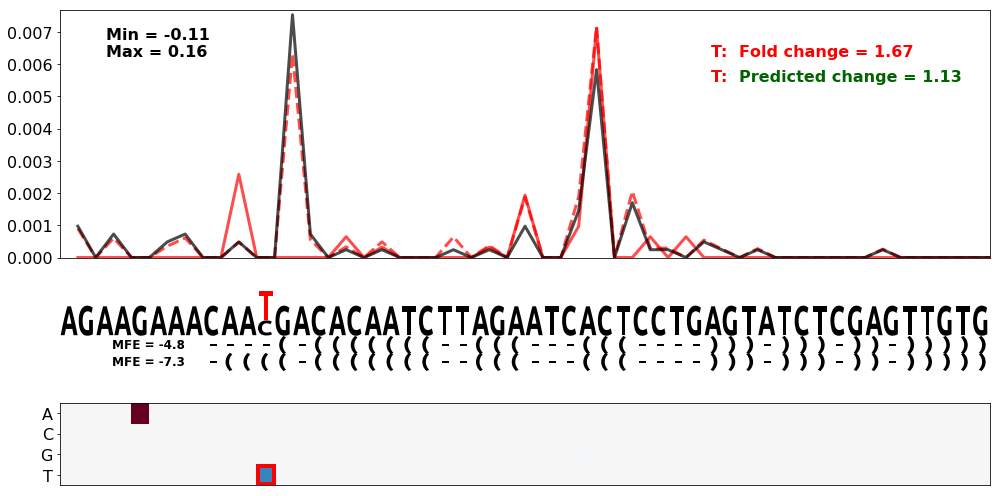

Gene = TP53.3
WT seq = CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG
SNV pos = 65
SNV nt = A
ClinVar id = Missing
Observed:


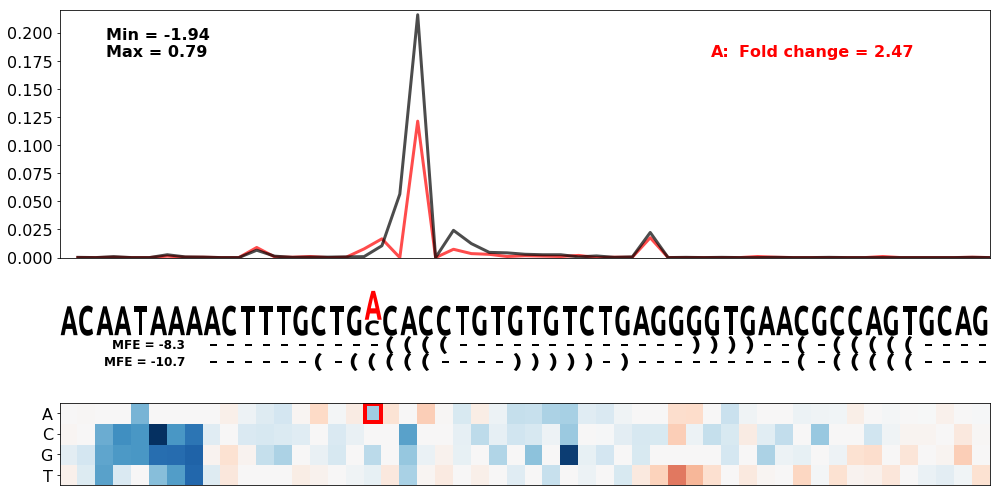

Predicted:


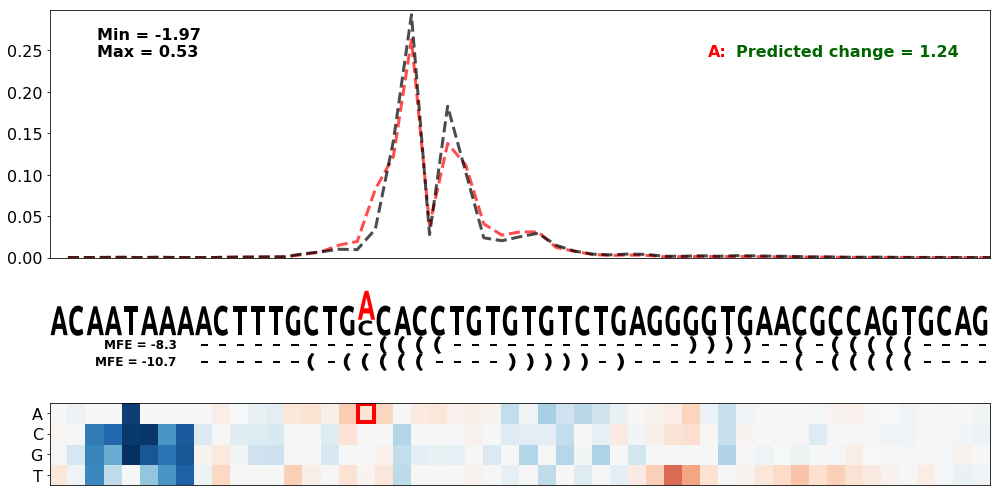

Both:


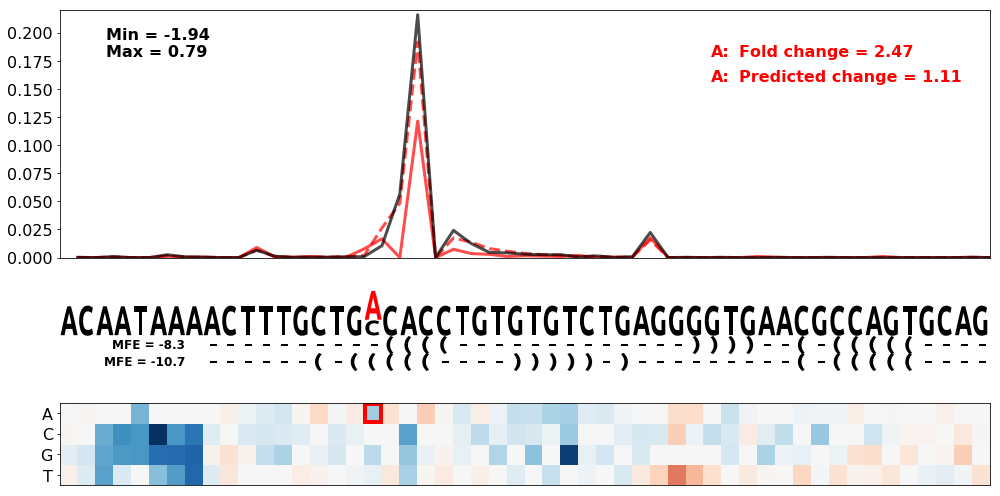

Gene = FRA10AC1.1
SNV pos = 68
SNV nt = G
ClinVar id = NM_006204.3(PDE6C):c.*209T>C
Observed:


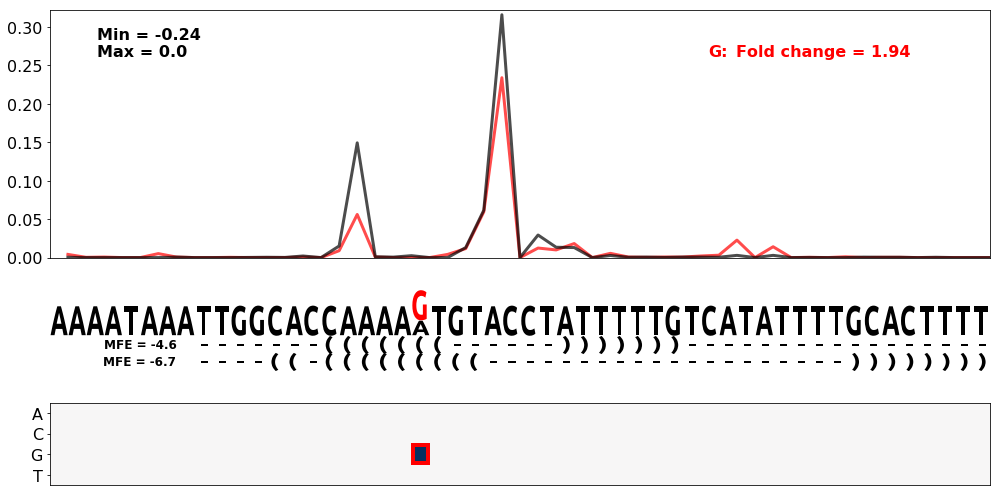

Predicted:


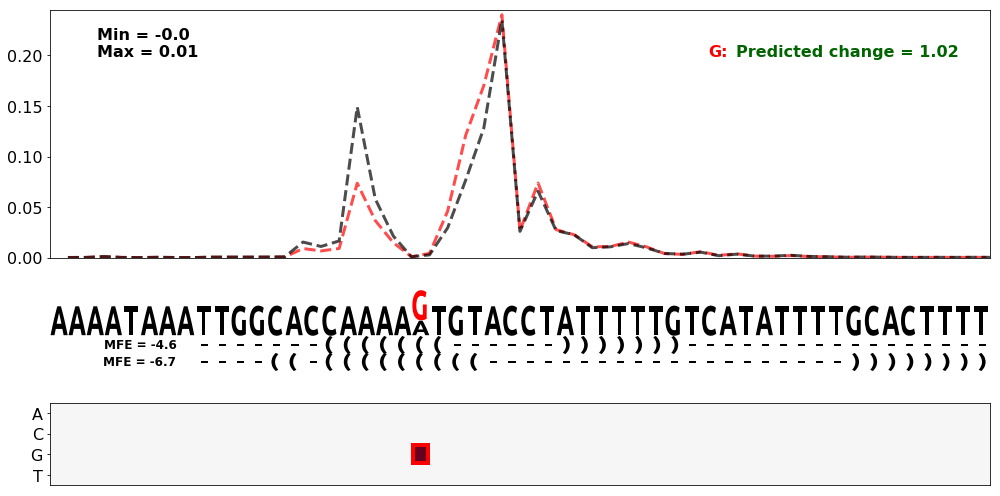

Both:


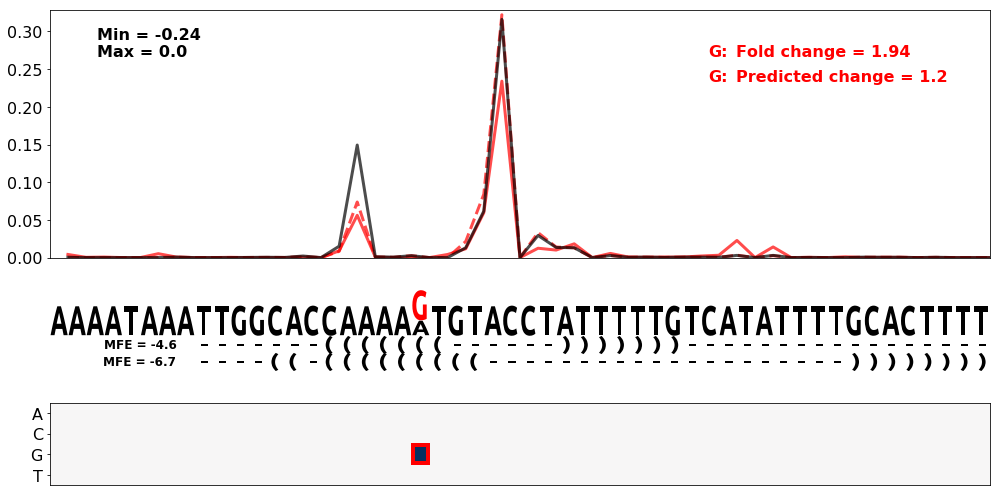

Gene = TGFBR2.3
SNV pos = 68
SNV nt = G
ClinVar id = Missing
Observed:


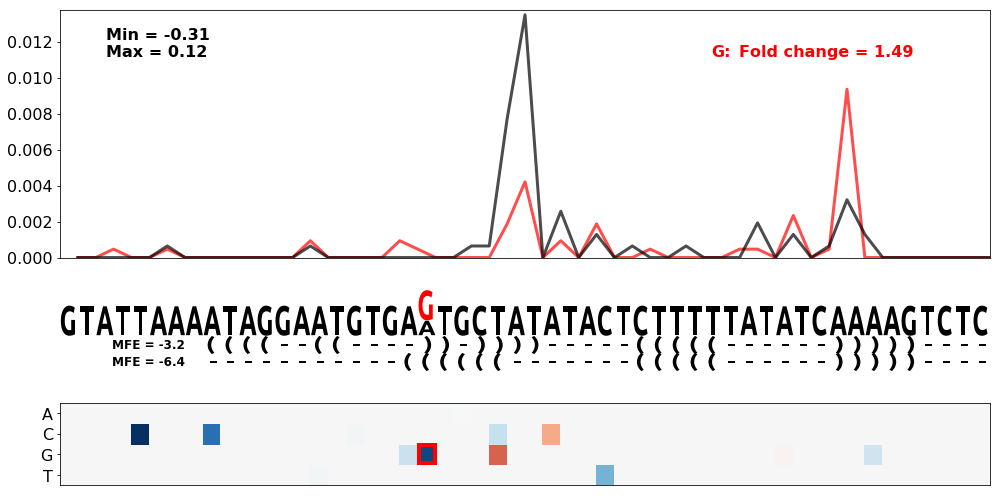

Predicted:


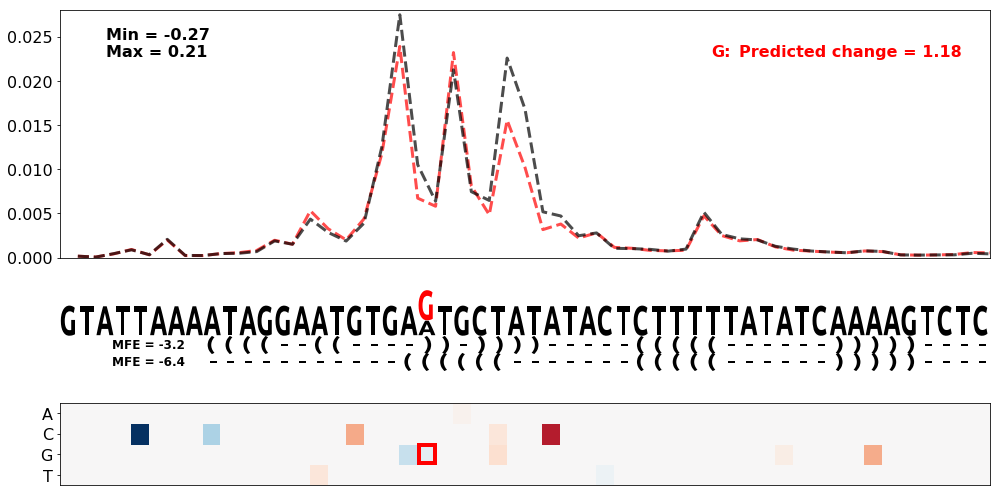

Both:


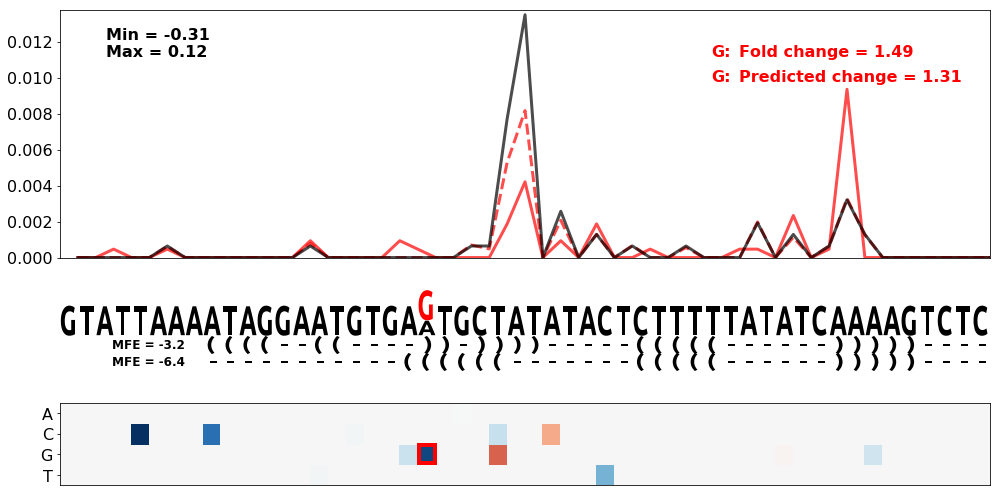

In [32]:
print('Folding changes:')

experiment_name = 'folding'

gene_names = [
    'MLH1.2',
    'MLH1.2',
    'ARSA.3',
    'TP53.3',
    'LDLR.8',
    'ARSA.3',
    'PTEN.16',
    'NF2.3',
    'LDLR.4',
    'PEX5.3',
    'BRCA1.1',
    'MYL2.1',
    'ARSA.3',
    'HBA2.2',
    'INS.1',
    'FANCD2.3',
    'TP53.3',
    'FRA10AC1.1',
    'TGFBR2.3'
]

snv_list = [
    [(80, 'C', 'red')],
    [(69, 'A', 'red')],
    [(83, 'G', 'red')],
    [(76, 'G', 'red')],
    [(69, 'T', 'red')],
    [(67, 'A', 'red')],
    [(107, 'G', 'red')],
    [(97, 'G', 'red')],
    [(66, 'G', 'red')],
    [(74, 'C', 'red')],
    [(72, 'A', 'red')],
    [(65, 'A', 'darkgreen')],
    [(98, 'T', 'darkgreen')],
    [(57, 'G', 'red')],
    [(77, 'G', 'red')],
    [(59, 'T', 'red')],
    [(65, 'A', 'red')],
    [(68, 'G', 'red')],
    [(68, 'G', 'red')]
]

wt_seq_list = [
    None,
    None,
    None,
    'CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG',
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    None,
    'CCTCCTTCTCCCTTTTTATATCCCATTTTTATATCGATCTCTTATTTTACAATAAAACTTTGCTGCCACCTGTGTGTCTGAGGGGTGAACGCCAGTGCAGGCTACTGGGGTCAGCAGGTGCAGGGGTGAGTGAGGAGGTGCTGGGAAGCAGCCACCTGAGTCTG',
    None,
    None
]

seq_start = 48
seq_end = 100

save_figs = True

df_to_use = df_var_no_pas.set_index('master_seq')

for gene_name, snvs, specific_seq in zip(gene_names, snv_list, wt_seq_list) :
    df_sel = df_to_use
    if specific_seq is not None :
        df_sel = df_to_use.query("wt_seq == '" + specific_seq + "'")

    print('Gene = ' + gene_name)
    if specific_seq is not None :
        print('WT seq = ' + specific_seq)
    print('SNV pos = ' + str(snvs[0][0]))
    print('SNV nt = ' + str(snvs[0][1]))
    print('ClinVar id = ' + str(df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['clinvar_id'].values[0]))
    
    struct_var = df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['struct_var'].values[0]
    struct_ref = df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['struct_wt'].values[0]
    struct_var = ('X' * 56) + struct_var + ('X' * 100)
    struct_ref = ('X' * 56) + struct_ref + ('X' * 100)
    
    mfe_var = df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['mfe_var'].values[0]
    mfe_ref = df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['mfe_wt'].values[0]
    delta_mfe = df_sel.loc[df_sel.index.str.slice(snvs[0][0], snvs[0][0]+1) == snvs[0][1]].query("gene == '" + gene_name + "' and snv_pos == " + str(snvs[0][0]))['delta_mfe'].values[0]
    
    print('Observed:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Observed'
    mut_map_with_cuts_and_fold(
            df_sel,
            gene_name,
            mfe_ref,
            mfe_var,
            struct_ref,
            struct_var,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=False,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Predicted:')
    
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Predicted'
    mut_map_with_cuts_and_fold(
            df_sel,
            gene_name,
            mfe_ref,
            mfe_var,
            struct_ref,
            struct_var,
            snvs,
            mode='pred',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=False,
            plot_pred_cuts=True,
            scale_pred_cuts=False,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )
    
    print('Both:')
    fig_name = None
    if save_figs :
        fig_name = experiment_name + '_' + gene_name + '_' + str(snvs[0][0]) + '_' + str(snvs[0][1]) + '_Both'
    mut_map_with_cuts_and_fold(
            df_sel,
            gene_name,
            mfe_ref,
            mfe_var,
            struct_ref,
            struct_var,
            snvs,
            mode='true',
            column_suffix='',
            figsize=(14, 7),
            height_ratios=[6, 2, 2],
            bg_alpha=0.999,
            plot_simple_mutmap=True,
            annotate_folds=True,
            plot_true_cuts=True,
            plot_pred_cuts=True,
            scale_pred_cuts=True,
            fold_change_from_cut_range=[60, 100],
            ref_var_scales=[0.5, 1.0],
            border_eta = 0.06,
            seq_trim_start=seq_start, seq_trim_end=seq_end,
            plot_start=0, plot_end=seq_end-seq_start,
            plot_as_bars=False,
            pas_downscaling=0.5,
            fig_name=fig_name,
            fig_dpi=150
    )

n variants = 12348
n variants (stat. signi.) = 3771
n variants (stat. signi. & strong preds) = 2330
n variants (stat. signi. & strong preds & correct APARENT) = 2186
n variants (stat. signi. & strong preds & disagree) = 258
# discreps = 258


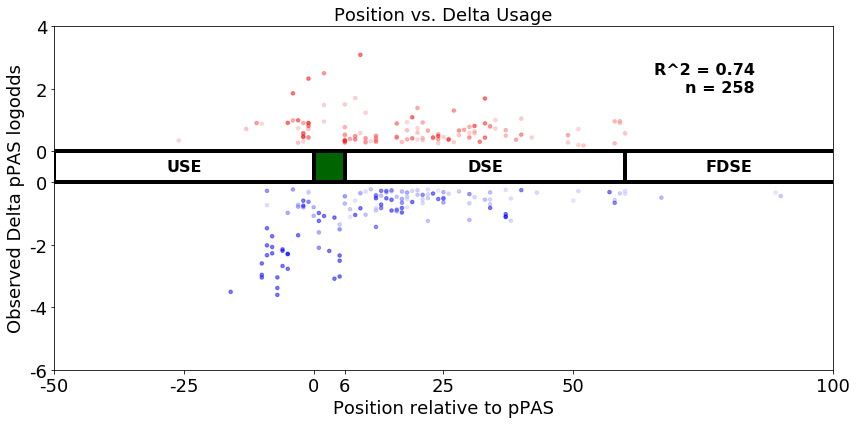

n variants (stat. signi.) = 3771
n variants (stat. signi. & strong preds) = 2330
n variants (stat. signi. & strong preds & disagree) = 35
# discreps = 35


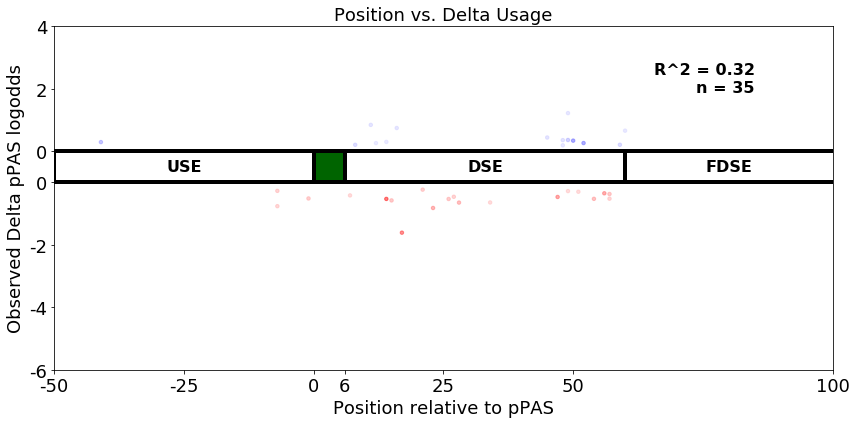

In [30]:
save_figs = False

p_thresh = 0.00001

print('n variants = ' + str(len(df_var)))

discrep_index = (df_var['delta_p_val'] < p_thresh)

print('n variants (stat. signi.) = ' + str(len(df_var.loc[discrep_index])))

discrep_index = discrep_index & (np.abs(df_var['delta_6mer_score']) > 0.1)
discrep_index = discrep_index & (np.abs(df_var['delta_logodds_pred']) > 0.1)

print('n variants (stat. signi. & strong preds) = ' + str(len(df_var.loc[discrep_index])))

discrep_index_correct = discrep_index & (np.sign(df_var['delta_logodds_true']) == np.sign(df_var['delta_logodds_pred']))

print('n variants (stat. signi. & strong preds & correct APARENT) = ' + str(len(df_var.loc[discrep_index_correct])))

discrep_index = discrep_index & ((np.sign(df_var['delta_logodds_true']) != np.sign(df_var['delta_6mer_score'])) & (np.sign(df_var['delta_logodds_true']) == np.sign(df_var['delta_logodds_pred'])))

print('n variants (stat. signi. & strong preds & disagree) = ' + str(len(df_var.loc[discrep_index])))

discrep_df = df_var.iloc[np.nonzero(discrep_index)[0]].copy()

print('# discreps = ' + str(len(discrep_df)))

fig_name = None
if save_figs :
    fig_name = 'rare_variants_neural_net_agrees_with_obs'
plot_position_delta_scatter(discrep_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)

#plot_position_delta_scatter(discrep_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=None, fig_dpi=300, annotate=None)

discrep_index = (df_var['delta_p_val'] < p_thresh)

print('n variants (stat. signi.) = ' + str(len(df_var.loc[discrep_index])))

discrep_index = discrep_index & (np.abs(df_var['delta_6mer_score']) > 0.1)
discrep_index = discrep_index & (np.abs(df_var['delta_logodds_pred']) > 0.1)

print('n variants (stat. signi. & strong preds) = ' + str(len(df_var.loc[discrep_index])))

discrep_index = discrep_index & ((np.sign(df_var['delta_logodds_true']) == np.sign(df_var['delta_6mer_score'])) & (np.sign(df_var['delta_logodds_true']) != np.sign(df_var['delta_logodds_pred'])))

print('n variants (stat. signi. & strong preds & disagree) = ' + str(len(df_var.loc[discrep_index])))

discrep_df = df_var.iloc[np.nonzero(discrep_index)[0]].copy()

print('# discreps = ' + str(len(discrep_df)))

fig_name = None
if save_figs :
    fig_name = 'rare_variants_6mer_model_agrees_with_obs'
plot_position_delta_scatter(discrep_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=fig_name, fig_dpi=150, annotate=None)

#plot_position_delta_scatter(discrep_df, min_pred_filter=0.0, figsize=(12, 6), pred_column='delta_6mer_score', fig_name=None, fig_dpi=300, annotate=None)



<h2>TGTA analysis</h2>

<h2>Single and Double TGTA (No WT TGTA)</h2>

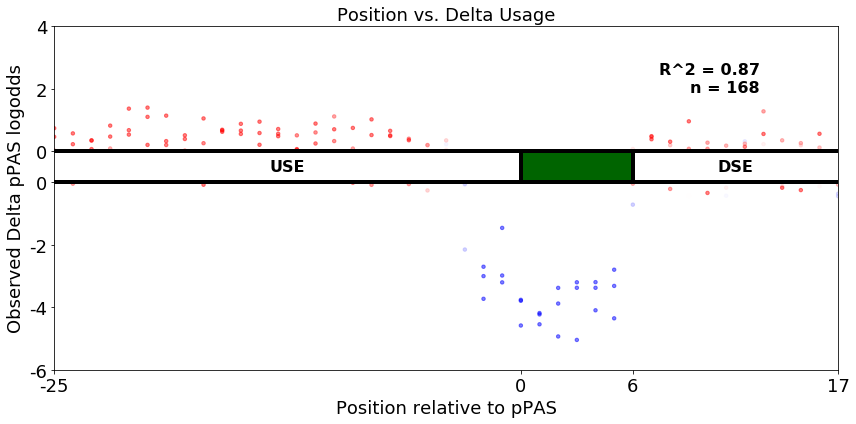

Mean:


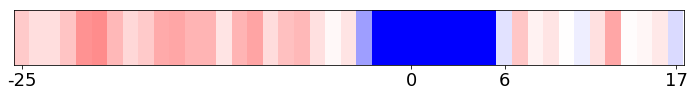

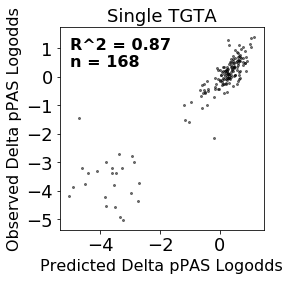

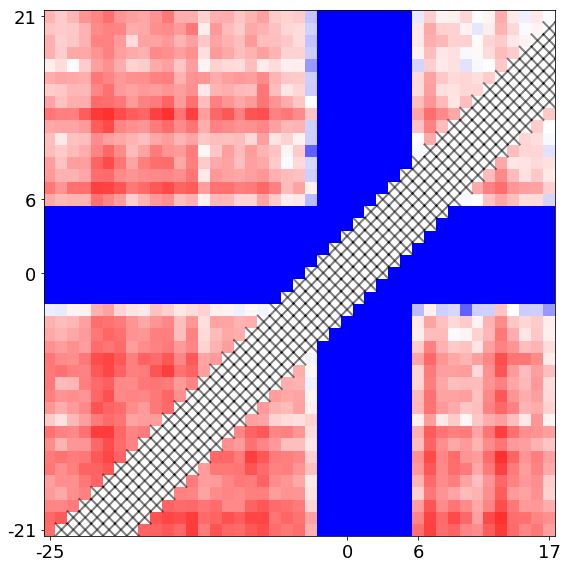

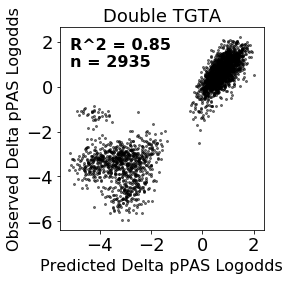

Individual wildtype sequences:
TGTA maps for sequence 0


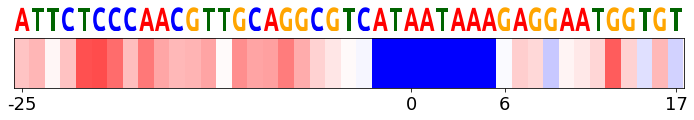

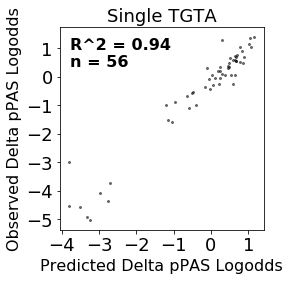

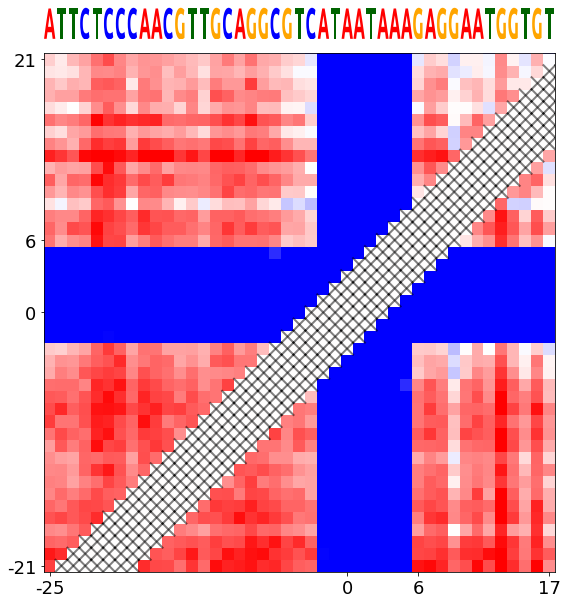

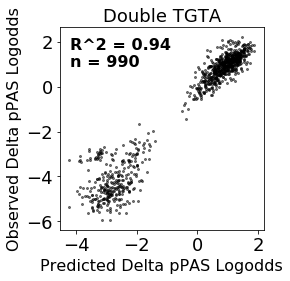

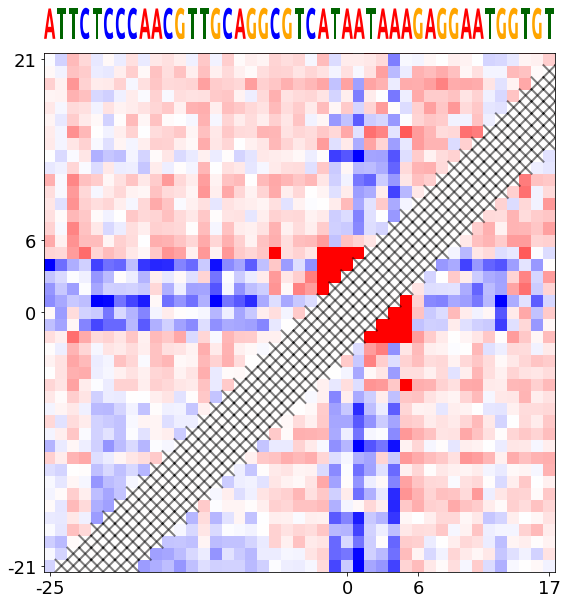

TGTA maps for sequence 1


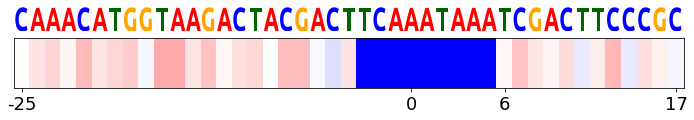

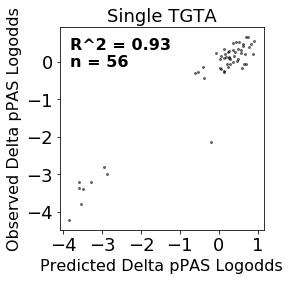

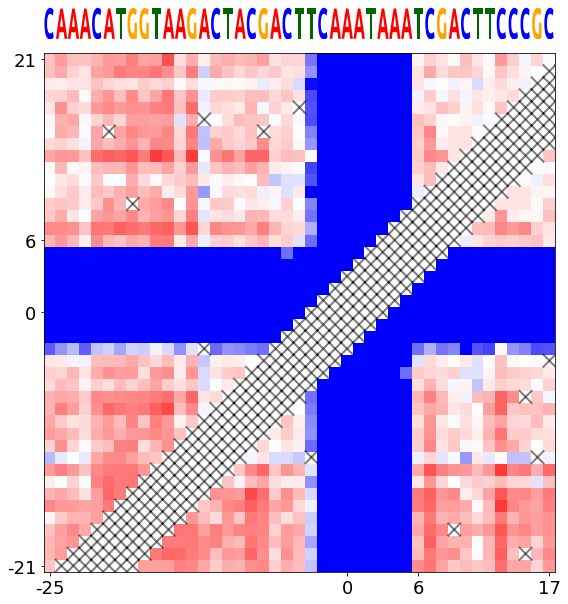

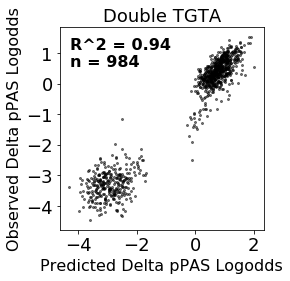

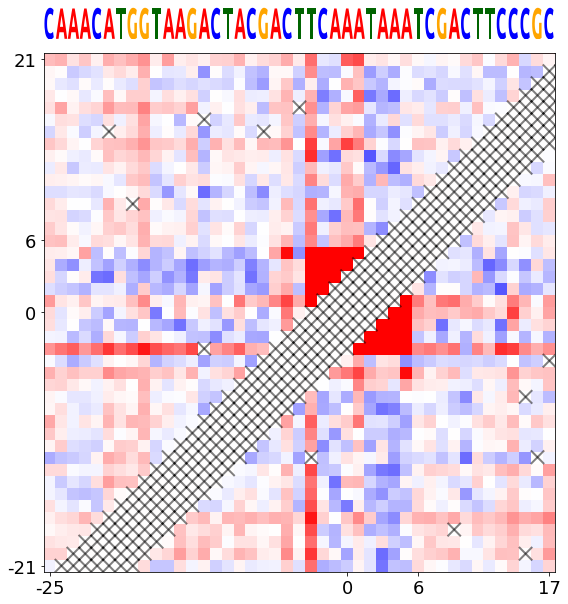

TGTA maps for sequence 2


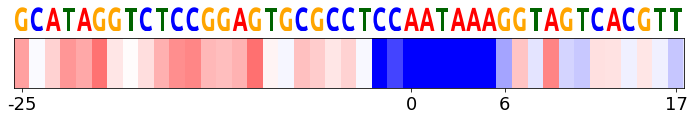

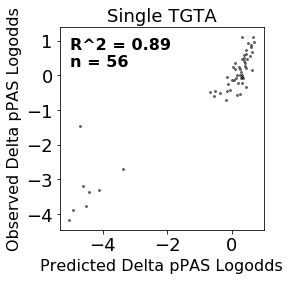

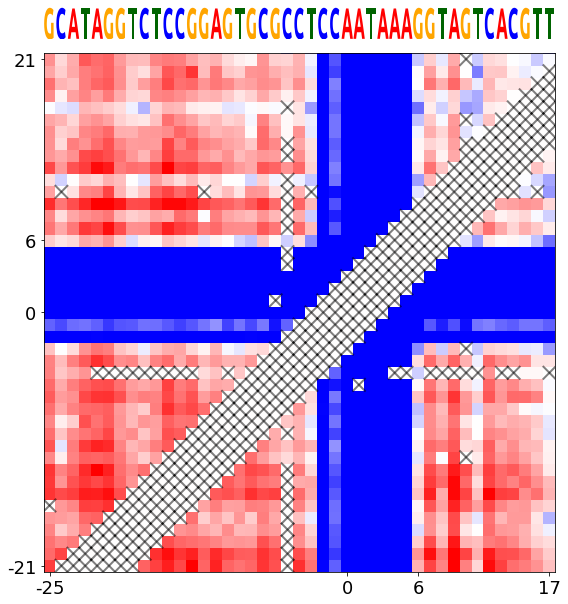

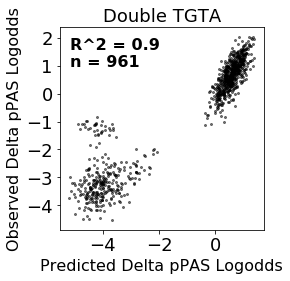

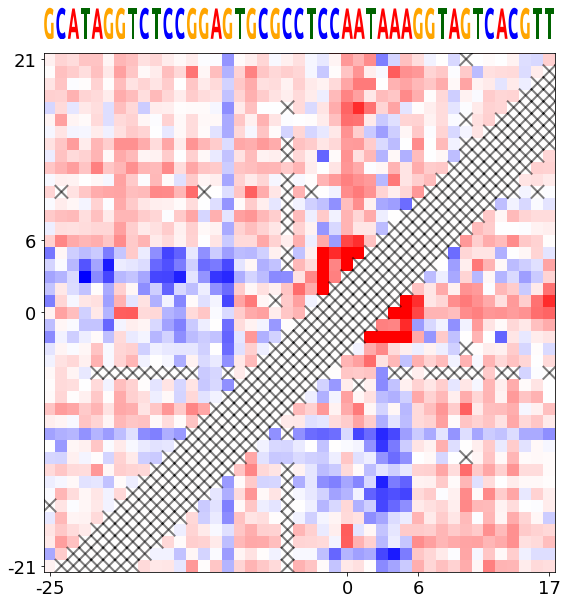

In [36]:
#TGTA variant analysis

df_to_use = variant_df_filtered.copy().set_index('master_seq')
df_to_use['delta_logodds_pred'] = df_to_use['mean_delta_logodds_pred']

tgta_1_df = df_to_use.query("experiment == 'tgta' and subexperiment == 'n=1' and tgta_fixed == False")
tgta_2_df = df_to_use.query("experiment == 'tgta' and subexperiment == 'n=2' and tgta_fixed == False")

plot_start = 25#None
plot_end = 67 + 1#None

scatter_pos_start = plot_start
if scatter_pos_start is None :
    scatter_pos_start = 0
scatter_pos_end = plot_end
if scatter_pos_end is None :
    scatter_pos_end = 151
plot_position_delta_scatter(tgta_1_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=None, plot_start=scatter_pos_start-50, plot_end=scatter_pos_end-50-1, fig_dpi=300, annotate=None, snv_pos_column='tgta_pos_1')

print('Mean:')

plot_individual_tgta_map('mean', tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)

print('Individual wildtype sequences:')

wt_seqs = tgta_1_df['wt_seq'].unique()
for i, wt_seq in enumerate(wt_seqs) :
    print('TGTA maps for sequence ' + str(i))
    plot_individual_tgta_map(wt_seq, tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)
    plot_individual_tgta_map_nonlin(wt_seq, tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)

<h2>Single and Double TGTA (With WT TGTA upstream of CSE hexamer)</h2>

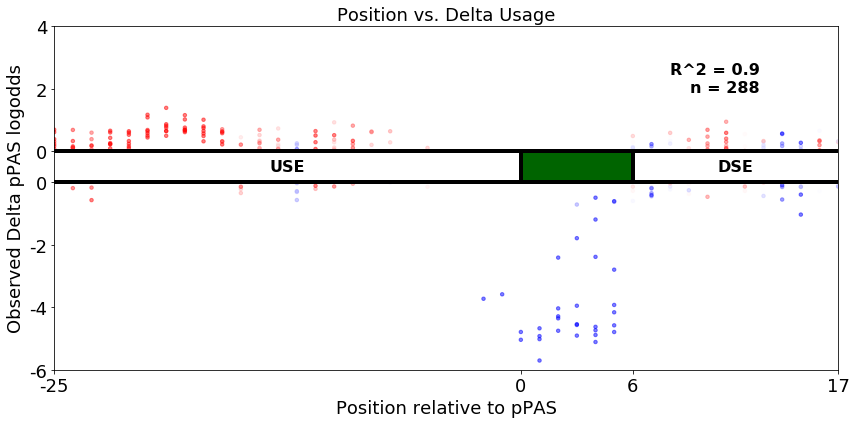

Mean:


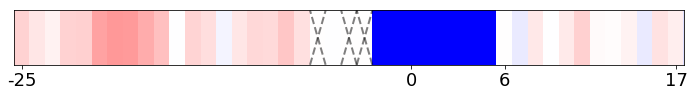

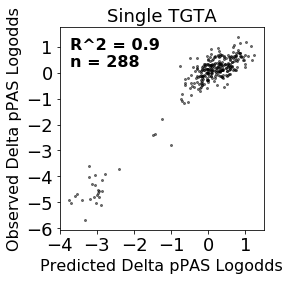

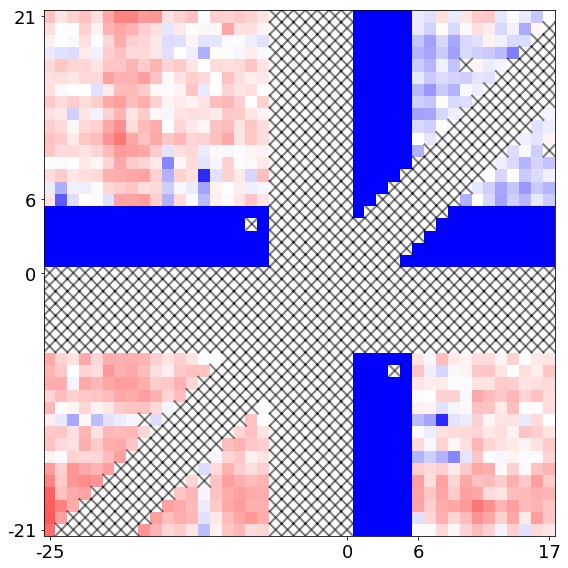

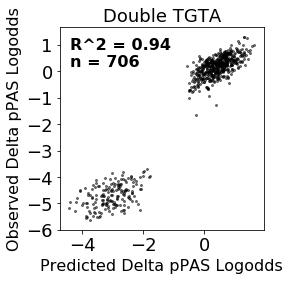

Individual wildtype sequences:
TGTA maps for sequence 0


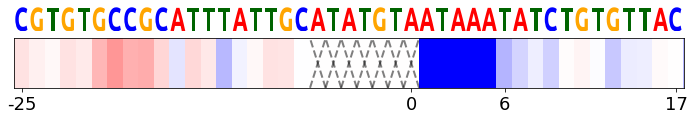

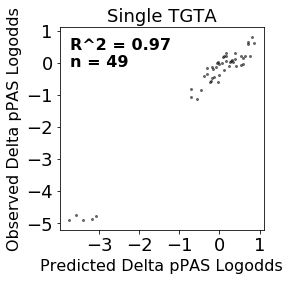

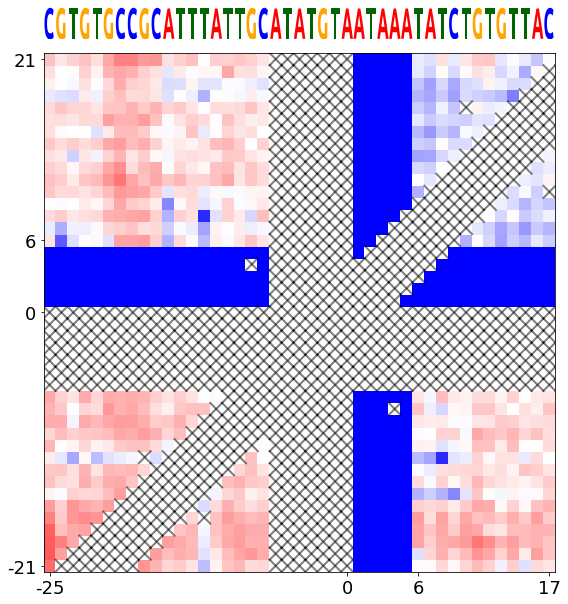

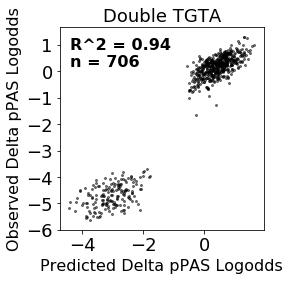

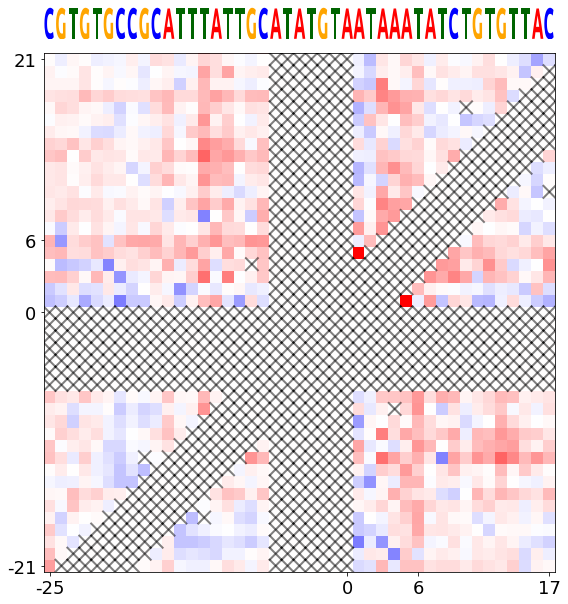

TGTA maps for sequence 1


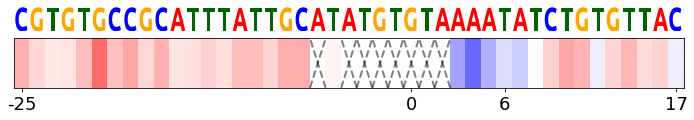

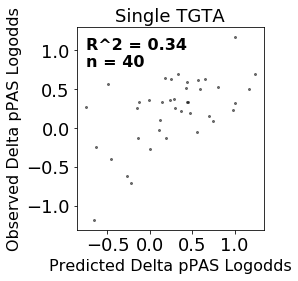

TGTA maps for sequence 2


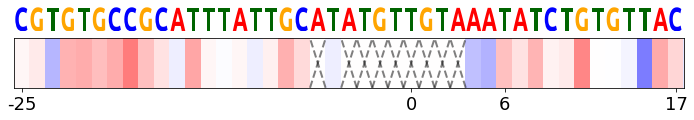

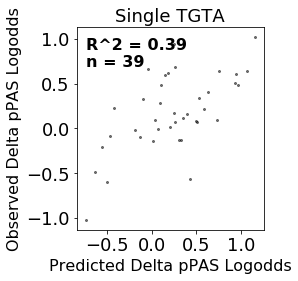

TGTA maps for sequence 3


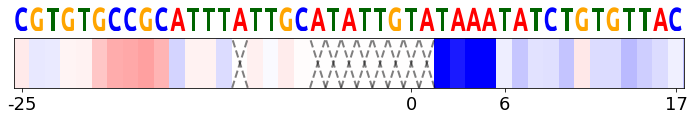

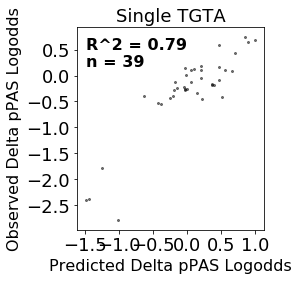

TGTA maps for sequence 4


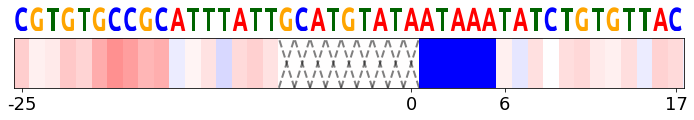

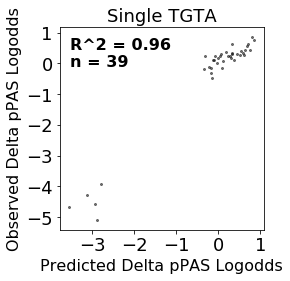

TGTA maps for sequence 5


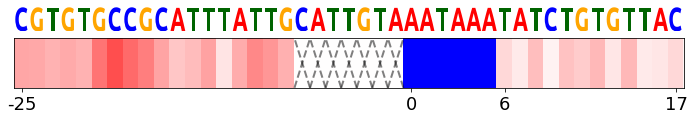

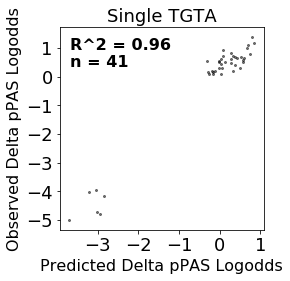

TGTA maps for sequence 6


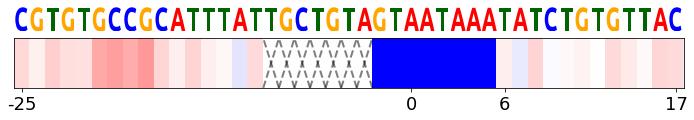

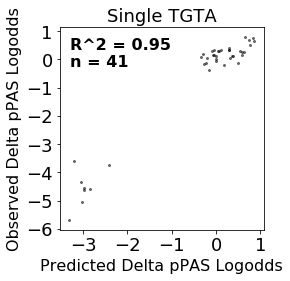

In [37]:
#TGTA variant analysis (1 fixed TGTA element upstream of CSE hexamer)

df_to_use = variant_df_filtered.copy().set_index('master_seq')
df_to_use['delta_logodds_pred'] = df_to_use['mean_delta_logodds_pred']

tgta_1_df = df_to_use.query("experiment == 'tgta' and subexperiment == 'n=2' and tgta_fixed == True")
tgta_2_df = df_to_use.query("experiment == 'tgta' and subexperiment == 'n=3' and tgta_fixed == True")

plot_start = 25#None
plot_end = 67 + 1#None

scatter_pos_start = plot_start
if scatter_pos_start is None :
    scatter_pos_start = 0
scatter_pos_end = plot_end
if scatter_pos_end is None :
    scatter_pos_end = 151
plot_position_delta_scatter(tgta_1_df, min_pred_filter=0.0, figsize=(12, 6), fig_name=None, plot_start=scatter_pos_start-50, plot_end=scatter_pos_end-50-1, fig_dpi=300, annotate=None, snv_pos_column='tgta_pos_1')

print('Mean:')

plot_individual_tgta_map('mean', tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)

print('Individual wildtype sequences:')

wt_seqs = tgta_1_df['wt_seq'].unique()
for i, wt_seq in enumerate(wt_seqs) :
    print('TGTA maps for sequence ' + str(i))
    plot_individual_tgta_map(wt_seq, tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)
    plot_individual_tgta_map_nonlin(wt_seq, tgta_1_df, tgta_2_df, plot_start=plot_start, plot_end=plot_end, vmin=-2, vmax=2, interpolate_missing=False, plot_symmetric_doubles=True)